In [1]:
import numpy as np
import matplotlib.pyplot as pl
import pandas
from sklearn.utils import class_weight
import tensorflow as tf
from tensorflow.keras import Sequential, activations, Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    BatchNormalization, Activation, SpatialDropout2D, GlobalAveragePooling2D,
    Dense, Dropout, Flatten,
    Conv2D, MaxPooling2D, SeparableConv2D
)


# Import project utils scripts
import os
import sys

src_path = os.path.join('../src/')

if src_path not in sys.path:
    sys.path.append(src_path)

from statisticsUtils import recall_precision_fscore_from_confusion_matrix
from labelsUtils import Label
from regionUtils import vietnam_labels_coordinates
from bandUtils import Band
from rasterUtils import make_dataset_from_raster_files
from visualizationUtils import plot_confusion_matrix
from convNetUtils import cross_validation

/home/simon/miniconda3/envs/tb/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  warnings.warn(


In [1]:
from enum import Enum

class Band(Enum):
    COASTAL_AEROSOL = 0
    BLUE = 1
    GREEN = 2
    RED = 3
    NIR = 4
    SWIR1 = 5
    SWIR2 = 6
    TIRS1 = 7
    TIRS2 = 8

In [3]:
NB_PIXEL_AROUND = 5
TRAIN_TEST_RATIO = 0.8
EPOCHS = 400
NB_TESTS = 5
DATA_ROOT_PATH ='../data/'
LABELS_COORDINATES = vietnam_labels_coordinates()

In [4]:
labels = [
    Label.COFFEE,
    # Label.NATIVEVEGE, now replaced by Label.DENSE_FOREST
    Label.DENSE_FOREST,
    Label.URBAN,
    Label.WATER,
    Label.PEPPER,
    Label.TEA,
]

labels_names = [label.name for label in labels]

dataset_args = dict(
    labels = labels,
    raster_paths = [DATA_ROOT_PATH + 'Vietnam_2017_january_february/merged.tif'],
    labels_coordinates_list = [LABELS_COORDINATES],
    nb_pixel_around = NB_PIXEL_AROUND
)

dataset = make_dataset_from_raster_files(**dataset_args)

# RED, GREEN, BLUE

In [5]:
BANDS = [
    Band.RED.value,
    Band.GREEN.value,
    Band.BLUE.value,
]

In [6]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d (Conv2D)              (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 2, 2, 16)          0

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1394 - accuracy: 0.4285 - val_loss: 1.3539 - val_accuracy: 0.3594
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2043 - accuracy: 0.3976 - val_loss: 1.2237 - val_accuracy: 0.4507
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2185 - accuracy: 0.3956 - val_loss: 1.2377 - val_accuracy: 0.4346
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2507 - accuracy: 0.4081 - val_loss: 1.2134 - val_accuracy: 0.4732
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2093 - accuracy: 0.4472 - val_loss: 1.2374 - val_accuracy: 0.4407
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2041 - accuracy: 0.4127 - val_loss: 1.2791 - val_accuracy: 0.4176
Epoch 52/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1647 - accuracy: 0.4270 - val_loss: 1.2227 - val_accuracy: 0.4443
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0879 - accuracy: 0.4725 - val_loss: 1.2060 - val_accuracy: 0.4763
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0822 - accuracy: 0.4681 - val_loss: 1.1921 - val_accuracy: 0.4485
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1095 - accuracy: 0.4259 - val_loss: 1.2284 - val_accuracy: 0.4338
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1038 - accuracy: 0.4357 - val_loss: 1.1958 - val_accuracy: 0.4490
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0823 - accuracy: 0.4486 - val_loss: 1.2396 - val_accuracy: 0.4425
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1411 - accuracy: 0.4586 - val_loss: 1.1635 - val_accuracy: 0.4815
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1003 - accuracy: 0.4492 - val_loss: 1.1704 - val_accuracy: 0.4633
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9951 - accuracy: 0.4948 - val_loss: 1.1586 - val_accuracy: 0.4861
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9715 - accuracy: 0.4850 - val_loss: 1.1422 - val_accuracy: 0.4844
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9713 - accuracy: 0.4777 - val_loss: 1.2328 - val_accuracy: 0.4517
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0044 - accuracy: 0.4753 - val_loss: 1.1700 - val_accuracy: 0.4852
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9942 - accuracy: 0.5296 - val_loss: 1.1498 - val_accuracy: 0.4814
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0126 - accuracy: 0.4848 - val_loss: 1.1797 - val_accuracy: 0.4560
Epoch 280/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9803 - accuracy: 0.4984 - val_loss: 1.1675 - val_accuracy: 0.4655
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9539 - accuracy: 0.5268 - val_loss: 1.1235 - val_accuracy: 0.5356
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9717 - accuracy: 0.5347 - val_loss: 1.0747 - val_accuracy: 0.5426
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8711 - accuracy: 0.5543 - val_loss: 1.1578 - val_accuracy: 0.5106
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8979 - accuracy: 0.5520 - val_loss: 1.1450 - val_accuracy: 0.4992
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9346 - accuracy: 0.5253 - val_loss: 1.2321 - val_accuracy: 0.4913
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0372 - accuracy: 0.5309 - val_loss: 1.0919 - val_accuracy: 0.5298
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9335 - accuracy: 0.5107 - val_loss: 1.1399 - val_accuracy: 0.5368
Epoch 395/400

Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1938 - accuracy: 0.4150 - val_loss: 1.2008 - val_accuracy: 0.4522
Epoch 104/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1303 - accuracy: 0.4391 - val_loss: 1.2158 - val_accuracy: 0.4462
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1331 - accuracy: 0.4546 - val_loss: 1.2461 - val_accuracy: 0.4318
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1323 - accuracy: 0.4269 - val_loss: 1.2031 - val_accuracy: 0.4539
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1817 - accuracy: 0.4344 - val_loss: 1.2208 - val_accuracy: 0.4401
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1474 - accuracy: 0.4565 - val_loss: 1.2330 - val_accuracy: 0.4491
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1995 - accuracy: 0.4129 - val_loss: 1.2301 - val_accuracy: 0.4458

57/57 [==============================] - 0s 8ms/step - loss: 1.0528 - accuracy: 0.4743 - val_loss: 1.1946 - val_accuracy: 0.4661
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0646 - accuracy: 0.4900 - val_loss: 1.1593 - val_accuracy: 0.5028
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0325 - accuracy: 0.4981 - val_loss: 1.2024 - val_accuracy: 0.4661
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0607 - accuracy: 0.4713 - val_loss: 1.1852 - val_accuracy: 0.4770
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0661 - accuracy: 0.4876 - val_loss: 1.1692 - val_accuracy: 0.4850
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0689 - accuracy: 0.4636 - val_loss: 1.2316 - val_accuracy: 0.4537
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0536 - accuracy: 0.4690 - val_loss: 1.2203 - val_accuracy: 0.4552
Epoch 224/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9738 - accuracy: 0.5117 - val_loss: 1.1831 - val_accuracy: 0.4840
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0397 - accuracy: 0.5042 - val_loss: 1.1839 - val_accuracy: 0.4808
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9849 - accuracy: 0.5129 - val_loss: 1.2034 - val_accuracy: 0.4797
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0141 - accuracy: 0.5201 - val_loss: 1.2307 - val_accuracy: 0.4617
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0355 - accuracy: 0.5012 - val_loss: 1.1775 - val_accuracy: 0.5077
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0526 - accuracy: 0.5013 - val_loss: 1.1711 - val_accuracy: 0.5020
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0305 - accuracy: 0.5124 - val_loss: 1.1920 - val_accuracy: 0.4878
Epoch 338/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3308 - accuracy: 0.4022 - val_loss: 1.2464 - val_accuracy: 0.4381
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2339 - accuracy: 0.4089 - val_loss: 1.2942 - val_accuracy: 0.3912
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2589 - accuracy: 0.4344 - val_loss: 1.2473 - val_accuracy: 0.4242
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2540 - accuracy: 0.4236 - val_loss: 1.2361 - val_accuracy: 0.4350
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2836 - accuracy: 0.4059 - val_loss: 1.2303 - val_accuracy: 0.4471
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2214 - accuracy: 0.4484 - val_loss: 1.2581 - val_accuracy: 0.4457
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2306 - accuracy: 0.4244 - val_loss: 1.3014 - val_accuracy: 0.3972
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1571 - accuracy: 0.4442 - val_loss: 1.1922 - val_accuracy: 0.4562
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1607 - accuracy: 0.4152 - val_loss: 1.1890 - val_accuracy: 0.4642
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1614 - accuracy: 0.4230 - val_loss: 1.2167 - val_accuracy: 0.4492
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2077 - accuracy: 0.4741 - val_loss: 1.2207 - val_accuracy: 0.4585
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1770 - accuracy: 0.4560 - val_loss: 1.2090 - val_accuracy: 0.4582
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1782 - accuracy: 0.4406 - val_loss: 1.2386 - val_accuracy: 0.4403
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1499 - accuracy: 0.4693 - val_loss: 1.2046 - val_accuracy: 0.4502

57/57 [==============================] - 0s 8ms/step - loss: 1.0507 - accuracy: 0.4963 - val_loss: 1.1571 - val_accuracy: 0.4711
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1320 - accuracy: 0.4644 - val_loss: 1.1834 - val_accuracy: 0.4582
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0928 - accuracy: 0.4795 - val_loss: 1.2282 - val_accuracy: 0.4201
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0768 - accuracy: 0.4768 - val_loss: 1.1581 - val_accuracy: 0.4756
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0026 - accuracy: 0.5064 - val_loss: 1.1697 - val_accuracy: 0.4766
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0355 - accuracy: 0.5135 - val_loss: 1.1434 - val_accuracy: 0.4748
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0776 - accuracy: 0.4773 - val_loss: 1.1738 - val_accuracy: 0.4708
Epoch 224/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0643 - accuracy: 0.4840 - val_loss: 1.2317 - val_accuracy: 0.3881
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0593 - accuracy: 0.4854 - val_loss: 1.1437 - val_accuracy: 0.4907
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0326 - accuracy: 0.5022 - val_loss: 1.1648 - val_accuracy: 0.4551
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0024 - accuracy: 0.5186 - val_loss: 1.1575 - val_accuracy: 0.4819
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0151 - accuracy: 0.4916 - val_loss: 1.3071 - val_accuracy: 0.3385
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0434 - accuracy: 0.4365 - val_loss: 1.1577 - val_accuracy: 0.4768
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9850 - accuracy: 0.5125 - val_loss: 1.1699 - val_accuracy: 0.4914
Epoch 338/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2226 - accuracy: 0.3581 - val_loss: 1.2737 - val_accuracy: 0.4017
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2211 - accuracy: 0.3815 - val_loss: 1.3293 - val_accuracy: 0.3792
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2804 - accuracy: 0.3405 - val_loss: 1.2888 - val_accuracy: 0.4022
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2357 - accuracy: 0.3354 - val_loss: 1.3114 - val_accuracy: 0.4254
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1640 - accuracy: 0.3951 - val_loss: 1.2648 - val_accuracy: 0.4333
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2522 - accuracy: 0.3801 - val_loss: 1.2865 - val_accuracy: 0.3934
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2958 - accuracy: 0.3391 - val_loss: 1.3306 - val_accuracy: 0.3655
Epoch 52/400
57/57 

57/57 [==============================] - 1s 9ms/step - loss: 1.0635 - accuracy: 0.4375 - val_loss: 1.2096 - val_accuracy: 0.4268
Epoch 160/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0388 - accuracy: 0.4639 - val_loss: 1.2268 - val_accuracy: 0.4203
Epoch 161/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1069 - accuracy: 0.4239 - val_loss: 1.2393 - val_accuracy: 0.4026
Epoch 162/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1347 - accuracy: 0.4130 - val_loss: 1.2094 - val_accuracy: 0.4165
Epoch 163/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0654 - accuracy: 0.4249 - val_loss: 1.1958 - val_accuracy: 0.4407
Epoch 164/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0583 - accuracy: 0.4274 - val_loss: 1.2235 - val_accuracy: 0.4046
Epoch 165/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1141 - accuracy: 0.4092 - val_loss: 1.1836 - val_accuracy: 0.4185
Epoch 166/400

57/57 [==============================] - 0s 9ms/step - loss: 1.0519 - accuracy: 0.4094 - val_loss: 1.1834 - val_accuracy: 0.4340
Epoch 274/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9759 - accuracy: 0.4552 - val_loss: 1.1842 - val_accuracy: 0.4162
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0068 - accuracy: 0.4301 - val_loss: 1.1491 - val_accuracy: 0.4456
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9994 - accuracy: 0.4455 - val_loss: 1.1601 - val_accuracy: 0.4590
Epoch 277/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9760 - accuracy: 0.4511 - val_loss: 1.1953 - val_accuracy: 0.4201
Epoch 278/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0089 - accuracy: 0.4515 - val_loss: 1.1863 - val_accuracy: 0.4293
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9551 - accuracy: 0.4744 - val_loss: 1.2138 - val_accuracy: 0.3954
Epoch 280/400

57/57 [==============================] - 0s 9ms/step - loss: 0.9578 - accuracy: 0.4718 - val_loss: 1.1073 - val_accuracy: 0.4963
Epoch 388/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8869 - accuracy: 0.5227 - val_loss: 1.1331 - val_accuracy: 0.4786
Epoch 389/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9160 - accuracy: 0.5086 - val_loss: 1.1486 - val_accuracy: 0.4458
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9517 - accuracy: 0.4781 - val_loss: 1.1411 - val_accuracy: 0.4552
Epoch 391/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9084 - accuracy: 0.5019 - val_loss: 1.1248 - val_accuracy: 0.4547
Epoch 392/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9388 - accuracy: 0.4737 - val_loss: 1.1222 - val_accuracy: 0.4662
Epoch 393/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9315 - accuracy: 0.4866 - val_loss: 1.1989 - val_accuracy: 0.4192
Epoch 394/400

Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1630 - accuracy: 0.4116 - val_loss: 1.2114 - val_accuracy: 0.4248
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1128 - accuracy: 0.3981 - val_loss: 1.2816 - val_accuracy: 0.3834
Epoch 104/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1033 - accuracy: 0.4150 - val_loss: 1.1979 - val_accuracy: 0.4225
Epoch 105/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1640 - accuracy: 0.3824 - val_loss: 1.2587 - val_accuracy: 0.3953
Epoch 106/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1407 - accuracy: 0.3967 - val_loss: 1.2432 - val_accuracy: 0.4127
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0803 - accuracy: 0.4139 - val_loss: 1.2575 - val_accuracy: 0.3852
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1484 - accuracy: 0.4208 - val_loss: 1.2580 - val_accuracy: 0.4112

57/57 [==============================] - 1s 9ms/step - loss: 1.1080 - accuracy: 0.4565 - val_loss: 1.2000 - val_accuracy: 0.4596
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0389 - accuracy: 0.4867 - val_loss: 1.2285 - val_accuracy: 0.4233
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0040 - accuracy: 0.4439 - val_loss: 1.2102 - val_accuracy: 0.4371
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0684 - accuracy: 0.4266 - val_loss: 1.2141 - val_accuracy: 0.4461
Epoch 220/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1185 - accuracy: 0.4453 - val_loss: 1.1798 - val_accuracy: 0.4673
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0506 - accuracy: 0.4772 - val_loss: 1.2119 - val_accuracy: 0.4367
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0282 - accuracy: 0.4704 - val_loss: 1.2329 - val_accuracy: 0.4375
Epoch 223/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9912 - accuracy: 0.4875 - val_loss: 1.1708 - val_accuracy: 0.4767
Epoch 331/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9913 - accuracy: 0.4773 - val_loss: 1.1587 - val_accuracy: 0.4733
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9206 - accuracy: 0.5067 - val_loss: 1.1957 - val_accuracy: 0.4627
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9989 - accuracy: 0.4959 - val_loss: 1.1727 - val_accuracy: 0.4733
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0019 - accuracy: 0.4730 - val_loss: 1.1475 - val_accuracy: 0.5054
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0268 - accuracy: 0.4932 - val_loss: 1.1686 - val_accuracy: 0.4761
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0757 - accuracy: 0.4829 - val_loss: 1.2051 - val_accuracy: 0.4488
Epoch 337/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1612 - accuracy: 0.4683 - val_loss: 1.2731 - val_accuracy: 0.4299
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1465 - accuracy: 0.4759 - val_loss: 1.2056 - val_accuracy: 0.4955
Epoch 41/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1380 - accuracy: 0.4894 - val_loss: 1.3083 - val_accuracy: 0.4029
Epoch 42/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1274 - accuracy: 0.4788 - val_loss: 1.2288 - val_accuracy: 0.4610
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0872 - accuracy: 0.4982 - val_loss: 1.2410 - val_accuracy: 0.4508
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1674 - accuracy: 0.4719 - val_loss: 1.2526 - val_accuracy: 0.4311
Epoch 45/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1348 - accuracy: 0.4880 - val_loss: 1.2637 - val_accuracy: 0.4233
Epoch 46/400
57/57 

Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0558 - accuracy: 0.4869 - val_loss: 1.2030 - val_accuracy: 0.4551
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0135 - accuracy: 0.4883 - val_loss: 1.2707 - val_accuracy: 0.4180
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0284 - accuracy: 0.4692 - val_loss: 1.2579 - val_accuracy: 0.4209
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0564 - accuracy: 0.5066 - val_loss: 1.2401 - val_accuracy: 0.4354
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1465 - accuracy: 0.4548 - val_loss: 1.2044 - val_accuracy: 0.4723
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0586 - accuracy: 0.5127 - val_loss: 1.1989 - val_accuracy: 0.4604
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0599 - accuracy: 0.4647 - val_loss: 1.1979 - val_accuracy: 0.4568
Ep

57/57 [==============================] - 1s 9ms/step - loss: 0.9956 - accuracy: 0.4870 - val_loss: 1.2383 - val_accuracy: 0.4501
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9677 - accuracy: 0.5155 - val_loss: 1.2211 - val_accuracy: 0.4574
Epoch 213/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0202 - accuracy: 0.4940 - val_loss: 1.2214 - val_accuracy: 0.4687
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0308 - accuracy: 0.5050 - val_loss: 1.2167 - val_accuracy: 0.4670
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0496 - accuracy: 0.4981 - val_loss: 1.2041 - val_accuracy: 0.4645
Epoch 216/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0355 - accuracy: 0.5001 - val_loss: 1.2206 - val_accuracy: 0.4636
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0351 - accuracy: 0.4972 - val_loss: 1.2242 - val_accuracy: 0.4599
Epoch 218/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0077 - accuracy: 0.5124 - val_loss: 1.2181 - val_accuracy: 0.4675
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0123 - accuracy: 0.5015 - val_loss: 1.1898 - val_accuracy: 0.4804
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9399 - accuracy: 0.5312 - val_loss: 1.2098 - val_accuracy: 0.4704
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9799 - accuracy: 0.5151 - val_loss: 1.2255 - val_accuracy: 0.4787
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0016 - accuracy: 0.5125 - val_loss: 1.2077 - val_accuracy: 0.4814
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9652 - accuracy: 0.5233 - val_loss: 1.2770 - val_accuracy: 0.4656
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0132 - accuracy: 0.5139 - val_loss: 1.2327 - val_accuracy: 0.4634
Epoch 332/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7841 - accuracy: 0.1568 - val_loss: 1.7919 - val_accuracy: 0.0568
Epoch 35/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8598 - accuracy: 0.1266 - val_loss: 1.7931 - val_accuracy: 0.0654
Epoch 36/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8409 - accuracy: 0.0932 - val_loss: 1.7934 - val_accuracy: 0.0654
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8146 - accuracy: 0.0947 - val_loss: 1.7918 - val_accuracy: 0.0654
Epoch 38/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7975 - accuracy: 0.1067 - val_loss: 1.7928 - val_accuracy: 0.0654
Epoch 39/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8182 - accuracy: 0.1009 - val_loss: 1.7950 - val_accuracy: 0.0654
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7831 - accuracy: 0.0813 - val_loss: 1.7928 - val_accuracy: 0.0654
Epoch 41/400
57/57 

Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7920 - accuracy: 0.1928 - val_loss: 1.7925 - val_accuracy: 0.0654
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8253 - accuracy: 0.1250 - val_loss: 1.7921 - val_accuracy: 0.0654
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7574 - accuracy: 0.1971 - val_loss: 1.7916 - val_accuracy: 0.0894
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8024 - accuracy: 0.1617 - val_loss: 1.7915 - val_accuracy: 0.0894
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7906 - accuracy: 0.1649 - val_loss: 1.7917 - val_accuracy: 0.1661
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7454 - accuracy: 0.1301 - val_loss: 1.7910 - val_accuracy: 0.1805
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7785 - accuracy: 0.1799 - val_loss: 1.7899 - val_accuracy: 0.4418
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7694 - accuracy: 0.1801 - val_loss: 1.7908 - val_accuracy: 0.1805
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7808 - accuracy: 0.1860 - val_loss: 1.7919 - val_accuracy: 0.0894
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7405 - accuracy: 0.1848 - val_loss: 1.7914 - val_accuracy: 0.0894
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7846 - accuracy: 0.0816 - val_loss: 1.7927 - val_accuracy: 0.0568
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7817 - accuracy: 0.0982 - val_loss: 1.7920 - val_accuracy: 0.0894
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8189 - accuracy: 0.0828 - val_loss: 1.7927 - val_accuracy: 0.0894
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7727 - accuracy: 0.1341 - val_loss: 1.7915 - val_accuracy: 0.1805
Epoch 213/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7690 - accuracy: 0.2364 - val_loss: 1.7901 - val_accuracy: 0.4418
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7876 - accuracy: 0.2427 - val_loss: 1.7915 - val_accuracy: 0.0568
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8319 - accuracy: 0.0801 - val_loss: 1.7915 - val_accuracy: 0.0654
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7592 - accuracy: 0.2598 - val_loss: 1.7909 - val_accuracy: 0.0654
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7974 - accuracy: 0.1230 - val_loss: 1.7911 - val_accuracy: 0.1805
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8097 - accuracy: 0.1335 - val_loss: 1.7918 - val_accuracy: 0.1661
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7795 - accuracy: 0.1373 - val_loss: 1.7924 - val_accuracy: 0.0654
Epoch 327/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2137 - accuracy: 0.3578 - val_loss: 1.2756 - val_accuracy: 0.3817
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2887 - accuracy: 0.3699 - val_loss: 1.3235 - val_accuracy: 0.3560
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3015 - accuracy: 0.3942 - val_loss: 1.2637 - val_accuracy: 0.4113
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2292 - accuracy: 0.3972 - val_loss: 1.2302 - val_accuracy: 0.4488
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2170 - accuracy: 0.4164 - val_loss: 1.2717 - val_accuracy: 0.3973
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3000 - accuracy: 0.3455 - val_loss: 1.2686 - val_accuracy: 0.3985
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2396 - accuracy: 0.4035 - val_loss: 1.2701 - val_accuracy: 0.3998
Epoch 36/400
57/57 

Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1422 - accuracy: 0.4138 - val_loss: 1.2588 - val_accuracy: 0.3832
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1387 - accuracy: 0.4083 - val_loss: 1.2461 - val_accuracy: 0.4038
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1693 - accuracy: 0.3735 - val_loss: 1.3003 - val_accuracy: 0.3790
Epoch 90/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2273 - accuracy: 0.3823 - val_loss: 1.2239 - val_accuracy: 0.3968
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1696 - accuracy: 0.3973 - val_loss: 1.2430 - val_accuracy: 0.3926
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1244 - accuracy: 0.3801 - val_loss: 1.2537 - val_accuracy: 0.3735
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1318 - accuracy: 0.3822 - val_loss: 1.4052 - val_accuracy: 0.3371
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0787 - accuracy: 0.4348 - val_loss: 1.1778 - val_accuracy: 0.4348
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0754 - accuracy: 0.4075 - val_loss: 1.2135 - val_accuracy: 0.4136
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1018 - accuracy: 0.4086 - val_loss: 1.1983 - val_accuracy: 0.4378
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1469 - accuracy: 0.4271 - val_loss: 1.1889 - val_accuracy: 0.4365
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0657 - accuracy: 0.4341 - val_loss: 1.1710 - val_accuracy: 0.4412
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1069 - accuracy: 0.4188 - val_loss: 1.3058 - val_accuracy: 0.4026
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0990 - accuracy: 0.4390 - val_loss: 1.2012 - val_accuracy: 0.4280
Epoch 208/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0191 - accuracy: 0.4428 - val_loss: 1.1731 - val_accuracy: 0.4515
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0377 - accuracy: 0.4353 - val_loss: 1.1782 - val_accuracy: 0.4219
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0325 - accuracy: 0.4428 - val_loss: 1.1386 - val_accuracy: 0.4606
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0533 - accuracy: 0.4444 - val_loss: 1.1573 - val_accuracy: 0.4669
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0467 - accuracy: 0.4589 - val_loss: 1.1635 - val_accuracy: 0.4259
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9880 - accuracy: 0.4747 - val_loss: 1.1576 - val_accuracy: 0.4419
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9916 - accuracy: 0.4668 - val_loss: 1.1769 - val_accuracy: 0.4407
Epoch 322/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3044 - accuracy: 0.3363 - val_loss: 1.3200 - val_accuracy: 0.3183
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2525 - accuracy: 0.3689 - val_loss: 1.3415 - val_accuracy: 0.2990
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2585 - accuracy: 0.3199 - val_loss: 1.2901 - val_accuracy: 0.3911
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2624 - accuracy: 0.3655 - val_loss: 1.3304 - val_accuracy: 0.3345
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1820 - accuracy: 0.3822 - val_loss: 1.3450 - val_accuracy: 0.3015
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2782 - accuracy: 0.3552 - val_loss: 1.2861 - val_accuracy: 0.4219
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2993 - accuracy: 0.3979 - val_loss: 1.3012 - val_accuracy: 0.4000
Epoch 31/400
57/57 

Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1438 - accuracy: 0.4560 - val_loss: 1.3077 - val_accuracy: 0.3783
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1531 - accuracy: 0.4089 - val_loss: 1.2340 - val_accuracy: 0.4397
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2087 - accuracy: 0.3948 - val_loss: 1.2081 - val_accuracy: 0.4791
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2323 - accuracy: 0.4068 - val_loss: 1.2217 - val_accuracy: 0.4548
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1930 - accuracy: 0.4406 - val_loss: 1.2149 - val_accuracy: 0.4600
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1482 - accuracy: 0.4290 - val_loss: 1.2497 - val_accuracy: 0.3988
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1543 - accuracy: 0.4176 - val_loss: 1.2217 - val_accuracy: 0.4215
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.1674 - accuracy: 0.3937 - val_loss: 1.2000 - val_accuracy: 0.4384
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1122 - accuracy: 0.4236 - val_loss: 1.2332 - val_accuracy: 0.3996
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1166 - accuracy: 0.4298 - val_loss: 1.2471 - val_accuracy: 0.4196
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0769 - accuracy: 0.4550 - val_loss: 1.2481 - val_accuracy: 0.4021
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0825 - accuracy: 0.4384 - val_loss: 1.2227 - val_accuracy: 0.4136
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1709 - accuracy: 0.3991 - val_loss: 1.2042 - val_accuracy: 0.4220
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0430 - accuracy: 0.4560 - val_loss: 1.2030 - val_accuracy: 0.4227
Epoch 203/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0174 - accuracy: 0.4635 - val_loss: 1.1948 - val_accuracy: 0.4608
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0204 - accuracy: 0.4726 - val_loss: 1.2532 - val_accuracy: 0.4083
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9804 - accuracy: 0.4818 - val_loss: 1.1662 - val_accuracy: 0.4665
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9916 - accuracy: 0.4728 - val_loss: 1.2013 - val_accuracy: 0.4344
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0195 - accuracy: 0.4776 - val_loss: 1.1926 - val_accuracy: 0.4611
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0233 - accuracy: 0.4867 - val_loss: 1.2479 - val_accuracy: 0.4239
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0463 - accuracy: 0.4694 - val_loss: 1.0956 - val_accuracy: 0.4987
Epoch 317/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7465 - accuracy: 0.1193 - val_loss: 1.7950 - val_accuracy: 0.0593
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7812 - accuracy: 0.1165 - val_loss: 1.7951 - val_accuracy: 0.0593
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7841 - accuracy: 0.0995 - val_loss: 1.7945 - val_accuracy: 0.0593
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7668 - accuracy: 0.1190 - val_loss: 1.7946 - val_accuracy: 0.1763
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8212 - accuracy: 0.1336 - val_loss: 1.7928 - val_accuracy: 0.0593
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8179 - accuracy: 0.1067 - val_loss: 1.7927 - val_accuracy: 0.0913
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7194 - accuracy: 0.1575 - val_loss: 1.7922 - val_accuracy: 0.1679
Epoch 26/400
57/57 

Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8037 - accuracy: 0.0924 - val_loss: 1.7922 - val_accuracy: 0.0913
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8084 - accuracy: 0.0716 - val_loss: 1.7924 - val_accuracy: 0.0913
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8335 - accuracy: 0.0854 - val_loss: 1.7921 - val_accuracy: 0.0913
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8515 - accuracy: 0.0931 - val_loss: 1.7933 - val_accuracy: 0.0913
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8112 - accuracy: 0.0870 - val_loss: 1.7933 - val_accuracy: 0.0913
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8315 - accuracy: 0.0895 - val_loss: 1.7922 - val_accuracy: 0.1763
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7734 - accuracy: 0.1573 - val_loss: 1.7914 - val_accuracy: 0.0644
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7832 - accuracy: 0.3281 - val_loss: 1.7919 - val_accuracy: 0.0593
Epoch 192/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7240 - accuracy: 0.1589 - val_loss: 1.7910 - val_accuracy: 0.1763
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7672 - accuracy: 0.1626 - val_loss: 1.7921 - val_accuracy: 0.0644
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7146 - accuracy: 0.2339 - val_loss: 1.7913 - val_accuracy: 0.1763
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8200 - accuracy: 0.1044 - val_loss: 1.7928 - val_accuracy: 0.0644
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8411 - accuracy: 0.0793 - val_loss: 1.7918 - val_accuracy: 0.0644
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8180 - accuracy: 0.1445 - val_loss: 1.7914 - val_accuracy: 0.0593
Epoch 198/400

57/57 [==============================] - 1s 9ms/step - loss: 1.7726 - accuracy: 0.1228 - val_loss: 1.7922 - val_accuracy: 0.0593
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7622 - accuracy: 0.1139 - val_loss: 1.7913 - val_accuracy: 0.4408
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7332 - accuracy: 0.4406 - val_loss: 1.7909 - val_accuracy: 0.4408
Epoch 308/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7857 - accuracy: 0.1819 - val_loss: 1.7921 - val_accuracy: 0.1763
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7999 - accuracy: 0.1187 - val_loss: 1.7919 - val_accuracy: 0.1763
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7340 - accuracy: 0.2092 - val_loss: 1.7927 - val_accuracy: 0.0593
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7525 - accuracy: 0.0739 - val_loss: 1.7927 - val_accuracy: 0.0644
Epoch 312/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2531 - accuracy: 0.3926 - val_loss: 1.3609 - val_accuracy: 0.3622
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2623 - accuracy: 0.3893 - val_loss: 1.2977 - val_accuracy: 0.4108
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2686 - accuracy: 0.4071 - val_loss: 1.3039 - val_accuracy: 0.4171
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2224 - accuracy: 0.4193 - val_loss: 1.3151 - val_accuracy: 0.4192
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2428 - accuracy: 0.4129 - val_loss: 1.2878 - val_accuracy: 0.4441
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2613 - accuracy: 0.4219 - val_loss: 1.3019 - val_accuracy: 0.4420
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2316 - accuracy: 0.4294 - val_loss: 1.2875 - val_accuracy: 0.4432
Epoch 21/400
57/57 

Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1671 - accuracy: 0.4252 - val_loss: 1.2246 - val_accuracy: 0.4456
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1270 - accuracy: 0.4484 - val_loss: 1.2197 - val_accuracy: 0.4623
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2171 - accuracy: 0.4037 - val_loss: 1.2708 - val_accuracy: 0.4262
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1807 - accuracy: 0.4333 - val_loss: 1.1942 - val_accuracy: 0.4799
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1646 - accuracy: 0.4332 - val_loss: 1.2222 - val_accuracy: 0.4379
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1581 - accuracy: 0.4031 - val_loss: 1.2399 - val_accuracy: 0.4386
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1204 - accuracy: 0.4454 - val_loss: 1.2740 - val_accuracy: 0.4205
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.1181 - accuracy: 0.4247 - val_loss: 1.2408 - val_accuracy: 0.4455
Epoch 187/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0713 - accuracy: 0.4409 - val_loss: 1.2287 - val_accuracy: 0.4411
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0161 - accuracy: 0.4471 - val_loss: 1.2262 - val_accuracy: 0.4456
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1152 - accuracy: 0.4516 - val_loss: 1.2262 - val_accuracy: 0.4554
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0883 - accuracy: 0.4560 - val_loss: 1.2086 - val_accuracy: 0.4549
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0956 - accuracy: 0.4380 - val_loss: 1.2230 - val_accuracy: 0.4449
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1112 - accuracy: 0.4224 - val_loss: 1.2016 - val_accuracy: 0.4545
Epoch 193/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0524 - accuracy: 0.4640 - val_loss: 1.1855 - val_accuracy: 0.4632
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0729 - accuracy: 0.4572 - val_loss: 1.1977 - val_accuracy: 0.4720
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0357 - accuracy: 0.4643 - val_loss: 1.2176 - val_accuracy: 0.4498
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0657 - accuracy: 0.4360 - val_loss: 1.3151 - val_accuracy: 0.4033
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0572 - accuracy: 0.4421 - val_loss: 1.1859 - val_accuracy: 0.4636
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0919 - accuracy: 0.4450 - val_loss: 1.2496 - val_accuracy: 0.4335
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0417 - accuracy: 0.4367 - val_loss: 1.2023 - val_accuracy: 0.4636
Epoch 307/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8022 - accuracy: 0.1618 - val_loss: 1.7923 - val_accuracy: 0.1646
Epoch 10/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8124 - accuracy: 0.1242 - val_loss: 1.7925 - val_accuracy: 0.0896
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7790 - accuracy: 0.1624 - val_loss: 1.7910 - val_accuracy: 0.4465
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7988 - accuracy: 0.1573 - val_loss: 1.7916 - val_accuracy: 0.1646
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7743 - accuracy: 0.1427 - val_loss: 1.7914 - val_accuracy: 0.1646
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7884 - accuracy: 0.1193 - val_loss: 1.7950 - val_accuracy: 0.0643
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7569 - accuracy: 0.1073 - val_loss: 1.7937 - val_accuracy: 0.0643
Epoch 16/400
57/57 

Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7671 - accuracy: 0.0755 - val_loss: 1.7944 - val_accuracy: 0.0589
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7915 - accuracy: 0.1057 - val_loss: 1.7927 - val_accuracy: 0.0589
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7938 - accuracy: 0.1176 - val_loss: 1.7907 - val_accuracy: 0.1762
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7602 - accuracy: 0.1941 - val_loss: 1.7915 - val_accuracy: 0.0589
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7738 - accuracy: 0.1693 - val_loss: 1.7896 - val_accuracy: 0.4465
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7872 - accuracy: 0.1705 - val_loss: 1.7894 - val_accuracy: 0.4465
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8212 - accuracy: 0.1539 - val_loss: 1.7914 - val_accuracy: 0.0896
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7312 - accuracy: 0.0849 - val_loss: 1.7914 - val_accuracy: 0.1646
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7414 - accuracy: 0.0991 - val_loss: 1.7922 - val_accuracy: 0.0643
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8206 - accuracy: 0.0950 - val_loss: 1.7925 - val_accuracy: 0.0643
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7552 - accuracy: 0.1666 - val_loss: 1.7920 - val_accuracy: 0.1646
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7781 - accuracy: 0.0857 - val_loss: 1.7915 - val_accuracy: 0.1646
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7932 - accuracy: 0.0750 - val_loss: 1.7925 - val_accuracy: 0.0643
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7380 - accuracy: 0.1208 - val_loss: 1.7905 - val_accuracy: 0.1646
Epoch 188/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7927 - accuracy: 0.1963 - val_loss: 1.7909 - val_accuracy: 0.4465
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7959 - accuracy: 0.2164 - val_loss: 1.7914 - val_accuracy: 0.1646
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7683 - accuracy: 0.1701 - val_loss: 1.7906 - val_accuracy: 0.1646
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8290 - accuracy: 0.1839 - val_loss: 1.7912 - val_accuracy: 0.1762
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7941 - accuracy: 0.2399 - val_loss: 1.7911 - val_accuracy: 0.0643
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7494 - accuracy: 0.1574 - val_loss: 1.7905 - val_accuracy: 0.1762
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8151 - accuracy: 0.1231 - val_loss: 1.7928 - val_accuracy: 0.0896
Epoch 302/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7547 - accuracy: 0.1665 - val_loss: 1.7900 - val_accuracy: 0.1650
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8313 - accuracy: 0.1276 - val_loss: 1.7900 - val_accuracy: 0.1650
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7833 - accuracy: 0.1920 - val_loss: 1.7876 - val_accuracy: 0.4390
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7439 - accuracy: 0.2407 - val_loss: 1.7889 - val_accuracy: 0.4390
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7694 - accuracy: 0.2579 - val_loss: 1.7903 - val_accuracy: 0.4390
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7803 - accuracy: 0.1282 - val_loss: 1.7916 - val_accuracy: 0.1650
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7846 - accuracy: 0.1383 - val_loss: 1.7917 - val_accuracy: 0.1650
Epoch 11/400
57/57 [====

Epoch 62/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7292 - accuracy: 0.1355 - val_loss: 1.7928 - val_accuracy: 0.0590
Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8045 - accuracy: 0.0846 - val_loss: 1.7920 - val_accuracy: 0.1793
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7729 - accuracy: 0.0850 - val_loss: 1.7928 - val_accuracy: 0.0590
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7597 - accuracy: 0.0819 - val_loss: 1.7931 - val_accuracy: 0.0590
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7491 - accuracy: 0.0862 - val_loss: 1.7936 - val_accuracy: 0.0590
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7753 - accuracy: 0.0565 - val_loss: 1.7930 - val_accuracy: 0.0590
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7929 - accuracy: 0.0748 - val_loss: 1.7929 - val_accuracy: 0.0590
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7863 - accuracy: 0.1089 - val_loss: 1.7918 - val_accuracy: 0.1793
Epoch 177/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7520 - accuracy: 0.2539 - val_loss: 1.7913 - val_accuracy: 0.1793
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8054 - accuracy: 0.1883 - val_loss: 1.7923 - val_accuracy: 0.1793
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8287 - accuracy: 0.0949 - val_loss: 1.7921 - val_accuracy: 0.1793
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7778 - accuracy: 0.1813 - val_loss: 1.7909 - val_accuracy: 0.4390
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8885 - accuracy: 0.1391 - val_loss: 1.7927 - val_accuracy: 0.0590
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7407 - accuracy: 0.2793 - val_loss: 1.7913 - val_accuracy: 0.0590
Epoch 183/400

57/57 [==============================] - 0s 9ms/step - loss: 1.7155 - accuracy: 0.0814 - val_loss: 1.7923 - val_accuracy: 0.0590
Epoch 291/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7407 - accuracy: 0.1159 - val_loss: 1.7917 - val_accuracy: 0.0590
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8029 - accuracy: 0.0479 - val_loss: 1.7932 - val_accuracy: 0.0590
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8085 - accuracy: 0.0659 - val_loss: 1.7924 - val_accuracy: 0.0590
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7931 - accuracy: 0.0693 - val_loss: 1.7923 - val_accuracy: 0.0590
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7743 - accuracy: 0.0580 - val_loss: 1.7938 - val_accuracy: 0.0590
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7728 - accuracy: 0.0592 - val_loss: 1.7929 - val_accuracy: 0.0590
Epoch 297/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7973 - accuracy: 0.1825 - val_loss: 1.7893 - val_accuracy: 0.1874
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8040 - accuracy: 0.1288 - val_loss: 1.7337 - val_accuracy: 0.1214
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6674 - accuracy: 0.2602 - val_loss: 1.4750 - val_accuracy: 0.3881
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4194 - accuracy: 0.4024 - val_loss: 1.4028 - val_accuracy: 0.3951
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3627 - accuracy: 0.4028 - val_loss: 1.3400 - val_accuracy: 0.4373
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4251 - accuracy: 0.3667 - val_loss: 1.3574 - val_accuracy: 0.4222
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3315 - accuracy: 0.3830 - val_loss: 1.3548 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1696 - accuracy: 0.4339 - val_loss: 1.2127 - val_accuracy: 0.4589
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1871 - accuracy: 0.4289 - val_loss: 1.2721 - val_accuracy: 0.4064
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2231 - accuracy: 0.3966 - val_loss: 1.1842 - val_accuracy: 0.4740
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1024 - accuracy: 0.4751 - val_loss: 1.2148 - val_accuracy: 0.4381
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1495 - accuracy: 0.4266 - val_loss: 1.2926 - val_accuracy: 0.3810
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1330 - accuracy: 0.4003 - val_loss: 1.2823 - val_accuracy: 0.4102
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1188 - accuracy: 0.4417 - val_loss: 1.2296 - val_accuracy: 0.4173

57/57 [==============================] - 0s 8ms/step - loss: 1.0435 - accuracy: 0.4481 - val_loss: 1.1857 - val_accuracy: 0.4530
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0498 - accuracy: 0.4684 - val_loss: 1.1961 - val_accuracy: 0.4443
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1038 - accuracy: 0.4441 - val_loss: 1.1810 - val_accuracy: 0.4634
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0852 - accuracy: 0.4550 - val_loss: 1.2488 - val_accuracy: 0.4375
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0957 - accuracy: 0.4618 - val_loss: 1.2153 - val_accuracy: 0.4430
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0953 - accuracy: 0.4465 - val_loss: 1.1770 - val_accuracy: 0.4579
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1051 - accuracy: 0.4455 - val_loss: 1.1833 - val_accuracy: 0.4725
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0237 - accuracy: 0.4505 - val_loss: 1.1348 - val_accuracy: 0.4780
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0727 - accuracy: 0.4669 - val_loss: 1.1213 - val_accuracy: 0.4999
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0264 - accuracy: 0.5155 - val_loss: 1.2020 - val_accuracy: 0.4491
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0709 - accuracy: 0.4696 - val_loss: 1.1920 - val_accuracy: 0.4624
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0512 - accuracy: 0.4815 - val_loss: 1.1493 - val_accuracy: 0.4847
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0498 - accuracy: 0.4651 - val_loss: 1.1742 - val_accuracy: 0.4715
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9999 - accuracy: 0.4906 - val_loss: 1.2177 - val_accuracy: 0.4419
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7315 - accuracy: 0.2104 - val_loss: 1.7853 - val_accuracy: 0.4404
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7895 - accuracy: 0.2882 - val_loss: 1.7885 - val_accuracy: 0.0609
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8304 - accuracy: 0.1781 - val_loss: 1.7572 - val_accuracy: 0.3473
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6509 - accuracy: 0.3105 - val_loss: 1.4810 - val_accuracy: 0.3223
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4137 - accuracy: 0.3647 - val_loss: 1.4153 - val_accuracy: 0.2625
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3250 - accuracy: 0.3597 - val_loss: 1.3469 - val_accuracy: 0.4010
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3849 - accuracy: 0.3636 - val_loss: 1.3028 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1486 - accuracy: 0.4264 - val_loss: 1.2525 - val_accuracy: 0.4476
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1243 - accuracy: 0.4482 - val_loss: 1.2648 - val_accuracy: 0.4430
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1881 - accuracy: 0.4265 - val_loss: 1.2552 - val_accuracy: 0.4394
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0961 - accuracy: 0.4266 - val_loss: 1.2458 - val_accuracy: 0.4433
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1387 - accuracy: 0.4454 - val_loss: 1.2662 - val_accuracy: 0.4370
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1127 - accuracy: 0.4308 - val_loss: 1.2651 - val_accuracy: 0.4314
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1415 - accuracy: 0.4142 - val_loss: 1.2366 - val_accuracy: 0.4449

57/57 [==============================] - 0s 8ms/step - loss: 1.1133 - accuracy: 0.4540 - val_loss: 1.2229 - val_accuracy: 0.4446
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1346 - accuracy: 0.4307 - val_loss: 1.1916 - val_accuracy: 0.4621
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0656 - accuracy: 0.4601 - val_loss: 1.2528 - val_accuracy: 0.4239
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1517 - accuracy: 0.4414 - val_loss: 1.2031 - val_accuracy: 0.4522
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1152 - accuracy: 0.4351 - val_loss: 1.2382 - val_accuracy: 0.4297
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1795 - accuracy: 0.4311 - val_loss: 1.2212 - val_accuracy: 0.4619
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0736 - accuracy: 0.4687 - val_loss: 1.2487 - val_accuracy: 0.4238
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0243 - accuracy: 0.4821 - val_loss: 1.2041 - val_accuracy: 0.4623
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0275 - accuracy: 0.4585 - val_loss: 1.2088 - val_accuracy: 0.4494
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0428 - accuracy: 0.4533 - val_loss: 1.2098 - val_accuracy: 0.4626
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1186 - accuracy: 0.4407 - val_loss: 1.2360 - val_accuracy: 0.4526
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0904 - accuracy: 0.4502 - val_loss: 1.2190 - val_accuracy: 0.4609
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1469 - accuracy: 0.4507 - val_loss: 1.2025 - val_accuracy: 0.4522
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0534 - accuracy: 0.4747 - val_loss: 1.2309 - val_accuracy: 0.4389
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7835 - accuracy: 0.1999 - val_loss: 1.7908 - val_accuracy: 0.0670
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8221 - accuracy: 0.0986 - val_loss: 1.7380 - val_accuracy: 0.2268
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6744 - accuracy: 0.2501 - val_loss: 1.6029 - val_accuracy: 0.3592
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4592 - accuracy: 0.3543 - val_loss: 1.3466 - val_accuracy: 0.3847
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3843 - accuracy: 0.3726 - val_loss: 1.2763 - val_accuracy: 0.5366
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3183 - accuracy: 0.3951 - val_loss: 1.3451 - val_accuracy: 0.3337
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3129 - accuracy: 0.3625 - val_loss: 1.2929 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1605 - accuracy: 0.4196 - val_loss: 1.2409 - val_accuracy: 0.4051
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1548 - accuracy: 0.4246 - val_loss: 1.2284 - val_accuracy: 0.4167
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1718 - accuracy: 0.4197 - val_loss: 1.2456 - val_accuracy: 0.3864
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1543 - accuracy: 0.4020 - val_loss: 1.2297 - val_accuracy: 0.4112
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1187 - accuracy: 0.4213 - val_loss: 1.2560 - val_accuracy: 0.3929
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1797 - accuracy: 0.3984 - val_loss: 1.2117 - val_accuracy: 0.4131
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1339 - accuracy: 0.4287 - val_loss: 1.2597 - val_accuracy: 0.3877

57/57 [==============================] - 0s 8ms/step - loss: 1.1120 - accuracy: 0.4289 - val_loss: 1.2203 - val_accuracy: 0.4135
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0353 - accuracy: 0.4498 - val_loss: 1.2191 - val_accuracy: 0.4047
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1298 - accuracy: 0.4080 - val_loss: 1.2062 - val_accuracy: 0.4353
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0677 - accuracy: 0.4433 - val_loss: 1.2001 - val_accuracy: 0.4243
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0682 - accuracy: 0.4534 - val_loss: 1.2097 - val_accuracy: 0.4312
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0219 - accuracy: 0.4580 - val_loss: 1.2042 - val_accuracy: 0.4197
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0573 - accuracy: 0.4426 - val_loss: 1.2292 - val_accuracy: 0.4153
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9757 - accuracy: 0.4929 - val_loss: 1.2224 - val_accuracy: 0.4496
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1106 - accuracy: 0.4547 - val_loss: 1.1689 - val_accuracy: 0.4543
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0219 - accuracy: 0.4655 - val_loss: 1.1723 - val_accuracy: 0.4481
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0457 - accuracy: 0.4544 - val_loss: 1.1773 - val_accuracy: 0.4322
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9955 - accuracy: 0.4628 - val_loss: 1.1273 - val_accuracy: 0.4882
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0390 - accuracy: 0.4825 - val_loss: 1.1516 - val_accuracy: 0.4785
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0430 - accuracy: 0.4657 - val_loss: 1.1674 - val_accuracy: 0.4501
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7612 - accuracy: 0.1770 - val_loss: 1.7904 - val_accuracy: 0.0671
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8250 - accuracy: 0.1415 - val_loss: 1.7833 - val_accuracy: 0.0671
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6706 - accuracy: 0.1574 - val_loss: 1.5948 - val_accuracy: 0.3099
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4710 - accuracy: 0.3312 - val_loss: 1.4121 - val_accuracy: 0.3993
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3088 - accuracy: 0.4031 - val_loss: 1.4335 - val_accuracy: 0.3211
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3449 - accuracy: 0.3517 - val_loss: 1.3447 - val_accuracy: 0.3955
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3417 - accuracy: 0.3942 - val_loss: 1.3656 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1609 - accuracy: 0.4189 - val_loss: 1.2127 - val_accuracy: 0.4627
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0990 - accuracy: 0.4729 - val_loss: 1.2221 - val_accuracy: 0.4382
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1680 - accuracy: 0.4182 - val_loss: 1.2287 - val_accuracy: 0.4570
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1508 - accuracy: 0.4414 - val_loss: 1.2239 - val_accuracy: 0.4358
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1731 - accuracy: 0.4383 - val_loss: 1.2315 - val_accuracy: 0.4373
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1382 - accuracy: 0.4236 - val_loss: 1.1974 - val_accuracy: 0.4660
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2170 - accuracy: 0.4537 - val_loss: 1.2199 - val_accuracy: 0.4511

57/57 [==============================] - 0s 8ms/step - loss: 1.0352 - accuracy: 0.4673 - val_loss: 1.1918 - val_accuracy: 0.4638
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0554 - accuracy: 0.4782 - val_loss: 1.2234 - val_accuracy: 0.4371
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0543 - accuracy: 0.4584 - val_loss: 1.2245 - val_accuracy: 0.4480
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0304 - accuracy: 0.4787 - val_loss: 1.1762 - val_accuracy: 0.4835
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0368 - accuracy: 0.4858 - val_loss: 1.2213 - val_accuracy: 0.4434
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0357 - accuracy: 0.4816 - val_loss: 1.1691 - val_accuracy: 0.4795
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0031 - accuracy: 0.4992 - val_loss: 1.2101 - val_accuracy: 0.4388
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0471 - accuracy: 0.4937 - val_loss: 1.1764 - val_accuracy: 0.4732
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0534 - accuracy: 0.4773 - val_loss: 1.2120 - val_accuracy: 0.4491
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9832 - accuracy: 0.4836 - val_loss: 1.2084 - val_accuracy: 0.4645
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0197 - accuracy: 0.5041 - val_loss: 1.1990 - val_accuracy: 0.4626
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0184 - accuracy: 0.5192 - val_loss: 1.1736 - val_accuracy: 0.4851
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0014 - accuracy: 0.4958 - val_loss: 1.1805 - val_accuracy: 0.4696
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9780 - accuracy: 0.5222 - val_loss: 1.2106 - val_accuracy: 0.4604
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 15ms/step - loss: 1.7918 - accuracy: 0.1539 - val_loss: 1.7898 - val_accuracy: 0.1675
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8322 - accuracy: 0.1297 - val_loss: 1.7887 - val_accuracy: 0.1824
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7387 - accuracy: 0.2195 - val_loss: 1.7846 - val_accuracy: 0.2895
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7246 - accuracy: 0.2545 - val_loss: 1.5586 - val_accuracy: 0.2419
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4101 - accuracy: 0.3506 - val_loss: 1.4090 - val_accuracy: 0.2859
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2887 - accuracy: 0.3964 - val_loss: 1.3914 - val_accuracy: 0.3117
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2877 - accuracy: 0.3370 - val_loss: 1.3329 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1925 - accuracy: 0.4120 - val_loss: 1.2919 - val_accuracy: 0.3830
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2195 - accuracy: 0.3942 - val_loss: 1.2194 - val_accuracy: 0.4019
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1642 - accuracy: 0.3861 - val_loss: 1.2193 - val_accuracy: 0.4078
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2031 - accuracy: 0.3984 - val_loss: 1.2419 - val_accuracy: 0.4052
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1433 - accuracy: 0.4038 - val_loss: 1.2369 - val_accuracy: 0.4067
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2040 - accuracy: 0.3723 - val_loss: 1.2377 - val_accuracy: 0.4222
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1575 - accuracy: 0.3867 - val_loss: 1.2281 - val_accuracy: 0.4091

57/57 [==============================] - 0s 8ms/step - loss: 1.1742 - accuracy: 0.3947 - val_loss: 1.1864 - val_accuracy: 0.4524
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1502 - accuracy: 0.4138 - val_loss: 1.2065 - val_accuracy: 0.4316
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1099 - accuracy: 0.4520 - val_loss: 1.1949 - val_accuracy: 0.4552
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2176 - accuracy: 0.4165 - val_loss: 1.2397 - val_accuracy: 0.4199
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1341 - accuracy: 0.4222 - val_loss: 1.2218 - val_accuracy: 0.4408
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1789 - accuracy: 0.4035 - val_loss: 1.2316 - val_accuracy: 0.4196
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1596 - accuracy: 0.4046 - val_loss: 1.1885 - val_accuracy: 0.4331
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0751 - accuracy: 0.4297 - val_loss: 1.2021 - val_accuracy: 0.4407
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0799 - accuracy: 0.4415 - val_loss: 1.1937 - val_accuracy: 0.4355
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0461 - accuracy: 0.4331 - val_loss: 1.1931 - val_accuracy: 0.4305
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0688 - accuracy: 0.4382 - val_loss: 1.2019 - val_accuracy: 0.4275
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0695 - accuracy: 0.4404 - val_loss: 1.2022 - val_accuracy: 0.4559
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1594 - accuracy: 0.4409 - val_loss: 1.1847 - val_accuracy: 0.4624
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0596 - accuracy: 0.4558 - val_loss: 1.1795 - val_accuracy: 0.4521
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8044 - accuracy: 0.0894 - val_loss: 1.7938 - val_accuracy: 0.0623
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7353 - accuracy: 0.1056 - val_loss: 1.6741 - val_accuracy: 0.2513
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5371 - accuracy: 0.2988 - val_loss: 1.4484 - val_accuracy: 0.3523
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3755 - accuracy: 0.3741 - val_loss: 1.3300 - val_accuracy: 0.5308
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3676 - accuracy: 0.4011 - val_loss: 1.3226 - val_accuracy: 0.4797
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3350 - accuracy: 0.3894 - val_loss: 1.3239 - val_accuracy: 0.3085
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2821 - accuracy: 0.4128 - val_loss: 1.3397 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1504 - accuracy: 0.4257 - val_loss: 1.2156 - val_accuracy: 0.3957
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1706 - accuracy: 0.4297 - val_loss: 1.2691 - val_accuracy: 0.3845
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1503 - accuracy: 0.4177 - val_loss: 1.2309 - val_accuracy: 0.3909
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1299 - accuracy: 0.4368 - val_loss: 1.2631 - val_accuracy: 0.3612
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0771 - accuracy: 0.4580 - val_loss: 1.2297 - val_accuracy: 0.3845
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1131 - accuracy: 0.4331 - val_loss: 1.2645 - val_accuracy: 0.3856
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1553 - accuracy: 0.4431 - val_loss: 1.1973 - val_accuracy: 0.4027

57/57 [==============================] - 0s 8ms/step - loss: 1.0528 - accuracy: 0.4710 - val_loss: 1.2182 - val_accuracy: 0.4309
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1207 - accuracy: 0.4506 - val_loss: 1.2303 - val_accuracy: 0.4263
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0940 - accuracy: 0.4761 - val_loss: 1.2645 - val_accuracy: 0.3970
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0970 - accuracy: 0.4421 - val_loss: 1.2076 - val_accuracy: 0.4257
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0882 - accuracy: 0.4646 - val_loss: 1.2542 - val_accuracy: 0.4415
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0646 - accuracy: 0.4838 - val_loss: 1.2066 - val_accuracy: 0.4631
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0360 - accuracy: 0.4849 - val_loss: 1.2394 - val_accuracy: 0.4158
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0539 - accuracy: 0.5522 - val_loss: 1.1969 - val_accuracy: 0.4767
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9985 - accuracy: 0.5245 - val_loss: 1.1845 - val_accuracy: 0.4993
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9972 - accuracy: 0.5355 - val_loss: 1.1912 - val_accuracy: 0.4888
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0662 - accuracy: 0.5367 - val_loss: 1.1908 - val_accuracy: 0.5003
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0857 - accuracy: 0.5186 - val_loss: 1.2217 - val_accuracy: 0.4693
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0579 - accuracy: 0.5050 - val_loss: 1.2148 - val_accuracy: 0.4650
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0266 - accuracy: 0.5253 - val_loss: 1.2091 - val_accuracy: 0.4819
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7649 - accuracy: 0.1834 - val_loss: 1.7883 - val_accuracy: 0.4408
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8158 - accuracy: 0.1414 - val_loss: 1.7933 - val_accuracy: 0.0646
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8206 - accuracy: 0.1181 - val_loss: 1.7520 - val_accuracy: 0.2247
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6393 - accuracy: 0.2837 - val_loss: 1.3951 - val_accuracy: 0.4159
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3532 - accuracy: 0.3769 - val_loss: 1.3053 - val_accuracy: 0.4375
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3464 - accuracy: 0.3712 - val_loss: 1.4444 - val_accuracy: 0.3720
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3017 - accuracy: 0.3865 - val_loss: 1.3377 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1183 - accuracy: 0.4516 - val_loss: 1.2106 - val_accuracy: 0.4534
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0831 - accuracy: 0.4295 - val_loss: 1.2870 - val_accuracy: 0.3905
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1339 - accuracy: 0.4031 - val_loss: 1.2145 - val_accuracy: 0.4397
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0892 - accuracy: 0.4342 - val_loss: 1.2325 - val_accuracy: 0.4252
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0756 - accuracy: 0.4238 - val_loss: 1.2105 - val_accuracy: 0.4269
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1098 - accuracy: 0.4231 - val_loss: 1.2079 - val_accuracy: 0.4375
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1663 - accuracy: 0.4172 - val_loss: 1.2184 - val_accuracy: 0.4303

57/57 [==============================] - 0s 8ms/step - loss: 1.0308 - accuracy: 0.4544 - val_loss: 1.1952 - val_accuracy: 0.4373
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0664 - accuracy: 0.4451 - val_loss: 1.1872 - val_accuracy: 0.4464
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0116 - accuracy: 0.4743 - val_loss: 1.2059 - val_accuracy: 0.4530
Epoch 233/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0520 - accuracy: 0.4452 - val_loss: 1.2135 - val_accuracy: 0.4433
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0673 - accuracy: 0.4496 - val_loss: 1.1907 - val_accuracy: 0.4479
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0292 - accuracy: 0.4382 - val_loss: 1.2141 - val_accuracy: 0.4370
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0731 - accuracy: 0.4483 - val_loss: 1.2562 - val_accuracy: 0.4279
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0121 - accuracy: 0.4689 - val_loss: 1.2525 - val_accuracy: 0.4373
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9905 - accuracy: 0.4787 - val_loss: 1.1991 - val_accuracy: 0.4400
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9605 - accuracy: 0.4993 - val_loss: 1.2094 - val_accuracy: 0.4509
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9505 - accuracy: 0.4988 - val_loss: 1.1899 - val_accuracy: 0.4571
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0719 - accuracy: 0.4668 - val_loss: 1.1731 - val_accuracy: 0.4570
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9228 - accuracy: 0.4827 - val_loss: 1.1849 - val_accuracy: 0.4494
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9772 - accuracy: 0.4464 - val_loss: 1.2283 - val_accuracy: 0.4208
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7361 - accuracy: 0.2988 - val_loss: 1.7846 - val_accuracy: 0.0647
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7112 - accuracy: 0.1645 - val_loss: 1.6189 - val_accuracy: 0.2369
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5083 - accuracy: 0.2927 - val_loss: 1.3739 - val_accuracy: 0.3747
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4274 - accuracy: 0.3633 - val_loss: 1.3809 - val_accuracy: 0.3677
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3482 - accuracy: 0.3764 - val_loss: 1.3946 - val_accuracy: 0.4054
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3353 - accuracy: 0.3719 - val_loss: 1.3456 - val_accuracy: 0.4346
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3497 - accuracy: 0.3529 - val_loss: 1.4632 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1722 - accuracy: 0.4461 - val_loss: 1.1911 - val_accuracy: 0.4777
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1742 - accuracy: 0.4469 - val_loss: 1.1939 - val_accuracy: 0.4702
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1280 - accuracy: 0.4679 - val_loss: 1.2167 - val_accuracy: 0.4607
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1732 - accuracy: 0.4620 - val_loss: 1.2012 - val_accuracy: 0.4695
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1425 - accuracy: 0.4595 - val_loss: 1.2206 - val_accuracy: 0.4396
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1448 - accuracy: 0.4507 - val_loss: 1.2157 - val_accuracy: 0.4462
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1157 - accuracy: 0.4583 - val_loss: 1.2272 - val_accuracy: 0.4367

57/57 [==============================] - 0s 8ms/step - loss: 1.0770 - accuracy: 0.4861 - val_loss: 1.1395 - val_accuracy: 0.4898
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0803 - accuracy: 0.4935 - val_loss: 1.1221 - val_accuracy: 0.5220
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0356 - accuracy: 0.4985 - val_loss: 1.1479 - val_accuracy: 0.4903
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0294 - accuracy: 0.4821 - val_loss: 1.1514 - val_accuracy: 0.4778
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0624 - accuracy: 0.4744 - val_loss: 1.1367 - val_accuracy: 0.5097
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0287 - accuracy: 0.4956 - val_loss: 1.1199 - val_accuracy: 0.4976
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0622 - accuracy: 0.4863 - val_loss: 1.1136 - val_accuracy: 0.5154
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0083 - accuracy: 0.5350 - val_loss: 1.1033 - val_accuracy: 0.5193
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9023 - accuracy: 0.5283 - val_loss: 1.1279 - val_accuracy: 0.5088
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0085 - accuracy: 0.5030 - val_loss: 1.0829 - val_accuracy: 0.5398
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9697 - accuracy: 0.5642 - val_loss: 1.1209 - val_accuracy: 0.5197
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9565 - accuracy: 0.5215 - val_loss: 1.1070 - val_accuracy: 0.5121
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9841 - accuracy: 0.5224 - val_loss: 1.1294 - val_accuracy: 0.5080
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0008 - accuracy: 0.4998 - val_loss: 1.1083 - val_accuracy: 0.5283
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7638 - accuracy: 0.1828 - val_loss: 1.7902 - val_accuracy: 0.1763
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7564 - accuracy: 0.1889 - val_loss: 1.7828 - val_accuracy: 0.3134
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7357 - accuracy: 0.2225 - val_loss: 1.4969 - val_accuracy: 0.5014
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3965 - accuracy: 0.3889 - val_loss: 1.3714 - val_accuracy: 0.4464
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3313 - accuracy: 0.3931 - val_loss: 1.3874 - val_accuracy: 0.3514
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3335 - accuracy: 0.3434 - val_loss: 1.3165 - val_accuracy: 0.4030
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3736 - accuracy: 0.3586 - val_loss: 1.3158 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1669 - accuracy: 0.4708 - val_loss: 1.2019 - val_accuracy: 0.4536
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1411 - accuracy: 0.4425 - val_loss: 1.2159 - val_accuracy: 0.4495
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1288 - accuracy: 0.4494 - val_loss: 1.2352 - val_accuracy: 0.4525
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1748 - accuracy: 0.4342 - val_loss: 1.1914 - val_accuracy: 0.4611
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0788 - accuracy: 0.4671 - val_loss: 1.2244 - val_accuracy: 0.4282
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1732 - accuracy: 0.4274 - val_loss: 1.2037 - val_accuracy: 0.4476
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1415 - accuracy: 0.4595 - val_loss: 1.2325 - val_accuracy: 0.4540

57/57 [==============================] - 0s 9ms/step - loss: 1.0906 - accuracy: 0.4796 - val_loss: 1.2162 - val_accuracy: 0.4365
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0107 - accuracy: 0.4822 - val_loss: 1.2338 - val_accuracy: 0.4305
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1376 - accuracy: 0.4387 - val_loss: 1.1967 - val_accuracy: 0.4413
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0430 - accuracy: 0.4452 - val_loss: 1.1910 - val_accuracy: 0.4394
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1108 - accuracy: 0.4447 - val_loss: 1.2153 - val_accuracy: 0.4316
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0086 - accuracy: 0.4967 - val_loss: 1.2132 - val_accuracy: 0.4318
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0296 - accuracy: 0.4513 - val_loss: 1.1740 - val_accuracy: 0.4521
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0425 - accuracy: 0.4694 - val_loss: 1.2045 - val_accuracy: 0.4438
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0112 - accuracy: 0.4594 - val_loss: 1.1897 - val_accuracy: 0.4597
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0041 - accuracy: 0.4689 - val_loss: 1.1815 - val_accuracy: 0.4511
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0218 - accuracy: 0.4765 - val_loss: 1.1849 - val_accuracy: 0.4503
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1205 - accuracy: 0.4602 - val_loss: 1.1869 - val_accuracy: 0.4564
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0451 - accuracy: 0.4677 - val_loss: 1.2288 - val_accuracy: 0.4235
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0263 - accuracy: 0.4463 - val_loss: 1.2059 - val_accuracy: 0.4378
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7781 - accuracy: 0.1964 - val_loss: 1.7698 - val_accuracy: 0.2592
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.6947 - accuracy: 0.2760 - val_loss: 1.3897 - val_accuracy: 0.4097
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3717 - accuracy: 0.3658 - val_loss: 1.4010 - val_accuracy: 0.2982
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3268 - accuracy: 0.3667 - val_loss: 1.3983 - val_accuracy: 0.2846
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3745 - accuracy: 0.3601 - val_loss: 1.3428 - val_accuracy: 0.4211
Epoch 6/400
57/57 [==============================] - 1s 10ms/step - loss: 1.3280 - accuracy: 0.3917 - val_loss: 1.3157 - val_accuracy: 0.4151
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3352 - accuracy: 0.3760 - val_loss: 1.3078 - val_accurac

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0904 - accuracy: 0.4748 - val_loss: 1.2179 - val_accuracy: 0.4647
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0962 - accuracy: 0.4594 - val_loss: 1.1708 - val_accuracy: 0.4725
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1305 - accuracy: 0.4761 - val_loss: 1.2591 - val_accuracy: 0.4278
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1803 - accuracy: 0.4479 - val_loss: 1.1848 - val_accuracy: 0.4806
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0718 - accuracy: 0.4598 - val_loss: 1.2264 - val_accuracy: 0.4437
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0564 - accuracy: 0.4465 - val_loss: 1.2188 - val_accuracy: 0.4574
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1823 - accuracy: 0.4501 - val_loss: 1.2188 - val_accuracy: 0.4447

57/57 [==============================] - 0s 8ms/step - loss: 1.0419 - accuracy: 0.4930 - val_loss: 1.1516 - val_accuracy: 0.4631
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0317 - accuracy: 0.4696 - val_loss: 1.1537 - val_accuracy: 0.4764
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0399 - accuracy: 0.4731 - val_loss: 1.1359 - val_accuracy: 0.4810
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0353 - accuracy: 0.4721 - val_loss: 1.1451 - val_accuracy: 0.4846
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0226 - accuracy: 0.4700 - val_loss: 1.1672 - val_accuracy: 0.4836
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0485 - accuracy: 0.4550 - val_loss: 1.1673 - val_accuracy: 0.4736
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0268 - accuracy: 0.4977 - val_loss: 1.1765 - val_accuracy: 0.4745
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8877 - accuracy: 0.5243 - val_loss: 1.1024 - val_accuracy: 0.5210
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9904 - accuracy: 0.5079 - val_loss: 1.0922 - val_accuracy: 0.5429
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9038 - accuracy: 0.5196 - val_loss: 1.2409 - val_accuracy: 0.4628
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9564 - accuracy: 0.5289 - val_loss: 1.1163 - val_accuracy: 0.5055
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9637 - accuracy: 0.4882 - val_loss: 1.1855 - val_accuracy: 0.4549
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9488 - accuracy: 0.4887 - val_loss: 1.1381 - val_accuracy: 0.5002
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9076 - accuracy: 0.5292 - val_loss: 1.1311 - val_accuracy: 0.4972
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8112 - accuracy: 0.0749 - val_loss: 1.7926 - val_accuracy: 0.0604
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8227 - accuracy: 0.0766 - val_loss: 1.7929 - val_accuracy: 0.1777
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7445 - accuracy: 0.1619 - val_loss: 1.7920 - val_accuracy: 0.0661
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8048 - accuracy: 0.1380 - val_loss: 1.7916 - val_accuracy: 0.1623
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8601 - accuracy: 0.1104 - val_loss: 1.7930 - val_accuracy: 0.0661
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8115 - accuracy: 0.1538 - val_loss: 1.7903 - val_accuracy: 0.4437
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7590 - accuracy: 0.2610 - val_loss: 1.7897 - val_accuracy

57/57 [==============================] - 1s 9ms/step - loss: 1.7525 - accuracy: 0.2238 - val_loss: 1.7916 - val_accuracy: 0.0604
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8396 - accuracy: 0.0967 - val_loss: 1.7924 - val_accuracy: 0.0661
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7643 - accuracy: 0.1818 - val_loss: 1.7919 - val_accuracy: 0.0604
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7096 - accuracy: 0.2232 - val_loss: 1.7919 - val_accuracy: 0.1623
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7599 - accuracy: 0.1384 - val_loss: 1.7920 - val_accuracy: 0.1623
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7765 - accuracy: 0.0970 - val_loss: 1.7920 - val_accuracy: 0.0604
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8265 - accuracy: 0.0628 - val_loss: 1.7928 - val_accuracy: 0.0604
Epoch 122/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7582 - accuracy: 0.2010 - val_loss: 1.7913 - val_accuracy: 0.1777
Epoch 230/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8106 - accuracy: 0.1777 - val_loss: 1.7921 - val_accuracy: 0.1623
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8223 - accuracy: 0.0655 - val_loss: 1.7915 - val_accuracy: 0.1777
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8264 - accuracy: 0.0909 - val_loss: 1.7911 - val_accuracy: 0.0661
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8243 - accuracy: 0.0918 - val_loss: 1.7905 - val_accuracy: 0.4437
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7785 - accuracy: 0.3630 - val_loss: 1.7904 - val_accuracy: 0.1777
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7699 - accuracy: 0.3302 - val_loss: 1.7906 - val_accuracy: 0.4437
Epoch 236/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8141 - accuracy: 0.1538 - val_loss: 1.7919 - val_accuracy: 0.1623
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7804 - accuracy: 0.2901 - val_loss: 1.7910 - val_accuracy: 0.1623
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7839 - accuracy: 0.4027 - val_loss: 1.7916 - val_accuracy: 0.1623
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7746 - accuracy: 0.1612 - val_loss: 1.7919 - val_accuracy: 0.0604
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7840 - accuracy: 0.1335 - val_loss: 1.7922 - val_accuracy: 0.0604
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8192 - accuracy: 0.1429 - val_loss: 1.7919 - val_accuracy: 0.0604
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8258 - accuracy: 0.1161 - val_loss: 1.7931 - val_accuracy: 0.0900
Epoch 350/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1507 - accuracy: 0.4077 - val_loss: 1.2154 - val_accuracy: 0.4359
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1427 - accuracy: 0.4097 - val_loss: 1.2017 - val_accuracy: 0.4370
Epoch 54/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1538 - accuracy: 0.4156 - val_loss: 1.2313 - val_accuracy: 0.4177
Epoch 55/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1683 - accuracy: 0.4278 - val_loss: 1.2391 - val_accuracy: 0.4269
Epoch 56/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1133 - accuracy: 0.4176 - val_loss: 1.2125 - val_accuracy: 0.4317
Epoch 57/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1563 - accuracy: 0.4200 - val_loss: 1.2357 - val_accuracy: 0.4022
Epoch 58/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1326 - accuracy: 0.4120 - val_loss: 1.2138 - val_accuracy: 0.4354
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0979 - accuracy: 0.4128 - val_loss: 1.2429 - val_accuracy: 0.4155
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1304 - accuracy: 0.4132 - val_loss: 1.2321 - val_accuracy: 0.4142
Epoch 112/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0641 - accuracy: 0.4271 - val_loss: 1.2171 - val_accuracy: 0.4174
Epoch 113/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0830 - accuracy: 0.4281 - val_loss: 1.2063 - val_accuracy: 0.4163
Epoch 114/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1308 - accuracy: 0.4239 - val_loss: 1.1862 - val_accuracy: 0.4428
Epoch 115/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1026 - accuracy: 0.4174 - val_loss: 1.2250 - val_accuracy: 0.4189
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0329 - accuracy: 0.4423 - val_loss: 1.2454 - val_accuracy: 0.3924

57/57 [==============================] - 0s 8ms/step - loss: 1.0727 - accuracy: 0.4436 - val_loss: 1.2303 - val_accuracy: 0.4219
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1121 - accuracy: 0.4601 - val_loss: 1.1601 - val_accuracy: 0.4722
Epoch 226/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0218 - accuracy: 0.4688 - val_loss: 1.2627 - val_accuracy: 0.4019
Epoch 227/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9851 - accuracy: 0.4675 - val_loss: 1.2101 - val_accuracy: 0.4441
Epoch 228/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0147 - accuracy: 0.4726 - val_loss: 1.2273 - val_accuracy: 0.4359
Epoch 229/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0297 - accuracy: 0.4745 - val_loss: 1.1845 - val_accuracy: 0.4664
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0979 - accuracy: 0.4360 - val_loss: 1.1888 - val_accuracy: 0.4613
Epoch 231/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0302 - accuracy: 0.4491 - val_loss: 1.2017 - val_accuracy: 0.4574
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0301 - accuracy: 0.4845 - val_loss: 1.1659 - val_accuracy: 0.4778
Epoch 340/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0061 - accuracy: 0.4809 - val_loss: 1.1700 - val_accuracy: 0.4801
Epoch 341/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0505 - accuracy: 0.4827 - val_loss: 1.2331 - val_accuracy: 0.4369
Epoch 342/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9973 - accuracy: 0.4683 - val_loss: 1.2202 - val_accuracy: 0.4411
Epoch 343/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9728 - accuracy: 0.4594 - val_loss: 1.1933 - val_accuracy: 0.4761
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0173 - accuracy: 0.4805 - val_loss: 1.2033 - val_accuracy: 0.4461
Epoch 345/400

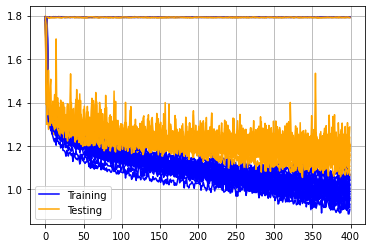

In [7]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [8]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.298686766624451
mean accuracy:  0.4277910016477108


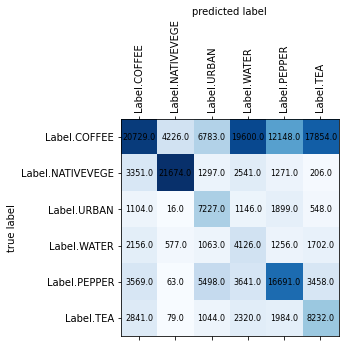

In [9]:
plot_confusion_matrix(conf_matrix, labels)

In [10]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.61419259 0.81374132 0.31542423 0.12362917 0.47351698 0.25725   ]
Recalls:  [0.25484387 0.71437047 0.60527638 0.37922794 0.50701701 0.49890909]
F-Score:  [0.36022243 0.76082492 0.41472512 0.18646902 0.48969473 0.33946392]


# RED, GREEN, COASTAL_AEROSOL

In [11]:
BANDS = [
    Band.RED.value,
    Band.GREEN.value,
    Band.COASTAL_AEROSOL.value
]

In [12]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7866 - accuracy: 0.1133 - val_loss: 1.7924 - val_accuracy: 0.0651
Epoch 47/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7948 - accuracy: 0.1012 - val_loss: 1.7921 - val_accuracy: 0.0892
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7951 - accuracy: 0.0991 - val_loss: 1.7914 - val_accuracy: 0.1799
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8162 - accuracy: 0.1068 - val_loss: 1.7929 - val_accuracy: 0.1799
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8320 - accuracy: 0.1337 - val_loss: 1.7929 - val_accuracy: 0.1631
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8139 - accuracy: 0.1752 - val_loss: 1.7917 - val_accuracy: 0.1799
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7917 - accuracy: 0.1257 - val_loss: 1.7923 - val_accuracy: 0.0892
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7518 - accuracy: 0.1589 - val_loss: 1.7923 - val_accuracy: 0.0594
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7916 - accuracy: 0.0581 - val_loss: 1.7928 - val_accuracy: 0.0594
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8111 - accuracy: 0.0728 - val_loss: 1.7926 - val_accuracy: 0.0594
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8403 - accuracy: 0.0629 - val_loss: 1.7927 - val_accuracy: 0.0594
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7895 - accuracy: 0.0588 - val_loss: 1.7923 - val_accuracy: 0.0651
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8062 - accuracy: 0.0566 - val_loss: 1.7911 - val_accuracy: 0.0594
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8083 - accuracy: 0.0728 - val_loss: 1.7917 - val_accuracy: 0.0594
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8335 - accuracy: 0.0608 - val_loss: 1.7928 - val_accuracy: 0.0594
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7398 - accuracy: 0.1132 - val_loss: 1.7911 - val_accuracy: 0.0594
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8225 - accuracy: 0.0648 - val_loss: 1.7918 - val_accuracy: 0.0594
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7883 - accuracy: 0.0644 - val_loss: 1.7919 - val_accuracy: 0.0594
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7879 - accuracy: 0.0589 - val_loss: 1.7919 - val_accuracy: 0.0594
Epoch 279/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8027 - accuracy: 0.1025 - val_loss: 1.7933 - val_accuracy: 0.0594
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8140 - accuracy: 0.0646 - val_loss: 1.7923 - val_accuracy: 0.0594
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7771 - accuracy: 0.0544 - val_loss: 1.7923 - val_accuracy: 0.0594
Epoch 389/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8075 - accuracy: 0.0686 - val_loss: 1.7920 - val_accuracy: 0.0594
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7752 - accuracy: 0.0532 - val_loss: 1.7943 - val_accuracy: 0.0594
Epoch 391/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7732 - accuracy: 0.0791 - val_loss: 1.7928 - val_accuracy: 0.0594
Epoch 392/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7816 - accuracy: 0.0648 - val_loss: 1.7933 - val_accuracy: 0.0594
Epoch 393/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8166 - accuracy: 0.0683 - val_loss: 1.7929 - val_accuracy: 0.0594
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7269 - accuracy: 0.0921 - val_loss: 1.7921 - val_accuracy: 0.0594
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1504 - accuracy: 0.4323 - val_loss: 1.1921 - val_accuracy: 0.4634
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1491 - accuracy: 0.4461 - val_loss: 1.2447 - val_accuracy: 0.4235
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1778 - accuracy: 0.4427 - val_loss: 1.1989 - val_accuracy: 0.4520
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1225 - accuracy: 0.4554 - val_loss: 1.2237 - val_accuracy: 0.4413
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1188 - accuracy: 0.4585 - val_loss: 1.2096 - val_accuracy: 0.4518
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1153 - accuracy: 0.4349 - val_loss: 1.2046 - val_accuracy: 0.4541
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0985 - accuracy: 0.4467 - val_loss: 1.2196 - val_accuracy: 0.4335
E

57/57 [==============================] - 0s 9ms/step - loss: 0.9972 - accuracy: 0.4835 - val_loss: 1.1716 - val_accuracy: 0.4756
Epoch 213/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0882 - accuracy: 0.4684 - val_loss: 1.2782 - val_accuracy: 0.4268
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0870 - accuracy: 0.4537 - val_loss: 1.2116 - val_accuracy: 0.4471
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0379 - accuracy: 0.4917 - val_loss: 1.2173 - val_accuracy: 0.4511
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0735 - accuracy: 0.4767 - val_loss: 1.1700 - val_accuracy: 0.4850
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0299 - accuracy: 0.4996 - val_loss: 1.2320 - val_accuracy: 0.4407
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0337 - accuracy: 0.4475 - val_loss: 1.2462 - val_accuracy: 0.4249
Epoch 219/400

57/57 [==============================] - 0s 9ms/step - loss: 0.9129 - accuracy: 0.5271 - val_loss: 1.1530 - val_accuracy: 0.4850
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9454 - accuracy: 0.5185 - val_loss: 1.1208 - val_accuracy: 0.5113
Epoch 328/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8939 - accuracy: 0.5430 - val_loss: 1.1318 - val_accuracy: 0.5122
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9334 - accuracy: 0.5364 - val_loss: 1.1307 - val_accuracy: 0.5024
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8791 - accuracy: 0.5594 - val_loss: 1.1206 - val_accuracy: 0.5005
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8907 - accuracy: 0.5398 - val_loss: 1.1171 - val_accuracy: 0.5142
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9373 - accuracy: 0.5305 - val_loss: 1.0881 - val_accuracy: 0.5292
Epoch 333/400

57/57 [==============================] - 1s 9ms/step - loss: 1.3046 - accuracy: 0.4008 - val_loss: 1.3331 - val_accuracy: 0.3844
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2266 - accuracy: 0.3693 - val_loss: 1.2741 - val_accuracy: 0.4638
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2262 - accuracy: 0.4185 - val_loss: 1.2716 - val_accuracy: 0.4359
Epoch 38/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1987 - accuracy: 0.4023 - val_loss: 1.3048 - val_accuracy: 0.4359
Epoch 39/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2801 - accuracy: 0.3823 - val_loss: 1.2566 - val_accuracy: 0.4627
Epoch 40/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2116 - accuracy: 0.3646 - val_loss: 1.2757 - val_accuracy: 0.4307
Epoch 41/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1992 - accuracy: 0.4129 - val_loss: 1.2577 - val_accuracy: 0.4517
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1956 - accuracy: 0.4293 - val_loss: 1.2126 - val_accuracy: 0.4558
Epoch 94/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1873 - accuracy: 0.4098 - val_loss: 1.1870 - val_accuracy: 0.4825
Epoch 95/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1336 - accuracy: 0.4836 - val_loss: 1.2638 - val_accuracy: 0.4036
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0970 - accuracy: 0.4440 - val_loss: 1.2721 - val_accuracy: 0.4014
Epoch 97/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1462 - accuracy: 0.3989 - val_loss: 1.2200 - val_accuracy: 0.4129
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1815 - accuracy: 0.3859 - val_loss: 1.2150 - val_accuracy: 0.4430
Epoch 99/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1133 - accuracy: 0.4569 - val_loss: 1.2220 - val_accuracy: 0.4499
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0872 - accuracy: 0.4406 - val_loss: 1.1701 - val_accuracy: 0.4676
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0795 - accuracy: 0.4522 - val_loss: 1.1865 - val_accuracy: 0.4481
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0541 - accuracy: 0.4664 - val_loss: 1.1611 - val_accuracy: 0.4833
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0960 - accuracy: 0.4571 - val_loss: 1.1660 - val_accuracy: 0.4657
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0334 - accuracy: 0.4447 - val_loss: 1.1943 - val_accuracy: 0.4541
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0389 - accuracy: 0.4271 - val_loss: 1.1484 - val_accuracy: 0.4721
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0463 - accuracy: 0.4471 - val_loss: 1.1754 - val_accuracy: 0.4658
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0266 - accuracy: 0.4660 - val_loss: 1.1358 - val_accuracy: 0.4755
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0014 - accuracy: 0.4634 - val_loss: 1.1989 - val_accuracy: 0.4548
Epoch 323/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0139 - accuracy: 0.4578 - val_loss: 1.1654 - val_accuracy: 0.4727
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0072 - accuracy: 0.4631 - val_loss: 1.1589 - val_accuracy: 0.4782
Epoch 325/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0525 - accuracy: 0.4665 - val_loss: 1.1787 - val_accuracy: 0.4718
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0499 - accuracy: 0.4579 - val_loss: 1.1631 - val_accuracy: 0.4532
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0385 - accuracy: 0.4608 - val_loss: 1.1855 - val_accuracy: 0.4679
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1719 - accuracy: 0.4133 - val_loss: 1.2890 - val_accuracy: 0.3716
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1767 - accuracy: 0.4133 - val_loss: 1.2895 - val_accuracy: 0.3792
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2222 - accuracy: 0.3648 - val_loss: 1.2924 - val_accuracy: 0.3726
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2238 - accuracy: 0.3938 - val_loss: 1.3273 - val_accuracy: 0.3603
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2200 - accuracy: 0.3807 - val_loss: 1.3073 - val_accuracy: 0.3665
Epoch 35/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2564 - accuracy: 0.3997 - val_loss: 1.2504 - val_accuracy: 0.4133
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1342 - accuracy: 0.4354 - val_loss: 1.2751 - val_accuracy: 0.3654
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1909 - accuracy: 0.3971 - val_loss: 1.2711 - val_accuracy: 0.3860
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0895 - accuracy: 0.4388 - val_loss: 1.2585 - val_accuracy: 0.3970
Epoch 90/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1929 - accuracy: 0.4513 - val_loss: 1.2947 - val_accuracy: 0.3795
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1000 - accuracy: 0.4529 - val_loss: 1.2952 - val_accuracy: 0.3795
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1483 - accuracy: 0.3986 - val_loss: 1.2881 - val_accuracy: 0.4007
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1698 - accuracy: 0.4331 - val_loss: 1.3439 - val_accuracy: 0.3643
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1646 - accuracy: 0.4012 - val_loss: 1.2780 - val_accuracy: 0.3870
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0565 - accuracy: 0.4467 - val_loss: 1.2273 - val_accuracy: 0.4197
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0589 - accuracy: 0.4501 - val_loss: 1.1932 - val_accuracy: 0.4435
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0959 - accuracy: 0.4552 - val_loss: 1.1959 - val_accuracy: 0.4325
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0336 - accuracy: 0.4783 - val_loss: 1.2494 - val_accuracy: 0.4059
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0102 - accuracy: 0.4471 - val_loss: 1.2080 - val_accuracy: 0.4075
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0708 - accuracy: 0.4378 - val_loss: 1.2311 - val_accuracy: 0.4052
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0393 - accuracy: 0.4696 - val_loss: 1.2130 - val_accuracy: 0.4184
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0499 - accuracy: 0.4426 - val_loss: 1.2956 - val_accuracy: 0.3843
Epoch 317/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0622 - accuracy: 0.4655 - val_loss: 1.1778 - val_accuracy: 0.4356
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0644 - accuracy: 0.4461 - val_loss: 1.2628 - val_accuracy: 0.4101
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0214 - accuracy: 0.4617 - val_loss: 1.2757 - val_accuracy: 0.4188
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0702 - accuracy: 0.4536 - val_loss: 1.1746 - val_accuracy: 0.4450
Epoch 321/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9746 - accuracy: 0.4822 - val_loss: 1.2213 - val_accuracy: 0.4110
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0072 - accuracy: 0.4525 - val_loss: 1.1857 - val_accuracy: 0.4271
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2263 - accuracy: 0.3730 - val_loss: 1.2776 - val_accuracy: 0.4276
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2221 - accuracy: 0.4045 - val_loss: 1.3718 - val_accuracy: 0.3996
Epoch 27/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2790 - accuracy: 0.3765 - val_loss: 1.2706 - val_accuracy: 0.4318
Epoch 28/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2515 - accuracy: 0.3598 - val_loss: 1.3072 - val_accuracy: 0.3742
Epoch 29/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2488 - accuracy: 0.3650 - val_loss: 1.3148 - val_accuracy: 0.3546
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2604 - accuracy: 0.3972 - val_loss: 1.2305 - val_accuracy: 0.4786
Epoch 31/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3317 - accuracy: 0.3621 - val_loss: 1.2653 - val_accuracy: 0.4208
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0847 - accuracy: 0.4209 - val_loss: 1.2607 - val_accuracy: 0.3819
Epoch 84/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2341 - accuracy: 0.3907 - val_loss: 1.2665 - val_accuracy: 0.4059
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1127 - accuracy: 0.4427 - val_loss: 1.2237 - val_accuracy: 0.3992
Epoch 86/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1597 - accuracy: 0.3985 - val_loss: 1.2484 - val_accuracy: 0.4131
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1397 - accuracy: 0.4298 - val_loss: 1.2168 - val_accuracy: 0.4166
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1274 - accuracy: 0.4162 - val_loss: 1.2808 - val_accuracy: 0.3802
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2464 - accuracy: 0.3898 - val_loss: 1.1706 - val_accuracy: 0.4741
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0508 - accuracy: 0.4225 - val_loss: 1.2202 - val_accuracy: 0.4038
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0559 - accuracy: 0.4054 - val_loss: 1.1577 - val_accuracy: 0.4350
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0202 - accuracy: 0.4317 - val_loss: 1.2630 - val_accuracy: 0.3938
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0794 - accuracy: 0.4393 - val_loss: 1.1568 - val_accuracy: 0.4445
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0624 - accuracy: 0.4485 - val_loss: 1.1704 - val_accuracy: 0.4314
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0633 - accuracy: 0.4319 - val_loss: 1.2033 - val_accuracy: 0.4036
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0593 - accuracy: 0.4384 - val_loss: 1.1700 - val_accuracy: 0.4355
Epoch 204/400

57/57 [==============================] - 1s 9ms/step - loss: 0.9738 - accuracy: 0.5065 - val_loss: 1.1303 - val_accuracy: 0.4763
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9755 - accuracy: 0.5119 - val_loss: 1.1327 - val_accuracy: 0.4761
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9368 - accuracy: 0.4791 - val_loss: 1.1884 - val_accuracy: 0.4464
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9421 - accuracy: 0.4786 - val_loss: 1.1413 - val_accuracy: 0.4662
Epoch 315/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9381 - accuracy: 0.4959 - val_loss: 1.1484 - val_accuracy: 0.4684
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9271 - accuracy: 0.4828 - val_loss: 1.1576 - val_accuracy: 0.4632
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9740 - accuracy: 0.4639 - val_loss: 1.1812 - val_accuracy: 0.4575
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3250 - accuracy: 0.3700 - val_loss: 1.3210 - val_accuracy: 0.3941
Epoch 21/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2162 - accuracy: 0.3894 - val_loss: 1.2958 - val_accuracy: 0.3945
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2509 - accuracy: 0.4111 - val_loss: 1.3006 - val_accuracy: 0.4013
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2001 - accuracy: 0.4094 - val_loss: 1.2896 - val_accuracy: 0.3675
Epoch 24/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2455 - accuracy: 0.3837 - val_loss: 1.2645 - val_accuracy: 0.4388
Epoch 25/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2422 - accuracy: 0.3955 - val_loss: 1.2770 - val_accuracy: 0.4218
Epoch 26/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2495 - accuracy: 0.4027 - val_loss: 1.2774 - val_accuracy: 0.4032
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1413 - accuracy: 0.4143 - val_loss: 1.2650 - val_accuracy: 0.3998
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2304 - accuracy: 0.4093 - val_loss: 1.2509 - val_accuracy: 0.4195
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1815 - accuracy: 0.4267 - val_loss: 1.2229 - val_accuracy: 0.4326
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1726 - accuracy: 0.4553 - val_loss: 1.2555 - val_accuracy: 0.4275
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1472 - accuracy: 0.4331 - val_loss: 1.2465 - val_accuracy: 0.4182
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1832 - accuracy: 0.4433 - val_loss: 1.2501 - val_accuracy: 0.4021
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1952 - accuracy: 0.3951 - val_loss: 1.2623 - val_accuracy: 0.4074
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0671 - accuracy: 0.4517 - val_loss: 1.2124 - val_accuracy: 0.4361
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0622 - accuracy: 0.4269 - val_loss: 1.1978 - val_accuracy: 0.4356
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1182 - accuracy: 0.4060 - val_loss: 1.1830 - val_accuracy: 0.4455
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0807 - accuracy: 0.4623 - val_loss: 1.1984 - val_accuracy: 0.4395
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0963 - accuracy: 0.4413 - val_loss: 1.2300 - val_accuracy: 0.4345
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0922 - accuracy: 0.4284 - val_loss: 1.2051 - val_accuracy: 0.4364
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0539 - accuracy: 0.4354 - val_loss: 1.2161 - val_accuracy: 0.4288
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0217 - accuracy: 0.4896 - val_loss: 1.1644 - val_accuracy: 0.4708
Epoch 307/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0671 - accuracy: 0.4901 - val_loss: 1.1569 - val_accuracy: 0.4592
Epoch 308/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9868 - accuracy: 0.4789 - val_loss: 1.1662 - val_accuracy: 0.4528
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0224 - accuracy: 0.4723 - val_loss: 1.1582 - val_accuracy: 0.4716
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0514 - accuracy: 0.4668 - val_loss: 1.1716 - val_accuracy: 0.4409
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0170 - accuracy: 0.4625 - val_loss: 1.2098 - val_accuracy: 0.4625
Epoch 312/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0076 - accuracy: 0.4729 - val_loss: 1.1828 - val_accuracy: 0.4462
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3123 - accuracy: 0.3504 - val_loss: 1.2674 - val_accuracy: 0.4452
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3865 - accuracy: 0.3786 - val_loss: 1.2922 - val_accuracy: 0.4052
Epoch 17/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3173 - accuracy: 0.3532 - val_loss: 1.3260 - val_accuracy: 0.3906
Epoch 18/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3247 - accuracy: 0.3814 - val_loss: 1.2632 - val_accuracy: 0.4462
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2974 - accuracy: 0.3896 - val_loss: 1.2639 - val_accuracy: 0.4411
Epoch 20/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3113 - accuracy: 0.3900 - val_loss: 1.2777 - val_accuracy: 0.4520
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2411 - accuracy: 0.4046 - val_loss: 1.2692 - val_accuracy: 0.4239
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 1s 10ms/step - loss: 1.1891 - accuracy: 0.4193 - val_loss: 1.2404 - val_accuracy: 0.4223
Epoch 74/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1558 - accuracy: 0.4131 - val_loss: 1.2389 - val_accuracy: 0.4301
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1740 - accuracy: 0.4000 - val_loss: 1.2497 - val_accuracy: 0.4124
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1898 - accuracy: 0.4069 - val_loss: 1.2461 - val_accuracy: 0.4172
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1173 - accuracy: 0.4228 - val_loss: 1.2993 - val_accuracy: 0.3715
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1943 - accuracy: 0.3811 - val_loss: 1.2615 - val_accuracy: 0.3887
Epoch 79/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1785 - accuracy: 0.4106 - val_loss: 1.2843 - val_accuracy: 0.4208
Epoch

57/57 [==============================] - 0s 9ms/step - loss: 1.1268 - accuracy: 0.4405 - val_loss: 1.2349 - val_accuracy: 0.4441
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0921 - accuracy: 0.4250 - val_loss: 1.2167 - val_accuracy: 0.4428
Epoch 189/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0416 - accuracy: 0.4592 - val_loss: 1.2272 - val_accuracy: 0.4390
Epoch 190/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0743 - accuracy: 0.4494 - val_loss: 1.2419 - val_accuracy: 0.4214
Epoch 191/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0778 - accuracy: 0.4229 - val_loss: 1.2205 - val_accuracy: 0.4498
Epoch 192/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0924 - accuracy: 0.4396 - val_loss: 1.2519 - val_accuracy: 0.4180
Epoch 193/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0554 - accuracy: 0.4481 - val_loss: 1.2342 - val_accuracy: 0.4365
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0267 - accuracy: 0.4642 - val_loss: 1.2113 - val_accuracy: 0.4420
Epoch 302/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0944 - accuracy: 0.4541 - val_loss: 1.2235 - val_accuracy: 0.4520
Epoch 303/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1360 - accuracy: 0.4365 - val_loss: 1.2305 - val_accuracy: 0.4491
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0374 - accuracy: 0.4647 - val_loss: 1.2638 - val_accuracy: 0.4167
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0453 - accuracy: 0.4544 - val_loss: 1.1903 - val_accuracy: 0.4698
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0180 - accuracy: 0.4528 - val_loss: 1.1876 - val_accuracy: 0.4598
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9860 - accuracy: 0.4670 - val_loss: 1.2064 - val_accuracy: 0.4520
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2985 - accuracy: 0.3563 - val_loss: 1.3017 - val_accuracy: 0.3545
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2468 - accuracy: 0.4064 - val_loss: 1.3469 - val_accuracy: 0.3669
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2124 - accuracy: 0.3909 - val_loss: 1.2916 - val_accuracy: 0.4275
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2162 - accuracy: 0.4174 - val_loss: 1.3067 - val_accuracy: 0.3870
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2099 - accuracy: 0.3566 - val_loss: 1.3125 - val_accuracy: 0.3868
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2560 - accuracy: 0.3942 - val_loss: 1.2790 - val_accuracy: 0.4192
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3021 - accuracy: 0.3910 - val_loss: 1.2926 - val_accuracy: 0.4104
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2006 - accuracy: 0.3877 - val_loss: 1.2727 - val_accuracy: 0.4344
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1796 - accuracy: 0.4216 - val_loss: 1.3120 - val_accuracy: 0.3609
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1782 - accuracy: 0.3625 - val_loss: 1.2764 - val_accuracy: 0.3974
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2311 - accuracy: 0.3642 - val_loss: 1.2779 - val_accuracy: 0.4197
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2247 - accuracy: 0.3714 - val_loss: 1.3194 - val_accuracy: 0.4032
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2149 - accuracy: 0.4096 - val_loss: 1.2610 - val_accuracy: 0.4263
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2041 - accuracy: 0.4081 - val_loss: 1.2386 - val_accuracy: 0.4571
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0609 - accuracy: 0.4501 - val_loss: 1.2332 - val_accuracy: 0.4377
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0754 - accuracy: 0.4293 - val_loss: 1.1831 - val_accuracy: 0.4454
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0965 - accuracy: 0.4192 - val_loss: 1.2112 - val_accuracy: 0.4340
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0969 - accuracy: 0.4328 - val_loss: 1.2016 - val_accuracy: 0.4371
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1285 - accuracy: 0.4336 - val_loss: 1.3087 - val_accuracy: 0.3766
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0736 - accuracy: 0.4202 - val_loss: 1.2131 - val_accuracy: 0.4225
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0844 - accuracy: 0.4215 - val_loss: 1.2113 - val_accuracy: 0.4394
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0084 - accuracy: 0.4892 - val_loss: 1.1954 - val_accuracy: 0.4420
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0353 - accuracy: 0.4835 - val_loss: 1.1790 - val_accuracy: 0.4498
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0379 - accuracy: 0.4784 - val_loss: 1.2096 - val_accuracy: 0.4503
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0651 - accuracy: 0.4570 - val_loss: 1.1805 - val_accuracy: 0.4548
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9783 - accuracy: 0.4719 - val_loss: 1.1361 - val_accuracy: 0.4726
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0423 - accuracy: 0.4581 - val_loss: 1.1723 - val_accuracy: 0.4511
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0406 - accuracy: 0.4520 - val_loss: 1.1679 - val_accuracy: 0.4560
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3407 - accuracy: 0.3677 - val_loss: 1.2854 - val_accuracy: 0.5128
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3494 - accuracy: 0.4029 - val_loss: 1.3562 - val_accuracy: 0.3019
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2999 - accuracy: 0.3505 - val_loss: 1.4287 - val_accuracy: 0.3129
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2644 - accuracy: 0.3814 - val_loss: 1.3028 - val_accuracy: 0.4056
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2700 - accuracy: 0.3653 - val_loss: 1.3603 - val_accuracy: 0.3096
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2543 - accuracy: 0.3671 - val_loss: 1.3037 - val_accuracy: 0.3966
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3231 - accuracy: 0.3544 - val_loss: 1.2921 - val_accuracy: 0.4037
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1713 - accuracy: 0.3848 - val_loss: 1.2700 - val_accuracy: 0.4136
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2257 - accuracy: 0.3937 - val_loss: 1.2757 - val_accuracy: 0.4305
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2017 - accuracy: 0.4033 - val_loss: 1.2868 - val_accuracy: 0.4144
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1868 - accuracy: 0.4289 - val_loss: 1.2752 - val_accuracy: 0.3913
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2438 - accuracy: 0.4038 - val_loss: 1.2549 - val_accuracy: 0.4237
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1678 - accuracy: 0.4179 - val_loss: 1.2824 - val_accuracy: 0.3928
Epoch 69/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1992 - accuracy: 0.4196 - val_loss: 1.2323 - val_accuracy: 0.4355
Epoch 

57/57 [==============================] - 0s 9ms/step - loss: 1.0995 - accuracy: 0.4211 - val_loss: 1.2069 - val_accuracy: 0.4483
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0555 - accuracy: 0.4792 - val_loss: 1.2262 - val_accuracy: 0.4437
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1405 - accuracy: 0.4632 - val_loss: 1.2336 - val_accuracy: 0.4276
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1366 - accuracy: 0.4268 - val_loss: 1.2738 - val_accuracy: 0.4037
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1535 - accuracy: 0.4452 - val_loss: 1.2174 - val_accuracy: 0.4521
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1172 - accuracy: 0.4599 - val_loss: 1.2627 - val_accuracy: 0.4174
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1273 - accuracy: 0.4237 - val_loss: 1.2451 - val_accuracy: 0.4204
Epoch 184/400

57/57 [==============================] - 0s 9ms/step - loss: 1.1591 - accuracy: 0.4587 - val_loss: 1.2076 - val_accuracy: 0.4650
Epoch 292/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0783 - accuracy: 0.4984 - val_loss: 1.2184 - val_accuracy: 0.4613
Epoch 293/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0801 - accuracy: 0.4940 - val_loss: 1.2402 - val_accuracy: 0.4484
Epoch 294/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0899 - accuracy: 0.4792 - val_loss: 1.2126 - val_accuracy: 0.4693
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0607 - accuracy: 0.4801 - val_loss: 1.2080 - val_accuracy: 0.4611
Epoch 296/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1036 - accuracy: 0.4483 - val_loss: 1.1955 - val_accuracy: 0.4649
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1166 - accuracy: 0.4709 - val_loss: 1.1962 - val_accuracy: 0.4730
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7740 - accuracy: 0.1471 - val_loss: 1.7933 - val_accuracy: 0.0885
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7674 - accuracy: 0.1372 - val_loss: 1.7924 - val_accuracy: 0.0999
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7889 - accuracy: 0.1313 - val_loss: 1.7827 - val_accuracy: 0.0858
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7022 - accuracy: 0.2036 - val_loss: 1.6106 - val_accuracy: 0.2585
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4786 - accuracy: 0.3422 - val_loss: 1.4513 - val_accuracy: 0.3959
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4233 - accuracy: 0.3444 - val_loss: 1.3310 - val_accuracy: 0.5016
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3438 - accuracy: 0.4259 - val_loss: 1.3403 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1112 - accuracy: 0.4118 - val_loss: 1.1944 - val_accuracy: 0.4431
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1686 - accuracy: 0.4154 - val_loss: 1.2177 - val_accuracy: 0.4360
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0617 - accuracy: 0.4615 - val_loss: 1.1986 - val_accuracy: 0.4524
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0729 - accuracy: 0.4416 - val_loss: 1.2188 - val_accuracy: 0.4397
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0897 - accuracy: 0.4377 - val_loss: 1.2541 - val_accuracy: 0.4165
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1465 - accuracy: 0.4293 - val_loss: 1.2517 - val_accuracy: 0.4257
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1100 - accuracy: 0.4471 - val_loss: 1.2436 - val_accuracy: 0.4257

57/57 [==============================] - 0s 8ms/step - loss: 1.0848 - accuracy: 0.4385 - val_loss: 1.2145 - val_accuracy: 0.4322
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0320 - accuracy: 0.4270 - val_loss: 1.2570 - val_accuracy: 0.4215
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1144 - accuracy: 0.4242 - val_loss: 1.1976 - val_accuracy: 0.4445
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0148 - accuracy: 0.4403 - val_loss: 1.1902 - val_accuracy: 0.4422
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0204 - accuracy: 0.4381 - val_loss: 1.2424 - val_accuracy: 0.4173
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0706 - accuracy: 0.4271 - val_loss: 1.1949 - val_accuracy: 0.4496
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1292 - accuracy: 0.4307 - val_loss: 1.2431 - val_accuracy: 0.4423
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1119 - accuracy: 0.4469 - val_loss: 1.1831 - val_accuracy: 0.4577
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9773 - accuracy: 0.4651 - val_loss: 1.2656 - val_accuracy: 0.4000
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0151 - accuracy: 0.4400 - val_loss: 1.1924 - val_accuracy: 0.4499
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0100 - accuracy: 0.4424 - val_loss: 1.1979 - val_accuracy: 0.4442
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0421 - accuracy: 0.4447 - val_loss: 1.1944 - val_accuracy: 0.4564
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0521 - accuracy: 0.4585 - val_loss: 1.1831 - val_accuracy: 0.4592
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0093 - accuracy: 0.4439 - val_loss: 1.1874 - val_accuracy: 0.4514
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7866 - accuracy: 0.1716 - val_loss: 1.7873 - val_accuracy: 0.1804
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7635 - accuracy: 0.2094 - val_loss: 1.6734 - val_accuracy: 0.2742
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4732 - accuracy: 0.3137 - val_loss: 1.4044 - val_accuracy: 0.2868
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3493 - accuracy: 0.3313 - val_loss: 1.3470 - val_accuracy: 0.2969
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3773 - accuracy: 0.3477 - val_loss: 1.3059 - val_accuracy: 0.4713
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3282 - accuracy: 0.3892 - val_loss: 1.2962 - val_accuracy: 0.4986
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4114 - accuracy: 0.3450 - val_loss: 1.2573 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2431 - accuracy: 0.4199 - val_loss: 1.2091 - val_accuracy: 0.4429
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1315 - accuracy: 0.3914 - val_loss: 1.2024 - val_accuracy: 0.4414
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1532 - accuracy: 0.4106 - val_loss: 1.2011 - val_accuracy: 0.4509
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1627 - accuracy: 0.3997 - val_loss: 1.2560 - val_accuracy: 0.4044
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1055 - accuracy: 0.3956 - val_loss: 1.2251 - val_accuracy: 0.4187
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1683 - accuracy: 0.4105 - val_loss: 1.2433 - val_accuracy: 0.4088
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0837 - accuracy: 0.4191 - val_loss: 1.2308 - val_accuracy: 0.4411

57/57 [==============================] - 0s 8ms/step - loss: 1.0653 - accuracy: 0.4431 - val_loss: 1.1742 - val_accuracy: 0.4598
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0618 - accuracy: 0.4301 - val_loss: 1.1706 - val_accuracy: 0.4466
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0052 - accuracy: 0.4549 - val_loss: 1.1739 - val_accuracy: 0.4338
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1244 - accuracy: 0.4101 - val_loss: 1.1957 - val_accuracy: 0.4341
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0536 - accuracy: 0.4090 - val_loss: 1.2180 - val_accuracy: 0.4414
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1318 - accuracy: 0.4344 - val_loss: 1.1685 - val_accuracy: 0.4377
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0650 - accuracy: 0.4251 - val_loss: 1.1796 - val_accuracy: 0.4439
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0354 - accuracy: 0.4708 - val_loss: 1.1528 - val_accuracy: 0.4581
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0117 - accuracy: 0.4403 - val_loss: 1.1723 - val_accuracy: 0.4530
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9869 - accuracy: 0.4587 - val_loss: 1.1544 - val_accuracy: 0.4504
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9928 - accuracy: 0.4530 - val_loss: 1.2143 - val_accuracy: 0.4213
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0486 - accuracy: 0.4370 - val_loss: 1.1717 - val_accuracy: 0.4583
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9800 - accuracy: 0.4613 - val_loss: 1.1966 - val_accuracy: 0.4460
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9875 - accuracy: 0.4834 - val_loss: 1.3505 - val_accuracy: 0.3842
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7475 - accuracy: 0.1855 - val_loss: 1.7905 - val_accuracy: 0.1816
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7866 - accuracy: 0.1793 - val_loss: 1.7168 - val_accuracy: 0.2671
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6112 - accuracy: 0.2747 - val_loss: 1.3943 - val_accuracy: 0.3209
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3981 - accuracy: 0.3441 - val_loss: 1.3466 - val_accuracy: 0.4581
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4235 - accuracy: 0.3243 - val_loss: 1.2665 - val_accuracy: 0.4953
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2824 - accuracy: 0.4319 - val_loss: 1.3244 - val_accuracy: 0.3334
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3300 - accuracy: 0.3722 - val_loss: 1.3383 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1480 - accuracy: 0.3915 - val_loss: 1.2056 - val_accuracy: 0.3860
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0292 - accuracy: 0.4090 - val_loss: 1.2975 - val_accuracy: 0.3439
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1086 - accuracy: 0.4023 - val_loss: 1.2999 - val_accuracy: 0.3452
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1515 - accuracy: 0.4064 - val_loss: 1.2064 - val_accuracy: 0.3841
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1301 - accuracy: 0.4142 - val_loss: 1.2099 - val_accuracy: 0.3979
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1402 - accuracy: 0.3909 - val_loss: 1.2511 - val_accuracy: 0.3757
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1041 - accuracy: 0.4145 - val_loss: 1.2466 - val_accuracy: 0.3764

57/57 [==============================] - 0s 8ms/step - loss: 1.0220 - accuracy: 0.4351 - val_loss: 1.2096 - val_accuracy: 0.3841
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0265 - accuracy: 0.4125 - val_loss: 1.2515 - val_accuracy: 0.3766
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0338 - accuracy: 0.3992 - val_loss: 1.2174 - val_accuracy: 0.3896
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0145 - accuracy: 0.4231 - val_loss: 1.1907 - val_accuracy: 0.4101
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0374 - accuracy: 0.4334 - val_loss: 1.2021 - val_accuracy: 0.3809
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0597 - accuracy: 0.4212 - val_loss: 1.1679 - val_accuracy: 0.4079
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0107 - accuracy: 0.4309 - val_loss: 1.2708 - val_accuracy: 0.3553
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9669 - accuracy: 0.4303 - val_loss: 1.1464 - val_accuracy: 0.4473
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9269 - accuracy: 0.4628 - val_loss: 1.1298 - val_accuracy: 0.4450
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9524 - accuracy: 0.4617 - val_loss: 1.1341 - val_accuracy: 0.4312
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9405 - accuracy: 0.4659 - val_loss: 1.1677 - val_accuracy: 0.4204
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9573 - accuracy: 0.4498 - val_loss: 1.1449 - val_accuracy: 0.4381
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9458 - accuracy: 0.4607 - val_loss: 1.1337 - val_accuracy: 0.4332
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9604 - accuracy: 0.4583 - val_loss: 1.0886 - val_accuracy: 0.4602
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7393 - accuracy: 0.3639 - val_loss: 1.7859 - val_accuracy: 0.4416
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8289 - accuracy: 0.2973 - val_loss: 1.7887 - val_accuracy: 0.1660
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7799 - accuracy: 0.2335 - val_loss: 1.7885 - val_accuracy: 0.1660
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8066 - accuracy: 0.2126 - val_loss: 1.7873 - val_accuracy: 0.1660
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7893 - accuracy: 0.2151 - val_loss: 1.7876 - val_accuracy: 0.1660
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7654 - accuracy: 0.2074 - val_loss: 1.7871 - val_accuracy: 0.1660
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7928 - accuracy: 0.1841 - val_loss: 1.7912 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7155 - accuracy: 0.2520 - val_loss: 1.7914 - val_accuracy: 0.0903
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8053 - accuracy: 0.1311 - val_loss: 1.7917 - val_accuracy: 0.0903
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8215 - accuracy: 0.0675 - val_loss: 1.7934 - val_accuracy: 0.0903
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7870 - accuracy: 0.0777 - val_loss: 1.7925 - val_accuracy: 0.0597
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7666 - accuracy: 0.0755 - val_loss: 1.7927 - val_accuracy: 0.0903
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8100 - accuracy: 0.0647 - val_loss: 1.7945 - val_accuracy: 0.0597
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8105 - accuracy: 0.0684 - val_loss: 1.7929 - val_accuracy: 0.0597

57/57 [==============================] - 0s 8ms/step - loss: 1.7602 - accuracy: 0.1036 - val_loss: 1.7919 - val_accuracy: 0.0597
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7798 - accuracy: 0.0647 - val_loss: 1.7910 - val_accuracy: 0.0597
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7487 - accuracy: 0.1503 - val_loss: 1.7916 - val_accuracy: 0.1789
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7640 - accuracy: 0.2204 - val_loss: 1.7904 - val_accuracy: 0.4416
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7707 - accuracy: 0.3998 - val_loss: 1.7921 - val_accuracy: 0.0597
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7718 - accuracy: 0.1666 - val_loss: 1.7904 - val_accuracy: 0.1789
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8218 - accuracy: 0.1601 - val_loss: 1.7918 - val_accuracy: 0.0636
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 1.8242 - accuracy: 0.0634 - val_loss: 1.7921 - val_accuracy: 0.0636
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8278 - accuracy: 0.0788 - val_loss: 1.7915 - val_accuracy: 0.0903
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7960 - accuracy: 0.0852 - val_loss: 1.7912 - val_accuracy: 0.0636
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7515 - accuracy: 0.2727 - val_loss: 1.7904 - val_accuracy: 0.4416
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7752 - accuracy: 0.3770 - val_loss: 1.7914 - val_accuracy: 0.1660
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7630 - accuracy: 0.1295 - val_loss: 1.7909 - val_accuracy: 0.4416
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7842 - accuracy: 0.1851 - val_loss: 1.7918 - val_accuracy: 0.0636
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7961 - accuracy: 0.1499 - val_loss: 1.7856 - val_accuracy: 0.4915
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7833 - accuracy: 0.2393 - val_loss: 1.5299 - val_accuracy: 0.3557
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3535 - accuracy: 0.4091 - val_loss: 1.3650 - val_accuracy: 0.2910
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3269 - accuracy: 0.3981 - val_loss: 1.3766 - val_accuracy: 0.3427
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2929 - accuracy: 0.3925 - val_loss: 1.3504 - val_accuracy: 0.3178
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2951 - accuracy: 0.4104 - val_loss: 1.3360 - val_accuracy: 0.3624
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3044 - accuracy: 0.3300 - val_loss: 1.3582 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1177 - accuracy: 0.4240 - val_loss: 1.2136 - val_accuracy: 0.4336
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0848 - accuracy: 0.4242 - val_loss: 1.2342 - val_accuracy: 0.4279
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1418 - accuracy: 0.4141 - val_loss: 1.2755 - val_accuracy: 0.3921
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1135 - accuracy: 0.4196 - val_loss: 1.2246 - val_accuracy: 0.4320
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0837 - accuracy: 0.4446 - val_loss: 1.2419 - val_accuracy: 0.4200
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1588 - accuracy: 0.4111 - val_loss: 1.3727 - val_accuracy: 0.3811
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1785 - accuracy: 0.4078 - val_loss: 1.2472 - val_accuracy: 0.4173

57/57 [==============================] - 0s 8ms/step - loss: 1.0237 - accuracy: 0.4600 - val_loss: 1.2496 - val_accuracy: 0.4200
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0477 - accuracy: 0.4681 - val_loss: 1.2538 - val_accuracy: 0.4220
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0688 - accuracy: 0.4625 - val_loss: 1.2128 - val_accuracy: 0.4389
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0386 - accuracy: 0.4572 - val_loss: 1.2889 - val_accuracy: 0.4082
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0545 - accuracy: 0.4544 - val_loss: 1.2197 - val_accuracy: 0.4284
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0567 - accuracy: 0.4472 - val_loss: 1.1921 - val_accuracy: 0.4522
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0573 - accuracy: 0.4442 - val_loss: 1.2601 - val_accuracy: 0.4090
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0230 - accuracy: 0.4843 - val_loss: 1.1843 - val_accuracy: 0.4615
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9964 - accuracy: 0.4745 - val_loss: 1.1962 - val_accuracy: 0.4555
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9437 - accuracy: 0.5127 - val_loss: 1.1847 - val_accuracy: 0.4670
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0196 - accuracy: 0.4678 - val_loss: 1.1881 - val_accuracy: 0.4462
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9408 - accuracy: 0.4877 - val_loss: 1.1943 - val_accuracy: 0.4643
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0116 - accuracy: 0.4916 - val_loss: 1.1873 - val_accuracy: 0.4632
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9521 - accuracy: 0.4881 - val_loss: 1.1890 - val_accuracy: 0.4479
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7760 - accuracy: 0.1696 - val_loss: 1.7907 - val_accuracy: 0.1672
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7568 - accuracy: 0.1657 - val_loss: 1.7913 - val_accuracy: 0.1766
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7868 - accuracy: 0.1626 - val_loss: 1.7508 - val_accuracy: 0.2807
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7018 - accuracy: 0.2297 - val_loss: 1.5681 - val_accuracy: 0.4173
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4748 - accuracy: 0.3518 - val_loss: 1.3967 - val_accuracy: 0.3463
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4150 - accuracy: 0.3473 - val_loss: 1.3107 - val_accuracy: 0.4153
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3755 - accuracy: 0.3989 - val_loss: 1.3457 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1122 - accuracy: 0.4476 - val_loss: 1.2363 - val_accuracy: 0.4299
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1460 - accuracy: 0.4391 - val_loss: 1.2021 - val_accuracy: 0.4532
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1521 - accuracy: 0.4425 - val_loss: 1.1991 - val_accuracy: 0.4509
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1030 - accuracy: 0.4524 - val_loss: 1.2302 - val_accuracy: 0.4218
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1315 - accuracy: 0.4474 - val_loss: 1.2886 - val_accuracy: 0.3973
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1181 - accuracy: 0.4163 - val_loss: 1.1913 - val_accuracy: 0.4525
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1393 - accuracy: 0.4123 - val_loss: 1.1915 - val_accuracy: 0.4537

57/57 [==============================] - 0s 8ms/step - loss: 1.0688 - accuracy: 0.4793 - val_loss: 1.1773 - val_accuracy: 0.4810
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1129 - accuracy: 0.4863 - val_loss: 1.2112 - val_accuracy: 0.4680
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0689 - accuracy: 0.4835 - val_loss: 1.2564 - val_accuracy: 0.4340
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0545 - accuracy: 0.4731 - val_loss: 1.2126 - val_accuracy: 0.4699
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1251 - accuracy: 0.4579 - val_loss: 1.1708 - val_accuracy: 0.4961
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1339 - accuracy: 0.4796 - val_loss: 1.2200 - val_accuracy: 0.4794
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0700 - accuracy: 0.4960 - val_loss: 1.1863 - val_accuracy: 0.4745
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0623 - accuracy: 0.5056 - val_loss: 1.1757 - val_accuracy: 0.4968
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0602 - accuracy: 0.5123 - val_loss: 1.1672 - val_accuracy: 0.5080
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9674 - accuracy: 0.5274 - val_loss: 1.2374 - val_accuracy: 0.4533
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0270 - accuracy: 0.4964 - val_loss: 1.1977 - val_accuracy: 0.4831
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0026 - accuracy: 0.5033 - val_loss: 1.1720 - val_accuracy: 0.5051
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0000 - accuracy: 0.5116 - val_loss: 1.1765 - val_accuracy: 0.4906
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0090 - accuracy: 0.5010 - val_loss: 1.2168 - val_accuracy: 0.4798
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8219 - accuracy: 0.0919 - val_loss: 1.7923 - val_accuracy: 0.1838
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7411 - accuracy: 0.1588 - val_loss: 1.5126 - val_accuracy: 0.2848
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4343 - accuracy: 0.3489 - val_loss: 1.3733 - val_accuracy: 0.3264
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3312 - accuracy: 0.3778 - val_loss: 1.3190 - val_accuracy: 0.4740
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3540 - accuracy: 0.3843 - val_loss: 1.2834 - val_accuracy: 0.5298
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3701 - accuracy: 0.3759 - val_loss: 1.3197 - val_accuracy: 0.3876
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2198 - accuracy: 0.4314 - val_loss: 1.4806 - val_accuracy

57/57 [==============================] - 0s 8ms/step - loss: 1.1332 - accuracy: 0.4233 - val_loss: 1.2237 - val_accuracy: 0.4402
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2381 - accuracy: 0.4286 - val_loss: 1.2342 - val_accuracy: 0.4334
Epoch 117/400
57/57 [==============================] - 1s 10ms/step - loss: 1.2385 - accuracy: 0.4036 - val_loss: 1.2341 - val_accuracy: 0.4222
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1479 - accuracy: 0.4335 - val_loss: 1.2559 - val_accuracy: 0.3976
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2056 - accuracy: 0.4059 - val_loss: 1.2438 - val_accuracy: 0.4221
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1796 - accuracy: 0.4336 - val_loss: 1.2454 - val_accuracy: 0.4440
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1909 - accuracy: 0.4392 - val_loss: 1.2842 - val_accuracy: 0.4093
Epoch 122/40

57/57 [==============================] - 0s 8ms/step - loss: 1.1261 - accuracy: 0.4441 - val_loss: 1.1841 - val_accuracy: 0.4477
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1094 - accuracy: 0.4389 - val_loss: 1.2289 - val_accuracy: 0.4236
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1246 - accuracy: 0.4537 - val_loss: 1.2034 - val_accuracy: 0.4384
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1112 - accuracy: 0.4640 - val_loss: 1.1804 - val_accuracy: 0.4524
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1203 - accuracy: 0.4622 - val_loss: 1.1954 - val_accuracy: 0.4462
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1194 - accuracy: 0.4559 - val_loss: 1.1599 - val_accuracy: 0.4757
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1174 - accuracy: 0.4644 - val_loss: 1.1787 - val_accuracy: 0.4610
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0608 - accuracy: 0.4546 - val_loss: 1.1425 - val_accuracy: 0.4782
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9817 - accuracy: 0.4883 - val_loss: 1.1343 - val_accuracy: 0.4831
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0251 - accuracy: 0.4793 - val_loss: 1.1321 - val_accuracy: 0.4765
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0209 - accuracy: 0.4873 - val_loss: 1.1647 - val_accuracy: 0.4547
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1513 - accuracy: 0.4542 - val_loss: 1.1535 - val_accuracy: 0.4592
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0241 - accuracy: 0.4510 - val_loss: 1.1819 - val_accuracy: 0.4247
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0734 - accuracy: 0.4461 - val_loss: 1.1372 - val_accuracy: 0.4747
Epoch 350/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1255 - accuracy: 0.4470 - val_loss: 1.2692 - val_accuracy: 0.4431
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1469 - accuracy: 0.4660 - val_loss: 1.2641 - val_accuracy: 0.4350
Epoch 54/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2337 - accuracy: 0.4266 - val_loss: 1.2425 - val_accuracy: 0.4606
Epoch 55/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1705 - accuracy: 0.4527 - val_loss: 1.3824 - val_accuracy: 0.3665
Epoch 56/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1650 - accuracy: 0.4341 - val_loss: 1.2457 - val_accuracy: 0.4502
Epoch 57/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1927 - accuracy: 0.4212 - val_loss: 1.2583 - val_accuracy: 0.4511
Epoch 58/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1733 - accuracy: 0.4508 - val_loss: 1.2535 - val_accuracy: 0.4511
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0974 - accuracy: 0.4649 - val_loss: 1.2336 - val_accuracy: 0.4534
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1246 - accuracy: 0.4701 - val_loss: 1.2897 - val_accuracy: 0.4351
Epoch 112/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0589 - accuracy: 0.4771 - val_loss: 1.2209 - val_accuracy: 0.4514
Epoch 113/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1448 - accuracy: 0.4274 - val_loss: 1.2595 - val_accuracy: 0.4363
Epoch 114/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1249 - accuracy: 0.4628 - val_loss: 1.2048 - val_accuracy: 0.4680
Epoch 115/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0509 - accuracy: 0.4859 - val_loss: 1.2083 - val_accuracy: 0.4654
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0650 - accuracy: 0.4753 - val_loss: 1.2355 - val_accuracy: 0.4534

57/57 [==============================] - 0s 9ms/step - loss: 1.0111 - accuracy: 0.4957 - val_loss: 1.1830 - val_accuracy: 0.4795
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9907 - accuracy: 0.4909 - val_loss: 1.2173 - val_accuracy: 0.4626
Epoch 226/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0391 - accuracy: 0.5050 - val_loss: 1.1650 - val_accuracy: 0.4779
Epoch 227/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0280 - accuracy: 0.4955 - val_loss: 1.1940 - val_accuracy: 0.4597
Epoch 228/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9578 - accuracy: 0.4826 - val_loss: 1.2953 - val_accuracy: 0.4007
Epoch 229/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0023 - accuracy: 0.4968 - val_loss: 1.2332 - val_accuracy: 0.4397
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0562 - accuracy: 0.4863 - val_loss: 1.2185 - val_accuracy: 0.4500
Epoch 231/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9996 - accuracy: 0.5000 - val_loss: 1.1920 - val_accuracy: 0.4798
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0001 - accuracy: 0.5243 - val_loss: 1.1859 - val_accuracy: 0.4753
Epoch 340/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9744 - accuracy: 0.5139 - val_loss: 1.1433 - val_accuracy: 0.4862
Epoch 341/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9764 - accuracy: 0.4884 - val_loss: 1.2031 - val_accuracy: 0.4710
Epoch 342/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9916 - accuracy: 0.5094 - val_loss: 1.1738 - val_accuracy: 0.4946
Epoch 343/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9251 - accuracy: 0.5151 - val_loss: 1.1818 - val_accuracy: 0.4737
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9702 - accuracy: 0.5018 - val_loss: 1.1743 - val_accuracy: 0.4876
Epoch 345/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2302 - accuracy: 0.4318 - val_loss: 1.2480 - val_accuracy: 0.4325
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2456 - accuracy: 0.4081 - val_loss: 1.2687 - val_accuracy: 0.4490
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2360 - accuracy: 0.4088 - val_loss: 1.2663 - val_accuracy: 0.4189
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2435 - accuracy: 0.4120 - val_loss: 1.2198 - val_accuracy: 0.4802
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1724 - accuracy: 0.4678 - val_loss: 1.2364 - val_accuracy: 0.4214
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1853 - accuracy: 0.4350 - val_loss: 1.2944 - val_accuracy: 0.3953
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2422 - accuracy: 0.4151 - val_loss: 1.2273 - val_accuracy: 0.4689
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0986 - accuracy: 0.4482 - val_loss: 1.2938 - val_accuracy: 0.3897
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1763 - accuracy: 0.3908 - val_loss: 1.2142 - val_accuracy: 0.4313
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1480 - accuracy: 0.4298 - val_loss: 1.2590 - val_accuracy: 0.4055
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1067 - accuracy: 0.4240 - val_loss: 1.1805 - val_accuracy: 0.4721
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1514 - accuracy: 0.4367 - val_loss: 1.1904 - val_accuracy: 0.4689
Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1912 - accuracy: 0.4536 - val_loss: 1.1981 - val_accuracy: 0.4631
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1142 - accuracy: 0.4723 - val_loss: 1.2073 - val_accuracy: 0.4453

57/57 [==============================] - 0s 8ms/step - loss: 1.0947 - accuracy: 0.4601 - val_loss: 1.2292 - val_accuracy: 0.4412
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0816 - accuracy: 0.4558 - val_loss: 1.1813 - val_accuracy: 0.4677
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0546 - accuracy: 0.4732 - val_loss: 1.1916 - val_accuracy: 0.4665
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0612 - accuracy: 0.4586 - val_loss: 1.2318 - val_accuracy: 0.4241
Epoch 223/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0580 - accuracy: 0.4456 - val_loss: 1.2342 - val_accuracy: 0.4204
Epoch 224/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0828 - accuracy: 0.4367 - val_loss: 1.1642 - val_accuracy: 0.4722
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0852 - accuracy: 0.4752 - val_loss: 1.1757 - val_accuracy: 0.4650
Epoch 226/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9531 - accuracy: 0.5217 - val_loss: 1.0936 - val_accuracy: 0.4847
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9964 - accuracy: 0.4583 - val_loss: 1.1234 - val_accuracy: 0.4872
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9805 - accuracy: 0.5112 - val_loss: 1.1712 - val_accuracy: 0.4562
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9306 - accuracy: 0.5162 - val_loss: 1.0848 - val_accuracy: 0.5014
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9717 - accuracy: 0.5010 - val_loss: 1.0788 - val_accuracy: 0.5228
Epoch 338/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8904 - accuracy: 0.5336 - val_loss: 1.1223 - val_accuracy: 0.4808
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8942 - accuracy: 0.4993 - val_loss: 1.1699 - val_accuracy: 0.4464
Epoch 340/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1444 - accuracy: 0.3685 - val_loss: 1.3331 - val_accuracy: 0.3433
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2311 - accuracy: 0.3804 - val_loss: 1.2611 - val_accuracy: 0.3610
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2567 - accuracy: 0.3501 - val_loss: 1.3138 - val_accuracy: 0.3777
Epoch 45/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2547 - accuracy: 0.3897 - val_loss: 1.2603 - val_accuracy: 0.3992
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2388 - accuracy: 0.3981 - val_loss: 1.2649 - val_accuracy: 0.3571
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2246 - accuracy: 0.3783 - val_loss: 1.2459 - val_accuracy: 0.3694
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2332 - accuracy: 0.3787 - val_loss: 1.2800 - val_accuracy: 0.3822
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1367 - accuracy: 0.4191 - val_loss: 1.2381 - val_accuracy: 0.4060
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2018 - accuracy: 0.3718 - val_loss: 1.2799 - val_accuracy: 0.3704
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1861 - accuracy: 0.3762 - val_loss: 1.2109 - val_accuracy: 0.4256
Epoch 103/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1704 - accuracy: 0.4093 - val_loss: 1.2937 - val_accuracy: 0.3760
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1465 - accuracy: 0.3948 - val_loss: 1.2006 - val_accuracy: 0.4484
Epoch 105/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1544 - accuracy: 0.4243 - val_loss: 1.2611 - val_accuracy: 0.3637
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1537 - accuracy: 0.4179 - val_loss: 1.2142 - val_accuracy: 0.4259

57/57 [==============================] - 1s 9ms/step - loss: 1.1389 - accuracy: 0.4518 - val_loss: 1.1616 - val_accuracy: 0.4679
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0897 - accuracy: 0.4506 - val_loss: 1.1821 - val_accuracy: 0.4510
Epoch 216/400
57/57 [==============================] - 1s 12ms/step - loss: 1.0854 - accuracy: 0.4712 - val_loss: 1.1944 - val_accuracy: 0.4435
Epoch 217/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0554 - accuracy: 0.4616 - val_loss: 1.1798 - val_accuracy: 0.4438
Epoch 218/400
57/57 [==============================] - 1s 11ms/step - loss: 1.0866 - accuracy: 0.4355 - val_loss: 1.1665 - val_accuracy: 0.4649
Epoch 219/400
57/57 [==============================] - 1s 15ms/step - loss: 1.0839 - accuracy: 0.4720 - val_loss: 1.2374 - val_accuracy: 0.4079
Epoch 220/400
57/57 [==============================] - 1s 12ms/step - loss: 1.0949 - accuracy: 0.4312 - val_loss: 1.2274 - val_accuracy: 0.4340
Epoch 22

57/57 [==============================] - 0s 8ms/step - loss: 1.0270 - accuracy: 0.4904 - val_loss: 1.1251 - val_accuracy: 0.5041
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9515 - accuracy: 0.4972 - val_loss: 1.1533 - val_accuracy: 0.4732
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9898 - accuracy: 0.4919 - val_loss: 1.1539 - val_accuracy: 0.4700
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0365 - accuracy: 0.4989 - val_loss: 1.1369 - val_accuracy: 0.4893
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9690 - accuracy: 0.5066 - val_loss: 1.1493 - val_accuracy: 0.5046
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0403 - accuracy: 0.5077 - val_loss: 1.1484 - val_accuracy: 0.4706
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0000 - accuracy: 0.4833 - val_loss: 1.1257 - val_accuracy: 0.4979
Epoch 335/400

57/57 [==============================] - 1s 18ms/step - loss: 1.1868 - accuracy: 0.3426 - val_loss: 1.3074 - val_accuracy: 0.3469
Epoch 38/400
57/57 [==============================] - 1s 21ms/step - loss: 1.2341 - accuracy: 0.3252 - val_loss: 1.2610 - val_accuracy: 0.3758
Epoch 39/400
57/57 [==============================] - 1s 19ms/step - loss: 1.2054 - accuracy: 0.3753 - val_loss: 1.3363 - val_accuracy: 0.3404
Epoch 40/400
57/57 [==============================] - 1s 21ms/step - loss: 1.2423 - accuracy: 0.3213 - val_loss: 1.3216 - val_accuracy: 0.3421
Epoch 41/400
57/57 [==============================] - 1s 19ms/step - loss: 1.2400 - accuracy: 0.3419 - val_loss: 1.2759 - val_accuracy: 0.3651
Epoch 42/400
57/57 [==============================] - 1s 17ms/step - loss: 1.1928 - accuracy: 0.3568 - val_loss: 1.2918 - val_accuracy: 0.3493
Epoch 43/400
57/57 [==============================] - 1s 20ms/step - loss: 1.2436 - accuracy: 0.3527 - val_loss: 1.2503 - val_accuracy: 0.3839
Epoch 44/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1340 - accuracy: 0.3934 - val_loss: 1.2220 - val_accuracy: 0.4066
Epoch 152/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1178 - accuracy: 0.3896 - val_loss: 1.1932 - val_accuracy: 0.4316
Epoch 153/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1075 - accuracy: 0.4243 - val_loss: 1.2679 - val_accuracy: 0.3901
Epoch 154/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1377 - accuracy: 0.3977 - val_loss: 1.2149 - val_accuracy: 0.3972
Epoch 155/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1524 - accuracy: 0.4049 - val_loss: 1.1751 - val_accuracy: 0.4306
Epoch 156/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0443 - accuracy: 0.4109 - val_loss: 1.2194 - val_accuracy: 0.4108
Epoch 157/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0856 - accuracy: 0.4159 - val_loss: 1.2192 - val_accuracy: 0.4059
Epoch 158/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0125 - accuracy: 0.4276 - val_loss: 1.1786 - val_accuracy: 0.4234
Epoch 266/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0856 - accuracy: 0.4031 - val_loss: 1.2057 - val_accuracy: 0.4492
Epoch 267/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0147 - accuracy: 0.4385 - val_loss: 1.1693 - val_accuracy: 0.4529
Epoch 268/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9862 - accuracy: 0.4428 - val_loss: 1.1862 - val_accuracy: 0.4245
Epoch 269/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0514 - accuracy: 0.4123 - val_loss: 1.2017 - val_accuracy: 0.4114
Epoch 270/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0957 - accuracy: 0.4187 - val_loss: 1.1806 - val_accuracy: 0.4424
Epoch 271/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0947 - accuracy: 0.4362 - val_loss: 1.1756 - val_accuracy: 0.4259
Epoch 272/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0179 - accuracy: 0.4378 - val_loss: 1.2050 - val_accuracy: 0.4235
Epoch 380/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0875 - accuracy: 0.4109 - val_loss: 1.2100 - val_accuracy: 0.4184
Epoch 381/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9788 - accuracy: 0.4406 - val_loss: 1.1704 - val_accuracy: 0.4510
Epoch 382/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0262 - accuracy: 0.4508 - val_loss: 1.1710 - val_accuracy: 0.4616
Epoch 383/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0142 - accuracy: 0.4621 - val_loss: 1.1788 - val_accuracy: 0.4537
Epoch 384/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9714 - accuracy: 0.4772 - val_loss: 1.1814 - val_accuracy: 0.4498
Epoch 385/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0028 - accuracy: 0.4378 - val_loss: 1.1740 - val_accuracy: 0.4545
Epoch 386/400

Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1781 - accuracy: 0.4070 - val_loss: 1.2043 - val_accuracy: 0.4628
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1869 - accuracy: 0.4186 - val_loss: 1.2887 - val_accuracy: 0.3830
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1652 - accuracy: 0.3813 - val_loss: 1.2262 - val_accuracy: 0.4399
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2164 - accuracy: 0.3949 - val_loss: 1.2302 - val_accuracy: 0.4411
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2310 - accuracy: 0.3930 - val_loss: 1.1893 - val_accuracy: 0.4734
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1537 - accuracy: 0.4281 - val_loss: 1.2085 - val_accuracy: 0.4685
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1531 - accuracy: 0.4289 - val_loss: 1.1998 - val_accuracy: 0.4715
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.1352 - accuracy: 0.4401 - val_loss: 1.2112 - val_accuracy: 0.4394
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1664 - accuracy: 0.4116 - val_loss: 1.1546 - val_accuracy: 0.4899
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0974 - accuracy: 0.4367 - val_loss: 1.1624 - val_accuracy: 0.4615
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1110 - accuracy: 0.4293 - val_loss: 1.1718 - val_accuracy: 0.4746
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0603 - accuracy: 0.4660 - val_loss: 1.2768 - val_accuracy: 0.4100
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1994 - accuracy: 0.4191 - val_loss: 1.1783 - val_accuracy: 0.4686
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1130 - accuracy: 0.4400 - val_loss: 1.1766 - val_accuracy: 0.4727
Epoch 210/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0728 - accuracy: 0.4807 - val_loss: 1.1927 - val_accuracy: 0.4694
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0638 - accuracy: 0.4564 - val_loss: 1.1701 - val_accuracy: 0.4894
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1019 - accuracy: 0.4554 - val_loss: 1.1651 - val_accuracy: 0.4666
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0500 - accuracy: 0.4615 - val_loss: 1.1894 - val_accuracy: 0.4712
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0876 - accuracy: 0.4555 - val_loss: 1.1360 - val_accuracy: 0.4970
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0299 - accuracy: 0.4744 - val_loss: 1.1471 - val_accuracy: 0.4931
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0764 - accuracy: 0.4549 - val_loss: 1.1735 - val_accuracy: 0.4644
Epoch 324/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8477 - accuracy: 0.1140 - val_loss: 1.7913 - val_accuracy: 0.1779
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7300 - accuracy: 0.2250 - val_loss: 1.7903 - val_accuracy: 0.4458
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7990 - accuracy: 0.1502 - val_loss: 1.7916 - val_accuracy: 0.1634
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8551 - accuracy: 0.1102 - val_loss: 1.7921 - val_accuracy: 0.1634
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7963 - accuracy: 0.1577 - val_loss: 1.7910 - val_accuracy: 0.4458
Epoch 31/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8060 - accuracy: 0.1646 - val_loss: 1.7914 - val_accuracy: 0.4458
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8289 - accuracy: 0.1069 - val_loss: 1.7901 - val_accuracy: 0.4458
Epoch 33/400
57/57 

Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8465 - accuracy: 0.0885 - val_loss: 1.7916 - val_accuracy: 0.1634
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7648 - accuracy: 0.0968 - val_loss: 1.7916 - val_accuracy: 0.0889
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7636 - accuracy: 0.1199 - val_loss: 1.7910 - val_accuracy: 0.0889
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7721 - accuracy: 0.1086 - val_loss: 1.7917 - val_accuracy: 0.0608
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8077 - accuracy: 0.0699 - val_loss: 1.7914 - val_accuracy: 0.0608
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7956 - accuracy: 0.0843 - val_loss: 1.7920 - val_accuracy: 0.0608
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8260 - accuracy: 0.0752 - val_loss: 1.7921 - val_accuracy: 0.0608
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7746 - accuracy: 0.1257 - val_loss: 1.7912 - val_accuracy: 0.1779
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7889 - accuracy: 0.1801 - val_loss: 1.7922 - val_accuracy: 0.1779
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8290 - accuracy: 0.1987 - val_loss: 1.7924 - val_accuracy: 0.1779
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7660 - accuracy: 0.1554 - val_loss: 1.7921 - val_accuracy: 0.0608
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8343 - accuracy: 0.0737 - val_loss: 1.7928 - val_accuracy: 0.0889
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7994 - accuracy: 0.0811 - val_loss: 1.7918 - val_accuracy: 0.0632
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7649 - accuracy: 0.2024 - val_loss: 1.7918 - val_accuracy: 0.0608
Epoch 205/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8318 - accuracy: 0.0820 - val_loss: 1.7917 - val_accuracy: 0.0632
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7585 - accuracy: 0.1261 - val_loss: 1.7920 - val_accuracy: 0.0632
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7464 - accuracy: 0.1592 - val_loss: 1.7927 - val_accuracy: 0.0608
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7819 - accuracy: 0.0636 - val_loss: 1.7911 - val_accuracy: 0.4458
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7891 - accuracy: 0.1560 - val_loss: 1.7907 - val_accuracy: 0.0632
Epoch 317/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7982 - accuracy: 0.0715 - val_loss: 1.7920 - val_accuracy: 0.0632
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8212 - accuracy: 0.0770 - val_loss: 1.7918 - val_accuracy: 0.0632
Epoch 319/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2727 - accuracy: 0.4072 - val_loss: 1.3090 - val_accuracy: 0.4082
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2418 - accuracy: 0.4207 - val_loss: 1.3272 - val_accuracy: 0.3209
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2318 - accuracy: 0.3692 - val_loss: 1.3200 - val_accuracy: 0.3886
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3200 - accuracy: 0.3970 - val_loss: 1.2990 - val_accuracy: 0.3916
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2609 - accuracy: 0.3955 - val_loss: 1.2568 - val_accuracy: 0.4490
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2571 - accuracy: 0.4094 - val_loss: 1.3233 - val_accuracy: 0.3773
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2988 - accuracy: 0.3765 - val_loss: 1.2881 - val_accuracy: 0.4105
Epoch 28/400
57/57 

Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2394 - accuracy: 0.3809 - val_loss: 1.2598 - val_accuracy: 0.4271
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1380 - accuracy: 0.4056 - val_loss: 1.2780 - val_accuracy: 0.3897
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2359 - accuracy: 0.3892 - val_loss: 1.2707 - val_accuracy: 0.4063
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1544 - accuracy: 0.3910 - val_loss: 1.3491 - val_accuracy: 0.3699
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1888 - accuracy: 0.3916 - val_loss: 1.2632 - val_accuracy: 0.4176
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2050 - accuracy: 0.3691 - val_loss: 1.2939 - val_accuracy: 0.3795
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2789 - accuracy: 0.3787 - val_loss: 1.2735 - val_accuracy: 0.4030
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.1782 - accuracy: 0.4227 - val_loss: 1.2382 - val_accuracy: 0.4259
Epoch 194/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1534 - accuracy: 0.4418 - val_loss: 1.2237 - val_accuracy: 0.4313
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1512 - accuracy: 0.4189 - val_loss: 1.2404 - val_accuracy: 0.4237
Epoch 196/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1272 - accuracy: 0.4426 - val_loss: 1.2366 - val_accuracy: 0.4299
Epoch 197/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1682 - accuracy: 0.4257 - val_loss: 1.2585 - val_accuracy: 0.4150
Epoch 198/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1800 - accuracy: 0.4146 - val_loss: 1.2232 - val_accuracy: 0.4200
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1387 - accuracy: 0.4225 - val_loss: 1.2238 - val_accuracy: 0.4435
Epoch 200/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0471 - accuracy: 0.4952 - val_loss: 1.1444 - val_accuracy: 0.4980
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0893 - accuracy: 0.4568 - val_loss: 1.1923 - val_accuracy: 0.4683
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9924 - accuracy: 0.4797 - val_loss: 1.1732 - val_accuracy: 0.4862
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0440 - accuracy: 0.4635 - val_loss: 1.1630 - val_accuracy: 0.4767
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0331 - accuracy: 0.4884 - val_loss: 1.1613 - val_accuracy: 0.4846
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9623 - accuracy: 0.5135 - val_loss: 1.1740 - val_accuracy: 0.4892
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0008 - accuracy: 0.4816 - val_loss: 1.2090 - val_accuracy: 0.4460
Epoch 314/400

57/57 [==============================] - 0s 9ms/step - loss: 1.2232 - accuracy: 0.3750 - val_loss: 1.2704 - val_accuracy: 0.3552
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2258 - accuracy: 0.3567 - val_loss: 1.3486 - val_accuracy: 0.3473
Epoch 18/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2445 - accuracy: 0.3696 - val_loss: 1.2938 - val_accuracy: 0.3402
Epoch 19/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3130 - accuracy: 0.3504 - val_loss: 1.2937 - val_accuracy: 0.3417
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2237 - accuracy: 0.3879 - val_loss: 1.3753 - val_accuracy: 0.3159
Epoch 21/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2176 - accuracy: 0.3843 - val_loss: 1.3968 - val_accuracy: 0.3009
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2238 - accuracy: 0.3509 - val_loss: 1.2888 - val_accuracy: 0.3399
Epoch 23/400
57/57 

Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2647 - accuracy: 0.3714 - val_loss: 1.2524 - val_accuracy: 0.3652
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1770 - accuracy: 0.3740 - val_loss: 1.2378 - val_accuracy: 0.3805
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1848 - accuracy: 0.3728 - val_loss: 1.2465 - val_accuracy: 0.3921
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1400 - accuracy: 0.4090 - val_loss: 1.2359 - val_accuracy: 0.3973
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1893 - accuracy: 0.3758 - val_loss: 1.2579 - val_accuracy: 0.3845
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1422 - accuracy: 0.3955 - val_loss: 1.2507 - val_accuracy: 0.3945
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1483 - accuracy: 0.4150 - val_loss: 1.2338 - val_accuracy: 0.3969
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0663 - accuracy: 0.4048 - val_loss: 1.2257 - val_accuracy: 0.4004
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1721 - accuracy: 0.4281 - val_loss: 1.2212 - val_accuracy: 0.4045
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0352 - accuracy: 0.4455 - val_loss: 1.2077 - val_accuracy: 0.4131
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0725 - accuracy: 0.4428 - val_loss: 1.2167 - val_accuracy: 0.4015
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0658 - accuracy: 0.4403 - val_loss: 1.2148 - val_accuracy: 0.4004
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0763 - accuracy: 0.4211 - val_loss: 1.2130 - val_accuracy: 0.4108
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1410 - accuracy: 0.4310 - val_loss: 1.2062 - val_accuracy: 0.4169
Epoch 195/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0265 - accuracy: 0.4412 - val_loss: 1.2310 - val_accuracy: 0.3953
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0492 - accuracy: 0.4245 - val_loss: 1.2451 - val_accuracy: 0.4049
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1110 - accuracy: 0.4286 - val_loss: 1.2223 - val_accuracy: 0.4110
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0132 - accuracy: 0.4195 - val_loss: 1.2149 - val_accuracy: 0.4083
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9754 - accuracy: 0.4444 - val_loss: 1.2194 - val_accuracy: 0.3999
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0098 - accuracy: 0.4301 - val_loss: 1.2116 - val_accuracy: 0.4254
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0464 - accuracy: 0.4460 - val_loss: 1.2269 - val_accuracy: 0.4086
Epoch 309/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2802 - accuracy: 0.3523 - val_loss: 1.2886 - val_accuracy: 0.4014
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2521 - accuracy: 0.3653 - val_loss: 1.3215 - val_accuracy: 0.3760
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2186 - accuracy: 0.3875 - val_loss: 1.2774 - val_accuracy: 0.4142
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2081 - accuracy: 0.3931 - val_loss: 1.4620 - val_accuracy: 0.2608
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2989 - accuracy: 0.3417 - val_loss: 1.2844 - val_accuracy: 0.3712
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2510 - accuracy: 0.3933 - val_loss: 1.3020 - val_accuracy: 0.3955
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1860 - accuracy: 0.3894 - val_loss: 1.2900 - val_accuracy: 0.3512
Epoch 18/400
57/57 

Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2215 - accuracy: 0.3819 - val_loss: 1.2410 - val_accuracy: 0.4380
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2003 - accuracy: 0.4400 - val_loss: 1.2721 - val_accuracy: 0.3972
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1905 - accuracy: 0.3938 - val_loss: 1.2501 - val_accuracy: 0.4116
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2157 - accuracy: 0.4037 - val_loss: 1.2673 - val_accuracy: 0.3921
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1842 - accuracy: 0.4078 - val_loss: 1.2325 - val_accuracy: 0.3968
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2017 - accuracy: 0.3961 - val_loss: 1.3329 - val_accuracy: 0.3518
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1777 - accuracy: 0.3817 - val_loss: 1.2901 - val_accuracy: 0.3822
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0998 - accuracy: 0.4442 - val_loss: 1.2054 - val_accuracy: 0.4280
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0771 - accuracy: 0.4510 - val_loss: 1.2125 - val_accuracy: 0.4021
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1044 - accuracy: 0.4121 - val_loss: 1.2158 - val_accuracy: 0.4203
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1518 - accuracy: 0.4279 - val_loss: 1.1920 - val_accuracy: 0.4413
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1061 - accuracy: 0.4520 - val_loss: 1.2738 - val_accuracy: 0.4203
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1074 - accuracy: 0.4155 - val_loss: 1.2102 - val_accuracy: 0.4288
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0486 - accuracy: 0.4359 - val_loss: 1.2373 - val_accuracy: 0.3913
Epoch 190/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0602 - accuracy: 0.4501 - val_loss: 1.1914 - val_accuracy: 0.4220
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0223 - accuracy: 0.4385 - val_loss: 1.1863 - val_accuracy: 0.4282
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0198 - accuracy: 0.4717 - val_loss: 1.1555 - val_accuracy: 0.4533
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0188 - accuracy: 0.4670 - val_loss: 1.1842 - val_accuracy: 0.4420
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9744 - accuracy: 0.4750 - val_loss: 1.2880 - val_accuracy: 0.3890
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0567 - accuracy: 0.4421 - val_loss: 1.3268 - val_accuracy: 0.3953
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1292 - accuracy: 0.4239 - val_loss: 1.1550 - val_accuracy: 0.4521
Epoch 304/400

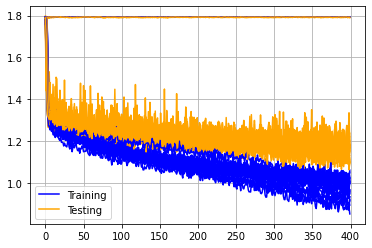

In [13]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [14]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.234840521812439
mean accuracy:  0.45085237711668


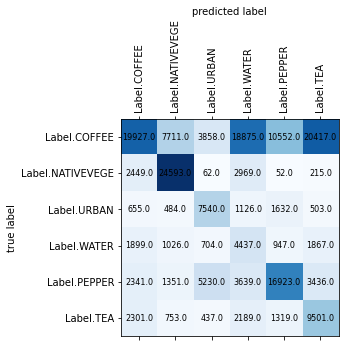

In [15]:
plot_confusion_matrix(conf_matrix, labels)

In [16]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.67384688 0.68469848 0.42285907 0.13350384 0.53852029 0.26436462]
Recalls:  [0.24498402 0.81058009 0.63149079 0.4078125  0.5140644  0.57581818]
F-Score:  [0.35932992 0.74234055 0.5065332  0.20115607 0.52600824 0.36236389]


# SWIR1, NIR, COASTAL_AEROSOL

In [17]:
BANDS = [
    Band.SWIR1.value,
    Band.NIR.value,
    Band.COASTAL_AEROSOL.value
]

In [18]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0590 - accuracy: 0.4603 - val_loss: 1.2077 - val_accuracy: 0.4271
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0311 - accuracy: 0.4634 - val_loss: 1.2272 - val_accuracy: 0.4270
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0677 - accuracy: 0.4353 - val_loss: 1.2753 - val_accuracy: 0.4089
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0596 - accuracy: 0.4515 - val_loss: 1.2108 - val_accuracy: 0.4542
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0679 - accuracy: 0.4653 - val_loss: 1.2195 - val_accuracy: 0.4326
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0271 - accuracy: 0.4443 - val_loss: 1.2124 - val_accuracy: 0.4573
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1020 - accuracy: 0.4280 - val_loss: 1.2483 - val_accuracy: 0.4509
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8943 - accuracy: 0.5375 - val_loss: 1.1413 - val_accuracy: 0.4743
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9185 - accuracy: 0.5382 - val_loss: 1.0537 - val_accuracy: 0.5427
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9406 - accuracy: 0.5134 - val_loss: 1.1457 - val_accuracy: 0.4826
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9673 - accuracy: 0.4999 - val_loss: 1.1498 - val_accuracy: 0.5045
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9086 - accuracy: 0.5589 - val_loss: 1.1506 - val_accuracy: 0.4785
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9081 - accuracy: 0.5334 - val_loss: 1.0906 - val_accuracy: 0.5158
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9717 - accuracy: 0.4983 - val_loss: 1.1112 - val_accuracy: 0.5319
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8131 - accuracy: 0.5756 - val_loss: 1.0975 - val_accuracy: 0.5251
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7917 - accuracy: 0.5601 - val_loss: 1.0432 - val_accuracy: 0.5481
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8625 - accuracy: 0.5705 - val_loss: 1.0456 - val_accuracy: 0.5464
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8074 - accuracy: 0.5553 - val_loss: 1.0727 - val_accuracy: 0.5277
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8264 - accuracy: 0.5662 - val_loss: 1.0351 - val_accuracy: 0.5551
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8518 - accuracy: 0.5548 - val_loss: 1.0698 - val_accuracy: 0.5431
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8283 - accuracy: 0.5665 - val_loss: 1.0314 - val_accuracy: 0.5438
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7471 - accuracy: 0.5993 - val_loss: 1.0604 - val_accuracy: 0.5487
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7657 - accuracy: 0.5952 - val_loss: 0.9875 - val_accuracy: 0.5982
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7254 - accuracy: 0.6109 - val_loss: 0.9921 - val_accuracy: 0.5919
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7428 - accuracy: 0.6075 - val_loss: 1.0441 - val_accuracy: 0.5579
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7070 - accuracy: 0.6059 - val_loss: 1.0706 - val_accuracy: 0.5499
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7888 - accuracy: 0.6017 - val_loss: 1.0550 - val_accuracy: 0.5667
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7875 - accuracy: 0.5760 - val_loss: 1.1031 - val_accuracy: 0.5540
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0168 - accuracy: 0.4963 - val_loss: 1.1316 - val_accuracy: 0.5126
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9997 - accuracy: 0.5094 - val_loss: 1.1779 - val_accuracy: 0.4505
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0120 - accuracy: 0.5099 - val_loss: 1.1798 - val_accuracy: 0.4700
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0496 - accuracy: 0.4565 - val_loss: 1.1312 - val_accuracy: 0.5214
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0058 - accuracy: 0.4978 - val_loss: 1.1668 - val_accuracy: 0.4706
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0360 - accuracy: 0.4629 - val_loss: 1.1490 - val_accuracy: 0.5080
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0692 - accuracy: 0.4896 - val_loss: 1.1550 - val_accuracy: 0.4904
E

57/57 [==============================] - 0s 8ms/step - loss: 0.8936 - accuracy: 0.5381 - val_loss: 1.0630 - val_accuracy: 0.5614
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9207 - accuracy: 0.5602 - val_loss: 1.0830 - val_accuracy: 0.5540
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9266 - accuracy: 0.5460 - val_loss: 1.0784 - val_accuracy: 0.5493
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9514 - accuracy: 0.5617 - val_loss: 1.0938 - val_accuracy: 0.5300
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9675 - accuracy: 0.5180 - val_loss: 1.0837 - val_accuracy: 0.5538
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9565 - accuracy: 0.5167 - val_loss: 1.0926 - val_accuracy: 0.5345
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9210 - accuracy: 0.5641 - val_loss: 1.1108 - val_accuracy: 0.5385
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8225 - accuracy: 0.5800 - val_loss: 1.1164 - val_accuracy: 0.5432
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8764 - accuracy: 0.5705 - val_loss: 1.0857 - val_accuracy: 0.5447
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8289 - accuracy: 0.5811 - val_loss: 1.0274 - val_accuracy: 0.5777
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8332 - accuracy: 0.6083 - val_loss: 1.0812 - val_accuracy: 0.5472
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8899 - accuracy: 0.5548 - val_loss: 1.0272 - val_accuracy: 0.5665
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8165 - accuracy: 0.5686 - val_loss: 1.0457 - val_accuracy: 0.5622
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8857 - accuracy: 0.5650 - val_loss: 1.0300 - val_accuracy: 0.5716
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2489 - accuracy: 0.3638 - val_loss: 1.3008 - val_accuracy: 0.3575
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2506 - accuracy: 0.3587 - val_loss: 1.2782 - val_accuracy: 0.3699
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3163 - accuracy: 0.3446 - val_loss: 1.3278 - val_accuracy: 0.3367
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2807 - accuracy: 0.3233 - val_loss: 1.3395 - val_accuracy: 0.3416
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2627 - accuracy: 0.3383 - val_loss: 1.3406 - val_accuracy: 0.3338
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2273 - accuracy: 0.3440 - val_loss: 1.3742 - val_accuracy: 0.3413
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2532 - accuracy: 0.3583 - val_loss: 1.2788 - val_accuracy: 0.3822
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0559 - accuracy: 0.4717 - val_loss: 1.2581 - val_accuracy: 0.4105
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0989 - accuracy: 0.4344 - val_loss: 1.1842 - val_accuracy: 0.4574
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0767 - accuracy: 0.4560 - val_loss: 1.1723 - val_accuracy: 0.4838
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9846 - accuracy: 0.5096 - val_loss: 1.1699 - val_accuracy: 0.4865
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0580 - accuracy: 0.4630 - val_loss: 1.1394 - val_accuracy: 0.4960
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0565 - accuracy: 0.4583 - val_loss: 1.2350 - val_accuracy: 0.4547
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0461 - accuracy: 0.4476 - val_loss: 1.2315 - val_accuracy: 0.4192
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9135 - accuracy: 0.5158 - val_loss: 1.1506 - val_accuracy: 0.4727
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8792 - accuracy: 0.4974 - val_loss: 1.1104 - val_accuracy: 0.4995
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8933 - accuracy: 0.5004 - val_loss: 1.1080 - val_accuracy: 0.4795
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9108 - accuracy: 0.5195 - val_loss: 1.1285 - val_accuracy: 0.4929
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8743 - accuracy: 0.5012 - val_loss: 1.1150 - val_accuracy: 0.5044
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9189 - accuracy: 0.5125 - val_loss: 1.1060 - val_accuracy: 0.4941
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9633 - accuracy: 0.4872 - val_loss: 1.0795 - val_accuracy: 0.5096
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8636 - accuracy: 0.5217 - val_loss: 1.0835 - val_accuracy: 0.5340
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8544 - accuracy: 0.5203 - val_loss: 1.0605 - val_accuracy: 0.5279
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8341 - accuracy: 0.5239 - val_loss: 1.0746 - val_accuracy: 0.5559
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8895 - accuracy: 0.5275 - val_loss: 1.1005 - val_accuracy: 0.5036
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8101 - accuracy: 0.5492 - val_loss: 1.0940 - val_accuracy: 0.5358
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8270 - accuracy: 0.5369 - val_loss: 1.0652 - val_accuracy: 0.5258
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8991 - accuracy: 0.5460 - val_loss: 1.0814 - val_accuracy: 0.5236
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0688 - accuracy: 0.4709 - val_loss: 1.2496 - val_accuracy: 0.4507
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0328 - accuracy: 0.4382 - val_loss: 1.2990 - val_accuracy: 0.3822
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1224 - accuracy: 0.3992 - val_loss: 1.2115 - val_accuracy: 0.4609
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1390 - accuracy: 0.4233 - val_loss: 1.2499 - val_accuracy: 0.4449
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1554 - accuracy: 0.4316 - val_loss: 1.1457 - val_accuracy: 0.4929
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0930 - accuracy: 0.4314 - val_loss: 1.2441 - val_accuracy: 0.4458
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0728 - accuracy: 0.4441 - val_loss: 1.2123 - val_accuracy: 0.4472
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0483 - accuracy: 0.4410 - val_loss: 1.1560 - val_accuracy: 0.4579
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9409 - accuracy: 0.4954 - val_loss: 1.1406 - val_accuracy: 0.4698
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0125 - accuracy: 0.4949 - val_loss: 1.1231 - val_accuracy: 0.4976
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0146 - accuracy: 0.4625 - val_loss: 1.1376 - val_accuracy: 0.4727
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0035 - accuracy: 0.4656 - val_loss: 1.1663 - val_accuracy: 0.4517
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9572 - accuracy: 0.5016 - val_loss: 1.1212 - val_accuracy: 0.4933
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9806 - accuracy: 0.4739 - val_loss: 1.1516 - val_accuracy: 0.4616
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8759 - accuracy: 0.5234 - val_loss: 1.0870 - val_accuracy: 0.5149
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8569 - accuracy: 0.5283 - val_loss: 1.0288 - val_accuracy: 0.5620
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8543 - accuracy: 0.5429 - val_loss: 1.1010 - val_accuracy: 0.5103
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8018 - accuracy: 0.5408 - val_loss: 1.1170 - val_accuracy: 0.5054
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9070 - accuracy: 0.5157 - val_loss: 1.0774 - val_accuracy: 0.5354
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9190 - accuracy: 0.5353 - val_loss: 1.0710 - val_accuracy: 0.5260
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8907 - accuracy: 0.5197 - val_loss: 1.0291 - val_accuracy: 0.5604
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7813 - accuracy: 0.5864 - val_loss: 1.0756 - val_accuracy: 0.5330
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7936 - accuracy: 0.5695 - val_loss: 1.0833 - val_accuracy: 0.5230
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8523 - accuracy: 0.5407 - val_loss: 1.0567 - val_accuracy: 0.5271
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8387 - accuracy: 0.5715 - val_loss: 1.1509 - val_accuracy: 0.5051
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7964 - accuracy: 0.5566 - val_loss: 1.0415 - val_accuracy: 0.5644
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7797 - accuracy: 0.5598 - val_loss: 1.0226 - val_accuracy: 0.5620
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7727 - accuracy: 0.5733 - val_loss: 1.0771 - val_accuracy: 0.5384
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1729 - accuracy: 0.3886 - val_loss: 1.3107 - val_accuracy: 0.3917
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1586 - accuracy: 0.4173 - val_loss: 1.3499 - val_accuracy: 0.3821
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0978 - accuracy: 0.4411 - val_loss: 1.2500 - val_accuracy: 0.4193
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1002 - accuracy: 0.4212 - val_loss: 1.2724 - val_accuracy: 0.3825
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1630 - accuracy: 0.3866 - val_loss: 1.3000 - val_accuracy: 0.3977
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1731 - accuracy: 0.3882 - val_loss: 1.2975 - val_accuracy: 0.4230
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1611 - accuracy: 0.4155 - val_loss: 1.3887 - val_accuracy: 0.3549
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0224 - accuracy: 0.4807 - val_loss: 1.1412 - val_accuracy: 0.4968
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9977 - accuracy: 0.5009 - val_loss: 1.1642 - val_accuracy: 0.4823
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0102 - accuracy: 0.5114 - val_loss: 1.1307 - val_accuracy: 0.5048
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9688 - accuracy: 0.5099 - val_loss: 1.1235 - val_accuracy: 0.5052
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0118 - accuracy: 0.5026 - val_loss: 1.1288 - val_accuracy: 0.5056
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0489 - accuracy: 0.5002 - val_loss: 1.0973 - val_accuracy: 0.5256
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0460 - accuracy: 0.4962 - val_loss: 1.2101 - val_accuracy: 0.4700
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8956 - accuracy: 0.5455 - val_loss: 1.1798 - val_accuracy: 0.4802
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8846 - accuracy: 0.5408 - val_loss: 1.0580 - val_accuracy: 0.5384
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8714 - accuracy: 0.5152 - val_loss: 1.0999 - val_accuracy: 0.5270
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8717 - accuracy: 0.5442 - val_loss: 1.0422 - val_accuracy: 0.5725
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9369 - accuracy: 0.5613 - val_loss: 1.0822 - val_accuracy: 0.5292
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8858 - accuracy: 0.5660 - val_loss: 1.0800 - val_accuracy: 0.5389
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8580 - accuracy: 0.5432 - val_loss: 1.1124 - val_accuracy: 0.5156
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8185 - accuracy: 0.5656 - val_loss: 1.0687 - val_accuracy: 0.5421
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8447 - accuracy: 0.5728 - val_loss: 1.0649 - val_accuracy: 0.5427
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7808 - accuracy: 0.6049 - val_loss: 1.1126 - val_accuracy: 0.5241
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7895 - accuracy: 0.5598 - val_loss: 0.9857 - val_accuracy: 0.5954
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8229 - accuracy: 0.6087 - val_loss: 1.0231 - val_accuracy: 0.5766
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7605 - accuracy: 0.6149 - val_loss: 1.0407 - val_accuracy: 0.5622
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7964 - accuracy: 0.5814 - val_loss: 0.9857 - val_accuracy: 0.5973
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0178 - accuracy: 0.4850 - val_loss: 1.3328 - val_accuracy: 0.3843
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0796 - accuracy: 0.4328 - val_loss: 1.2109 - val_accuracy: 0.4459
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0812 - accuracy: 0.4396 - val_loss: 1.1997 - val_accuracy: 0.4492
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0971 - accuracy: 0.4512 - val_loss: 1.2893 - val_accuracy: 0.3762
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0865 - accuracy: 0.4264 - val_loss: 1.3549 - val_accuracy: 0.3683
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1172 - accuracy: 0.4374 - val_loss: 1.1841 - val_accuracy: 0.4935
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0860 - accuracy: 0.4575 - val_loss: 1.2435 - val_accuracy: 0.4281
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9747 - accuracy: 0.5045 - val_loss: 1.2569 - val_accuracy: 0.4493
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0039 - accuracy: 0.4898 - val_loss: 1.1422 - val_accuracy: 0.4918
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0124 - accuracy: 0.4812 - val_loss: 1.1231 - val_accuracy: 0.5182
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9749 - accuracy: 0.4951 - val_loss: 1.2897 - val_accuracy: 0.4169
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9964 - accuracy: 0.4788 - val_loss: 1.1817 - val_accuracy: 0.4530
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9756 - accuracy: 0.4755 - val_loss: 1.1282 - val_accuracy: 0.5230
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9862 - accuracy: 0.4802 - val_loss: 1.1159 - val_accuracy: 0.4958
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8837 - accuracy: 0.5442 - val_loss: 1.1177 - val_accuracy: 0.4795
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9434 - accuracy: 0.5048 - val_loss: 1.0731 - val_accuracy: 0.5310
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8884 - accuracy: 0.5114 - val_loss: 1.1057 - val_accuracy: 0.5019
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8367 - accuracy: 0.5268 - val_loss: 1.0866 - val_accuracy: 0.5008
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8302 - accuracy: 0.5357 - val_loss: 1.1382 - val_accuracy: 0.4579
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8960 - accuracy: 0.5091 - val_loss: 1.0946 - val_accuracy: 0.4997
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8942 - accuracy: 0.5354 - val_loss: 1.0898 - val_accuracy: 0.5107
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8578 - accuracy: 0.5544 - val_loss: 1.0210 - val_accuracy: 0.5370
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7899 - accuracy: 0.5562 - val_loss: 1.0409 - val_accuracy: 0.5397
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7996 - accuracy: 0.5420 - val_loss: 1.0543 - val_accuracy: 0.5423
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7600 - accuracy: 0.5773 - val_loss: 0.9843 - val_accuracy: 0.5580
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8379 - accuracy: 0.5617 - val_loss: 1.0788 - val_accuracy: 0.5370
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7737 - accuracy: 0.5547 - val_loss: 1.0311 - val_accuracy: 0.5276
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7625 - accuracy: 0.6097 - val_loss: 1.0417 - val_accuracy: 0.5281
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1971 - accuracy: 0.3761 - val_loss: 1.2727 - val_accuracy: 0.3832
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1875 - accuracy: 0.3940 - val_loss: 1.2008 - val_accuracy: 0.4331
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1461 - accuracy: 0.4388 - val_loss: 1.3399 - val_accuracy: 0.3660
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1449 - accuracy: 0.4100 - val_loss: 1.3013 - val_accuracy: 0.4025
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1498 - accuracy: 0.4079 - val_loss: 1.2636 - val_accuracy: 0.4136
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1564 - accuracy: 0.4029 - val_loss: 1.2442 - val_accuracy: 0.4295
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2157 - accuracy: 0.3978 - val_loss: 1.3647 - val_accuracy: 0.3571
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9855 - accuracy: 0.4980 - val_loss: 1.1458 - val_accuracy: 0.5128
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0897 - accuracy: 0.4868 - val_loss: 1.2064 - val_accuracy: 0.4665
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9771 - accuracy: 0.4945 - val_loss: 1.2125 - val_accuracy: 0.4910
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0201 - accuracy: 0.4919 - val_loss: 1.1705 - val_accuracy: 0.4963
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0096 - accuracy: 0.4800 - val_loss: 1.1613 - val_accuracy: 0.4912
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9765 - accuracy: 0.4897 - val_loss: 1.1797 - val_accuracy: 0.4838
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9792 - accuracy: 0.4747 - val_loss: 1.1391 - val_accuracy: 0.5031
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9316 - accuracy: 0.5140 - val_loss: 1.0632 - val_accuracy: 0.5345
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8756 - accuracy: 0.5352 - val_loss: 1.1215 - val_accuracy: 0.4954
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8945 - accuracy: 0.5480 - val_loss: 1.0914 - val_accuracy: 0.5103
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8807 - accuracy: 0.5261 - val_loss: 1.1829 - val_accuracy: 0.4665
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9035 - accuracy: 0.5187 - val_loss: 1.1074 - val_accuracy: 0.5044
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9072 - accuracy: 0.5200 - val_loss: 1.0777 - val_accuracy: 0.5311
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8832 - accuracy: 0.5480 - val_loss: 1.1297 - val_accuracy: 0.4791
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8269 - accuracy: 0.5521 - val_loss: 1.0494 - val_accuracy: 0.5357
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8538 - accuracy: 0.5278 - val_loss: 1.0407 - val_accuracy: 0.5468
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7931 - accuracy: 0.5613 - val_loss: 1.0684 - val_accuracy: 0.5567
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8739 - accuracy: 0.5238 - val_loss: 1.1300 - val_accuracy: 0.5071
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8066 - accuracy: 0.5528 - val_loss: 1.1158 - val_accuracy: 0.5105
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8251 - accuracy: 0.5495 - val_loss: 1.1392 - val_accuracy: 0.5039
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8217 - accuracy: 0.5610 - val_loss: 1.0288 - val_accuracy: 0.5562
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3297 - accuracy: 0.3350 - val_loss: 1.3717 - val_accuracy: 0.3325
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3657 - accuracy: 0.3210 - val_loss: 1.3454 - val_accuracy: 0.3647
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3333 - accuracy: 0.3321 - val_loss: 1.3024 - val_accuracy: 0.3998
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2317 - accuracy: 0.3885 - val_loss: 1.3126 - val_accuracy: 0.3170
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2452 - accuracy: 0.3152 - val_loss: 1.2824 - val_accuracy: 0.3542
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1879 - accuracy: 0.3738 - val_loss: 1.2950 - val_accuracy: 0.3431
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1667 - accuracy: 0.3503 - val_loss: 1.3166 - val_accuracy: 0.3503
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0503 - accuracy: 0.4639 - val_loss: 1.1789 - val_accuracy: 0.4766
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0572 - accuracy: 0.4634 - val_loss: 1.1276 - val_accuracy: 0.5060
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0645 - accuracy: 0.4425 - val_loss: 1.1712 - val_accuracy: 0.4832
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0428 - accuracy: 0.4665 - val_loss: 1.1366 - val_accuracy: 0.4995
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9987 - accuracy: 0.5161 - val_loss: 1.1063 - val_accuracy: 0.5365
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0679 - accuracy: 0.4595 - val_loss: 1.1033 - val_accuracy: 0.5171
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0451 - accuracy: 0.4786 - val_loss: 1.1992 - val_accuracy: 0.4564
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8827 - accuracy: 0.5015 - val_loss: 1.0657 - val_accuracy: 0.5373
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8753 - accuracy: 0.5257 - val_loss: 1.0874 - val_accuracy: 0.5289
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9070 - accuracy: 0.5369 - val_loss: 1.0028 - val_accuracy: 0.5762
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9128 - accuracy: 0.5240 - val_loss: 1.0600 - val_accuracy: 0.5292
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8454 - accuracy: 0.5366 - val_loss: 1.0241 - val_accuracy: 0.5539
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9186 - accuracy: 0.5295 - val_loss: 1.0932 - val_accuracy: 0.5251
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8802 - accuracy: 0.5405 - val_loss: 0.9990 - val_accuracy: 0.5706
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7647 - accuracy: 0.5814 - val_loss: 0.9916 - val_accuracy: 0.5808
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8270 - accuracy: 0.5583 - val_loss: 1.0527 - val_accuracy: 0.5548
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8570 - accuracy: 0.5550 - val_loss: 0.9714 - val_accuracy: 0.5761
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7767 - accuracy: 0.5813 - val_loss: 1.0742 - val_accuracy: 0.5135
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8504 - accuracy: 0.5407 - val_loss: 1.0108 - val_accuracy: 0.5684
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7794 - accuracy: 0.5940 - val_loss: 1.0307 - val_accuracy: 0.5479
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8032 - accuracy: 0.5794 - val_loss: 1.0170 - val_accuracy: 0.5667
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3164 - accuracy: 0.3622 - val_loss: 1.3183 - val_accuracy: 0.3628
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1802 - accuracy: 0.4073 - val_loss: 1.3069 - val_accuracy: 0.3242
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1958 - accuracy: 0.3629 - val_loss: 1.2738 - val_accuracy: 0.3987
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2402 - accuracy: 0.3162 - val_loss: 1.3962 - val_accuracy: 0.3520
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1764 - accuracy: 0.3928 - val_loss: 1.2434 - val_accuracy: 0.3580
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2122 - accuracy: 0.3501 - val_loss: 1.3131 - val_accuracy: 0.3893
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1989 - accuracy: 0.3789 - val_loss: 1.3471 - val_accuracy: 0.3628
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0375 - accuracy: 0.4565 - val_loss: 1.2353 - val_accuracy: 0.4670
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0649 - accuracy: 0.4537 - val_loss: 1.1903 - val_accuracy: 0.4783
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1002 - accuracy: 0.4446 - val_loss: 1.1779 - val_accuracy: 0.4764
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1021 - accuracy: 0.4180 - val_loss: 1.2516 - val_accuracy: 0.4492
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1099 - accuracy: 0.4680 - val_loss: 1.1580 - val_accuracy: 0.5075
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0367 - accuracy: 0.4948 - val_loss: 1.2664 - val_accuracy: 0.4520
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0506 - accuracy: 0.4726 - val_loss: 1.1458 - val_accuracy: 0.5024
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9620 - accuracy: 0.5304 - val_loss: 1.1472 - val_accuracy: 0.5088
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0241 - accuracy: 0.4833 - val_loss: 1.0145 - val_accuracy: 0.5898
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9370 - accuracy: 0.5362 - val_loss: 1.0838 - val_accuracy: 0.5483
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9068 - accuracy: 0.5292 - val_loss: 1.1331 - val_accuracy: 0.5330
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9333 - accuracy: 0.5513 - val_loss: 1.1177 - val_accuracy: 0.5330
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9572 - accuracy: 0.5077 - val_loss: 1.0726 - val_accuracy: 0.5550
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9106 - accuracy: 0.5510 - val_loss: 1.0536 - val_accuracy: 0.5830
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8851 - accuracy: 0.5606 - val_loss: 1.0768 - val_accuracy: 0.5509
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8700 - accuracy: 0.5399 - val_loss: 1.0711 - val_accuracy: 0.5489
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8314 - accuracy: 0.5395 - val_loss: 1.1325 - val_accuracy: 0.5006
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8753 - accuracy: 0.5282 - val_loss: 1.1237 - val_accuracy: 0.5464
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8273 - accuracy: 0.5688 - val_loss: 1.0583 - val_accuracy: 0.5490
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8650 - accuracy: 0.5450 - val_loss: 1.0718 - val_accuracy: 0.5385
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8894 - accuracy: 0.5197 - val_loss: 1.0293 - val_accuracy: 0.5782
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8099 - accuracy: 0.1339 - val_loss: 1.7852 - val_accuracy: 0.1173
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7762 - accuracy: 0.1896 - val_loss: 1.6431 - val_accuracy: 0.2168
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5084 - accuracy: 0.2634 - val_loss: 1.4635 - val_accuracy: 0.3366
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5118 - accuracy: 0.3250 - val_loss: 1.4715 - val_accuracy: 0.3560
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4054 - accuracy: 0.3586 - val_loss: 1.4893 - val_accuracy: 0.3435
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4574 - accuracy: 0.3439 - val_loss: 1.4186 - val_accuracy: 0.3915
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3453 - accuracy: 0.4211 - val_loss: 1.4091 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9721 - accuracy: 0.5485 - val_loss: 1.1782 - val_accuracy: 0.4960
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9845 - accuracy: 0.5202 - val_loss: 1.1025 - val_accuracy: 0.5279
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0903 - accuracy: 0.4955 - val_loss: 1.2862 - val_accuracy: 0.4698
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0159 - accuracy: 0.4874 - val_loss: 1.1773 - val_accuracy: 0.5044
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0011 - accuracy: 0.5165 - val_loss: 1.1796 - val_accuracy: 0.5146
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9698 - accuracy: 0.5077 - val_loss: 1.1932 - val_accuracy: 0.4851
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0010 - accuracy: 0.5060 - val_loss: 1.2159 - val_accuracy: 0.4692

57/57 [==============================] - 0s 8ms/step - loss: 0.9007 - accuracy: 0.5290 - val_loss: 1.1170 - val_accuracy: 0.5007
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9268 - accuracy: 0.5112 - val_loss: 1.0964 - val_accuracy: 0.5355
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9136 - accuracy: 0.5251 - val_loss: 1.0737 - val_accuracy: 0.5509
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8536 - accuracy: 0.5401 - val_loss: 1.1080 - val_accuracy: 0.5293
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8702 - accuracy: 0.5207 - val_loss: 1.0813 - val_accuracy: 0.5403
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9350 - accuracy: 0.5542 - val_loss: 1.0637 - val_accuracy: 0.5423
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8687 - accuracy: 0.5100 - val_loss: 1.1261 - val_accuracy: 0.5078
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8338 - accuracy: 0.5283 - val_loss: 1.0132 - val_accuracy: 0.5614
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8076 - accuracy: 0.5462 - val_loss: 1.1375 - val_accuracy: 0.5290
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8586 - accuracy: 0.5458 - val_loss: 1.0391 - val_accuracy: 0.5597
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8051 - accuracy: 0.5606 - val_loss: 1.1088 - val_accuracy: 0.5099
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8355 - accuracy: 0.5503 - val_loss: 1.0925 - val_accuracy: 0.5326
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8471 - accuracy: 0.5609 - val_loss: 1.0900 - val_accuracy: 0.5100
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8355 - accuracy: 0.5454 - val_loss: 0.9963 - val_accuracy: 0.5800
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7873 - accuracy: 0.1092 - val_loss: 1.7878 - val_accuracy: 0.1782
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7638 - accuracy: 0.1573 - val_loss: 1.7551 - val_accuracy: 0.1361
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6612 - accuracy: 0.1478 - val_loss: 1.5592 - val_accuracy: 0.2470
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4816 - accuracy: 0.2589 - val_loss: 1.5464 - val_accuracy: 0.2779
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4823 - accuracy: 0.2787 - val_loss: 1.5701 - val_accuracy: 0.3660
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4453 - accuracy: 0.3183 - val_loss: 1.4686 - val_accuracy: 0.3849
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3972 - accuracy: 0.3765 - val_loss: 1.4468 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9980 - accuracy: 0.5091 - val_loss: 1.0481 - val_accuracy: 0.5480
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9436 - accuracy: 0.5668 - val_loss: 1.0477 - val_accuracy: 0.5196
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9279 - accuracy: 0.5251 - val_loss: 1.1215 - val_accuracy: 0.5065
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9184 - accuracy: 0.5356 - val_loss: 1.0439 - val_accuracy: 0.5400
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8683 - accuracy: 0.5308 - val_loss: 1.0499 - val_accuracy: 0.5389
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9437 - accuracy: 0.5250 - val_loss: 1.0841 - val_accuracy: 0.5038
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8688 - accuracy: 0.5245 - val_loss: 1.0891 - val_accuracy: 0.5052

57/57 [==============================] - 0s 8ms/step - loss: 0.8090 - accuracy: 0.5611 - val_loss: 1.0240 - val_accuracy: 0.5648
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7631 - accuracy: 0.5832 - val_loss: 1.0042 - val_accuracy: 0.5666
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7713 - accuracy: 0.5822 - val_loss: 0.9932 - val_accuracy: 0.5808
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7790 - accuracy: 0.6077 - val_loss: 1.0591 - val_accuracy: 0.5546
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7765 - accuracy: 0.5569 - val_loss: 1.0194 - val_accuracy: 0.5676
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7831 - accuracy: 0.5745 - val_loss: 1.0131 - val_accuracy: 0.5721
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7757 - accuracy: 0.5700 - val_loss: 1.0720 - val_accuracy: 0.5401
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7435 - accuracy: 0.5683 - val_loss: 0.9961 - val_accuracy: 0.5931
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7313 - accuracy: 0.6085 - val_loss: 1.0095 - val_accuracy: 0.5590
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7284 - accuracy: 0.5711 - val_loss: 0.9575 - val_accuracy: 0.5969
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7081 - accuracy: 0.6243 - val_loss: 1.0186 - val_accuracy: 0.5695
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6916 - accuracy: 0.6168 - val_loss: 1.0576 - val_accuracy: 0.5518
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7469 - accuracy: 0.5885 - val_loss: 0.9558 - val_accuracy: 0.5977
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7349 - accuracy: 0.6384 - val_loss: 1.0706 - val_accuracy: 0.5521
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8084 - accuracy: 0.1650 - val_loss: 1.7926 - val_accuracy: 0.2002
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7619 - accuracy: 0.1660 - val_loss: 1.7606 - val_accuracy: 0.2029
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6762 - accuracy: 0.2070 - val_loss: 1.5511 - val_accuracy: 0.2626
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4625 - accuracy: 0.3011 - val_loss: 1.4968 - val_accuracy: 0.3071
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4809 - accuracy: 0.2978 - val_loss: 1.4168 - val_accuracy: 0.4056
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4175 - accuracy: 0.3323 - val_loss: 1.3927 - val_accuracy: 0.2960
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3511 - accuracy: 0.3436 - val_loss: 1.3969 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0603 - accuracy: 0.5094 - val_loss: 1.1451 - val_accuracy: 0.4988
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0056 - accuracy: 0.5006 - val_loss: 1.1221 - val_accuracy: 0.5147
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0191 - accuracy: 0.4771 - val_loss: 1.1010 - val_accuracy: 0.5230
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0171 - accuracy: 0.5087 - val_loss: 1.1795 - val_accuracy: 0.4753
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9970 - accuracy: 0.5061 - val_loss: 1.1225 - val_accuracy: 0.5137
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9973 - accuracy: 0.5264 - val_loss: 1.1623 - val_accuracy: 0.4771
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9965 - accuracy: 0.4841 - val_loss: 1.0879 - val_accuracy: 0.5380

57/57 [==============================] - 0s 8ms/step - loss: 0.9605 - accuracy: 0.5214 - val_loss: 1.1442 - val_accuracy: 0.5003
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9363 - accuracy: 0.5168 - val_loss: 1.0840 - val_accuracy: 0.5240
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9326 - accuracy: 0.5242 - val_loss: 1.1166 - val_accuracy: 0.5028
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9360 - accuracy: 0.5310 - val_loss: 1.1438 - val_accuracy: 0.4968
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9368 - accuracy: 0.5336 - val_loss: 1.1279 - val_accuracy: 0.4998
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9639 - accuracy: 0.5126 - val_loss: 1.1209 - val_accuracy: 0.5007
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9538 - accuracy: 0.5025 - val_loss: 1.0903 - val_accuracy: 0.5089
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8318 - accuracy: 0.5434 - val_loss: 1.1686 - val_accuracy: 0.5016
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8781 - accuracy: 0.5331 - val_loss: 1.0749 - val_accuracy: 0.5285
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8934 - accuracy: 0.5415 - val_loss: 1.0728 - val_accuracy: 0.5331
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8758 - accuracy: 0.5253 - val_loss: 1.0478 - val_accuracy: 0.5456
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8776 - accuracy: 0.5325 - val_loss: 1.0844 - val_accuracy: 0.5222
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8444 - accuracy: 0.5591 - val_loss: 1.1208 - val_accuracy: 0.5099
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8459 - accuracy: 0.5531 - val_loss: 1.0799 - val_accuracy: 0.5368
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7631 - accuracy: 0.1908 - val_loss: 1.7772 - val_accuracy: 0.1643
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7630 - accuracy: 0.1358 - val_loss: 1.6566 - val_accuracy: 0.2171
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5767 - accuracy: 0.2363 - val_loss: 1.6024 - val_accuracy: 0.2831
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4847 - accuracy: 0.3099 - val_loss: 1.5505 - val_accuracy: 0.2752
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4889 - accuracy: 0.3256 - val_loss: 1.4550 - val_accuracy: 0.3110
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4413 - accuracy: 0.3125 - val_loss: 1.4429 - val_accuracy: 0.3428
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4425 - accuracy: 0.3003 - val_loss: 1.4012 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0279 - accuracy: 0.4619 - val_loss: 1.1925 - val_accuracy: 0.4433
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9971 - accuracy: 0.4936 - val_loss: 1.1516 - val_accuracy: 0.4908
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0052 - accuracy: 0.4830 - val_loss: 1.1667 - val_accuracy: 0.5009
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0198 - accuracy: 0.4614 - val_loss: 1.2433 - val_accuracy: 0.4653
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0285 - accuracy: 0.4645 - val_loss: 1.1652 - val_accuracy: 0.4795
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0099 - accuracy: 0.5026 - val_loss: 1.1662 - val_accuracy: 0.4653
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0390 - accuracy: 0.4899 - val_loss: 1.1857 - val_accuracy: 0.4529

57/57 [==============================] - 0s 8ms/step - loss: 0.9735 - accuracy: 0.5264 - val_loss: 1.1031 - val_accuracy: 0.5137
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8991 - accuracy: 0.5454 - val_loss: 1.1514 - val_accuracy: 0.5109
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9558 - accuracy: 0.5192 - val_loss: 1.1272 - val_accuracy: 0.5173
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9147 - accuracy: 0.5240 - val_loss: 1.1871 - val_accuracy: 0.4710
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9224 - accuracy: 0.4962 - val_loss: 1.1301 - val_accuracy: 0.4903
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9452 - accuracy: 0.4966 - val_loss: 1.1917 - val_accuracy: 0.4628
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9139 - accuracy: 0.4962 - val_loss: 1.1503 - val_accuracy: 0.4906
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.8541 - accuracy: 0.5260 - val_loss: 1.1158 - val_accuracy: 0.5206
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8356 - accuracy: 0.5390 - val_loss: 1.1843 - val_accuracy: 0.4952
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8559 - accuracy: 0.5313 - val_loss: 1.0687 - val_accuracy: 0.5611
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8882 - accuracy: 0.5558 - val_loss: 1.1043 - val_accuracy: 0.5006
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8743 - accuracy: 0.5128 - val_loss: 1.1187 - val_accuracy: 0.5263
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8706 - accuracy: 0.5325 - val_loss: 1.0844 - val_accuracy: 0.5255
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8846 - accuracy: 0.5275 - val_loss: 1.1140 - val_accuracy: 0.5047
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7526 - accuracy: 0.2103 - val_loss: 1.7917 - val_accuracy: 0.1777
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7934 - accuracy: 0.1635 - val_loss: 1.7867 - val_accuracy: 0.1806
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8004 - accuracy: 0.1698 - val_loss: 1.7190 - val_accuracy: 0.1112
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7288 - accuracy: 0.1688 - val_loss: 1.7339 - val_accuracy: 0.1951
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5940 - accuracy: 0.1963 - val_loss: 1.5310 - val_accuracy: 0.3096
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4840 - accuracy: 0.2611 - val_loss: 1.5409 - val_accuracy: 0.3109
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5117 - accuracy: 0.2535 - val_loss: 1.7705 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9327 - accuracy: 0.5279 - val_loss: 1.1142 - val_accuracy: 0.5022
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0137 - accuracy: 0.5055 - val_loss: 1.1044 - val_accuracy: 0.5040
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8929 - accuracy: 0.5199 - val_loss: 1.1491 - val_accuracy: 0.4742
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9261 - accuracy: 0.5089 - val_loss: 1.0542 - val_accuracy: 0.5457
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9638 - accuracy: 0.5429 - val_loss: 1.0765 - val_accuracy: 0.5234
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8637 - accuracy: 0.5440 - val_loss: 1.1145 - val_accuracy: 0.4885
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9412 - accuracy: 0.5092 - val_loss: 1.0752 - val_accuracy: 0.5215

57/57 [==============================] - 0s 8ms/step - loss: 0.8828 - accuracy: 0.5542 - val_loss: 1.0342 - val_accuracy: 0.5486
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8722 - accuracy: 0.5572 - val_loss: 1.0366 - val_accuracy: 0.5629
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8377 - accuracy: 0.5720 - val_loss: 1.0430 - val_accuracy: 0.5525
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8542 - accuracy: 0.5557 - val_loss: 1.0249 - val_accuracy: 0.5580
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8216 - accuracy: 0.5744 - val_loss: 1.0468 - val_accuracy: 0.5532
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8914 - accuracy: 0.5566 - val_loss: 1.0530 - val_accuracy: 0.5392
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8582 - accuracy: 0.5827 - val_loss: 1.0412 - val_accuracy: 0.5626
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7143 - accuracy: 0.6318 - val_loss: 1.1151 - val_accuracy: 0.5368
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7281 - accuracy: 0.5758 - val_loss: 1.0315 - val_accuracy: 0.5755
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7890 - accuracy: 0.5781 - val_loss: 0.9545 - val_accuracy: 0.6072
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7443 - accuracy: 0.6120 - val_loss: 0.9869 - val_accuracy: 0.5951
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7149 - accuracy: 0.6422 - val_loss: 1.0216 - val_accuracy: 0.5731
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7057 - accuracy: 0.6054 - val_loss: 1.0309 - val_accuracy: 0.5682
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7343 - accuracy: 0.6111 - val_loss: 1.0036 - val_accuracy: 0.5828
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8089 - accuracy: 0.1751 - val_loss: 1.7923 - val_accuracy: 0.1979
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7597 - accuracy: 0.1732 - val_loss: 1.7669 - val_accuracy: 0.3995
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7174 - accuracy: 0.2013 - val_loss: 1.6293 - val_accuracy: 0.3198
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6119 - accuracy: 0.2900 - val_loss: 1.4404 - val_accuracy: 0.3898
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3855 - accuracy: 0.3734 - val_loss: 1.6566 - val_accuracy: 0.3321
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3808 - accuracy: 0.3510 - val_loss: 1.3971 - val_accuracy: 0.3731
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4455 - accuracy: 0.3648 - val_loss: 1.3488 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9328 - accuracy: 0.4969 - val_loss: 1.1370 - val_accuracy: 0.4851
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9815 - accuracy: 0.5101 - val_loss: 1.1958 - val_accuracy: 0.4564
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8951 - accuracy: 0.5233 - val_loss: 1.1002 - val_accuracy: 0.5041
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9444 - accuracy: 0.5269 - val_loss: 1.1264 - val_accuracy: 0.4715
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9380 - accuracy: 0.4888 - val_loss: 1.0888 - val_accuracy: 0.5305
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9885 - accuracy: 0.4773 - val_loss: 1.1254 - val_accuracy: 0.5031
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9296 - accuracy: 0.5168 - val_loss: 1.1660 - val_accuracy: 0.4316

57/57 [==============================] - 0s 8ms/step - loss: 0.7983 - accuracy: 0.5535 - val_loss: 1.1473 - val_accuracy: 0.4798
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8499 - accuracy: 0.5175 - val_loss: 1.0366 - val_accuracy: 0.5516
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8589 - accuracy: 0.5507 - val_loss: 1.1158 - val_accuracy: 0.4873
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8061 - accuracy: 0.5524 - val_loss: 1.0544 - val_accuracy: 0.5637
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8578 - accuracy: 0.5433 - val_loss: 1.0076 - val_accuracy: 0.5548
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7765 - accuracy: 0.5760 - val_loss: 1.0696 - val_accuracy: 0.5312
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8196 - accuracy: 0.5574 - val_loss: 1.0441 - val_accuracy: 0.5358
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7257 - accuracy: 0.6183 - val_loss: 1.0726 - val_accuracy: 0.5240
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7537 - accuracy: 0.5774 - val_loss: 1.0476 - val_accuracy: 0.5505
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7079 - accuracy: 0.5884 - val_loss: 1.0095 - val_accuracy: 0.5799
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7841 - accuracy: 0.5716 - val_loss: 1.0026 - val_accuracy: 0.5706
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7417 - accuracy: 0.5902 - val_loss: 0.9923 - val_accuracy: 0.5693
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7266 - accuracy: 0.5970 - val_loss: 1.0257 - val_accuracy: 0.5736
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6944 - accuracy: 0.6033 - val_loss: 0.9762 - val_accuracy: 0.5886
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7357 - accuracy: 0.1886 - val_loss: 1.7753 - val_accuracy: 0.1756
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7795 - accuracy: 0.2133 - val_loss: 1.8453 - val_accuracy: 0.1313
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6229 - accuracy: 0.1780 - val_loss: 1.5742 - val_accuracy: 0.2686
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5017 - accuracy: 0.2585 - val_loss: 1.5277 - val_accuracy: 0.3178
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4739 - accuracy: 0.3003 - val_loss: 1.4526 - val_accuracy: 0.3893
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4353 - accuracy: 0.3995 - val_loss: 1.4289 - val_accuracy: 0.3951
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3695 - accuracy: 0.3706 - val_loss: 1.4888 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9355 - accuracy: 0.5176 - val_loss: 1.0794 - val_accuracy: 0.5375
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8595 - accuracy: 0.5274 - val_loss: 1.1371 - val_accuracy: 0.4846
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9094 - accuracy: 0.5242 - val_loss: 1.0874 - val_accuracy: 0.5260
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9469 - accuracy: 0.5316 - val_loss: 1.1727 - val_accuracy: 0.4322
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8991 - accuracy: 0.5471 - val_loss: 1.1323 - val_accuracy: 0.4927
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8626 - accuracy: 0.5342 - val_loss: 1.0518 - val_accuracy: 0.5386
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9110 - accuracy: 0.5416 - val_loss: 1.1063 - val_accuracy: 0.5019

57/57 [==============================] - 0s 8ms/step - loss: 0.7747 - accuracy: 0.5976 - val_loss: 1.0454 - val_accuracy: 0.5421
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8022 - accuracy: 0.5732 - val_loss: 0.9811 - val_accuracy: 0.5908
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8130 - accuracy: 0.5726 - val_loss: 1.0141 - val_accuracy: 0.5738
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8146 - accuracy: 0.5773 - val_loss: 0.9929 - val_accuracy: 0.5858
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7554 - accuracy: 0.6312 - val_loss: 0.9780 - val_accuracy: 0.5904
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8037 - accuracy: 0.5835 - val_loss: 1.0285 - val_accuracy: 0.5518
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7771 - accuracy: 0.5991 - val_loss: 1.0264 - val_accuracy: 0.5655
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7378 - accuracy: 0.5996 - val_loss: 1.0164 - val_accuracy: 0.5827
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7491 - accuracy: 0.6058 - val_loss: 0.9831 - val_accuracy: 0.5907
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6915 - accuracy: 0.6263 - val_loss: 1.0280 - val_accuracy: 0.5892
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7322 - accuracy: 0.6130 - val_loss: 1.0909 - val_accuracy: 0.5510
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6939 - accuracy: 0.6171 - val_loss: 0.9526 - val_accuracy: 0.6138
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6764 - accuracy: 0.6481 - val_loss: 1.1610 - val_accuracy: 0.5258
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7378 - accuracy: 0.6371 - val_loss: 1.0320 - val_accuracy: 0.5756
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8590 - accuracy: 0.1203 - val_loss: 1.7810 - val_accuracy: 0.2793
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7442 - accuracy: 0.2126 - val_loss: 1.5678 - val_accuracy: 0.3129
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5086 - accuracy: 0.2989 - val_loss: 1.4569 - val_accuracy: 0.3788
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4809 - accuracy: 0.3441 - val_loss: 1.3855 - val_accuracy: 0.4246
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3674 - accuracy: 0.3562 - val_loss: 1.3778 - val_accuracy: 0.4148
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3770 - accuracy: 0.4084 - val_loss: 1.3510 - val_accuracy: 0.4029
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3382 - accuracy: 0.3732 - val_loss: 1.3942 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9269 - accuracy: 0.4974 - val_loss: 1.1277 - val_accuracy: 0.5101
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9855 - accuracy: 0.5017 - val_loss: 1.1640 - val_accuracy: 0.5006
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9473 - accuracy: 0.4995 - val_loss: 1.0889 - val_accuracy: 0.5476
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9648 - accuracy: 0.4923 - val_loss: 1.1321 - val_accuracy: 0.5001
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9670 - accuracy: 0.4886 - val_loss: 1.0694 - val_accuracy: 0.5459
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9488 - accuracy: 0.5145 - val_loss: 1.1348 - val_accuracy: 0.5086
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9407 - accuracy: 0.4915 - val_loss: 1.2033 - val_accuracy: 0.4456

57/57 [==============================] - 0s 8ms/step - loss: 0.8443 - accuracy: 0.5263 - val_loss: 1.1082 - val_accuracy: 0.5183
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8613 - accuracy: 0.5384 - val_loss: 1.1056 - val_accuracy: 0.5217
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8925 - accuracy: 0.5344 - val_loss: 1.0499 - val_accuracy: 0.5293
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8563 - accuracy: 0.5467 - val_loss: 1.0434 - val_accuracy: 0.5427
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9077 - accuracy: 0.5073 - val_loss: 1.0424 - val_accuracy: 0.5486
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9435 - accuracy: 0.5047 - val_loss: 1.0588 - val_accuracy: 0.5336
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8365 - accuracy: 0.5421 - val_loss: 1.0529 - val_accuracy: 0.5457
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7766 - accuracy: 0.5601 - val_loss: 1.0432 - val_accuracy: 0.5618
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8474 - accuracy: 0.5588 - val_loss: 1.0654 - val_accuracy: 0.5305
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7600 - accuracy: 0.5582 - val_loss: 1.0645 - val_accuracy: 0.5456
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7721 - accuracy: 0.5699 - val_loss: 1.1283 - val_accuracy: 0.5070
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7097 - accuracy: 0.5748 - val_loss: 1.0899 - val_accuracy: 0.5328
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7951 - accuracy: 0.5515 - val_loss: 1.0390 - val_accuracy: 0.5619
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7864 - accuracy: 0.5504 - val_loss: 1.0376 - val_accuracy: 0.5703
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7950 - accuracy: 0.1283 - val_loss: 1.7901 - val_accuracy: 0.2130
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7526 - accuracy: 0.1451 - val_loss: 1.7467 - val_accuracy: 0.1208
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7133 - accuracy: 0.1408 - val_loss: 1.5353 - val_accuracy: 0.2891
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5750 - accuracy: 0.2525 - val_loss: 1.5639 - val_accuracy: 0.2709
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5455 - accuracy: 0.2617 - val_loss: 1.4926 - val_accuracy: 0.3916
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4871 - accuracy: 0.3127 - val_loss: 1.4730 - val_accuracy: 0.3958
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5118 - accuracy: 0.3633 - val_loss: 1.4924 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1070 - accuracy: 0.4387 - val_loss: 1.1115 - val_accuracy: 0.5018
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0171 - accuracy: 0.4660 - val_loss: 1.1332 - val_accuracy: 0.4827
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9945 - accuracy: 0.4520 - val_loss: 1.2640 - val_accuracy: 0.4494
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0006 - accuracy: 0.4887 - val_loss: 1.1538 - val_accuracy: 0.4836
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9853 - accuracy: 0.4805 - val_loss: 1.1533 - val_accuracy: 0.4842
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9751 - accuracy: 0.4950 - val_loss: 1.0950 - val_accuracy: 0.5145
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9854 - accuracy: 0.5026 - val_loss: 1.1860 - val_accuracy: 0.4746

57/57 [==============================] - 0s 8ms/step - loss: 0.9564 - accuracy: 0.5282 - val_loss: 1.1019 - val_accuracy: 0.4972
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8920 - accuracy: 0.5101 - val_loss: 1.1136 - val_accuracy: 0.4994
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8879 - accuracy: 0.5253 - val_loss: 1.0440 - val_accuracy: 0.5585
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8903 - accuracy: 0.5154 - val_loss: 1.1173 - val_accuracy: 0.5017
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9496 - accuracy: 0.4963 - val_loss: 1.1254 - val_accuracy: 0.4839
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9231 - accuracy: 0.5089 - val_loss: 1.0791 - val_accuracy: 0.5251
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9712 - accuracy: 0.5072 - val_loss: 1.0834 - val_accuracy: 0.5264
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8155 - accuracy: 0.5706 - val_loss: 1.0867 - val_accuracy: 0.5191
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8212 - accuracy: 0.5370 - val_loss: 1.0769 - val_accuracy: 0.5239
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8310 - accuracy: 0.5493 - val_loss: 1.0455 - val_accuracy: 0.5365
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8608 - accuracy: 0.5397 - val_loss: 1.0730 - val_accuracy: 0.5210
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8514 - accuracy: 0.5111 - val_loss: 1.0736 - val_accuracy: 0.5429
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8124 - accuracy: 0.5764 - val_loss: 1.1082 - val_accuracy: 0.4972
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8504 - accuracy: 0.5271 - val_loss: 1.0565 - val_accuracy: 0.5354
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7869 - accuracy: 0.0628 - val_loss: 1.7911 - val_accuracy: 0.0602
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7395 - accuracy: 0.1628 - val_loss: 1.6865 - val_accuracy: 0.2437
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5291 - accuracy: 0.2810 - val_loss: 1.4282 - val_accuracy: 0.3234
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3276 - accuracy: 0.3873 - val_loss: 1.3923 - val_accuracy: 0.2837
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3321 - accuracy: 0.3374 - val_loss: 1.3996 - val_accuracy: 0.2831
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3240 - accuracy: 0.3348 - val_loss: 1.3691 - val_accuracy: 0.3202
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3432 - accuracy: 0.3410 - val_loss: 1.3620 - val_accuracy

57/57 [==============================] - 0s 8ms/step - loss: 0.9041 - accuracy: 0.5393 - val_loss: 1.0749 - val_accuracy: 0.5392
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9677 - accuracy: 0.5314 - val_loss: 1.1176 - val_accuracy: 0.5202
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9076 - accuracy: 0.5270 - val_loss: 1.1189 - val_accuracy: 0.5033
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9589 - accuracy: 0.5012 - val_loss: 1.0838 - val_accuracy: 0.5334
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9243 - accuracy: 0.5360 - val_loss: 1.1209 - val_accuracy: 0.5028
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9260 - accuracy: 0.5266 - val_loss: 1.1293 - val_accuracy: 0.5073
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9744 - accuracy: 0.5046 - val_loss: 1.0705 - val_accuracy: 0.5354
Epoch 122/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8239 - accuracy: 0.5679 - val_loss: 1.0817 - val_accuracy: 0.5399
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8878 - accuracy: 0.5747 - val_loss: 1.1516 - val_accuracy: 0.5031
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8878 - accuracy: 0.5440 - val_loss: 1.0449 - val_accuracy: 0.5679
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7808 - accuracy: 0.5759 - val_loss: 1.0958 - val_accuracy: 0.5324
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8119 - accuracy: 0.5704 - val_loss: 0.9944 - val_accuracy: 0.5876
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7850 - accuracy: 0.6074 - val_loss: 0.9988 - val_accuracy: 0.5854
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8394 - accuracy: 0.5806 - val_loss: 1.0990 - val_accuracy: 0.5316
Epoch 236/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7261 - accuracy: 0.6323 - val_loss: 0.9086 - val_accuracy: 0.6269
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7605 - accuracy: 0.6049 - val_loss: 0.9577 - val_accuracy: 0.5975
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7283 - accuracy: 0.6421 - val_loss: 1.0952 - val_accuracy: 0.5502
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7267 - accuracy: 0.5730 - val_loss: 1.0018 - val_accuracy: 0.5861
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7278 - accuracy: 0.6127 - val_loss: 0.9757 - val_accuracy: 0.6062
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6922 - accuracy: 0.6346 - val_loss: 1.0433 - val_accuracy: 0.5762
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7419 - accuracy: 0.5962 - val_loss: 0.9962 - val_accuracy: 0.5907
Epoch 350/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0882 - accuracy: 0.4748 - val_loss: 1.1670 - val_accuracy: 0.4956
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0145 - accuracy: 0.4928 - val_loss: 1.1845 - val_accuracy: 0.4827
Epoch 54/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0150 - accuracy: 0.5132 - val_loss: 1.1729 - val_accuracy: 0.4948
Epoch 55/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9966 - accuracy: 0.4806 - val_loss: 1.2590 - val_accuracy: 0.4574
Epoch 56/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0030 - accuracy: 0.4798 - val_loss: 1.2658 - val_accuracy: 0.4605
Epoch 57/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1273 - accuracy: 0.4829 - val_loss: 1.1853 - val_accuracy: 0.4828
Epoch 58/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0780 - accuracy: 0.4805 - val_loss: 1.2308 - val_accuracy: 0.4257
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9832 - accuracy: 0.5001 - val_loss: 1.1553 - val_accuracy: 0.4906
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9749 - accuracy: 0.5207 - val_loss: 1.1359 - val_accuracy: 0.5056
Epoch 112/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9975 - accuracy: 0.5193 - val_loss: 1.1246 - val_accuracy: 0.5205
Epoch 113/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9447 - accuracy: 0.5391 - val_loss: 1.1802 - val_accuracy: 0.5214
Epoch 114/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9406 - accuracy: 0.5373 - val_loss: 1.1203 - val_accuracy: 0.5043
Epoch 115/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9686 - accuracy: 0.5549 - val_loss: 1.1338 - val_accuracy: 0.5215
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0150 - accuracy: 0.5082 - val_loss: 1.1298 - val_accuracy: 0.5070

57/57 [==============================] - 0s 8ms/step - loss: 0.9908 - accuracy: 0.5432 - val_loss: 1.0770 - val_accuracy: 0.5395
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9127 - accuracy: 0.5748 - val_loss: 1.0984 - val_accuracy: 0.5266
Epoch 226/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0094 - accuracy: 0.5659 - val_loss: 1.1116 - val_accuracy: 0.5330
Epoch 227/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9615 - accuracy: 0.5440 - val_loss: 1.1078 - val_accuracy: 0.5304
Epoch 228/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8959 - accuracy: 0.5435 - val_loss: 1.0710 - val_accuracy: 0.5480
Epoch 229/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9222 - accuracy: 0.5349 - val_loss: 1.1076 - val_accuracy: 0.5290
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8508 - accuracy: 0.5825 - val_loss: 1.1367 - val_accuracy: 0.5062
Epoch 231/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8421 - accuracy: 0.5760 - val_loss: 1.0783 - val_accuracy: 0.5448
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8189 - accuracy: 0.5728 - val_loss: 1.0439 - val_accuracy: 0.5668
Epoch 340/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8037 - accuracy: 0.6020 - val_loss: 1.1404 - val_accuracy: 0.5191
Epoch 341/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8750 - accuracy: 0.5623 - val_loss: 1.0677 - val_accuracy: 0.5472
Epoch 342/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8904 - accuracy: 0.5766 - val_loss: 1.0409 - val_accuracy: 0.5672
Epoch 343/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8749 - accuracy: 0.5877 - val_loss: 1.0523 - val_accuracy: 0.5678
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8589 - accuracy: 0.5726 - val_loss: 1.1104 - val_accuracy: 0.5509
Epoch 345/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1043 - accuracy: 0.4221 - val_loss: 1.1853 - val_accuracy: 0.4761
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0344 - accuracy: 0.4673 - val_loss: 1.2563 - val_accuracy: 0.4307
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1315 - accuracy: 0.4180 - val_loss: 1.1812 - val_accuracy: 0.4848
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0401 - accuracy: 0.4586 - val_loss: 1.1797 - val_accuracy: 0.4720
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0496 - accuracy: 0.4589 - val_loss: 1.1769 - val_accuracy: 0.4859
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1324 - accuracy: 0.4451 - val_loss: 1.1782 - val_accuracy: 0.4705
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1095 - accuracy: 0.4579 - val_loss: 1.1968 - val_accuracy: 0.4660
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0093 - accuracy: 0.4878 - val_loss: 1.1595 - val_accuracy: 0.4526
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0105 - accuracy: 0.4549 - val_loss: 1.1831 - val_accuracy: 0.4573
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0518 - accuracy: 0.4492 - val_loss: 1.1508 - val_accuracy: 0.4789
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0432 - accuracy: 0.4843 - val_loss: 1.1804 - val_accuracy: 0.4736
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0490 - accuracy: 0.4524 - val_loss: 1.1813 - val_accuracy: 0.4530
Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0473 - accuracy: 0.4538 - val_loss: 1.1537 - val_accuracy: 0.4981
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9904 - accuracy: 0.4966 - val_loss: 1.1455 - val_accuracy: 0.4729

57/57 [==============================] - 0s 8ms/step - loss: 0.9317 - accuracy: 0.5034 - val_loss: 1.0552 - val_accuracy: 0.5269
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9491 - accuracy: 0.5163 - val_loss: 1.0900 - val_accuracy: 0.4970
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8713 - accuracy: 0.5239 - val_loss: 1.0594 - val_accuracy: 0.5484
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0243 - accuracy: 0.4924 - val_loss: 1.0338 - val_accuracy: 0.5424
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9620 - accuracy: 0.5410 - val_loss: 1.0921 - val_accuracy: 0.5166
Epoch 224/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9677 - accuracy: 0.4957 - val_loss: 1.0934 - val_accuracy: 0.5091
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9774 - accuracy: 0.4844 - val_loss: 1.1848 - val_accuracy: 0.4553
Epoch 226/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8920 - accuracy: 0.5202 - val_loss: 1.0505 - val_accuracy: 0.5337
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8343 - accuracy: 0.5490 - val_loss: 0.9755 - val_accuracy: 0.5824
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8009 - accuracy: 0.5699 - val_loss: 1.0511 - val_accuracy: 0.5368
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8539 - accuracy: 0.5660 - val_loss: 1.0509 - val_accuracy: 0.5389
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8044 - accuracy: 0.5839 - val_loss: 1.0398 - val_accuracy: 0.5500
Epoch 338/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9057 - accuracy: 0.5261 - val_loss: 1.0385 - val_accuracy: 0.5442
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8290 - accuracy: 0.5655 - val_loss: 1.1146 - val_accuracy: 0.5079
Epoch 340/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0390 - accuracy: 0.5068 - val_loss: 1.1048 - val_accuracy: 0.5733
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9874 - accuracy: 0.5259 - val_loss: 1.1410 - val_accuracy: 0.5438
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0183 - accuracy: 0.5130 - val_loss: 1.1737 - val_accuracy: 0.4835
Epoch 45/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0688 - accuracy: 0.4822 - val_loss: 1.1632 - val_accuracy: 0.5395
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0043 - accuracy: 0.5174 - val_loss: 1.1503 - val_accuracy: 0.5523
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0353 - accuracy: 0.5104 - val_loss: 1.1406 - val_accuracy: 0.5177
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9663 - accuracy: 0.5295 - val_loss: 1.1629 - val_accuracy: 0.5183
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9447 - accuracy: 0.5234 - val_loss: 1.0680 - val_accuracy: 0.5649
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9437 - accuracy: 0.5365 - val_loss: 1.1042 - val_accuracy: 0.5475
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9061 - accuracy: 0.5691 - val_loss: 1.1199 - val_accuracy: 0.5259
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9025 - accuracy: 0.5789 - val_loss: 1.0923 - val_accuracy: 0.5640
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8683 - accuracy: 0.5564 - val_loss: 1.0594 - val_accuracy: 0.5766
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8908 - accuracy: 0.5635 - val_loss: 1.1100 - val_accuracy: 0.5414
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9004 - accuracy: 0.5721 - val_loss: 1.1902 - val_accuracy: 0.4851

57/57 [==============================] - 0s 8ms/step - loss: 0.8148 - accuracy: 0.5691 - val_loss: 1.0703 - val_accuracy: 0.5743
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8462 - accuracy: 0.5729 - val_loss: 1.0539 - val_accuracy: 0.5675
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7764 - accuracy: 0.6030 - val_loss: 1.0801 - val_accuracy: 0.5600
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8464 - accuracy: 0.5900 - val_loss: 1.0675 - val_accuracy: 0.5659
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8054 - accuracy: 0.5886 - val_loss: 1.0743 - val_accuracy: 0.5584
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7913 - accuracy: 0.5579 - val_loss: 1.0472 - val_accuracy: 0.5838
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7843 - accuracy: 0.5975 - val_loss: 1.0490 - val_accuracy: 0.5784
Epoch 221/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7387 - accuracy: 0.6118 - val_loss: 1.0909 - val_accuracy: 0.5548
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7585 - accuracy: 0.5819 - val_loss: 1.0696 - val_accuracy: 0.5763
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7231 - accuracy: 0.6001 - val_loss: 0.9807 - val_accuracy: 0.6133
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7034 - accuracy: 0.6034 - val_loss: 1.0255 - val_accuracy: 0.5793
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7651 - accuracy: 0.6064 - val_loss: 1.0132 - val_accuracy: 0.5926
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7393 - accuracy: 0.5949 - val_loss: 1.0095 - val_accuracy: 0.5857
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7283 - accuracy: 0.6082 - val_loss: 1.0103 - val_accuracy: 0.5877
Epoch 335/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3121 - accuracy: 0.3378 - val_loss: 1.4424 - val_accuracy: 0.2820
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2557 - accuracy: 0.3429 - val_loss: 1.4164 - val_accuracy: 0.2943
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2487 - accuracy: 0.3422 - val_loss: 1.3379 - val_accuracy: 0.3419
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2471 - accuracy: 0.3572 - val_loss: 1.3224 - val_accuracy: 0.3646
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2013 - accuracy: 0.3790 - val_loss: 1.3566 - val_accuracy: 0.3368
Epoch 42/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2627 - accuracy: 0.3212 - val_loss: 1.3142 - val_accuracy: 0.3784
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1655 - accuracy: 0.3838 - val_loss: 1.3678 - val_accuracy: 0.3406
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0780 - accuracy: 0.4603 - val_loss: 1.2310 - val_accuracy: 0.4389
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9833 - accuracy: 0.4564 - val_loss: 1.1800 - val_accuracy: 0.4742
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0440 - accuracy: 0.4869 - val_loss: 1.1809 - val_accuracy: 0.4520
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0140 - accuracy: 0.4593 - val_loss: 1.1075 - val_accuracy: 0.5112
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0101 - accuracy: 0.5088 - val_loss: 1.1855 - val_accuracy: 0.4593
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0064 - accuracy: 0.4482 - val_loss: 1.1846 - val_accuracy: 0.4643
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9656 - accuracy: 0.4660 - val_loss: 1.2069 - val_accuracy: 0.4392
Epoc

57/57 [==============================] - 0s 8ms/step - loss: 0.9078 - accuracy: 0.5124 - val_loss: 1.1493 - val_accuracy: 0.4583
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8934 - accuracy: 0.4772 - val_loss: 1.1467 - val_accuracy: 0.4643
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9011 - accuracy: 0.4942 - val_loss: 1.1405 - val_accuracy: 0.4700
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9231 - accuracy: 0.4736 - val_loss: 1.1405 - val_accuracy: 0.4748
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9014 - accuracy: 0.5089 - val_loss: 1.1291 - val_accuracy: 0.4715
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8983 - accuracy: 0.4863 - val_loss: 1.0916 - val_accuracy: 0.4971
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8811 - accuracy: 0.5046 - val_loss: 1.1404 - val_accuracy: 0.4567
Epoch 216/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8653 - accuracy: 0.5551 - val_loss: 1.0554 - val_accuracy: 0.5391
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8703 - accuracy: 0.5354 - val_loss: 1.0539 - val_accuracy: 0.5362
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8804 - accuracy: 0.5388 - val_loss: 1.0579 - val_accuracy: 0.5447
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7925 - accuracy: 0.5444 - val_loss: 1.0977 - val_accuracy: 0.5172
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8452 - accuracy: 0.5438 - val_loss: 1.0543 - val_accuracy: 0.5373
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7842 - accuracy: 0.5823 - val_loss: 1.0796 - val_accuracy: 0.5194
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8268 - accuracy: 0.5409 - val_loss: 1.1109 - val_accuracy: 0.5007
Epoch 330/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2218 - accuracy: 0.3833 - val_loss: 1.3378 - val_accuracy: 0.3428
Epoch 33/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2427 - accuracy: 0.3300 - val_loss: 1.3616 - val_accuracy: 0.3393
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2189 - accuracy: 0.3676 - val_loss: 1.3103 - val_accuracy: 0.3654
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2238 - accuracy: 0.3528 - val_loss: 1.3884 - val_accuracy: 0.3238
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2590 - accuracy: 0.3490 - val_loss: 1.3243 - val_accuracy: 0.3412
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2869 - accuracy: 0.3234 - val_loss: 1.3390 - val_accuracy: 0.3525
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1895 - accuracy: 0.3692 - val_loss: 1.2914 - val_accuracy: 0.3720
Epoch 39/400
57/57 

Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0581 - accuracy: 0.4495 - val_loss: 1.2014 - val_accuracy: 0.4528
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0706 - accuracy: 0.4659 - val_loss: 1.1587 - val_accuracy: 0.4772
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0757 - accuracy: 0.4808 - val_loss: 1.2028 - val_accuracy: 0.4412
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0744 - accuracy: 0.4554 - val_loss: 1.2200 - val_accuracy: 0.4488
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0212 - accuracy: 0.4569 - val_loss: 1.1919 - val_accuracy: 0.4333
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0507 - accuracy: 0.4482 - val_loss: 1.2139 - val_accuracy: 0.4649
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1136 - accuracy: 0.4667 - val_loss: 1.2524 - val_accuracy: 0.4219
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0102 - accuracy: 0.4691 - val_loss: 1.1087 - val_accuracy: 0.4950
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9923 - accuracy: 0.4957 - val_loss: 1.1666 - val_accuracy: 0.4672
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9885 - accuracy: 0.4652 - val_loss: 1.1647 - val_accuracy: 0.4552
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9621 - accuracy: 0.4858 - val_loss: 1.1684 - val_accuracy: 0.4676
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9767 - accuracy: 0.4700 - val_loss: 1.1510 - val_accuracy: 0.4715
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9499 - accuracy: 0.4997 - val_loss: 1.1202 - val_accuracy: 0.4854
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9387 - accuracy: 0.4873 - val_loss: 1.1345 - val_accuracy: 0.4817
Epoch 211/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8749 - accuracy: 0.5079 - val_loss: 1.0855 - val_accuracy: 0.5101
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9060 - accuracy: 0.5152 - val_loss: 1.1134 - val_accuracy: 0.4801
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9882 - accuracy: 0.5295 - val_loss: 1.1638 - val_accuracy: 0.4628
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9656 - accuracy: 0.4993 - val_loss: 1.1193 - val_accuracy: 0.4968
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9351 - accuracy: 0.4914 - val_loss: 1.0762 - val_accuracy: 0.5274
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9768 - accuracy: 0.5082 - val_loss: 1.1465 - val_accuracy: 0.4760
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8965 - accuracy: 0.5018 - val_loss: 1.1302 - val_accuracy: 0.4941
Epoch 325/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1629 - accuracy: 0.4048 - val_loss: 1.2065 - val_accuracy: 0.4488
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1802 - accuracy: 0.3870 - val_loss: 1.3247 - val_accuracy: 0.3629
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1140 - accuracy: 0.3870 - val_loss: 1.2272 - val_accuracy: 0.4407
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0920 - accuracy: 0.3894 - val_loss: 1.1878 - val_accuracy: 0.4612
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1213 - accuracy: 0.3906 - val_loss: 1.3284 - val_accuracy: 0.3868
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1465 - accuracy: 0.3649 - val_loss: 1.2345 - val_accuracy: 0.3995
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0960 - accuracy: 0.4003 - val_loss: 1.2847 - val_accuracy: 0.4120
Epoch 34/400
57/57 

Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9760 - accuracy: 0.4581 - val_loss: 1.1599 - val_accuracy: 0.4986
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0400 - accuracy: 0.4447 - val_loss: 1.1225 - val_accuracy: 0.5055
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0578 - accuracy: 0.4604 - val_loss: 1.1372 - val_accuracy: 0.4857
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9841 - accuracy: 0.4477 - val_loss: 1.1765 - val_accuracy: 0.4630
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9643 - accuracy: 0.4674 - val_loss: 1.1657 - val_accuracy: 0.4526
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0166 - accuracy: 0.4368 - val_loss: 1.1888 - val_accuracy: 0.4305
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9732 - accuracy: 0.4693 - val_loss: 1.1977 - val_accuracy: 0.4592
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9105 - accuracy: 0.5258 - val_loss: 1.1133 - val_accuracy: 0.4969
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9586 - accuracy: 0.5305 - val_loss: 1.0809 - val_accuracy: 0.5215
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8814 - accuracy: 0.5025 - val_loss: 1.0743 - val_accuracy: 0.5264
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9019 - accuracy: 0.5172 - val_loss: 1.0573 - val_accuracy: 0.5225
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8470 - accuracy: 0.5155 - val_loss: 1.0902 - val_accuracy: 0.5418
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9239 - accuracy: 0.5034 - val_loss: 1.0773 - val_accuracy: 0.5196
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9703 - accuracy: 0.4997 - val_loss: 1.0624 - val_accuracy: 0.5171
Epoch 206/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9061 - accuracy: 0.5209 - val_loss: 1.0992 - val_accuracy: 0.5086
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8694 - accuracy: 0.5188 - val_loss: 1.0702 - val_accuracy: 0.5107
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8653 - accuracy: 0.5199 - val_loss: 1.0153 - val_accuracy: 0.5725
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8484 - accuracy: 0.5603 - val_loss: 1.0655 - val_accuracy: 0.5218
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7863 - accuracy: 0.5778 - val_loss: 1.0324 - val_accuracy: 0.5576
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8645 - accuracy: 0.5577 - val_loss: 1.0911 - val_accuracy: 0.5122
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8328 - accuracy: 0.5622 - val_loss: 1.0544 - val_accuracy: 0.5461
Epoch 320/400

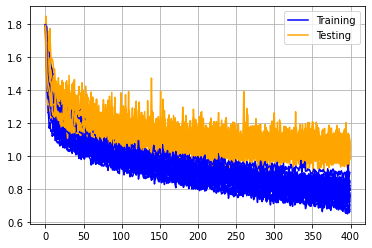

In [19]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [20]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.0406631398200987
mean accuracy:  0.5570525789260864


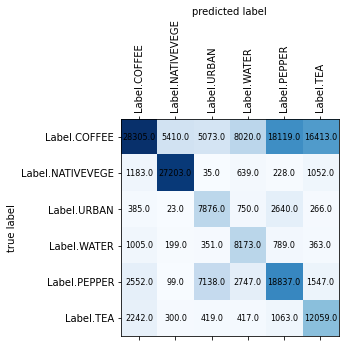

In [21]:
plot_confusion_matrix(conf_matrix, labels)

In [22]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.79347948 0.81852922 0.37698641 0.39395546 0.45198675 0.38041009]
Recalls:  [0.34798377 0.89660514 0.65963149 0.75119485 0.57220535 0.73084848]
F-Score:  [0.48379653 0.8557901  0.47977583 0.51685322 0.50504048 0.50037344]


# SWIR1, NIR, BLUE

In [23]:
BANDS = [
    Band.SWIR1.value,
    Band.NIR.value,
    Band.BLUE.value
]

In [24]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_3 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9516 - accuracy: 0.4907 - val_loss: 1.1835 - val_accuracy: 0.4710
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9706 - accuracy: 0.4578 - val_loss: 1.1805 - val_accuracy: 0.4860
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0149 - accuracy: 0.4642 - val_loss: 1.1708 - val_accuracy: 0.4702
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9656 - accuracy: 0.4818 - val_loss: 1.1577 - val_accuracy: 0.4717
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9908 - accuracy: 0.5178 - val_loss: 1.1333 - val_accuracy: 0.4852
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9725 - accuracy: 0.5014 - val_loss: 1.0764 - val_accuracy: 0.5276
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9742 - accuracy: 0.4922 - val_loss: 1.0704 - val_accuracy: 0.5299
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8477 - accuracy: 0.5727 - val_loss: 1.0926 - val_accuracy: 0.5184
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7908 - accuracy: 0.5575 - val_loss: 1.0705 - val_accuracy: 0.5411
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8615 - accuracy: 0.5417 - val_loss: 1.0851 - val_accuracy: 0.5251
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8835 - accuracy: 0.5228 - val_loss: 1.1175 - val_accuracy: 0.4999
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8175 - accuracy: 0.5392 - val_loss: 1.0367 - val_accuracy: 0.5379
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8166 - accuracy: 0.5619 - val_loss: 1.1087 - val_accuracy: 0.5102
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8188 - accuracy: 0.5417 - val_loss: 1.0365 - val_accuracy: 0.5537
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7030 - accuracy: 0.6137 - val_loss: 1.0426 - val_accuracy: 0.5416
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7166 - accuracy: 0.5953 - val_loss: 1.0339 - val_accuracy: 0.5687
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7096 - accuracy: 0.5782 - val_loss: 1.0350 - val_accuracy: 0.5488
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6775 - accuracy: 0.6231 - val_loss: 0.9575 - val_accuracy: 0.6054
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6964 - accuracy: 0.6178 - val_loss: 1.0214 - val_accuracy: 0.5684
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6855 - accuracy: 0.6063 - val_loss: 1.0850 - val_accuracy: 0.5299
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7192 - accuracy: 0.5941 - val_loss: 1.0938 - val_accuracy: 0.5348
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6237 - accuracy: 0.6578 - val_loss: 0.9680 - val_accuracy: 0.5948
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6007 - accuracy: 0.6307 - val_loss: 0.9999 - val_accuracy: 0.5816
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7039 - accuracy: 0.6093 - val_loss: 0.9628 - val_accuracy: 0.5878
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6431 - accuracy: 0.6259 - val_loss: 0.9867 - val_accuracy: 0.5914
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6717 - accuracy: 0.6249 - val_loss: 0.9487 - val_accuracy: 0.6147
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.5889 - accuracy: 0.6463 - val_loss: 0.9232 - val_accuracy: 0.6263
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6396 - accuracy: 0.6493 - val_loss: 0.9185 - val_accuracy: 0.6264
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8971 - accuracy: 0.5457 - val_loss: 1.1289 - val_accuracy: 0.5184
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9619 - accuracy: 0.5140 - val_loss: 1.0968 - val_accuracy: 0.5066
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8922 - accuracy: 0.5098 - val_loss: 1.1199 - val_accuracy: 0.5071
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9275 - accuracy: 0.5106 - val_loss: 1.1350 - val_accuracy: 0.5115
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9639 - accuracy: 0.5079 - val_loss: 1.1241 - val_accuracy: 0.4859
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9058 - accuracy: 0.4990 - val_loss: 1.1241 - val_accuracy: 0.4969
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8978 - accuracy: 0.5161 - val_loss: 1.1288 - val_accuracy: 0.4840
E

57/57 [==============================] - 0s 8ms/step - loss: 0.8328 - accuracy: 0.5603 - val_loss: 1.0972 - val_accuracy: 0.5089
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8762 - accuracy: 0.5245 - val_loss: 1.0216 - val_accuracy: 0.5585
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8441 - accuracy: 0.5406 - val_loss: 1.0986 - val_accuracy: 0.4994
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8331 - accuracy: 0.5494 - val_loss: 1.0381 - val_accuracy: 0.5490
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8570 - accuracy: 0.5454 - val_loss: 1.0344 - val_accuracy: 0.5638
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8057 - accuracy: 0.5710 - val_loss: 1.0742 - val_accuracy: 0.5308
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8306 - accuracy: 0.5306 - val_loss: 1.0525 - val_accuracy: 0.5506
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7560 - accuracy: 0.5625 - val_loss: 1.0592 - val_accuracy: 0.5355
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7955 - accuracy: 0.5556 - val_loss: 1.0591 - val_accuracy: 0.5406
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8045 - accuracy: 0.5570 - val_loss: 1.0112 - val_accuracy: 0.5630
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8215 - accuracy: 0.5464 - val_loss: 1.0319 - val_accuracy: 0.5376
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8054 - accuracy: 0.5656 - val_loss: 1.0324 - val_accuracy: 0.5486
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7248 - accuracy: 0.5793 - val_loss: 1.0389 - val_accuracy: 0.5466
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7670 - accuracy: 0.5755 - val_loss: 1.0336 - val_accuracy: 0.5675
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1113 - accuracy: 0.4712 - val_loss: 1.1494 - val_accuracy: 0.5293
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0603 - accuracy: 0.5018 - val_loss: 1.1670 - val_accuracy: 0.5089
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1352 - accuracy: 0.4283 - val_loss: 1.2165 - val_accuracy: 0.4466
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0536 - accuracy: 0.4928 - val_loss: 1.2350 - val_accuracy: 0.4600
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1022 - accuracy: 0.4829 - val_loss: 1.2186 - val_accuracy: 0.4838
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1000 - accuracy: 0.4650 - val_loss: 1.1682 - val_accuracy: 0.4848
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1156 - accuracy: 0.4382 - val_loss: 1.1723 - val_accuracy: 0.4874
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0680 - accuracy: 0.4996 - val_loss: 1.1209 - val_accuracy: 0.5119
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0107 - accuracy: 0.5175 - val_loss: 1.1584 - val_accuracy: 0.5281
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9935 - accuracy: 0.5102 - val_loss: 1.1310 - val_accuracy: 0.5165
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9928 - accuracy: 0.5377 - val_loss: 1.1271 - val_accuracy: 0.5143
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9989 - accuracy: 0.5214 - val_loss: 1.1480 - val_accuracy: 0.5113
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9831 - accuracy: 0.5217 - val_loss: 1.0658 - val_accuracy: 0.5771
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0871 - accuracy: 0.5278 - val_loss: 1.1107 - val_accuracy: 0.5395
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8902 - accuracy: 0.5243 - val_loss: 1.0477 - val_accuracy: 0.5544
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8825 - accuracy: 0.5046 - val_loss: 1.1321 - val_accuracy: 0.5001
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0027 - accuracy: 0.4874 - val_loss: 0.9936 - val_accuracy: 0.5809
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9305 - accuracy: 0.5295 - val_loss: 1.0901 - val_accuracy: 0.5385
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8912 - accuracy: 0.5380 - val_loss: 1.0967 - val_accuracy: 0.5145
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9359 - accuracy: 0.5417 - val_loss: 1.0880 - val_accuracy: 0.5278
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8791 - accuracy: 0.5332 - val_loss: 1.1078 - val_accuracy: 0.5022
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8026 - accuracy: 0.5705 - val_loss: 1.0035 - val_accuracy: 0.5580
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8333 - accuracy: 0.5819 - val_loss: 1.0591 - val_accuracy: 0.5385
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8495 - accuracy: 0.5466 - val_loss: 1.1055 - val_accuracy: 0.5020
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8538 - accuracy: 0.5258 - val_loss: 1.0123 - val_accuracy: 0.5683
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8144 - accuracy: 0.5848 - val_loss: 1.0062 - val_accuracy: 0.5672
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8517 - accuracy: 0.5761 - val_loss: 0.9858 - val_accuracy: 0.5818
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8235 - accuracy: 0.5726 - val_loss: 1.0236 - val_accuracy: 0.5500
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2524 - accuracy: 0.3780 - val_loss: 1.3596 - val_accuracy: 0.3352
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2612 - accuracy: 0.3288 - val_loss: 1.3007 - val_accuracy: 0.3670
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2384 - accuracy: 0.3877 - val_loss: 1.3260 - val_accuracy: 0.3662
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2461 - accuracy: 0.3650 - val_loss: 1.3139 - val_accuracy: 0.3679
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2371 - accuracy: 0.3935 - val_loss: 1.3090 - val_accuracy: 0.3896
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2111 - accuracy: 0.4003 - val_loss: 1.3554 - val_accuracy: 0.3480
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2209 - accuracy: 0.3978 - val_loss: 1.3024 - val_accuracy: 0.3870
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1470 - accuracy: 0.4767 - val_loss: 1.1793 - val_accuracy: 0.5108
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0779 - accuracy: 0.4823 - val_loss: 1.2315 - val_accuracy: 0.4978
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1164 - accuracy: 0.4896 - val_loss: 1.1893 - val_accuracy: 0.4842
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0420 - accuracy: 0.4788 - val_loss: 1.2739 - val_accuracy: 0.4238
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0911 - accuracy: 0.4549 - val_loss: 1.1915 - val_accuracy: 0.4810
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0535 - accuracy: 0.5024 - val_loss: 1.1929 - val_accuracy: 0.4624
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0551 - accuracy: 0.4796 - val_loss: 1.3104 - val_accuracy: 0.4640
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.0270 - accuracy: 0.4984 - val_loss: 1.1171 - val_accuracy: 0.5297
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9746 - accuracy: 0.5552 - val_loss: 1.1268 - val_accuracy: 0.5274
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9396 - accuracy: 0.5418 - val_loss: 1.1666 - val_accuracy: 0.4732
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9454 - accuracy: 0.5194 - val_loss: 1.1091 - val_accuracy: 0.5210
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9938 - accuracy: 0.5378 - val_loss: 1.1290 - val_accuracy: 0.5188
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9726 - accuracy: 0.5097 - val_loss: 1.1599 - val_accuracy: 0.4703
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0401 - accuracy: 0.4841 - val_loss: 1.1604 - val_accuracy: 0.4696
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9177 - accuracy: 0.5373 - val_loss: 1.1062 - val_accuracy: 0.5205
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8836 - accuracy: 0.5651 - val_loss: 1.1020 - val_accuracy: 0.5161
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9104 - accuracy: 0.5658 - val_loss: 1.0809 - val_accuracy: 0.5476
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9309 - accuracy: 0.5720 - val_loss: 1.0813 - val_accuracy: 0.5457
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9033 - accuracy: 0.5775 - val_loss: 1.1152 - val_accuracy: 0.5328
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9019 - accuracy: 0.5482 - val_loss: 1.1492 - val_accuracy: 0.5311
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8918 - accuracy: 0.5477 - val_loss: 1.0959 - val_accuracy: 0.5548
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3044 - accuracy: 0.3213 - val_loss: 1.3520 - val_accuracy: 0.2956
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3196 - accuracy: 0.2993 - val_loss: 1.3457 - val_accuracy: 0.3293
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2762 - accuracy: 0.3395 - val_loss: 1.3125 - val_accuracy: 0.3284
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3188 - accuracy: 0.3342 - val_loss: 1.4024 - val_accuracy: 0.2897
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2445 - accuracy: 0.3337 - val_loss: 1.3950 - val_accuracy: 0.2955
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2568 - accuracy: 0.3131 - val_loss: 1.3310 - val_accuracy: 0.3192
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2709 - accuracy: 0.3117 - val_loss: 1.3287 - val_accuracy: 0.3113
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0544 - accuracy: 0.4552 - val_loss: 1.1603 - val_accuracy: 0.4609
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0594 - accuracy: 0.4786 - val_loss: 1.1184 - val_accuracy: 0.4979
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0636 - accuracy: 0.4658 - val_loss: 1.1009 - val_accuracy: 0.5161
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9906 - accuracy: 0.5081 - val_loss: 1.1342 - val_accuracy: 0.5122
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0348 - accuracy: 0.4989 - val_loss: 1.1230 - val_accuracy: 0.5047
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0021 - accuracy: 0.4839 - val_loss: 1.1330 - val_accuracy: 0.4821
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9882 - accuracy: 0.4909 - val_loss: 1.1590 - val_accuracy: 0.5056
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9148 - accuracy: 0.5175 - val_loss: 1.0497 - val_accuracy: 0.5544
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8950 - accuracy: 0.5553 - val_loss: 1.0539 - val_accuracy: 0.5728
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8534 - accuracy: 0.5796 - val_loss: 1.1114 - val_accuracy: 0.5248
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9009 - accuracy: 0.5247 - val_loss: 1.1468 - val_accuracy: 0.5221
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9135 - accuracy: 0.5533 - val_loss: 1.0621 - val_accuracy: 0.5576
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9236 - accuracy: 0.5586 - val_loss: 1.0814 - val_accuracy: 0.5558
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9048 - accuracy: 0.5338 - val_loss: 1.1387 - val_accuracy: 0.4892
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7876 - accuracy: 0.5569 - val_loss: 1.0404 - val_accuracy: 0.5550
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7969 - accuracy: 0.5754 - val_loss: 1.0582 - val_accuracy: 0.5690
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8822 - accuracy: 0.5514 - val_loss: 1.0311 - val_accuracy: 0.5680
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8005 - accuracy: 0.5553 - val_loss: 1.0709 - val_accuracy: 0.5466
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8019 - accuracy: 0.5476 - val_loss: 1.0859 - val_accuracy: 0.5404
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8492 - accuracy: 0.5540 - val_loss: 1.0892 - val_accuracy: 0.5464
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8087 - accuracy: 0.5644 - val_loss: 1.0942 - val_accuracy: 0.5308
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2761 - accuracy: 0.3614 - val_loss: 1.3355 - val_accuracy: 0.3358
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2849 - accuracy: 0.3316 - val_loss: 1.3123 - val_accuracy: 0.3722
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2174 - accuracy: 0.3733 - val_loss: 1.2549 - val_accuracy: 0.4148
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2530 - accuracy: 0.3917 - val_loss: 1.2374 - val_accuracy: 0.4274
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1703 - accuracy: 0.4350 - val_loss: 1.4045 - val_accuracy: 0.3395
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1867 - accuracy: 0.4023 - val_loss: 1.2903 - val_accuracy: 0.3990
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1816 - accuracy: 0.4018 - val_loss: 1.3225 - val_accuracy: 0.3990
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0817 - accuracy: 0.4946 - val_loss: 1.1247 - val_accuracy: 0.5243
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0780 - accuracy: 0.5026 - val_loss: 1.1681 - val_accuracy: 0.5204
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0823 - accuracy: 0.4817 - val_loss: 1.1672 - val_accuracy: 0.5038
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0305 - accuracy: 0.5044 - val_loss: 1.2794 - val_accuracy: 0.4449
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1231 - accuracy: 0.4641 - val_loss: 1.1245 - val_accuracy: 0.4989
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0567 - accuracy: 0.5127 - val_loss: 1.1449 - val_accuracy: 0.5095
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0482 - accuracy: 0.4819 - val_loss: 1.1198 - val_accuracy: 0.5393
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9221 - accuracy: 0.5405 - val_loss: 1.0824 - val_accuracy: 0.5368
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9680 - accuracy: 0.5400 - val_loss: 1.0689 - val_accuracy: 0.5536
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9252 - accuracy: 0.5147 - val_loss: 1.0296 - val_accuracy: 0.5790
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9599 - accuracy: 0.5616 - val_loss: 1.1225 - val_accuracy: 0.5158
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8929 - accuracy: 0.5408 - val_loss: 1.0881 - val_accuracy: 0.5511
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0010 - accuracy: 0.5045 - val_loss: 1.0605 - val_accuracy: 0.5464
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9853 - accuracy: 0.5509 - val_loss: 1.0864 - val_accuracy: 0.5317
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9111 - accuracy: 0.5562 - val_loss: 1.0959 - val_accuracy: 0.5371
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9129 - accuracy: 0.5585 - val_loss: 1.0883 - val_accuracy: 0.5470
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8382 - accuracy: 0.5630 - val_loss: 1.0199 - val_accuracy: 0.5771
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9155 - accuracy: 0.5637 - val_loss: 1.0799 - val_accuracy: 0.5356
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8620 - accuracy: 0.5746 - val_loss: 1.0446 - val_accuracy: 0.5782
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8963 - accuracy: 0.5665 - val_loss: 1.0246 - val_accuracy: 0.5816
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8695 - accuracy: 0.5838 - val_loss: 1.0831 - val_accuracy: 0.5367
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2847 - accuracy: 0.3766 - val_loss: 1.3864 - val_accuracy: 0.3249
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2173 - accuracy: 0.4016 - val_loss: 1.3274 - val_accuracy: 0.3858
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2459 - accuracy: 0.3987 - val_loss: 1.4284 - val_accuracy: 0.3035
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3029 - accuracy: 0.3419 - val_loss: 1.3145 - val_accuracy: 0.3980
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2709 - accuracy: 0.3879 - val_loss: 1.3287 - val_accuracy: 0.3852
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2287 - accuracy: 0.3667 - val_loss: 1.3331 - val_accuracy: 0.3631
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1994 - accuracy: 0.4071 - val_loss: 1.3692 - val_accuracy: 0.3621
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0034 - accuracy: 0.4745 - val_loss: 1.1848 - val_accuracy: 0.4757
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9815 - accuracy: 0.4689 - val_loss: 1.1675 - val_accuracy: 0.4813
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0202 - accuracy: 0.4850 - val_loss: 1.1522 - val_accuracy: 0.4843
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9856 - accuracy: 0.5189 - val_loss: 1.1951 - val_accuracy: 0.4685
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0029 - accuracy: 0.4899 - val_loss: 1.1855 - val_accuracy: 0.4714
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0528 - accuracy: 0.4684 - val_loss: 1.1399 - val_accuracy: 0.4876
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0411 - accuracy: 0.4629 - val_loss: 1.1637 - val_accuracy: 0.4660
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8929 - accuracy: 0.5331 - val_loss: 1.0667 - val_accuracy: 0.5475
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8505 - accuracy: 0.5334 - val_loss: 1.0757 - val_accuracy: 0.5241
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8503 - accuracy: 0.5392 - val_loss: 1.0645 - val_accuracy: 0.5413
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8681 - accuracy: 0.5127 - val_loss: 1.1965 - val_accuracy: 0.4800
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9198 - accuracy: 0.4962 - val_loss: 1.0537 - val_accuracy: 0.5334
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8570 - accuracy: 0.5289 - val_loss: 1.0830 - val_accuracy: 0.5327
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8792 - accuracy: 0.5471 - val_loss: 1.0252 - val_accuracy: 0.5540
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8100 - accuracy: 0.5681 - val_loss: 1.0631 - val_accuracy: 0.5305
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7623 - accuracy: 0.5597 - val_loss: 1.0025 - val_accuracy: 0.5657
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7494 - accuracy: 0.5795 - val_loss: 0.9946 - val_accuracy: 0.5713
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7984 - accuracy: 0.5609 - val_loss: 1.1167 - val_accuracy: 0.5247
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8365 - accuracy: 0.5649 - val_loss: 0.9919 - val_accuracy: 0.5656
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7944 - accuracy: 0.6001 - val_loss: 1.0269 - val_accuracy: 0.5563
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8439 - accuracy: 0.5808 - val_loss: 1.0762 - val_accuracy: 0.5453
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3879 - accuracy: 0.3465 - val_loss: 1.6207 - val_accuracy: 0.3159
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4684 - accuracy: 0.3530 - val_loss: 1.4380 - val_accuracy: 0.3760
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3956 - accuracy: 0.3986 - val_loss: 1.4257 - val_accuracy: 0.3663
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3588 - accuracy: 0.3860 - val_loss: 1.4070 - val_accuracy: 0.4041
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2737 - accuracy: 0.4316 - val_loss: 1.4713 - val_accuracy: 0.3765
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3022 - accuracy: 0.3952 - val_loss: 1.3738 - val_accuracy: 0.4302
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3007 - accuracy: 0.4375 - val_loss: 1.5735 - val_accuracy: 0.3332
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9689 - accuracy: 0.5183 - val_loss: 1.1182 - val_accuracy: 0.4946
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9585 - accuracy: 0.5253 - val_loss: 1.1290 - val_accuracy: 0.4937
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0233 - accuracy: 0.5106 - val_loss: 1.1634 - val_accuracy: 0.4570
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9854 - accuracy: 0.5056 - val_loss: 1.1557 - val_accuracy: 0.4912
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0116 - accuracy: 0.5515 - val_loss: 1.0427 - val_accuracy: 0.5671
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9931 - accuracy: 0.5496 - val_loss: 1.2045 - val_accuracy: 0.4351
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0170 - accuracy: 0.5069 - val_loss: 1.1155 - val_accuracy: 0.5021
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9211 - accuracy: 0.5727 - val_loss: 1.1638 - val_accuracy: 0.4756
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8863 - accuracy: 0.5628 - val_loss: 1.1075 - val_accuracy: 0.5080
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8144 - accuracy: 0.5597 - val_loss: 1.0750 - val_accuracy: 0.5339
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8044 - accuracy: 0.5924 - val_loss: 1.0827 - val_accuracy: 0.5139
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8903 - accuracy: 0.5450 - val_loss: 0.9860 - val_accuracy: 0.5932
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9022 - accuracy: 0.5615 - val_loss: 1.1212 - val_accuracy: 0.5043
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8761 - accuracy: 0.5670 - val_loss: 1.0870 - val_accuracy: 0.5232
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7919 - accuracy: 0.5833 - val_loss: 1.0177 - val_accuracy: 0.5648
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7684 - accuracy: 0.6074 - val_loss: 1.0054 - val_accuracy: 0.5710
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7921 - accuracy: 0.5943 - val_loss: 0.9882 - val_accuracy: 0.5770
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8189 - accuracy: 0.5943 - val_loss: 1.0179 - val_accuracy: 0.5706
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7682 - accuracy: 0.6009 - val_loss: 1.0186 - val_accuracy: 0.5703
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7299 - accuracy: 0.6353 - val_loss: 1.0542 - val_accuracy: 0.5429
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7611 - accuracy: 0.5987 - val_loss: 0.9918 - val_accuracy: 0.5759
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.4066 - accuracy: 0.3635 - val_loss: 1.3543 - val_accuracy: 0.3890
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2580 - accuracy: 0.3981 - val_loss: 1.4033 - val_accuracy: 0.3194
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2733 - accuracy: 0.3766 - val_loss: 1.3691 - val_accuracy: 0.3454
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2623 - accuracy: 0.3896 - val_loss: 1.3582 - val_accuracy: 0.3459
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2688 - accuracy: 0.4115 - val_loss: 1.3643 - val_accuracy: 0.3519
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3173 - accuracy: 0.3708 - val_loss: 1.3515 - val_accuracy: 0.3535
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2587 - accuracy: 0.3643 - val_loss: 1.4160 - val_accuracy: 0.3712
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0549 - accuracy: 0.4416 - val_loss: 1.2247 - val_accuracy: 0.4337
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0805 - accuracy: 0.4494 - val_loss: 1.2012 - val_accuracy: 0.4511
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0593 - accuracy: 0.4410 - val_loss: 1.1927 - val_accuracy: 0.4487
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0460 - accuracy: 0.4416 - val_loss: 1.1522 - val_accuracy: 0.4672
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0101 - accuracy: 0.4718 - val_loss: 1.3198 - val_accuracy: 0.4037
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0386 - accuracy: 0.4530 - val_loss: 1.2084 - val_accuracy: 0.4573
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0166 - accuracy: 0.4582 - val_loss: 1.1964 - val_accuracy: 0.4628
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8651 - accuracy: 0.5432 - val_loss: 1.0740 - val_accuracy: 0.5385
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9830 - accuracy: 0.5199 - val_loss: 1.0623 - val_accuracy: 0.5350
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8524 - accuracy: 0.5734 - val_loss: 1.0323 - val_accuracy: 0.5653
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8394 - accuracy: 0.5568 - val_loss: 1.0467 - val_accuracy: 0.5623
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8386 - accuracy: 0.5361 - val_loss: 1.0767 - val_accuracy: 0.5320
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8367 - accuracy: 0.5719 - val_loss: 0.9905 - val_accuracy: 0.5852
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8956 - accuracy: 0.5417 - val_loss: 1.0558 - val_accuracy: 0.5584
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8133 - accuracy: 0.5709 - val_loss: 1.0084 - val_accuracy: 0.5788
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7519 - accuracy: 0.5967 - val_loss: 0.9640 - val_accuracy: 0.5977
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7767 - accuracy: 0.5639 - val_loss: 0.9622 - val_accuracy: 0.5922
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7479 - accuracy: 0.5860 - val_loss: 0.9774 - val_accuracy: 0.5939
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7128 - accuracy: 0.6060 - val_loss: 1.0001 - val_accuracy: 0.5789
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6800 - accuracy: 0.6115 - val_loss: 0.9445 - val_accuracy: 0.6193
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7272 - accuracy: 0.6097 - val_loss: 0.9674 - val_accuracy: 0.5971
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7895 - accuracy: 0.1507 - val_loss: 1.7687 - val_accuracy: 0.2714
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6688 - accuracy: 0.2924 - val_loss: 1.5138 - val_accuracy: 0.3187
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4499 - accuracy: 0.3367 - val_loss: 1.4172 - val_accuracy: 0.4071
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4087 - accuracy: 0.3496 - val_loss: 1.3998 - val_accuracy: 0.3654
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4415 - accuracy: 0.3267 - val_loss: 1.3410 - val_accuracy: 0.4447
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3895 - accuracy: 0.3603 - val_loss: 1.3193 - val_accuracy: 0.4385
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4171 - accuracy: 0.3528 - val_loss: 1.3092 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0513 - accuracy: 0.4378 - val_loss: 1.1609 - val_accuracy: 0.4759
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0423 - accuracy: 0.4421 - val_loss: 1.1993 - val_accuracy: 0.4748
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0105 - accuracy: 0.4746 - val_loss: 1.1672 - val_accuracy: 0.4802
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0686 - accuracy: 0.4505 - val_loss: 1.1144 - val_accuracy: 0.5217
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0343 - accuracy: 0.4875 - val_loss: 1.1393 - val_accuracy: 0.4925
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0284 - accuracy: 0.4833 - val_loss: 1.1554 - val_accuracy: 0.5145
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0320 - accuracy: 0.4734 - val_loss: 1.1444 - val_accuracy: 0.5094

57/57 [==============================] - 0s 8ms/step - loss: 0.9641 - accuracy: 0.5028 - val_loss: 1.1074 - val_accuracy: 0.5143
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9690 - accuracy: 0.4977 - val_loss: 1.0996 - val_accuracy: 0.5153
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9320 - accuracy: 0.4971 - val_loss: 1.0945 - val_accuracy: 0.5203
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0028 - accuracy: 0.4976 - val_loss: 1.1276 - val_accuracy: 0.5017
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0081 - accuracy: 0.5163 - val_loss: 1.1296 - val_accuracy: 0.4983
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9893 - accuracy: 0.4965 - val_loss: 1.1189 - val_accuracy: 0.4938
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9588 - accuracy: 0.5140 - val_loss: 1.1084 - val_accuracy: 0.5115
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9202 - accuracy: 0.4981 - val_loss: 1.0547 - val_accuracy: 0.5485
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9515 - accuracy: 0.5081 - val_loss: 1.0724 - val_accuracy: 0.5135
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9245 - accuracy: 0.5318 - val_loss: 1.0992 - val_accuracy: 0.5279
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8703 - accuracy: 0.5126 - val_loss: 1.0859 - val_accuracy: 0.5301
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8741 - accuracy: 0.5201 - val_loss: 1.0245 - val_accuracy: 0.5534
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8795 - accuracy: 0.5367 - val_loss: 1.0799 - val_accuracy: 0.5618
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8871 - accuracy: 0.5424 - val_loss: 1.0523 - val_accuracy: 0.5432
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8576 - accuracy: 0.0719 - val_loss: 1.7975 - val_accuracy: 0.0884
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8409 - accuracy: 0.1134 - val_loss: 1.7630 - val_accuracy: 0.2015
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7432 - accuracy: 0.1786 - val_loss: 1.6931 - val_accuracy: 0.1907
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5536 - accuracy: 0.2122 - val_loss: 1.4312 - val_accuracy: 0.4088
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4679 - accuracy: 0.3285 - val_loss: 1.6154 - val_accuracy: 0.2519
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4774 - accuracy: 0.2764 - val_loss: 1.3752 - val_accuracy: 0.4421
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3287 - accuracy: 0.4079 - val_loss: 1.4493 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9973 - accuracy: 0.5065 - val_loss: 1.2020 - val_accuracy: 0.4717
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9359 - accuracy: 0.5083 - val_loss: 1.1076 - val_accuracy: 0.5283
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9429 - accuracy: 0.5144 - val_loss: 1.1884 - val_accuracy: 0.4460
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9795 - accuracy: 0.4494 - val_loss: 1.1023 - val_accuracy: 0.5192
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9686 - accuracy: 0.5036 - val_loss: 1.1557 - val_accuracy: 0.5046
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8798 - accuracy: 0.5392 - val_loss: 1.2331 - val_accuracy: 0.4224
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9581 - accuracy: 0.4847 - val_loss: 1.0828 - val_accuracy: 0.5227

57/57 [==============================] - 0s 8ms/step - loss: 0.8869 - accuracy: 0.5409 - val_loss: 0.9484 - val_accuracy: 0.6419
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7690 - accuracy: 0.6159 - val_loss: 1.0372 - val_accuracy: 0.5931
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8710 - accuracy: 0.5651 - val_loss: 1.0654 - val_accuracy: 0.5575
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8961 - accuracy: 0.5340 - val_loss: 1.1411 - val_accuracy: 0.4933
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8341 - accuracy: 0.5446 - val_loss: 1.1179 - val_accuracy: 0.5279
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8273 - accuracy: 0.5900 - val_loss: 1.0512 - val_accuracy: 0.5771
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7984 - accuracy: 0.5900 - val_loss: 1.3522 - val_accuracy: 0.4410
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7624 - accuracy: 0.6338 - val_loss: 0.9071 - val_accuracy: 0.6540
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7877 - accuracy: 0.6021 - val_loss: 0.9898 - val_accuracy: 0.6116
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7804 - accuracy: 0.6161 - val_loss: 1.0367 - val_accuracy: 0.5825
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7688 - accuracy: 0.6270 - val_loss: 1.1683 - val_accuracy: 0.4966
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8047 - accuracy: 0.6230 - val_loss: 0.9445 - val_accuracy: 0.6168
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7748 - accuracy: 0.6112 - val_loss: 1.0197 - val_accuracy: 0.5946
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7470 - accuracy: 0.6163 - val_loss: 1.0146 - val_accuracy: 0.5881
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8258 - accuracy: 0.0695 - val_loss: 1.7874 - val_accuracy: 0.0646
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8081 - accuracy: 0.1058 - val_loss: 1.7446 - val_accuracy: 0.0708
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6479 - accuracy: 0.2045 - val_loss: 1.5795 - val_accuracy: 0.2410
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4870 - accuracy: 0.2792 - val_loss: 1.4496 - val_accuracy: 0.3413
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3675 - accuracy: 0.3515 - val_loss: 1.4098 - val_accuracy: 0.3584
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4000 - accuracy: 0.3491 - val_loss: 1.3977 - val_accuracy: 0.3497
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3690 - accuracy: 0.3267 - val_loss: 1.3652 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0022 - accuracy: 0.4990 - val_loss: 1.1318 - val_accuracy: 0.5372
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9970 - accuracy: 0.5127 - val_loss: 1.1392 - val_accuracy: 0.4901
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9991 - accuracy: 0.5001 - val_loss: 1.1250 - val_accuracy: 0.5075
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9378 - accuracy: 0.5196 - val_loss: 1.1145 - val_accuracy: 0.5176
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9880 - accuracy: 0.4981 - val_loss: 1.1085 - val_accuracy: 0.5073
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9759 - accuracy: 0.5315 - val_loss: 1.0933 - val_accuracy: 0.5203
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0177 - accuracy: 0.4848 - val_loss: 1.0805 - val_accuracy: 0.5355

57/57 [==============================] - 0s 8ms/step - loss: 0.9020 - accuracy: 0.5336 - val_loss: 1.0005 - val_accuracy: 0.5657
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8548 - accuracy: 0.5713 - val_loss: 1.0669 - val_accuracy: 0.5297
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9845 - accuracy: 0.5222 - val_loss: 1.1321 - val_accuracy: 0.5025
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8249 - accuracy: 0.5496 - val_loss: 1.0754 - val_accuracy: 0.5109
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8639 - accuracy: 0.5670 - val_loss: 1.0729 - val_accuracy: 0.5126
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8458 - accuracy: 0.5478 - val_loss: 1.1497 - val_accuracy: 0.4783
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9097 - accuracy: 0.5371 - val_loss: 1.1166 - val_accuracy: 0.5244
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8190 - accuracy: 0.5765 - val_loss: 1.0660 - val_accuracy: 0.5301
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8664 - accuracy: 0.5469 - val_loss: 0.9704 - val_accuracy: 0.6000
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8524 - accuracy: 0.5708 - val_loss: 1.0630 - val_accuracy: 0.5237
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7704 - accuracy: 0.5707 - val_loss: 1.0751 - val_accuracy: 0.5472
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8126 - accuracy: 0.5672 - val_loss: 1.0826 - val_accuracy: 0.5006
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8864 - accuracy: 0.5258 - val_loss: 1.0188 - val_accuracy: 0.5528
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8771 - accuracy: 0.5207 - val_loss: 0.9998 - val_accuracy: 0.5701
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7893 - accuracy: 0.2389 - val_loss: 1.7920 - val_accuracy: 0.0884
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8136 - accuracy: 0.1076 - val_loss: 1.7858 - val_accuracy: 0.0716
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7714 - accuracy: 0.1631 - val_loss: 1.5244 - val_accuracy: 0.2992
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4089 - accuracy: 0.3460 - val_loss: 1.4269 - val_accuracy: 0.3057
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3180 - accuracy: 0.3496 - val_loss: 1.3760 - val_accuracy: 0.2780
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3318 - accuracy: 0.3612 - val_loss: 1.3759 - val_accuracy: 0.2978
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2936 - accuracy: 0.3393 - val_loss: 1.4050 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9350 - accuracy: 0.5191 - val_loss: 1.1202 - val_accuracy: 0.5321
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9020 - accuracy: 0.5457 - val_loss: 1.1777 - val_accuracy: 0.4945
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9448 - accuracy: 0.5014 - val_loss: 1.0748 - val_accuracy: 0.5327
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8948 - accuracy: 0.5211 - val_loss: 1.1374 - val_accuracy: 0.5103
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9586 - accuracy: 0.5170 - val_loss: 1.1117 - val_accuracy: 0.5282
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9223 - accuracy: 0.5349 - val_loss: 1.1454 - val_accuracy: 0.5266
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8706 - accuracy: 0.5666 - val_loss: 1.1516 - val_accuracy: 0.5134

57/57 [==============================] - 0s 8ms/step - loss: 0.8367 - accuracy: 0.5606 - val_loss: 1.0523 - val_accuracy: 0.5535
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8621 - accuracy: 0.5575 - val_loss: 1.0896 - val_accuracy: 0.5487
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8161 - accuracy: 0.5829 - val_loss: 1.1013 - val_accuracy: 0.5366
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8404 - accuracy: 0.5557 - val_loss: 1.2107 - val_accuracy: 0.4916
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8288 - accuracy: 0.5460 - val_loss: 1.1336 - val_accuracy: 0.5046
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8725 - accuracy: 0.5420 - val_loss: 1.0445 - val_accuracy: 0.5463
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8186 - accuracy: 0.5472 - val_loss: 1.0555 - val_accuracy: 0.5683
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7580 - accuracy: 0.5763 - val_loss: 1.0935 - val_accuracy: 0.5441
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7199 - accuracy: 0.5790 - val_loss: 1.0416 - val_accuracy: 0.5580
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7782 - accuracy: 0.5724 - val_loss: 1.0962 - val_accuracy: 0.5319
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7896 - accuracy: 0.5753 - val_loss: 1.0203 - val_accuracy: 0.5646
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8144 - accuracy: 0.5644 - val_loss: 1.0496 - val_accuracy: 0.5482
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7298 - accuracy: 0.5740 - val_loss: 1.0403 - val_accuracy: 0.5476
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7728 - accuracy: 0.5977 - val_loss: 1.0763 - val_accuracy: 0.5400
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8067 - accuracy: 0.2703 - val_loss: 1.7909 - val_accuracy: 0.0575
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7404 - accuracy: 0.1278 - val_loss: 1.7848 - val_accuracy: 0.4604
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7452 - accuracy: 0.2516 - val_loss: 1.7680 - val_accuracy: 0.4613
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7421 - accuracy: 0.1563 - val_loss: 1.6987 - val_accuracy: 0.1302
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6644 - accuracy: 0.1464 - val_loss: 1.7086 - val_accuracy: 0.2114
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5722 - accuracy: 0.2077 - val_loss: 1.6016 - val_accuracy: 0.2240
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5576 - accuracy: 0.2381 - val_loss: 1.5796 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9610 - accuracy: 0.5491 - val_loss: 1.1873 - val_accuracy: 0.4719
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9501 - accuracy: 0.5207 - val_loss: 1.1395 - val_accuracy: 0.4931
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9966 - accuracy: 0.4954 - val_loss: 1.0758 - val_accuracy: 0.5554
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0011 - accuracy: 0.5266 - val_loss: 1.1009 - val_accuracy: 0.5486
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9900 - accuracy: 0.5163 - val_loss: 1.1013 - val_accuracy: 0.5180
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9477 - accuracy: 0.5285 - val_loss: 1.1376 - val_accuracy: 0.4938
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9403 - accuracy: 0.5048 - val_loss: 1.1275 - val_accuracy: 0.5271

57/57 [==============================] - 0s 8ms/step - loss: 0.9517 - accuracy: 0.5273 - val_loss: 1.0969 - val_accuracy: 0.5191
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8924 - accuracy: 0.5169 - val_loss: 1.1000 - val_accuracy: 0.5203
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8520 - accuracy: 0.5195 - val_loss: 1.1524 - val_accuracy: 0.5422
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9146 - accuracy: 0.5410 - val_loss: 1.0108 - val_accuracy: 0.5705
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8701 - accuracy: 0.5378 - val_loss: 1.0340 - val_accuracy: 0.5850
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8695 - accuracy: 0.5630 - val_loss: 1.1438 - val_accuracy: 0.5160
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9149 - accuracy: 0.5157 - val_loss: 1.0157 - val_accuracy: 0.5619
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9011 - accuracy: 0.5696 - val_loss: 1.0347 - val_accuracy: 0.5618
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8530 - accuracy: 0.5584 - val_loss: 1.0617 - val_accuracy: 0.5406
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8893 - accuracy: 0.5134 - val_loss: 1.0816 - val_accuracy: 0.5415
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8348 - accuracy: 0.5706 - val_loss: 1.0577 - val_accuracy: 0.5466
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8719 - accuracy: 0.5505 - val_loss: 1.0478 - val_accuracy: 0.5797
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8325 - accuracy: 0.5874 - val_loss: 1.0416 - val_accuracy: 0.5535
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7982 - accuracy: 0.5677 - val_loss: 1.0560 - val_accuracy: 0.5532
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7969 - accuracy: 0.1100 - val_loss: 1.7889 - val_accuracy: 0.1929
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7947 - accuracy: 0.1671 - val_loss: 1.7570 - val_accuracy: 0.0858
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7191 - accuracy: 0.1773 - val_loss: 1.6262 - val_accuracy: 0.3038
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4402 - accuracy: 0.3271 - val_loss: 1.4223 - val_accuracy: 0.3428
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3653 - accuracy: 0.3412 - val_loss: 1.3299 - val_accuracy: 0.4551
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3810 - accuracy: 0.3533 - val_loss: 1.3973 - val_accuracy: 0.2735
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3325 - accuracy: 0.3409 - val_loss: 1.4345 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9731 - accuracy: 0.4927 - val_loss: 1.1649 - val_accuracy: 0.4737
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9489 - accuracy: 0.4570 - val_loss: 1.1216 - val_accuracy: 0.4751
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0582 - accuracy: 0.4594 - val_loss: 1.0971 - val_accuracy: 0.5230
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9409 - accuracy: 0.4948 - val_loss: 1.1366 - val_accuracy: 0.4487
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9441 - accuracy: 0.5024 - val_loss: 1.1111 - val_accuracy: 0.4880
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9339 - accuracy: 0.4999 - val_loss: 1.1302 - val_accuracy: 0.4969
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9263 - accuracy: 0.4876 - val_loss: 1.0994 - val_accuracy: 0.4908

57/57 [==============================] - 0s 8ms/step - loss: 0.8355 - accuracy: 0.5367 - val_loss: 1.0821 - val_accuracy: 0.5366
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8498 - accuracy: 0.5291 - val_loss: 1.0720 - val_accuracy: 0.5054
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9133 - accuracy: 0.5091 - val_loss: 1.0523 - val_accuracy: 0.5113
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8557 - accuracy: 0.5264 - val_loss: 1.1141 - val_accuracy: 0.4802
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8494 - accuracy: 0.5230 - val_loss: 1.0824 - val_accuracy: 0.5351
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7986 - accuracy: 0.5319 - val_loss: 1.1088 - val_accuracy: 0.4919
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8567 - accuracy: 0.5174 - val_loss: 1.0155 - val_accuracy: 0.5553
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7736 - accuracy: 0.5588 - val_loss: 1.1590 - val_accuracy: 0.4715
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8503 - accuracy: 0.5199 - val_loss: 1.0458 - val_accuracy: 0.5305
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8274 - accuracy: 0.5389 - val_loss: 1.0461 - val_accuracy: 0.5475
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7847 - accuracy: 0.5361 - val_loss: 1.0923 - val_accuracy: 0.5297
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8013 - accuracy: 0.5463 - val_loss: 1.0227 - val_accuracy: 0.5563
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8350 - accuracy: 0.5552 - val_loss: 1.0994 - val_accuracy: 0.4982
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8042 - accuracy: 0.5527 - val_loss: 1.0950 - val_accuracy: 0.5353
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7938 - accuracy: 0.0874 - val_loss: 1.7907 - val_accuracy: 0.0890
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7500 - accuracy: 0.1616 - val_loss: 1.5786 - val_accuracy: 0.2694
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4824 - accuracy: 0.3269 - val_loss: 1.4675 - val_accuracy: 0.2746
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3700 - accuracy: 0.3426 - val_loss: 1.3607 - val_accuracy: 0.3422
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3435 - accuracy: 0.3594 - val_loss: 1.3368 - val_accuracy: 0.3418
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1728 - accuracy: 0.3605 - val_loss: 1.1896 - val_accuracy: 0.4009
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1914 - accuracy: 0.3871 - val_loss: 1.2941 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9093 - accuracy: 0.5483 - val_loss: 1.1125 - val_accuracy: 0.4970
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9255 - accuracy: 0.5256 - val_loss: 1.1148 - val_accuracy: 0.4864
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9559 - accuracy: 0.5032 - val_loss: 1.1180 - val_accuracy: 0.4920
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9301 - accuracy: 0.4931 - val_loss: 1.0526 - val_accuracy: 0.5506
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9411 - accuracy: 0.5169 - val_loss: 1.0778 - val_accuracy: 0.5169
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8947 - accuracy: 0.5293 - val_loss: 1.0769 - val_accuracy: 0.5030
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9220 - accuracy: 0.5240 - val_loss: 1.1168 - val_accuracy: 0.4923

57/57 [==============================] - 0s 8ms/step - loss: 0.8140 - accuracy: 0.5657 - val_loss: 0.9831 - val_accuracy: 0.5881
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7954 - accuracy: 0.5649 - val_loss: 1.0190 - val_accuracy: 0.5608
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8150 - accuracy: 0.5469 - val_loss: 1.0171 - val_accuracy: 0.5719
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8193 - accuracy: 0.5469 - val_loss: 1.0346 - val_accuracy: 0.5378
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8167 - accuracy: 0.5567 - val_loss: 1.0654 - val_accuracy: 0.5197
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8561 - accuracy: 0.5565 - val_loss: 1.0340 - val_accuracy: 0.5295
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8453 - accuracy: 0.5528 - val_loss: 0.9570 - val_accuracy: 0.5914
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8153 - accuracy: 0.5881 - val_loss: 0.9536 - val_accuracy: 0.5840
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7907 - accuracy: 0.5723 - val_loss: 1.0386 - val_accuracy: 0.5451
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7558 - accuracy: 0.5734 - val_loss: 0.9607 - val_accuracy: 0.5945
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7403 - accuracy: 0.5989 - val_loss: 1.0657 - val_accuracy: 0.5504
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8358 - accuracy: 0.5707 - val_loss: 1.0302 - val_accuracy: 0.5624
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7668 - accuracy: 0.5755 - val_loss: 0.9961 - val_accuracy: 0.5682
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7897 - accuracy: 0.5937 - val_loss: 0.9757 - val_accuracy: 0.5850
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8109 - accuracy: 0.1171 - val_loss: 1.7766 - val_accuracy: 0.1790
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7779 - accuracy: 0.2265 - val_loss: 1.5201 - val_accuracy: 0.3238
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4352 - accuracy: 0.3471 - val_loss: 1.3797 - val_accuracy: 0.3302
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3808 - accuracy: 0.3341 - val_loss: 1.4183 - val_accuracy: 0.3209
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3347 - accuracy: 0.3484 - val_loss: 1.3727 - val_accuracy: 0.3215
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2867 - accuracy: 0.3571 - val_loss: 1.4006 - val_accuracy: 0.3321
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3544 - accuracy: 0.3170 - val_loss: 1.3991 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9498 - accuracy: 0.4880 - val_loss: 1.0909 - val_accuracy: 0.5472
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9279 - accuracy: 0.5011 - val_loss: 1.1119 - val_accuracy: 0.4935
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9713 - accuracy: 0.4748 - val_loss: 1.1318 - val_accuracy: 0.4988
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9645 - accuracy: 0.4756 - val_loss: 1.1108 - val_accuracy: 0.4829
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9579 - accuracy: 0.4801 - val_loss: 1.1363 - val_accuracy: 0.5160
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9609 - accuracy: 0.5140 - val_loss: 1.1261 - val_accuracy: 0.4846
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9644 - accuracy: 0.4994 - val_loss: 1.0716 - val_accuracy: 0.5252

57/57 [==============================] - 0s 8ms/step - loss: 0.8442 - accuracy: 0.5286 - val_loss: 1.0620 - val_accuracy: 0.5577
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8990 - accuracy: 0.5193 - val_loss: 1.0124 - val_accuracy: 0.5630
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9043 - accuracy: 0.5356 - val_loss: 1.1179 - val_accuracy: 0.5035
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8796 - accuracy: 0.5258 - val_loss: 0.9940 - val_accuracy: 0.5861
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8827 - accuracy: 0.5730 - val_loss: 1.0765 - val_accuracy: 0.5427
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8716 - accuracy: 0.5325 - val_loss: 1.0534 - val_accuracy: 0.5456
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9424 - accuracy: 0.5394 - val_loss: 1.0399 - val_accuracy: 0.5717
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7457 - accuracy: 0.6050 - val_loss: 1.0655 - val_accuracy: 0.5239
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8574 - accuracy: 0.5401 - val_loss: 1.0651 - val_accuracy: 0.5453
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8087 - accuracy: 0.5705 - val_loss: 1.1012 - val_accuracy: 0.5277
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7912 - accuracy: 0.5779 - val_loss: 1.0338 - val_accuracy: 0.5740
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7690 - accuracy: 0.5997 - val_loss: 1.0726 - val_accuracy: 0.5210
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7506 - accuracy: 0.5734 - val_loss: 0.9617 - val_accuracy: 0.6035
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8352 - accuracy: 0.5717 - val_loss: 1.0396 - val_accuracy: 0.5521
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7953 - accuracy: 0.1134 - val_loss: 1.7790 - val_accuracy: 0.2073
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7436 - accuracy: 0.2021 - val_loss: 1.5403 - val_accuracy: 0.4354
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3976 - accuracy: 0.3648 - val_loss: 1.4248 - val_accuracy: 0.3077
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4552 - accuracy: 0.3086 - val_loss: 1.4090 - val_accuracy: 0.4099
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3479 - accuracy: 0.3295 - val_loss: 1.6702 - val_accuracy: 0.2231
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3582 - accuracy: 0.3425 - val_loss: 1.3669 - val_accuracy: 0.3061
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3962 - accuracy: 0.3345 - val_loss: 1.3763 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0172 - accuracy: 0.4768 - val_loss: 1.1531 - val_accuracy: 0.4681
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0293 - accuracy: 0.4794 - val_loss: 1.1257 - val_accuracy: 0.5309
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0290 - accuracy: 0.4921 - val_loss: 1.1759 - val_accuracy: 0.5010
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0444 - accuracy: 0.4969 - val_loss: 1.1276 - val_accuracy: 0.4946
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9909 - accuracy: 0.4923 - val_loss: 1.1955 - val_accuracy: 0.4706
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0230 - accuracy: 0.4961 - val_loss: 1.1662 - val_accuracy: 0.4881
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9811 - accuracy: 0.4839 - val_loss: 1.2084 - val_accuracy: 0.4780

57/57 [==============================] - 0s 9ms/step - loss: 0.9006 - accuracy: 0.5480 - val_loss: 1.1170 - val_accuracy: 0.5147
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8776 - accuracy: 0.5619 - val_loss: 1.2245 - val_accuracy: 0.4842
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9050 - accuracy: 0.5377 - val_loss: 1.0836 - val_accuracy: 0.5357
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8514 - accuracy: 0.5549 - val_loss: 1.1096 - val_accuracy: 0.5489
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9542 - accuracy: 0.5350 - val_loss: 1.1237 - val_accuracy: 0.5220
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9151 - accuracy: 0.5153 - val_loss: 1.1040 - val_accuracy: 0.5548
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9537 - accuracy: 0.5364 - val_loss: 1.1242 - val_accuracy: 0.5035
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8610 - accuracy: 0.5645 - val_loss: 1.0798 - val_accuracy: 0.5815
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8433 - accuracy: 0.5815 - val_loss: 1.0951 - val_accuracy: 0.5479
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8152 - accuracy: 0.5788 - val_loss: 1.0504 - val_accuracy: 0.5907
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9045 - accuracy: 0.6022 - val_loss: 1.0935 - val_accuracy: 0.5778
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8289 - accuracy: 0.5701 - val_loss: 1.1073 - val_accuracy: 0.5479
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8822 - accuracy: 0.5522 - val_loss: 1.1251 - val_accuracy: 0.5258
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8997 - accuracy: 0.5572 - val_loss: 1.0769 - val_accuracy: 0.5808
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8228 - accuracy: 0.1101 - val_loss: 1.7740 - val_accuracy: 0.1990
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7072 - accuracy: 0.2312 - val_loss: 1.6944 - val_accuracy: 0.2800
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4203 - accuracy: 0.3651 - val_loss: 1.4029 - val_accuracy: 0.3829
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3446 - accuracy: 0.3979 - val_loss: 1.4615 - val_accuracy: 0.3730
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3916 - accuracy: 0.3290 - val_loss: 1.6085 - val_accuracy: 0.2973
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3756 - accuracy: 0.3482 - val_loss: 1.3516 - val_accuracy: 0.3896
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3180 - accuracy: 0.3981 - val_loss: 1.3729 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9034 - accuracy: 0.5352 - val_loss: 1.0906 - val_accuracy: 0.5392
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9142 - accuracy: 0.5310 - val_loss: 1.2664 - val_accuracy: 0.4515
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9168 - accuracy: 0.4942 - val_loss: 1.0707 - val_accuracy: 0.5387
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9372 - accuracy: 0.5634 - val_loss: 1.1309 - val_accuracy: 0.5225
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8863 - accuracy: 0.5528 - val_loss: 1.1387 - val_accuracy: 0.4972
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9413 - accuracy: 0.5200 - val_loss: 1.0995 - val_accuracy: 0.5372
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9086 - accuracy: 0.5393 - val_loss: 1.1195 - val_accuracy: 0.5157

57/57 [==============================] - 0s 8ms/step - loss: 0.8118 - accuracy: 0.5630 - val_loss: 1.1260 - val_accuracy: 0.5067
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8296 - accuracy: 0.5733 - val_loss: 1.0461 - val_accuracy: 0.5727
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8306 - accuracy: 0.5966 - val_loss: 1.0304 - val_accuracy: 0.5531
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7906 - accuracy: 0.5870 - val_loss: 1.0435 - val_accuracy: 0.5554
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8136 - accuracy: 0.5958 - val_loss: 1.0395 - val_accuracy: 0.5675
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8354 - accuracy: 0.5905 - val_loss: 1.1242 - val_accuracy: 0.5296
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8330 - accuracy: 0.5653 - val_loss: 1.0062 - val_accuracy: 0.5781
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7955 - accuracy: 0.6108 - val_loss: 0.9992 - val_accuracy: 0.5815
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7592 - accuracy: 0.5654 - val_loss: 1.0844 - val_accuracy: 0.5555
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7684 - accuracy: 0.6018 - val_loss: 1.0136 - val_accuracy: 0.5922
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7549 - accuracy: 0.6280 - val_loss: 1.0526 - val_accuracy: 0.5400
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7903 - accuracy: 0.5995 - val_loss: 1.0165 - val_accuracy: 0.5800
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7316 - accuracy: 0.6318 - val_loss: 1.0359 - val_accuracy: 0.5748
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7465 - accuracy: 0.6133 - val_loss: 1.1386 - val_accuracy: 0.5220
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8234 - accuracy: 0.1194 - val_loss: 1.7914 - val_accuracy: 0.0969
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8232 - accuracy: 0.1107 - val_loss: 1.7775 - val_accuracy: 0.1180
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7547 - accuracy: 0.1336 - val_loss: 1.6971 - val_accuracy: 0.1140
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7083 - accuracy: 0.1321 - val_loss: 1.6442 - val_accuracy: 0.2209
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5701 - accuracy: 0.2036 - val_loss: 1.7225 - val_accuracy: 0.1537
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5754 - accuracy: 0.2196 - val_loss: 1.6588 - val_accuracy: 0.2263
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5721 - accuracy: 0.1917 - val_loss: 1.5694 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9486 - accuracy: 0.5478 - val_loss: 1.1180 - val_accuracy: 0.5124
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0189 - accuracy: 0.4964 - val_loss: 1.0805 - val_accuracy: 0.5531
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9810 - accuracy: 0.5221 - val_loss: 1.0908 - val_accuracy: 0.5158
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9280 - accuracy: 0.5210 - val_loss: 1.1872 - val_accuracy: 0.4794
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9914 - accuracy: 0.4849 - val_loss: 1.1059 - val_accuracy: 0.5003
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0219 - accuracy: 0.5218 - val_loss: 1.0491 - val_accuracy: 0.5648
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9560 - accuracy: 0.5250 - val_loss: 1.1124 - val_accuracy: 0.5067

57/57 [==============================] - 0s 8ms/step - loss: 0.8686 - accuracy: 0.5410 - val_loss: 1.0208 - val_accuracy: 0.5608
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9433 - accuracy: 0.5324 - val_loss: 1.1346 - val_accuracy: 0.4787
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8717 - accuracy: 0.5282 - val_loss: 1.0069 - val_accuracy: 0.5671
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8458 - accuracy: 0.5563 - val_loss: 1.0394 - val_accuracy: 0.5577
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9090 - accuracy: 0.5402 - val_loss: 1.0629 - val_accuracy: 0.5399
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8623 - accuracy: 0.5447 - val_loss: 1.0501 - val_accuracy: 0.5335
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8710 - accuracy: 0.5773 - val_loss: 1.1429 - val_accuracy: 0.4851
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7892 - accuracy: 0.5639 - val_loss: 1.0799 - val_accuracy: 0.5321
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8329 - accuracy: 0.5555 - val_loss: 1.0295 - val_accuracy: 0.5589
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7998 - accuracy: 0.5855 - val_loss: 1.0678 - val_accuracy: 0.5188
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8326 - accuracy: 0.5506 - val_loss: 1.0276 - val_accuracy: 0.5459
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8125 - accuracy: 0.5741 - val_loss: 1.0782 - val_accuracy: 0.5328
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7802 - accuracy: 0.5428 - val_loss: 1.1001 - val_accuracy: 0.5054
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8408 - accuracy: 0.5442 - val_loss: 1.0789 - val_accuracy: 0.5258
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8017 - accuracy: 0.0944 - val_loss: 1.7845 - val_accuracy: 0.1336
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7885 - accuracy: 0.2208 - val_loss: 1.6350 - val_accuracy: 0.2369
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5182 - accuracy: 0.3114 - val_loss: 1.4442 - val_accuracy: 0.2756
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3951 - accuracy: 0.3281 - val_loss: 1.3964 - val_accuracy: 0.3673
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3740 - accuracy: 0.3534 - val_loss: 1.3685 - val_accuracy: 0.3260
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3251 - accuracy: 0.3731 - val_loss: 1.3242 - val_accuracy: 0.3479
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2887 - accuracy: 0.4019 - val_loss: 1.3761 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9992 - accuracy: 0.5092 - val_loss: 1.1499 - val_accuracy: 0.5020
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0658 - accuracy: 0.4933 - val_loss: 1.2405 - val_accuracy: 0.4776
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1147 - accuracy: 0.4532 - val_loss: 1.1587 - val_accuracy: 0.4940
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0587 - accuracy: 0.4929 - val_loss: 1.3504 - val_accuracy: 0.3990
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0640 - accuracy: 0.4803 - val_loss: 1.1426 - val_accuracy: 0.5306
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0068 - accuracy: 0.5120 - val_loss: 1.1696 - val_accuracy: 0.4841
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1115 - accuracy: 0.4731 - val_loss: 1.1294 - val_accuracy: 0.5216

57/57 [==============================] - 0s 8ms/step - loss: 0.9612 - accuracy: 0.5113 - val_loss: 1.1036 - val_accuracy: 0.5150
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9163 - accuracy: 0.5395 - val_loss: 1.1429 - val_accuracy: 0.4905
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9652 - accuracy: 0.4927 - val_loss: 1.1349 - val_accuracy: 0.5099
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9543 - accuracy: 0.5093 - val_loss: 1.1128 - val_accuracy: 0.5192
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8795 - accuracy: 0.5096 - val_loss: 1.1165 - val_accuracy: 0.4872
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9566 - accuracy: 0.5145 - val_loss: 1.1912 - val_accuracy: 0.4914
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9506 - accuracy: 0.4696 - val_loss: 1.1238 - val_accuracy: 0.5136
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8603 - accuracy: 0.5175 - val_loss: 1.1034 - val_accuracy: 0.4842
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8589 - accuracy: 0.5203 - val_loss: 1.1509 - val_accuracy: 0.4690
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8892 - accuracy: 0.4998 - val_loss: 1.0524 - val_accuracy: 0.5487
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9084 - accuracy: 0.5240 - val_loss: 1.0745 - val_accuracy: 0.5249
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8757 - accuracy: 0.5420 - val_loss: 1.1116 - val_accuracy: 0.5299
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9737 - accuracy: 0.5203 - val_loss: 1.0547 - val_accuracy: 0.5201
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8334 - accuracy: 0.5415 - val_loss: 1.0697 - val_accuracy: 0.5311
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7810 - accuracy: 0.1374 - val_loss: 1.7935 - val_accuracy: 0.1849
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7501 - accuracy: 0.1270 - val_loss: 1.7890 - val_accuracy: 0.0988
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8027 - accuracy: 0.1297 - val_loss: 1.7082 - val_accuracy: 0.2327
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5807 - accuracy: 0.2279 - val_loss: 1.5738 - val_accuracy: 0.2304
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5954 - accuracy: 0.2502 - val_loss: 1.5469 - val_accuracy: 0.2661
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5593 - accuracy: 0.2700 - val_loss: 1.5034 - val_accuracy: 0.3760
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4650 - accuracy: 0.3429 - val_loss: 1.4685 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9435 - accuracy: 0.5442 - val_loss: 1.0636 - val_accuracy: 0.5368
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8996 - accuracy: 0.5480 - val_loss: 1.0583 - val_accuracy: 0.5593
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9497 - accuracy: 0.5385 - val_loss: 1.1017 - val_accuracy: 0.5315
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9306 - accuracy: 0.5387 - val_loss: 1.2061 - val_accuracy: 0.4472
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9260 - accuracy: 0.5147 - val_loss: 1.0764 - val_accuracy: 0.5699
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9637 - accuracy: 0.5325 - val_loss: 1.1082 - val_accuracy: 0.4853
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9146 - accuracy: 0.5249 - val_loss: 1.1030 - val_accuracy: 0.5105

57/57 [==============================] - 0s 8ms/step - loss: 0.7701 - accuracy: 0.5976 - val_loss: 1.0391 - val_accuracy: 0.5620
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8447 - accuracy: 0.5560 - val_loss: 0.9937 - val_accuracy: 0.5741
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8852 - accuracy: 0.5802 - val_loss: 1.0596 - val_accuracy: 0.5498
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8359 - accuracy: 0.5601 - val_loss: 1.1012 - val_accuracy: 0.5153
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8321 - accuracy: 0.5602 - val_loss: 1.0158 - val_accuracy: 0.5909
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8679 - accuracy: 0.5779 - val_loss: 1.1161 - val_accuracy: 0.5200
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8416 - accuracy: 0.5672 - val_loss: 1.0669 - val_accuracy: 0.5407
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7393 - accuracy: 0.5936 - val_loss: 0.9753 - val_accuracy: 0.5867
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6999 - accuracy: 0.6050 - val_loss: 0.9763 - val_accuracy: 0.6084
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7339 - accuracy: 0.6010 - val_loss: 1.0282 - val_accuracy: 0.5826
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7610 - accuracy: 0.6048 - val_loss: 0.9620 - val_accuracy: 0.6261
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7694 - accuracy: 0.6049 - val_loss: 1.0448 - val_accuracy: 0.5540
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8292 - accuracy: 0.5891 - val_loss: 0.9992 - val_accuracy: 0.5945
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7549 - accuracy: 0.6180 - val_loss: 0.9890 - val_accuracy: 0.6077
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7326 - accuracy: 0.2465 - val_loss: 1.7907 - val_accuracy: 0.1631
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7788 - accuracy: 0.1326 - val_loss: 1.7081 - val_accuracy: 0.1055
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6906 - accuracy: 0.1525 - val_loss: 1.5650 - val_accuracy: 0.2750
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4670 - accuracy: 0.2827 - val_loss: 1.6047 - val_accuracy: 0.2682
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5156 - accuracy: 0.2832 - val_loss: 1.3916 - val_accuracy: 0.4010
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3924 - accuracy: 0.3583 - val_loss: 1.4713 - val_accuracy: 0.3458
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3805 - accuracy: 0.3768 - val_loss: 1.3447 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9788 - accuracy: 0.4779 - val_loss: 1.0966 - val_accuracy: 0.5308
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9762 - accuracy: 0.4813 - val_loss: 1.1804 - val_accuracy: 0.4800
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0546 - accuracy: 0.4799 - val_loss: 1.1028 - val_accuracy: 0.5228
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9383 - accuracy: 0.5093 - val_loss: 1.0721 - val_accuracy: 0.5346
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0383 - accuracy: 0.4776 - val_loss: 1.2004 - val_accuracy: 0.4889
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9467 - accuracy: 0.5037 - val_loss: 1.0782 - val_accuracy: 0.5236
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9409 - accuracy: 0.4997 - val_loss: 1.1201 - val_accuracy: 0.4957

57/57 [==============================] - 0s 8ms/step - loss: 0.8480 - accuracy: 0.5630 - val_loss: 1.0578 - val_accuracy: 0.5614
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9366 - accuracy: 0.5514 - val_loss: 0.9953 - val_accuracy: 0.6072
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8560 - accuracy: 0.5960 - val_loss: 0.9794 - val_accuracy: 0.6163
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8468 - accuracy: 0.5566 - val_loss: 1.0801 - val_accuracy: 0.5466
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8860 - accuracy: 0.5338 - val_loss: 1.0563 - val_accuracy: 0.5561
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8777 - accuracy: 0.5499 - val_loss: 1.0499 - val_accuracy: 0.5649
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8804 - accuracy: 0.5520 - val_loss: 1.0855 - val_accuracy: 0.5345
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7781 - accuracy: 0.6087 - val_loss: 0.9820 - val_accuracy: 0.6064
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7623 - accuracy: 0.6143 - val_loss: 1.1191 - val_accuracy: 0.5150
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8246 - accuracy: 0.5394 - val_loss: 0.9487 - val_accuracy: 0.6333
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7986 - accuracy: 0.6195 - val_loss: 0.9710 - val_accuracy: 0.6331
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7865 - accuracy: 0.5956 - val_loss: 1.0320 - val_accuracy: 0.5743
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7823 - accuracy: 0.6193 - val_loss: 0.9950 - val_accuracy: 0.5932
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7494 - accuracy: 0.5962 - val_loss: 1.1554 - val_accuracy: 0.5164
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8120 - accuracy: 0.1067 - val_loss: 1.7942 - val_accuracy: 0.1077
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7920 - accuracy: 0.0919 - val_loss: 1.7804 - val_accuracy: 0.0966
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7616 - accuracy: 0.1540 - val_loss: 1.5988 - val_accuracy: 0.3065
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5417 - accuracy: 0.2734 - val_loss: 1.5426 - val_accuracy: 0.2892
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4300 - accuracy: 0.3276 - val_loss: 1.4708 - val_accuracy: 0.3323
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4039 - accuracy: 0.3185 - val_loss: 1.4504 - val_accuracy: 0.3871
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3381 - accuracy: 0.3752 - val_loss: 1.4112 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9567 - accuracy: 0.5252 - val_loss: 1.2165 - val_accuracy: 0.4727
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9798 - accuracy: 0.4899 - val_loss: 1.1879 - val_accuracy: 0.4732
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9598 - accuracy: 0.5012 - val_loss: 1.1628 - val_accuracy: 0.4865
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9470 - accuracy: 0.5265 - val_loss: 1.1363 - val_accuracy: 0.5127
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0337 - accuracy: 0.4839 - val_loss: 1.1842 - val_accuracy: 0.4715
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9862 - accuracy: 0.4845 - val_loss: 1.1415 - val_accuracy: 0.4972
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9788 - accuracy: 0.4972 - val_loss: 1.0991 - val_accuracy: 0.5122

57/57 [==============================] - 0s 8ms/step - loss: 0.8318 - accuracy: 0.5526 - val_loss: 1.0252 - val_accuracy: 0.5736
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7737 - accuracy: 0.5938 - val_loss: 1.0593 - val_accuracy: 0.5413
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8315 - accuracy: 0.5647 - val_loss: 1.0320 - val_accuracy: 0.5562
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7877 - accuracy: 0.5715 - val_loss: 1.0245 - val_accuracy: 0.5733
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7596 - accuracy: 0.5775 - val_loss: 1.0285 - val_accuracy: 0.5665
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7445 - accuracy: 0.6112 - val_loss: 0.9909 - val_accuracy: 0.5834
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8295 - accuracy: 0.5881 - val_loss: 1.0870 - val_accuracy: 0.5379
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7405 - accuracy: 0.5980 - val_loss: 1.0188 - val_accuracy: 0.5828
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7958 - accuracy: 0.5866 - val_loss: 1.0370 - val_accuracy: 0.5563
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6728 - accuracy: 0.6024 - val_loss: 0.9733 - val_accuracy: 0.6030
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7487 - accuracy: 0.6359 - val_loss: 1.0263 - val_accuracy: 0.5646
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6969 - accuracy: 0.6309 - val_loss: 1.0309 - val_accuracy: 0.5691
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6886 - accuracy: 0.6522 - val_loss: 0.9915 - val_accuracy: 0.6035
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7457 - accuracy: 0.6254 - val_loss: 1.0189 - val_accuracy: 0.5973
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7997 - accuracy: 0.1827 - val_loss: 1.7785 - val_accuracy: 0.4241
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7542 - accuracy: 0.2515 - val_loss: 1.6757 - val_accuracy: 0.1180
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5215 - accuracy: 0.2074 - val_loss: 1.5700 - val_accuracy: 0.2158
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4701 - accuracy: 0.2675 - val_loss: 1.5345 - val_accuracy: 0.3032
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4423 - accuracy: 0.3275 - val_loss: 1.4868 - val_accuracy: 0.3393
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4887 - accuracy: 0.2970 - val_loss: 1.4942 - val_accuracy: 0.3542
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4411 - accuracy: 0.3895 - val_loss: 1.4023 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9415 - accuracy: 0.5480 - val_loss: 1.1136 - val_accuracy: 0.5009
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0511 - accuracy: 0.4674 - val_loss: 1.2248 - val_accuracy: 0.4499
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9477 - accuracy: 0.4961 - val_loss: 1.1267 - val_accuracy: 0.5177
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9720 - accuracy: 0.5147 - val_loss: 1.1534 - val_accuracy: 0.4617
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0031 - accuracy: 0.5135 - val_loss: 1.1130 - val_accuracy: 0.5183
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9619 - accuracy: 0.5481 - val_loss: 1.1224 - val_accuracy: 0.5203
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9707 - accuracy: 0.5000 - val_loss: 1.0726 - val_accuracy: 0.5292

57/57 [==============================] - 0s 8ms/step - loss: 0.8970 - accuracy: 0.5366 - val_loss: 1.1336 - val_accuracy: 0.5126
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8652 - accuracy: 0.5484 - val_loss: 1.0417 - val_accuracy: 0.5467
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9279 - accuracy: 0.5473 - val_loss: 1.0346 - val_accuracy: 0.5472
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8494 - accuracy: 0.5529 - val_loss: 1.0299 - val_accuracy: 0.5593
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8208 - accuracy: 0.5790 - val_loss: 1.1133 - val_accuracy: 0.5184
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8586 - accuracy: 0.5517 - val_loss: 1.0906 - val_accuracy: 0.5092
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9272 - accuracy: 0.5399 - val_loss: 1.0642 - val_accuracy: 0.5156
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7666 - accuracy: 0.5836 - val_loss: 1.0805 - val_accuracy: 0.5188
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7800 - accuracy: 0.5595 - val_loss: 1.0486 - val_accuracy: 0.5415
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7997 - accuracy: 0.5772 - val_loss: 1.0566 - val_accuracy: 0.5591
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7964 - accuracy: 0.5946 - val_loss: 1.0750 - val_accuracy: 0.5241
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7244 - accuracy: 0.5749 - val_loss: 1.0144 - val_accuracy: 0.5399
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8446 - accuracy: 0.5940 - val_loss: 1.0675 - val_accuracy: 0.5176
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8919 - accuracy: 0.5690 - val_loss: 1.1783 - val_accuracy: 0.4892
Epoch 351/400

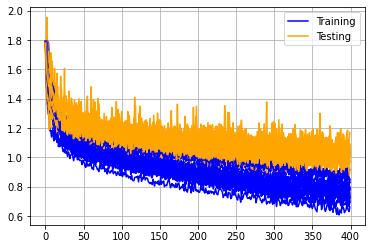

In [25]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [26]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.0295005011558531
mean accuracy:  0.5743262231349944


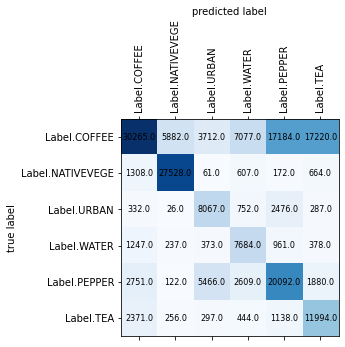

In [27]:
plot_confusion_matrix(conf_matrix, labels)

In [28]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.79074568 0.80843441 0.44876502 0.40077192 0.47811913 0.36992259]
Recalls:  [0.37208016 0.90731707 0.67562814 0.70625    0.61032807 0.72690909]
F-Score:  [0.50604444 0.85502632 0.53931007 0.51136326 0.53619417 0.49032153]


# SWIR1, SWIR2, RED

In [29]:
BANDS = [
    Band.SWIR1.value,
    Band.SWIR2.value,
    Band.RED.value
]

In [30]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_4 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0852 - accuracy: 0.4550 - val_loss: 1.1451 - val_accuracy: 0.4679
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0524 - accuracy: 0.4694 - val_loss: 1.0775 - val_accuracy: 0.4857
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0690 - accuracy: 0.4742 - val_loss: 1.1248 - val_accuracy: 0.4395
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0085 - accuracy: 0.4507 - val_loss: 1.0942 - val_accuracy: 0.4943
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0690 - accuracy: 0.4804 - val_loss: 1.0705 - val_accuracy: 0.4793
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0672 - accuracy: 0.4620 - val_loss: 1.1109 - val_accuracy: 0.4705
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0624 - accuracy: 0.4752 - val_loss: 1.1225 - val_accuracy: 0.5003
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8672 - accuracy: 0.5634 - val_loss: 1.0149 - val_accuracy: 0.5527
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9584 - accuracy: 0.5380 - val_loss: 0.9895 - val_accuracy: 0.5507
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9010 - accuracy: 0.5248 - val_loss: 0.9966 - val_accuracy: 0.5171
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8830 - accuracy: 0.5154 - val_loss: 0.9782 - val_accuracy: 0.5416
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8743 - accuracy: 0.5334 - val_loss: 1.0262 - val_accuracy: 0.5140
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8842 - accuracy: 0.5434 - val_loss: 1.1916 - val_accuracy: 0.4515
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9580 - accuracy: 0.4939 - val_loss: 1.0198 - val_accuracy: 0.5680
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8207 - accuracy: 0.5795 - val_loss: 1.0287 - val_accuracy: 0.5519
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7802 - accuracy: 0.5734 - val_loss: 0.9549 - val_accuracy: 0.5882
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8363 - accuracy: 0.5949 - val_loss: 0.9024 - val_accuracy: 0.6199
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7591 - accuracy: 0.6128 - val_loss: 0.9290 - val_accuracy: 0.5984
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7969 - accuracy: 0.5855 - val_loss: 0.9641 - val_accuracy: 0.5726
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7453 - accuracy: 0.6032 - val_loss: 1.0016 - val_accuracy: 0.5381
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8042 - accuracy: 0.5990 - val_loss: 1.0827 - val_accuracy: 0.4984
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7142 - accuracy: 0.5994 - val_loss: 0.9255 - val_accuracy: 0.5909
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7614 - accuracy: 0.6071 - val_loss: 1.1101 - val_accuracy: 0.5184
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7843 - accuracy: 0.5781 - val_loss: 0.9796 - val_accuracy: 0.5714
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7213 - accuracy: 0.6328 - val_loss: 0.9779 - val_accuracy: 0.6018
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7594 - accuracy: 0.6145 - val_loss: 0.9551 - val_accuracy: 0.6184
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7285 - accuracy: 0.6304 - val_loss: 0.9190 - val_accuracy: 0.5869
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6887 - accuracy: 0.6275 - val_loss: 0.9155 - val_accuracy: 0.6026
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9349 - accuracy: 0.5492 - val_loss: 1.0392 - val_accuracy: 0.5328
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9195 - accuracy: 0.5291 - val_loss: 1.0456 - val_accuracy: 0.5105
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9810 - accuracy: 0.5113 - val_loss: 1.0062 - val_accuracy: 0.5599
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9476 - accuracy: 0.5537 - val_loss: 1.0223 - val_accuracy: 0.5500
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8725 - accuracy: 0.5442 - val_loss: 1.0540 - val_accuracy: 0.5404
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9260 - accuracy: 0.5448 - val_loss: 1.0581 - val_accuracy: 0.5046
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9239 - accuracy: 0.5440 - val_loss: 1.0512 - val_accuracy: 0.5406
E

57/57 [==============================] - 0s 8ms/step - loss: 0.8028 - accuracy: 0.5524 - val_loss: 1.0089 - val_accuracy: 0.5527
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7809 - accuracy: 0.5748 - val_loss: 0.9774 - val_accuracy: 0.5773
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8537 - accuracy: 0.5693 - val_loss: 0.9721 - val_accuracy: 0.5834
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8113 - accuracy: 0.5800 - val_loss: 0.9970 - val_accuracy: 0.5502
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8515 - accuracy: 0.5500 - val_loss: 1.1273 - val_accuracy: 0.5559
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8483 - accuracy: 0.5556 - val_loss: 0.9743 - val_accuracy: 0.5729
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8732 - accuracy: 0.5647 - val_loss: 0.9832 - val_accuracy: 0.5663
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7406 - accuracy: 0.6090 - val_loss: 0.9452 - val_accuracy: 0.5997
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7934 - accuracy: 0.5989 - val_loss: 1.0083 - val_accuracy: 0.5777
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7636 - accuracy: 0.6205 - val_loss: 1.0333 - val_accuracy: 0.5486
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7436 - accuracy: 0.5891 - val_loss: 1.0018 - val_accuracy: 0.5892
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8494 - accuracy: 0.5830 - val_loss: 0.9640 - val_accuracy: 0.5955
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7916 - accuracy: 0.6159 - val_loss: 0.9538 - val_accuracy: 0.6005
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6926 - accuracy: 0.6331 - val_loss: 0.9997 - val_accuracy: 0.5944
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1562 - accuracy: 0.3914 - val_loss: 1.2570 - val_accuracy: 0.3966
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1343 - accuracy: 0.4243 - val_loss: 1.2228 - val_accuracy: 0.4653
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0830 - accuracy: 0.4311 - val_loss: 1.2553 - val_accuracy: 0.3920
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1270 - accuracy: 0.4000 - val_loss: 1.2407 - val_accuracy: 0.4105
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1335 - accuracy: 0.4147 - val_loss: 1.2420 - val_accuracy: 0.4029
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1557 - accuracy: 0.4278 - val_loss: 1.2505 - val_accuracy: 0.3887
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1467 - accuracy: 0.3759 - val_loss: 1.3333 - val_accuracy: 0.3667
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0460 - accuracy: 0.4410 - val_loss: 1.2010 - val_accuracy: 0.4165
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1006 - accuracy: 0.4169 - val_loss: 1.2016 - val_accuracy: 0.4259
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1062 - accuracy: 0.4332 - val_loss: 1.1511 - val_accuracy: 0.4545
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0718 - accuracy: 0.4349 - val_loss: 1.2206 - val_accuracy: 0.4041
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0673 - accuracy: 0.4416 - val_loss: 1.1870 - val_accuracy: 0.4265
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0816 - accuracy: 0.4619 - val_loss: 1.1609 - val_accuracy: 0.4418
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0879 - accuracy: 0.4520 - val_loss: 1.1593 - val_accuracy: 0.4445
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9048 - accuracy: 0.5137 - val_loss: 1.0853 - val_accuracy: 0.5099
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8519 - accuracy: 0.5299 - val_loss: 1.0934 - val_accuracy: 0.5195
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8859 - accuracy: 0.5330 - val_loss: 1.3141 - val_accuracy: 0.4196
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9351 - accuracy: 0.4729 - val_loss: 1.0769 - val_accuracy: 0.5028
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9368 - accuracy: 0.5147 - val_loss: 1.0774 - val_accuracy: 0.5233
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8339 - accuracy: 0.5418 - val_loss: 1.0437 - val_accuracy: 0.4979
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9255 - accuracy: 0.5207 - val_loss: 1.0442 - val_accuracy: 0.5436
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8318 - accuracy: 0.5548 - val_loss: 1.0059 - val_accuracy: 0.5474
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8838 - accuracy: 0.5250 - val_loss: 1.0384 - val_accuracy: 0.5377
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8553 - accuracy: 0.5495 - val_loss: 1.1113 - val_accuracy: 0.5233
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8445 - accuracy: 0.5445 - val_loss: 1.2029 - val_accuracy: 0.4906
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8331 - accuracy: 0.5612 - val_loss: 1.0422 - val_accuracy: 0.5406
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8282 - accuracy: 0.5608 - val_loss: 1.0826 - val_accuracy: 0.5267
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8730 - accuracy: 0.5689 - val_loss: 1.0222 - val_accuracy: 0.5391
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1727 - accuracy: 0.4003 - val_loss: 1.2624 - val_accuracy: 0.3662
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2089 - accuracy: 0.3967 - val_loss: 1.2741 - val_accuracy: 0.3686
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1298 - accuracy: 0.4129 - val_loss: 1.2149 - val_accuracy: 0.4133
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1513 - accuracy: 0.4080 - val_loss: 1.2274 - val_accuracy: 0.4344
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1179 - accuracy: 0.4401 - val_loss: 1.3007 - val_accuracy: 0.3798
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1717 - accuracy: 0.4098 - val_loss: 1.2028 - val_accuracy: 0.4059
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1506 - accuracy: 0.4136 - val_loss: 1.3111 - val_accuracy: 0.3809
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9155 - accuracy: 0.5026 - val_loss: 1.1215 - val_accuracy: 0.4882
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9921 - accuracy: 0.4830 - val_loss: 1.1259 - val_accuracy: 0.4877
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0197 - accuracy: 0.4965 - val_loss: 1.0767 - val_accuracy: 0.5088
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9853 - accuracy: 0.5058 - val_loss: 1.1103 - val_accuracy: 0.5176
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9962 - accuracy: 0.4830 - val_loss: 1.5748 - val_accuracy: 0.3279
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0847 - accuracy: 0.4718 - val_loss: 1.1361 - val_accuracy: 0.4885
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9601 - accuracy: 0.5132 - val_loss: 1.0963 - val_accuracy: 0.5013
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8479 - accuracy: 0.5886 - val_loss: 1.0139 - val_accuracy: 0.5678
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8449 - accuracy: 0.5974 - val_loss: 1.1068 - val_accuracy: 0.5134
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8995 - accuracy: 0.5403 - val_loss: 0.9725 - val_accuracy: 0.5824
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8301 - accuracy: 0.5969 - val_loss: 1.0385 - val_accuracy: 0.5523
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8809 - accuracy: 0.5631 - val_loss: 1.0274 - val_accuracy: 0.5466
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8964 - accuracy: 0.5598 - val_loss: 0.9930 - val_accuracy: 0.5539
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8270 - accuracy: 0.5965 - val_loss: 1.0157 - val_accuracy: 0.5531
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8508 - accuracy: 0.5834 - val_loss: 0.9584 - val_accuracy: 0.5862
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7785 - accuracy: 0.6081 - val_loss: 0.9721 - val_accuracy: 0.5641
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7887 - accuracy: 0.5973 - val_loss: 0.9732 - val_accuracy: 0.5736
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8363 - accuracy: 0.5884 - val_loss: 1.0381 - val_accuracy: 0.5150
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8208 - accuracy: 0.5540 - val_loss: 0.9671 - val_accuracy: 0.5852
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7271 - accuracy: 0.6067 - val_loss: 1.0474 - val_accuracy: 0.5445
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7732 - accuracy: 0.5838 - val_loss: 1.0098 - val_accuracy: 0.5529
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1962 - accuracy: 0.4184 - val_loss: 1.2083 - val_accuracy: 0.4303
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1559 - accuracy: 0.4168 - val_loss: 1.1749 - val_accuracy: 0.4919
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1036 - accuracy: 0.4948 - val_loss: 1.2346 - val_accuracy: 0.4400
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1241 - accuracy: 0.4381 - val_loss: 1.1801 - val_accuracy: 0.4475
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1231 - accuracy: 0.4190 - val_loss: 1.1356 - val_accuracy: 0.4751
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0702 - accuracy: 0.4552 - val_loss: 1.1610 - val_accuracy: 0.3923
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0702 - accuracy: 0.4242 - val_loss: 1.1245 - val_accuracy: 0.4563
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0005 - accuracy: 0.5294 - val_loss: 1.1304 - val_accuracy: 0.4829
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9773 - accuracy: 0.4905 - val_loss: 1.0551 - val_accuracy: 0.5158
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9776 - accuracy: 0.5092 - val_loss: 1.0730 - val_accuracy: 0.5206
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9835 - accuracy: 0.4751 - val_loss: 1.0553 - val_accuracy: 0.5043
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0230 - accuracy: 0.4674 - val_loss: 1.0930 - val_accuracy: 0.4983
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9731 - accuracy: 0.4839 - val_loss: 1.0209 - val_accuracy: 0.5487
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9855 - accuracy: 0.4950 - val_loss: 1.0247 - val_accuracy: 0.5445
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8780 - accuracy: 0.5404 - val_loss: 1.0111 - val_accuracy: 0.5517
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8988 - accuracy: 0.5493 - val_loss: 1.0202 - val_accuracy: 0.5527
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9924 - accuracy: 0.4925 - val_loss: 1.0834 - val_accuracy: 0.5033
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9221 - accuracy: 0.5267 - val_loss: 0.9700 - val_accuracy: 0.5529
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8858 - accuracy: 0.5257 - val_loss: 0.9608 - val_accuracy: 0.5584
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8759 - accuracy: 0.5078 - val_loss: 0.9846 - val_accuracy: 0.5690
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9278 - accuracy: 0.5348 - val_loss: 1.0654 - val_accuracy: 0.5195
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8600 - accuracy: 0.5748 - val_loss: 0.9437 - val_accuracy: 0.5812
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8945 - accuracy: 0.5827 - val_loss: 0.9167 - val_accuracy: 0.5979
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8423 - accuracy: 0.5621 - val_loss: 0.9311 - val_accuracy: 0.5891
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8032 - accuracy: 0.5842 - val_loss: 0.9436 - val_accuracy: 0.5892
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7481 - accuracy: 0.5919 - val_loss: 0.9739 - val_accuracy: 0.5604
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8279 - accuracy: 0.5836 - val_loss: 0.9699 - val_accuracy: 0.5756
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7821 - accuracy: 0.5826 - val_loss: 0.9515 - val_accuracy: 0.5808
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0949 - accuracy: 0.4575 - val_loss: 1.2160 - val_accuracy: 0.4622
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0473 - accuracy: 0.4807 - val_loss: 1.1263 - val_accuracy: 0.4520
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1053 - accuracy: 0.4347 - val_loss: 1.3685 - val_accuracy: 0.3608
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0794 - accuracy: 0.4118 - val_loss: 1.1271 - val_accuracy: 0.5287
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0573 - accuracy: 0.4833 - val_loss: 1.1479 - val_accuracy: 0.5144
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0377 - accuracy: 0.4570 - val_loss: 1.2248 - val_accuracy: 0.4505
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0435 - accuracy: 0.4340 - val_loss: 1.1301 - val_accuracy: 0.4452
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9058 - accuracy: 0.5138 - val_loss: 1.0720 - val_accuracy: 0.4829
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0132 - accuracy: 0.5001 - val_loss: 1.0988 - val_accuracy: 0.5294
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9794 - accuracy: 0.4809 - val_loss: 1.0697 - val_accuracy: 0.4905
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9555 - accuracy: 0.4933 - val_loss: 1.1376 - val_accuracy: 0.4633
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9477 - accuracy: 0.4945 - val_loss: 1.0858 - val_accuracy: 0.5348
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9528 - accuracy: 0.5142 - val_loss: 1.1443 - val_accuracy: 0.4769
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9755 - accuracy: 0.5010 - val_loss: 1.0717 - val_accuracy: 0.5177
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7889 - accuracy: 0.5536 - val_loss: 1.0815 - val_accuracy: 0.5358
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8488 - accuracy: 0.5356 - val_loss: 1.0049 - val_accuracy: 0.5351
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7965 - accuracy: 0.5517 - val_loss: 0.9907 - val_accuracy: 0.5411
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8197 - accuracy: 0.5532 - val_loss: 0.9500 - val_accuracy: 0.5673
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8491 - accuracy: 0.5415 - val_loss: 0.9601 - val_accuracy: 0.5538
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8031 - accuracy: 0.5520 - val_loss: 0.9976 - val_accuracy: 0.5586
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8361 - accuracy: 0.5497 - val_loss: 0.9863 - val_accuracy: 0.5787
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7719 - accuracy: 0.6008 - val_loss: 0.9939 - val_accuracy: 0.5790
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7484 - accuracy: 0.5929 - val_loss: 0.9788 - val_accuracy: 0.6089
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7733 - accuracy: 0.6061 - val_loss: 0.9473 - val_accuracy: 0.5754
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8063 - accuracy: 0.5829 - val_loss: 0.9026 - val_accuracy: 0.6139
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7745 - accuracy: 0.5976 - val_loss: 0.9525 - val_accuracy: 0.5825
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7656 - accuracy: 0.5707 - val_loss: 0.9318 - val_accuracy: 0.6266
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7182 - accuracy: 0.6097 - val_loss: 0.9237 - val_accuracy: 0.6131
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2427 - accuracy: 0.3709 - val_loss: 1.2555 - val_accuracy: 0.3606
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1879 - accuracy: 0.3833 - val_loss: 1.2324 - val_accuracy: 0.3893
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2597 - accuracy: 0.3957 - val_loss: 1.3229 - val_accuracy: 0.3398
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2735 - accuracy: 0.3627 - val_loss: 1.3554 - val_accuracy: 0.3363
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1723 - accuracy: 0.3953 - val_loss: 1.2265 - val_accuracy: 0.3840
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2043 - accuracy: 0.3844 - val_loss: 1.2098 - val_accuracy: 0.4104
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1769 - accuracy: 0.4120 - val_loss: 1.2399 - val_accuracy: 0.3776
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8949 - accuracy: 0.5634 - val_loss: 1.1566 - val_accuracy: 0.4965
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8880 - accuracy: 0.5506 - val_loss: 1.0043 - val_accuracy: 0.5642
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9246 - accuracy: 0.5482 - val_loss: 1.0789 - val_accuracy: 0.5421
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8951 - accuracy: 0.5234 - val_loss: 1.0320 - val_accuracy: 0.5589
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8934 - accuracy: 0.5443 - val_loss: 1.0331 - val_accuracy: 0.5634
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9514 - accuracy: 0.5404 - val_loss: 1.0115 - val_accuracy: 0.5596
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8648 - accuracy: 0.5794 - val_loss: 1.0054 - val_accuracy: 0.5941
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7649 - accuracy: 0.6073 - val_loss: 0.9576 - val_accuracy: 0.5778
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7847 - accuracy: 0.5866 - val_loss: 1.0298 - val_accuracy: 0.5716
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7727 - accuracy: 0.5962 - val_loss: 1.0232 - val_accuracy: 0.5989
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7949 - accuracy: 0.5982 - val_loss: 0.9342 - val_accuracy: 0.5793
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8475 - accuracy: 0.5791 - val_loss: 0.9530 - val_accuracy: 0.6117
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7697 - accuracy: 0.5901 - val_loss: 1.0061 - val_accuracy: 0.5501
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8327 - accuracy: 0.5783 - val_loss: 0.9986 - val_accuracy: 0.6020
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6576 - accuracy: 0.6249 - val_loss: 0.9544 - val_accuracy: 0.6214
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7212 - accuracy: 0.6275 - val_loss: 0.9417 - val_accuracy: 0.6155
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7205 - accuracy: 0.6328 - val_loss: 0.9428 - val_accuracy: 0.6187
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7279 - accuracy: 0.6227 - val_loss: 0.9259 - val_accuracy: 0.6236
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7381 - accuracy: 0.6259 - val_loss: 0.8995 - val_accuracy: 0.6418
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7320 - accuracy: 0.6207 - val_loss: 0.9136 - val_accuracy: 0.6356
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6972 - accuracy: 0.6436 - val_loss: 0.9781 - val_accuracy: 0.6129
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2992 - accuracy: 0.3808 - val_loss: 1.3424 - val_accuracy: 0.3902
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2796 - accuracy: 0.4048 - val_loss: 1.3397 - val_accuracy: 0.3419
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2477 - accuracy: 0.3834 - val_loss: 1.3872 - val_accuracy: 0.3287
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3834 - accuracy: 0.3571 - val_loss: 1.3056 - val_accuracy: 0.3722
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2748 - accuracy: 0.3684 - val_loss: 1.2599 - val_accuracy: 0.4328
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2675 - accuracy: 0.3871 - val_loss: 1.3187 - val_accuracy: 0.3484
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2622 - accuracy: 0.3820 - val_loss: 1.2735 - val_accuracy: 0.4155
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1708 - accuracy: 0.4427 - val_loss: 1.1808 - val_accuracy: 0.4621
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1169 - accuracy: 0.4213 - val_loss: 1.2789 - val_accuracy: 0.4352
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1427 - accuracy: 0.4387 - val_loss: 1.2993 - val_accuracy: 0.3946
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1185 - accuracy: 0.4417 - val_loss: 1.2203 - val_accuracy: 0.4317
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1541 - accuracy: 0.3966 - val_loss: 1.2004 - val_accuracy: 0.4505
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0808 - accuracy: 0.4432 - val_loss: 1.2502 - val_accuracy: 0.4226
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1036 - accuracy: 0.4365 - val_loss: 1.2419 - val_accuracy: 0.4321
Epoch 

57/57 [==============================] - 0s 9ms/step - loss: 0.9242 - accuracy: 0.5054 - val_loss: 1.2253 - val_accuracy: 0.4411
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0373 - accuracy: 0.4458 - val_loss: 1.0565 - val_accuracy: 0.5342
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9087 - accuracy: 0.5239 - val_loss: 1.1242 - val_accuracy: 0.4986
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9455 - accuracy: 0.5180 - val_loss: 1.1268 - val_accuracy: 0.5118
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9365 - accuracy: 0.5206 - val_loss: 1.0410 - val_accuracy: 0.5281
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9190 - accuracy: 0.5177 - val_loss: 1.1518 - val_accuracy: 0.4643
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9169 - accuracy: 0.4901 - val_loss: 1.2575 - val_accuracy: 0.4326
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8819 - accuracy: 0.5189 - val_loss: 1.0779 - val_accuracy: 0.5181
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9414 - accuracy: 0.5146 - val_loss: 1.1292 - val_accuracy: 0.5065
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8533 - accuracy: 0.5371 - val_loss: 1.0517 - val_accuracy: 0.5320
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8535 - accuracy: 0.5205 - val_loss: 1.0250 - val_accuracy: 0.5486
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8360 - accuracy: 0.5270 - val_loss: 1.0266 - val_accuracy: 0.5437
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8190 - accuracy: 0.5453 - val_loss: 1.0417 - val_accuracy: 0.5398
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8228 - accuracy: 0.5362 - val_loss: 1.0312 - val_accuracy: 0.5551
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.4824 - accuracy: 0.2935 - val_loss: 1.3825 - val_accuracy: 0.3481
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3492 - accuracy: 0.3721 - val_loss: 1.3756 - val_accuracy: 0.3368
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3830 - accuracy: 0.3712 - val_loss: 1.4130 - val_accuracy: 0.2921
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3760 - accuracy: 0.3507 - val_loss: 1.3972 - val_accuracy: 0.3113
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3101 - accuracy: 0.3456 - val_loss: 1.3342 - val_accuracy: 0.3379
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3184 - accuracy: 0.3634 - val_loss: 1.3505 - val_accuracy: 0.3817
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3305 - accuracy: 0.3885 - val_loss: 1.3999 - val_accuracy: 0.3281
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9754 - accuracy: 0.5112 - val_loss: 1.0800 - val_accuracy: 0.4693
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0172 - accuracy: 0.5201 - val_loss: 1.0909 - val_accuracy: 0.5137
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0046 - accuracy: 0.5283 - val_loss: 1.0586 - val_accuracy: 0.4990
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9808 - accuracy: 0.5128 - val_loss: 1.0695 - val_accuracy: 0.5407
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9965 - accuracy: 0.5217 - val_loss: 1.0866 - val_accuracy: 0.5468
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9736 - accuracy: 0.5280 - val_loss: 1.0838 - val_accuracy: 0.4956
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9581 - accuracy: 0.5433 - val_loss: 1.0449 - val_accuracy: 0.5331
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9401 - accuracy: 0.5682 - val_loss: 0.9635 - val_accuracy: 0.5849
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8239 - accuracy: 0.5846 - val_loss: 0.9868 - val_accuracy: 0.5562
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8301 - accuracy: 0.5781 - val_loss: 0.9909 - val_accuracy: 0.5463
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8331 - accuracy: 0.5653 - val_loss: 1.0413 - val_accuracy: 0.5456
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9189 - accuracy: 0.5352 - val_loss: 1.0035 - val_accuracy: 0.5153
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8292 - accuracy: 0.5832 - val_loss: 1.0628 - val_accuracy: 0.5448
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9078 - accuracy: 0.5670 - val_loss: 0.9859 - val_accuracy: 0.5476
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7198 - accuracy: 0.6269 - val_loss: 0.9467 - val_accuracy: 0.6115
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7878 - accuracy: 0.6094 - val_loss: 1.0217 - val_accuracy: 0.5852
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7950 - accuracy: 0.6065 - val_loss: 0.9840 - val_accuracy: 0.5535
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7533 - accuracy: 0.5939 - val_loss: 1.0497 - val_accuracy: 0.5650
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8274 - accuracy: 0.5929 - val_loss: 0.9389 - val_accuracy: 0.6035
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7610 - accuracy: 0.6339 - val_loss: 0.9823 - val_accuracy: 0.5968
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7357 - accuracy: 0.5973 - val_loss: 0.9602 - val_accuracy: 0.6019
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7884 - accuracy: 0.1417 - val_loss: 1.7880 - val_accuracy: 0.0650
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7070 - accuracy: 0.1677 - val_loss: 1.7371 - val_accuracy: 0.1510
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5540 - accuracy: 0.2660 - val_loss: 1.3693 - val_accuracy: 0.4017
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4189 - accuracy: 0.3356 - val_loss: 1.4621 - val_accuracy: 0.3064
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4130 - accuracy: 0.3297 - val_loss: 1.3906 - val_accuracy: 0.3047
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3438 - accuracy: 0.3581 - val_loss: 1.3354 - val_accuracy: 0.3307
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2938 - accuracy: 0.3878 - val_loss: 1.3450 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9547 - accuracy: 0.5094 - val_loss: 1.0550 - val_accuracy: 0.5142
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9692 - accuracy: 0.5394 - val_loss: 1.0745 - val_accuracy: 0.4692
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9574 - accuracy: 0.5110 - val_loss: 1.0530 - val_accuracy: 0.5266
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9407 - accuracy: 0.5187 - val_loss: 1.2818 - val_accuracy: 0.4116
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0203 - accuracy: 0.4955 - val_loss: 1.0417 - val_accuracy: 0.5084
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9743 - accuracy: 0.5332 - val_loss: 1.0537 - val_accuracy: 0.4813
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9769 - accuracy: 0.5092 - val_loss: 1.1357 - val_accuracy: 0.4623

57/57 [==============================] - 0s 8ms/step - loss: 0.8515 - accuracy: 0.5617 - val_loss: 1.0643 - val_accuracy: 0.5296
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8819 - accuracy: 0.5444 - val_loss: 1.0059 - val_accuracy: 0.5483
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9194 - accuracy: 0.5147 - val_loss: 1.0089 - val_accuracy: 0.5383
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8219 - accuracy: 0.5647 - val_loss: 1.0488 - val_accuracy: 0.5615
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8634 - accuracy: 0.5696 - val_loss: 1.0136 - val_accuracy: 0.5578
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9616 - accuracy: 0.5423 - val_loss: 0.9994 - val_accuracy: 0.5501
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8290 - accuracy: 0.5781 - val_loss: 1.0474 - val_accuracy: 0.4998
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8200 - accuracy: 0.5648 - val_loss: 0.9520 - val_accuracy: 0.5750
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8450 - accuracy: 0.5703 - val_loss: 0.9100 - val_accuracy: 0.5941
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7773 - accuracy: 0.5986 - val_loss: 0.9879 - val_accuracy: 0.5501
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7742 - accuracy: 0.5614 - val_loss: 0.9854 - val_accuracy: 0.5707
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8507 - accuracy: 0.5595 - val_loss: 1.0267 - val_accuracy: 0.5542
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8151 - accuracy: 0.5981 - val_loss: 1.0221 - val_accuracy: 0.5612
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8393 - accuracy: 0.5486 - val_loss: 0.9766 - val_accuracy: 0.5741
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7901 - accuracy: 0.1496 - val_loss: 1.7860 - val_accuracy: 0.1880
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7729 - accuracy: 0.1680 - val_loss: 1.5892 - val_accuracy: 0.2626
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4334 - accuracy: 0.3200 - val_loss: 1.4106 - val_accuracy: 0.2923
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3959 - accuracy: 0.2828 - val_loss: 1.3868 - val_accuracy: 0.3460
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3330 - accuracy: 0.3338 - val_loss: 1.4178 - val_accuracy: 0.2875
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3594 - accuracy: 0.3510 - val_loss: 1.3449 - val_accuracy: 0.3064
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3242 - accuracy: 0.3149 - val_loss: 1.3341 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9187 - accuracy: 0.5369 - val_loss: 1.0538 - val_accuracy: 0.5250
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9265 - accuracy: 0.5176 - val_loss: 1.0054 - val_accuracy: 0.5493
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9203 - accuracy: 0.5416 - val_loss: 1.0320 - val_accuracy: 0.5362
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9324 - accuracy: 0.5245 - val_loss: 1.0561 - val_accuracy: 0.5060
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8800 - accuracy: 0.5354 - val_loss: 0.9943 - val_accuracy: 0.5594
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9091 - accuracy: 0.5497 - val_loss: 1.0546 - val_accuracy: 0.5551
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9304 - accuracy: 0.5527 - val_loss: 1.0411 - val_accuracy: 0.5306

57/57 [==============================] - 0s 8ms/step - loss: 0.8474 - accuracy: 0.5580 - val_loss: 0.9909 - val_accuracy: 0.5718
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8368 - accuracy: 0.5566 - val_loss: 0.9958 - val_accuracy: 0.5851
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8078 - accuracy: 0.5796 - val_loss: 0.9421 - val_accuracy: 0.5935
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8861 - accuracy: 0.5484 - val_loss: 0.9311 - val_accuracy: 0.6048
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8552 - accuracy: 0.5833 - val_loss: 0.9715 - val_accuracy: 0.5653
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7651 - accuracy: 0.5757 - val_loss: 0.9535 - val_accuracy: 0.5697
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8016 - accuracy: 0.5826 - val_loss: 0.9476 - val_accuracy: 0.6036
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8555 - accuracy: 0.5766 - val_loss: 0.9842 - val_accuracy: 0.5927
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8093 - accuracy: 0.5992 - val_loss: 0.9561 - val_accuracy: 0.6266
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7628 - accuracy: 0.6217 - val_loss: 0.9329 - val_accuracy: 0.5972
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7551 - accuracy: 0.6033 - val_loss: 0.9668 - val_accuracy: 0.5718
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7843 - accuracy: 0.5865 - val_loss: 0.9681 - val_accuracy: 0.5802
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8323 - accuracy: 0.5630 - val_loss: 1.0466 - val_accuracy: 0.5321
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7756 - accuracy: 0.5746 - val_loss: 0.9077 - val_accuracy: 0.6147
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7463 - accuracy: 0.3824 - val_loss: 1.7886 - val_accuracy: 0.0590
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8186 - accuracy: 0.1527 - val_loss: 1.7894 - val_accuracy: 0.4457
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7874 - accuracy: 0.2525 - val_loss: 1.7870 - val_accuracy: 0.0639
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7536 - accuracy: 0.1385 - val_loss: 1.6327 - val_accuracy: 0.3243
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5352 - accuracy: 0.2907 - val_loss: 1.3923 - val_accuracy: 0.3973
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3850 - accuracy: 0.3575 - val_loss: 1.3886 - val_accuracy: 0.3268
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3386 - accuracy: 0.3524 - val_loss: 1.3581 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0176 - accuracy: 0.5312 - val_loss: 1.0653 - val_accuracy: 0.5317
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9665 - accuracy: 0.5236 - val_loss: 1.1038 - val_accuracy: 0.5103
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0013 - accuracy: 0.5027 - val_loss: 1.1718 - val_accuracy: 0.4920
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9494 - accuracy: 0.5216 - val_loss: 1.0778 - val_accuracy: 0.5267
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9834 - accuracy: 0.5066 - val_loss: 1.0438 - val_accuracy: 0.5534
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9797 - accuracy: 0.5433 - val_loss: 1.0762 - val_accuracy: 0.5222
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9341 - accuracy: 0.5267 - val_loss: 1.0979 - val_accuracy: 0.4851

57/57 [==============================] - 0s 8ms/step - loss: 0.9138 - accuracy: 0.5678 - val_loss: 1.0524 - val_accuracy: 0.5332
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9020 - accuracy: 0.5378 - val_loss: 1.0208 - val_accuracy: 0.5519
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9222 - accuracy: 0.5292 - val_loss: 1.0103 - val_accuracy: 0.5674
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8833 - accuracy: 0.5615 - val_loss: 1.1165 - val_accuracy: 0.5187
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8879 - accuracy: 0.5515 - val_loss: 1.0479 - val_accuracy: 0.5441
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8374 - accuracy: 0.5836 - val_loss: 1.0437 - val_accuracy: 0.5387
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8719 - accuracy: 0.5837 - val_loss: 1.1025 - val_accuracy: 0.5271
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8300 - accuracy: 0.5878 - val_loss: 0.9773 - val_accuracy: 0.5819
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7727 - accuracy: 0.6038 - val_loss: 0.9651 - val_accuracy: 0.5928
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8769 - accuracy: 0.5825 - val_loss: 0.9906 - val_accuracy: 0.5641
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8409 - accuracy: 0.5758 - val_loss: 0.9485 - val_accuracy: 0.5914
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8493 - accuracy: 0.5974 - val_loss: 0.9648 - val_accuracy: 0.5936
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8443 - accuracy: 0.6056 - val_loss: 0.9513 - val_accuracy: 0.6181
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9241 - accuracy: 0.5873 - val_loss: 1.0193 - val_accuracy: 0.5536
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7953 - accuracy: 0.2079 - val_loss: 1.7694 - val_accuracy: 0.2852
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6780 - accuracy: 0.3071 - val_loss: 1.4662 - val_accuracy: 0.2925
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3560 - accuracy: 0.3667 - val_loss: 1.3947 - val_accuracy: 0.2865
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2972 - accuracy: 0.3981 - val_loss: 1.3448 - val_accuracy: 0.3110
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2687 - accuracy: 0.3686 - val_loss: 1.2636 - val_accuracy: 0.4267
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2307 - accuracy: 0.4124 - val_loss: 1.2882 - val_accuracy: 0.3999
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2742 - accuracy: 0.3744 - val_loss: 1.3398 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8685 - accuracy: 0.5559 - val_loss: 1.0054 - val_accuracy: 0.5516
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9127 - accuracy: 0.5356 - val_loss: 0.9919 - val_accuracy: 0.5483
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8622 - accuracy: 0.5574 - val_loss: 1.0868 - val_accuracy: 0.5277
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9077 - accuracy: 0.5283 - val_loss: 0.9600 - val_accuracy: 0.5721
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8574 - accuracy: 0.5554 - val_loss: 1.0899 - val_accuracy: 0.5384
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9124 - accuracy: 0.5229 - val_loss: 1.0397 - val_accuracy: 0.5399
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9049 - accuracy: 0.5319 - val_loss: 1.0215 - val_accuracy: 0.5358

57/57 [==============================] - 0s 8ms/step - loss: 0.7763 - accuracy: 0.6099 - val_loss: 0.9375 - val_accuracy: 0.5854
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8136 - accuracy: 0.5627 - val_loss: 0.9642 - val_accuracy: 0.5766
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8348 - accuracy: 0.5706 - val_loss: 0.9546 - val_accuracy: 0.5631
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8550 - accuracy: 0.5420 - val_loss: 1.0081 - val_accuracy: 0.5716
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8162 - accuracy: 0.5537 - val_loss: 0.9685 - val_accuracy: 0.5682
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8125 - accuracy: 0.5841 - val_loss: 0.9997 - val_accuracy: 0.5671
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8279 - accuracy: 0.5630 - val_loss: 0.9837 - val_accuracy: 0.6016
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7665 - accuracy: 0.6122 - val_loss: 0.9838 - val_accuracy: 0.5612
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7403 - accuracy: 0.5932 - val_loss: 0.9818 - val_accuracy: 0.5952
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7388 - accuracy: 0.5928 - val_loss: 0.9610 - val_accuracy: 0.5913
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7514 - accuracy: 0.6260 - val_loss: 0.9277 - val_accuracy: 0.6157
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7072 - accuracy: 0.6392 - val_loss: 0.8859 - val_accuracy: 0.6378
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7367 - accuracy: 0.6337 - val_loss: 1.0352 - val_accuracy: 0.6015
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8046 - accuracy: 0.5727 - val_loss: 0.8953 - val_accuracy: 0.6266
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7545 - accuracy: 0.2080 - val_loss: 1.7327 - val_accuracy: 0.1884
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6066 - accuracy: 0.2417 - val_loss: 1.4176 - val_accuracy: 0.3129
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4156 - accuracy: 0.2943 - val_loss: 1.3449 - val_accuracy: 0.3722
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3187 - accuracy: 0.3743 - val_loss: 1.3592 - val_accuracy: 0.3046
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2971 - accuracy: 0.3493 - val_loss: 1.4198 - val_accuracy: 0.2856
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2498 - accuracy: 0.3587 - val_loss: 1.3544 - val_accuracy: 0.3243
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4036 - accuracy: 0.3091 - val_loss: 1.2839 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9818 - accuracy: 0.5124 - val_loss: 1.0947 - val_accuracy: 0.5016
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0228 - accuracy: 0.4636 - val_loss: 1.1486 - val_accuracy: 0.4832
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0379 - accuracy: 0.4896 - val_loss: 1.0396 - val_accuracy: 0.5035
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0327 - accuracy: 0.5428 - val_loss: 1.1062 - val_accuracy: 0.5046
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0068 - accuracy: 0.5024 - val_loss: 1.0547 - val_accuracy: 0.5181
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9394 - accuracy: 0.5178 - val_loss: 1.1259 - val_accuracy: 0.5298
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0357 - accuracy: 0.5137 - val_loss: 1.0647 - val_accuracy: 0.4944

57/57 [==============================] - 0s 8ms/step - loss: 0.8322 - accuracy: 0.5578 - val_loss: 1.0005 - val_accuracy: 0.5347
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8962 - accuracy: 0.5232 - val_loss: 1.0142 - val_accuracy: 0.5705
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8592 - accuracy: 0.5709 - val_loss: 1.0484 - val_accuracy: 0.5205
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8390 - accuracy: 0.5547 - val_loss: 1.0624 - val_accuracy: 0.5128
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8636 - accuracy: 0.5543 - val_loss: 1.0317 - val_accuracy: 0.5425
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8860 - accuracy: 0.5268 - val_loss: 1.0230 - val_accuracy: 0.5438
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9876 - accuracy: 0.5348 - val_loss: 0.9975 - val_accuracy: 0.5478
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8040 - accuracy: 0.5647 - val_loss: 0.9982 - val_accuracy: 0.5572
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7940 - accuracy: 0.5942 - val_loss: 0.9894 - val_accuracy: 0.5899
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7742 - accuracy: 0.6014 - val_loss: 1.0136 - val_accuracy: 0.5727
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8108 - accuracy: 0.5819 - val_loss: 1.0056 - val_accuracy: 0.5671
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7585 - accuracy: 0.5769 - val_loss: 0.9728 - val_accuracy: 0.5876
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7311 - accuracy: 0.5873 - val_loss: 0.9671 - val_accuracy: 0.6045
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7904 - accuracy: 0.5853 - val_loss: 0.9678 - val_accuracy: 0.5849
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7677 - accuracy: 0.3381 - val_loss: 1.7859 - val_accuracy: 0.0703
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7851 - accuracy: 0.1830 - val_loss: 1.5835 - val_accuracy: 0.2328
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5355 - accuracy: 0.3063 - val_loss: 1.4509 - val_accuracy: 0.2527
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3522 - accuracy: 0.3438 - val_loss: 1.3379 - val_accuracy: 0.4549
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3350 - accuracy: 0.3714 - val_loss: 1.4921 - val_accuracy: 0.2604
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3380 - accuracy: 0.3768 - val_loss: 1.3844 - val_accuracy: 0.3317
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2853 - accuracy: 0.3951 - val_loss: 1.4902 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8874 - accuracy: 0.5185 - val_loss: 1.0267 - val_accuracy: 0.5467
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9247 - accuracy: 0.5374 - val_loss: 1.0103 - val_accuracy: 0.5370
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8462 - accuracy: 0.5366 - val_loss: 1.0554 - val_accuracy: 0.4831
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9017 - accuracy: 0.5188 - val_loss: 1.0269 - val_accuracy: 0.5380
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8893 - accuracy: 0.5391 - val_loss: 1.0170 - val_accuracy: 0.5281
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8793 - accuracy: 0.5179 - val_loss: 1.0337 - val_accuracy: 0.5126
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8479 - accuracy: 0.5464 - val_loss: 1.0027 - val_accuracy: 0.5263

57/57 [==============================] - 0s 8ms/step - loss: 0.8145 - accuracy: 0.5531 - val_loss: 0.9859 - val_accuracy: 0.5413
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8010 - accuracy: 0.5530 - val_loss: 1.0102 - val_accuracy: 0.5441
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7615 - accuracy: 0.5604 - val_loss: 0.9963 - val_accuracy: 0.5417
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8046 - accuracy: 0.5672 - val_loss: 0.9972 - val_accuracy: 0.5377
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8248 - accuracy: 0.5392 - val_loss: 0.9806 - val_accuracy: 0.5475
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8352 - accuracy: 0.5533 - val_loss: 1.0026 - val_accuracy: 0.5633
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8008 - accuracy: 0.5801 - val_loss: 0.9771 - val_accuracy: 0.5377
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7586 - accuracy: 0.5881 - val_loss: 1.0187 - val_accuracy: 0.5240
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7506 - accuracy: 0.5524 - val_loss: 1.0030 - val_accuracy: 0.5508
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6934 - accuracy: 0.5816 - val_loss: 0.9616 - val_accuracy: 0.5750
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7876 - accuracy: 0.5946 - val_loss: 0.9531 - val_accuracy: 0.5782
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7988 - accuracy: 0.5831 - val_loss: 0.9355 - val_accuracy: 0.5744
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7001 - accuracy: 0.5817 - val_loss: 0.9952 - val_accuracy: 0.5819
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7290 - accuracy: 0.5734 - val_loss: 0.9495 - val_accuracy: 0.6015
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7354 - accuracy: 0.3385 - val_loss: 1.7890 - val_accuracy: 0.0695
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7403 - accuracy: 0.1379 - val_loss: 1.6225 - val_accuracy: 0.2459
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5157 - accuracy: 0.2724 - val_loss: 1.4846 - val_accuracy: 0.2988
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4200 - accuracy: 0.3214 - val_loss: 1.3916 - val_accuracy: 0.3369
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3990 - accuracy: 0.3547 - val_loss: 1.3628 - val_accuracy: 0.3929
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4380 - accuracy: 0.3587 - val_loss: 1.3878 - val_accuracy: 0.3471
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4043 - accuracy: 0.3361 - val_loss: 1.3432 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0527 - accuracy: 0.4748 - val_loss: 1.1633 - val_accuracy: 0.4652
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1220 - accuracy: 0.4377 - val_loss: 1.1073 - val_accuracy: 0.4815
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0106 - accuracy: 0.4887 - val_loss: 1.1224 - val_accuracy: 0.5001
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0802 - accuracy: 0.4611 - val_loss: 1.1773 - val_accuracy: 0.4598
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0851 - accuracy: 0.4593 - val_loss: 1.1355 - val_accuracy: 0.4889
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0416 - accuracy: 0.4984 - val_loss: 1.0739 - val_accuracy: 0.4827
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0499 - accuracy: 0.4798 - val_loss: 1.0474 - val_accuracy: 0.4965

57/57 [==============================] - 0s 8ms/step - loss: 0.8814 - accuracy: 0.5571 - val_loss: 1.0617 - val_accuracy: 0.5360
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9217 - accuracy: 0.5526 - val_loss: 0.9952 - val_accuracy: 0.5787
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9405 - accuracy: 0.5659 - val_loss: 1.0580 - val_accuracy: 0.5477
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9139 - accuracy: 0.5552 - val_loss: 1.0340 - val_accuracy: 0.5843
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8711 - accuracy: 0.5667 - val_loss: 1.0193 - val_accuracy: 0.5566
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9045 - accuracy: 0.5577 - val_loss: 0.9813 - val_accuracy: 0.5855
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9790 - accuracy: 0.5653 - val_loss: 1.0480 - val_accuracy: 0.5821
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8822 - accuracy: 0.5327 - val_loss: 1.0650 - val_accuracy: 0.5631
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8908 - accuracy: 0.5576 - val_loss: 0.9533 - val_accuracy: 0.5812
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8035 - accuracy: 0.6049 - val_loss: 1.0051 - val_accuracy: 0.5362
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9093 - accuracy: 0.5407 - val_loss: 0.9688 - val_accuracy: 0.5548
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8275 - accuracy: 0.5684 - val_loss: 1.0074 - val_accuracy: 0.5677
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8767 - accuracy: 0.5701 - val_loss: 1.0651 - val_accuracy: 0.5571
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8721 - accuracy: 0.5368 - val_loss: 1.0015 - val_accuracy: 0.5644
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7440 - accuracy: 0.1760 - val_loss: 1.7865 - val_accuracy: 0.4447
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7925 - accuracy: 0.2270 - val_loss: 1.6996 - val_accuracy: 0.2309
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5927 - accuracy: 0.2753 - val_loss: 1.4209 - val_accuracy: 0.3840
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4773 - accuracy: 0.3199 - val_loss: 1.4621 - val_accuracy: 0.3178
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3493 - accuracy: 0.3651 - val_loss: 1.4369 - val_accuracy: 0.3058
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3641 - accuracy: 0.3366 - val_loss: 1.3586 - val_accuracy: 0.3598
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3487 - accuracy: 0.3586 - val_loss: 1.5515 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0434 - accuracy: 0.4683 - val_loss: 1.1300 - val_accuracy: 0.4601
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0857 - accuracy: 0.4488 - val_loss: 1.1426 - val_accuracy: 0.4779
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0167 - accuracy: 0.4836 - val_loss: 1.1880 - val_accuracy: 0.4462
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9925 - accuracy: 0.4865 - val_loss: 1.2118 - val_accuracy: 0.4184
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0656 - accuracy: 0.4343 - val_loss: 1.1508 - val_accuracy: 0.4612
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0509 - accuracy: 0.4930 - val_loss: 1.1217 - val_accuracy: 0.4825
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0402 - accuracy: 0.4798 - val_loss: 1.1815 - val_accuracy: 0.4293

57/57 [==============================] - 0s 8ms/step - loss: 0.9557 - accuracy: 0.5056 - val_loss: 1.0266 - val_accuracy: 0.5342
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9172 - accuracy: 0.5540 - val_loss: 1.0572 - val_accuracy: 0.5126
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9395 - accuracy: 0.5081 - val_loss: 1.0311 - val_accuracy: 0.5200
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8976 - accuracy: 0.5176 - val_loss: 1.0469 - val_accuracy: 0.5205
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9618 - accuracy: 0.5108 - val_loss: 1.0760 - val_accuracy: 0.5036
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9451 - accuracy: 0.4858 - val_loss: 1.0224 - val_accuracy: 0.5293
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9936 - accuracy: 0.5141 - val_loss: 1.0634 - val_accuracy: 0.5379
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8255 - accuracy: 0.5566 - val_loss: 1.0152 - val_accuracy: 0.5448
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8688 - accuracy: 0.5505 - val_loss: 0.9454 - val_accuracy: 0.5849
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9326 - accuracy: 0.5363 - val_loss: 1.0946 - val_accuracy: 0.5451
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8971 - accuracy: 0.5256 - val_loss: 0.9932 - val_accuracy: 0.5392
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8982 - accuracy: 0.5536 - val_loss: 1.0129 - val_accuracy: 0.5319
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8263 - accuracy: 0.5455 - val_loss: 0.9814 - val_accuracy: 0.5616
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8381 - accuracy: 0.5600 - val_loss: 0.9822 - val_accuracy: 0.5815
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8614 - accuracy: 0.0958 - val_loss: 1.7869 - val_accuracy: 0.1048
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7466 - accuracy: 0.2233 - val_loss: 1.5590 - val_accuracy: 0.2596
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4898 - accuracy: 0.2929 - val_loss: 1.4911 - val_accuracy: 0.2879
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4563 - accuracy: 0.3167 - val_loss: 1.4587 - val_accuracy: 0.3486
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4175 - accuracy: 0.3255 - val_loss: 1.3971 - val_accuracy: 0.3935
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3290 - accuracy: 0.3918 - val_loss: 1.4299 - val_accuracy: 0.3061
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3603 - accuracy: 0.3447 - val_loss: 1.3930 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8720 - accuracy: 0.4992 - val_loss: 1.0285 - val_accuracy: 0.5255
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9104 - accuracy: 0.5014 - val_loss: 1.2233 - val_accuracy: 0.4793
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9610 - accuracy: 0.4882 - val_loss: 1.0491 - val_accuracy: 0.5267
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9168 - accuracy: 0.4942 - val_loss: 1.0469 - val_accuracy: 0.5340
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9767 - accuracy: 0.5003 - val_loss: 1.0154 - val_accuracy: 0.5466
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9490 - accuracy: 0.5174 - val_loss: 1.0282 - val_accuracy: 0.5354
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9515 - accuracy: 0.5384 - val_loss: 1.0518 - val_accuracy: 0.5459

57/57 [==============================] - 0s 8ms/step - loss: 0.8808 - accuracy: 0.5334 - val_loss: 0.9849 - val_accuracy: 0.5684
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8871 - accuracy: 0.5745 - val_loss: 1.0275 - val_accuracy: 0.5540
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8206 - accuracy: 0.5521 - val_loss: 1.0258 - val_accuracy: 0.5652
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8968 - accuracy: 0.5529 - val_loss: 1.0616 - val_accuracy: 0.5139
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8982 - accuracy: 0.5413 - val_loss: 1.1176 - val_accuracy: 0.5187
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7844 - accuracy: 0.5632 - val_loss: 1.0060 - val_accuracy: 0.5650
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8319 - accuracy: 0.5517 - val_loss: 1.0123 - val_accuracy: 0.5612
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7859 - accuracy: 0.5902 - val_loss: 0.9969 - val_accuracy: 0.5990
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7392 - accuracy: 0.6068 - val_loss: 1.0183 - val_accuracy: 0.5788
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8078 - accuracy: 0.5838 - val_loss: 0.9598 - val_accuracy: 0.6136
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8236 - accuracy: 0.5786 - val_loss: 1.0393 - val_accuracy: 0.5774
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7487 - accuracy: 0.5869 - val_loss: 1.0044 - val_accuracy: 0.5892
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8616 - accuracy: 0.5528 - val_loss: 0.9429 - val_accuracy: 0.6057
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8104 - accuracy: 0.5956 - val_loss: 0.9763 - val_accuracy: 0.5770
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8065 - accuracy: 0.1266 - val_loss: 1.7778 - val_accuracy: 0.2018
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7525 - accuracy: 0.1713 - val_loss: 1.4807 - val_accuracy: 0.2822
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3669 - accuracy: 0.3642 - val_loss: 1.3899 - val_accuracy: 0.3390
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3723 - accuracy: 0.3781 - val_loss: 1.3684 - val_accuracy: 0.4212
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3084 - accuracy: 0.3823 - val_loss: 1.3371 - val_accuracy: 0.3836
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2951 - accuracy: 0.3663 - val_loss: 1.3082 - val_accuracy: 0.4203
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2732 - accuracy: 0.4405 - val_loss: 1.3590 - val_accuracy

Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8723 - accuracy: 0.5025 - val_loss: 1.0762 - val_accuracy: 0.4696
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8570 - accuracy: 0.5136 - val_loss: 1.1078 - val_accuracy: 0.5082
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9085 - accuracy: 0.5018 - val_loss: 1.0806 - val_accuracy: 0.4986
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9260 - accuracy: 0.4873 - val_loss: 1.0415 - val_accuracy: 0.5357
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8935 - accuracy: 0.5136 - val_loss: 1.0591 - val_accuracy: 0.4972
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9027 - accuracy: 0.4928 - val_loss: 1.1636 - val_accuracy: 0.4767
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9272 - accuracy: 0.4895 - val_loss: 1.0556 - val_accuracy: 0.5260

57/57 [==============================] - 0s 8ms/step - loss: 0.8282 - accuracy: 0.5563 - val_loss: 0.9737 - val_accuracy: 0.5811
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8182 - accuracy: 0.5607 - val_loss: 1.0742 - val_accuracy: 0.5267
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8464 - accuracy: 0.5299 - val_loss: 1.0402 - val_accuracy: 0.5438
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8022 - accuracy: 0.5454 - val_loss: 0.9868 - val_accuracy: 0.5342
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8549 - accuracy: 0.5334 - val_loss: 0.9659 - val_accuracy: 0.5979
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8558 - accuracy: 0.5511 - val_loss: 0.9657 - val_accuracy: 0.5500
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8276 - accuracy: 0.5557 - val_loss: 1.0080 - val_accuracy: 0.5186
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7530 - accuracy: 0.6126 - val_loss: 0.9944 - val_accuracy: 0.5758
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7964 - accuracy: 0.6057 - val_loss: 0.9937 - val_accuracy: 0.5480
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7016 - accuracy: 0.5839 - val_loss: 0.9804 - val_accuracy: 0.5449
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7027 - accuracy: 0.5815 - val_loss: 1.0940 - val_accuracy: 0.4937
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7378 - accuracy: 0.5773 - val_loss: 1.0209 - val_accuracy: 0.5135
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7380 - accuracy: 0.5911 - val_loss: 1.0051 - val_accuracy: 0.5319
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7771 - accuracy: 0.5520 - val_loss: 0.9374 - val_accuracy: 0.5985
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7720 - accuracy: 0.1041 - val_loss: 1.7902 - val_accuracy: 0.0908
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8033 - accuracy: 0.1270 - val_loss: 1.7415 - val_accuracy: 0.2822
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6394 - accuracy: 0.2830 - val_loss: 1.5382 - val_accuracy: 0.3428
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4322 - accuracy: 0.3296 - val_loss: 1.3962 - val_accuracy: 0.3972
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3628 - accuracy: 0.3833 - val_loss: 1.4336 - val_accuracy: 0.2770
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3131 - accuracy: 0.3461 - val_loss: 1.3599 - val_accuracy: 0.3584
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2897 - accuracy: 0.3698 - val_loss: 1.3715 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8897 - accuracy: 0.5551 - val_loss: 1.0527 - val_accuracy: 0.5154
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8869 - accuracy: 0.5482 - val_loss: 0.9987 - val_accuracy: 0.5663
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8623 - accuracy: 0.5626 - val_loss: 1.0360 - val_accuracy: 0.5357
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9035 - accuracy: 0.5401 - val_loss: 1.0674 - val_accuracy: 0.5134
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9447 - accuracy: 0.5317 - val_loss: 1.0420 - val_accuracy: 0.5387
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8997 - accuracy: 0.5521 - val_loss: 1.0986 - val_accuracy: 0.5021
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9047 - accuracy: 0.5234 - val_loss: 1.0420 - val_accuracy: 0.5168

57/57 [==============================] - 0s 8ms/step - loss: 0.8209 - accuracy: 0.5961 - val_loss: 0.9766 - val_accuracy: 0.5804
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7954 - accuracy: 0.5928 - val_loss: 1.0113 - val_accuracy: 0.5447
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8031 - accuracy: 0.5749 - val_loss: 1.0080 - val_accuracy: 0.5883
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7807 - accuracy: 0.6277 - val_loss: 1.0296 - val_accuracy: 0.5712
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8262 - accuracy: 0.5692 - val_loss: 1.0580 - val_accuracy: 0.5746
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7482 - accuracy: 0.5977 - val_loss: 0.9946 - val_accuracy: 0.5759
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8112 - accuracy: 0.5903 - val_loss: 1.0384 - val_accuracy: 0.5601
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7328 - accuracy: 0.6250 - val_loss: 1.0237 - val_accuracy: 0.5543
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7826 - accuracy: 0.5907 - val_loss: 1.1211 - val_accuracy: 0.5433
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7904 - accuracy: 0.5729 - val_loss: 1.0469 - val_accuracy: 0.5739
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7510 - accuracy: 0.5937 - val_loss: 1.0249 - val_accuracy: 0.5746
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8328 - accuracy: 0.5773 - val_loss: 1.0124 - val_accuracy: 0.5780
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7690 - accuracy: 0.5891 - val_loss: 1.0028 - val_accuracy: 0.5767
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7142 - accuracy: 0.6098 - val_loss: 0.9991 - val_accuracy: 0.5811
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7731 - accuracy: 0.1941 - val_loss: 1.7900 - val_accuracy: 0.2353
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7224 - accuracy: 0.1366 - val_loss: 1.6024 - val_accuracy: 0.2321
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4495 - accuracy: 0.3486 - val_loss: 1.5017 - val_accuracy: 0.3189
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4583 - accuracy: 0.3158 - val_loss: 1.3841 - val_accuracy: 0.3215
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3157 - accuracy: 0.3490 - val_loss: 1.3603 - val_accuracy: 0.3324
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3931 - accuracy: 0.3671 - val_loss: 1.3586 - val_accuracy: 0.3336
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3100 - accuracy: 0.3565 - val_loss: 1.2881 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8804 - accuracy: 0.5237 - val_loss: 1.1013 - val_accuracy: 0.4859
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9803 - accuracy: 0.5194 - val_loss: 1.0726 - val_accuracy: 0.5552
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9521 - accuracy: 0.5079 - val_loss: 1.1318 - val_accuracy: 0.5095
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9438 - accuracy: 0.5028 - val_loss: 1.0591 - val_accuracy: 0.5623
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0155 - accuracy: 0.5271 - val_loss: 1.0574 - val_accuracy: 0.5561
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9401 - accuracy: 0.5346 - val_loss: 1.0945 - val_accuracy: 0.5144
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9180 - accuracy: 0.5413 - val_loss: 1.0736 - val_accuracy: 0.5105

57/57 [==============================] - 0s 8ms/step - loss: 0.8649 - accuracy: 0.5678 - val_loss: 0.9664 - val_accuracy: 0.6092
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8859 - accuracy: 0.5780 - val_loss: 0.9836 - val_accuracy: 0.5771
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8857 - accuracy: 0.5652 - val_loss: 0.9876 - val_accuracy: 0.5748
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7664 - accuracy: 0.5989 - val_loss: 1.0193 - val_accuracy: 0.5794
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8665 - accuracy: 0.5524 - val_loss: 1.0013 - val_accuracy: 0.5568
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8370 - accuracy: 0.5483 - val_loss: 1.0256 - val_accuracy: 0.5419
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8945 - accuracy: 0.5764 - val_loss: 1.0159 - val_accuracy: 0.5681
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7467 - accuracy: 0.6004 - val_loss: 0.9984 - val_accuracy: 0.5779
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8002 - accuracy: 0.5851 - val_loss: 0.9514 - val_accuracy: 0.6011
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7437 - accuracy: 0.6077 - val_loss: 0.9557 - val_accuracy: 0.5816
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7308 - accuracy: 0.6160 - val_loss: 0.9844 - val_accuracy: 0.6143
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7669 - accuracy: 0.6257 - val_loss: 0.9663 - val_accuracy: 0.6025
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8234 - accuracy: 0.5842 - val_loss: 0.9678 - val_accuracy: 0.5859
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7714 - accuracy: 0.6341 - val_loss: 0.9857 - val_accuracy: 0.5886
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7284 - accuracy: 0.3653 - val_loss: 1.7708 - val_accuracy: 0.2622
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6868 - accuracy: 0.2916 - val_loss: 1.4476 - val_accuracy: 0.3811
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4322 - accuracy: 0.3340 - val_loss: 1.3581 - val_accuracy: 0.3927
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3045 - accuracy: 0.3943 - val_loss: 1.3482 - val_accuracy: 0.4004
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2866 - accuracy: 0.3690 - val_loss: 1.3379 - val_accuracy: 0.3641
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3837 - accuracy: 0.3620 - val_loss: 1.3256 - val_accuracy: 0.3510
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3275 - accuracy: 0.3522 - val_loss: 1.3283 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0252 - accuracy: 0.5100 - val_loss: 1.1003 - val_accuracy: 0.5024
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9705 - accuracy: 0.5388 - val_loss: 1.0923 - val_accuracy: 0.4884
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9586 - accuracy: 0.5117 - val_loss: 1.0656 - val_accuracy: 0.5199
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9908 - accuracy: 0.5204 - val_loss: 1.0463 - val_accuracy: 0.5379
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9471 - accuracy: 0.5570 - val_loss: 1.0822 - val_accuracy: 0.5054
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9417 - accuracy: 0.4899 - val_loss: 1.1026 - val_accuracy: 0.5143
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9631 - accuracy: 0.5026 - val_loss: 1.1915 - val_accuracy: 0.4832

57/57 [==============================] - 0s 8ms/step - loss: 0.9258 - accuracy: 0.5581 - val_loss: 1.0369 - val_accuracy: 0.5264
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8686 - accuracy: 0.5429 - val_loss: 1.0166 - val_accuracy: 0.5474
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8436 - accuracy: 0.5508 - val_loss: 1.0190 - val_accuracy: 0.5245
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8152 - accuracy: 0.5674 - val_loss: 1.0224 - val_accuracy: 0.5385
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8639 - accuracy: 0.5209 - val_loss: 1.0763 - val_accuracy: 0.5025
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9758 - accuracy: 0.5241 - val_loss: 1.0156 - val_accuracy: 0.5452
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8706 - accuracy: 0.5531 - val_loss: 1.0132 - val_accuracy: 0.5478
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7833 - accuracy: 0.6292 - val_loss: 0.9740 - val_accuracy: 0.5725
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7916 - accuracy: 0.5681 - val_loss: 1.0038 - val_accuracy: 0.5649
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8292 - accuracy: 0.5735 - val_loss: 0.9613 - val_accuracy: 0.6039
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7646 - accuracy: 0.6026 - val_loss: 0.9763 - val_accuracy: 0.5752
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8584 - accuracy: 0.5592 - val_loss: 0.9936 - val_accuracy: 0.5713
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7945 - accuracy: 0.5643 - val_loss: 0.9864 - val_accuracy: 0.5799
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7873 - accuracy: 0.5824 - val_loss: 0.9745 - val_accuracy: 0.5656
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8235 - accuracy: 0.1581 - val_loss: 1.7808 - val_accuracy: 0.1942
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7334 - accuracy: 0.1915 - val_loss: 1.6024 - val_accuracy: 0.2928
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4580 - accuracy: 0.3530 - val_loss: 1.4204 - val_accuracy: 0.2963
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4203 - accuracy: 0.2849 - val_loss: 1.3605 - val_accuracy: 0.3705
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3232 - accuracy: 0.3725 - val_loss: 1.3717 - val_accuracy: 0.3442
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3531 - accuracy: 0.3211 - val_loss: 1.3730 - val_accuracy: 0.3234
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2992 - accuracy: 0.3667 - val_loss: 1.3480 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9513 - accuracy: 0.5288 - val_loss: 1.0271 - val_accuracy: 0.5452
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9606 - accuracy: 0.5019 - val_loss: 1.0352 - val_accuracy: 0.5293
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8581 - accuracy: 0.5238 - val_loss: 1.0316 - val_accuracy: 0.5254
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9143 - accuracy: 0.5022 - val_loss: 1.0136 - val_accuracy: 0.5285
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9154 - accuracy: 0.4873 - val_loss: 1.0374 - val_accuracy: 0.5444
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9836 - accuracy: 0.5254 - val_loss: 1.0311 - val_accuracy: 0.5304
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9258 - accuracy: 0.5040 - val_loss: 1.0459 - val_accuracy: 0.5016

57/57 [==============================] - 0s 8ms/step - loss: 0.7950 - accuracy: 0.5681 - val_loss: 1.0339 - val_accuracy: 0.5410
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8408 - accuracy: 0.5492 - val_loss: 0.9896 - val_accuracy: 0.5660
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8514 - accuracy: 0.5406 - val_loss: 0.9970 - val_accuracy: 0.5577
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8654 - accuracy: 0.5584 - val_loss: 0.9618 - val_accuracy: 0.5789
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8702 - accuracy: 0.5483 - val_loss: 0.9579 - val_accuracy: 0.5642
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8109 - accuracy: 0.5546 - val_loss: 0.9976 - val_accuracy: 0.5930
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7931 - accuracy: 0.5617 - val_loss: 0.9775 - val_accuracy: 0.5574
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7837 - accuracy: 0.5911 - val_loss: 0.9792 - val_accuracy: 0.5814
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8465 - accuracy: 0.5573 - val_loss: 0.9880 - val_accuracy: 0.5562
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7784 - accuracy: 0.5518 - val_loss: 0.9355 - val_accuracy: 0.5890
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8389 - accuracy: 0.5655 - val_loss: 0.9502 - val_accuracy: 0.5934
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7634 - accuracy: 0.5977 - val_loss: 1.0398 - val_accuracy: 0.5553
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7961 - accuracy: 0.5470 - val_loss: 0.9197 - val_accuracy: 0.6068
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7870 - accuracy: 0.5584 - val_loss: 0.9670 - val_accuracy: 0.5868
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8195 - accuracy: 0.0957 - val_loss: 1.7934 - val_accuracy: 0.0768
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7463 - accuracy: 0.1580 - val_loss: 1.6401 - val_accuracy: 0.1744
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4839 - accuracy: 0.2367 - val_loss: 1.4863 - val_accuracy: 0.3376
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3795 - accuracy: 0.3385 - val_loss: 1.4396 - val_accuracy: 0.3368
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3590 - accuracy: 0.3448 - val_loss: 1.4240 - val_accuracy: 0.3573
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3520 - accuracy: 0.3909 - val_loss: 1.4626 - val_accuracy: 0.3049
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3637 - accuracy: 0.3677 - val_loss: 1.4276 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9216 - accuracy: 0.5219 - val_loss: 0.9806 - val_accuracy: 0.5780
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8220 - accuracy: 0.5443 - val_loss: 1.0302 - val_accuracy: 0.5676
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8373 - accuracy: 0.5835 - val_loss: 1.0641 - val_accuracy: 0.5449
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8510 - accuracy: 0.5456 - val_loss: 1.1110 - val_accuracy: 0.5358
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8655 - accuracy: 0.5559 - val_loss: 1.0801 - val_accuracy: 0.5184
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8399 - accuracy: 0.5415 - val_loss: 1.0192 - val_accuracy: 0.5847
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8354 - accuracy: 0.5665 - val_loss: 1.0119 - val_accuracy: 0.5334

57/57 [==============================] - 0s 8ms/step - loss: 0.7875 - accuracy: 0.5766 - val_loss: 1.1278 - val_accuracy: 0.5672
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7351 - accuracy: 0.5896 - val_loss: 1.0198 - val_accuracy: 0.5898
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7712 - accuracy: 0.5765 - val_loss: 0.9691 - val_accuracy: 0.5630
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7189 - accuracy: 0.5835 - val_loss: 0.9406 - val_accuracy: 0.5990
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7360 - accuracy: 0.6017 - val_loss: 1.1226 - val_accuracy: 0.5260
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7666 - accuracy: 0.5905 - val_loss: 0.9834 - val_accuracy: 0.5646
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7189 - accuracy: 0.5971 - val_loss: 0.9877 - val_accuracy: 0.5660
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6593 - accuracy: 0.6346 - val_loss: 1.0719 - val_accuracy: 0.5569
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7211 - accuracy: 0.5810 - val_loss: 1.0544 - val_accuracy: 0.5616
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6790 - accuracy: 0.6222 - val_loss: 1.0275 - val_accuracy: 0.5573
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6933 - accuracy: 0.6133 - val_loss: 0.9713 - val_accuracy: 0.5631
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6370 - accuracy: 0.5901 - val_loss: 1.0935 - val_accuracy: 0.5595
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7400 - accuracy: 0.5919 - val_loss: 0.9443 - val_accuracy: 0.5986
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6796 - accuracy: 0.5977 - val_loss: 0.9419 - val_accuracy: 0.6119
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8051 - accuracy: 0.0949 - val_loss: 1.7595 - val_accuracy: 0.1980
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6016 - accuracy: 0.2756 - val_loss: 1.4178 - val_accuracy: 0.3148
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3706 - accuracy: 0.3598 - val_loss: 1.3833 - val_accuracy: 0.2784
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3176 - accuracy: 0.3854 - val_loss: 1.3179 - val_accuracy: 0.3438
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3209 - accuracy: 0.3651 - val_loss: 1.3897 - val_accuracy: 0.3466
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2535 - accuracy: 0.4181 - val_loss: 1.3064 - val_accuracy: 0.3405
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2708 - accuracy: 0.3725 - val_loss: 1.3138 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9446 - accuracy: 0.5641 - val_loss: 1.2364 - val_accuracy: 0.4736
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9915 - accuracy: 0.4999 - val_loss: 1.0865 - val_accuracy: 0.5055
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9686 - accuracy: 0.5493 - val_loss: 1.0350 - val_accuracy: 0.5824
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9664 - accuracy: 0.5343 - val_loss: 1.1089 - val_accuracy: 0.5408
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9562 - accuracy: 0.5378 - val_loss: 1.1723 - val_accuracy: 0.5266
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9600 - accuracy: 0.5497 - val_loss: 1.1604 - val_accuracy: 0.5282
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9061 - accuracy: 0.5506 - val_loss: 1.0550 - val_accuracy: 0.5372

57/57 [==============================] - 0s 8ms/step - loss: 0.8311 - accuracy: 0.5866 - val_loss: 1.0791 - val_accuracy: 0.5486
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8768 - accuracy: 0.5587 - val_loss: 1.0212 - val_accuracy: 0.5759
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7960 - accuracy: 0.6131 - val_loss: 1.0113 - val_accuracy: 0.5842
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8959 - accuracy: 0.5631 - val_loss: 1.1102 - val_accuracy: 0.5365
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8341 - accuracy: 0.5801 - val_loss: 0.9994 - val_accuracy: 0.5521
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8674 - accuracy: 0.5470 - val_loss: 1.0668 - val_accuracy: 0.5578
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8208 - accuracy: 0.5799 - val_loss: 0.9508 - val_accuracy: 0.5932
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7992 - accuracy: 0.6080 - val_loss: 1.0225 - val_accuracy: 0.5854
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7947 - accuracy: 0.6032 - val_loss: 0.9301 - val_accuracy: 0.6179
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8486 - accuracy: 0.6215 - val_loss: 0.9810 - val_accuracy: 0.5819
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7904 - accuracy: 0.6167 - val_loss: 0.9961 - val_accuracy: 0.5584
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8105 - accuracy: 0.5804 - val_loss: 0.9931 - val_accuracy: 0.5958
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8316 - accuracy: 0.6099 - val_loss: 0.9570 - val_accuracy: 0.6125
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8467 - accuracy: 0.5983 - val_loss: 0.9638 - val_accuracy: 0.6021
Epoch 351/400

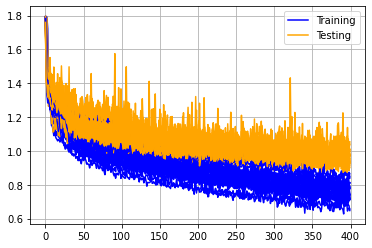

In [31]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [32]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  0.9684691286087036
mean accuracy:  0.5878972220420837


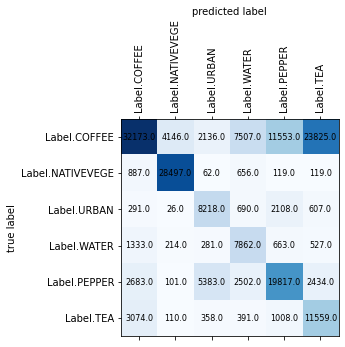

In [33]:
plot_confusion_matrix(conf_matrix, labels)

In [34]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.79555402 0.86109265 0.49993917 0.40095879 0.56189747 0.29584602]
Recalls:  [0.39553725 0.93925511 0.68827471 0.72261029 0.60197448 0.70054545]
F-Score:  [0.52837471 0.89847716 0.57918106 0.5157439  0.58124597 0.41600835]


# SWIR1, SWIR2, BLUE

In [35]:
BANDS = [
    Band.SWIR1.value,
    Band.SWIR2.value,
    Band.BLUE.value
]

In [36]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_5 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2307 - accuracy: 0.4173 - val_loss: 1.2157 - val_accuracy: 0.4236
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1707 - accuracy: 0.4344 - val_loss: 1.2276 - val_accuracy: 0.4157
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1670 - accuracy: 0.4073 - val_loss: 1.2659 - val_accuracy: 0.3927
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1428 - accuracy: 0.4284 - val_loss: 1.2655 - val_accuracy: 0.3859
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1650 - accuracy: 0.4199 - val_loss: 1.2142 - val_accuracy: 0.4304
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1734 - accuracy: 0.4425 - val_loss: 1.1897 - val_accuracy: 0.4323
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1251 - accuracy: 0.4414 - val_loss: 1.1998 - val_accuracy: 0.4301
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8767 - accuracy: 0.5370 - val_loss: 1.0302 - val_accuracy: 0.5580
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9257 - accuracy: 0.5243 - val_loss: 1.0775 - val_accuracy: 0.5237
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8846 - accuracy: 0.5065 - val_loss: 1.0283 - val_accuracy: 0.5377
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9749 - accuracy: 0.5411 - val_loss: 1.1317 - val_accuracy: 0.4980
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9542 - accuracy: 0.5395 - val_loss: 1.2304 - val_accuracy: 0.4777
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9299 - accuracy: 0.5195 - val_loss: 1.0355 - val_accuracy: 0.5377
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8914 - accuracy: 0.5273 - val_loss: 1.0161 - val_accuracy: 0.5574
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8336 - accuracy: 0.5479 - val_loss: 0.9819 - val_accuracy: 0.5546
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8261 - accuracy: 0.5624 - val_loss: 0.9826 - val_accuracy: 0.5635
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8262 - accuracy: 0.5423 - val_loss: 1.0346 - val_accuracy: 0.5515
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8562 - accuracy: 0.5612 - val_loss: 0.9927 - val_accuracy: 0.5682
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8657 - accuracy: 0.5513 - val_loss: 1.0066 - val_accuracy: 0.5579
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8037 - accuracy: 0.5712 - val_loss: 1.0506 - val_accuracy: 0.5521
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8383 - accuracy: 0.5634 - val_loss: 0.9983 - val_accuracy: 0.5458
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8302 - accuracy: 0.5244 - val_loss: 1.0331 - val_accuracy: 0.5587
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7647 - accuracy: 0.5729 - val_loss: 0.9784 - val_accuracy: 0.5661
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7803 - accuracy: 0.5779 - val_loss: 1.0218 - val_accuracy: 0.5816
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7988 - accuracy: 0.5687 - val_loss: 0.9907 - val_accuracy: 0.5692
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8083 - accuracy: 0.5695 - val_loss: 0.9963 - val_accuracy: 0.5488
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7994 - accuracy: 0.5684 - val_loss: 1.0094 - val_accuracy: 0.5555
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7488 - accuracy: 0.5786 - val_loss: 0.9625 - val_accuracy: 0.5837
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9214 - accuracy: 0.5179 - val_loss: 1.0822 - val_accuracy: 0.5035
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8976 - accuracy: 0.5017 - val_loss: 1.0803 - val_accuracy: 0.4899
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9711 - accuracy: 0.5186 - val_loss: 1.0285 - val_accuracy: 0.5452
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9094 - accuracy: 0.5567 - val_loss: 1.0890 - val_accuracy: 0.5286
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0021 - accuracy: 0.5249 - val_loss: 1.0823 - val_accuracy: 0.5256
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9571 - accuracy: 0.5362 - val_loss: 1.0729 - val_accuracy: 0.5418
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9850 - accuracy: 0.5111 - val_loss: 1.0715 - val_accuracy: 0.5289
E

57/57 [==============================] - 0s 8ms/step - loss: 0.8495 - accuracy: 0.5674 - val_loss: 1.0714 - val_accuracy: 0.5234
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7980 - accuracy: 0.5728 - val_loss: 1.0183 - val_accuracy: 0.5417
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8145 - accuracy: 0.5833 - val_loss: 1.0411 - val_accuracy: 0.5349
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8495 - accuracy: 0.5563 - val_loss: 1.0361 - val_accuracy: 0.5563
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8913 - accuracy: 0.5379 - val_loss: 1.0139 - val_accuracy: 0.5374
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8962 - accuracy: 0.5686 - val_loss: 1.0295 - val_accuracy: 0.5316
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8246 - accuracy: 0.5888 - val_loss: 1.0375 - val_accuracy: 0.5271
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8043 - accuracy: 0.5719 - val_loss: 1.0027 - val_accuracy: 0.5429
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8773 - accuracy: 0.5707 - val_loss: 1.0776 - val_accuracy: 0.5264
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8148 - accuracy: 0.5901 - val_loss: 1.0291 - val_accuracy: 0.5554
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8415 - accuracy: 0.5615 - val_loss: 1.0230 - val_accuracy: 0.5343
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7801 - accuracy: 0.5593 - val_loss: 1.0417 - val_accuracy: 0.5408
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8275 - accuracy: 0.5752 - val_loss: 1.0671 - val_accuracy: 0.5421
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8576 - accuracy: 0.5883 - val_loss: 1.0156 - val_accuracy: 0.5559
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1723 - accuracy: 0.3639 - val_loss: 1.2452 - val_accuracy: 0.3841
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1698 - accuracy: 0.3570 - val_loss: 1.2366 - val_accuracy: 0.3813
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1585 - accuracy: 0.3656 - val_loss: 1.2187 - val_accuracy: 0.3950
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1326 - accuracy: 0.3843 - val_loss: 1.2788 - val_accuracy: 0.3685
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1487 - accuracy: 0.3609 - val_loss: 1.2682 - val_accuracy: 0.3647
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1756 - accuracy: 0.3563 - val_loss: 1.2724 - val_accuracy: 0.3878
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1777 - accuracy: 0.3752 - val_loss: 1.2532 - val_accuracy: 0.3794
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0152 - accuracy: 0.4860 - val_loss: 1.1082 - val_accuracy: 0.4876
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9828 - accuracy: 0.4785 - val_loss: 1.1194 - val_accuracy: 0.4922
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9209 - accuracy: 0.4975 - val_loss: 1.0857 - val_accuracy: 0.5006
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9779 - accuracy: 0.5031 - val_loss: 1.1038 - val_accuracy: 0.4707
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9721 - accuracy: 0.4510 - val_loss: 1.0439 - val_accuracy: 0.5251
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9656 - accuracy: 0.5118 - val_loss: 1.0779 - val_accuracy: 0.5017
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9823 - accuracy: 0.4984 - val_loss: 1.0569 - val_accuracy: 0.5220
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8839 - accuracy: 0.5400 - val_loss: 0.9740 - val_accuracy: 0.5523
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8891 - accuracy: 0.5102 - val_loss: 1.0199 - val_accuracy: 0.5255
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8473 - accuracy: 0.5484 - val_loss: 0.9916 - val_accuracy: 0.5427
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8771 - accuracy: 0.5324 - val_loss: 0.9899 - val_accuracy: 0.5547
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8883 - accuracy: 0.5142 - val_loss: 0.9949 - val_accuracy: 0.5678
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8081 - accuracy: 0.5675 - val_loss: 1.0289 - val_accuracy: 0.5389
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9070 - accuracy: 0.5365 - val_loss: 0.9901 - val_accuracy: 0.5576
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7799 - accuracy: 0.5851 - val_loss: 0.9109 - val_accuracy: 0.6045
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7554 - accuracy: 0.5804 - val_loss: 0.9898 - val_accuracy: 0.5517
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8282 - accuracy: 0.5457 - val_loss: 0.9667 - val_accuracy: 0.5922
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8507 - accuracy: 0.5601 - val_loss: 0.9915 - val_accuracy: 0.5404
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7593 - accuracy: 0.5823 - val_loss: 1.0382 - val_accuracy: 0.5539
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7553 - accuracy: 0.5586 - val_loss: 0.9668 - val_accuracy: 0.5595
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7535 - accuracy: 0.5785 - val_loss: 0.9913 - val_accuracy: 0.5799
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0901 - accuracy: 0.4130 - val_loss: 1.2709 - val_accuracy: 0.3900
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1007 - accuracy: 0.4355 - val_loss: 1.3187 - val_accuracy: 0.3712
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1364 - accuracy: 0.3927 - val_loss: 1.2250 - val_accuracy: 0.4514
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0451 - accuracy: 0.4550 - val_loss: 1.1796 - val_accuracy: 0.4645
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0314 - accuracy: 0.4561 - val_loss: 1.2945 - val_accuracy: 0.4483
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1200 - accuracy: 0.4356 - val_loss: 1.2076 - val_accuracy: 0.4715
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0349 - accuracy: 0.4816 - val_loss: 1.1502 - val_accuracy: 0.5046
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0303 - accuracy: 0.4952 - val_loss: 1.0709 - val_accuracy: 0.5202
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9645 - accuracy: 0.5065 - val_loss: 1.0864 - val_accuracy: 0.5084
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9247 - accuracy: 0.5277 - val_loss: 1.0414 - val_accuracy: 0.5373
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9730 - accuracy: 0.5373 - val_loss: 1.0198 - val_accuracy: 0.5610
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9223 - accuracy: 0.5433 - val_loss: 1.0706 - val_accuracy: 0.5498
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9258 - accuracy: 0.5290 - val_loss: 1.0932 - val_accuracy: 0.5249
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0103 - accuracy: 0.5341 - val_loss: 1.0773 - val_accuracy: 0.5226
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8672 - accuracy: 0.5497 - val_loss: 0.9826 - val_accuracy: 0.5668
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8288 - accuracy: 0.5579 - val_loss: 1.0039 - val_accuracy: 0.5758
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8695 - accuracy: 0.5661 - val_loss: 1.0420 - val_accuracy: 0.5709
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8519 - accuracy: 0.5801 - val_loss: 1.1516 - val_accuracy: 0.4789
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8583 - accuracy: 0.5474 - val_loss: 0.9853 - val_accuracy: 0.5562
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8425 - accuracy: 0.5500 - val_loss: 0.9978 - val_accuracy: 0.5741
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8415 - accuracy: 0.5756 - val_loss: 0.9653 - val_accuracy: 0.5814
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7974 - accuracy: 0.5588 - val_loss: 0.9738 - val_accuracy: 0.5766
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7624 - accuracy: 0.5669 - val_loss: 0.9402 - val_accuracy: 0.5924
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7757 - accuracy: 0.5844 - val_loss: 0.9431 - val_accuracy: 0.5970
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7552 - accuracy: 0.6130 - val_loss: 0.9754 - val_accuracy: 0.5887
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7919 - accuracy: 0.5883 - val_loss: 1.0244 - val_accuracy: 0.5490
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7977 - accuracy: 0.5658 - val_loss: 0.9400 - val_accuracy: 0.5937
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7513 - accuracy: 0.5952 - val_loss: 0.9639 - val_accuracy: 0.5792
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1419 - accuracy: 0.4169 - val_loss: 1.2724 - val_accuracy: 0.4170
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0560 - accuracy: 0.4155 - val_loss: 1.3877 - val_accuracy: 0.3602
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0766 - accuracy: 0.4424 - val_loss: 1.1246 - val_accuracy: 0.5046
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0750 - accuracy: 0.4433 - val_loss: 1.2153 - val_accuracy: 0.4350
Epoch 29/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0333 - accuracy: 0.4083 - val_loss: 1.1230 - val_accuracy: 0.4611
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1145 - accuracy: 0.4366 - val_loss: 1.0903 - val_accuracy: 0.5100
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0416 - accuracy: 0.4799 - val_loss: 1.1398 - val_accuracy: 0.4632
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0083 - accuracy: 0.4963 - val_loss: 1.1160 - val_accuracy: 0.5003
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9378 - accuracy: 0.4945 - val_loss: 1.0811 - val_accuracy: 0.4782
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0064 - accuracy: 0.4686 - val_loss: 1.0348 - val_accuracy: 0.5225
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9146 - accuracy: 0.5127 - val_loss: 1.0703 - val_accuracy: 0.4920
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9250 - accuracy: 0.4997 - val_loss: 1.0189 - val_accuracy: 0.5126
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9314 - accuracy: 0.5225 - val_loss: 1.0512 - val_accuracy: 0.4971
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9066 - accuracy: 0.4863 - val_loss: 1.0569 - val_accuracy: 0.5058
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8412 - accuracy: 0.5396 - val_loss: 0.9891 - val_accuracy: 0.5388
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8184 - accuracy: 0.5458 - val_loss: 1.0052 - val_accuracy: 0.5804
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8059 - accuracy: 0.5466 - val_loss: 1.0108 - val_accuracy: 0.5657
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8035 - accuracy: 0.5841 - val_loss: 1.0440 - val_accuracy: 0.5372
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8376 - accuracy: 0.5554 - val_loss: 1.0447 - val_accuracy: 0.5021
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8145 - accuracy: 0.5565 - val_loss: 1.0040 - val_accuracy: 0.5364
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8022 - accuracy: 0.5261 - val_loss: 0.9913 - val_accuracy: 0.5179
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7102 - accuracy: 0.6388 - val_loss: 0.8568 - val_accuracy: 0.6538
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7458 - accuracy: 0.6329 - val_loss: 0.8955 - val_accuracy: 0.6195
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7444 - accuracy: 0.5983 - val_loss: 0.9045 - val_accuracy: 0.6485
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7209 - accuracy: 0.6201 - val_loss: 0.9620 - val_accuracy: 0.5823
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7633 - accuracy: 0.5777 - val_loss: 0.8828 - val_accuracy: 0.6447
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7379 - accuracy: 0.6284 - val_loss: 0.8968 - val_accuracy: 0.6349
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7172 - accuracy: 0.6170 - val_loss: 0.8995 - val_accuracy: 0.6087
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0877 - accuracy: 0.4240 - val_loss: 1.1773 - val_accuracy: 0.4269
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1119 - accuracy: 0.3952 - val_loss: 1.3512 - val_accuracy: 0.3636
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0827 - accuracy: 0.4294 - val_loss: 1.1045 - val_accuracy: 0.4776
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0988 - accuracy: 0.4297 - val_loss: 1.1132 - val_accuracy: 0.4618
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0669 - accuracy: 0.4327 - val_loss: 1.1203 - val_accuracy: 0.4800
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1082 - accuracy: 0.4557 - val_loss: 1.0926 - val_accuracy: 0.5196
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1030 - accuracy: 0.4898 - val_loss: 1.1440 - val_accuracy: 0.4655
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0164 - accuracy: 0.4828 - val_loss: 1.0655 - val_accuracy: 0.5022
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9826 - accuracy: 0.4863 - val_loss: 1.0529 - val_accuracy: 0.5325
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9258 - accuracy: 0.5030 - val_loss: 1.0191 - val_accuracy: 0.5145
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9602 - accuracy: 0.4985 - val_loss: 1.0517 - val_accuracy: 0.5245
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9340 - accuracy: 0.5043 - val_loss: 1.0754 - val_accuracy: 0.5232
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9582 - accuracy: 0.4958 - val_loss: 1.0266 - val_accuracy: 0.5103
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9404 - accuracy: 0.4721 - val_loss: 1.1685 - val_accuracy: 0.4887
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8329 - accuracy: 0.5321 - val_loss: 0.9633 - val_accuracy: 0.5614
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8115 - accuracy: 0.5522 - val_loss: 1.0215 - val_accuracy: 0.5538
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8083 - accuracy: 0.5432 - val_loss: 1.0642 - val_accuracy: 0.5237
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8503 - accuracy: 0.5197 - val_loss: 1.0184 - val_accuracy: 0.5392
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8234 - accuracy: 0.5297 - val_loss: 1.0073 - val_accuracy: 0.5411
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8175 - accuracy: 0.5553 - val_loss: 1.0005 - val_accuracy: 0.5661
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9087 - accuracy: 0.5439 - val_loss: 0.9880 - val_accuracy: 0.5426
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7552 - accuracy: 0.5929 - val_loss: 1.0192 - val_accuracy: 0.5295
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7873 - accuracy: 0.5617 - val_loss: 1.0512 - val_accuracy: 0.5582
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8422 - accuracy: 0.5511 - val_loss: 0.9817 - val_accuracy: 0.5628
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7655 - accuracy: 0.5650 - val_loss: 0.9728 - val_accuracy: 0.5623
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8661 - accuracy: 0.5685 - val_loss: 0.9354 - val_accuracy: 0.5935
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7507 - accuracy: 0.5809 - val_loss: 0.9389 - val_accuracy: 0.5912
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7698 - accuracy: 0.6019 - val_loss: 0.9890 - val_accuracy: 0.5442
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2741 - accuracy: 0.4335 - val_loss: 1.3232 - val_accuracy: 0.5221
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2690 - accuracy: 0.4714 - val_loss: 1.3201 - val_accuracy: 0.4381
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2358 - accuracy: 0.4163 - val_loss: 1.2832 - val_accuracy: 0.4582
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2062 - accuracy: 0.4745 - val_loss: 1.3427 - val_accuracy: 0.4097
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1891 - accuracy: 0.4493 - val_loss: 1.2299 - val_accuracy: 0.4587
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1931 - accuracy: 0.4457 - val_loss: 1.2672 - val_accuracy: 0.4314
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1985 - accuracy: 0.4276 - val_loss: 1.3510 - val_accuracy: 0.3545
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0108 - accuracy: 0.5068 - val_loss: 1.0522 - val_accuracy: 0.5007
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9409 - accuracy: 0.5308 - val_loss: 1.0569 - val_accuracy: 0.5086
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9070 - accuracy: 0.5193 - val_loss: 1.1052 - val_accuracy: 0.5033
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8804 - accuracy: 0.5388 - val_loss: 1.1093 - val_accuracy: 0.5118
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9238 - accuracy: 0.4913 - val_loss: 1.1400 - val_accuracy: 0.4733
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8914 - accuracy: 0.5786 - val_loss: 1.0859 - val_accuracy: 0.4984
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9457 - accuracy: 0.5118 - val_loss: 1.1249 - val_accuracy: 0.4551
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7420 - accuracy: 0.6096 - val_loss: 0.9908 - val_accuracy: 0.5854
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7452 - accuracy: 0.6089 - val_loss: 1.0631 - val_accuracy: 0.5313
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8497 - accuracy: 0.5657 - val_loss: 0.9957 - val_accuracy: 0.5871
Epoch 190/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8179 - accuracy: 0.5791 - val_loss: 0.9713 - val_accuracy: 0.5864
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8047 - accuracy: 0.5967 - val_loss: 1.1243 - val_accuracy: 0.5124
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8225 - accuracy: 0.5696 - val_loss: 1.0136 - val_accuracy: 0.5471
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8883 - accuracy: 0.5629 - val_loss: 0.9559 - val_accuracy: 0.6016
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7213 - accuracy: 0.6390 - val_loss: 0.9547 - val_accuracy: 0.6032
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7131 - accuracy: 0.6215 - val_loss: 1.0116 - val_accuracy: 0.5911
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7481 - accuracy: 0.6225 - val_loss: 0.9883 - val_accuracy: 0.5936
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6871 - accuracy: 0.6379 - val_loss: 0.9624 - val_accuracy: 0.6039
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7197 - accuracy: 0.6705 - val_loss: 0.9732 - val_accuracy: 0.5990
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7965 - accuracy: 0.6231 - val_loss: 0.9232 - val_accuracy: 0.6330
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7067 - accuracy: 0.6429 - val_loss: 0.9949 - val_accuracy: 0.6156
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2914 - accuracy: 0.3299 - val_loss: 1.3294 - val_accuracy: 0.3338
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2580 - accuracy: 0.3649 - val_loss: 1.3607 - val_accuracy: 0.3550
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2544 - accuracy: 0.3572 - val_loss: 1.2976 - val_accuracy: 0.3353
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2700 - accuracy: 0.3821 - val_loss: 1.3135 - val_accuracy: 0.3443
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3342 - accuracy: 0.3296 - val_loss: 1.3050 - val_accuracy: 0.3539
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3666 - accuracy: 0.3314 - val_loss: 1.2828 - val_accuracy: 0.3911
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3081 - accuracy: 0.3608 - val_loss: 1.2677 - val_accuracy: 0.3811
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0277 - accuracy: 0.4736 - val_loss: 1.0663 - val_accuracy: 0.4895
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9751 - accuracy: 0.5295 - val_loss: 1.1519 - val_accuracy: 0.4761
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9777 - accuracy: 0.4655 - val_loss: 1.1179 - val_accuracy: 0.4843
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9903 - accuracy: 0.4679 - val_loss: 1.0840 - val_accuracy: 0.4907
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9347 - accuracy: 0.4909 - val_loss: 1.2339 - val_accuracy: 0.4479
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9836 - accuracy: 0.4680 - val_loss: 1.0824 - val_accuracy: 0.4949
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9383 - accuracy: 0.4803 - val_loss: 1.0724 - val_accuracy: 0.5249
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8494 - accuracy: 0.5554 - val_loss: 1.0768 - val_accuracy: 0.5290
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9100 - accuracy: 0.5212 - val_loss: 0.9732 - val_accuracy: 0.5584
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8799 - accuracy: 0.5174 - val_loss: 1.0356 - val_accuracy: 0.5656
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9231 - accuracy: 0.5169 - val_loss: 0.9717 - val_accuracy: 0.5634
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8821 - accuracy: 0.5307 - val_loss: 0.9838 - val_accuracy: 0.5557
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8889 - accuracy: 0.5340 - val_loss: 1.0221 - val_accuracy: 0.5562
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9204 - accuracy: 0.5284 - val_loss: 1.0538 - val_accuracy: 0.5162
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7857 - accuracy: 0.5617 - val_loss: 0.9726 - val_accuracy: 0.5682
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7907 - accuracy: 0.5632 - val_loss: 1.0033 - val_accuracy: 0.5487
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7758 - accuracy: 0.5461 - val_loss: 0.9820 - val_accuracy: 0.5502
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7721 - accuracy: 0.5896 - val_loss: 0.9802 - val_accuracy: 0.5653
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7783 - accuracy: 0.5322 - val_loss: 0.9622 - val_accuracy: 0.5634
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7872 - accuracy: 0.5554 - val_loss: 0.9410 - val_accuracy: 0.5958
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8330 - accuracy: 0.5896 - val_loss: 0.9313 - val_accuracy: 0.5896
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7692 - accuracy: 0.1458 - val_loss: 1.7924 - val_accuracy: 0.1680
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8079 - accuracy: 0.1503 - val_loss: 1.7921 - val_accuracy: 0.0591
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7678 - accuracy: 0.1452 - val_loss: 1.7913 - val_accuracy: 0.0591
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8173 - accuracy: 0.1027 - val_loss: 1.7915 - val_accuracy: 0.0591
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8232 - accuracy: 0.1124 - val_loss: 1.7921 - val_accuracy: 0.0591
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8142 - accuracy: 0.1198 - val_loss: 1.7914 - val_accuracy: 0.1680
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7495 - accuracy: 0.1387 - val_loss: 1.7914 - val_accuracy: 0.0591
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8064 - accuracy: 0.1205 - val_loss: 1.7916 - val_accuracy: 0.1680
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8050 - accuracy: 0.1327 - val_loss: 1.7925 - val_accuracy: 0.1680
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7563 - accuracy: 0.1513 - val_loss: 1.7893 - val_accuracy: 0.1811
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8059 - accuracy: 0.1149 - val_loss: 1.7919 - val_accuracy: 0.0591
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8048 - accuracy: 0.1161 - val_loss: 1.7914 - val_accuracy: 0.1811
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7874 - accuracy: 0.1201 - val_loss: 1.7920 - val_accuracy: 0.1680
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7619 - accuracy: 0.0895 - val_loss: 1.7919 - val_accuracy: 0.0871
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.8244 - accuracy: 0.1103 - val_loss: 1.7929 - val_accuracy: 0.0591
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7827 - accuracy: 0.0784 - val_loss: 1.7918 - val_accuracy: 0.1811
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7849 - accuracy: 0.0911 - val_loss: 1.7907 - val_accuracy: 0.4408
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7940 - accuracy: 0.1976 - val_loss: 1.7919 - val_accuracy: 0.0639
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7846 - accuracy: 0.1883 - val_loss: 1.7910 - val_accuracy: 0.1680
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7960 - accuracy: 0.1217 - val_loss: 1.7918 - val_accuracy: 0.0871
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7745 - accuracy: 0.1385 - val_loss: 1.7906 - val_accuracy: 0.4408
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8245 - accuracy: 0.1446 - val_loss: 1.7923 - val_accuracy: 0.0871
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7550 - accuracy: 0.2097 - val_loss: 1.7908 - val_accuracy: 0.1811
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7998 - accuracy: 0.1882 - val_loss: 1.7911 - val_accuracy: 0.1680
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8230 - accuracy: 0.1524 - val_loss: 1.7909 - val_accuracy: 0.4408
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8360 - accuracy: 0.1980 - val_loss: 1.7919 - val_accuracy: 0.0871
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8190 - accuracy: 0.0871 - val_loss: 1.7918 - val_accuracy: 0.1680
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8075 - accuracy: 0.1695 - val_loss: 1.7916 - val_accuracy: 0.1680
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7757 - accuracy: 0.2006 - val_loss: 1.7693 - val_accuracy: 0.0822
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6895 - accuracy: 0.2011 - val_loss: 1.6062 - val_accuracy: 0.2006
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4837 - accuracy: 0.3106 - val_loss: 1.4084 - val_accuracy: 0.4423
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3707 - accuracy: 0.3980 - val_loss: 1.3756 - val_accuracy: 0.4475
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3952 - accuracy: 0.3602 - val_loss: 1.4081 - val_accuracy: 0.3357
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3732 - accuracy: 0.3556 - val_loss: 1.4190 - val_accuracy: 0.3768
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3890 - accuracy: 0.3920 - val_loss: 1.3787 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8778 - accuracy: 0.5406 - val_loss: 1.1034 - val_accuracy: 0.4995
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8670 - accuracy: 0.5317 - val_loss: 1.0772 - val_accuracy: 0.5321
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8435 - accuracy: 0.5867 - val_loss: 1.0584 - val_accuracy: 0.5614
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8922 - accuracy: 0.5527 - val_loss: 1.0817 - val_accuracy: 0.5304
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9094 - accuracy: 0.5514 - val_loss: 1.0828 - val_accuracy: 0.5037
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8526 - accuracy: 0.5194 - val_loss: 1.0608 - val_accuracy: 0.5501
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8705 - accuracy: 0.5505 - val_loss: 1.0577 - val_accuracy: 0.5674

57/57 [==============================] - 0s 8ms/step - loss: 0.8687 - accuracy: 0.5310 - val_loss: 1.0741 - val_accuracy: 0.5345
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7830 - accuracy: 0.5357 - val_loss: 1.0107 - val_accuracy: 0.5612
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7656 - accuracy: 0.5838 - val_loss: 1.0860 - val_accuracy: 0.5215
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8083 - accuracy: 0.5367 - val_loss: 1.1142 - val_accuracy: 0.5317
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8086 - accuracy: 0.5790 - val_loss: 1.0388 - val_accuracy: 0.5616
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8051 - accuracy: 0.5555 - val_loss: 1.0422 - val_accuracy: 0.5384
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7734 - accuracy: 0.5638 - val_loss: 1.0590 - val_accuracy: 0.5599
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7617 - accuracy: 0.5859 - val_loss: 0.9778 - val_accuracy: 0.5824
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7426 - accuracy: 0.5976 - val_loss: 0.9634 - val_accuracy: 0.5758
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8184 - accuracy: 0.5820 - val_loss: 1.0283 - val_accuracy: 0.5765
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7268 - accuracy: 0.6150 - val_loss: 0.9768 - val_accuracy: 0.5741
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7226 - accuracy: 0.6003 - val_loss: 1.1063 - val_accuracy: 0.5297
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8211 - accuracy: 0.5356 - val_loss: 1.0215 - val_accuracy: 0.5743
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7464 - accuracy: 0.6042 - val_loss: 0.9919 - val_accuracy: 0.5660
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8273 - accuracy: 0.0708 - val_loss: 1.7890 - val_accuracy: 0.0685
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6900 - accuracy: 0.1551 - val_loss: 1.6710 - val_accuracy: 0.2229
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4998 - accuracy: 0.3115 - val_loss: 1.5333 - val_accuracy: 0.3204
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3965 - accuracy: 0.3638 - val_loss: 1.4399 - val_accuracy: 0.3059
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3225 - accuracy: 0.3469 - val_loss: 1.4135 - val_accuracy: 0.2955
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3331 - accuracy: 0.3406 - val_loss: 1.3143 - val_accuracy: 0.3902
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3242 - accuracy: 0.3948 - val_loss: 1.4075 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9926 - accuracy: 0.5114 - val_loss: 1.0758 - val_accuracy: 0.5079
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9556 - accuracy: 0.4877 - val_loss: 1.0567 - val_accuracy: 0.5296
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0686 - accuracy: 0.4773 - val_loss: 1.0489 - val_accuracy: 0.5075
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9182 - accuracy: 0.5144 - val_loss: 1.0508 - val_accuracy: 0.5247
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9905 - accuracy: 0.5027 - val_loss: 1.0337 - val_accuracy: 0.5242
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9035 - accuracy: 0.5241 - val_loss: 1.1058 - val_accuracy: 0.4950
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9400 - accuracy: 0.4896 - val_loss: 1.1548 - val_accuracy: 0.4830

57/57 [==============================] - 0s 8ms/step - loss: 0.7992 - accuracy: 0.5617 - val_loss: 1.0619 - val_accuracy: 0.5292
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8693 - accuracy: 0.5647 - val_loss: 1.0246 - val_accuracy: 0.5548
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8211 - accuracy: 0.5501 - val_loss: 1.0496 - val_accuracy: 0.5223
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8596 - accuracy: 0.5233 - val_loss: 1.0403 - val_accuracy: 0.5303
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8121 - accuracy: 0.5308 - val_loss: 1.0583 - val_accuracy: 0.5458
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8005 - accuracy: 0.5628 - val_loss: 1.0757 - val_accuracy: 0.5457
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7977 - accuracy: 0.5619 - val_loss: 0.9683 - val_accuracy: 0.5749
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7757 - accuracy: 0.5845 - val_loss: 1.0355 - val_accuracy: 0.5608
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8501 - accuracy: 0.5449 - val_loss: 1.0131 - val_accuracy: 0.5523
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7759 - accuracy: 0.5767 - val_loss: 0.9792 - val_accuracy: 0.5661
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7955 - accuracy: 0.5760 - val_loss: 1.0408 - val_accuracy: 0.5536
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7851 - accuracy: 0.5975 - val_loss: 0.9755 - val_accuracy: 0.5962
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8298 - accuracy: 0.5916 - val_loss: 0.9571 - val_accuracy: 0.5824
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7617 - accuracy: 0.5760 - val_loss: 1.0087 - val_accuracy: 0.5678
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7977 - accuracy: 0.1431 - val_loss: 1.7912 - val_accuracy: 0.0878
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7741 - accuracy: 0.1207 - val_loss: 1.7813 - val_accuracy: 0.1660
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7272 - accuracy: 0.2229 - val_loss: 1.5909 - val_accuracy: 0.3003
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5933 - accuracy: 0.2541 - val_loss: 1.4468 - val_accuracy: 0.4244
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4742 - accuracy: 0.3734 - val_loss: 1.4122 - val_accuracy: 0.3926
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3759 - accuracy: 0.3576 - val_loss: 1.4234 - val_accuracy: 0.3408
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4203 - accuracy: 0.3274 - val_loss: 1.4157 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9335 - accuracy: 0.5163 - val_loss: 1.0171 - val_accuracy: 0.5419
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8853 - accuracy: 0.5553 - val_loss: 1.2669 - val_accuracy: 0.4112
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9531 - accuracy: 0.4755 - val_loss: 1.0649 - val_accuracy: 0.5287
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9178 - accuracy: 0.4977 - val_loss: 1.1245 - val_accuracy: 0.4685
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9650 - accuracy: 0.4630 - val_loss: 1.0893 - val_accuracy: 0.4872
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9336 - accuracy: 0.4960 - val_loss: 1.0505 - val_accuracy: 0.5196
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8936 - accuracy: 0.5034 - val_loss: 1.0751 - val_accuracy: 0.5048

57/57 [==============================] - 0s 8ms/step - loss: 0.9231 - accuracy: 0.4906 - val_loss: 1.1223 - val_accuracy: 0.5093
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8359 - accuracy: 0.5173 - val_loss: 1.0204 - val_accuracy: 0.5302
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8692 - accuracy: 0.5646 - val_loss: 1.0385 - val_accuracy: 0.5150
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9050 - accuracy: 0.4916 - val_loss: 1.0525 - val_accuracy: 0.5251
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8874 - accuracy: 0.5245 - val_loss: 1.0212 - val_accuracy: 0.5520
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8169 - accuracy: 0.5632 - val_loss: 1.0479 - val_accuracy: 0.5429
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7938 - accuracy: 0.5539 - val_loss: 1.0356 - val_accuracy: 0.5328
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8031 - accuracy: 0.5431 - val_loss: 1.0214 - val_accuracy: 0.5524
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8660 - accuracy: 0.5656 - val_loss: 1.0061 - val_accuracy: 0.5646
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7730 - accuracy: 0.5623 - val_loss: 1.1351 - val_accuracy: 0.5461
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8304 - accuracy: 0.5857 - val_loss: 1.0851 - val_accuracy: 0.5324
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8174 - accuracy: 0.5584 - val_loss: 1.0456 - val_accuracy: 0.5307
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7903 - accuracy: 0.5643 - val_loss: 1.0306 - val_accuracy: 0.5567
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8308 - accuracy: 0.5609 - val_loss: 1.0461 - val_accuracy: 0.5347
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7934 - accuracy: 0.1175 - val_loss: 1.7835 - val_accuracy: 0.1259
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7228 - accuracy: 0.2008 - val_loss: 1.6197 - val_accuracy: 0.2438
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4895 - accuracy: 0.2642 - val_loss: 1.4345 - val_accuracy: 0.3766
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3489 - accuracy: 0.3587 - val_loss: 1.4388 - val_accuracy: 0.2857
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3625 - accuracy: 0.3358 - val_loss: 1.3711 - val_accuracy: 0.3824
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2893 - accuracy: 0.3673 - val_loss: 1.3953 - val_accuracy: 0.3057
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4020 - accuracy: 0.3168 - val_loss: 1.3905 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8622 - accuracy: 0.5637 - val_loss: 1.0786 - val_accuracy: 0.5184
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8406 - accuracy: 0.5572 - val_loss: 1.0665 - val_accuracy: 0.5277
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8308 - accuracy: 0.5506 - val_loss: 0.9993 - val_accuracy: 0.5468
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8409 - accuracy: 0.5470 - val_loss: 1.0974 - val_accuracy: 0.5192
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9062 - accuracy: 0.4929 - val_loss: 1.0554 - val_accuracy: 0.5130
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8726 - accuracy: 0.5201 - val_loss: 0.9921 - val_accuracy: 0.5331
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8658 - accuracy: 0.5362 - val_loss: 1.0554 - val_accuracy: 0.5319

57/57 [==============================] - 0s 8ms/step - loss: 0.7378 - accuracy: 0.5954 - val_loss: 1.0357 - val_accuracy: 0.5135
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7377 - accuracy: 0.5703 - val_loss: 1.0100 - val_accuracy: 0.5384
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7556 - accuracy: 0.5649 - val_loss: 1.0207 - val_accuracy: 0.5578
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8856 - accuracy: 0.5701 - val_loss: 0.9639 - val_accuracy: 0.5767
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7690 - accuracy: 0.5844 - val_loss: 1.0352 - val_accuracy: 0.5548
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7316 - accuracy: 0.5686 - val_loss: 0.9674 - val_accuracy: 0.5667
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8040 - accuracy: 0.5720 - val_loss: 0.9354 - val_accuracy: 0.5713
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7496 - accuracy: 0.6042 - val_loss: 1.3111 - val_accuracy: 0.4873
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7815 - accuracy: 0.5839 - val_loss: 0.9951 - val_accuracy: 0.5861
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6996 - accuracy: 0.6158 - val_loss: 0.8949 - val_accuracy: 0.6316
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7364 - accuracy: 0.6351 - val_loss: 0.9682 - val_accuracy: 0.5707
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7060 - accuracy: 0.6191 - val_loss: 0.9378 - val_accuracy: 0.5886
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6944 - accuracy: 0.5994 - val_loss: 0.9320 - val_accuracy: 0.6020
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7222 - accuracy: 0.6161 - val_loss: 0.9528 - val_accuracy: 0.5857
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8229 - accuracy: 0.0971 - val_loss: 1.7920 - val_accuracy: 0.0893
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8215 - accuracy: 0.1135 - val_loss: 1.6901 - val_accuracy: 0.3211
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5932 - accuracy: 0.2898 - val_loss: 1.4632 - val_accuracy: 0.3382
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3936 - accuracy: 0.3643 - val_loss: 1.4280 - val_accuracy: 0.3423
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4080 - accuracy: 0.3622 - val_loss: 1.4128 - val_accuracy: 0.3081
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3367 - accuracy: 0.3368 - val_loss: 1.4570 - val_accuracy: 0.3155
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3824 - accuracy: 0.3390 - val_loss: 1.3930 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9560 - accuracy: 0.5310 - val_loss: 1.0575 - val_accuracy: 0.5461
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9668 - accuracy: 0.5291 - val_loss: 1.0977 - val_accuracy: 0.5482
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9472 - accuracy: 0.5095 - val_loss: 1.0589 - val_accuracy: 0.5441
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9746 - accuracy: 0.5150 - val_loss: 1.0456 - val_accuracy: 0.5321
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9656 - accuracy: 0.5050 - val_loss: 1.1474 - val_accuracy: 0.4884
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9596 - accuracy: 0.5209 - val_loss: 1.0809 - val_accuracy: 0.5122
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9669 - accuracy: 0.5195 - val_loss: 1.0286 - val_accuracy: 0.5376

57/57 [==============================] - 0s 8ms/step - loss: 0.8443 - accuracy: 0.5607 - val_loss: 0.9827 - val_accuracy: 0.5778
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8733 - accuracy: 0.5648 - val_loss: 1.0119 - val_accuracy: 0.5630
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8654 - accuracy: 0.5491 - val_loss: 0.9331 - val_accuracy: 0.5917
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8238 - accuracy: 0.5533 - val_loss: 0.9480 - val_accuracy: 0.5784
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9062 - accuracy: 0.5518 - val_loss: 0.9894 - val_accuracy: 0.5925
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8600 - accuracy: 0.5692 - val_loss: 0.9484 - val_accuracy: 0.5786
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8631 - accuracy: 0.5609 - val_loss: 1.0141 - val_accuracy: 0.5536
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7739 - accuracy: 0.6108 - val_loss: 0.9821 - val_accuracy: 0.5838
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8207 - accuracy: 0.5632 - val_loss: 0.9600 - val_accuracy: 0.5709
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7453 - accuracy: 0.6106 - val_loss: 0.9060 - val_accuracy: 0.6137
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7978 - accuracy: 0.5813 - val_loss: 0.9679 - val_accuracy: 0.5954
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7674 - accuracy: 0.5968 - val_loss: 0.9593 - val_accuracy: 0.6050
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7822 - accuracy: 0.5833 - val_loss: 1.0978 - val_accuracy: 0.5267
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8580 - accuracy: 0.5730 - val_loss: 0.9614 - val_accuracy: 0.5812
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7458 - accuracy: 0.3085 - val_loss: 1.7857 - val_accuracy: 0.4356
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7821 - accuracy: 0.1901 - val_loss: 1.7264 - val_accuracy: 0.1887
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6028 - accuracy: 0.2163 - val_loss: 1.4943 - val_accuracy: 0.2778
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4253 - accuracy: 0.2952 - val_loss: 1.4498 - val_accuracy: 0.3749
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4817 - accuracy: 0.3419 - val_loss: 1.5996 - val_accuracy: 0.2362
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3983 - accuracy: 0.3709 - val_loss: 1.4129 - val_accuracy: 0.3383
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4032 - accuracy: 0.3455 - val_loss: 1.5370 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0407 - accuracy: 0.4905 - val_loss: 1.0704 - val_accuracy: 0.5296
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0123 - accuracy: 0.5108 - val_loss: 1.0822 - val_accuracy: 0.5202
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9529 - accuracy: 0.5072 - val_loss: 1.0556 - val_accuracy: 0.5345
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9709 - accuracy: 0.4957 - val_loss: 1.0649 - val_accuracy: 0.5092
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9645 - accuracy: 0.5296 - val_loss: 1.1498 - val_accuracy: 0.5139
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9746 - accuracy: 0.4871 - val_loss: 1.0855 - val_accuracy: 0.5213
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9900 - accuracy: 0.4789 - val_loss: 1.0605 - val_accuracy: 0.5573

57/57 [==============================] - 0s 8ms/step - loss: 0.9083 - accuracy: 0.5080 - val_loss: 1.0330 - val_accuracy: 0.5343
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8554 - accuracy: 0.5325 - val_loss: 0.9871 - val_accuracy: 0.5668
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9126 - accuracy: 0.5429 - val_loss: 1.0129 - val_accuracy: 0.5729
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8713 - accuracy: 0.5490 - val_loss: 1.0773 - val_accuracy: 0.5226
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8799 - accuracy: 0.5205 - val_loss: 1.0003 - val_accuracy: 0.5607
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8573 - accuracy: 0.5539 - val_loss: 1.0380 - val_accuracy: 0.5487
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9227 - accuracy: 0.5189 - val_loss: 0.9947 - val_accuracy: 0.5569
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7593 - accuracy: 0.5720 - val_loss: 1.0195 - val_accuracy: 0.5335
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8273 - accuracy: 0.5574 - val_loss: 1.0304 - val_accuracy: 0.5237
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8275 - accuracy: 0.5374 - val_loss: 1.0269 - val_accuracy: 0.5694
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8935 - accuracy: 0.5447 - val_loss: 1.0036 - val_accuracy: 0.5827
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8384 - accuracy: 0.5712 - val_loss: 1.0249 - val_accuracy: 0.5432
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8237 - accuracy: 0.5678 - val_loss: 0.9682 - val_accuracy: 0.5921
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7980 - accuracy: 0.5783 - val_loss: 1.0212 - val_accuracy: 0.5483
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8198 - accuracy: 0.1187 - val_loss: 1.7773 - val_accuracy: 0.3123
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7271 - accuracy: 0.3220 - val_loss: 1.4516 - val_accuracy: 0.3722
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4304 - accuracy: 0.3608 - val_loss: 1.4522 - val_accuracy: 0.3598
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3266 - accuracy: 0.3690 - val_loss: 1.4372 - val_accuracy: 0.2886
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2948 - accuracy: 0.3701 - val_loss: 1.4527 - val_accuracy: 0.2872
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3526 - accuracy: 0.3315 - val_loss: 1.4640 - val_accuracy: 0.2908
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2984 - accuracy: 0.3379 - val_loss: 1.3267 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0411 - accuracy: 0.4794 - val_loss: 1.3946 - val_accuracy: 0.3986
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0246 - accuracy: 0.4746 - val_loss: 1.1281 - val_accuracy: 0.5261
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9951 - accuracy: 0.5168 - val_loss: 1.0918 - val_accuracy: 0.5454
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9675 - accuracy: 0.5063 - val_loss: 1.1333 - val_accuracy: 0.4713
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9673 - accuracy: 0.4926 - val_loss: 1.0930 - val_accuracy: 0.5321
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0287 - accuracy: 0.4907 - val_loss: 1.0648 - val_accuracy: 0.5231
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9544 - accuracy: 0.5466 - val_loss: 1.0960 - val_accuracy: 0.4927

57/57 [==============================] - 0s 9ms/step - loss: 0.9510 - accuracy: 0.5328 - val_loss: 0.9773 - val_accuracy: 0.5665
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8795 - accuracy: 0.5507 - val_loss: 1.0050 - val_accuracy: 0.5538
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8610 - accuracy: 0.5807 - val_loss: 1.0047 - val_accuracy: 0.5557
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8655 - accuracy: 0.5378 - val_loss: 1.0305 - val_accuracy: 0.5692
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8922 - accuracy: 0.5346 - val_loss: 1.0107 - val_accuracy: 0.5243
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8691 - accuracy: 0.5298 - val_loss: 1.0507 - val_accuracy: 0.5027
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8854 - accuracy: 0.5411 - val_loss: 0.9736 - val_accuracy: 0.5590
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8248 - accuracy: 0.5710 - val_loss: 1.0159 - val_accuracy: 0.5458
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8606 - accuracy: 0.5582 - val_loss: 0.9803 - val_accuracy: 0.5791
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8647 - accuracy: 0.5943 - val_loss: 0.9780 - val_accuracy: 0.5636
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8014 - accuracy: 0.5536 - val_loss: 0.9892 - val_accuracy: 0.5867
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7689 - accuracy: 0.5868 - val_loss: 0.9697 - val_accuracy: 0.5869
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7773 - accuracy: 0.5927 - val_loss: 1.0225 - val_accuracy: 0.5628
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7570 - accuracy: 0.5766 - val_loss: 0.9933 - val_accuracy: 0.5744
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8028 - accuracy: 0.0897 - val_loss: 1.7791 - val_accuracy: 0.3265
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7351 - accuracy: 0.2613 - val_loss: 1.4916 - val_accuracy: 0.3280
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3709 - accuracy: 0.3680 - val_loss: 1.5944 - val_accuracy: 0.2046
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5522 - accuracy: 0.2370 - val_loss: 1.3504 - val_accuracy: 0.4548
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3118 - accuracy: 0.3898 - val_loss: 1.3716 - val_accuracy: 0.3211
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3388 - accuracy: 0.3696 - val_loss: 1.3887 - val_accuracy: 0.3000
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3734 - accuracy: 0.3186 - val_loss: 1.3138 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9700 - accuracy: 0.4825 - val_loss: 1.1305 - val_accuracy: 0.4824
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0253 - accuracy: 0.4877 - val_loss: 1.1561 - val_accuracy: 0.4431
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9660 - accuracy: 0.4616 - val_loss: 1.1045 - val_accuracy: 0.4479
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0175 - accuracy: 0.4490 - val_loss: 1.0553 - val_accuracy: 0.5069
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9797 - accuracy: 0.4889 - val_loss: 1.1266 - val_accuracy: 0.5032
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0137 - accuracy: 0.4958 - val_loss: 1.0487 - val_accuracy: 0.4968
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0205 - accuracy: 0.4838 - val_loss: 1.1016 - val_accuracy: 0.4692

57/57 [==============================] - 0s 9ms/step - loss: 0.8766 - accuracy: 0.5378 - val_loss: 1.0013 - val_accuracy: 0.5498
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8942 - accuracy: 0.5456 - val_loss: 1.0086 - val_accuracy: 0.5570
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8394 - accuracy: 0.5649 - val_loss: 1.0367 - val_accuracy: 0.5741
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8802 - accuracy: 0.5424 - val_loss: 1.1016 - val_accuracy: 0.5309
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8845 - accuracy: 0.5219 - val_loss: 1.0933 - val_accuracy: 0.5168
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8998 - accuracy: 0.5215 - val_loss: 1.0427 - val_accuracy: 0.5418
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9040 - accuracy: 0.5500 - val_loss: 1.0081 - val_accuracy: 0.5475
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7742 - accuracy: 0.6098 - val_loss: 0.9287 - val_accuracy: 0.6092
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7916 - accuracy: 0.6057 - val_loss: 0.9658 - val_accuracy: 0.6115
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8308 - accuracy: 0.5900 - val_loss: 0.8964 - val_accuracy: 0.6380
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8220 - accuracy: 0.6036 - val_loss: 0.9208 - val_accuracy: 0.6108
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7965 - accuracy: 0.5959 - val_loss: 0.9249 - val_accuracy: 0.6186
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7648 - accuracy: 0.5972 - val_loss: 0.9533 - val_accuracy: 0.6087
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7897 - accuracy: 0.5966 - val_loss: 0.9101 - val_accuracy: 0.6318
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7863 - accuracy: 0.1368 - val_loss: 1.7977 - val_accuracy: 0.0625
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8271 - accuracy: 0.0851 - val_loss: 1.7755 - val_accuracy: 0.0863
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6797 - accuracy: 0.1936 - val_loss: 1.5639 - val_accuracy: 0.3174
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4939 - accuracy: 0.3020 - val_loss: 1.4409 - val_accuracy: 0.3568
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4704 - accuracy: 0.3091 - val_loss: 1.3806 - val_accuracy: 0.4280
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3340 - accuracy: 0.3873 - val_loss: 1.3637 - val_accuracy: 0.3847
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3578 - accuracy: 0.3388 - val_loss: 1.3452 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8136 - accuracy: 0.5527 - val_loss: 0.9982 - val_accuracy: 0.5693
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8935 - accuracy: 0.5488 - val_loss: 1.0532 - val_accuracy: 0.5332
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9395 - accuracy: 0.5342 - val_loss: 1.0142 - val_accuracy: 0.6058
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9032 - accuracy: 0.5653 - val_loss: 1.0018 - val_accuracy: 0.5536
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8889 - accuracy: 0.5611 - val_loss: 0.9735 - val_accuracy: 0.5892
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8667 - accuracy: 0.5613 - val_loss: 1.0346 - val_accuracy: 0.5425
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8580 - accuracy: 0.5589 - val_loss: 1.0484 - val_accuracy: 0.5606

57/57 [==============================] - 0s 9ms/step - loss: 0.8320 - accuracy: 0.5827 - val_loss: 0.9991 - val_accuracy: 0.5618
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7657 - accuracy: 0.5722 - val_loss: 1.0513 - val_accuracy: 0.5633
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7688 - accuracy: 0.5823 - val_loss: 0.9544 - val_accuracy: 0.5981
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7998 - accuracy: 0.5521 - val_loss: 0.9634 - val_accuracy: 0.5993
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7872 - accuracy: 0.5584 - val_loss: 1.0030 - val_accuracy: 0.5814
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7444 - accuracy: 0.5887 - val_loss: 1.0113 - val_accuracy: 0.5437
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9052 - accuracy: 0.5436 - val_loss: 0.9260 - val_accuracy: 0.6175
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7377 - accuracy: 0.6210 - val_loss: 0.9600 - val_accuracy: 0.5835
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7554 - accuracy: 0.5891 - val_loss: 0.9317 - val_accuracy: 0.6092
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7189 - accuracy: 0.6302 - val_loss: 0.9417 - val_accuracy: 0.5964
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7292 - accuracy: 0.6202 - val_loss: 0.8934 - val_accuracy: 0.6333
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7050 - accuracy: 0.6220 - val_loss: 1.0317 - val_accuracy: 0.5721
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7180 - accuracy: 0.6291 - val_loss: 0.9278 - val_accuracy: 0.6353
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7273 - accuracy: 0.6165 - val_loss: 1.0329 - val_accuracy: 0.5854
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8337 - accuracy: 0.0677 - val_loss: 1.7925 - val_accuracy: 0.0928
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8088 - accuracy: 0.1171 - val_loss: 1.7752 - val_accuracy: 0.0791
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7080 - accuracy: 0.1937 - val_loss: 1.5237 - val_accuracy: 0.3626
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4449 - accuracy: 0.3549 - val_loss: 1.3729 - val_accuracy: 0.3824
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4053 - accuracy: 0.3572 - val_loss: 1.3182 - val_accuracy: 0.4446
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3716 - accuracy: 0.3509 - val_loss: 1.3875 - val_accuracy: 0.3372
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3174 - accuracy: 0.3922 - val_loss: 1.3147 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9436 - accuracy: 0.5036 - val_loss: 1.0595 - val_accuracy: 0.4945
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8930 - accuracy: 0.5255 - val_loss: 1.0611 - val_accuracy: 0.5016
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9240 - accuracy: 0.5213 - val_loss: 1.0422 - val_accuracy: 0.5039
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9717 - accuracy: 0.5046 - val_loss: 1.0570 - val_accuracy: 0.5002
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9807 - accuracy: 0.4995 - val_loss: 1.0530 - val_accuracy: 0.5296
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9013 - accuracy: 0.5262 - val_loss: 1.0422 - val_accuracy: 0.5233
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9312 - accuracy: 0.4937 - val_loss: 1.1044 - val_accuracy: 0.4660

57/57 [==============================] - 0s 9ms/step - loss: 0.8849 - accuracy: 0.5483 - val_loss: 1.0781 - val_accuracy: 0.5376
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8791 - accuracy: 0.5459 - val_loss: 1.0218 - val_accuracy: 0.5377
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8419 - accuracy: 0.5524 - val_loss: 0.9641 - val_accuracy: 0.5582
Epoch 233/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8133 - accuracy: 0.5644 - val_loss: 0.9991 - val_accuracy: 0.5555
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8066 - accuracy: 0.5704 - val_loss: 1.0186 - val_accuracy: 0.5131
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8178 - accuracy: 0.5430 - val_loss: 0.9344 - val_accuracy: 0.5818
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8076 - accuracy: 0.5645 - val_loss: 0.9981 - val_accuracy: 0.5539
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7848 - accuracy: 0.6004 - val_loss: 0.9371 - val_accuracy: 0.5894
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7767 - accuracy: 0.5682 - val_loss: 0.9678 - val_accuracy: 0.5899
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7536 - accuracy: 0.5947 - val_loss: 0.9706 - val_accuracy: 0.5635
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7234 - accuracy: 0.6025 - val_loss: 0.9346 - val_accuracy: 0.5940
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7451 - accuracy: 0.6138 - val_loss: 0.9232 - val_accuracy: 0.6002
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6879 - accuracy: 0.6187 - val_loss: 1.0089 - val_accuracy: 0.5562
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8113 - accuracy: 0.5503 - val_loss: 0.9168 - val_accuracy: 0.6013
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7219 - accuracy: 0.2827 - val_loss: 1.7826 - val_accuracy: 0.4460
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7897 - accuracy: 0.3869 - val_loss: 1.6821 - val_accuracy: 0.2568
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5690 - accuracy: 0.2790 - val_loss: 1.4571 - val_accuracy: 0.3264
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3994 - accuracy: 0.3196 - val_loss: 1.5034 - val_accuracy: 0.2785
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3627 - accuracy: 0.3443 - val_loss: 1.4116 - val_accuracy: 0.3266
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3697 - accuracy: 0.3194 - val_loss: 1.4359 - val_accuracy: 0.3009
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3542 - accuracy: 0.3388 - val_loss: 1.4247 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9043 - accuracy: 0.5078 - val_loss: 1.0779 - val_accuracy: 0.5191
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8755 - accuracy: 0.5646 - val_loss: 1.1031 - val_accuracy: 0.5139
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9002 - accuracy: 0.5140 - val_loss: 1.2413 - val_accuracy: 0.4520
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9647 - accuracy: 0.4747 - val_loss: 1.1160 - val_accuracy: 0.4991
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9066 - accuracy: 0.5220 - val_loss: 1.1076 - val_accuracy: 0.4971
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9341 - accuracy: 0.5273 - val_loss: 1.0653 - val_accuracy: 0.5260
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9230 - accuracy: 0.5320 - val_loss: 1.1067 - val_accuracy: 0.4984

57/57 [==============================] - 0s 8ms/step - loss: 0.8059 - accuracy: 0.5574 - val_loss: 1.0621 - val_accuracy: 0.5032
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8443 - accuracy: 0.5194 - val_loss: 1.1147 - val_accuracy: 0.5158
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8470 - accuracy: 0.5053 - val_loss: 1.0305 - val_accuracy: 0.5377
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7668 - accuracy: 0.5493 - val_loss: 1.0287 - val_accuracy: 0.5271
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8201 - accuracy: 0.5472 - val_loss: 1.1017 - val_accuracy: 0.4923
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8582 - accuracy: 0.4897 - val_loss: 1.0273 - val_accuracy: 0.5240
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7889 - accuracy: 0.5685 - val_loss: 1.0282 - val_accuracy: 0.5353
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7400 - accuracy: 0.5809 - val_loss: 1.0276 - val_accuracy: 0.5422
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7351 - accuracy: 0.5741 - val_loss: 1.0652 - val_accuracy: 0.5403
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7636 - accuracy: 0.5798 - val_loss: 1.0421 - val_accuracy: 0.5311
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7220 - accuracy: 0.5945 - val_loss: 0.9945 - val_accuracy: 0.5690
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7248 - accuracy: 0.5876 - val_loss: 1.0098 - val_accuracy: 0.5833
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7261 - accuracy: 0.5903 - val_loss: 1.0308 - val_accuracy: 0.5519
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7299 - accuracy: 0.5831 - val_loss: 1.0199 - val_accuracy: 0.5600
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8142 - accuracy: 0.0990 - val_loss: 1.7823 - val_accuracy: 0.0848
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7125 - accuracy: 0.1934 - val_loss: 1.5881 - val_accuracy: 0.2369
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5071 - accuracy: 0.2920 - val_loss: 1.3840 - val_accuracy: 0.4172
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4767 - accuracy: 0.3326 - val_loss: 1.4133 - val_accuracy: 0.3140
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4273 - accuracy: 0.3358 - val_loss: 1.4178 - val_accuracy: 0.3176
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3713 - accuracy: 0.3408 - val_loss: 1.3731 - val_accuracy: 0.3415
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3844 - accuracy: 0.3512 - val_loss: 1.3265 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8909 - accuracy: 0.5215 - val_loss: 1.0603 - val_accuracy: 0.5139
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9820 - accuracy: 0.4940 - val_loss: 1.0862 - val_accuracy: 0.5097
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9290 - accuracy: 0.5095 - val_loss: 1.0789 - val_accuracy: 0.5050
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9221 - accuracy: 0.5375 - val_loss: 1.0471 - val_accuracy: 0.5305
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9239 - accuracy: 0.5503 - val_loss: 1.0697 - val_accuracy: 0.5071
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8980 - accuracy: 0.5270 - val_loss: 1.0267 - val_accuracy: 0.5163
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8631 - accuracy: 0.5259 - val_loss: 1.0591 - val_accuracy: 0.4974

57/57 [==============================] - 0s 9ms/step - loss: 0.8218 - accuracy: 0.5223 - val_loss: 1.0569 - val_accuracy: 0.5552
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8247 - accuracy: 0.5518 - val_loss: 1.0502 - val_accuracy: 0.5166
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8139 - accuracy: 0.5310 - val_loss: 0.9661 - val_accuracy: 0.5503
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8133 - accuracy: 0.5421 - val_loss: 1.0836 - val_accuracy: 0.5015
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8238 - accuracy: 0.5049 - val_loss: 0.9718 - val_accuracy: 0.5443
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7446 - accuracy: 0.5762 - val_loss: 1.0654 - val_accuracy: 0.4845
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8380 - accuracy: 0.5309 - val_loss: 1.0512 - val_accuracy: 0.5462
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.8508 - accuracy: 0.5542 - val_loss: 1.0159 - val_accuracy: 0.5572
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7322 - accuracy: 0.5723 - val_loss: 1.0073 - val_accuracy: 0.5453
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7628 - accuracy: 0.5685 - val_loss: 0.9444 - val_accuracy: 0.5987
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7292 - accuracy: 0.6006 - val_loss: 0.9679 - val_accuracy: 0.5764
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7899 - accuracy: 0.5521 - val_loss: 0.9618 - val_accuracy: 0.5689
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7864 - accuracy: 0.5821 - val_loss: 0.9571 - val_accuracy: 0.5716
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7585 - accuracy: 0.5859 - val_loss: 0.9449 - val_accuracy: 0.5850
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7988 - accuracy: 0.1754 - val_loss: 1.7710 - val_accuracy: 0.0735
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.6610 - accuracy: 0.2177 - val_loss: 1.6432 - val_accuracy: 0.2460
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4625 - accuracy: 0.2756 - val_loss: 1.4900 - val_accuracy: 0.3251
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4648 - accuracy: 0.3040 - val_loss: 1.4206 - val_accuracy: 0.3463
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3834 - accuracy: 0.3717 - val_loss: 1.3990 - val_accuracy: 0.3679
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3612 - accuracy: 0.3453 - val_loss: 1.3771 - val_accuracy: 0.3734
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3799 - accuracy: 0.3224 - val_loss: 1.3617 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0102 - accuracy: 0.5002 - val_loss: 1.0805 - val_accuracy: 0.5029
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1494 - accuracy: 0.4493 - val_loss: 1.1801 - val_accuracy: 0.4628
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0539 - accuracy: 0.4818 - val_loss: 1.1816 - val_accuracy: 0.5032
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0598 - accuracy: 0.4963 - val_loss: 1.1980 - val_accuracy: 0.4654
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0418 - accuracy: 0.5009 - val_loss: 1.1232 - val_accuracy: 0.5335
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0300 - accuracy: 0.5023 - val_loss: 1.0884 - val_accuracy: 0.5400
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9793 - accuracy: 0.5328 - val_loss: 1.1116 - val_accuracy: 0.5311

57/57 [==============================] - 0s 9ms/step - loss: 0.9185 - accuracy: 0.5655 - val_loss: 1.0452 - val_accuracy: 0.5582
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9779 - accuracy: 0.5658 - val_loss: 1.0456 - val_accuracy: 0.5674
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9105 - accuracy: 0.5659 - val_loss: 1.0427 - val_accuracy: 0.5388
Epoch 233/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8934 - accuracy: 0.5479 - val_loss: 1.0427 - val_accuracy: 0.5370
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9731 - accuracy: 0.5284 - val_loss: 1.0891 - val_accuracy: 0.5366
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9889 - accuracy: 0.5383 - val_loss: 1.1167 - val_accuracy: 0.5014
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0201 - accuracy: 0.5317 - val_loss: 1.0254 - val_accuracy: 0.5747
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.8751 - accuracy: 0.5681 - val_loss: 0.9715 - val_accuracy: 0.5683
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8497 - accuracy: 0.5625 - val_loss: 0.9669 - val_accuracy: 0.5812
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8183 - accuracy: 0.6010 - val_loss: 0.9862 - val_accuracy: 0.5733
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8809 - accuracy: 0.5760 - val_loss: 1.1270 - val_accuracy: 0.5222
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8903 - accuracy: 0.5646 - val_loss: 1.0534 - val_accuracy: 0.5449
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8613 - accuracy: 0.5763 - val_loss: 1.0179 - val_accuracy: 0.5799
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8598 - accuracy: 0.5701 - val_loss: 1.0098 - val_accuracy: 0.5582
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8449 - accuracy: 0.1687 - val_loss: 1.7780 - val_accuracy: 0.1628
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7526 - accuracy: 0.2290 - val_loss: 1.6340 - val_accuracy: 0.2167
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5364 - accuracy: 0.2936 - val_loss: 1.3788 - val_accuracy: 0.4197
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4517 - accuracy: 0.3463 - val_loss: 1.4330 - val_accuracy: 0.3976
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4317 - accuracy: 0.3375 - val_loss: 1.4310 - val_accuracy: 0.3576
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3462 - accuracy: 0.3698 - val_loss: 1.4250 - val_accuracy: 0.3424
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4252 - accuracy: 0.3471 - val_loss: 1.4452 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9331 - accuracy: 0.5206 - val_loss: 1.0645 - val_accuracy: 0.5695
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9551 - accuracy: 0.5389 - val_loss: 1.0633 - val_accuracy: 0.5320
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9162 - accuracy: 0.5249 - val_loss: 1.0526 - val_accuracy: 0.5433
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0137 - accuracy: 0.5306 - val_loss: 1.0586 - val_accuracy: 0.5237
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9266 - accuracy: 0.5474 - val_loss: 1.1037 - val_accuracy: 0.5027
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9701 - accuracy: 0.5528 - val_loss: 1.0858 - val_accuracy: 0.5404
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9014 - accuracy: 0.5704 - val_loss: 1.0845 - val_accuracy: 0.5520

57/57 [==============================] - 0s 9ms/step - loss: 0.8158 - accuracy: 0.5744 - val_loss: 1.0104 - val_accuracy: 0.5654
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9060 - accuracy: 0.5733 - val_loss: 1.0485 - val_accuracy: 0.5330
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8261 - accuracy: 0.5718 - val_loss: 1.0130 - val_accuracy: 0.5746
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8408 - accuracy: 0.5893 - val_loss: 1.0086 - val_accuracy: 0.5442
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8646 - accuracy: 0.5727 - val_loss: 1.0104 - val_accuracy: 0.5418
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8646 - accuracy: 0.5567 - val_loss: 0.9944 - val_accuracy: 0.5799
Epoch 236/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9092 - accuracy: 0.5841 - val_loss: 0.9646 - val_accuracy: 0.5759
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7701 - accuracy: 0.6062 - val_loss: 0.9770 - val_accuracy: 0.5883
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7534 - accuracy: 0.5788 - val_loss: 0.9995 - val_accuracy: 0.5920
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7778 - accuracy: 0.6097 - val_loss: 0.9398 - val_accuracy: 0.5869
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7739 - accuracy: 0.6070 - val_loss: 0.9547 - val_accuracy: 0.5867
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7870 - accuracy: 0.5944 - val_loss: 0.9743 - val_accuracy: 0.5959
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7779 - accuracy: 0.6222 - val_loss: 0.9812 - val_accuracy: 0.5875
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7726 - accuracy: 0.5872 - val_loss: 0.9831 - val_accuracy: 0.6000
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8446 - accuracy: 0.0886 - val_loss: 1.7861 - val_accuracy: 0.1051
Epoch 2/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7349 - accuracy: 0.1547 - val_loss: 1.5885 - val_accuracy: 0.2008
Epoch 3/400
57/57 [==============================] - 0s 9ms/step - loss: 1.5318 - accuracy: 0.2561 - val_loss: 1.5173 - val_accuracy: 0.2891
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3832 - accuracy: 0.3221 - val_loss: 1.4871 - val_accuracy: 0.2992
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3963 - accuracy: 0.3177 - val_loss: 1.4635 - val_accuracy: 0.3250
Epoch 6/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3921 - accuracy: 0.3361 - val_loss: 1.4072 - val_accuracy: 0.3674
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3730 - accuracy: 0.3578 - val_loss: 1.4063 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8200 - accuracy: 0.5188 - val_loss: 1.0941 - val_accuracy: 0.4910
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8483 - accuracy: 0.5461 - val_loss: 1.0368 - val_accuracy: 0.5207
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9048 - accuracy: 0.5241 - val_loss: 1.0631 - val_accuracy: 0.5172
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8553 - accuracy: 0.5261 - val_loss: 1.1039 - val_accuracy: 0.4920
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9219 - accuracy: 0.4827 - val_loss: 1.0469 - val_accuracy: 0.5209
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8697 - accuracy: 0.5032 - val_loss: 1.0795 - val_accuracy: 0.5149
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8581 - accuracy: 0.5153 - val_loss: 1.0314 - val_accuracy: 0.5192

57/57 [==============================] - 0s 8ms/step - loss: 0.7783 - accuracy: 0.5868 - val_loss: 0.9943 - val_accuracy: 0.5626
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7734 - accuracy: 0.5409 - val_loss: 0.9839 - val_accuracy: 0.5676
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8049 - accuracy: 0.5803 - val_loss: 0.9881 - val_accuracy: 0.5650
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7843 - accuracy: 0.5555 - val_loss: 1.0195 - val_accuracy: 0.5453
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7617 - accuracy: 0.5855 - val_loss: 1.0237 - val_accuracy: 0.5279
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8190 - accuracy: 0.5580 - val_loss: 1.0757 - val_accuracy: 0.5372
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8290 - accuracy: 0.5764 - val_loss: 1.0043 - val_accuracy: 0.5500
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7259 - accuracy: 0.6217 - val_loss: 0.9974 - val_accuracy: 0.5725
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8062 - accuracy: 0.5610 - val_loss: 1.0738 - val_accuracy: 0.5610
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8360 - accuracy: 0.5870 - val_loss: 0.9958 - val_accuracy: 0.5921
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7753 - accuracy: 0.6019 - val_loss: 1.0054 - val_accuracy: 0.5538
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7406 - accuracy: 0.5981 - val_loss: 0.9497 - val_accuracy: 0.5963
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6760 - accuracy: 0.6201 - val_loss: 0.9590 - val_accuracy: 0.5763
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8393 - accuracy: 0.5826 - val_loss: 1.0422 - val_accuracy: 0.5691
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7959 - accuracy: 0.1112 - val_loss: 1.7933 - val_accuracy: 0.0589
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8389 - accuracy: 0.0887 - val_loss: 1.7913 - val_accuracy: 0.0890
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8196 - accuracy: 0.1381 - val_loss: 1.7919 - val_accuracy: 0.1794
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8243 - accuracy: 0.1501 - val_loss: 1.7883 - val_accuracy: 0.4408
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8014 - accuracy: 0.2608 - val_loss: 1.7906 - val_accuracy: 0.0642
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8044 - accuracy: 0.1907 - val_loss: 1.7930 - val_accuracy: 0.0642
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7884 - accuracy: 0.1152 - val_loss: 1.7923 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7488 - accuracy: 0.2234 - val_loss: 1.7924 - val_accuracy: 0.0589
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8131 - accuracy: 0.1138 - val_loss: 1.7926 - val_accuracy: 0.0589
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8031 - accuracy: 0.1717 - val_loss: 1.7920 - val_accuracy: 0.0589
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7894 - accuracy: 0.1494 - val_loss: 1.7923 - val_accuracy: 0.0589
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7905 - accuracy: 0.1930 - val_loss: 1.7921 - val_accuracy: 0.1794
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7832 - accuracy: 0.1835 - val_loss: 1.7908 - val_accuracy: 0.1794
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8347 - accuracy: 0.1849 - val_loss: 1.7922 - val_accuracy: 0.0890

57/57 [==============================] - 0s 9ms/step - loss: 1.7793 - accuracy: 0.0948 - val_loss: 1.7918 - val_accuracy: 0.1794
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8220 - accuracy: 0.0914 - val_loss: 1.7924 - val_accuracy: 0.0589
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8202 - accuracy: 0.1219 - val_loss: 1.7932 - val_accuracy: 0.0589
Epoch 233/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7783 - accuracy: 0.1409 - val_loss: 1.7916 - val_accuracy: 0.1794
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7756 - accuracy: 0.1899 - val_loss: 1.7919 - val_accuracy: 0.0890
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7757 - accuracy: 0.0853 - val_loss: 1.7909 - val_accuracy: 0.0890
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7772 - accuracy: 0.1445 - val_loss: 1.7915 - val_accuracy: 0.0890
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7716 - accuracy: 0.0846 - val_loss: 1.7912 - val_accuracy: 0.1794
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8368 - accuracy: 0.1129 - val_loss: 1.7928 - val_accuracy: 0.0642
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7071 - accuracy: 0.2256 - val_loss: 1.7906 - val_accuracy: 0.4408
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7854 - accuracy: 0.2497 - val_loss: 1.7922 - val_accuracy: 0.0589
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7416 - accuracy: 0.2373 - val_loss: 1.7910 - val_accuracy: 0.4408
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8093 - accuracy: 0.1821 - val_loss: 1.7929 - val_accuracy: 0.0642
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7707 - accuracy: 0.1248 - val_loss: 1.7925 - val_accuracy: 0.0642
Epoch 351/400

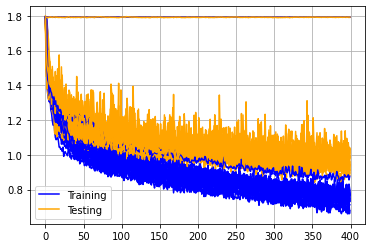

In [37]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [38]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.0375775504112243
mean accuracy:  0.5475106254220009


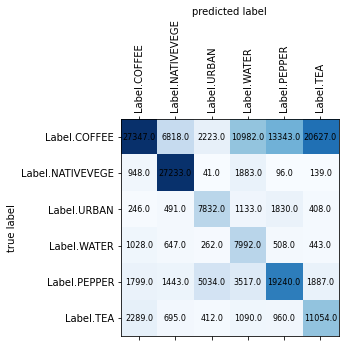

In [39]:
plot_confusion_matrix(conf_matrix, labels)

In [40]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.81252043 0.72957913 0.49557074 0.30048502 0.53478611 0.31986805]
Recalls:  [0.33620605 0.89759394 0.6559464  0.73455882 0.58444714 0.66993939]
F-Score:  [0.47561241 0.80491229 0.56459054 0.42650159 0.55851488 0.43299777]


# NIR, RED, GREEN

In [5]:
BANDS = [
    Band.NIR.value,
    Band.RED.value,
    Band.GREEN.value
]

In [6]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d (Conv2D)              (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 2, 2, 16)          0

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0605 - accuracy: 0.5408 - val_loss: 1.1417 - val_accuracy: 0.4753
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0894 - accuracy: 0.4952 - val_loss: 1.1279 - val_accuracy: 0.5272
Epoch 48/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0364 - accuracy: 0.5096 - val_loss: 1.1366 - val_accuracy: 0.4787
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0369 - accuracy: 0.4917 - val_loss: 1.0743 - val_accuracy: 0.5381
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0084 - accuracy: 0.5443 - val_loss: 1.0748 - val_accuracy: 0.5604
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0309 - accuracy: 0.5352 - val_loss: 1.1139 - val_accuracy: 0.5345
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1054 - accuracy: 0.5272 - val_loss: 1.0497 - val_accuracy: 0.5662
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8545 - accuracy: 0.6011 - val_loss: 0.9692 - val_accuracy: 0.5953
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8804 - accuracy: 0.6029 - val_loss: 1.0148 - val_accuracy: 0.5816
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9109 - accuracy: 0.5809 - val_loss: 0.9986 - val_accuracy: 0.5820
Epoch 163/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8716 - accuracy: 0.5817 - val_loss: 0.9764 - val_accuracy: 0.5854
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8552 - accuracy: 0.5880 - val_loss: 1.0387 - val_accuracy: 0.5549
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8876 - accuracy: 0.5514 - val_loss: 1.0235 - val_accuracy: 0.5669
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9731 - accuracy: 0.5578 - val_loss: 0.9720 - val_accuracy: 0.5941
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7435 - accuracy: 0.6420 - val_loss: 0.9706 - val_accuracy: 0.5933
Epoch 275/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8685 - accuracy: 0.6050 - val_loss: 0.9039 - val_accuracy: 0.6237
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7832 - accuracy: 0.6251 - val_loss: 0.9112 - val_accuracy: 0.6214
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8161 - accuracy: 0.6211 - val_loss: 0.9315 - val_accuracy: 0.6120
Epoch 278/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7501 - accuracy: 0.6259 - val_loss: 0.9532 - val_accuracy: 0.6071
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7549 - accuracy: 0.6202 - val_loss: 0.9344 - val_accuracy: 0.6176
Epoch 280/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7890 - accuracy: 0.5910 - val_loss: 0.9193 - val_accuracy: 0.6223
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6681 - accuracy: 0.6411 - val_loss: 0.9060 - val_accuracy: 0.6268
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7617 - accuracy: 0.6005 - val_loss: 0.9060 - val_accuracy: 0.6391
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7682 - accuracy: 0.6158 - val_loss: 0.9986 - val_accuracy: 0.5748
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7598 - accuracy: 0.6128 - val_loss: 0.9600 - val_accuracy: 0.5884
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7313 - accuracy: 0.6171 - val_loss: 0.9444 - val_accuracy: 0.6107
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7912 - accuracy: 0.6272 - val_loss: 0.9925 - val_accuracy: 0.5852
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7459 - accuracy: 0.6257 - val_loss: 0.9653 - val_accuracy: 0.6108
Epoch 395/400

Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7992 - accuracy: 0.1594 - val_loss: 1.7915 - val_accuracy: 0.0888
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8182 - accuracy: 0.1953 - val_loss: 1.7914 - val_accuracy: 0.4409
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7841 - accuracy: 0.1272 - val_loss: 1.7919 - val_accuracy: 0.0671
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8019 - accuracy: 0.1859 - val_loss: 1.7935 - val_accuracy: 0.0584
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8185 - accuracy: 0.0661 - val_loss: 1.7921 - val_accuracy: 0.0671
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7914 - accuracy: 0.1161 - val_loss: 1.7911 - val_accuracy: 0.4409
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8196 - accuracy: 0.0943 - val_loss: 1.7919 - val_accuracy: 0.0671

57/57 [==============================] - 0s 8ms/step - loss: 1.7882 - accuracy: 0.1001 - val_loss: 1.7919 - val_accuracy: 0.1777
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8426 - accuracy: 0.0785 - val_loss: 1.7922 - val_accuracy: 0.0584
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8543 - accuracy: 0.0689 - val_loss: 1.7912 - val_accuracy: 0.0584
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7947 - accuracy: 0.1572 - val_loss: 1.7917 - val_accuracy: 0.0584
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7848 - accuracy: 0.1093 - val_loss: 1.7908 - val_accuracy: 0.1777
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7699 - accuracy: 0.2450 - val_loss: 1.7909 - val_accuracy: 0.0671
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8425 - accuracy: 0.0619 - val_loss: 1.7921 - val_accuracy: 0.0671
Epoch 224/400

57/57 [==============================] - 0s 9ms/step - loss: 1.7620 - accuracy: 0.0680 - val_loss: 1.7919 - val_accuracy: 0.0584
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8396 - accuracy: 0.0668 - val_loss: 1.7927 - val_accuracy: 0.0888
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8004 - accuracy: 0.0993 - val_loss: 1.7923 - val_accuracy: 0.0888
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8727 - accuracy: 0.0880 - val_loss: 1.7927 - val_accuracy: 0.0671
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7977 - accuracy: 0.0718 - val_loss: 1.7918 - val_accuracy: 0.1777
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7905 - accuracy: 0.1312 - val_loss: 1.7918 - val_accuracy: 0.0671
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8159 - accuracy: 0.0908 - val_loss: 1.7920 - val_accuracy: 0.0671
Epoch 338/400

57/57 [==============================] - 0s 9ms/step - loss: 1.0300 - accuracy: 0.5427 - val_loss: 1.1557 - val_accuracy: 0.5418
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0124 - accuracy: 0.5280 - val_loss: 1.2140 - val_accuracy: 0.4901
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0662 - accuracy: 0.5349 - val_loss: 1.0768 - val_accuracy: 0.5593
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0222 - accuracy: 0.5444 - val_loss: 1.1139 - val_accuracy: 0.5332
Epoch 49/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0036 - accuracy: 0.5575 - val_loss: 1.0909 - val_accuracy: 0.5736
Epoch 50/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9753 - accuracy: 0.5615 - val_loss: 1.1054 - val_accuracy: 0.5595
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9600 - accuracy: 0.5708 - val_loss: 1.1188 - val_accuracy: 0.5517
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8948 - accuracy: 0.5611 - val_loss: 1.0592 - val_accuracy: 0.5767
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8830 - accuracy: 0.5735 - val_loss: 1.0336 - val_accuracy: 0.6046
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9083 - accuracy: 0.5808 - val_loss: 1.0752 - val_accuracy: 0.5794
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8916 - accuracy: 0.5740 - val_loss: 1.0022 - val_accuracy: 0.6077
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9303 - accuracy: 0.5865 - val_loss: 1.0990 - val_accuracy: 0.5471
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8928 - accuracy: 0.5826 - val_loss: 1.0881 - val_accuracy: 0.5626
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9147 - accuracy: 0.5624 - val_loss: 1.0652 - val_accuracy: 0.5835

57/57 [==============================] - 0s 8ms/step - loss: 0.7807 - accuracy: 0.6041 - val_loss: 1.1369 - val_accuracy: 0.5551
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8588 - accuracy: 0.5910 - val_loss: 0.9163 - val_accuracy: 0.6223
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8343 - accuracy: 0.6116 - val_loss: 0.9282 - val_accuracy: 0.6270
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7963 - accuracy: 0.6248 - val_loss: 0.9327 - val_accuracy: 0.6179
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8282 - accuracy: 0.5900 - val_loss: 1.0102 - val_accuracy: 0.5937
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7905 - accuracy: 0.6086 - val_loss: 1.0679 - val_accuracy: 0.5626
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8002 - accuracy: 0.5808 - val_loss: 1.0565 - val_accuracy: 0.5737
Epoch 224/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7410 - accuracy: 0.6437 - val_loss: 0.9385 - val_accuracy: 0.6303
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7029 - accuracy: 0.6476 - val_loss: 0.9048 - val_accuracy: 0.6440
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6962 - accuracy: 0.6338 - val_loss: 0.9300 - val_accuracy: 0.6295
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7339 - accuracy: 0.6491 - val_loss: 0.9612 - val_accuracy: 0.5997
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7254 - accuracy: 0.6527 - val_loss: 0.8886 - val_accuracy: 0.6560
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7033 - accuracy: 0.6598 - val_loss: 0.8726 - val_accuracy: 0.6573
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7114 - accuracy: 0.6466 - val_loss: 0.9089 - val_accuracy: 0.6424
Epoch 338/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1220 - accuracy: 0.4158 - val_loss: 1.2379 - val_accuracy: 0.4140
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0841 - accuracy: 0.4669 - val_loss: 1.1738 - val_accuracy: 0.4851
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0712 - accuracy: 0.4501 - val_loss: 1.1450 - val_accuracy: 0.4405
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0774 - accuracy: 0.4635 - val_loss: 1.2023 - val_accuracy: 0.4626
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0777 - accuracy: 0.4533 - val_loss: 1.1749 - val_accuracy: 0.5461
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0076 - accuracy: 0.4994 - val_loss: 1.1590 - val_accuracy: 0.4573
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0724 - accuracy: 0.4477 - val_loss: 1.1770 - val_accuracy: 0.4435
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9986 - accuracy: 0.5525 - val_loss: 1.0551 - val_accuracy: 0.5706
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9553 - accuracy: 0.5420 - val_loss: 1.0771 - val_accuracy: 0.5421
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9532 - accuracy: 0.5318 - val_loss: 1.0372 - val_accuracy: 0.5924
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9607 - accuracy: 0.5476 - val_loss: 1.0622 - val_accuracy: 0.5395
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9639 - accuracy: 0.5547 - val_loss: 1.1288 - val_accuracy: 0.5332
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9350 - accuracy: 0.5562 - val_loss: 1.0861 - val_accuracy: 0.5491
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9993 - accuracy: 0.5100 - val_loss: 1.1792 - val_accuracy: 0.4753

57/57 [==============================] - 0s 8ms/step - loss: 0.8417 - accuracy: 0.5902 - val_loss: 0.9647 - val_accuracy: 0.6149
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8485 - accuracy: 0.5947 - val_loss: 1.0298 - val_accuracy: 0.5727
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8347 - accuracy: 0.5868 - val_loss: 1.0381 - val_accuracy: 0.5625
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8357 - accuracy: 0.5937 - val_loss: 1.0248 - val_accuracy: 0.5706
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8046 - accuracy: 0.5688 - val_loss: 1.0707 - val_accuracy: 0.5606
Epoch 222/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8608 - accuracy: 0.5913 - val_loss: 1.0013 - val_accuracy: 0.5879
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8352 - accuracy: 0.5931 - val_loss: 0.9821 - val_accuracy: 0.6130
Epoch 224/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7853 - accuracy: 0.6091 - val_loss: 0.9629 - val_accuracy: 0.6087
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7482 - accuracy: 0.6220 - val_loss: 0.9954 - val_accuracy: 0.5970
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7885 - accuracy: 0.6068 - val_loss: 1.0350 - val_accuracy: 0.5722
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8296 - accuracy: 0.6038 - val_loss: 0.9582 - val_accuracy: 0.6178
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7961 - accuracy: 0.6268 - val_loss: 0.9572 - val_accuracy: 0.6303
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8091 - accuracy: 0.5975 - val_loss: 1.0696 - val_accuracy: 0.5627
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8065 - accuracy: 0.6302 - val_loss: 1.0146 - val_accuracy: 0.5778
Epoch 338/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0088 - accuracy: 0.5474 - val_loss: 1.0615 - val_accuracy: 0.5630
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0107 - accuracy: 0.5255 - val_loss: 1.2031 - val_accuracy: 0.4530
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9821 - accuracy: 0.5350 - val_loss: 1.0732 - val_accuracy: 0.5608
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9948 - accuracy: 0.5406 - val_loss: 1.0739 - val_accuracy: 0.5620
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9353 - accuracy: 0.5670 - val_loss: 1.1381 - val_accuracy: 0.5172
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9288 - accuracy: 0.5287 - val_loss: 1.1665 - val_accuracy: 0.4821
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9592 - accuracy: 0.5413 - val_loss: 1.1081 - val_accuracy: 0.5478
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8893 - accuracy: 0.5864 - val_loss: 1.1573 - val_accuracy: 0.4846
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9036 - accuracy: 0.5213 - val_loss: 1.1079 - val_accuracy: 0.5202
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9021 - accuracy: 0.5722 - val_loss: 1.0946 - val_accuracy: 0.5418
Epoch 106/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9042 - accuracy: 0.5925 - val_loss: 0.9980 - val_accuracy: 0.6088
Epoch 107/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8709 - accuracy: 0.5964 - val_loss: 1.0476 - val_accuracy: 0.5884
Epoch 108/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9363 - accuracy: 0.6016 - val_loss: 1.0395 - val_accuracy: 0.5905
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8519 - accuracy: 0.6072 - val_loss: 1.1271 - val_accuracy: 0.5187

57/57 [==============================] - 0s 8ms/step - loss: 0.8187 - accuracy: 0.6072 - val_loss: 1.0115 - val_accuracy: 0.5862
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7904 - accuracy: 0.6177 - val_loss: 0.9818 - val_accuracy: 0.6197
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7949 - accuracy: 0.6045 - val_loss: 0.9925 - val_accuracy: 0.6096
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7658 - accuracy: 0.6386 - val_loss: 1.0199 - val_accuracy: 0.5881
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7853 - accuracy: 0.5954 - val_loss: 0.9809 - val_accuracy: 0.6172
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8359 - accuracy: 0.6363 - val_loss: 0.9725 - val_accuracy: 0.6057
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8419 - accuracy: 0.6111 - val_loss: 1.0459 - val_accuracy: 0.5914
Epoch 224/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7901 - accuracy: 0.6159 - val_loss: 0.9823 - val_accuracy: 0.6009
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7290 - accuracy: 0.6167 - val_loss: 0.9964 - val_accuracy: 0.6066
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7258 - accuracy: 0.6256 - val_loss: 0.9251 - val_accuracy: 0.6314
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7796 - accuracy: 0.6285 - val_loss: 0.9425 - val_accuracy: 0.6326
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7354 - accuracy: 0.6521 - val_loss: 0.9303 - val_accuracy: 0.6380
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7835 - accuracy: 0.6376 - val_loss: 1.0015 - val_accuracy: 0.6181
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7460 - accuracy: 0.6273 - val_loss: 0.9367 - val_accuracy: 0.6299
Epoch 338/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0221 - accuracy: 0.5047 - val_loss: 1.1611 - val_accuracy: 0.5060
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0502 - accuracy: 0.4905 - val_loss: 1.2350 - val_accuracy: 0.4444
Epoch 42/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0309 - accuracy: 0.4814 - val_loss: 1.1208 - val_accuracy: 0.5184
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0323 - accuracy: 0.4936 - val_loss: 1.0838 - val_accuracy: 0.5655
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0161 - accuracy: 0.5254 - val_loss: 1.1053 - val_accuracy: 0.5633
Epoch 45/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0972 - accuracy: 0.5058 - val_loss: 1.1251 - val_accuracy: 0.5387
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9960 - accuracy: 0.5166 - val_loss: 1.1184 - val_accuracy: 0.5287
Epoch 47/400
57/57 

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9631 - accuracy: 0.5631 - val_loss: 1.1253 - val_accuracy: 0.5245
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9100 - accuracy: 0.5395 - val_loss: 1.0390 - val_accuracy: 0.5797
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9557 - accuracy: 0.5246 - val_loss: 1.0953 - val_accuracy: 0.5616
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9389 - accuracy: 0.5403 - val_loss: 1.1275 - val_accuracy: 0.5412
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9508 - accuracy: 0.5556 - val_loss: 1.0972 - val_accuracy: 0.5546
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8969 - accuracy: 0.5658 - val_loss: 1.1285 - val_accuracy: 0.5386
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8745 - accuracy: 0.5271 - val_loss: 1.1170 - val_accuracy: 0.5356
E

57/57 [==============================] - 0s 8ms/step - loss: 0.9761 - accuracy: 0.5395 - val_loss: 1.0125 - val_accuracy: 0.5798
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8401 - accuracy: 0.5971 - val_loss: 1.0447 - val_accuracy: 0.5570
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8775 - accuracy: 0.5484 - val_loss: 1.1190 - val_accuracy: 0.5218
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8660 - accuracy: 0.5588 - val_loss: 1.1174 - val_accuracy: 0.5249
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9861 - accuracy: 0.5108 - val_loss: 1.0666 - val_accuracy: 0.5343
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8549 - accuracy: 0.5778 - val_loss: 1.0530 - val_accuracy: 0.5526
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8857 - accuracy: 0.5736 - val_loss: 1.0182 - val_accuracy: 0.5816
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7741 - accuracy: 0.6095 - val_loss: 1.0165 - val_accuracy: 0.5848
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7667 - accuracy: 0.6211 - val_loss: 0.9920 - val_accuracy: 0.5941
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7847 - accuracy: 0.5884 - val_loss: 1.0201 - val_accuracy: 0.5824
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7992 - accuracy: 0.5883 - val_loss: 1.0252 - val_accuracy: 0.5812
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8166 - accuracy: 0.5846 - val_loss: 1.0155 - val_accuracy: 0.5866
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8152 - accuracy: 0.6142 - val_loss: 1.0163 - val_accuracy: 0.5909
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7658 - accuracy: 0.6112 - val_loss: 1.0005 - val_accuracy: 0.5824
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1031 - accuracy: 0.4475 - val_loss: 1.1242 - val_accuracy: 0.5342
Epoch 36/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0833 - accuracy: 0.4839 - val_loss: 1.1498 - val_accuracy: 0.4612
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1268 - accuracy: 0.4632 - val_loss: 1.1615 - val_accuracy: 0.4596
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0555 - accuracy: 0.4869 - val_loss: 1.1488 - val_accuracy: 0.4647
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0667 - accuracy: 0.4940 - val_loss: 1.2446 - val_accuracy: 0.4574
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1264 - accuracy: 0.4822 - val_loss: 1.1226 - val_accuracy: 0.5254
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0999 - accuracy: 0.5040 - val_loss: 1.1063 - val_accuracy: 0.5236
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9564 - accuracy: 0.5570 - val_loss: 1.0622 - val_accuracy: 0.5830
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0018 - accuracy: 0.5836 - val_loss: 1.1385 - val_accuracy: 0.5415
Epoch 95/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9745 - accuracy: 0.5755 - val_loss: 1.0750 - val_accuracy: 0.5841
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9428 - accuracy: 0.5957 - val_loss: 1.0336 - val_accuracy: 0.6016
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9664 - accuracy: 0.5811 - val_loss: 1.0197 - val_accuracy: 0.5992
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9520 - accuracy: 0.5822 - val_loss: 1.0464 - val_accuracy: 0.5751
Epoch 99/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0199 - accuracy: 0.5684 - val_loss: 1.0905 - val_accuracy: 0.5790
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8524 - accuracy: 0.5971 - val_loss: 1.0062 - val_accuracy: 0.5890
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8178 - accuracy: 0.5928 - val_loss: 0.9776 - val_accuracy: 0.6095
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8243 - accuracy: 0.6360 - val_loss: 0.9908 - val_accuracy: 0.6076
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8051 - accuracy: 0.5968 - val_loss: 0.9630 - val_accuracy: 0.6147
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8836 - accuracy: 0.5901 - val_loss: 0.9642 - val_accuracy: 0.6103
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8214 - accuracy: 0.6159 - val_loss: 1.0668 - val_accuracy: 0.5262
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8123 - accuracy: 0.5969 - val_loss: 1.0691 - val_accuracy: 0.5551
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7745 - accuracy: 0.5920 - val_loss: 0.9674 - val_accuracy: 0.6051
Epoch 322/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7342 - accuracy: 0.6229 - val_loss: 0.9667 - val_accuracy: 0.5959
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7505 - accuracy: 0.6233 - val_loss: 0.9122 - val_accuracy: 0.6342
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7327 - accuracy: 0.6384 - val_loss: 0.9179 - val_accuracy: 0.6261
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7785 - accuracy: 0.6328 - val_loss: 0.9453 - val_accuracy: 0.6108
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7328 - accuracy: 0.6199 - val_loss: 1.0433 - val_accuracy: 0.5710
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7923 - accuracy: 0.5921 - val_loss: 1.0017 - val_accuracy: 0.5762
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1431 - accuracy: 0.4766 - val_loss: 1.0865 - val_accuracy: 0.5429
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0743 - accuracy: 0.5386 - val_loss: 1.0909 - val_accuracy: 0.5595
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9961 - accuracy: 0.5228 - val_loss: 1.1022 - val_accuracy: 0.5313
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9886 - accuracy: 0.5323 - val_loss: 1.1491 - val_accuracy: 0.4861
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0038 - accuracy: 0.5336 - val_loss: 1.0241 - val_accuracy: 0.5857
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0164 - accuracy: 0.5350 - val_loss: 1.0835 - val_accuracy: 0.5720
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0274 - accuracy: 0.5370 - val_loss: 1.1249 - val_accuracy: 0.5493
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9214 - accuracy: 0.5856 - val_loss: 1.0385 - val_accuracy: 0.5857
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9269 - accuracy: 0.5900 - val_loss: 1.0232 - val_accuracy: 0.5917
Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9337 - accuracy: 0.5684 - val_loss: 0.9954 - val_accuracy: 0.5947
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9292 - accuracy: 0.6037 - val_loss: 1.0137 - val_accuracy: 0.5998
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9929 - accuracy: 0.5675 - val_loss: 1.0451 - val_accuracy: 0.5573
Epoch 93/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9008 - accuracy: 0.6062 - val_loss: 0.9773 - val_accuracy: 0.6160
Epoch 94/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8832 - accuracy: 0.5963 - val_loss: 1.0039 - val_accuracy: 0.6000
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8044 - accuracy: 0.6095 - val_loss: 0.9770 - val_accuracy: 0.6068
Epoch 203/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8473 - accuracy: 0.6232 - val_loss: 0.9533 - val_accuracy: 0.6152
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8574 - accuracy: 0.5831 - val_loss: 0.9525 - val_accuracy: 0.6100
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7893 - accuracy: 0.6511 - val_loss: 0.9771 - val_accuracy: 0.5917
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7994 - accuracy: 0.6104 - val_loss: 0.9599 - val_accuracy: 0.6303
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8024 - accuracy: 0.6191 - val_loss: 1.0441 - val_accuracy: 0.5351
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8843 - accuracy: 0.5829 - val_loss: 0.9540 - val_accuracy: 0.6198
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7227 - accuracy: 0.6072 - val_loss: 0.9999 - val_accuracy: 0.5778
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7259 - accuracy: 0.6512 - val_loss: 0.9161 - val_accuracy: 0.6382
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7934 - accuracy: 0.6173 - val_loss: 0.9391 - val_accuracy: 0.6142
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7220 - accuracy: 0.6383 - val_loss: 0.8936 - val_accuracy: 0.6481
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7506 - accuracy: 0.6268 - val_loss: 0.9535 - val_accuracy: 0.6121
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7462 - accuracy: 0.6358 - val_loss: 0.9408 - val_accuracy: 0.6318
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7690 - accuracy: 0.6246 - val_loss: 0.9454 - val_accuracy: 0.6141
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1968 - accuracy: 0.3361 - val_loss: 1.2549 - val_accuracy: 0.3723
Epoch 26/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2515 - accuracy: 0.3544 - val_loss: 1.2190 - val_accuracy: 0.4076
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2678 - accuracy: 0.3831 - val_loss: 1.2301 - val_accuracy: 0.3697
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1196 - accuracy: 0.4017 - val_loss: 1.2016 - val_accuracy: 0.3834
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1587 - accuracy: 0.4051 - val_loss: 1.1946 - val_accuracy: 0.4075
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2345 - accuracy: 0.3955 - val_loss: 1.2213 - val_accuracy: 0.4112
Epoch 31/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2029 - accuracy: 0.3729 - val_loss: 1.1807 - val_accuracy: 0.4522
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0383 - accuracy: 0.5479 - val_loss: 1.0325 - val_accuracy: 0.5925
Epoch 84/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0255 - accuracy: 0.5584 - val_loss: 1.1025 - val_accuracy: 0.5517
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9574 - accuracy: 0.5738 - val_loss: 1.0621 - val_accuracy: 0.5763
Epoch 86/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9971 - accuracy: 0.5483 - val_loss: 1.0660 - val_accuracy: 0.5777
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0342 - accuracy: 0.5501 - val_loss: 1.0922 - val_accuracy: 0.5657
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9939 - accuracy: 0.5643 - val_loss: 1.0789 - val_accuracy: 0.5625
Epoch 89/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9541 - accuracy: 0.5828 - val_loss: 1.0663 - val_accuracy: 0.5679
Epoch

57/57 [==============================] - 0s 8ms/step - loss: 0.8761 - accuracy: 0.6010 - val_loss: 1.0049 - val_accuracy: 0.6055
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8750 - accuracy: 0.5875 - val_loss: 1.4355 - val_accuracy: 0.4409
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9379 - accuracy: 0.5350 - val_loss: 0.9719 - val_accuracy: 0.6042
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8843 - accuracy: 0.5887 - val_loss: 1.0091 - val_accuracy: 0.5803
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8668 - accuracy: 0.6056 - val_loss: 0.9740 - val_accuracy: 0.6130
Epoch 202/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8739 - accuracy: 0.6214 - val_loss: 1.0055 - val_accuracy: 0.6095
Epoch 203/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9209 - accuracy: 0.6073 - val_loss: 1.0691 - val_accuracy: 0.5520
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7792 - accuracy: 0.6544 - val_loss: 0.9706 - val_accuracy: 0.6307
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8046 - accuracy: 0.6379 - val_loss: 0.9647 - val_accuracy: 0.6299
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7813 - accuracy: 0.6314 - val_loss: 0.9425 - val_accuracy: 0.6322
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8085 - accuracy: 0.6439 - val_loss: 0.9966 - val_accuracy: 0.5934
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8699 - accuracy: 0.5870 - val_loss: 1.0802 - val_accuracy: 0.5429
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8554 - accuracy: 0.5883 - val_loss: 0.9372 - val_accuracy: 0.6223
Epoch 317/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7956 - accuracy: 0.6034 - val_loss: 0.9675 - val_accuracy: 0.6125
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2126 - accuracy: 0.3683 - val_loss: 1.3433 - val_accuracy: 0.3175
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2815 - accuracy: 0.3325 - val_loss: 1.2959 - val_accuracy: 0.3193
Epoch 22/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1739 - accuracy: 0.3521 - val_loss: 1.2624 - val_accuracy: 0.3635
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2060 - accuracy: 0.3431 - val_loss: 1.2217 - val_accuracy: 0.4098
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1770 - accuracy: 0.3536 - val_loss: 1.2785 - val_accuracy: 0.3909
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2032 - accuracy: 0.3693 - val_loss: 1.2443 - val_accuracy: 0.3550
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1931 - accuracy: 0.3464 - val_loss: 1.2070 - val_accuracy: 0.4008
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0094 - accuracy: 0.5263 - val_loss: 1.0851 - val_accuracy: 0.5648
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9971 - accuracy: 0.5468 - val_loss: 1.0487 - val_accuracy: 0.5743
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9990 - accuracy: 0.5450 - val_loss: 1.0884 - val_accuracy: 0.5592
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0224 - accuracy: 0.5259 - val_loss: 1.0492 - val_accuracy: 0.5765
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9979 - accuracy: 0.5575 - val_loss: 1.0666 - val_accuracy: 0.5355
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0110 - accuracy: 0.5263 - val_loss: 1.1156 - val_accuracy: 0.5138
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9842 - accuracy: 0.5467 - val_loss: 1.0677 - val_accuracy: 0.5410
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9070 - accuracy: 0.5577 - val_loss: 0.9717 - val_accuracy: 0.6132
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8500 - accuracy: 0.5967 - val_loss: 1.0289 - val_accuracy: 0.5391
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9376 - accuracy: 0.5603 - val_loss: 1.0390 - val_accuracy: 0.5979
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9598 - accuracy: 0.5557 - val_loss: 1.0556 - val_accuracy: 0.5650
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9420 - accuracy: 0.5460 - val_loss: 1.0729 - val_accuracy: 0.5672
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8457 - accuracy: 0.5617 - val_loss: 1.0004 - val_accuracy: 0.5883
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8101 - accuracy: 0.5754 - val_loss: 0.9679 - val_accuracy: 0.6107
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8324 - accuracy: 0.5824 - val_loss: 0.9857 - val_accuracy: 0.5853
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7962 - accuracy: 0.5843 - val_loss: 1.0203 - val_accuracy: 0.5426
Epoch 308/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7616 - accuracy: 0.5760 - val_loss: 0.9254 - val_accuracy: 0.6219
Epoch 309/400
57/57 [==============================] - 1s 15ms/step - loss: 0.7655 - accuracy: 0.6120 - val_loss: 0.9045 - val_accuracy: 0.6278
Epoch 310/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7800 - accuracy: 0.6205 - val_loss: 0.9392 - val_accuracy: 0.6138
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8071 - accuracy: 0.5945 - val_loss: 0.9027 - val_accuracy: 0.6401
Epoch 312/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8231 - accuracy: 0.5711 - val_loss: 0.9271 - val_accuracy: 0.6089
Epoch 313/40

57/57 [==============================] - 0s 8ms/step - loss: 1.8048 - accuracy: 0.1520 - val_loss: 1.7921 - val_accuracy: 0.1809
Epoch 16/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7448 - accuracy: 0.1387 - val_loss: 1.7911 - val_accuracy: 0.1648
Epoch 17/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7422 - accuracy: 0.1737 - val_loss: 1.7911 - val_accuracy: 0.0903
Epoch 18/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7783 - accuracy: 0.1249 - val_loss: 1.7906 - val_accuracy: 0.1648
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7967 - accuracy: 0.1509 - val_loss: 1.7921 - val_accuracy: 0.0903
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8200 - accuracy: 0.0993 - val_loss: 1.7918 - val_accuracy: 0.0903
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8214 - accuracy: 0.1120 - val_loss: 1.7913 - val_accuracy: 0.0903
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7975 - accuracy: 0.1469 - val_loss: 1.7917 - val_accuracy: 0.0903
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7362 - accuracy: 0.2835 - val_loss: 1.7914 - val_accuracy: 0.0903
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8152 - accuracy: 0.1088 - val_loss: 1.7919 - val_accuracy: 0.0640
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8028 - accuracy: 0.1529 - val_loss: 1.7922 - val_accuracy: 0.0640
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7700 - accuracy: 0.1760 - val_loss: 1.7919 - val_accuracy: 0.0640
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8464 - accuracy: 0.0980 - val_loss: 1.7921 - val_accuracy: 0.0590
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7892 - accuracy: 0.1666 - val_loss: 1.7916 - val_accuracy: 0.1648
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 1.7596 - accuracy: 0.2352 - val_loss: 1.7920 - val_accuracy: 0.0590
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7242 - accuracy: 0.1275 - val_loss: 1.7917 - val_accuracy: 0.1809
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8097 - accuracy: 0.1258 - val_loss: 1.7919 - val_accuracy: 0.0590
Epoch 190/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7778 - accuracy: 0.0725 - val_loss: 1.7922 - val_accuracy: 0.1809
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8285 - accuracy: 0.1137 - val_loss: 1.7917 - val_accuracy: 0.0590
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7972 - accuracy: 0.0639 - val_loss: 1.7914 - val_accuracy: 0.4410
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8046 - accuracy: 0.1956 - val_loss: 1.7921 - val_accuracy: 0.1809
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8429 - accuracy: 0.0973 - val_loss: 1.7925 - val_accuracy: 0.0590
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7621 - accuracy: 0.2060 - val_loss: 1.7918 - val_accuracy: 0.0903
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7997 - accuracy: 0.1078 - val_loss: 1.7917 - val_accuracy: 0.0640
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7749 - accuracy: 0.1419 - val_loss: 1.7929 - val_accuracy: 0.0590
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7951 - accuracy: 0.0610 - val_loss: 1.7919 - val_accuracy: 0.0640
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8027 - accuracy: 0.0654 - val_loss: 1.7915 - val_accuracy: 0.4410
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8413 - accuracy: 0.1492 - val_loss: 1.7920 - val_accuracy: 0.0640
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2593 - accuracy: 0.3813 - val_loss: 1.2539 - val_accuracy: 0.3650
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2638 - accuracy: 0.3812 - val_loss: 1.3465 - val_accuracy: 0.3338
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2924 - accuracy: 0.3553 - val_loss: 1.2243 - val_accuracy: 0.3974
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2390 - accuracy: 0.3914 - val_loss: 1.2366 - val_accuracy: 0.3802
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2039 - accuracy: 0.4008 - val_loss: 1.2529 - val_accuracy: 0.3923
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2231 - accuracy: 0.4130 - val_loss: 1.2750 - val_accuracy: 0.3757
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2142 - accuracy: 0.3720 - val_loss: 1.2307 - val_accuracy: 0.4006
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9789 - accuracy: 0.5289 - val_loss: 1.1933 - val_accuracy: 0.4699
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0018 - accuracy: 0.4802 - val_loss: 1.1201 - val_accuracy: 0.5183
Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0286 - accuracy: 0.4835 - val_loss: 1.1063 - val_accuracy: 0.5236
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9902 - accuracy: 0.5158 - val_loss: 1.1484 - val_accuracy: 0.5024
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9626 - accuracy: 0.5107 - val_loss: 1.1177 - val_accuracy: 0.5111
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0156 - accuracy: 0.5066 - val_loss: 1.1117 - val_accuracy: 0.5184
Epoch 74/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9276 - accuracy: 0.5367 - val_loss: 1.1578 - val_accuracy: 0.4976
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8866 - accuracy: 0.5487 - val_loss: 1.0388 - val_accuracy: 0.5630
Epoch 183/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8968 - accuracy: 0.5769 - val_loss: 1.1326 - val_accuracy: 0.5203
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9130 - accuracy: 0.5664 - val_loss: 1.0170 - val_accuracy: 0.5697
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8718 - accuracy: 0.5644 - val_loss: 1.0004 - val_accuracy: 0.5830
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8115 - accuracy: 0.5708 - val_loss: 1.1078 - val_accuracy: 0.5066
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8482 - accuracy: 0.5565 - val_loss: 1.0543 - val_accuracy: 0.5616
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8681 - accuracy: 0.5476 - val_loss: 1.0816 - val_accuracy: 0.5234
Epoch 189/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8629 - accuracy: 0.5914 - val_loss: 1.0346 - val_accuracy: 0.5792
Epoch 297/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8119 - accuracy: 0.5957 - val_loss: 1.0608 - val_accuracy: 0.5660
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7962 - accuracy: 0.5733 - val_loss: 1.0005 - val_accuracy: 0.5868
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8228 - accuracy: 0.5884 - val_loss: 1.1090 - val_accuracy: 0.5313
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8472 - accuracy: 0.5787 - val_loss: 1.0733 - val_accuracy: 0.5661
Epoch 301/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8015 - accuracy: 0.6038 - val_loss: 1.0240 - val_accuracy: 0.5721
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7687 - accuracy: 0.5801 - val_loss: 1.0362 - val_accuracy: 0.5721
Epoch 303/40

57/57 [==============================] - 1s 9ms/step - loss: 1.3737 - accuracy: 0.3360 - val_loss: 1.3059 - val_accuracy: 0.3791
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3602 - accuracy: 0.3651 - val_loss: 1.2618 - val_accuracy: 0.3591
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2521 - accuracy: 0.3841 - val_loss: 1.3402 - val_accuracy: 0.3026
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3293 - accuracy: 0.3484 - val_loss: 1.2937 - val_accuracy: 0.3008
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3488 - accuracy: 0.3447 - val_loss: 1.3187 - val_accuracy: 0.3771
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3178 - accuracy: 0.4106 - val_loss: 1.2369 - val_accuracy: 0.3625
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2066 - accuracy: 0.3807 - val_loss: 1.2458 - val_accuracy: 0.3667
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0132 - accuracy: 0.5700 - val_loss: 1.0542 - val_accuracy: 0.5921
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9670 - accuracy: 0.5555 - val_loss: 0.9941 - val_accuracy: 0.6039
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0705 - accuracy: 0.5518 - val_loss: 1.1144 - val_accuracy: 0.5559
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0304 - accuracy: 0.5600 - val_loss: 1.0344 - val_accuracy: 0.5830
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0369 - accuracy: 0.5428 - val_loss: 1.0326 - val_accuracy: 0.5858
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0327 - accuracy: 0.5424 - val_loss: 1.0652 - val_accuracy: 0.5644
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9494 - accuracy: 0.5625 - val_loss: 1.0204 - val_accuracy: 0.6030
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8929 - accuracy: 0.5835 - val_loss: 0.9064 - val_accuracy: 0.6410
Epoch 178/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9110 - accuracy: 0.5712 - val_loss: 0.9280 - val_accuracy: 0.6352
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9228 - accuracy: 0.6087 - val_loss: 1.0325 - val_accuracy: 0.5986
Epoch 180/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8805 - accuracy: 0.5882 - val_loss: 1.0200 - val_accuracy: 0.6007
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8775 - accuracy: 0.5642 - val_loss: 0.9942 - val_accuracy: 0.5865
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7814 - accuracy: 0.6144 - val_loss: 0.9207 - val_accuracy: 0.6361
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8730 - accuracy: 0.6022 - val_loss: 0.9481 - val_accuracy: 0.6204
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8368 - accuracy: 0.5752 - val_loss: 0.9967 - val_accuracy: 0.5793
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7475 - accuracy: 0.6003 - val_loss: 0.9855 - val_accuracy: 0.5933
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8418 - accuracy: 0.5733 - val_loss: 1.0193 - val_accuracy: 0.5877
Epoch 294/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7973 - accuracy: 0.5933 - val_loss: 0.9486 - val_accuracy: 0.6204
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8056 - accuracy: 0.5994 - val_loss: 0.9487 - val_accuracy: 0.6243
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8482 - accuracy: 0.6053 - val_loss: 1.0138 - val_accuracy: 0.5921
Epoch 297/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7729 - accuracy: 0.5998 - val_loss: 1.0415 - val_accuracy: 0.5769
Epoch 298/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7879 - accuracy: 0.1958 - val_loss: 1.7875 - val_accuracy: 0.4435
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7640 - accuracy: 0.3827 - val_loss: 1.7879 - val_accuracy: 0.1637
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7997 - accuracy: 0.2018 - val_loss: 1.7919 - val_accuracy: 0.0652
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8455 - accuracy: 0.1085 - val_loss: 1.7906 - val_accuracy: 0.4435
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7924 - accuracy: 0.1829 - val_loss: 1.7898 - val_accuracy: 0.4435
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8080 - accuracy: 0.1982 - val_loss: 1.7923 - val_accuracy: 0.0652
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7783 - accuracy: 0.1707 - val_loss: 1.7902 - val_accuracy

57/57 [==============================] - 0s 8ms/step - loss: 1.8345 - accuracy: 0.2067 - val_loss: 1.7912 - val_accuracy: 0.0652
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8511 - accuracy: 0.0673 - val_loss: 1.7913 - val_accuracy: 0.0652
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7469 - accuracy: 0.2651 - val_loss: 1.7900 - val_accuracy: 0.4435
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8131 - accuracy: 0.2549 - val_loss: 1.7912 - val_accuracy: 0.0652
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8161 - accuracy: 0.0794 - val_loss: 1.7911 - val_accuracy: 0.1768
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7830 - accuracy: 0.1918 - val_loss: 1.7916 - val_accuracy: 0.1768
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7780 - accuracy: 0.1303 - val_loss: 1.7905 - val_accuracy: 0.4435
Epoch 122/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8245 - accuracy: 0.2272 - val_loss: 1.7920 - val_accuracy: 0.0587
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7870 - accuracy: 0.1050 - val_loss: 1.7927 - val_accuracy: 0.0920
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8380 - accuracy: 0.1308 - val_loss: 1.7912 - val_accuracy: 0.0920
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7584 - accuracy: 0.1738 - val_loss: 1.7910 - val_accuracy: 0.1768
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8003 - accuracy: 0.1623 - val_loss: 1.7923 - val_accuracy: 0.1768
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 1.8645 - accuracy: 0.1049 - val_loss: 1.7921 - val_accuracy: 0.1768
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7944 - accuracy: 0.1955 - val_loss: 1.7906 - val_accuracy: 0.4435
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 1.7559 - accuracy: 0.3030 - val_loss: 1.7908 - val_accuracy: 0.4435
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8977 - accuracy: 0.1602 - val_loss: 1.7934 - val_accuracy: 0.0652
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7660 - accuracy: 0.0707 - val_loss: 1.7906 - val_accuracy: 0.1637
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7568 - accuracy: 0.4235 - val_loss: 1.7923 - val_accuracy: 0.0652
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7646 - accuracy: 0.1473 - val_loss: 1.7916 - val_accuracy: 0.0920
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7616 - accuracy: 0.1339 - val_loss: 1.7912 - val_accuracy: 0.0920
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7640 - accuracy: 0.1326 - val_loss: 1.7917 - val_accuracy: 0.0587
Epoch 350/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1037 - accuracy: 0.5066 - val_loss: 1.1340 - val_accuracy: 0.5243
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0613 - accuracy: 0.5140 - val_loss: 1.1647 - val_accuracy: 0.4819
Epoch 54/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1369 - accuracy: 0.4917 - val_loss: 1.1401 - val_accuracy: 0.4956
Epoch 55/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1004 - accuracy: 0.5003 - val_loss: 1.1233 - val_accuracy: 0.5351
Epoch 56/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1067 - accuracy: 0.5032 - val_loss: 1.1427 - val_accuracy: 0.5547
Epoch 57/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0822 - accuracy: 0.4920 - val_loss: 1.1782 - val_accuracy: 0.4418
Epoch 58/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0408 - accuracy: 0.4768 - val_loss: 1.1435 - val_accuracy: 0.5425
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9644 - accuracy: 0.5566 - val_loss: 1.0617 - val_accuracy: 0.5868
Epoch 111/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0208 - accuracy: 0.5717 - val_loss: 1.0518 - val_accuracy: 0.5954
Epoch 112/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9979 - accuracy: 0.5849 - val_loss: 1.2246 - val_accuracy: 0.4906
Epoch 113/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0772 - accuracy: 0.5224 - val_loss: 1.0645 - val_accuracy: 0.5871
Epoch 114/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0519 - accuracy: 0.5878 - val_loss: 1.0539 - val_accuracy: 0.5877
Epoch 115/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9739 - accuracy: 0.5770 - val_loss: 1.1267 - val_accuracy: 0.5550
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9854 - accuracy: 0.5898 - val_loss: 1.1147 - val_accuracy: 0.5192

57/57 [==============================] - 0s 8ms/step - loss: 0.8613 - accuracy: 0.6241 - val_loss: 1.0281 - val_accuracy: 0.5842
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8893 - accuracy: 0.5992 - val_loss: 1.0339 - val_accuracy: 0.6058
Epoch 226/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8993 - accuracy: 0.5996 - val_loss: 0.9910 - val_accuracy: 0.6115
Epoch 227/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8753 - accuracy: 0.6060 - val_loss: 0.9993 - val_accuracy: 0.5901
Epoch 228/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8504 - accuracy: 0.6376 - val_loss: 0.9712 - val_accuracy: 0.6125
Epoch 229/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8538 - accuracy: 0.6165 - val_loss: 0.9708 - val_accuracy: 0.6107
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8888 - accuracy: 0.5932 - val_loss: 0.9820 - val_accuracy: 0.6129
Epoch 231/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8094 - accuracy: 0.6016 - val_loss: 0.9995 - val_accuracy: 0.5907
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7639 - accuracy: 0.6310 - val_loss: 0.9529 - val_accuracy: 0.6168
Epoch 340/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8018 - accuracy: 0.6237 - val_loss: 0.9949 - val_accuracy: 0.5966
Epoch 341/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8587 - accuracy: 0.6210 - val_loss: 0.9803 - val_accuracy: 0.6012
Epoch 342/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7797 - accuracy: 0.6118 - val_loss: 0.9478 - val_accuracy: 0.6175
Epoch 343/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8343 - accuracy: 0.6311 - val_loss: 0.9610 - val_accuracy: 0.6062
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8142 - accuracy: 0.6047 - val_loss: 0.9363 - val_accuracy: 0.6119
Epoch 345/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0024 - accuracy: 0.5235 - val_loss: 1.1565 - val_accuracy: 0.5239
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9906 - accuracy: 0.5116 - val_loss: 1.1196 - val_accuracy: 0.5116
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9881 - accuracy: 0.4991 - val_loss: 1.1206 - val_accuracy: 0.5285
Epoch 50/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9538 - accuracy: 0.5199 - val_loss: 1.0821 - val_accuracy: 0.5590
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9982 - accuracy: 0.5395 - val_loss: 1.1254 - val_accuracy: 0.5594
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0114 - accuracy: 0.5408 - val_loss: 1.0973 - val_accuracy: 0.5522
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9553 - accuracy: 0.5359 - val_loss: 1.1203 - val_accuracy: 0.5735
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9247 - accuracy: 0.5954 - val_loss: 1.0459 - val_accuracy: 0.5965
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8917 - accuracy: 0.5889 - val_loss: 1.1529 - val_accuracy: 0.5540
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9347 - accuracy: 0.5610 - val_loss: 1.2447 - val_accuracy: 0.5315
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9139 - accuracy: 0.5799 - val_loss: 1.0708 - val_accuracy: 0.5889
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9027 - accuracy: 0.5789 - val_loss: 1.0731 - val_accuracy: 0.5903
Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9280 - accuracy: 0.5805 - val_loss: 1.0237 - val_accuracy: 0.6123
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8997 - accuracy: 0.6073 - val_loss: 1.0755 - val_accuracy: 0.5990

57/57 [==============================] - 0s 8ms/step - loss: 0.7587 - accuracy: 0.6520 - val_loss: 1.0252 - val_accuracy: 0.6162
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7610 - accuracy: 0.6107 - val_loss: 0.9941 - val_accuracy: 0.6214
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7957 - accuracy: 0.5865 - val_loss: 0.9361 - val_accuracy: 0.6487
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8007 - accuracy: 0.6190 - val_loss: 1.0166 - val_accuracy: 0.5961
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7041 - accuracy: 0.6348 - val_loss: 0.9689 - val_accuracy: 0.6300
Epoch 224/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7922 - accuracy: 0.6304 - val_loss: 0.9443 - val_accuracy: 0.6495
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8147 - accuracy: 0.6155 - val_loss: 1.0359 - val_accuracy: 0.5848
Epoch 226/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6997 - accuracy: 0.6677 - val_loss: 0.9260 - val_accuracy: 0.6479
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7251 - accuracy: 0.6409 - val_loss: 0.9616 - val_accuracy: 0.6376
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7152 - accuracy: 0.6336 - val_loss: 0.9757 - val_accuracy: 0.6383
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7302 - accuracy: 0.6170 - val_loss: 0.9472 - val_accuracy: 0.6373
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7448 - accuracy: 0.6308 - val_loss: 0.9700 - val_accuracy: 0.6319
Epoch 338/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6895 - accuracy: 0.6217 - val_loss: 1.0046 - val_accuracy: 0.6267
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6970 - accuracy: 0.6512 - val_loss: 0.9699 - val_accuracy: 0.6380
Epoch 340/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2602 - accuracy: 0.3952 - val_loss: 1.2521 - val_accuracy: 0.3784
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2042 - accuracy: 0.4115 - val_loss: 1.2311 - val_accuracy: 0.4138
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1980 - accuracy: 0.4143 - val_loss: 1.1972 - val_accuracy: 0.3867
Epoch 45/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2125 - accuracy: 0.4055 - val_loss: 1.2145 - val_accuracy: 0.4272
Epoch 46/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1688 - accuracy: 0.4496 - val_loss: 1.1949 - val_accuracy: 0.3970
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1615 - accuracy: 0.4232 - val_loss: 1.2145 - val_accuracy: 0.4325
Epoch 48/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2313 - accuracy: 0.3902 - val_loss: 1.2066 - val_accuracy: 0.4260
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0485 - accuracy: 0.5482 - val_loss: 1.1279 - val_accuracy: 0.5330
Epoch 101/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0362 - accuracy: 0.5557 - val_loss: 1.1495 - val_accuracy: 0.5423
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0768 - accuracy: 0.5321 - val_loss: 1.1076 - val_accuracy: 0.5403
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0471 - accuracy: 0.5463 - val_loss: 1.0858 - val_accuracy: 0.5619
Epoch 104/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0030 - accuracy: 0.5620 - val_loss: 1.0845 - val_accuracy: 0.5640
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0390 - accuracy: 0.5480 - val_loss: 1.1106 - val_accuracy: 0.5358
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9963 - accuracy: 0.5487 - val_loss: 1.1406 - val_accuracy: 0.5195

57/57 [==============================] - 0s 9ms/step - loss: 0.8845 - accuracy: 0.6200 - val_loss: 1.0034 - val_accuracy: 0.6039
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9437 - accuracy: 0.5833 - val_loss: 1.0268 - val_accuracy: 0.5816
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9140 - accuracy: 0.5789 - val_loss: 0.9800 - val_accuracy: 0.6095
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9526 - accuracy: 0.5805 - val_loss: 1.0541 - val_accuracy: 0.5769
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9303 - accuracy: 0.5937 - val_loss: 1.0732 - val_accuracy: 0.5434
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9415 - accuracy: 0.5732 - val_loss: 1.0994 - val_accuracy: 0.5580
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9144 - accuracy: 0.5827 - val_loss: 1.0013 - val_accuracy: 0.6113
Epoch 221/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8461 - accuracy: 0.6053 - val_loss: 1.0365 - val_accuracy: 0.5785
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8403 - accuracy: 0.6047 - val_loss: 0.9716 - val_accuracy: 0.6007
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8904 - accuracy: 0.5712 - val_loss: 0.9507 - val_accuracy: 0.6089
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8221 - accuracy: 0.6145 - val_loss: 0.9612 - val_accuracy: 0.6110
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8482 - accuracy: 0.6153 - val_loss: 0.9661 - val_accuracy: 0.6009
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8411 - accuracy: 0.6288 - val_loss: 0.9450 - val_accuracy: 0.6204
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8781 - accuracy: 0.6108 - val_loss: 1.0350 - val_accuracy: 0.5721
Epoch 335/400

57/57 [==============================] - 0s 9ms/step - loss: 0.9931 - accuracy: 0.5152 - val_loss: 1.1030 - val_accuracy: 0.5266
Epoch 38/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0703 - accuracy: 0.5226 - val_loss: 1.1107 - val_accuracy: 0.5301
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0786 - accuracy: 0.4948 - val_loss: 1.1516 - val_accuracy: 0.5293
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1403 - accuracy: 0.4641 - val_loss: 1.1292 - val_accuracy: 0.4975
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0639 - accuracy: 0.4809 - val_loss: 1.1238 - val_accuracy: 0.5184
Epoch 42/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0192 - accuracy: 0.5346 - val_loss: 1.0855 - val_accuracy: 0.5504
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9843 - accuracy: 0.5282 - val_loss: 1.0502 - val_accuracy: 0.5706
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9400 - accuracy: 0.5395 - val_loss: 1.0672 - val_accuracy: 0.5200
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8830 - accuracy: 0.5689 - val_loss: 1.0070 - val_accuracy: 0.5710
Epoch 97/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9109 - accuracy: 0.5364 - val_loss: 1.0089 - val_accuracy: 0.5691
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8782 - accuracy: 0.5354 - val_loss: 1.0437 - val_accuracy: 0.5437
Epoch 99/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8577 - accuracy: 0.5653 - val_loss: 1.0315 - val_accuracy: 0.5557
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9016 - accuracy: 0.5596 - val_loss: 1.0022 - val_accuracy: 0.5771
Epoch 101/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8950 - accuracy: 0.5467 - val_loss: 1.0325 - val_accuracy: 0.5565
Epoc

57/57 [==============================] - 0s 8ms/step - loss: 0.8483 - accuracy: 0.5924 - val_loss: 0.9903 - val_accuracy: 0.5784
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7282 - accuracy: 0.6284 - val_loss: 0.9425 - val_accuracy: 0.6094
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7663 - accuracy: 0.6104 - val_loss: 0.9672 - val_accuracy: 0.5918
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7251 - accuracy: 0.6332 - val_loss: 0.9997 - val_accuracy: 0.5948
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8331 - accuracy: 0.5943 - val_loss: 1.0328 - val_accuracy: 0.5680
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7249 - accuracy: 0.6201 - val_loss: 1.0088 - val_accuracy: 0.5767
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7699 - accuracy: 0.6273 - val_loss: 1.0453 - val_accuracy: 0.5493
Epoch 216/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7171 - accuracy: 0.6321 - val_loss: 0.9979 - val_accuracy: 0.5871
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7420 - accuracy: 0.6212 - val_loss: 0.9930 - val_accuracy: 0.5993
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7463 - accuracy: 0.6302 - val_loss: 0.9617 - val_accuracy: 0.6151
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6704 - accuracy: 0.6485 - val_loss: 0.9099 - val_accuracy: 0.6354
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6787 - accuracy: 0.6354 - val_loss: 0.9509 - val_accuracy: 0.6194
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6971 - accuracy: 0.6430 - val_loss: 0.9640 - val_accuracy: 0.6171
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6988 - accuracy: 0.6503 - val_loss: 1.0440 - val_accuracy: 0.5701
Epoch 330/400

57/57 [==============================] - 0s 9ms/step - loss: 1.1895 - accuracy: 0.4459 - val_loss: 1.2625 - val_accuracy: 0.3989
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1373 - accuracy: 0.4156 - val_loss: 1.2137 - val_accuracy: 0.4291
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1849 - accuracy: 0.4063 - val_loss: 1.2236 - val_accuracy: 0.3964
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1850 - accuracy: 0.4335 - val_loss: 1.1879 - val_accuracy: 0.4193
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0978 - accuracy: 0.4205 - val_loss: 1.2481 - val_accuracy: 0.4426
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1624 - accuracy: 0.4180 - val_loss: 1.2053 - val_accuracy: 0.4303
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1823 - accuracy: 0.4125 - val_loss: 1.1663 - val_accuracy: 0.4835
Epoch 39/400
57/57 

Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0018 - accuracy: 0.5440 - val_loss: 1.0604 - val_accuracy: 0.5436
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9668 - accuracy: 0.5407 - val_loss: 1.1614 - val_accuracy: 0.5048
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9797 - accuracy: 0.5162 - val_loss: 1.1279 - val_accuracy: 0.5001
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0051 - accuracy: 0.4954 - val_loss: 1.1129 - val_accuracy: 0.5436
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9423 - accuracy: 0.5414 - val_loss: 1.2135 - val_accuracy: 0.4477
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9664 - accuracy: 0.5337 - val_loss: 1.0921 - val_accuracy: 0.5437
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0206 - accuracy: 0.4926 - val_loss: 1.0936 - val_accuracy: 0.5330
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8929 - accuracy: 0.5655 - val_loss: 1.0841 - val_accuracy: 0.5334
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8731 - accuracy: 0.6040 - val_loss: 1.2144 - val_accuracy: 0.4968
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9676 - accuracy: 0.5284 - val_loss: 1.0115 - val_accuracy: 0.5775
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9077 - accuracy: 0.5656 - val_loss: 1.1637 - val_accuracy: 0.5301
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9270 - accuracy: 0.5449 - val_loss: 1.0692 - val_accuracy: 0.5592
Epoch 209/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8843 - accuracy: 0.5462 - val_loss: 0.9998 - val_accuracy: 0.5830
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9110 - accuracy: 0.5728 - val_loss: 1.1918 - val_accuracy: 0.4804
Epoch 211/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8167 - accuracy: 0.6101 - val_loss: 1.0242 - val_accuracy: 0.5784
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8129 - accuracy: 0.5886 - val_loss: 1.0500 - val_accuracy: 0.5754
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8693 - accuracy: 0.5568 - val_loss: 0.9997 - val_accuracy: 0.5883
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7825 - accuracy: 0.5996 - val_loss: 1.0522 - val_accuracy: 0.5569
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8175 - accuracy: 0.6108 - val_loss: 1.0809 - val_accuracy: 0.5574
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8470 - accuracy: 0.5775 - val_loss: 1.0016 - val_accuracy: 0.5845
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8555 - accuracy: 0.6050 - val_loss: 0.9613 - val_accuracy: 0.6084
Epoch 325/400

57/57 [==============================] - 0s 9ms/step - loss: 1.2159 - accuracy: 0.3841 - val_loss: 1.2331 - val_accuracy: 0.3799
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2880 - accuracy: 0.3452 - val_loss: 1.3020 - val_accuracy: 0.3401
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2628 - accuracy: 0.3483 - val_loss: 1.2754 - val_accuracy: 0.3440
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2638 - accuracy: 0.3480 - val_loss: 1.2738 - val_accuracy: 0.3438
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1867 - accuracy: 0.3963 - val_loss: 1.2053 - val_accuracy: 0.3848
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1847 - accuracy: 0.4116 - val_loss: 1.2436 - val_accuracy: 0.3719
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1950 - accuracy: 0.3945 - val_loss: 1.2511 - val_accuracy: 0.3886
Epoch 34/400
57/57 

Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0137 - accuracy: 0.5115 - val_loss: 1.0986 - val_accuracy: 0.5220
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9784 - accuracy: 0.5203 - val_loss: 1.1028 - val_accuracy: 0.5262
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0560 - accuracy: 0.5047 - val_loss: 1.1426 - val_accuracy: 0.5362
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0207 - accuracy: 0.5277 - val_loss: 1.0735 - val_accuracy: 0.5384
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0021 - accuracy: 0.5112 - val_loss: 1.5574 - val_accuracy: 0.3190
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1662 - accuracy: 0.4273 - val_loss: 1.1195 - val_accuracy: 0.5331
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0376 - accuracy: 0.5125 - val_loss: 1.1351 - val_accuracy: 0.5137
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8881 - accuracy: 0.5556 - val_loss: 1.0375 - val_accuracy: 0.5830
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9047 - accuracy: 0.5612 - val_loss: 1.0621 - val_accuracy: 0.5713
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8884 - accuracy: 0.5660 - val_loss: 1.0187 - val_accuracy: 0.5644
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9477 - accuracy: 0.5416 - val_loss: 1.0701 - val_accuracy: 0.5466
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8859 - accuracy: 0.5617 - val_loss: 1.0444 - val_accuracy: 0.5644
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8593 - accuracy: 0.5610 - val_loss: 0.9890 - val_accuracy: 0.6091
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8848 - accuracy: 0.5544 - val_loss: 1.0125 - val_accuracy: 0.5901
Epoch 206/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7832 - accuracy: 0.6124 - val_loss: 0.9951 - val_accuracy: 0.5765
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8201 - accuracy: 0.5869 - val_loss: 1.0016 - val_accuracy: 0.5822
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7750 - accuracy: 0.5956 - val_loss: 0.9526 - val_accuracy: 0.6156
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7862 - accuracy: 0.5943 - val_loss: 0.9815 - val_accuracy: 0.5884
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8286 - accuracy: 0.6166 - val_loss: 0.9994 - val_accuracy: 0.5948
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7745 - accuracy: 0.6275 - val_loss: 0.9624 - val_accuracy: 0.6106
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8027 - accuracy: 0.6116 - val_loss: 0.9792 - val_accuracy: 0.6011
Epoch 320/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1586 - accuracy: 0.3787 - val_loss: 1.2127 - val_accuracy: 0.3844
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1910 - accuracy: 0.3709 - val_loss: 1.1729 - val_accuracy: 0.4082
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0973 - accuracy: 0.4136 - val_loss: 1.2183 - val_accuracy: 0.4199
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1433 - accuracy: 0.4000 - val_loss: 1.1221 - val_accuracy: 0.4507
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0925 - accuracy: 0.4207 - val_loss: 1.1887 - val_accuracy: 0.4642
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1219 - accuracy: 0.4183 - val_loss: 1.1755 - val_accuracy: 0.4478
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0659 - accuracy: 0.4587 - val_loss: 1.1632 - val_accuracy: 0.4194
Epoch 29/400
57/57 

Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9077 - accuracy: 0.5979 - val_loss: 1.0425 - val_accuracy: 0.5783
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9491 - accuracy: 0.5746 - val_loss: 1.2819 - val_accuracy: 0.4561
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0149 - accuracy: 0.5381 - val_loss: 1.1338 - val_accuracy: 0.5317
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9771 - accuracy: 0.5457 - val_loss: 1.0573 - val_accuracy: 0.5693
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9664 - accuracy: 0.5492 - val_loss: 1.1202 - val_accuracy: 0.5666
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9158 - accuracy: 0.5956 - val_loss: 1.0387 - val_accuracy: 0.5848
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9876 - accuracy: 0.5395 - val_loss: 1.0423 - val_accuracy: 0.5862
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8442 - accuracy: 0.6068 - val_loss: 1.0216 - val_accuracy: 0.5938
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8271 - accuracy: 0.6157 - val_loss: 0.9581 - val_accuracy: 0.6268
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8221 - accuracy: 0.6146 - val_loss: 1.0180 - val_accuracy: 0.5907
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7513 - accuracy: 0.6379 - val_loss: 1.0948 - val_accuracy: 0.5510
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8109 - accuracy: 0.5867 - val_loss: 0.9820 - val_accuracy: 0.6132
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7861 - accuracy: 0.6443 - val_loss: 0.9881 - val_accuracy: 0.6230
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8147 - accuracy: 0.6124 - val_loss: 1.0700 - val_accuracy: 0.5598
Epoch 201/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7561 - accuracy: 0.6239 - val_loss: 0.9557 - val_accuracy: 0.6251
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7471 - accuracy: 0.6189 - val_loss: 0.9464 - val_accuracy: 0.6175
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6686 - accuracy: 0.6351 - val_loss: 0.9711 - val_accuracy: 0.6071
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7081 - accuracy: 0.6365 - val_loss: 0.9041 - val_accuracy: 0.6531
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7695 - accuracy: 0.6237 - val_loss: 0.9201 - val_accuracy: 0.6460
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7112 - accuracy: 0.6507 - val_loss: 0.9349 - val_accuracy: 0.6302
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7525 - accuracy: 0.6203 - val_loss: 0.9872 - val_accuracy: 0.5998
Epoch 315/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2880 - accuracy: 0.3664 - val_loss: 1.2319 - val_accuracy: 0.3813
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2401 - accuracy: 0.3743 - val_loss: 1.2879 - val_accuracy: 0.3754
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2685 - accuracy: 0.3764 - val_loss: 1.2331 - val_accuracy: 0.3799
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2306 - accuracy: 0.3884 - val_loss: 1.2106 - val_accuracy: 0.4302
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2375 - accuracy: 0.4087 - val_loss: 1.2626 - val_accuracy: 0.4011
Epoch 22/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2185 - accuracy: 0.3611 - val_loss: 1.2108 - val_accuracy: 0.4233
Epoch 23/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2138 - accuracy: 0.3856 - val_loss: 1.2130 - val_accuracy: 0.4318
Epoch 24/400
57/57 

Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0135 - accuracy: 0.4903 - val_loss: 1.0574 - val_accuracy: 0.5595
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0162 - accuracy: 0.5271 - val_loss: 1.0708 - val_accuracy: 0.5517
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9944 - accuracy: 0.5373 - val_loss: 1.0383 - val_accuracy: 0.5679
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9886 - accuracy: 0.5482 - val_loss: 1.1617 - val_accuracy: 0.4764
Epoch 79/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9065 - accuracy: 0.5310 - val_loss: 1.1044 - val_accuracy: 0.5240
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9992 - accuracy: 0.5179 - val_loss: 1.0320 - val_accuracy: 0.5867
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9500 - accuracy: 0.5628 - val_loss: 1.1065 - val_accuracy: 0.5429
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8469 - accuracy: 0.5787 - val_loss: 0.9957 - val_accuracy: 0.5717
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8086 - accuracy: 0.5805 - val_loss: 1.0003 - val_accuracy: 0.5833
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8812 - accuracy: 0.5740 - val_loss: 0.9256 - val_accuracy: 0.6210
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8926 - accuracy: 0.5606 - val_loss: 0.9416 - val_accuracy: 0.6152
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8363 - accuracy: 0.5575 - val_loss: 0.9756 - val_accuracy: 0.5905
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8541 - accuracy: 0.5580 - val_loss: 1.0131 - val_accuracy: 0.5769
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8493 - accuracy: 0.5992 - val_loss: 0.9649 - val_accuracy: 0.6015
Epoch 196/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7966 - accuracy: 0.5894 - val_loss: 0.9576 - val_accuracy: 0.5979
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7234 - accuracy: 0.6302 - val_loss: 0.9325 - val_accuracy: 0.6130
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7496 - accuracy: 0.6021 - val_loss: 0.9707 - val_accuracy: 0.5762
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7542 - accuracy: 0.5803 - val_loss: 0.9683 - val_accuracy: 0.5921
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7612 - accuracy: 0.6119 - val_loss: 1.0747 - val_accuracy: 0.5147
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8364 - accuracy: 0.5973 - val_loss: 0.9030 - val_accuracy: 0.6253
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7628 - accuracy: 0.6190 - val_loss: 0.9829 - val_accuracy: 0.5762
Epoch 310/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1321 - accuracy: 0.4226 - val_loss: 1.2730 - val_accuracy: 0.3871
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2319 - accuracy: 0.3741 - val_loss: 1.2994 - val_accuracy: 0.3515
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1715 - accuracy: 0.3852 - val_loss: 1.2009 - val_accuracy: 0.4431
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1404 - accuracy: 0.4296 - val_loss: 1.3050 - val_accuracy: 0.4216
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1991 - accuracy: 0.4158 - val_loss: 1.2196 - val_accuracy: 0.3855
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2035 - accuracy: 0.4310 - val_loss: 1.2081 - val_accuracy: 0.3752
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1341 - accuracy: 0.4043 - val_loss: 1.2209 - val_accuracy: 0.4124
Epoch 19/400
57/57 

Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9725 - accuracy: 0.5305 - val_loss: 1.1944 - val_accuracy: 0.4990
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9944 - accuracy: 0.5345 - val_loss: 1.0876 - val_accuracy: 0.5532
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9554 - accuracy: 0.5347 - val_loss: 1.1363 - val_accuracy: 0.5294
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9536 - accuracy: 0.5336 - val_loss: 1.0710 - val_accuracy: 0.5611
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9255 - accuracy: 0.5747 - val_loss: 1.1248 - val_accuracy: 0.5478
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9436 - accuracy: 0.5583 - val_loss: 1.0742 - val_accuracy: 0.5539
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9138 - accuracy: 0.5259 - val_loss: 1.0766 - val_accuracy: 0.5750
Epoch 

57/57 [==============================] - 0s 9ms/step - loss: 0.9128 - accuracy: 0.5733 - val_loss: 1.0429 - val_accuracy: 0.5854
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8407 - accuracy: 0.5823 - val_loss: 1.0050 - val_accuracy: 0.5967
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8792 - accuracy: 0.5783 - val_loss: 1.0344 - val_accuracy: 0.5771
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8478 - accuracy: 0.5576 - val_loss: 0.9941 - val_accuracy: 0.6030
Epoch 188/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8058 - accuracy: 0.6019 - val_loss: 1.0520 - val_accuracy: 0.5678
Epoch 189/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8442 - accuracy: 0.5921 - val_loss: 1.0451 - val_accuracy: 0.5635
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8421 - accuracy: 0.5850 - val_loss: 0.9828 - val_accuracy: 0.6036
Epoch 191/40

57/57 [==============================] - 0s 8ms/step - loss: 0.7421 - accuracy: 0.6286 - val_loss: 0.9564 - val_accuracy: 0.6007
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8030 - accuracy: 0.5912 - val_loss: 1.0301 - val_accuracy: 0.5733
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7558 - accuracy: 0.6030 - val_loss: 1.0145 - val_accuracy: 0.5837
Epoch 301/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7494 - accuracy: 0.6296 - val_loss: 1.0158 - val_accuracy: 0.5839
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7326 - accuracy: 0.5957 - val_loss: 1.0558 - val_accuracy: 0.6049
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7764 - accuracy: 0.5999 - val_loss: 0.9786 - val_accuracy: 0.6021
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8001 - accuracy: 0.6158 - val_loss: 0.9378 - val_accuracy: 0.6296
Epoch 305/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3277 - accuracy: 0.3517 - val_loss: 1.3224 - val_accuracy: 0.3145
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2552 - accuracy: 0.3681 - val_loss: 1.3110 - val_accuracy: 0.3746
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1889 - accuracy: 0.4346 - val_loss: 1.4845 - val_accuracy: 0.3144
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2741 - accuracy: 0.3851 - val_loss: 1.3289 - val_accuracy: 0.3141
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1862 - accuracy: 0.4107 - val_loss: 1.3035 - val_accuracy: 0.3062
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2666 - accuracy: 0.3370 - val_loss: 1.2569 - val_accuracy: 0.3828
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2128 - accuracy: 0.4617 - val_loss: 1.2983 - val_accuracy: 0.3385
Epoch 14/400
57/57 [=

Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9903 - accuracy: 0.5771 - val_loss: 1.0422 - val_accuracy: 0.6088
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9466 - accuracy: 0.5699 - val_loss: 1.1113 - val_accuracy: 0.5350
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8930 - accuracy: 0.5728 - val_loss: 1.1220 - val_accuracy: 0.5476
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0117 - accuracy: 0.5686 - val_loss: 1.1370 - val_accuracy: 0.5770
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9929 - accuracy: 0.5726 - val_loss: 1.1684 - val_accuracy: 0.4982
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0117 - accuracy: 0.5401 - val_loss: 1.0714 - val_accuracy: 0.5926
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9542 - accuracy: 0.5863 - val_loss: 1.0915 - val_accuracy: 0.5716
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7614 - accuracy: 0.6271 - val_loss: 1.0512 - val_accuracy: 0.6118
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8415 - accuracy: 0.5982 - val_loss: 1.0127 - val_accuracy: 0.5975
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8798 - accuracy: 0.6198 - val_loss: 1.0137 - val_accuracy: 0.5875
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8518 - accuracy: 0.6009 - val_loss: 1.0263 - val_accuracy: 0.5830
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8489 - accuracy: 0.6017 - val_loss: 0.9429 - val_accuracy: 0.6235
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8561 - accuracy: 0.6471 - val_loss: 0.9609 - val_accuracy: 0.6171
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7866 - accuracy: 0.6238 - val_loss: 1.0165 - val_accuracy: 0.6072
Epoch 186/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7870 - accuracy: 0.6409 - val_loss: 1.0026 - val_accuracy: 0.5785
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7328 - accuracy: 0.6348 - val_loss: 0.9509 - val_accuracy: 0.6217
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7185 - accuracy: 0.6518 - val_loss: 0.9557 - val_accuracy: 0.6239
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7429 - accuracy: 0.6324 - val_loss: 0.9936 - val_accuracy: 0.5973
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7686 - accuracy: 0.6463 - val_loss: 0.9481 - val_accuracy: 0.6306
Epoch 298/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8155 - accuracy: 0.6225 - val_loss: 1.0433 - val_accuracy: 0.5649
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7523 - accuracy: 0.6232 - val_loss: 0.9651 - val_accuracy: 0.6182
Epoch 300/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7899 - accuracy: 0.1365 - val_loss: 1.7513 - val_accuracy: 0.2772
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5910 - accuracy: 0.2883 - val_loss: 1.5055 - val_accuracy: 0.3675
Epoch 4/400
57/57 [==============================] - 1s 16ms/step - loss: 1.4375 - accuracy: 0.3734 - val_loss: 1.4303 - val_accuracy: 0.4291
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3136 - accuracy: 0.3510 - val_loss: 1.3598 - val_accuracy: 0.3537
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3173 - accuracy: 0.3866 - val_loss: 1.4004 - val_accuracy: 0.2894
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2685 - accuracy: 0.3903 - val_loss: 1.4483 - val_accuracy: 0.2702
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3221 - accuracy: 0.3703 - val_loss: 1.2685 - val_accuracy: 0.3531
Epoch 9/400
57/57 [=====

Epoch 60/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9655 - accuracy: 0.5661 - val_loss: 1.1193 - val_accuracy: 0.5372
Epoch 61/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0414 - accuracy: 0.5168 - val_loss: 1.1440 - val_accuracy: 0.5138
Epoch 62/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0752 - accuracy: 0.5147 - val_loss: 1.0934 - val_accuracy: 0.5486
Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0840 - accuracy: 0.5108 - val_loss: 1.0823 - val_accuracy: 0.5699
Epoch 64/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0684 - accuracy: 0.5057 - val_loss: 1.1773 - val_accuracy: 0.5048
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0645 - accuracy: 0.5324 - val_loss: 1.0866 - val_accuracy: 0.5727
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0658 - accuracy: 0.5336 - val_loss: 1.0843 - val_accuracy: 0.5597
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9231 - accuracy: 0.5822 - val_loss: 0.9577 - val_accuracy: 0.6125
Epoch 175/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8876 - accuracy: 0.5929 - val_loss: 0.9378 - val_accuracy: 0.6229
Epoch 176/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9558 - accuracy: 0.5686 - val_loss: 0.9811 - val_accuracy: 0.5843
Epoch 177/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8575 - accuracy: 0.5864 - val_loss: 1.1325 - val_accuracy: 0.5149
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9100 - accuracy: 0.5747 - val_loss: 1.0447 - val_accuracy: 0.5815
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9025 - accuracy: 0.5933 - val_loss: 1.0072 - val_accuracy: 0.5786
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8888 - accuracy: 0.5784 - val_loss: 0.9623 - val_accuracy: 0.6174
Epoch 181/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8424 - accuracy: 0.6178 - val_loss: 0.9703 - val_accuracy: 0.5993
Epoch 289/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8507 - accuracy: 0.6168 - val_loss: 0.9560 - val_accuracy: 0.5997
Epoch 290/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8000 - accuracy: 0.6177 - val_loss: 0.9990 - val_accuracy: 0.5899
Epoch 291/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8178 - accuracy: 0.6021 - val_loss: 0.9638 - val_accuracy: 0.6005
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8416 - accuracy: 0.6002 - val_loss: 0.9175 - val_accuracy: 0.6375
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8410 - accuracy: 0.5992 - val_loss: 0.9410 - val_accuracy: 0.6117
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8758 - accuracy: 0.5901 - val_loss: 0.9756 - val_accuracy: 0.5977
Epoch 295/400

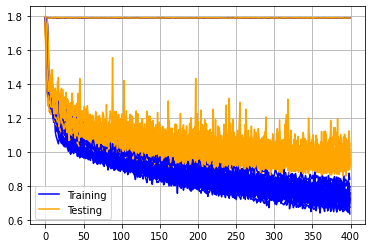

In [7]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [8]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.0607624053955078
mean accuracy:  0.5672034753859043


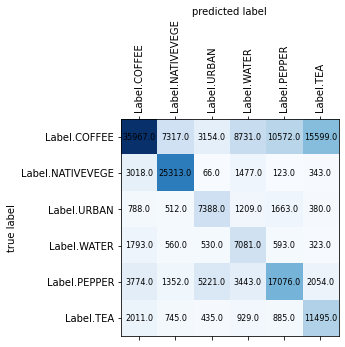

In [9]:
plot_confusion_matrix(conf_matrix, labels)

In [10]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.75958269 0.70708679 0.43991902 0.30961959 0.55240683 0.38070478]
Recalls:  [0.44218097 0.83431114 0.61876047 0.65082721 0.51871203 0.69666667]
F-Score:  [0.55896683 0.76544853 0.51423401 0.41961481 0.53502945 0.49235448]


# NIR, SWIR2, COASTAL_AEROSOL

In [11]:
BANDS = [
    Band.NIR.value,
    Band.SWIR2.value,
    Band.COASTAL_AEROSOL.value
]

In [12]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9956 - accuracy: 0.4823 - val_loss: 1.2242 - val_accuracy: 0.4614
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0508 - accuracy: 0.4577 - val_loss: 1.1372 - val_accuracy: 0.5117
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0230 - accuracy: 0.4802 - val_loss: 1.1629 - val_accuracy: 0.4880
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0369 - accuracy: 0.4877 - val_loss: 1.1348 - val_accuracy: 0.4984
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9998 - accuracy: 0.4937 - val_loss: 1.1148 - val_accuracy: 0.5272
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9899 - accuracy: 0.5012 - val_loss: 1.0955 - val_accuracy: 0.5135
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9872 - accuracy: 0.5112 - val_loss: 1.1551 - val_accuracy: 0.4958
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8961 - accuracy: 0.5460 - val_loss: 1.0114 - val_accuracy: 0.5722
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9092 - accuracy: 0.5350 - val_loss: 1.0158 - val_accuracy: 0.5647
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7929 - accuracy: 0.6012 - val_loss: 1.0224 - val_accuracy: 0.5674
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8638 - accuracy: 0.5583 - val_loss: 1.0892 - val_accuracy: 0.5358
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8715 - accuracy: 0.5706 - val_loss: 0.9985 - val_accuracy: 0.5918
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8772 - accuracy: 0.5848 - val_loss: 1.0551 - val_accuracy: 0.5538
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8537 - accuracy: 0.5280 - val_loss: 1.0423 - val_accuracy: 0.5763
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7506 - accuracy: 0.5895 - val_loss: 0.9962 - val_accuracy: 0.5677
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7999 - accuracy: 0.5701 - val_loss: 0.9747 - val_accuracy: 0.5803
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7860 - accuracy: 0.5743 - val_loss: 0.9943 - val_accuracy: 0.5642
Epoch 277/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8406 - accuracy: 0.5864 - val_loss: 1.0032 - val_accuracy: 0.5687
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7793 - accuracy: 0.6008 - val_loss: 1.0195 - val_accuracy: 0.5731
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7659 - accuracy: 0.5800 - val_loss: 0.9810 - val_accuracy: 0.5928
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8033 - accuracy: 0.6012 - val_loss: 0.9773 - val_accuracy: 0.5914
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7282 - accuracy: 0.6050 - val_loss: 0.9383 - val_accuracy: 0.6172
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7347 - accuracy: 0.5943 - val_loss: 0.9808 - val_accuracy: 0.5893
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7774 - accuracy: 0.5961 - val_loss: 0.9576 - val_accuracy: 0.6134
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7255 - accuracy: 0.6085 - val_loss: 0.9724 - val_accuracy: 0.6082
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7989 - accuracy: 0.5652 - val_loss: 0.9737 - val_accuracy: 0.6138
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7298 - accuracy: 0.5967 - val_loss: 0.9820 - val_accuracy: 0.6032
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7837 - accuracy: 0.5939 - val_loss: 0.9738 - val_accuracy: 0.5851
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9585 - accuracy: 0.5106 - val_loss: 1.1728 - val_accuracy: 0.4702
Epoch 99/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9678 - accuracy: 0.4861 - val_loss: 1.1055 - val_accuracy: 0.5036
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9361 - accuracy: 0.5090 - val_loss: 1.1674 - val_accuracy: 0.4971
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9653 - accuracy: 0.5185 - val_loss: 1.1273 - val_accuracy: 0.4903
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9909 - accuracy: 0.5030 - val_loss: 1.0269 - val_accuracy: 0.5688
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0003 - accuracy: 0.5146 - val_loss: 1.0593 - val_accuracy: 0.5433
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9864 - accuracy: 0.5175 - val_loss: 1.0675 - val_accuracy: 0.5294
E

57/57 [==============================] - 0s 8ms/step - loss: 0.7544 - accuracy: 0.5753 - val_loss: 1.0557 - val_accuracy: 0.5191
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7860 - accuracy: 0.5649 - val_loss: 1.1314 - val_accuracy: 0.4776
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8322 - accuracy: 0.5241 - val_loss: 1.0341 - val_accuracy: 0.5331
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7892 - accuracy: 0.5750 - val_loss: 1.0242 - val_accuracy: 0.5399
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8855 - accuracy: 0.5526 - val_loss: 1.0128 - val_accuracy: 0.5589
Epoch 217/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9011 - accuracy: 0.5426 - val_loss: 1.0054 - val_accuracy: 0.5739
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7827 - accuracy: 0.6011 - val_loss: 1.0286 - val_accuracy: 0.5581
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7657 - accuracy: 0.6003 - val_loss: 0.9455 - val_accuracy: 0.6015
Epoch 327/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7421 - accuracy: 0.6114 - val_loss: 0.9766 - val_accuracy: 0.6021
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7893 - accuracy: 0.6031 - val_loss: 1.1022 - val_accuracy: 0.5372
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7958 - accuracy: 0.6080 - val_loss: 0.9555 - val_accuracy: 0.6096
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6862 - accuracy: 0.6206 - val_loss: 1.0043 - val_accuracy: 0.5728
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8189 - accuracy: 0.5579 - val_loss: 0.9948 - val_accuracy: 0.5775
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7507 - accuracy: 0.6186 - val_loss: 0.9745 - val_accuracy: 0.5895
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1125 - accuracy: 0.4096 - val_loss: 1.1645 - val_accuracy: 0.4673
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0703 - accuracy: 0.4275 - val_loss: 1.1480 - val_accuracy: 0.4828
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0201 - accuracy: 0.4524 - val_loss: 1.1233 - val_accuracy: 0.5047
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0711 - accuracy: 0.4600 - val_loss: 1.1445 - val_accuracy: 0.4846
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0554 - accuracy: 0.4395 - val_loss: 1.1675 - val_accuracy: 0.4677
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0652 - accuracy: 0.4276 - val_loss: 1.1501 - val_accuracy: 0.4810
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0872 - accuracy: 0.4463 - val_loss: 1.1722 - val_accuracy: 0.4798
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9274 - accuracy: 0.5853 - val_loss: 1.0603 - val_accuracy: 0.5539
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9257 - accuracy: 0.5716 - val_loss: 1.0770 - val_accuracy: 0.5540
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9645 - accuracy: 0.5295 - val_loss: 1.0284 - val_accuracy: 0.5894
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9173 - accuracy: 0.5749 - val_loss: 1.0451 - val_accuracy: 0.5669
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9263 - accuracy: 0.5628 - val_loss: 1.0894 - val_accuracy: 0.5630
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8797 - accuracy: 0.5720 - val_loss: 1.0610 - val_accuracy: 0.5714
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9353 - accuracy: 0.5683 - val_loss: 1.1198 - val_accuracy: 0.5466
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8408 - accuracy: 0.5634 - val_loss: 1.0797 - val_accuracy: 0.5326
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8965 - accuracy: 0.5646 - val_loss: 0.9599 - val_accuracy: 0.5948
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8488 - accuracy: 0.6036 - val_loss: 1.0025 - val_accuracy: 0.5775
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8376 - accuracy: 0.6012 - val_loss: 0.9560 - val_accuracy: 0.6023
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8074 - accuracy: 0.6228 - val_loss: 1.0165 - val_accuracy: 0.5683
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8414 - accuracy: 0.5451 - val_loss: 0.9539 - val_accuracy: 0.6106
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8704 - accuracy: 0.5873 - val_loss: 1.0185 - val_accuracy: 0.5759
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7626 - accuracy: 0.5944 - val_loss: 0.9389 - val_accuracy: 0.6114
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8057 - accuracy: 0.6046 - val_loss: 0.9818 - val_accuracy: 0.6023
Epoch 323/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7786 - accuracy: 0.5927 - val_loss: 0.9284 - val_accuracy: 0.6274
Epoch 324/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7626 - accuracy: 0.6052 - val_loss: 0.9502 - val_accuracy: 0.6111
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7671 - accuracy: 0.6377 - val_loss: 1.0065 - val_accuracy: 0.5843
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7551 - accuracy: 0.6267 - val_loss: 1.0776 - val_accuracy: 0.5714
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8167 - accuracy: 0.6068 - val_loss: 0.9881 - val_accuracy: 0.6008
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2384 - accuracy: 0.3567 - val_loss: 1.1743 - val_accuracy: 0.4244
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1167 - accuracy: 0.4058 - val_loss: 1.1567 - val_accuracy: 0.4533
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0766 - accuracy: 0.4039 - val_loss: 1.1654 - val_accuracy: 0.4324
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0521 - accuracy: 0.4160 - val_loss: 1.1746 - val_accuracy: 0.4650
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0950 - accuracy: 0.4241 - val_loss: 1.2236 - val_accuracy: 0.3839
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0392 - accuracy: 0.4212 - val_loss: 1.1309 - val_accuracy: 0.4684
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0732 - accuracy: 0.4429 - val_loss: 1.2162 - val_accuracy: 0.4442
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9188 - accuracy: 0.5273 - val_loss: 1.0519 - val_accuracy: 0.5706
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9797 - accuracy: 0.5399 - val_loss: 1.0855 - val_accuracy: 0.5705
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9833 - accuracy: 0.5016 - val_loss: 1.0438 - val_accuracy: 0.5729
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8929 - accuracy: 0.5675 - val_loss: 1.1359 - val_accuracy: 0.5145
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9978 - accuracy: 0.5061 - val_loss: 1.1194 - val_accuracy: 0.5120
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0589 - accuracy: 0.4903 - val_loss: 1.0477 - val_accuracy: 0.5744
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9203 - accuracy: 0.5527 - val_loss: 1.1140 - val_accuracy: 0.5289
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9275 - accuracy: 0.5614 - val_loss: 0.9635 - val_accuracy: 0.6107
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9139 - accuracy: 0.5890 - val_loss: 0.9927 - val_accuracy: 0.5901
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8568 - accuracy: 0.5766 - val_loss: 0.9871 - val_accuracy: 0.6028
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8286 - accuracy: 0.5699 - val_loss: 1.0262 - val_accuracy: 0.5721
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8448 - accuracy: 0.5634 - val_loss: 0.9861 - val_accuracy: 0.5964
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8808 - accuracy: 0.5545 - val_loss: 1.0137 - val_accuracy: 0.5638
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9196 - accuracy: 0.5660 - val_loss: 0.9685 - val_accuracy: 0.6000
Epoch 209/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7910 - accuracy: 0.5993 - val_loss: 1.0065 - val_accuracy: 0.5894
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7832 - accuracy: 0.6105 - val_loss: 0.9783 - val_accuracy: 0.5973
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8170 - accuracy: 0.5939 - val_loss: 0.9767 - val_accuracy: 0.6019
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7652 - accuracy: 0.6208 - val_loss: 0.9682 - val_accuracy: 0.6039
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8320 - accuracy: 0.5868 - val_loss: 1.0084 - val_accuracy: 0.5761
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7646 - accuracy: 0.5910 - val_loss: 1.0094 - val_accuracy: 0.5699
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8026 - accuracy: 0.5747 - val_loss: 0.9461 - val_accuracy: 0.6243
Epoch 323/400

57/57 [==============================] - 0s 9ms/step - loss: 1.0335 - accuracy: 0.4947 - val_loss: 1.1719 - val_accuracy: 0.4714
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1082 - accuracy: 0.4438 - val_loss: 1.1273 - val_accuracy: 0.4907
Epoch 27/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0771 - accuracy: 0.4602 - val_loss: 1.1107 - val_accuracy: 0.5085
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0459 - accuracy: 0.4952 - val_loss: 1.1500 - val_accuracy: 0.4850
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0232 - accuracy: 0.4861 - val_loss: 1.3491 - val_accuracy: 0.3775
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0248 - accuracy: 0.4786 - val_loss: 1.1714 - val_accuracy: 0.4761
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0055 - accuracy: 0.4944 - val_loss: 1.1358 - val_accuracy: 0.4953
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8738 - accuracy: 0.5518 - val_loss: 1.1507 - val_accuracy: 0.4859
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9414 - accuracy: 0.5096 - val_loss: 1.1176 - val_accuracy: 0.5282
Epoch 85/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9196 - accuracy: 0.5478 - val_loss: 1.1164 - val_accuracy: 0.5373
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8776 - accuracy: 0.5565 - val_loss: 1.0698 - val_accuracy: 0.5562
Epoch 87/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8959 - accuracy: 0.5435 - val_loss: 1.0519 - val_accuracy: 0.5595
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9447 - accuracy: 0.5363 - val_loss: 1.0207 - val_accuracy: 0.5707
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9520 - accuracy: 0.5484 - val_loss: 1.0656 - val_accuracy: 0.5482
Epoch

57/57 [==============================] - 0s 8ms/step - loss: 0.8328 - accuracy: 0.5847 - val_loss: 1.1036 - val_accuracy: 0.5365
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8421 - accuracy: 0.5677 - val_loss: 1.0768 - val_accuracy: 0.5422
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8085 - accuracy: 0.5841 - val_loss: 1.1101 - val_accuracy: 0.5233
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7879 - accuracy: 0.5789 - val_loss: 1.1163 - val_accuracy: 0.5168
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8276 - accuracy: 0.5623 - val_loss: 1.0406 - val_accuracy: 0.5684
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8236 - accuracy: 0.5747 - val_loss: 1.0360 - val_accuracy: 0.5693
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8185 - accuracy: 0.5836 - val_loss: 1.0056 - val_accuracy: 0.6074
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7132 - accuracy: 0.6294 - val_loss: 1.0510 - val_accuracy: 0.5884
Epoch 312/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7876 - accuracy: 0.6293 - val_loss: 0.9887 - val_accuracy: 0.6125
Epoch 313/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7416 - accuracy: 0.6222 - val_loss: 1.0330 - val_accuracy: 0.5775
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7999 - accuracy: 0.6144 - val_loss: 1.0202 - val_accuracy: 0.6017
Epoch 315/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7043 - accuracy: 0.6355 - val_loss: 1.0182 - val_accuracy: 0.5834
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7389 - accuracy: 0.6414 - val_loss: 1.0556 - val_accuracy: 0.5652
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7231 - accuracy: 0.6374 - val_loss: 1.0129 - val_accuracy: 0.5853
Epoch 318/400

57/57 [==============================] - 0s 9ms/step - loss: 1.0565 - accuracy: 0.4563 - val_loss: 1.1536 - val_accuracy: 0.4683
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0513 - accuracy: 0.4505 - val_loss: 1.2360 - val_accuracy: 0.3972
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1369 - accuracy: 0.4249 - val_loss: 1.2637 - val_accuracy: 0.4409
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0695 - accuracy: 0.4625 - val_loss: 1.2121 - val_accuracy: 0.4448
Epoch 24/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0410 - accuracy: 0.4795 - val_loss: 1.4374 - val_accuracy: 0.3704
Epoch 25/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0694 - accuracy: 0.4367 - val_loss: 1.1677 - val_accuracy: 0.4437
Epoch 26/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0945 - accuracy: 0.4557 - val_loss: 1.1184 - val_accuracy: 0.5288
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9091 - accuracy: 0.5367 - val_loss: 1.2620 - val_accuracy: 0.4464
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9498 - accuracy: 0.4930 - val_loss: 1.1087 - val_accuracy: 0.4989
Epoch 80/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9506 - accuracy: 0.5215 - val_loss: 1.1105 - val_accuracy: 0.5295
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9467 - accuracy: 0.5100 - val_loss: 1.1543 - val_accuracy: 0.4744
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9613 - accuracy: 0.5376 - val_loss: 1.0736 - val_accuracy: 0.5303
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9137 - accuracy: 0.5323 - val_loss: 1.1404 - val_accuracy: 0.5279
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9532 - accuracy: 0.5225 - val_loss: 1.1792 - val_accuracy: 0.4316
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8185 - accuracy: 0.5816 - val_loss: 1.0543 - val_accuracy: 0.5253
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8396 - accuracy: 0.5528 - val_loss: 1.0415 - val_accuracy: 0.5631
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8246 - accuracy: 0.5639 - val_loss: 1.0182 - val_accuracy: 0.5737
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8595 - accuracy: 0.5593 - val_loss: 1.0100 - val_accuracy: 0.5688
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8020 - accuracy: 0.5596 - val_loss: 1.0514 - val_accuracy: 0.5351
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8817 - accuracy: 0.5442 - val_loss: 1.0235 - val_accuracy: 0.5431
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7932 - accuracy: 0.6077 - val_loss: 1.1157 - val_accuracy: 0.4902
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7506 - accuracy: 0.6013 - val_loss: 1.0055 - val_accuracy: 0.5549
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7694 - accuracy: 0.6165 - val_loss: 0.9855 - val_accuracy: 0.5858
Epoch 308/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7080 - accuracy: 0.6049 - val_loss: 1.0268 - val_accuracy: 0.5663
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7336 - accuracy: 0.5937 - val_loss: 1.1213 - val_accuracy: 0.5220
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8279 - accuracy: 0.5754 - val_loss: 1.0261 - val_accuracy: 0.5489
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6987 - accuracy: 0.6015 - val_loss: 0.9973 - val_accuracy: 0.5682
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7364 - accuracy: 0.5810 - val_loss: 1.0213 - val_accuracy: 0.5563
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0839 - accuracy: 0.4543 - val_loss: 1.1622 - val_accuracy: 0.4774
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0743 - accuracy: 0.4867 - val_loss: 1.1505 - val_accuracy: 0.4532
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0644 - accuracy: 0.4779 - val_loss: 1.1442 - val_accuracy: 0.4511
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0704 - accuracy: 0.4674 - val_loss: 1.1591 - val_accuracy: 0.5025
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0552 - accuracy: 0.4980 - val_loss: 1.2234 - val_accuracy: 0.4135
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1161 - accuracy: 0.4475 - val_loss: 1.1502 - val_accuracy: 0.4473
Epoch 21/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0364 - accuracy: 0.4725 - val_loss: 1.1718 - val_accuracy: 0.4596
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9394 - accuracy: 0.5781 - val_loss: 1.0913 - val_accuracy: 0.5532
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9761 - accuracy: 0.5849 - val_loss: 1.1415 - val_accuracy: 0.5054
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9452 - accuracy: 0.5828 - val_loss: 1.0493 - val_accuracy: 0.5676
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9571 - accuracy: 0.5562 - val_loss: 1.2839 - val_accuracy: 0.4568
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0394 - accuracy: 0.5041 - val_loss: 1.0463 - val_accuracy: 0.5631
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9429 - accuracy: 0.5733 - val_loss: 1.0898 - val_accuracy: 0.5419
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9289 - accuracy: 0.5599 - val_loss: 1.1003 - val_accuracy: 0.5345
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9135 - accuracy: 0.5836 - val_loss: 1.0594 - val_accuracy: 0.5634
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8305 - accuracy: 0.6198 - val_loss: 0.9780 - val_accuracy: 0.6174
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9118 - accuracy: 0.5707 - val_loss: 0.9741 - val_accuracy: 0.6189
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8744 - accuracy: 0.5737 - val_loss: 0.9796 - val_accuracy: 0.6126
Epoch 191/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8440 - accuracy: 0.6101 - val_loss: 1.0818 - val_accuracy: 0.5604
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8483 - accuracy: 0.6002 - val_loss: 1.0914 - val_accuracy: 0.5627
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8706 - accuracy: 0.5946 - val_loss: 0.9966 - val_accuracy: 0.6163
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7707 - accuracy: 0.6085 - val_loss: 0.9882 - val_accuracy: 0.6047
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8206 - accuracy: 0.6195 - val_loss: 0.9224 - val_accuracy: 0.6288
Epoch 303/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7761 - accuracy: 0.6234 - val_loss: 0.9719 - val_accuracy: 0.6160
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8112 - accuracy: 0.6177 - val_loss: 1.0216 - val_accuracy: 0.5807
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8030 - accuracy: 0.6103 - val_loss: 1.0019 - val_accuracy: 0.5968
Epoch 306/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7853 - accuracy: 0.6427 - val_loss: 1.0038 - val_accuracy: 0.5971
Epoch 307/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7808 - accuracy: 0.6465 - val_loss: 1.1060 - val_accuracy: 0.5553
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2188 - accuracy: 0.3814 - val_loss: 1.3123 - val_accuracy: 0.3810
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1953 - accuracy: 0.3890 - val_loss: 1.3138 - val_accuracy: 0.3923
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2107 - accuracy: 0.4025 - val_loss: 1.2206 - val_accuracy: 0.4246
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1559 - accuracy: 0.4070 - val_loss: 1.2270 - val_accuracy: 0.4207
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0497 - accuracy: 0.4541 - val_loss: 1.1630 - val_accuracy: 0.4571
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0709 - accuracy: 0.4295 - val_loss: 1.1850 - val_accuracy: 0.4741
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9931 - accuracy: 0.4389 - val_loss: 1.2602 - val_accuracy: 0.3775
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9584 - accuracy: 0.5369 - val_loss: 1.1204 - val_accuracy: 0.5037
Epoch 69/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8839 - accuracy: 0.5803 - val_loss: 1.1150 - val_accuracy: 0.5502
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9079 - accuracy: 0.5354 - val_loss: 1.1611 - val_accuracy: 0.5218
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9348 - accuracy: 0.5513 - val_loss: 1.0870 - val_accuracy: 0.5357
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9965 - accuracy: 0.5383 - val_loss: 1.0953 - val_accuracy: 0.5417
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8807 - accuracy: 0.5739 - val_loss: 1.0917 - val_accuracy: 0.5415
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9016 - accuracy: 0.5331 - val_loss: 1.1515 - val_accuracy: 0.5316
Epoch 

57/57 [==============================] - 0s 9ms/step - loss: 0.8277 - accuracy: 0.5923 - val_loss: 1.0440 - val_accuracy: 0.5335
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7845 - accuracy: 0.5617 - val_loss: 1.0569 - val_accuracy: 0.5687
Epoch 184/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8028 - accuracy: 0.5862 - val_loss: 0.9551 - val_accuracy: 0.6113
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7782 - accuracy: 0.6004 - val_loss: 1.0421 - val_accuracy: 0.5819
Epoch 186/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8269 - accuracy: 0.5915 - val_loss: 0.9997 - val_accuracy: 0.5962
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8220 - accuracy: 0.5701 - val_loss: 0.9898 - val_accuracy: 0.5784
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7916 - accuracy: 0.6161 - val_loss: 1.0387 - val_accuracy: 0.5433
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7569 - accuracy: 0.6355 - val_loss: 0.9820 - val_accuracy: 0.5847
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7239 - accuracy: 0.6154 - val_loss: 1.0479 - val_accuracy: 0.5368
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7285 - accuracy: 0.6080 - val_loss: 1.0413 - val_accuracy: 0.5463
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7672 - accuracy: 0.5907 - val_loss: 1.0422 - val_accuracy: 0.5464
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7650 - accuracy: 0.5699 - val_loss: 0.9388 - val_accuracy: 0.6195
Epoch 301/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7103 - accuracy: 0.6441 - val_loss: 0.9697 - val_accuracy: 0.5977
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7360 - accuracy: 0.6340 - val_loss: 1.0128 - val_accuracy: 0.5672
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8044 - accuracy: 0.1559 - val_loss: 1.7918 - val_accuracy: 0.1815
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8600 - accuracy: 0.1375 - val_loss: 1.7928 - val_accuracy: 0.0879
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7645 - accuracy: 0.1986 - val_loss: 1.7902 - val_accuracy: 0.4386
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8188 - accuracy: 0.1570 - val_loss: 1.7717 - val_accuracy: 0.1675
Epoch 9/400
57/57 [==============================] - 0s 9ms/step - loss: 1.7326 - accuracy: 0.1880 - val_loss: 1.6267 - val_accuracy: 0.2462
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5133 - accuracy: 0.2658 - val_loss: 1.6195 - val_accuracy: 0.2725
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5259 - accuracy: 0.2363 - val_loss: 1.5060 - val_accuracy: 0.3240
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0514 - accuracy: 0.4662 - val_loss: 1.1823 - val_accuracy: 0.4654
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0828 - accuracy: 0.4397 - val_loss: 1.1016 - val_accuracy: 0.5179
Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0316 - accuracy: 0.4914 - val_loss: 1.1409 - val_accuracy: 0.5081
Epoch 66/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0544 - accuracy: 0.4830 - val_loss: 1.1524 - val_accuracy: 0.5075
Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0372 - accuracy: 0.4745 - val_loss: 1.1329 - val_accuracy: 0.5146
Epoch 68/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0872 - accuracy: 0.4819 - val_loss: 1.1158 - val_accuracy: 0.5248
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0894 - accuracy: 0.4654 - val_loss: 1.0919 - val_accuracy: 0.5156
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9850 - accuracy: 0.5394 - val_loss: 1.0243 - val_accuracy: 0.5735
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9166 - accuracy: 0.5548 - val_loss: 1.0506 - val_accuracy: 0.5529
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8994 - accuracy: 0.5463 - val_loss: 1.0318 - val_accuracy: 0.5589
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9374 - accuracy: 0.5494 - val_loss: 1.0393 - val_accuracy: 0.5633
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8862 - accuracy: 0.5432 - val_loss: 1.0639 - val_accuracy: 0.5577
Epoch 182/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9015 - accuracy: 0.5378 - val_loss: 1.0462 - val_accuracy: 0.5531
Epoch 183/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8791 - accuracy: 0.5443 - val_loss: 1.0564 - val_accuracy: 0.5543
Epoch 184/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8596 - accuracy: 0.5623 - val_loss: 1.0265 - val_accuracy: 0.5869
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8464 - accuracy: 0.5736 - val_loss: 0.9757 - val_accuracy: 0.5948
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8410 - accuracy: 0.5648 - val_loss: 1.0123 - val_accuracy: 0.5837
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8171 - accuracy: 0.5850 - val_loss: 1.0085 - val_accuracy: 0.5914
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8242 - accuracy: 0.5686 - val_loss: 0.9896 - val_accuracy: 0.6058
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8465 - accuracy: 0.5706 - val_loss: 1.0222 - val_accuracy: 0.5782
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9170 - accuracy: 0.5351 - val_loss: 1.0164 - val_accuracy: 0.5668
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7431 - accuracy: 0.3538 - val_loss: 1.7873 - val_accuracy: 0.4779
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8289 - accuracy: 0.2116 - val_loss: 1.7560 - val_accuracy: 0.2135
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6790 - accuracy: 0.2267 - val_loss: 1.4994 - val_accuracy: 0.3696
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4916 - accuracy: 0.3004 - val_loss: 1.4623 - val_accuracy: 0.3897
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4413 - accuracy: 0.3335 - val_loss: 1.4621 - val_accuracy: 0.3393
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3900 - accuracy: 0.3307 - val_loss: 1.4412 - val_accuracy: 0.3314
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3567 - accuracy: 0.3574 - val_loss: 1.4267 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0637 - accuracy: 0.4222 - val_loss: 1.1766 - val_accuracy: 0.4789
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1248 - accuracy: 0.4411 - val_loss: 1.1903 - val_accuracy: 0.4498
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1237 - accuracy: 0.4026 - val_loss: 1.1716 - val_accuracy: 0.4526
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0395 - accuracy: 0.4205 - val_loss: 1.1874 - val_accuracy: 0.4608
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0803 - accuracy: 0.4324 - val_loss: 1.1740 - val_accuracy: 0.4513
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0393 - accuracy: 0.4227 - val_loss: 1.1722 - val_accuracy: 0.4600
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0849 - accuracy: 0.4463 - val_loss: 1.1474 - val_accuracy: 0.4789

57/57 [==============================] - 0s 8ms/step - loss: 0.9568 - accuracy: 0.4726 - val_loss: 1.1544 - val_accuracy: 0.4589
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8972 - accuracy: 0.4739 - val_loss: 1.1900 - val_accuracy: 0.4548
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9870 - accuracy: 0.4767 - val_loss: 1.1002 - val_accuracy: 0.5051
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9638 - accuracy: 0.4602 - val_loss: 1.1291 - val_accuracy: 0.4965
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9544 - accuracy: 0.4934 - val_loss: 1.1018 - val_accuracy: 0.5040
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9616 - accuracy: 0.4882 - val_loss: 1.0882 - val_accuracy: 0.5096
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9389 - accuracy: 0.4891 - val_loss: 1.1026 - val_accuracy: 0.5112
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8668 - accuracy: 0.5039 - val_loss: 1.1154 - val_accuracy: 0.5051
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8607 - accuracy: 0.5020 - val_loss: 1.0754 - val_accuracy: 0.5224
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9046 - accuracy: 0.5054 - val_loss: 1.0785 - val_accuracy: 0.5210
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8733 - accuracy: 0.5243 - val_loss: 1.1007 - val_accuracy: 0.4975
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8772 - accuracy: 0.4918 - val_loss: 1.0473 - val_accuracy: 0.5433
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8566 - accuracy: 0.5389 - val_loss: 1.0699 - val_accuracy: 0.5198
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8599 - accuracy: 0.5411 - val_loss: 1.0767 - val_accuracy: 0.5273
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7821 - accuracy: 0.2141 - val_loss: 1.7884 - val_accuracy: 0.1665
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7727 - accuracy: 0.2486 - val_loss: 1.7915 - val_accuracy: 0.1665
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7955 - accuracy: 0.1537 - val_loss: 1.7917 - val_accuracy: 0.1665
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8784 - accuracy: 0.1031 - val_loss: 1.7917 - val_accuracy: 0.1665
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8058 - accuracy: 0.1379 - val_loss: 1.7909 - val_accuracy: 0.0609
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7569 - accuracy: 0.1603 - val_loss: 1.7921 - val_accuracy: 0.1665
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8150 - accuracy: 0.1187 - val_loss: 1.7927 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8078 - accuracy: 0.1166 - val_loss: 1.7911 - val_accuracy: 0.4415
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8295 - accuracy: 0.1214 - val_loss: 1.7921 - val_accuracy: 0.1784
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7747 - accuracy: 0.1917 - val_loss: 1.7916 - val_accuracy: 0.1784
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8222 - accuracy: 0.1014 - val_loss: 1.7917 - val_accuracy: 0.0644
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7828 - accuracy: 0.1236 - val_loss: 1.7911 - val_accuracy: 0.0882
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8002 - accuracy: 0.1417 - val_loss: 1.7919 - val_accuracy: 0.0644
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7721 - accuracy: 0.0743 - val_loss: 1.7918 - val_accuracy: 0.0644

57/57 [==============================] - 0s 8ms/step - loss: 1.7844 - accuracy: 0.1822 - val_loss: 1.7917 - val_accuracy: 0.0882
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8038 - accuracy: 0.1146 - val_loss: 1.7913 - val_accuracy: 0.4415
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7981 - accuracy: 0.1569 - val_loss: 1.7919 - val_accuracy: 0.0609
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7881 - accuracy: 0.1324 - val_loss: 1.7921 - val_accuracy: 0.0609
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8222 - accuracy: 0.0686 - val_loss: 1.7932 - val_accuracy: 0.0609
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8178 - accuracy: 0.0602 - val_loss: 1.7922 - val_accuracy: 0.0644
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7816 - accuracy: 0.0539 - val_loss: 1.7922 - val_accuracy: 0.0609
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8405 - accuracy: 0.1845 - val_loss: 1.7921 - val_accuracy: 0.1784
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7387 - accuracy: 0.1943 - val_loss: 1.7914 - val_accuracy: 0.0882
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8258 - accuracy: 0.0938 - val_loss: 1.7915 - val_accuracy: 0.0882
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8322 - accuracy: 0.1640 - val_loss: 1.7909 - val_accuracy: 0.4415
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7748 - accuracy: 0.3934 - val_loss: 1.7914 - val_accuracy: 0.0882
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8081 - accuracy: 0.2829 - val_loss: 1.7915 - val_accuracy: 0.0609
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8023 - accuracy: 0.2638 - val_loss: 1.7922 - val_accuracy: 0.0882
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7970 - accuracy: 0.1211 - val_loss: 1.7682 - val_accuracy: 0.1734
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7870 - accuracy: 0.1708 - val_loss: 1.5224 - val_accuracy: 0.3072
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5267 - accuracy: 0.3030 - val_loss: 1.4218 - val_accuracy: 0.4117
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3959 - accuracy: 0.3978 - val_loss: 1.5291 - val_accuracy: 0.2761
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3343 - accuracy: 0.3160 - val_loss: 1.3516 - val_accuracy: 0.4192
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2911 - accuracy: 0.4185 - val_loss: 1.3656 - val_accuracy: 0.3402
Epoch 7/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2891 - accuracy: 0.3976 - val_loss: 1.3321 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9043 - accuracy: 0.5238 - val_loss: 1.1112 - val_accuracy: 0.5372
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8541 - accuracy: 0.5730 - val_loss: 1.0796 - val_accuracy: 0.5305
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8616 - accuracy: 0.5680 - val_loss: 1.0974 - val_accuracy: 0.5297
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8628 - accuracy: 0.5335 - val_loss: 1.0919 - val_accuracy: 0.5301
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9016 - accuracy: 0.5669 - val_loss: 1.1362 - val_accuracy: 0.5047
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9247 - accuracy: 0.5571 - val_loss: 1.0461 - val_accuracy: 0.5542
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9111 - accuracy: 0.5474 - val_loss: 1.0185 - val_accuracy: 0.5823

57/57 [==============================] - 0s 8ms/step - loss: 0.7174 - accuracy: 0.6208 - val_loss: 1.0962 - val_accuracy: 0.5519
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7345 - accuracy: 0.6010 - val_loss: 1.0148 - val_accuracy: 0.5883
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7875 - accuracy: 0.5998 - val_loss: 0.9593 - val_accuracy: 0.6285
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7497 - accuracy: 0.6279 - val_loss: 1.1200 - val_accuracy: 0.5519
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7536 - accuracy: 0.6077 - val_loss: 0.9501 - val_accuracy: 0.6250
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7789 - accuracy: 0.6135 - val_loss: 1.0199 - val_accuracy: 0.5951
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7809 - accuracy: 0.6407 - val_loss: 1.0687 - val_accuracy: 0.5547
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6837 - accuracy: 0.6122 - val_loss: 0.9687 - val_accuracy: 0.6242
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6971 - accuracy: 0.6287 - val_loss: 0.9443 - val_accuracy: 0.6346
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6917 - accuracy: 0.6323 - val_loss: 0.9407 - val_accuracy: 0.6329
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6234 - accuracy: 0.6725 - val_loss: 0.9581 - val_accuracy: 0.6195
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6820 - accuracy: 0.6365 - val_loss: 0.9958 - val_accuracy: 0.5994
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7193 - accuracy: 0.6155 - val_loss: 1.1016 - val_accuracy: 0.5430
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6987 - accuracy: 0.6241 - val_loss: 0.9908 - val_accuracy: 0.5948
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.7822 - accuracy: 0.1135 - val_loss: 1.7750 - val_accuracy: 0.1582
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7975 - accuracy: 0.2082 - val_loss: 1.6363 - val_accuracy: 0.2464
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5578 - accuracy: 0.3192 - val_loss: 1.4729 - val_accuracy: 0.2984
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.4392 - accuracy: 0.3137 - val_loss: 1.4484 - val_accuracy: 0.2776
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3865 - accuracy: 0.3116 - val_loss: 1.3805 - val_accuracy: 0.3688
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4050 - accuracy: 0.3654 - val_loss: 1.3760 - val_accuracy: 0.3447
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4023 - accuracy: 0.3536 - val_loss: 1.3403 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9607 - accuracy: 0.5564 - val_loss: 1.0662 - val_accuracy: 0.5513
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9658 - accuracy: 0.5599 - val_loss: 1.1928 - val_accuracy: 0.4718
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0151 - accuracy: 0.4805 - val_loss: 1.0694 - val_accuracy: 0.5573
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9227 - accuracy: 0.5720 - val_loss: 1.1382 - val_accuracy: 0.5060
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9568 - accuracy: 0.5270 - val_loss: 1.1262 - val_accuracy: 0.5273
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9332 - accuracy: 0.5222 - val_loss: 1.1681 - val_accuracy: 0.4770
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9684 - accuracy: 0.5389 - val_loss: 1.0994 - val_accuracy: 0.5328

57/57 [==============================] - 0s 8ms/step - loss: 0.8246 - accuracy: 0.5539 - val_loss: 1.0934 - val_accuracy: 0.5343
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8064 - accuracy: 0.5842 - val_loss: 1.0504 - val_accuracy: 0.5712
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8607 - accuracy: 0.5938 - val_loss: 1.0476 - val_accuracy: 0.5729
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8254 - accuracy: 0.5955 - val_loss: 1.0509 - val_accuracy: 0.5765
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8565 - accuracy: 0.5473 - val_loss: 1.0290 - val_accuracy: 0.5899
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8598 - accuracy: 0.5774 - val_loss: 1.0457 - val_accuracy: 0.5699
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8268 - accuracy: 0.5889 - val_loss: 1.1347 - val_accuracy: 0.5210
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7814 - accuracy: 0.5973 - val_loss: 0.9884 - val_accuracy: 0.5956
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7905 - accuracy: 0.6049 - val_loss: 0.9985 - val_accuracy: 0.5948
Epoch 346/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7501 - accuracy: 0.6049 - val_loss: 1.0353 - val_accuracy: 0.5687
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7941 - accuracy: 0.6018 - val_loss: 1.0106 - val_accuracy: 0.5884
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7297 - accuracy: 0.6080 - val_loss: 0.9952 - val_accuracy: 0.5884
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8219 - accuracy: 0.5742 - val_loss: 1.0105 - val_accuracy: 0.5955
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7417 - accuracy: 0.6050 - val_loss: 1.0128 - val_accuracy: 0.5879
Epoch 351/40


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7654 - accuracy: 0.1866 - val_loss: 1.7853 - val_accuracy: 0.2822
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7443 - accuracy: 0.2415 - val_loss: 1.5330 - val_accuracy: 0.3077
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5156 - accuracy: 0.2961 - val_loss: 1.4735 - val_accuracy: 0.3361
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4225 - accuracy: 0.3888 - val_loss: 1.3351 - val_accuracy: 0.4278
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3919 - accuracy: 0.3359 - val_loss: 1.4042 - val_accuracy: 0.4170
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2531 - accuracy: 0.4322 - val_loss: 1.2462 - val_accuracy: 0.4552
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2411 - accuracy: 0.3963 - val_loss: 1.2451 - val_accuracy

57/57 [==============================] - 0s 8ms/step - loss: 0.8685 - accuracy: 0.5250 - val_loss: 1.0685 - val_accuracy: 0.5608
Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9349 - accuracy: 0.5619 - val_loss: 1.0401 - val_accuracy: 0.5519
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9372 - accuracy: 0.5477 - val_loss: 1.1318 - val_accuracy: 0.5218
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9143 - accuracy: 0.5117 - val_loss: 1.0653 - val_accuracy: 0.5448
Epoch 119/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9284 - accuracy: 0.5417 - val_loss: 1.0183 - val_accuracy: 0.5756
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9234 - accuracy: 0.5462 - val_loss: 1.0710 - val_accuracy: 0.5539
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9670 - accuracy: 0.5221 - val_loss: 1.1020 - val_accuracy: 0.5497
Epoch 122/40

57/57 [==============================] - 0s 8ms/step - loss: 0.8047 - accuracy: 0.5884 - val_loss: 1.0904 - val_accuracy: 0.5534
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8301 - accuracy: 0.5663 - val_loss: 1.0572 - val_accuracy: 0.5452
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7866 - accuracy: 0.5907 - val_loss: 1.0361 - val_accuracy: 0.5713
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8367 - accuracy: 0.5834 - val_loss: 1.0577 - val_accuracy: 0.5584
Epoch 233/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8534 - accuracy: 0.5820 - val_loss: 1.0053 - val_accuracy: 0.5781
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8167 - accuracy: 0.5876 - val_loss: 1.0178 - val_accuracy: 0.5830
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7941 - accuracy: 0.6084 - val_loss: 0.9559 - val_accuracy: 0.6088
Epoch 236/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7273 - accuracy: 0.6138 - val_loss: 1.0037 - val_accuracy: 0.5721
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7827 - accuracy: 0.6022 - val_loss: 0.9998 - val_accuracy: 0.6015
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7597 - accuracy: 0.6118 - val_loss: 0.9799 - val_accuracy: 0.5945
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7527 - accuracy: 0.6206 - val_loss: 0.9756 - val_accuracy: 0.5990
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7445 - accuracy: 0.5879 - val_loss: 1.0227 - val_accuracy: 0.5770
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7469 - accuracy: 0.5970 - val_loss: 0.9798 - val_accuracy: 0.5998
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7220 - accuracy: 0.6146 - val_loss: 1.0030 - val_accuracy: 0.6060
Epoch 350/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2043 - accuracy: 0.3663 - val_loss: 1.2828 - val_accuracy: 0.4018
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1435 - accuracy: 0.3909 - val_loss: 1.3115 - val_accuracy: 0.3613
Epoch 54/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1735 - accuracy: 0.3799 - val_loss: 1.2339 - val_accuracy: 0.4184
Epoch 55/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1473 - accuracy: 0.3730 - val_loss: 1.2143 - val_accuracy: 0.4297
Epoch 56/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1535 - accuracy: 0.3891 - val_loss: 1.2350 - val_accuracy: 0.4036
Epoch 57/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1143 - accuracy: 0.4046 - val_loss: 1.2172 - val_accuracy: 0.4295
Epoch 58/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1888 - accuracy: 0.4077 - val_loss: 1.2520 - val_accuracy: 0.3989
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9820 - accuracy: 0.4864 - val_loss: 1.1313 - val_accuracy: 0.5153
Epoch 111/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0088 - accuracy: 0.5183 - val_loss: 1.1049 - val_accuracy: 0.5074
Epoch 112/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9282 - accuracy: 0.5255 - val_loss: 1.1447 - val_accuracy: 0.4997
Epoch 113/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0226 - accuracy: 0.4948 - val_loss: 1.1371 - val_accuracy: 0.5093
Epoch 114/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0407 - accuracy: 0.4628 - val_loss: 1.1813 - val_accuracy: 0.4790
Epoch 115/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9404 - accuracy: 0.5209 - val_loss: 1.1404 - val_accuracy: 0.4914
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9400 - accuracy: 0.5263 - val_loss: 1.1633 - val_accuracy: 0.4922

57/57 [==============================] - 0s 8ms/step - loss: 0.9061 - accuracy: 0.5310 - val_loss: 0.9770 - val_accuracy: 0.5926
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8416 - accuracy: 0.5829 - val_loss: 1.0449 - val_accuracy: 0.5606
Epoch 226/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8758 - accuracy: 0.5639 - val_loss: 1.0468 - val_accuracy: 0.5513
Epoch 227/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8387 - accuracy: 0.5782 - val_loss: 1.0251 - val_accuracy: 0.5592
Epoch 228/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8409 - accuracy: 0.5696 - val_loss: 1.0218 - val_accuracy: 0.5706
Epoch 229/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8639 - accuracy: 0.5781 - val_loss: 0.9920 - val_accuracy: 0.5918
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8562 - accuracy: 0.5601 - val_loss: 1.0317 - val_accuracy: 0.5637
Epoch 231/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8755 - accuracy: 0.5412 - val_loss: 1.0961 - val_accuracy: 0.5699
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8353 - accuracy: 0.5619 - val_loss: 1.0288 - val_accuracy: 0.5842
Epoch 340/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7814 - accuracy: 0.5814 - val_loss: 1.0312 - val_accuracy: 0.5778
Epoch 341/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7851 - accuracy: 0.5969 - val_loss: 1.0205 - val_accuracy: 0.5667
Epoch 342/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8183 - accuracy: 0.5678 - val_loss: 1.0126 - val_accuracy: 0.5653
Epoch 343/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8695 - accuracy: 0.5702 - val_loss: 1.0101 - val_accuracy: 0.5626
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8297 - accuracy: 0.5571 - val_loss: 1.0088 - val_accuracy: 0.5635
Epoch 345/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2090 - accuracy: 0.3394 - val_loss: 1.3046 - val_accuracy: 0.3579
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2362 - accuracy: 0.3647 - val_loss: 1.2456 - val_accuracy: 0.3736
Epoch 49/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2092 - accuracy: 0.3961 - val_loss: 1.2905 - val_accuracy: 0.3617
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2464 - accuracy: 0.3646 - val_loss: 1.2513 - val_accuracy: 0.3767
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2759 - accuracy: 0.3783 - val_loss: 1.2375 - val_accuracy: 0.3737
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2315 - accuracy: 0.3567 - val_loss: 1.2283 - val_accuracy: 0.3945
Epoch 53/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2021 - accuracy: 0.3998 - val_loss: 1.2413 - val_accuracy: 0.3959
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0395 - accuracy: 0.4883 - val_loss: 1.1067 - val_accuracy: 0.5383
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0674 - accuracy: 0.4949 - val_loss: 1.1647 - val_accuracy: 0.4830
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0160 - accuracy: 0.4627 - val_loss: 1.1981 - val_accuracy: 0.4640
Epoch 108/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0133 - accuracy: 0.4663 - val_loss: 1.1171 - val_accuracy: 0.5184
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0649 - accuracy: 0.4700 - val_loss: 1.1532 - val_accuracy: 0.4740
Epoch 110/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0561 - accuracy: 0.4680 - val_loss: 1.1134 - val_accuracy: 0.5056
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0233 - accuracy: 0.4900 - val_loss: 1.1184 - val_accuracy: 0.5154

57/57 [==============================] - 0s 9ms/step - loss: 0.8910 - accuracy: 0.5597 - val_loss: 0.9879 - val_accuracy: 0.5803
Epoch 220/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8934 - accuracy: 0.5399 - val_loss: 1.0081 - val_accuracy: 0.5608
Epoch 221/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8980 - accuracy: 0.5538 - val_loss: 1.0189 - val_accuracy: 0.5818
Epoch 222/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8823 - accuracy: 0.5700 - val_loss: 1.0000 - val_accuracy: 0.5908
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8843 - accuracy: 0.5799 - val_loss: 0.9799 - val_accuracy: 0.5967
Epoch 224/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8938 - accuracy: 0.5556 - val_loss: 0.9776 - val_accuracy: 0.5943
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8615 - accuracy: 0.5836 - val_loss: 1.0520 - val_accuracy: 0.5701
Epoch 226/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7966 - accuracy: 0.5713 - val_loss: 1.0106 - val_accuracy: 0.5787
Epoch 334/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8459 - accuracy: 0.6065 - val_loss: 0.9693 - val_accuracy: 0.6025
Epoch 335/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8125 - accuracy: 0.5896 - val_loss: 0.9562 - val_accuracy: 0.6033
Epoch 336/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8421 - accuracy: 0.6087 - val_loss: 1.0388 - val_accuracy: 0.5604
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7970 - accuracy: 0.5831 - val_loss: 1.0871 - val_accuracy: 0.5314
Epoch 338/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8007 - accuracy: 0.5692 - val_loss: 0.9916 - val_accuracy: 0.5958
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8220 - accuracy: 0.5574 - val_loss: 1.0828 - val_accuracy: 0.5396
Epoch 340/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0196 - accuracy: 0.5270 - val_loss: 1.0887 - val_accuracy: 0.5377
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9871 - accuracy: 0.5228 - val_loss: 1.1371 - val_accuracy: 0.4930
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9722 - accuracy: 0.5038 - val_loss: 1.1149 - val_accuracy: 0.5252
Epoch 45/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0602 - accuracy: 0.5102 - val_loss: 1.1686 - val_accuracy: 0.4742
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0285 - accuracy: 0.5067 - val_loss: 1.0971 - val_accuracy: 0.5358
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9823 - accuracy: 0.5299 - val_loss: 1.1065 - val_accuracy: 0.5376
Epoch 48/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0475 - accuracy: 0.5270 - val_loss: 1.0952 - val_accuracy: 0.5305
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9146 - accuracy: 0.6019 - val_loss: 1.0141 - val_accuracy: 0.5997
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9449 - accuracy: 0.5608 - val_loss: 1.1143 - val_accuracy: 0.5433
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9337 - accuracy: 0.5673 - val_loss: 1.0102 - val_accuracy: 0.5876
Epoch 103/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9295 - accuracy: 0.5715 - val_loss: 1.0351 - val_accuracy: 0.5731
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9168 - accuracy: 0.5705 - val_loss: 1.0549 - val_accuracy: 0.5566
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8789 - accuracy: 0.5704 - val_loss: 1.0429 - val_accuracy: 0.5710
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9181 - accuracy: 0.5632 - val_loss: 1.0483 - val_accuracy: 0.5707

57/57 [==============================] - 0s 8ms/step - loss: 0.7546 - accuracy: 0.6231 - val_loss: 1.0765 - val_accuracy: 0.5732
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7668 - accuracy: 0.6236 - val_loss: 0.9569 - val_accuracy: 0.6280
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7844 - accuracy: 0.6238 - val_loss: 0.9648 - val_accuracy: 0.6024
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7719 - accuracy: 0.6335 - val_loss: 1.0019 - val_accuracy: 0.6012
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7592 - accuracy: 0.6193 - val_loss: 0.9442 - val_accuracy: 0.6197
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7623 - accuracy: 0.6229 - val_loss: 1.1708 - val_accuracy: 0.5194
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7757 - accuracy: 0.6020 - val_loss: 1.0656 - val_accuracy: 0.5660
Epoch 221/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7325 - accuracy: 0.6697 - val_loss: 1.0570 - val_accuracy: 0.5910
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7194 - accuracy: 0.6455 - val_loss: 1.0206 - val_accuracy: 0.6070
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7187 - accuracy: 0.6667 - val_loss: 1.0256 - val_accuracy: 0.5862
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7307 - accuracy: 0.6352 - val_loss: 0.9183 - val_accuracy: 0.6524
Epoch 332/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7111 - accuracy: 0.6596 - val_loss: 1.0204 - val_accuracy: 0.5968
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7126 - accuracy: 0.6378 - val_loss: 0.9562 - val_accuracy: 0.6333
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7089 - accuracy: 0.6522 - val_loss: 0.9658 - val_accuracy: 0.6274
Epoch 335/400

57/57 [==============================] - 0s 9ms/step - loss: 1.0863 - accuracy: 0.4278 - val_loss: 1.1998 - val_accuracy: 0.4128
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0504 - accuracy: 0.4383 - val_loss: 1.1763 - val_accuracy: 0.4231
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1000 - accuracy: 0.4075 - val_loss: 1.2065 - val_accuracy: 0.4017
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0493 - accuracy: 0.4214 - val_loss: 1.2036 - val_accuracy: 0.4386
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0724 - accuracy: 0.4324 - val_loss: 1.1652 - val_accuracy: 0.4545
Epoch 42/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0175 - accuracy: 0.4623 - val_loss: 1.1808 - val_accuracy: 0.4545
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9877 - accuracy: 0.4492 - val_loss: 1.1799 - val_accuracy: 0.4496
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9842 - accuracy: 0.4753 - val_loss: 1.1267 - val_accuracy: 0.4872
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9357 - accuracy: 0.4892 - val_loss: 1.0737 - val_accuracy: 0.5222
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0242 - accuracy: 0.4816 - val_loss: 1.1395 - val_accuracy: 0.4620
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9602 - accuracy: 0.4733 - val_loss: 1.1688 - val_accuracy: 0.4876
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9994 - accuracy: 0.5008 - val_loss: 1.1378 - val_accuracy: 0.4737
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9135 - accuracy: 0.4777 - val_loss: 1.0923 - val_accuracy: 0.5138
Epoch 101/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9585 - accuracy: 0.4763 - val_loss: 1.1055 - val_accuracy: 0.4901
Epoc

57/57 [==============================] - 0s 9ms/step - loss: 0.8267 - accuracy: 0.5548 - val_loss: 1.0264 - val_accuracy: 0.5400
Epoch 210/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7986 - accuracy: 0.5732 - val_loss: 1.0884 - val_accuracy: 0.4896
Epoch 211/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8500 - accuracy: 0.5131 - val_loss: 1.0467 - val_accuracy: 0.5249
Epoch 212/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8175 - accuracy: 0.5228 - val_loss: 1.0266 - val_accuracy: 0.5451
Epoch 213/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8716 - accuracy: 0.5191 - val_loss: 0.9978 - val_accuracy: 0.5606
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8682 - accuracy: 0.5537 - val_loss: 1.0197 - val_accuracy: 0.5644
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8111 - accuracy: 0.5554 - val_loss: 1.0654 - val_accuracy: 0.5089
Epoch 216/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8250 - accuracy: 0.5591 - val_loss: 0.9783 - val_accuracy: 0.5759
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7559 - accuracy: 0.6113 - val_loss: 1.0371 - val_accuracy: 0.5326
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8352 - accuracy: 0.5613 - val_loss: 1.0565 - val_accuracy: 0.5221
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7968 - accuracy: 0.5800 - val_loss: 0.9456 - val_accuracy: 0.6049
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7457 - accuracy: 0.5833 - val_loss: 1.0427 - val_accuracy: 0.5320
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8119 - accuracy: 0.5513 - val_loss: 1.0186 - val_accuracy: 0.5650
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7397 - accuracy: 0.5737 - val_loss: 1.0199 - val_accuracy: 0.5475
Epoch 330/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1359 - accuracy: 0.3750 - val_loss: 1.3062 - val_accuracy: 0.3356
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2232 - accuracy: 0.3528 - val_loss: 1.5315 - val_accuracy: 0.2781
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2790 - accuracy: 0.3561 - val_loss: 1.2900 - val_accuracy: 0.3569
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1711 - accuracy: 0.3873 - val_loss: 1.2558 - val_accuracy: 0.3890
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2428 - accuracy: 0.3710 - val_loss: 1.2455 - val_accuracy: 0.3886
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2041 - accuracy: 0.3652 - val_loss: 1.2802 - val_accuracy: 0.3745
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2535 - accuracy: 0.3709 - val_loss: 1.2526 - val_accuracy: 0.3771
Epoch 39/400
57/57 

Epoch 90/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9172 - accuracy: 0.5368 - val_loss: 1.0796 - val_accuracy: 0.5444
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9532 - accuracy: 0.5338 - val_loss: 1.0678 - val_accuracy: 0.5612
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0090 - accuracy: 0.5237 - val_loss: 1.0491 - val_accuracy: 0.5684
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0026 - accuracy: 0.5269 - val_loss: 1.1444 - val_accuracy: 0.5075
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9906 - accuracy: 0.5360 - val_loss: 1.1105 - val_accuracy: 0.5364
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9975 - accuracy: 0.5129 - val_loss: 1.0582 - val_accuracy: 0.5491
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9673 - accuracy: 0.5378 - val_loss: 1.1820 - val_accuracy: 0.4997
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8159 - accuracy: 0.5699 - val_loss: 1.1102 - val_accuracy: 0.5218
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8021 - accuracy: 0.5553 - val_loss: 1.0085 - val_accuracy: 0.5789
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8723 - accuracy: 0.5503 - val_loss: 1.0231 - val_accuracy: 0.5747
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8514 - accuracy: 0.5823 - val_loss: 0.9705 - val_accuracy: 0.6176
Epoch 208/400
57/57 [==============================] - 1s 11ms/step - loss: 0.8081 - accuracy: 0.6029 - val_loss: 1.0478 - val_accuracy: 0.5646
Epoch 209/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8248 - accuracy: 0.5917 - val_loss: 1.1174 - val_accuracy: 0.5372
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8754 - accuracy: 0.5447 - val_loss: 0.9936 - val_accuracy: 0.5945
Epoch 211/40

57/57 [==============================] - 0s 8ms/step - loss: 0.7993 - accuracy: 0.5714 - val_loss: 1.0058 - val_accuracy: 0.5877
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7707 - accuracy: 0.5881 - val_loss: 0.9386 - val_accuracy: 0.6250
Epoch 320/400
57/57 [==============================] - 1s 14ms/step - loss: 0.7700 - accuracy: 0.5798 - val_loss: 0.9935 - val_accuracy: 0.5873
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7731 - accuracy: 0.5829 - val_loss: 0.9886 - val_accuracy: 0.6012
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7695 - accuracy: 0.5947 - val_loss: 0.9982 - val_accuracy: 0.5804
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7402 - accuracy: 0.6114 - val_loss: 0.9515 - val_accuracy: 0.6140
Epoch 324/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7566 - accuracy: 0.6135 - val_loss: 0.9880 - val_accuracy: 0.5873
Epoch 325/40

57/57 [==============================] - 0s 8ms/step - loss: 1.0763 - accuracy: 0.4153 - val_loss: 1.2289 - val_accuracy: 0.4091
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1338 - accuracy: 0.4165 - val_loss: 1.2018 - val_accuracy: 0.3961
Epoch 29/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1002 - accuracy: 0.4166 - val_loss: 1.2027 - val_accuracy: 0.4180
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0542 - accuracy: 0.4251 - val_loss: 1.2514 - val_accuracy: 0.3894
Epoch 31/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1434 - accuracy: 0.4079 - val_loss: 1.1450 - val_accuracy: 0.4746
Epoch 32/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0595 - accuracy: 0.4704 - val_loss: 1.1638 - val_accuracy: 0.4771
Epoch 33/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0804 - accuracy: 0.4688 - val_loss: 1.1942 - val_accuracy: 0.4679
Epoch 34/400
57/57 

Epoch 85/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9846 - accuracy: 0.5309 - val_loss: 1.0664 - val_accuracy: 0.5512
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0212 - accuracy: 0.5394 - val_loss: 1.1943 - val_accuracy: 0.5036
Epoch 87/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0780 - accuracy: 0.5199 - val_loss: 1.0600 - val_accuracy: 0.5495
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9278 - accuracy: 0.5627 - val_loss: 1.1500 - val_accuracy: 0.5111
Epoch 89/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9396 - accuracy: 0.5298 - val_loss: 1.0869 - val_accuracy: 0.5539
Epoch 90/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9980 - accuracy: 0.5270 - val_loss: 1.1274 - val_accuracy: 0.5191
Epoch 91/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9985 - accuracy: 0.5587 - val_loss: 1.0887 - val_accuracy: 0.5524
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8568 - accuracy: 0.5691 - val_loss: 0.9867 - val_accuracy: 0.5837
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8712 - accuracy: 0.5807 - val_loss: 1.0506 - val_accuracy: 0.5373
Epoch 201/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8170 - accuracy: 0.5548 - val_loss: 1.0477 - val_accuracy: 0.5528
Epoch 202/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8850 - accuracy: 0.5524 - val_loss: 1.0054 - val_accuracy: 0.5714
Epoch 203/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8994 - accuracy: 0.5719 - val_loss: 1.0317 - val_accuracy: 0.5504
Epoch 204/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8372 - accuracy: 0.5688 - val_loss: 1.0178 - val_accuracy: 0.5614
Epoch 205/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8599 - accuracy: 0.5648 - val_loss: 0.9767 - val_accuracy: 0.5819
Epoch 206/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7782 - accuracy: 0.5908 - val_loss: 0.9993 - val_accuracy: 0.5585
Epoch 314/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8531 - accuracy: 0.5834 - val_loss: 1.0387 - val_accuracy: 0.5703
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8379 - accuracy: 0.5962 - val_loss: 1.0268 - val_accuracy: 0.5675
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8706 - accuracy: 0.5695 - val_loss: 1.0104 - val_accuracy: 0.5717
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8091 - accuracy: 0.5886 - val_loss: 0.9851 - val_accuracy: 0.5633
Epoch 318/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9425 - accuracy: 0.5439 - val_loss: 1.0212 - val_accuracy: 0.5807
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7916 - accuracy: 0.6020 - val_loss: 0.9968 - val_accuracy: 0.5623
Epoch 320/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2255 - accuracy: 0.3722 - val_loss: 1.2749 - val_accuracy: 0.3600
Epoch 23/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1754 - accuracy: 0.3634 - val_loss: 1.3036 - val_accuracy: 0.3723
Epoch 24/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1441 - accuracy: 0.4052 - val_loss: 1.2816 - val_accuracy: 0.3800
Epoch 25/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1818 - accuracy: 0.3667 - val_loss: 1.1871 - val_accuracy: 0.3978
Epoch 26/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1263 - accuracy: 0.4107 - val_loss: 1.2033 - val_accuracy: 0.3847
Epoch 27/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1263 - accuracy: 0.4125 - val_loss: 1.2289 - val_accuracy: 0.3453
Epoch 28/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1551 - accuracy: 0.3561 - val_loss: 1.2110 - val_accuracy: 0.3747
Epoch 29/400
57/57 

Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0332 - accuracy: 0.4630 - val_loss: 1.1846 - val_accuracy: 0.4864
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9528 - accuracy: 0.4869 - val_loss: 1.1024 - val_accuracy: 0.5375
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9956 - accuracy: 0.4944 - val_loss: 1.2887 - val_accuracy: 0.4539
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9441 - accuracy: 0.5196 - val_loss: 1.1745 - val_accuracy: 0.4976
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9708 - accuracy: 0.4840 - val_loss: 1.1022 - val_accuracy: 0.5334
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0010 - accuracy: 0.5124 - val_loss: 1.1296 - val_accuracy: 0.4784
Epoch 86/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0245 - accuracy: 0.4647 - val_loss: 1.1390 - val_accuracy: 0.5008
Epoch 

57/57 [==============================] - 0s 9ms/step - loss: 0.9281 - accuracy: 0.5201 - val_loss: 1.0231 - val_accuracy: 0.5774
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9111 - accuracy: 0.5180 - val_loss: 1.0824 - val_accuracy: 0.5423
Epoch 196/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8515 - accuracy: 0.5535 - val_loss: 1.0256 - val_accuracy: 0.5701
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8934 - accuracy: 0.5302 - val_loss: 1.0137 - val_accuracy: 0.5518
Epoch 198/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9180 - accuracy: 0.5494 - val_loss: 1.0517 - val_accuracy: 0.5147
Epoch 199/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8622 - accuracy: 0.5360 - val_loss: 1.0435 - val_accuracy: 0.5455
Epoch 200/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9230 - accuracy: 0.5295 - val_loss: 0.9930 - val_accuracy: 0.5655
Epoch 201/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7903 - accuracy: 0.5658 - val_loss: 0.9892 - val_accuracy: 0.5759
Epoch 309/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7674 - accuracy: 0.5693 - val_loss: 0.9605 - val_accuracy: 0.5948
Epoch 310/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8631 - accuracy: 0.5277 - val_loss: 1.0059 - val_accuracy: 0.5684
Epoch 311/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8015 - accuracy: 0.5564 - val_loss: 0.9542 - val_accuracy: 0.5903
Epoch 312/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8189 - accuracy: 0.5426 - val_loss: 0.9557 - val_accuracy: 0.5930
Epoch 313/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8347 - accuracy: 0.5474 - val_loss: 1.0021 - val_accuracy: 0.5464
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8191 - accuracy: 0.5556 - val_loss: 0.9752 - val_accuracy: 0.5735
Epoch 315/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2395 - accuracy: 0.3783 - val_loss: 1.2011 - val_accuracy: 0.5032
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0721 - accuracy: 0.4841 - val_loss: 1.2193 - val_accuracy: 0.4525
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1479 - accuracy: 0.4278 - val_loss: 1.2234 - val_accuracy: 0.4358
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1374 - accuracy: 0.4145 - val_loss: 1.1637 - val_accuracy: 0.5169
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1188 - accuracy: 0.4598 - val_loss: 1.1538 - val_accuracy: 0.4636
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0935 - accuracy: 0.4542 - val_loss: 1.1402 - val_accuracy: 0.5024
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0874 - accuracy: 0.4521 - val_loss: 1.1967 - val_accuracy: 0.4023
Epoch 24/400
57/57 

Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9538 - accuracy: 0.5272 - val_loss: 1.0638 - val_accuracy: 0.5493
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9471 - accuracy: 0.5534 - val_loss: 1.0873 - val_accuracy: 0.5300
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9347 - accuracy: 0.5252 - val_loss: 1.0894 - val_accuracy: 0.5313
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9721 - accuracy: 0.5438 - val_loss: 1.0814 - val_accuracy: 0.5345
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0038 - accuracy: 0.5091 - val_loss: 1.0647 - val_accuracy: 0.5362
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0011 - accuracy: 0.5367 - val_loss: 1.1456 - val_accuracy: 0.5105
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9908 - accuracy: 0.4998 - val_loss: 1.1079 - val_accuracy: 0.5168
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8751 - accuracy: 0.5756 - val_loss: 1.0409 - val_accuracy: 0.5391
Epoch 190/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8572 - accuracy: 0.5751 - val_loss: 1.0478 - val_accuracy: 0.5436
Epoch 191/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8369 - accuracy: 0.5859 - val_loss: 1.0860 - val_accuracy: 0.5108
Epoch 192/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8948 - accuracy: 0.5444 - val_loss: 1.1859 - val_accuracy: 0.4689
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9105 - accuracy: 0.5551 - val_loss: 1.0382 - val_accuracy: 0.5584
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8898 - accuracy: 0.5552 - val_loss: 1.0218 - val_accuracy: 0.5710
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8275 - accuracy: 0.5828 - val_loss: 1.0100 - val_accuracy: 0.5815
Epoch 196/400

57/57 [==============================] - 0s 9ms/step - loss: 0.7893 - accuracy: 0.6017 - val_loss: 1.0795 - val_accuracy: 0.5334
Epoch 304/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7936 - accuracy: 0.5628 - val_loss: 1.0788 - val_accuracy: 0.5027
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8437 - accuracy: 0.5503 - val_loss: 0.9610 - val_accuracy: 0.5971
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8290 - accuracy: 0.5989 - val_loss: 0.9869 - val_accuracy: 0.5718
Epoch 307/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8104 - accuracy: 0.5842 - val_loss: 1.0205 - val_accuracy: 0.5812
Epoch 308/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8614 - accuracy: 0.5823 - val_loss: 1.0253 - val_accuracy: 0.5472
Epoch 309/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7734 - accuracy: 0.6090 - val_loss: 0.9751 - val_accuracy: 0.5967
Epoch 310/400

57/57 [==============================] - 0s 9ms/step - loss: 1.2301 - accuracy: 0.3855 - val_loss: 1.2681 - val_accuracy: 0.3632
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2366 - accuracy: 0.3806 - val_loss: 1.2957 - val_accuracy: 0.3665
Epoch 14/400
57/57 [==============================] - 0s 9ms/step - loss: 1.2668 - accuracy: 0.3953 - val_loss: 1.2566 - val_accuracy: 0.3874
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2119 - accuracy: 0.4053 - val_loss: 1.2786 - val_accuracy: 0.3635
Epoch 16/400
57/57 [==============================] - 0s 9ms/step - loss: 1.1909 - accuracy: 0.3925 - val_loss: 1.2348 - val_accuracy: 0.4365
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2150 - accuracy: 0.4147 - val_loss: 1.4002 - val_accuracy: 0.2860
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2237 - accuracy: 0.3954 - val_loss: 1.2652 - val_accuracy: 0.3779
Epoch 19/400
57/57 

Epoch 70/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0913 - accuracy: 0.4745 - val_loss: 1.2127 - val_accuracy: 0.4524
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0292 - accuracy: 0.4878 - val_loss: 1.1581 - val_accuracy: 0.4719
Epoch 72/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0981 - accuracy: 0.4651 - val_loss: 1.1062 - val_accuracy: 0.4980
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0295 - accuracy: 0.5157 - val_loss: 1.0968 - val_accuracy: 0.5177
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0074 - accuracy: 0.5114 - val_loss: 1.1488 - val_accuracy: 0.4779
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9957 - accuracy: 0.4925 - val_loss: 1.0963 - val_accuracy: 0.5123
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9694 - accuracy: 0.5208 - val_loss: 1.1840 - val_accuracy: 0.4764
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9282 - accuracy: 0.5327 - val_loss: 1.0719 - val_accuracy: 0.5389
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9604 - accuracy: 0.5579 - val_loss: 1.0455 - val_accuracy: 0.5448
Epoch 186/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9204 - accuracy: 0.5447 - val_loss: 1.0770 - val_accuracy: 0.5373
Epoch 187/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9066 - accuracy: 0.5483 - val_loss: 1.0823 - val_accuracy: 0.5191
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9227 - accuracy: 0.5314 - val_loss: 1.0893 - val_accuracy: 0.5241
Epoch 189/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8995 - accuracy: 0.5383 - val_loss: 1.0692 - val_accuracy: 0.5436
Epoch 190/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9365 - accuracy: 0.5282 - val_loss: 1.0679 - val_accuracy: 0.5331
Epoch 191/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8597 - accuracy: 0.5390 - val_loss: 1.0560 - val_accuracy: 0.5480
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8637 - accuracy: 0.5816 - val_loss: 1.2016 - val_accuracy: 0.4828
Epoch 300/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9303 - accuracy: 0.5437 - val_loss: 1.0033 - val_accuracy: 0.5812
Epoch 301/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7747 - accuracy: 0.6168 - val_loss: 1.0600 - val_accuracy: 0.5426
Epoch 302/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8529 - accuracy: 0.5639 - val_loss: 0.9943 - val_accuracy: 0.5833
Epoch 303/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8152 - accuracy: 0.5910 - val_loss: 0.9762 - val_accuracy: 0.5974
Epoch 304/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8299 - accuracy: 0.5789 - val_loss: 1.0441 - val_accuracy: 0.5611
Epoch 305/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3144 - accuracy: 0.3726 - val_loss: 1.3572 - val_accuracy: 0.3575
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3198 - accuracy: 0.3732 - val_loss: 1.3581 - val_accuracy: 0.3594
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2999 - accuracy: 0.3803 - val_loss: 1.3263 - val_accuracy: 0.3452
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2746 - accuracy: 0.3781 - val_loss: 1.3113 - val_accuracy: 0.3825
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3051 - accuracy: 0.3319 - val_loss: 1.3801 - val_accuracy: 0.4038
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2750 - accuracy: 0.3566 - val_loss: 1.3342 - val_accuracy: 0.3072
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2087 - accuracy: 0.3201 - val_loss: 1.4234 - val_accuracy: 0.2587
Epoch 14/400
57/57 [=

Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0343 - accuracy: 0.4608 - val_loss: 1.1715 - val_accuracy: 0.4785
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0837 - accuracy: 0.4665 - val_loss: 1.1789 - val_accuracy: 0.4770
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0090 - accuracy: 0.4741 - val_loss: 1.1476 - val_accuracy: 0.4813
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9650 - accuracy: 0.4811 - val_loss: 1.2378 - val_accuracy: 0.4113
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0155 - accuracy: 0.4648 - val_loss: 1.1422 - val_accuracy: 0.4889
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0954 - accuracy: 0.4925 - val_loss: 1.1866 - val_accuracy: 0.4593
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0542 - accuracy: 0.4780 - val_loss: 1.1251 - val_accuracy: 0.5157
Epoch 

57/57 [==============================] - 0s 9ms/step - loss: 0.8665 - accuracy: 0.5615 - val_loss: 1.1313 - val_accuracy: 0.5184
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9153 - accuracy: 0.5179 - val_loss: 1.1806 - val_accuracy: 0.4767
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8980 - accuracy: 0.5008 - val_loss: 1.0677 - val_accuracy: 0.5557
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8743 - accuracy: 0.5338 - val_loss: 1.0905 - val_accuracy: 0.5482
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8659 - accuracy: 0.5557 - val_loss: 1.1779 - val_accuracy: 0.5270
Epoch 184/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9004 - accuracy: 0.5474 - val_loss: 1.0938 - val_accuracy: 0.5438
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8699 - accuracy: 0.5548 - val_loss: 1.1436 - val_accuracy: 0.5025
Epoch 186/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8103 - accuracy: 0.5861 - val_loss: 1.0263 - val_accuracy: 0.5868
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8294 - accuracy: 0.5910 - val_loss: 1.0138 - val_accuracy: 0.6189
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8317 - accuracy: 0.6036 - val_loss: 1.0574 - val_accuracy: 0.5527
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8219 - accuracy: 0.6057 - val_loss: 1.0775 - val_accuracy: 0.5618
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8605 - accuracy: 0.5688 - val_loss: 0.9966 - val_accuracy: 0.6160
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8043 - accuracy: 0.5997 - val_loss: 1.0049 - val_accuracy: 0.6160
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7898 - accuracy: 0.5967 - val_loss: 1.0065 - val_accuracy: 0.6127
Epoch 300/400

57/57 [==============================] - 0s 9ms/step - loss: 1.7793 - accuracy: 0.1581 - val_loss: 1.4261 - val_accuracy: 0.3035
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3918 - accuracy: 0.3169 - val_loss: 1.3066 - val_accuracy: 0.4567
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2887 - accuracy: 0.3917 - val_loss: 1.3624 - val_accuracy: 0.3992
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2662 - accuracy: 0.3679 - val_loss: 1.2899 - val_accuracy: 0.3712
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1775 - accuracy: 0.3680 - val_loss: 1.2576 - val_accuracy: 0.3930
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1312 - accuracy: 0.4219 - val_loss: 1.2123 - val_accuracy: 0.4273
Epoch 8/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1901 - accuracy: 0.3882 - val_loss: 1.2729 - val_accuracy: 0.3633
Epoch 9/400
57/57 [======

Epoch 60/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0024 - accuracy: 0.5183 - val_loss: 1.1771 - val_accuracy: 0.4560
Epoch 61/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9277 - accuracy: 0.4788 - val_loss: 1.2182 - val_accuracy: 0.4375
Epoch 62/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0048 - accuracy: 0.4761 - val_loss: 1.1425 - val_accuracy: 0.4850
Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0394 - accuracy: 0.4736 - val_loss: 1.1598 - val_accuracy: 0.4805
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0542 - accuracy: 0.4643 - val_loss: 1.1700 - val_accuracy: 0.4946
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0649 - accuracy: 0.4948 - val_loss: 1.1414 - val_accuracy: 0.4766
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0703 - accuracy: 0.4540 - val_loss: 1.0885 - val_accuracy: 0.5099
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8731 - accuracy: 0.5268 - val_loss: 1.0500 - val_accuracy: 0.5268
Epoch 175/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8265 - accuracy: 0.5455 - val_loss: 1.0090 - val_accuracy: 0.5610
Epoch 176/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8735 - accuracy: 0.5886 - val_loss: 1.0018 - val_accuracy: 0.5694
Epoch 177/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8753 - accuracy: 0.5772 - val_loss: 1.0296 - val_accuracy: 0.5464
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8661 - accuracy: 0.5865 - val_loss: 1.0178 - val_accuracy: 0.5582
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8359 - accuracy: 0.5841 - val_loss: 1.0048 - val_accuracy: 0.5635
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8737 - accuracy: 0.5870 - val_loss: 1.1076 - val_accuracy: 0.5080
Epoch 181/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8130 - accuracy: 0.5827 - val_loss: 1.0456 - val_accuracy: 0.5366
Epoch 289/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7902 - accuracy: 0.5909 - val_loss: 0.9591 - val_accuracy: 0.5854
Epoch 290/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8322 - accuracy: 0.5981 - val_loss: 1.0016 - val_accuracy: 0.5640
Epoch 291/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7905 - accuracy: 0.5910 - val_loss: 0.9984 - val_accuracy: 0.5756
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7468 - accuracy: 0.6057 - val_loss: 1.0047 - val_accuracy: 0.5683
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8150 - accuracy: 0.5964 - val_loss: 1.0074 - val_accuracy: 0.5694
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7770 - accuracy: 0.5949 - val_loss: 0.9831 - val_accuracy: 0.5799
Epoch 295/400

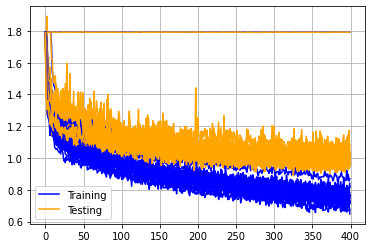

In [13]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [14]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.0308523178100588
mean accuracy:  0.5695986360311507


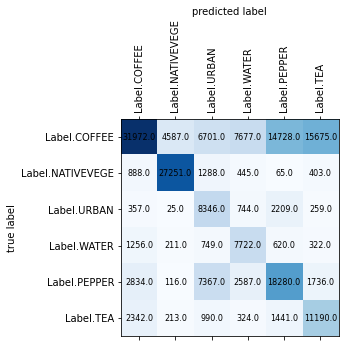

In [15]:
plot_confusion_matrix(conf_matrix, labels)

In [16]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.80637595 0.84100238 0.32805314 0.39602031 0.48951611 0.37823221]
Recalls:  [0.39306614 0.89818721 0.69899497 0.70974265 0.55528554 0.67818182]
F-Score:  [0.52851086 0.86865467 0.44653701 0.5083775  0.52033076 0.48562439]


# NIR, RED, SWIR1

In [17]:
BANDS = [
    Band.NIR.value,
    Band.RED.value,
    Band.SWIR1.value
]

In [18]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0383 - accuracy: 0.5077 - val_loss: 1.1278 - val_accuracy: 0.5234
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0212 - accuracy: 0.5092 - val_loss: 1.1181 - val_accuracy: 0.5220
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0018 - accuracy: 0.5116 - val_loss: 1.1290 - val_accuracy: 0.5211
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0777 - accuracy: 0.4865 - val_loss: 1.1552 - val_accuracy: 0.5137
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0783 - accuracy: 0.4937 - val_loss: 1.0952 - val_accuracy: 0.5302
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0121 - accuracy: 0.5303 - val_loss: 1.1637 - val_accuracy: 0.5060
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0797 - accuracy: 0.5106 - val_loss: 1.0869 - val_accuracy: 0.5540
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9709 - accuracy: 0.5759 - val_loss: 1.0342 - val_accuracy: 0.5775
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8937 - accuracy: 0.5558 - val_loss: 1.0478 - val_accuracy: 0.5639
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8516 - accuracy: 0.6013 - val_loss: 1.0287 - val_accuracy: 0.5973
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8332 - accuracy: 0.6114 - val_loss: 1.1173 - val_accuracy: 0.5197
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9072 - accuracy: 0.5692 - val_loss: 0.9857 - val_accuracy: 0.5990
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9987 - accuracy: 0.5676 - val_loss: 1.0392 - val_accuracy: 0.5719
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8981 - accuracy: 0.5813 - val_loss: 0.9956 - val_accuracy: 0.5999
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8410 - accuracy: 0.6066 - val_loss: 1.1391 - val_accuracy: 0.5341
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7714 - accuracy: 0.6038 - val_loss: 1.0996 - val_accuracy: 0.5459
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8250 - accuracy: 0.6105 - val_loss: 1.0169 - val_accuracy: 0.5774
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8225 - accuracy: 0.5961 - val_loss: 0.9616 - val_accuracy: 0.6079
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7749 - accuracy: 0.6113 - val_loss: 0.9927 - val_accuracy: 0.6010
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7965 - accuracy: 0.6343 - val_loss: 0.9718 - val_accuracy: 0.6059
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8673 - accuracy: 0.5801 - val_loss: 0.9462 - val_accuracy: 0.6209
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7581 - accuracy: 0.6350 - val_loss: 0.9427 - val_accuracy: 0.6468
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7264 - accuracy: 0.6351 - val_loss: 0.9264 - val_accuracy: 0.6480
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7850 - accuracy: 0.6358 - val_loss: 0.9625 - val_accuracy: 0.6199
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7308 - accuracy: 0.6608 - val_loss: 1.0542 - val_accuracy: 0.5805
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7345 - accuracy: 0.6309 - val_loss: 1.0143 - val_accuracy: 0.5967
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8040 - accuracy: 0.6274 - val_loss: 0.9298 - val_accuracy: 0.6328
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7333 - accuracy: 0.6472 - val_loss: 0.9927 - val_accuracy: 0.6049
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9294 - accuracy: 0.5468 - val_loss: 1.1267 - val_accuracy: 0.4990
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9080 - accuracy: 0.5273 - val_loss: 1.0390 - val_accuracy: 0.5464
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9895 - accuracy: 0.5219 - val_loss: 1.0668 - val_accuracy: 0.5495
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9786 - accuracy: 0.5178 - val_loss: 1.2795 - val_accuracy: 0.4491
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0084 - accuracy: 0.5283 - val_loss: 1.0659 - val_accuracy: 0.5440
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8937 - accuracy: 0.5322 - val_loss: 1.0844 - val_accuracy: 0.5234
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9435 - accuracy: 0.4909 - val_loss: 1.1464 - val_accuracy: 0.5054
E

57/57 [==============================] - 0s 8ms/step - loss: 0.8024 - accuracy: 0.5758 - val_loss: 1.0466 - val_accuracy: 0.5521
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8346 - accuracy: 0.5394 - val_loss: 1.0056 - val_accuracy: 0.5807
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8355 - accuracy: 0.5512 - val_loss: 1.0144 - val_accuracy: 0.5581
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8665 - accuracy: 0.5488 - val_loss: 1.0236 - val_accuracy: 0.5800
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8998 - accuracy: 0.5717 - val_loss: 1.0002 - val_accuracy: 0.5884
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9459 - accuracy: 0.5558 - val_loss: 1.0276 - val_accuracy: 0.5664
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8979 - accuracy: 0.5649 - val_loss: 1.0098 - val_accuracy: 0.5656
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7886 - accuracy: 0.6258 - val_loss: 0.9929 - val_accuracy: 0.5974
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8375 - accuracy: 0.5851 - val_loss: 1.0007 - val_accuracy: 0.5978
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8263 - accuracy: 0.6102 - val_loss: 1.0039 - val_accuracy: 0.5858
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7981 - accuracy: 0.5940 - val_loss: 0.9884 - val_accuracy: 0.5876
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8533 - accuracy: 0.5880 - val_loss: 0.9673 - val_accuracy: 0.5974
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7568 - accuracy: 0.6308 - val_loss: 1.0570 - val_accuracy: 0.5391
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8069 - accuracy: 0.5827 - val_loss: 1.0138 - val_accuracy: 0.5566
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0396 - accuracy: 0.4976 - val_loss: 1.1390 - val_accuracy: 0.5126
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0251 - accuracy: 0.5152 - val_loss: 1.1189 - val_accuracy: 0.5156
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0479 - accuracy: 0.4948 - val_loss: 1.1520 - val_accuracy: 0.4819
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0676 - accuracy: 0.4965 - val_loss: 1.2085 - val_accuracy: 0.4252
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1387 - accuracy: 0.4700 - val_loss: 1.1148 - val_accuracy: 0.5194
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0762 - accuracy: 0.4930 - val_loss: 1.1164 - val_accuracy: 0.5388
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0810 - accuracy: 0.4861 - val_loss: 1.1275 - val_accuracy: 0.4986
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9274 - accuracy: 0.5690 - val_loss: 1.0933 - val_accuracy: 0.5457
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0351 - accuracy: 0.5154 - val_loss: 1.1232 - val_accuracy: 0.5101
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9296 - accuracy: 0.5496 - val_loss: 1.0718 - val_accuracy: 0.5578
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9679 - accuracy: 0.5253 - val_loss: 1.1694 - val_accuracy: 0.4915
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9730 - accuracy: 0.5478 - val_loss: 1.0805 - val_accuracy: 0.5357
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9110 - accuracy: 0.5396 - val_loss: 1.0242 - val_accuracy: 0.5835
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9646 - accuracy: 0.5550 - val_loss: 1.0750 - val_accuracy: 0.5532
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8000 - accuracy: 0.6100 - val_loss: 0.9800 - val_accuracy: 0.5989
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8737 - accuracy: 0.5797 - val_loss: 1.0215 - val_accuracy: 0.5667
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8725 - accuracy: 0.5844 - val_loss: 1.0198 - val_accuracy: 0.5625
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9110 - accuracy: 0.5571 - val_loss: 0.9730 - val_accuracy: 0.5936
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8604 - accuracy: 0.5869 - val_loss: 1.0384 - val_accuracy: 0.5625
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8769 - accuracy: 0.6047 - val_loss: 1.0458 - val_accuracy: 0.5576
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8641 - accuracy: 0.5601 - val_loss: 1.0416 - val_accuracy: 0.5585
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7176 - accuracy: 0.6116 - val_loss: 1.0068 - val_accuracy: 0.5737
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7317 - accuracy: 0.6124 - val_loss: 0.9757 - val_accuracy: 0.5858
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7690 - accuracy: 0.6213 - val_loss: 0.9535 - val_accuracy: 0.6070
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7123 - accuracy: 0.6319 - val_loss: 0.9956 - val_accuracy: 0.5943
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7297 - accuracy: 0.6242 - val_loss: 1.1045 - val_accuracy: 0.5100
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7812 - accuracy: 0.6093 - val_loss: 0.9168 - val_accuracy: 0.6246
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7747 - accuracy: 0.6304 - val_loss: 0.9729 - val_accuracy: 0.5901
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0631 - accuracy: 0.4503 - val_loss: 1.2161 - val_accuracy: 0.4256
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0870 - accuracy: 0.4423 - val_loss: 1.1625 - val_accuracy: 0.4117
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0193 - accuracy: 0.4616 - val_loss: 1.1384 - val_accuracy: 0.4605
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0619 - accuracy: 0.4481 - val_loss: 1.1345 - val_accuracy: 0.4613
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0605 - accuracy: 0.4661 - val_loss: 1.1067 - val_accuracy: 0.4984
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1360 - accuracy: 0.4562 - val_loss: 1.1577 - val_accuracy: 0.4592
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0716 - accuracy: 0.4683 - val_loss: 1.1504 - val_accuracy: 0.4759
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9635 - accuracy: 0.5195 - val_loss: 1.0339 - val_accuracy: 0.5717
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9712 - accuracy: 0.5437 - val_loss: 1.1173 - val_accuracy: 0.5430
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9822 - accuracy: 0.5542 - val_loss: 1.1082 - val_accuracy: 0.5270
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9475 - accuracy: 0.5395 - val_loss: 1.2110 - val_accuracy: 0.4794
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9826 - accuracy: 0.5092 - val_loss: 1.0587 - val_accuracy: 0.5497
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9550 - accuracy: 0.5710 - val_loss: 1.0473 - val_accuracy: 0.5820
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0131 - accuracy: 0.5488 - val_loss: 1.1080 - val_accuracy: 0.5529
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8828 - accuracy: 0.5519 - val_loss: 1.0736 - val_accuracy: 0.5149
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8595 - accuracy: 0.5476 - val_loss: 1.0426 - val_accuracy: 0.5486
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8743 - accuracy: 0.5696 - val_loss: 1.0759 - val_accuracy: 0.5147
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8907 - accuracy: 0.5592 - val_loss: 0.9710 - val_accuracy: 0.5978
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8886 - accuracy: 0.5489 - val_loss: 0.9661 - val_accuracy: 0.5807
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8594 - accuracy: 0.5784 - val_loss: 1.1632 - val_accuracy: 0.4892
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8663 - accuracy: 0.5733 - val_loss: 1.0180 - val_accuracy: 0.5479
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8140 - accuracy: 0.5952 - val_loss: 0.9742 - val_accuracy: 0.5949
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8354 - accuracy: 0.6086 - val_loss: 0.9458 - val_accuracy: 0.6106
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8143 - accuracy: 0.6130 - val_loss: 0.9769 - val_accuracy: 0.5811
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8130 - accuracy: 0.6027 - val_loss: 1.0180 - val_accuracy: 0.5622
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8118 - accuracy: 0.5720 - val_loss: 1.0382 - val_accuracy: 0.5300
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8061 - accuracy: 0.5716 - val_loss: 0.9830 - val_accuracy: 0.5775
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7898 - accuracy: 0.5881 - val_loss: 1.0086 - val_accuracy: 0.5482
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2166 - accuracy: 0.3642 - val_loss: 1.3436 - val_accuracy: 0.3272
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2109 - accuracy: 0.3752 - val_loss: 1.2891 - val_accuracy: 0.3486
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2048 - accuracy: 0.3637 - val_loss: 1.2888 - val_accuracy: 0.3367
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2539 - accuracy: 0.3532 - val_loss: 1.2646 - val_accuracy: 0.3390
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2324 - accuracy: 0.3688 - val_loss: 1.2601 - val_accuracy: 0.3484
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2272 - accuracy: 0.3633 - val_loss: 1.2441 - val_accuracy: 0.3563
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2728 - accuracy: 0.3446 - val_loss: 1.2758 - val_accuracy: 0.3420
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9989 - accuracy: 0.5066 - val_loss: 1.0470 - val_accuracy: 0.5546
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9681 - accuracy: 0.5620 - val_loss: 1.1071 - val_accuracy: 0.5317
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9117 - accuracy: 0.5535 - val_loss: 1.0448 - val_accuracy: 0.5712
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9523 - accuracy: 0.5488 - val_loss: 1.0367 - val_accuracy: 0.5577
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9425 - accuracy: 0.5478 - val_loss: 1.0788 - val_accuracy: 0.5338
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9195 - accuracy: 0.5438 - val_loss: 1.1256 - val_accuracy: 0.5277
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9942 - accuracy: 0.5048 - val_loss: 1.0814 - val_accuracy: 0.5327
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8083 - accuracy: 0.6135 - val_loss: 0.9805 - val_accuracy: 0.5890
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8542 - accuracy: 0.5686 - val_loss: 0.9419 - val_accuracy: 0.6127
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8142 - accuracy: 0.6222 - val_loss: 0.9508 - val_accuracy: 0.6042
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8072 - accuracy: 0.5850 - val_loss: 1.0043 - val_accuracy: 0.5943
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8540 - accuracy: 0.6005 - val_loss: 0.9824 - val_accuracy: 0.5970
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8481 - accuracy: 0.5899 - val_loss: 0.9783 - val_accuracy: 0.5968
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8605 - accuracy: 0.5884 - val_loss: 0.9630 - val_accuracy: 0.5962
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7834 - accuracy: 0.6157 - val_loss: 0.9570 - val_accuracy: 0.6079
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7850 - accuracy: 0.6199 - val_loss: 0.9422 - val_accuracy: 0.6130
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7680 - accuracy: 0.6140 - val_loss: 0.9717 - val_accuracy: 0.6005
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7513 - accuracy: 0.6192 - val_loss: 0.9272 - val_accuracy: 0.6198
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7440 - accuracy: 0.6194 - val_loss: 0.9991 - val_accuracy: 0.5924
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7480 - accuracy: 0.6111 - val_loss: 0.9658 - val_accuracy: 0.6069
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7338 - accuracy: 0.6248 - val_loss: 0.9113 - val_accuracy: 0.6300
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1625 - accuracy: 0.4335 - val_loss: 1.3724 - val_accuracy: 0.3230
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1888 - accuracy: 0.3653 - val_loss: 1.2333 - val_accuracy: 0.3864
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1134 - accuracy: 0.4316 - val_loss: 1.2584 - val_accuracy: 0.3680
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1141 - accuracy: 0.4104 - val_loss: 1.3249 - val_accuracy: 0.3367
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0909 - accuracy: 0.4126 - val_loss: 1.2274 - val_accuracy: 0.3883
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0773 - accuracy: 0.4243 - val_loss: 1.1940 - val_accuracy: 0.3819
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1491 - accuracy: 0.3996 - val_loss: 1.1781 - val_accuracy: 0.4458
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9257 - accuracy: 0.5729 - val_loss: 1.1012 - val_accuracy: 0.5163
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8897 - accuracy: 0.5675 - val_loss: 1.0977 - val_accuracy: 0.5378
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9415 - accuracy: 0.5344 - val_loss: 1.0808 - val_accuracy: 0.5541
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9877 - accuracy: 0.5561 - val_loss: 1.0509 - val_accuracy: 0.5687
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0053 - accuracy: 0.5498 - val_loss: 1.0776 - val_accuracy: 0.5470
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9274 - accuracy: 0.5678 - val_loss: 1.1321 - val_accuracy: 0.5046
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9325 - accuracy: 0.5545 - val_loss: 1.1754 - val_accuracy: 0.4713
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7499 - accuracy: 0.6355 - val_loss: 0.9637 - val_accuracy: 0.6056
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7761 - accuracy: 0.6277 - val_loss: 1.0520 - val_accuracy: 0.5805
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8259 - accuracy: 0.5796 - val_loss: 1.0268 - val_accuracy: 0.5700
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8439 - accuracy: 0.5788 - val_loss: 1.0315 - val_accuracy: 0.5839
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7913 - accuracy: 0.6121 - val_loss: 1.0065 - val_accuracy: 0.5643
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7984 - accuracy: 0.5946 - val_loss: 0.9811 - val_accuracy: 0.5802
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8343 - accuracy: 0.5899 - val_loss: 0.9910 - val_accuracy: 0.5890
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7869 - accuracy: 0.5795 - val_loss: 0.9766 - val_accuracy: 0.6207
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7759 - accuracy: 0.6104 - val_loss: 1.0044 - val_accuracy: 0.5950
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7262 - accuracy: 0.6183 - val_loss: 1.0129 - val_accuracy: 0.5692
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7317 - accuracy: 0.6100 - val_loss: 0.9627 - val_accuracy: 0.6048
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7492 - accuracy: 0.6198 - val_loss: 1.0171 - val_accuracy: 0.6006
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7366 - accuracy: 0.6349 - val_loss: 0.9399 - val_accuracy: 0.6136
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7439 - accuracy: 0.6685 - val_loss: 0.9368 - val_accuracy: 0.6132
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2251 - accuracy: 0.3776 - val_loss: 1.2905 - val_accuracy: 0.3504
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2589 - accuracy: 0.3897 - val_loss: 1.3189 - val_accuracy: 0.3206
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2524 - accuracy: 0.3473 - val_loss: 1.2694 - val_accuracy: 0.4040
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2452 - accuracy: 0.4041 - val_loss: 1.3100 - val_accuracy: 0.3399
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1911 - accuracy: 0.4134 - val_loss: 1.3791 - val_accuracy: 0.3013
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2425 - accuracy: 0.3417 - val_loss: 1.2888 - val_accuracy: 0.3357
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2586 - accuracy: 0.3640 - val_loss: 1.3171 - val_accuracy: 0.3322
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0557 - accuracy: 0.4915 - val_loss: 1.1452 - val_accuracy: 0.5060
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0117 - accuracy: 0.4836 - val_loss: 1.1073 - val_accuracy: 0.5316
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0120 - accuracy: 0.4909 - val_loss: 1.1188 - val_accuracy: 0.5251
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0359 - accuracy: 0.5041 - val_loss: 1.1167 - val_accuracy: 0.5229
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0192 - accuracy: 0.4975 - val_loss: 1.1704 - val_accuracy: 0.5067
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9961 - accuracy: 0.5024 - val_loss: 1.1283 - val_accuracy: 0.5130
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0443 - accuracy: 0.4841 - val_loss: 1.1225 - val_accuracy: 0.5324
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.9140 - accuracy: 0.5566 - val_loss: 1.0046 - val_accuracy: 0.5944
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8198 - accuracy: 0.5664 - val_loss: 1.0167 - val_accuracy: 0.6098
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9428 - accuracy: 0.5403 - val_loss: 1.0065 - val_accuracy: 0.5850
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8881 - accuracy: 0.5550 - val_loss: 0.9838 - val_accuracy: 0.6026
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8091 - accuracy: 0.6031 - val_loss: 1.0418 - val_accuracy: 0.5603
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8662 - accuracy: 0.5639 - val_loss: 1.0616 - val_accuracy: 0.5520
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8685 - accuracy: 0.5610 - val_loss: 1.0052 - val_accuracy: 0.5747
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7699 - accuracy: 0.6016 - val_loss: 0.9880 - val_accuracy: 0.6145
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8516 - accuracy: 0.5760 - val_loss: 0.9991 - val_accuracy: 0.6034
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8083 - accuracy: 0.6087 - val_loss: 1.0133 - val_accuracy: 0.5675
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7791 - accuracy: 0.6062 - val_loss: 0.9836 - val_accuracy: 0.5894
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8412 - accuracy: 0.5707 - val_loss: 0.9749 - val_accuracy: 0.6127
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8249 - accuracy: 0.5773 - val_loss: 1.0427 - val_accuracy: 0.5807
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7630 - accuracy: 0.5914 - val_loss: 1.0367 - val_accuracy: 0.5828
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.4057 - accuracy: 0.3642 - val_loss: 1.2397 - val_accuracy: 0.4392
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2543 - accuracy: 0.4466 - val_loss: 1.2494 - val_accuracy: 0.3970
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3053 - accuracy: 0.4020 - val_loss: 1.2359 - val_accuracy: 0.3917
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2176 - accuracy: 0.4215 - val_loss: 1.2360 - val_accuracy: 0.3769
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1627 - accuracy: 0.3870 - val_loss: 1.2762 - val_accuracy: 0.4325
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2355 - accuracy: 0.4180 - val_loss: 1.2010 - val_accuracy: 0.5486
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1707 - accuracy: 0.4324 - val_loss: 1.1679 - val_accuracy: 0.3875
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9628 - accuracy: 0.5541 - val_loss: 1.0835 - val_accuracy: 0.5584
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9936 - accuracy: 0.5656 - val_loss: 1.0774 - val_accuracy: 0.5523
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0045 - accuracy: 0.5518 - val_loss: 1.1718 - val_accuracy: 0.5101
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0359 - accuracy: 0.5341 - val_loss: 1.1377 - val_accuracy: 0.5002
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9732 - accuracy: 0.5520 - val_loss: 1.1175 - val_accuracy: 0.5320
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9532 - accuracy: 0.5709 - val_loss: 1.0773 - val_accuracy: 0.5471
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0657 - accuracy: 0.5338 - val_loss: 1.1575 - val_accuracy: 0.5417
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8609 - accuracy: 0.6075 - val_loss: 1.0630 - val_accuracy: 0.5847
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8880 - accuracy: 0.6002 - val_loss: 1.0215 - val_accuracy: 0.5774
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8115 - accuracy: 0.6238 - val_loss: 0.9861 - val_accuracy: 0.6147
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9045 - accuracy: 0.5805 - val_loss: 1.0066 - val_accuracy: 0.5865
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8935 - accuracy: 0.6081 - val_loss: 1.0108 - val_accuracy: 0.6057
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9007 - accuracy: 0.5998 - val_loss: 1.0098 - val_accuracy: 0.5952
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8438 - accuracy: 0.6141 - val_loss: 0.9387 - val_accuracy: 0.6395
Epoch 189/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8079 - accuracy: 0.6238 - val_loss: 0.9950 - val_accuracy: 0.6062
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7819 - accuracy: 0.6501 - val_loss: 0.9568 - val_accuracy: 0.6227
Epoch 298/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7383 - accuracy: 0.6379 - val_loss: 0.9310 - val_accuracy: 0.6322
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7560 - accuracy: 0.6365 - val_loss: 0.9955 - val_accuracy: 0.6062
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7518 - accuracy: 0.6396 - val_loss: 1.0136 - val_accuracy: 0.5761
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7654 - accuracy: 0.6341 - val_loss: 1.0277 - val_accuracy: 0.5616
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8100 - accuracy: 0.6211 - val_loss: 1.0011 - val_accuracy: 0.5799
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.6474 - accuracy: 0.1941 - val_loss: 1.5754 - val_accuracy: 0.2014
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5704 - accuracy: 0.2183 - val_loss: 1.5163 - val_accuracy: 0.2902
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4780 - accuracy: 0.2963 - val_loss: 1.4782 - val_accuracy: 0.3383
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4528 - accuracy: 0.2739 - val_loss: 1.4021 - val_accuracy: 0.3762
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3661 - accuracy: 0.3264 - val_loss: 1.4229 - val_accuracy: 0.3318
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3456 - accuracy: 0.3456 - val_loss: 1.3374 - val_accuracy: 0.4106
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3906 - accuracy: 0.3794 - val_loss: 1.3597 - val_accuracy: 0.3621
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0148 - accuracy: 0.5185 - val_loss: 1.1377 - val_accuracy: 0.4903
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0039 - accuracy: 0.5252 - val_loss: 1.0762 - val_accuracy: 0.5281
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0054 - accuracy: 0.5120 - val_loss: 1.1270 - val_accuracy: 0.4971
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9789 - accuracy: 0.5214 - val_loss: 1.1065 - val_accuracy: 0.5317
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0335 - accuracy: 0.5151 - val_loss: 1.0626 - val_accuracy: 0.5622
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0816 - accuracy: 0.5205 - val_loss: 1.1579 - val_accuracy: 0.4949
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0559 - accuracy: 0.4863 - val_loss: 1.0803 - val_accuracy: 0.5229
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8899 - accuracy: 0.5745 - val_loss: 1.0325 - val_accuracy: 0.5565
Epoch 178/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9081 - accuracy: 0.5455 - val_loss: 0.9848 - val_accuracy: 0.5729
Epoch 179/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8618 - accuracy: 0.5692 - val_loss: 1.0256 - val_accuracy: 0.5315
Epoch 180/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9012 - accuracy: 0.5583 - val_loss: 1.0019 - val_accuracy: 0.5633
Epoch 181/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8704 - accuracy: 0.5551 - val_loss: 1.0214 - val_accuracy: 0.5604
Epoch 182/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9238 - accuracy: 0.5401 - val_loss: 1.0598 - val_accuracy: 0.5433
Epoch 183/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9518 - accuracy: 0.5597 - val_loss: 0.9861 - val_accuracy: 0.5852
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 0.9081 - accuracy: 0.5775 - val_loss: 0.9749 - val_accuracy: 0.5911
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8705 - accuracy: 0.5789 - val_loss: 1.0628 - val_accuracy: 0.5596
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8181 - accuracy: 0.5870 - val_loss: 0.9842 - val_accuracy: 0.6055
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8022 - accuracy: 0.5956 - val_loss: 0.9925 - val_accuracy: 0.5728
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8795 - accuracy: 0.5472 - val_loss: 0.9966 - val_accuracy: 0.5724
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8393 - accuracy: 0.5633 - val_loss: 0.9577 - val_accuracy: 0.5959
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8588 - accuracy: 0.5932 - val_loss: 0.9673 - val_accuracy: 0.5676
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8063 - accuracy: 0.1126 - val_loss: 1.7925 - val_accuracy: 0.1827
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8216 - accuracy: 0.1411 - val_loss: 1.7610 - val_accuracy: 0.2338
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6971 - accuracy: 0.2288 - val_loss: 1.4802 - val_accuracy: 0.3565
Epoch 4/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3973 - accuracy: 0.3759 - val_loss: 1.4229 - val_accuracy: 0.3012
Epoch 5/400
57/57 [==============================] - 0s 9ms/step - loss: 1.3971 - accuracy: 0.3377 - val_loss: 1.3566 - val_accuracy: 0.3817
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3651 - accuracy: 0.3577 - val_loss: 1.3239 - val_accuracy: 0.3175
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3182 - accuracy: 0.3572 - val_loss: 1.3318 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9793 - accuracy: 0.5139 - val_loss: 1.0835 - val_accuracy: 0.5385
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9801 - accuracy: 0.4931 - val_loss: 1.0649 - val_accuracy: 0.5396
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9286 - accuracy: 0.5402 - val_loss: 1.0796 - val_accuracy: 0.5479
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9975 - accuracy: 0.4925 - val_loss: 1.0701 - val_accuracy: 0.5324
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9288 - accuracy: 0.5282 - val_loss: 1.0685 - val_accuracy: 0.5433
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9392 - accuracy: 0.5134 - val_loss: 1.1222 - val_accuracy: 0.4990
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9371 - accuracy: 0.5190 - val_loss: 1.0904 - val_accuracy: 0.5259

57/57 [==============================] - 0s 9ms/step - loss: 0.9315 - accuracy: 0.5230 - val_loss: 1.0638 - val_accuracy: 0.5380
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8980 - accuracy: 0.5538 - val_loss: 1.0306 - val_accuracy: 0.5601
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8586 - accuracy: 0.5432 - val_loss: 1.1058 - val_accuracy: 0.5071
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8792 - accuracy: 0.5398 - val_loss: 1.0405 - val_accuracy: 0.5509
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8540 - accuracy: 0.5454 - val_loss: 1.0632 - val_accuracy: 0.5389
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8755 - accuracy: 0.5322 - val_loss: 1.0403 - val_accuracy: 0.5608
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9717 - accuracy: 0.5295 - val_loss: 1.0473 - val_accuracy: 0.5652
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.8747 - accuracy: 0.5922 - val_loss: 0.9766 - val_accuracy: 0.6094
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8135 - accuracy: 0.5907 - val_loss: 0.9920 - val_accuracy: 0.6092
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8041 - accuracy: 0.5851 - val_loss: 1.0086 - val_accuracy: 0.5880
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7997 - accuracy: 0.5681 - val_loss: 1.0675 - val_accuracy: 0.5606
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8357 - accuracy: 0.5655 - val_loss: 1.0569 - val_accuracy: 0.5790
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8624 - accuracy: 0.5852 - val_loss: 0.9786 - val_accuracy: 0.5915
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7895 - accuracy: 0.5865 - val_loss: 1.0237 - val_accuracy: 0.5997
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8011 - accuracy: 0.1190 - val_loss: 1.7919 - val_accuracy: 0.0582
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8075 - accuracy: 0.1145 - val_loss: 1.7841 - val_accuracy: 0.0715
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7082 - accuracy: 0.1234 - val_loss: 1.7118 - val_accuracy: 0.1459
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5843 - accuracy: 0.2139 - val_loss: 1.5095 - val_accuracy: 0.3588
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5140 - accuracy: 0.3175 - val_loss: 1.4398 - val_accuracy: 0.4294
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4116 - accuracy: 0.3695 - val_loss: 1.4868 - val_accuracy: 0.3772
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4056 - accuracy: 0.3251 - val_loss: 1.3987 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9432 - accuracy: 0.5802 - val_loss: 1.0204 - val_accuracy: 0.5869
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9390 - accuracy: 0.5576 - val_loss: 1.0946 - val_accuracy: 0.5568
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9154 - accuracy: 0.5839 - val_loss: 1.0615 - val_accuracy: 0.5659
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9232 - accuracy: 0.5542 - val_loss: 1.0522 - val_accuracy: 0.5757
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9025 - accuracy: 0.5869 - val_loss: 1.1061 - val_accuracy: 0.5117
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9279 - accuracy: 0.5557 - val_loss: 1.0527 - val_accuracy: 0.5682
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8991 - accuracy: 0.5776 - val_loss: 1.0465 - val_accuracy: 0.5549

57/57 [==============================] - 0s 8ms/step - loss: 0.7758 - accuracy: 0.6280 - val_loss: 0.9460 - val_accuracy: 0.6039
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7709 - accuracy: 0.6128 - val_loss: 1.0447 - val_accuracy: 0.5714
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8385 - accuracy: 0.6111 - val_loss: 0.9931 - val_accuracy: 0.5828
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8106 - accuracy: 0.6176 - val_loss: 0.9636 - val_accuracy: 0.5994
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8518 - accuracy: 0.6116 - val_loss: 0.9815 - val_accuracy: 0.5846
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7526 - accuracy: 0.6310 - val_loss: 1.0978 - val_accuracy: 0.5194
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7732 - accuracy: 0.5896 - val_loss: 0.9536 - val_accuracy: 0.6048
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7494 - accuracy: 0.6323 - val_loss: 0.9780 - val_accuracy: 0.6043
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7388 - accuracy: 0.6547 - val_loss: 1.0849 - val_accuracy: 0.5780
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7466 - accuracy: 0.6325 - val_loss: 0.9365 - val_accuracy: 0.6161
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7071 - accuracy: 0.6355 - val_loss: 0.9058 - val_accuracy: 0.6195
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7922 - accuracy: 0.6132 - val_loss: 0.9548 - val_accuracy: 0.6017
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7734 - accuracy: 0.6277 - val_loss: 1.1048 - val_accuracy: 0.5477
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6556 - accuracy: 0.6606 - val_loss: 0.9265 - val_accuracy: 0.6374
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8357 - accuracy: 0.1081 - val_loss: 1.7916 - val_accuracy: 0.1488
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7181 - accuracy: 0.2080 - val_loss: 1.4472 - val_accuracy: 0.3390
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4014 - accuracy: 0.3420 - val_loss: 1.3628 - val_accuracy: 0.4295
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3226 - accuracy: 0.3971 - val_loss: 1.3538 - val_accuracy: 0.3458
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3936 - accuracy: 0.3542 - val_loss: 1.2875 - val_accuracy: 0.3064
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3159 - accuracy: 0.3493 - val_loss: 1.2986 - val_accuracy: 0.3504
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2865 - accuracy: 0.3588 - val_loss: 1.2824 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9325 - accuracy: 0.5408 - val_loss: 1.0923 - val_accuracy: 0.5103
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9389 - accuracy: 0.5525 - val_loss: 1.0953 - val_accuracy: 0.5247
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9109 - accuracy: 0.5590 - val_loss: 1.0551 - val_accuracy: 0.5510
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9253 - accuracy: 0.5395 - val_loss: 1.0666 - val_accuracy: 0.5612
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9726 - accuracy: 0.5309 - val_loss: 1.0432 - val_accuracy: 0.5543
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9870 - accuracy: 0.5254 - val_loss: 1.1024 - val_accuracy: 0.5373
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9756 - accuracy: 0.5247 - val_loss: 1.0383 - val_accuracy: 0.5627

57/57 [==============================] - 0s 8ms/step - loss: 0.8498 - accuracy: 0.5866 - val_loss: 1.0361 - val_accuracy: 0.5784
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8256 - accuracy: 0.6021 - val_loss: 1.0317 - val_accuracy: 0.5767
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8332 - accuracy: 0.5949 - val_loss: 0.9724 - val_accuracy: 0.6125
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8293 - accuracy: 0.5937 - val_loss: 0.9847 - val_accuracy: 0.6111
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8645 - accuracy: 0.5957 - val_loss: 0.9420 - val_accuracy: 0.6326
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8337 - accuracy: 0.5913 - val_loss: 0.9693 - val_accuracy: 0.6081
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7860 - accuracy: 0.5939 - val_loss: 1.0399 - val_accuracy: 0.5680
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7289 - accuracy: 0.6344 - val_loss: 0.8901 - val_accuracy: 0.6621
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7186 - accuracy: 0.6235 - val_loss: 0.9451 - val_accuracy: 0.6354
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7169 - accuracy: 0.6420 - val_loss: 0.9759 - val_accuracy: 0.6145
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7232 - accuracy: 0.6497 - val_loss: 0.9373 - val_accuracy: 0.6262
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6893 - accuracy: 0.6520 - val_loss: 0.9187 - val_accuracy: 0.6401
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7031 - accuracy: 0.6507 - val_loss: 0.9252 - val_accuracy: 0.6258
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6572 - accuracy: 0.6495 - val_loss: 0.9000 - val_accuracy: 0.6607
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8117 - accuracy: 0.1037 - val_loss: 1.7805 - val_accuracy: 0.2410
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7283 - accuracy: 0.2737 - val_loss: 1.4665 - val_accuracy: 0.3852
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4706 - accuracy: 0.3312 - val_loss: 1.3597 - val_accuracy: 0.2780
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3212 - accuracy: 0.3536 - val_loss: 1.4135 - val_accuracy: 0.3174
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3687 - accuracy: 0.3631 - val_loss: 1.3003 - val_accuracy: 0.3481
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3039 - accuracy: 0.3796 - val_loss: 1.2713 - val_accuracy: 0.4272
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2378 - accuracy: 0.4039 - val_loss: 1.3012 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8803 - accuracy: 0.5454 - val_loss: 1.0120 - val_accuracy: 0.5762
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8656 - accuracy: 0.5520 - val_loss: 1.0536 - val_accuracy: 0.5494
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9076 - accuracy: 0.5337 - val_loss: 1.0409 - val_accuracy: 0.5427
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9048 - accuracy: 0.5213 - val_loss: 1.0486 - val_accuracy: 0.5580
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9196 - accuracy: 0.5453 - val_loss: 1.0497 - val_accuracy: 0.5133
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9548 - accuracy: 0.5261 - val_loss: 1.0691 - val_accuracy: 0.5275
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9521 - accuracy: 0.5234 - val_loss: 0.9752 - val_accuracy: 0.6042

57/57 [==============================] - 0s 8ms/step - loss: 0.8122 - accuracy: 0.5992 - val_loss: 1.0003 - val_accuracy: 0.5934
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8508 - accuracy: 0.6104 - val_loss: 1.0266 - val_accuracy: 0.5890
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8205 - accuracy: 0.6089 - val_loss: 0.9588 - val_accuracy: 0.5746
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8774 - accuracy: 0.5857 - val_loss: 1.0414 - val_accuracy: 0.5173
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8203 - accuracy: 0.5938 - val_loss: 0.9773 - val_accuracy: 0.5638
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8785 - accuracy: 0.5788 - val_loss: 1.0450 - val_accuracy: 0.5357
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8453 - accuracy: 0.5457 - val_loss: 0.9694 - val_accuracy: 0.5664
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7530 - accuracy: 0.6281 - val_loss: 0.9887 - val_accuracy: 0.5733
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7570 - accuracy: 0.5830 - val_loss: 0.9631 - val_accuracy: 0.5822
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7312 - accuracy: 0.6172 - val_loss: 0.9397 - val_accuracy: 0.6119
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7216 - accuracy: 0.6293 - val_loss: 0.9537 - val_accuracy: 0.6011
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7193 - accuracy: 0.6452 - val_loss: 0.9639 - val_accuracy: 0.5890
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7704 - accuracy: 0.5994 - val_loss: 0.9098 - val_accuracy: 0.6281
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8008 - accuracy: 0.5791 - val_loss: 0.9516 - val_accuracy: 0.6081
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8227 - accuracy: 0.0968 - val_loss: 1.7911 - val_accuracy: 0.0932
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8057 - accuracy: 0.1120 - val_loss: 1.7871 - val_accuracy: 0.1813
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7844 - accuracy: 0.1541 - val_loss: 1.7086 - val_accuracy: 0.1138
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7286 - accuracy: 0.1107 - val_loss: 1.6205 - val_accuracy: 0.1643
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5174 - accuracy: 0.2226 - val_loss: 1.5340 - val_accuracy: 0.2364
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4811 - accuracy: 0.3010 - val_loss: 1.4347 - val_accuracy: 0.3544
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4675 - accuracy: 0.3077 - val_loss: 1.4249 - val_accuracy

57/57 [==============================] - 0s 8ms/step - loss: 0.9703 - accuracy: 0.5572 - val_loss: 1.0699 - val_accuracy: 0.5327
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8986 - accuracy: 0.5577 - val_loss: 1.0465 - val_accuracy: 0.5686
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8730 - accuracy: 0.5435 - val_loss: 1.0891 - val_accuracy: 0.5717
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9904 - accuracy: 0.5120 - val_loss: 1.0466 - val_accuracy: 0.5634
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9109 - accuracy: 0.5692 - val_loss: 1.0167 - val_accuracy: 0.5909
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8582 - accuracy: 0.5994 - val_loss: 1.0554 - val_accuracy: 0.5811
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8554 - accuracy: 0.5773 - val_loss: 1.0134 - val_accuracy: 0.5922
Epoch 122/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7987 - accuracy: 0.6265 - val_loss: 1.0485 - val_accuracy: 0.5805
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8631 - accuracy: 0.5760 - val_loss: 0.9721 - val_accuracy: 0.6281
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8053 - accuracy: 0.6300 - val_loss: 0.9441 - val_accuracy: 0.6250
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8458 - accuracy: 0.6157 - val_loss: 0.9503 - val_accuracy: 0.6285
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7707 - accuracy: 0.6442 - val_loss: 0.9335 - val_accuracy: 0.6432
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7671 - accuracy: 0.6483 - val_loss: 0.9544 - val_accuracy: 0.6227
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8107 - accuracy: 0.6060 - val_loss: 0.9484 - val_accuracy: 0.6269
Epoch 236/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6896 - accuracy: 0.6636 - val_loss: 0.9579 - val_accuracy: 0.6174
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6853 - accuracy: 0.6313 - val_loss: 0.9899 - val_accuracy: 0.6065
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7863 - accuracy: 0.6093 - val_loss: 0.9283 - val_accuracy: 0.6321
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6893 - accuracy: 0.6390 - val_loss: 0.9728 - val_accuracy: 0.6193
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7102 - accuracy: 0.6254 - val_loss: 0.9849 - val_accuracy: 0.6239
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7441 - accuracy: 0.6386 - val_loss: 0.9419 - val_accuracy: 0.6335
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7092 - accuracy: 0.6328 - val_loss: 0.9879 - val_accuracy: 0.5962
Epoch 350/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0304 - accuracy: 0.5241 - val_loss: 1.1885 - val_accuracy: 0.4888
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9657 - accuracy: 0.5594 - val_loss: 1.1144 - val_accuracy: 0.5191
Epoch 54/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0015 - accuracy: 0.4828 - val_loss: 1.2800 - val_accuracy: 0.4626
Epoch 55/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0088 - accuracy: 0.4819 - val_loss: 1.1778 - val_accuracy: 0.4882
Epoch 56/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9827 - accuracy: 0.5081 - val_loss: 1.1203 - val_accuracy: 0.5196
Epoch 57/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9826 - accuracy: 0.5228 - val_loss: 1.0738 - val_accuracy: 0.5437
Epoch 58/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0190 - accuracy: 0.5247 - val_loss: 1.0583 - val_accuracy: 0.5544
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9870 - accuracy: 0.5271 - val_loss: 1.1405 - val_accuracy: 0.5105
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9178 - accuracy: 0.5587 - val_loss: 1.0529 - val_accuracy: 0.5463
Epoch 112/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9006 - accuracy: 0.5728 - val_loss: 1.0445 - val_accuracy: 0.5706
Epoch 113/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9285 - accuracy: 0.5674 - val_loss: 1.1548 - val_accuracy: 0.5519
Epoch 114/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9402 - accuracy: 0.5770 - val_loss: 1.0383 - val_accuracy: 0.5630
Epoch 115/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9007 - accuracy: 0.5718 - val_loss: 1.1129 - val_accuracy: 0.5391
Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8611 - accuracy: 0.5352 - val_loss: 1.0294 - val_accuracy: 0.5828

57/57 [==============================] - 0s 8ms/step - loss: 0.7927 - accuracy: 0.6250 - val_loss: 1.0442 - val_accuracy: 0.5913
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8133 - accuracy: 0.6113 - val_loss: 1.0444 - val_accuracy: 0.5680
Epoch 226/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8148 - accuracy: 0.5931 - val_loss: 1.0219 - val_accuracy: 0.5850
Epoch 227/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8049 - accuracy: 0.6149 - val_loss: 0.9772 - val_accuracy: 0.6151
Epoch 228/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8437 - accuracy: 0.5969 - val_loss: 0.9760 - val_accuracy: 0.6083
Epoch 229/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8004 - accuracy: 0.6163 - val_loss: 0.9812 - val_accuracy: 0.6060
Epoch 230/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7977 - accuracy: 0.6147 - val_loss: 1.0376 - val_accuracy: 0.5769
Epoch 231/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7770 - accuracy: 0.6332 - val_loss: 0.9537 - val_accuracy: 0.6147
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7555 - accuracy: 0.6274 - val_loss: 0.9799 - val_accuracy: 0.6190
Epoch 340/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8022 - accuracy: 0.6089 - val_loss: 0.9302 - val_accuracy: 0.6247
Epoch 341/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7780 - accuracy: 0.6243 - val_loss: 1.0011 - val_accuracy: 0.6137
Epoch 342/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7987 - accuracy: 0.6225 - val_loss: 0.9421 - val_accuracy: 0.6268
Epoch 343/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7800 - accuracy: 0.6228 - val_loss: 0.9446 - val_accuracy: 0.6280
Epoch 344/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7677 - accuracy: 0.6351 - val_loss: 0.9961 - val_accuracy: 0.5952
Epoch 345/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0317 - accuracy: 0.4843 - val_loss: 1.1078 - val_accuracy: 0.5044
Epoch 48/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9825 - accuracy: 0.4901 - val_loss: 1.0841 - val_accuracy: 0.5396
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0074 - accuracy: 0.4997 - val_loss: 1.1859 - val_accuracy: 0.4648
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9446 - accuracy: 0.4912 - val_loss: 1.1274 - val_accuracy: 0.5188
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9636 - accuracy: 0.5342 - val_loss: 1.2810 - val_accuracy: 0.4519
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9613 - accuracy: 0.5077 - val_loss: 1.0922 - val_accuracy: 0.5440
Epoch 53/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9433 - accuracy: 0.5306 - val_loss: 1.1117 - val_accuracy: 0.5143
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8818 - accuracy: 0.5460 - val_loss: 1.0782 - val_accuracy: 0.5272
Epoch 106/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8922 - accuracy: 0.5513 - val_loss: 1.0642 - val_accuracy: 0.5479
Epoch 107/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9422 - accuracy: 0.5577 - val_loss: 1.1104 - val_accuracy: 0.5525
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9404 - accuracy: 0.5377 - val_loss: 1.0503 - val_accuracy: 0.5574
Epoch 109/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8394 - accuracy: 0.5651 - val_loss: 1.0975 - val_accuracy: 0.5432
Epoch 110/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8937 - accuracy: 0.5395 - val_loss: 1.1502 - val_accuracy: 0.4931
Epoch 111/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9057 - accuracy: 0.5295 - val_loss: 1.0714 - val_accuracy: 0.5359

57/57 [==============================] - 0s 8ms/step - loss: 0.7603 - accuracy: 0.6152 - val_loss: 1.0198 - val_accuracy: 0.6070
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7422 - accuracy: 0.6241 - val_loss: 1.0071 - val_accuracy: 0.5965
Epoch 221/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7695 - accuracy: 0.6347 - val_loss: 1.0663 - val_accuracy: 0.5642
Epoch 222/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7177 - accuracy: 0.6038 - val_loss: 0.9815 - val_accuracy: 0.6128
Epoch 223/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7475 - accuracy: 0.6418 - val_loss: 1.0316 - val_accuracy: 0.5992
Epoch 224/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8209 - accuracy: 0.6021 - val_loss: 1.0621 - val_accuracy: 0.5521
Epoch 225/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7970 - accuracy: 0.5894 - val_loss: 0.9918 - val_accuracy: 0.6074
Epoch 226/400

57/57 [==============================] - 0s 9ms/step - loss: 0.6611 - accuracy: 0.6354 - val_loss: 0.9269 - val_accuracy: 0.6434
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6489 - accuracy: 0.6581 - val_loss: 0.9393 - val_accuracy: 0.6344
Epoch 335/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7096 - accuracy: 0.6661 - val_loss: 1.1640 - val_accuracy: 0.5324
Epoch 336/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7163 - accuracy: 0.6225 - val_loss: 0.9313 - val_accuracy: 0.6402
Epoch 337/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6875 - accuracy: 0.6488 - val_loss: 0.9805 - val_accuracy: 0.6112
Epoch 338/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7091 - accuracy: 0.6266 - val_loss: 0.9295 - val_accuracy: 0.6236
Epoch 339/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6811 - accuracy: 0.6549 - val_loss: 1.1035 - val_accuracy: 0.5417
Epoch 340/400

57/57 [==============================] - 0s 9ms/step - loss: 0.9686 - accuracy: 0.5479 - val_loss: 1.1171 - val_accuracy: 0.5357
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9794 - accuracy: 0.5234 - val_loss: 1.0879 - val_accuracy: 0.5427
Epoch 44/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9991 - accuracy: 0.5314 - val_loss: 1.1107 - val_accuracy: 0.4978
Epoch 45/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9930 - accuracy: 0.5131 - val_loss: 1.0563 - val_accuracy: 0.5695
Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9578 - accuracy: 0.5362 - val_loss: 1.0870 - val_accuracy: 0.5360
Epoch 47/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9547 - accuracy: 0.5660 - val_loss: 1.0830 - val_accuracy: 0.5520
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9489 - accuracy: 0.5572 - val_loss: 1.1162 - val_accuracy: 0.5495
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9095 - accuracy: 0.5751 - val_loss: 1.0157 - val_accuracy: 0.5569
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8350 - accuracy: 0.5888 - val_loss: 1.0315 - val_accuracy: 0.5752
Epoch 102/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8489 - accuracy: 0.5657 - val_loss: 1.0307 - val_accuracy: 0.5482
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9121 - accuracy: 0.5370 - val_loss: 1.1104 - val_accuracy: 0.5281
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8820 - accuracy: 0.5486 - val_loss: 0.9644 - val_accuracy: 0.5971
Epoch 105/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8919 - accuracy: 0.5781 - val_loss: 1.0151 - val_accuracy: 0.5494
Epoch 106/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8653 - accuracy: 0.5639 - val_loss: 0.9833 - val_accuracy: 0.5834

57/57 [==============================] - 0s 8ms/step - loss: 0.8024 - accuracy: 0.6287 - val_loss: 0.9257 - val_accuracy: 0.6060
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7830 - accuracy: 0.5918 - val_loss: 0.9721 - val_accuracy: 0.5929
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7551 - accuracy: 0.5934 - val_loss: 0.9529 - val_accuracy: 0.5956
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7604 - accuracy: 0.6259 - val_loss: 0.9709 - val_accuracy: 0.5845
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7587 - accuracy: 0.6188 - val_loss: 0.9255 - val_accuracy: 0.6028
Epoch 219/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8179 - accuracy: 0.6089 - val_loss: 0.9025 - val_accuracy: 0.6232
Epoch 220/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7575 - accuracy: 0.6414 - val_loss: 0.9388 - val_accuracy: 0.6087
Epoch 221/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7504 - accuracy: 0.6163 - val_loss: 0.9113 - val_accuracy: 0.6261
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7553 - accuracy: 0.6534 - val_loss: 0.9095 - val_accuracy: 0.6243
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6893 - accuracy: 0.6432 - val_loss: 0.9848 - val_accuracy: 0.5814
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6562 - accuracy: 0.6228 - val_loss: 0.8691 - val_accuracy: 0.6512
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6897 - accuracy: 0.6455 - val_loss: 0.9118 - val_accuracy: 0.6329
Epoch 333/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6924 - accuracy: 0.6471 - val_loss: 1.0498 - val_accuracy: 0.5411
Epoch 334/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7490 - accuracy: 0.6128 - val_loss: 0.9332 - val_accuracy: 0.6035
Epoch 335/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1138 - accuracy: 0.4712 - val_loss: 1.1408 - val_accuracy: 0.4745
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0225 - accuracy: 0.4737 - val_loss: 1.1512 - val_accuracy: 0.4757
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0836 - accuracy: 0.4634 - val_loss: 1.1168 - val_accuracy: 0.5089
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1587 - accuracy: 0.4476 - val_loss: 1.1638 - val_accuracy: 0.4600
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1079 - accuracy: 0.4796 - val_loss: 1.1128 - val_accuracy: 0.4997
Epoch 42/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0351 - accuracy: 0.4925 - val_loss: 1.1376 - val_accuracy: 0.4798
Epoch 43/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1094 - accuracy: 0.4680 - val_loss: 1.1434 - val_accuracy: 0.5052
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9269 - accuracy: 0.5072 - val_loss: 1.0390 - val_accuracy: 0.5642
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9695 - accuracy: 0.5199 - val_loss: 1.0021 - val_accuracy: 0.5939
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9355 - accuracy: 0.5357 - val_loss: 1.1029 - val_accuracy: 0.4967
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9649 - accuracy: 0.5358 - val_loss: 1.0530 - val_accuracy: 0.5516
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9821 - accuracy: 0.5088 - val_loss: 1.0690 - val_accuracy: 0.5504
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9502 - accuracy: 0.5578 - val_loss: 1.0945 - val_accuracy: 0.5258
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0394 - accuracy: 0.5161 - val_loss: 1.0561 - val_accuracy: 0.5596
Epoc

57/57 [==============================] - 0s 8ms/step - loss: 0.7888 - accuracy: 0.5911 - val_loss: 0.9822 - val_accuracy: 0.5924
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8817 - accuracy: 0.5922 - val_loss: 1.0989 - val_accuracy: 0.5041
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8568 - accuracy: 0.5508 - val_loss: 0.9846 - val_accuracy: 0.5720
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8522 - accuracy: 0.5836 - val_loss: 0.8958 - val_accuracy: 0.6431
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8814 - accuracy: 0.6012 - val_loss: 1.0049 - val_accuracy: 0.5562
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7968 - accuracy: 0.5980 - val_loss: 0.9522 - val_accuracy: 0.6032
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8445 - accuracy: 0.5841 - val_loss: 0.9618 - val_accuracy: 0.6049
Epoch 216/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7441 - accuracy: 0.6331 - val_loss: 0.9372 - val_accuracy: 0.6163
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8128 - accuracy: 0.6184 - val_loss: 0.9358 - val_accuracy: 0.6227
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7778 - accuracy: 0.5788 - val_loss: 0.9396 - val_accuracy: 0.6231
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7974 - accuracy: 0.6120 - val_loss: 0.9487 - val_accuracy: 0.6045
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7850 - accuracy: 0.6065 - val_loss: 0.9878 - val_accuracy: 0.5761
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7752 - accuracy: 0.6014 - val_loss: 0.9380 - val_accuracy: 0.6182
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7696 - accuracy: 0.6288 - val_loss: 0.9095 - val_accuracy: 0.6201
Epoch 330/400

57/57 [==============================] - 0s 9ms/step - loss: 1.2759 - accuracy: 0.3636 - val_loss: 1.2480 - val_accuracy: 0.4108
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1905 - accuracy: 0.4103 - val_loss: 1.2877 - val_accuracy: 0.3363
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1595 - accuracy: 0.3532 - val_loss: 1.4052 - val_accuracy: 0.3024
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2256 - accuracy: 0.3502 - val_loss: 1.2426 - val_accuracy: 0.4026
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2023 - accuracy: 0.3833 - val_loss: 1.2746 - val_accuracy: 0.3743
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1651 - accuracy: 0.3918 - val_loss: 1.2597 - val_accuracy: 0.3580
Epoch 38/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1733 - accuracy: 0.3672 - val_loss: 1.3679 - val_accuracy: 0.3413
Epoch 39/400
57/57 

Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0413 - accuracy: 0.5141 - val_loss: 1.0903 - val_accuracy: 0.5338
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9573 - accuracy: 0.5359 - val_loss: 1.0854 - val_accuracy: 0.5604
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9470 - accuracy: 0.5587 - val_loss: 1.1263 - val_accuracy: 0.5283
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0167 - accuracy: 0.5053 - val_loss: 1.1285 - val_accuracy: 0.5252
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0439 - accuracy: 0.5131 - val_loss: 1.0874 - val_accuracy: 0.5357
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9659 - accuracy: 0.5556 - val_loss: 1.0724 - val_accuracy: 0.5487
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9584 - accuracy: 0.5356 - val_loss: 1.1515 - val_accuracy: 0.4857
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8497 - accuracy: 0.5777 - val_loss: 0.9929 - val_accuracy: 0.6145
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9210 - accuracy: 0.5541 - val_loss: 1.0606 - val_accuracy: 0.5569
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8960 - accuracy: 0.5787 - val_loss: 1.1730 - val_accuracy: 0.4987
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9133 - accuracy: 0.5524 - val_loss: 1.0845 - val_accuracy: 0.5319
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9445 - accuracy: 0.5256 - val_loss: 1.0302 - val_accuracy: 0.5678
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8922 - accuracy: 0.5791 - val_loss: 0.9909 - val_accuracy: 0.6179
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9168 - accuracy: 0.5558 - val_loss: 1.0096 - val_accuracy: 0.5827
Epoch 211/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8295 - accuracy: 0.5682 - val_loss: 1.0084 - val_accuracy: 0.5896
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7867 - accuracy: 0.5786 - val_loss: 0.9801 - val_accuracy: 0.5973
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8803 - accuracy: 0.5672 - val_loss: 1.0815 - val_accuracy: 0.5307
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8410 - accuracy: 0.5917 - val_loss: 0.9972 - val_accuracy: 0.5890
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8058 - accuracy: 0.5884 - val_loss: 0.9606 - val_accuracy: 0.6107
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8193 - accuracy: 0.5729 - val_loss: 0.9544 - val_accuracy: 0.6081
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8305 - accuracy: 0.5875 - val_loss: 0.9785 - val_accuracy: 0.5963
Epoch 325/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3611 - accuracy: 0.3170 - val_loss: 1.2570 - val_accuracy: 0.4167
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2324 - accuracy: 0.4096 - val_loss: 1.2562 - val_accuracy: 0.4029
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2767 - accuracy: 0.4046 - val_loss: 1.2671 - val_accuracy: 0.3726
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2212 - accuracy: 0.4132 - val_loss: 1.2858 - val_accuracy: 0.3612
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2688 - accuracy: 0.3580 - val_loss: 1.2759 - val_accuracy: 0.3542
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2456 - accuracy: 0.3661 - val_loss: 1.2811 - val_accuracy: 0.3296
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2152 - accuracy: 0.3527 - val_loss: 1.2638 - val_accuracy: 0.3544
Epoch 34/400
57/57 

Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1021 - accuracy: 0.4887 - val_loss: 1.1124 - val_accuracy: 0.5060
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0210 - accuracy: 0.4483 - val_loss: 1.0936 - val_accuracy: 0.5167
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0470 - accuracy: 0.5204 - val_loss: 1.0921 - val_accuracy: 0.5286
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1086 - accuracy: 0.4796 - val_loss: 1.1453 - val_accuracy: 0.4563
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0084 - accuracy: 0.5012 - val_loss: 1.0614 - val_accuracy: 0.5702
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0552 - accuracy: 0.5109 - val_loss: 1.1191 - val_accuracy: 0.5441
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0401 - accuracy: 0.4996 - val_loss: 1.1604 - val_accuracy: 0.5237
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8592 - accuracy: 0.5643 - val_loss: 1.1133 - val_accuracy: 0.5389
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8460 - accuracy: 0.5664 - val_loss: 1.0467 - val_accuracy: 0.5773
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9293 - accuracy: 0.5570 - val_loss: 1.0108 - val_accuracy: 0.5888
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8906 - accuracy: 0.5758 - val_loss: 1.0956 - val_accuracy: 0.5645
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8842 - accuracy: 0.5767 - val_loss: 1.0761 - val_accuracy: 0.5494
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8606 - accuracy: 0.5667 - val_loss: 1.0572 - val_accuracy: 0.5335
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9014 - accuracy: 0.5644 - val_loss: 1.0261 - val_accuracy: 0.5686
Epoch 206/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8160 - accuracy: 0.5797 - val_loss: 1.0106 - val_accuracy: 0.5826
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7784 - accuracy: 0.6206 - val_loss: 1.0580 - val_accuracy: 0.5321
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8526 - accuracy: 0.5807 - val_loss: 0.9583 - val_accuracy: 0.6074
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7709 - accuracy: 0.6020 - val_loss: 1.1304 - val_accuracy: 0.5229
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8727 - accuracy: 0.5521 - val_loss: 0.9737 - val_accuracy: 0.6001
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7819 - accuracy: 0.6088 - val_loss: 1.0212 - val_accuracy: 0.5751
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8768 - accuracy: 0.5882 - val_loss: 1.0084 - val_accuracy: 0.5775
Epoch 320/400

57/57 [==============================] - 0s 8ms/step - loss: 1.3389 - accuracy: 0.3509 - val_loss: 1.3080 - val_accuracy: 0.3581
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3027 - accuracy: 0.3563 - val_loss: 1.4579 - val_accuracy: 0.2655
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3696 - accuracy: 0.3222 - val_loss: 1.3310 - val_accuracy: 0.3288
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3084 - accuracy: 0.3372 - val_loss: 1.2959 - val_accuracy: 0.3283
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2094 - accuracy: 0.4079 - val_loss: 1.3561 - val_accuracy: 0.3148
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2290 - accuracy: 0.3292 - val_loss: 1.2822 - val_accuracy: 0.3526
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2740 - accuracy: 0.3443 - val_loss: 1.3288 - val_accuracy: 0.3491
Epoch 29/400
57/57 

Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0664 - accuracy: 0.4725 - val_loss: 1.0429 - val_accuracy: 0.5447
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9494 - accuracy: 0.5054 - val_loss: 1.1279 - val_accuracy: 0.5079
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0623 - accuracy: 0.4499 - val_loss: 1.0921 - val_accuracy: 0.5160
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9576 - accuracy: 0.5004 - val_loss: 1.1685 - val_accuracy: 0.4864
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0287 - accuracy: 0.5108 - val_loss: 1.0718 - val_accuracy: 0.5374
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9510 - accuracy: 0.5269 - val_loss: 1.0901 - val_accuracy: 0.5290
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0546 - accuracy: 0.4782 - val_loss: 1.1515 - val_accuracy: 0.4662
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8682 - accuracy: 0.5723 - val_loss: 1.0474 - val_accuracy: 0.5647
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9013 - accuracy: 0.5495 - val_loss: 0.9901 - val_accuracy: 0.5888
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8705 - accuracy: 0.5758 - val_loss: 0.9675 - val_accuracy: 0.5960
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8658 - accuracy: 0.5807 - val_loss: 1.0791 - val_accuracy: 0.5352
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8288 - accuracy: 0.5724 - val_loss: 0.9839 - val_accuracy: 0.5851
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9108 - accuracy: 0.5513 - val_loss: 1.0052 - val_accuracy: 0.5888
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9183 - accuracy: 0.5582 - val_loss: 1.0178 - val_accuracy: 0.5794
Epoch 201/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8405 - accuracy: 0.5792 - val_loss: 0.9489 - val_accuracy: 0.6113
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8421 - accuracy: 0.6121 - val_loss: 0.9371 - val_accuracy: 0.5923
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8435 - accuracy: 0.5941 - val_loss: 0.9593 - val_accuracy: 0.6014
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7629 - accuracy: 0.6059 - val_loss: 0.9676 - val_accuracy: 0.5890
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7705 - accuracy: 0.5941 - val_loss: 0.9376 - val_accuracy: 0.6194
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8673 - accuracy: 0.5757 - val_loss: 0.9413 - val_accuracy: 0.5986
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8025 - accuracy: 0.5982 - val_loss: 0.9326 - val_accuracy: 0.6028
Epoch 315/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2985 - accuracy: 0.4150 - val_loss: 1.2480 - val_accuracy: 0.4082
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3643 - accuracy: 0.3883 - val_loss: 1.2551 - val_accuracy: 0.4453
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2204 - accuracy: 0.4326 - val_loss: 1.3658 - val_accuracy: 0.3556
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2655 - accuracy: 0.3886 - val_loss: 1.2281 - val_accuracy: 0.5429
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2069 - accuracy: 0.4119 - val_loss: 1.3113 - val_accuracy: 0.3689
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2841 - accuracy: 0.3931 - val_loss: 1.2581 - val_accuracy: 0.3791
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2180 - accuracy: 0.3711 - val_loss: 1.2439 - val_accuracy: 0.4142
Epoch 24/400
57/57 

Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9876 - accuracy: 0.5444 - val_loss: 1.0831 - val_accuracy: 0.5555
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9446 - accuracy: 0.5495 - val_loss: 1.0664 - val_accuracy: 0.5625
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9671 - accuracy: 0.5452 - val_loss: 1.0763 - val_accuracy: 0.5495
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9585 - accuracy: 0.5235 - val_loss: 1.0902 - val_accuracy: 0.5504
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9870 - accuracy: 0.5335 - val_loss: 1.1737 - val_accuracy: 0.4428
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0565 - accuracy: 0.4889 - val_loss: 1.0809 - val_accuracy: 0.5279
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8974 - accuracy: 0.5521 - val_loss: 1.2086 - val_accuracy: 0.4857
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8723 - accuracy: 0.5967 - val_loss: 1.0327 - val_accuracy: 0.5644
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9020 - accuracy: 0.5748 - val_loss: 1.0171 - val_accuracy: 0.5616
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8661 - accuracy: 0.5981 - val_loss: 0.9993 - val_accuracy: 0.5861
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8970 - accuracy: 0.5681 - val_loss: 1.1308 - val_accuracy: 0.4976
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8516 - accuracy: 0.5562 - val_loss: 1.0160 - val_accuracy: 0.6007
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8930 - accuracy: 0.5948 - val_loss: 1.0622 - val_accuracy: 0.5453
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8903 - accuracy: 0.5677 - val_loss: 0.9737 - val_accuracy: 0.6062
Epoch 196/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7945 - accuracy: 0.5795 - val_loss: 1.0562 - val_accuracy: 0.5561
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8304 - accuracy: 0.6048 - val_loss: 0.9659 - val_accuracy: 0.5993
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7994 - accuracy: 0.6141 - val_loss: 1.0226 - val_accuracy: 0.5595
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7726 - accuracy: 0.6008 - val_loss: 0.9968 - val_accuracy: 0.6045
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7932 - accuracy: 0.6008 - val_loss: 0.9719 - val_accuracy: 0.5983
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7803 - accuracy: 0.5962 - val_loss: 0.9834 - val_accuracy: 0.6079
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7965 - accuracy: 0.5918 - val_loss: 1.1304 - val_accuracy: 0.5179
Epoch 310/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2739 - accuracy: 0.3918 - val_loss: 1.2797 - val_accuracy: 0.4105
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2529 - accuracy: 0.4303 - val_loss: 1.2409 - val_accuracy: 0.4407
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1802 - accuracy: 0.4117 - val_loss: 1.3383 - val_accuracy: 0.3538
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2244 - accuracy: 0.3826 - val_loss: 1.2129 - val_accuracy: 0.4144
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2391 - accuracy: 0.4071 - val_loss: 1.2240 - val_accuracy: 0.3889
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2320 - accuracy: 0.3696 - val_loss: 1.2129 - val_accuracy: 0.3646
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2019 - accuracy: 0.3655 - val_loss: 1.2040 - val_accuracy: 0.3962
Epoch 19/400
57/57 

Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9678 - accuracy: 0.5634 - val_loss: 1.0815 - val_accuracy: 0.5743
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9712 - accuracy: 0.5778 - val_loss: 1.2570 - val_accuracy: 0.4926
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0520 - accuracy: 0.5087 - val_loss: 1.0813 - val_accuracy: 0.5642
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9836 - accuracy: 0.5363 - val_loss: 1.1254 - val_accuracy: 0.5554
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9874 - accuracy: 0.5653 - val_loss: 1.1103 - val_accuracy: 0.5330
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0452 - accuracy: 0.5368 - val_loss: 1.1029 - val_accuracy: 0.5524
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9937 - accuracy: 0.5383 - val_loss: 1.1000 - val_accuracy: 0.5731
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8406 - accuracy: 0.6078 - val_loss: 1.0564 - val_accuracy: 0.5761
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8705 - accuracy: 0.5960 - val_loss: 1.0397 - val_accuracy: 0.5986
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8109 - accuracy: 0.6148 - val_loss: 1.0465 - val_accuracy: 0.5735
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8544 - accuracy: 0.5792 - val_loss: 1.1625 - val_accuracy: 0.5453
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9288 - accuracy: 0.6040 - val_loss: 1.0621 - val_accuracy: 0.5883
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8365 - accuracy: 0.6098 - val_loss: 0.9934 - val_accuracy: 0.6042
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8043 - accuracy: 0.6159 - val_loss: 1.0059 - val_accuracy: 0.6069
Epoch 191/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7570 - accuracy: 0.6054 - val_loss: 0.9987 - val_accuracy: 0.5943
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7808 - accuracy: 0.6364 - val_loss: 0.9904 - val_accuracy: 0.6050
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7409 - accuracy: 0.6186 - val_loss: 1.0122 - val_accuracy: 0.5940
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7955 - accuracy: 0.6111 - val_loss: 0.9708 - val_accuracy: 0.6026
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7427 - accuracy: 0.6279 - val_loss: 0.9806 - val_accuracy: 0.6167
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8310 - accuracy: 0.6325 - val_loss: 1.0361 - val_accuracy: 0.5898
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8546 - accuracy: 0.5842 - val_loss: 0.9495 - val_accuracy: 0.6378
Epoch 305/400

57/57 [==============================] - 0s 8ms/step - loss: 1.4306 - accuracy: 0.3552 - val_loss: 1.5213 - val_accuracy: 0.3182
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3748 - accuracy: 0.3296 - val_loss: 1.3947 - val_accuracy: 0.3382
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3479 - accuracy: 0.3394 - val_loss: 1.3980 - val_accuracy: 0.3139
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3128 - accuracy: 0.3478 - val_loss: 1.4918 - val_accuracy: 0.3232
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3194 - accuracy: 0.3516 - val_loss: 1.3557 - val_accuracy: 0.3122
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2942 - accuracy: 0.3153 - val_loss: 1.3067 - val_accuracy: 0.3523
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2765 - accuracy: 0.3814 - val_loss: 1.3084 - val_accuracy: 0.3465
Epoch 14/400
57/57 [=

Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1005 - accuracy: 0.4738 - val_loss: 1.1353 - val_accuracy: 0.5112
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0175 - accuracy: 0.5141 - val_loss: 1.1647 - val_accuracy: 0.4814
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0201 - accuracy: 0.5168 - val_loss: 1.1341 - val_accuracy: 0.5286
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0031 - accuracy: 0.4912 - val_loss: 1.1601 - val_accuracy: 0.4857
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9651 - accuracy: 0.5024 - val_loss: 1.1051 - val_accuracy: 0.5247
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0260 - accuracy: 0.4930 - val_loss: 1.1178 - val_accuracy: 0.5142
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0092 - accuracy: 0.5127 - val_loss: 1.1373 - val_accuracy: 0.5058
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8891 - accuracy: 0.5701 - val_loss: 1.0755 - val_accuracy: 0.5445
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8864 - accuracy: 0.5713 - val_loss: 1.0605 - val_accuracy: 0.5442
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8634 - accuracy: 0.5537 - val_loss: 1.0906 - val_accuracy: 0.5245
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9792 - accuracy: 0.5164 - val_loss: 1.0792 - val_accuracy: 0.5472
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9441 - accuracy: 0.5620 - val_loss: 1.0764 - val_accuracy: 0.5464
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9574 - accuracy: 0.5299 - val_loss: 1.0542 - val_accuracy: 0.5497
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8990 - accuracy: 0.5327 - val_loss: 1.0574 - val_accuracy: 0.5635
Epoch 186/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8062 - accuracy: 0.5756 - val_loss: 1.0686 - val_accuracy: 0.5650
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8183 - accuracy: 0.6009 - val_loss: 1.0219 - val_accuracy: 0.5782
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8053 - accuracy: 0.5880 - val_loss: 1.0346 - val_accuracy: 0.5818
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8835 - accuracy: 0.5918 - val_loss: 0.9968 - val_accuracy: 0.5901
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8665 - accuracy: 0.5888 - val_loss: 1.0415 - val_accuracy: 0.5695
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8239 - accuracy: 0.5827 - val_loss: 1.0743 - val_accuracy: 0.5679
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8782 - accuracy: 0.5738 - val_loss: 0.9866 - val_accuracy: 0.5994
Epoch 300/400

57/57 [==============================] - 0s 8ms/step - loss: 1.8001 - accuracy: 0.1377 - val_loss: 1.7820 - val_accuracy: 0.1908
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7175 - accuracy: 0.1573 - val_loss: 1.7272 - val_accuracy: 0.1219
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5500 - accuracy: 0.2087 - val_loss: 1.4111 - val_accuracy: 0.3438
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3004 - accuracy: 0.4135 - val_loss: 1.4351 - val_accuracy: 0.3162
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2871 - accuracy: 0.3782 - val_loss: 1.2456 - val_accuracy: 0.3689
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2064 - accuracy: 0.3952 - val_loss: 1.3829 - val_accuracy: 0.4155
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1164 - accuracy: 0.4434 - val_loss: 1.1994 - val_accuracy: 0.4959
Epoch 9/400
57/57 [======

Epoch 60/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0036 - accuracy: 0.4989 - val_loss: 1.1654 - val_accuracy: 0.5177
Epoch 61/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9677 - accuracy: 0.5213 - val_loss: 1.0880 - val_accuracy: 0.5551
Epoch 62/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9294 - accuracy: 0.5693 - val_loss: 1.0814 - val_accuracy: 0.5663
Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9426 - accuracy: 0.5515 - val_loss: 1.0554 - val_accuracy: 0.5664
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9135 - accuracy: 0.5781 - val_loss: 1.1296 - val_accuracy: 0.5146
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9222 - accuracy: 0.5724 - val_loss: 1.0800 - val_accuracy: 0.5514
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0262 - accuracy: 0.5433 - val_loss: 1.0826 - val_accuracy: 0.5479
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8277 - accuracy: 0.5837 - val_loss: 1.0566 - val_accuracy: 0.5243
Epoch 175/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8522 - accuracy: 0.5713 - val_loss: 1.0513 - val_accuracy: 0.5217
Epoch 176/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8067 - accuracy: 0.5775 - val_loss: 1.0023 - val_accuracy: 0.5555
Epoch 177/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8767 - accuracy: 0.5583 - val_loss: 0.9924 - val_accuracy: 0.5702
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8174 - accuracy: 0.5639 - val_loss: 0.9692 - val_accuracy: 0.5812
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7937 - accuracy: 0.5935 - val_loss: 1.0397 - val_accuracy: 0.5452
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8581 - accuracy: 0.5614 - val_loss: 1.0296 - val_accuracy: 0.5453
Epoch 181/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7937 - accuracy: 0.5765 - val_loss: 1.0286 - val_accuracy: 0.5444
Epoch 289/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7970 - accuracy: 0.5831 - val_loss: 0.9288 - val_accuracy: 0.6137
Epoch 290/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7965 - accuracy: 0.5888 - val_loss: 1.0100 - val_accuracy: 0.5584
Epoch 291/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7877 - accuracy: 0.5732 - val_loss: 0.9712 - val_accuracy: 0.5789
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7664 - accuracy: 0.5993 - val_loss: 0.9250 - val_accuracy: 0.6134
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7717 - accuracy: 0.6080 - val_loss: 1.0210 - val_accuracy: 0.5741
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7695 - accuracy: 0.5898 - val_loss: 0.9480 - val_accuracy: 0.5964
Epoch 295/400

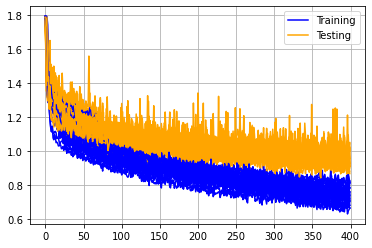

In [19]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [20]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  0.9596025276184081
mean accuracy:  0.6122665262222289


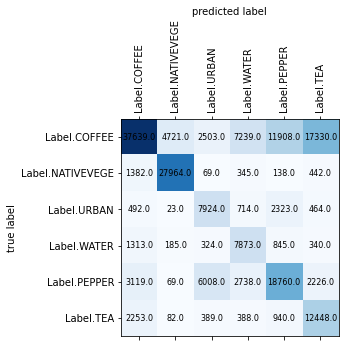

In [21]:
plot_confusion_matrix(conf_matrix, labels)

In [22]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.81473224 0.84626559 0.46024278 0.40799088 0.53732027 0.37437594]
Recalls:  [0.46273666 0.92168754 0.66365159 0.72362132 0.56986634 0.75442424]
F-Score:  [0.59023977 0.88236779 0.54354014 0.52178812 0.55311496 0.50042211]


# NIR, RED, SWIR2

In [24]:
BANDS = [
    Band.NIR.value,
    Band.RED.value,
    Band.SWIR2.value
]

In [25]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_3 (Rescaling)      (None, 11, 11, 3)         0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 11, 11, 8)         224       
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1655 - accuracy: 0.3924 - val_loss: 1.2377 - val_accuracy: 0.3711
Epoch 47/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1881 - accuracy: 0.3853 - val_loss: 1.1901 - val_accuracy: 0.3944
Epoch 48/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1859 - accuracy: 0.3991 - val_loss: 1.2015 - val_accuracy: 0.3873
Epoch 49/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1860 - accuracy: 0.3676 - val_loss: 1.2109 - val_accuracy: 0.3796
Epoch 50/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2112 - accuracy: 0.3652 - val_loss: 1.1920 - val_accuracy: 0.4031
Epoch 51/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1353 - accuracy: 0.4167 - val_loss: 1.2667 - val_accuracy: 0.4008
Epoch 52/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1286 - accuracy: 0.4198 - val_loss: 1.2707 - val_accuracy: 0.3672
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8703 - accuracy: 0.6042 - val_loss: 1.0539 - val_accuracy: 0.5623
Epoch 161/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8213 - accuracy: 0.5893 - val_loss: 1.0701 - val_accuracy: 0.5604
Epoch 162/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8785 - accuracy: 0.5912 - val_loss: 1.0443 - val_accuracy: 0.5695
Epoch 163/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8584 - accuracy: 0.6194 - val_loss: 1.0401 - val_accuracy: 0.5706
Epoch 164/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8479 - accuracy: 0.5931 - val_loss: 0.9969 - val_accuracy: 0.5907
Epoch 165/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8422 - accuracy: 0.5897 - val_loss: 1.0235 - val_accuracy: 0.6043
Epoch 166/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8062 - accuracy: 0.6425 - val_loss: 0.9982 - val_accuracy: 0.6001
Epoch 167/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7596 - accuracy: 0.6431 - val_loss: 0.9561 - val_accuracy: 0.6142
Epoch 275/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7229 - accuracy: 0.6426 - val_loss: 1.0015 - val_accuracy: 0.6074
Epoch 276/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7617 - accuracy: 0.6309 - val_loss: 0.9734 - val_accuracy: 0.6225
Epoch 277/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7520 - accuracy: 0.6502 - val_loss: 0.9998 - val_accuracy: 0.5875
Epoch 278/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7464 - accuracy: 0.6413 - val_loss: 0.9669 - val_accuracy: 0.6009
Epoch 279/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7833 - accuracy: 0.6391 - val_loss: 1.0009 - val_accuracy: 0.6097
Epoch 280/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7904 - accuracy: 0.6189 - val_loss: 0.9146 - val_accuracy: 0.6397
Epoch 281/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7521 - accuracy: 0.6412 - val_loss: 0.9840 - val_accuracy: 0.5931
Epoch 389/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7334 - accuracy: 0.6392 - val_loss: 0.9158 - val_accuracy: 0.6418
Epoch 390/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7706 - accuracy: 0.6359 - val_loss: 0.9181 - val_accuracy: 0.6395
Epoch 391/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7367 - accuracy: 0.6564 - val_loss: 0.9865 - val_accuracy: 0.5967
Epoch 392/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7278 - accuracy: 0.6262 - val_loss: 0.9746 - val_accuracy: 0.6082
Epoch 393/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8102 - accuracy: 0.6322 - val_loss: 0.9989 - val_accuracy: 0.6105
Epoch 394/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7524 - accuracy: 0.6482 - val_loss: 1.0152 - val_accuracy: 0.5719
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9596 - accuracy: 0.5072 - val_loss: 1.1583 - val_accuracy: 0.4934
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0769 - accuracy: 0.4928 - val_loss: 1.0956 - val_accuracy: 0.5410
Epoch 100/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0048 - accuracy: 0.5202 - val_loss: 1.1503 - val_accuracy: 0.5097
Epoch 101/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1104 - accuracy: 0.4890 - val_loss: 1.1186 - val_accuracy: 0.5092
Epoch 102/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0195 - accuracy: 0.5035 - val_loss: 1.1451 - val_accuracy: 0.5192
Epoch 103/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0123 - accuracy: 0.4996 - val_loss: 1.1257 - val_accuracy: 0.4897
Epoch 104/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0600 - accuracy: 0.5142 - val_loss: 1.1385 - val_accuracy: 0.5285
E

57/57 [==============================] - 0s 8ms/step - loss: 0.8934 - accuracy: 0.5552 - val_loss: 1.0423 - val_accuracy: 0.5858
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9299 - accuracy: 0.5821 - val_loss: 1.0585 - val_accuracy: 0.5660
Epoch 214/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8997 - accuracy: 0.5733 - val_loss: 1.0291 - val_accuracy: 0.5914
Epoch 215/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8585 - accuracy: 0.6040 - val_loss: 1.0504 - val_accuracy: 0.5679
Epoch 216/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8704 - accuracy: 0.5508 - val_loss: 1.1434 - val_accuracy: 0.5221
Epoch 217/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9563 - accuracy: 0.5616 - val_loss: 1.0564 - val_accuracy: 0.5716
Epoch 218/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8935 - accuracy: 0.5616 - val_loss: 1.0089 - val_accuracy: 0.5926
Epoch 219/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8051 - accuracy: 0.5975 - val_loss: 1.0135 - val_accuracy: 0.5838
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7887 - accuracy: 0.5900 - val_loss: 0.9726 - val_accuracy: 0.6026
Epoch 328/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8270 - accuracy: 0.5841 - val_loss: 1.0191 - val_accuracy: 0.5638
Epoch 329/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8082 - accuracy: 0.6048 - val_loss: 0.9891 - val_accuracy: 0.5920
Epoch 330/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9011 - accuracy: 0.5928 - val_loss: 1.0078 - val_accuracy: 0.5856
Epoch 331/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8347 - accuracy: 0.5652 - val_loss: 0.9598 - val_accuracy: 0.6007
Epoch 332/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7741 - accuracy: 0.5973 - val_loss: 1.0277 - val_accuracy: 0.5612
Epoch 333/400

57/57 [==============================] - 0s 8ms/step - loss: 1.0755 - accuracy: 0.4948 - val_loss: 1.2745 - val_accuracy: 0.4351
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0658 - accuracy: 0.5090 - val_loss: 1.1201 - val_accuracy: 0.4954
Epoch 37/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0605 - accuracy: 0.5061 - val_loss: 1.1204 - val_accuracy: 0.5277
Epoch 38/400
57/57 [==============================] - 0s 9ms/step - loss: 1.0161 - accuracy: 0.5211 - val_loss: 1.1751 - val_accuracy: 0.4490
Epoch 39/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0989 - accuracy: 0.5122 - val_loss: 1.0825 - val_accuracy: 0.5347
Epoch 40/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0180 - accuracy: 0.5183 - val_loss: 1.1877 - val_accuracy: 0.4631
Epoch 41/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0288 - accuracy: 0.5106 - val_loss: 1.1342 - val_accuracy: 0.5249
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9291 - accuracy: 0.5774 - val_loss: 1.0563 - val_accuracy: 0.5733
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9632 - accuracy: 0.5765 - val_loss: 1.1514 - val_accuracy: 0.5107
Epoch 95/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9599 - accuracy: 0.5308 - val_loss: 1.0705 - val_accuracy: 0.5735
Epoch 96/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9788 - accuracy: 0.5392 - val_loss: 1.0214 - val_accuracy: 0.5843
Epoch 97/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9106 - accuracy: 0.5914 - val_loss: 1.0606 - val_accuracy: 0.5727
Epoch 98/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9527 - accuracy: 0.5801 - val_loss: 1.0774 - val_accuracy: 0.5634
Epoch 99/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9171 - accuracy: 0.5827 - val_loss: 1.0536 - val_accuracy: 0.5754
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8318 - accuracy: 0.5896 - val_loss: 1.0371 - val_accuracy: 0.5735
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8466 - accuracy: 0.5862 - val_loss: 1.0352 - val_accuracy: 0.5627
Epoch 209/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8838 - accuracy: 0.5929 - val_loss: 0.9905 - val_accuracy: 0.5875
Epoch 210/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8618 - accuracy: 0.5798 - val_loss: 1.0526 - val_accuracy: 0.5762
Epoch 211/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8866 - accuracy: 0.5839 - val_loss: 1.0078 - val_accuracy: 0.5875
Epoch 212/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8143 - accuracy: 0.6311 - val_loss: 1.0413 - val_accuracy: 0.5759
Epoch 213/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8083 - accuracy: 0.6086 - val_loss: 1.1268 - val_accuracy: 0.5543
Epoch 214/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7967 - accuracy: 0.6227 - val_loss: 0.9947 - val_accuracy: 0.6036
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7807 - accuracy: 0.5917 - val_loss: 1.0464 - val_accuracy: 0.5811
Epoch 323/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7245 - accuracy: 0.6480 - val_loss: 0.9559 - val_accuracy: 0.6133
Epoch 324/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7655 - accuracy: 0.6432 - val_loss: 0.9837 - val_accuracy: 0.6081
Epoch 325/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8145 - accuracy: 0.6042 - val_loss: 1.0216 - val_accuracy: 0.5958
Epoch 326/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7621 - accuracy: 0.6358 - val_loss: 0.9436 - val_accuracy: 0.6172
Epoch 327/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7595 - accuracy: 0.6094 - val_loss: 1.0318 - val_accuracy: 0.5862
Epoch 328/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1814 - accuracy: 0.4145 - val_loss: 1.2076 - val_accuracy: 0.4110
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1640 - accuracy: 0.4258 - val_loss: 1.2086 - val_accuracy: 0.3992
Epoch 32/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1966 - accuracy: 0.4006 - val_loss: 1.2192 - val_accuracy: 0.4117
Epoch 33/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2019 - accuracy: 0.4151 - val_loss: 1.2346 - val_accuracy: 0.3788
Epoch 34/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2200 - accuracy: 0.3935 - val_loss: 1.2667 - val_accuracy: 0.3705
Epoch 35/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1398 - accuracy: 0.4137 - val_loss: 1.1963 - val_accuracy: 0.3958
Epoch 36/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1509 - accuracy: 0.4064 - val_loss: 1.2279 - val_accuracy: 0.3988
Epoch 37/400
57/57 

Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9470 - accuracy: 0.5088 - val_loss: 1.0743 - val_accuracy: 0.5153
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9755 - accuracy: 0.5377 - val_loss: 1.0952 - val_accuracy: 0.5112
Epoch 90/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9326 - accuracy: 0.5110 - val_loss: 1.0933 - val_accuracy: 0.5147
Epoch 91/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9065 - accuracy: 0.5300 - val_loss: 1.0272 - val_accuracy: 0.5570
Epoch 92/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9568 - accuracy: 0.5027 - val_loss: 1.0587 - val_accuracy: 0.5309
Epoch 93/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9905 - accuracy: 0.5028 - val_loss: 1.0620 - val_accuracy: 0.5298
Epoch 94/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9404 - accuracy: 0.5456 - val_loss: 1.0928 - val_accuracy: 0.5094
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8666 - accuracy: 0.5535 - val_loss: 1.0785 - val_accuracy: 0.5298
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8627 - accuracy: 0.5767 - val_loss: 1.0002 - val_accuracy: 0.5680
Epoch 204/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8810 - accuracy: 0.5562 - val_loss: 1.0364 - val_accuracy: 0.5489
Epoch 205/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8774 - accuracy: 0.5649 - val_loss: 1.0591 - val_accuracy: 0.5192
Epoch 206/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8307 - accuracy: 0.5771 - val_loss: 0.9686 - val_accuracy: 0.5880
Epoch 207/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8594 - accuracy: 0.5784 - val_loss: 1.0374 - val_accuracy: 0.5290
Epoch 208/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8181 - accuracy: 0.5547 - val_loss: 1.0216 - val_accuracy: 0.5449
Epoch 209/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7723 - accuracy: 0.5919 - val_loss: 1.0214 - val_accuracy: 0.5623
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7686 - accuracy: 0.6047 - val_loss: 0.9758 - val_accuracy: 0.5872
Epoch 318/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7742 - accuracy: 0.5653 - val_loss: 0.9992 - val_accuracy: 0.5640
Epoch 319/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8670 - accuracy: 0.5809 - val_loss: 0.9640 - val_accuracy: 0.6060
Epoch 320/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8335 - accuracy: 0.5960 - val_loss: 0.9842 - val_accuracy: 0.6017
Epoch 321/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7921 - accuracy: 0.5898 - val_loss: 1.0315 - val_accuracy: 0.5608
Epoch 322/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8827 - accuracy: 0.5694 - val_loss: 1.0142 - val_accuracy: 0.5702
Epoch 323/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2081 - accuracy: 0.3792 - val_loss: 1.3373 - val_accuracy: 0.3550
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3147 - accuracy: 0.3738 - val_loss: 1.2225 - val_accuracy: 0.3988
Epoch 27/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1865 - accuracy: 0.4055 - val_loss: 1.2396 - val_accuracy: 0.4030
Epoch 28/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2437 - accuracy: 0.3813 - val_loss: 1.2590 - val_accuracy: 0.3860
Epoch 29/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1728 - accuracy: 0.3837 - val_loss: 1.2573 - val_accuracy: 0.3921
Epoch 30/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2449 - accuracy: 0.4172 - val_loss: 1.2191 - val_accuracy: 0.4176
Epoch 31/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2039 - accuracy: 0.4160 - val_loss: 1.1964 - val_accuracy: 0.4226
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9865 - accuracy: 0.5322 - val_loss: 1.0902 - val_accuracy: 0.5327
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9917 - accuracy: 0.5107 - val_loss: 1.1309 - val_accuracy: 0.5058
Epoch 85/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9973 - accuracy: 0.5219 - val_loss: 1.0727 - val_accuracy: 0.5430
Epoch 86/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9634 - accuracy: 0.5464 - val_loss: 1.0667 - val_accuracy: 0.5548
Epoch 87/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0058 - accuracy: 0.5044 - val_loss: 1.1861 - val_accuracy: 0.4906
Epoch 88/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0035 - accuracy: 0.5211 - val_loss: 1.0997 - val_accuracy: 0.5243
Epoch 89/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0026 - accuracy: 0.5252 - val_loss: 1.0984 - val_accuracy: 0.5385
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8295 - accuracy: 0.5971 - val_loss: 1.0329 - val_accuracy: 0.5690
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9252 - accuracy: 0.5701 - val_loss: 1.0636 - val_accuracy: 0.5589
Epoch 199/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8414 - accuracy: 0.5707 - val_loss: 1.0717 - val_accuracy: 0.5569
Epoch 200/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8632 - accuracy: 0.5537 - val_loss: 1.0654 - val_accuracy: 0.5573
Epoch 201/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8961 - accuracy: 0.5751 - val_loss: 0.9829 - val_accuracy: 0.5949
Epoch 202/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7868 - accuracy: 0.6183 - val_loss: 0.9817 - val_accuracy: 0.5985
Epoch 203/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8685 - accuracy: 0.5906 - val_loss: 1.0200 - val_accuracy: 0.5713
Epoch 204/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8407 - accuracy: 0.5924 - val_loss: 0.9975 - val_accuracy: 0.5778
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8115 - accuracy: 0.6091 - val_loss: 0.9742 - val_accuracy: 0.5849
Epoch 313/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7744 - accuracy: 0.6213 - val_loss: 1.0284 - val_accuracy: 0.5607
Epoch 314/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8053 - accuracy: 0.5911 - val_loss: 1.0095 - val_accuracy: 0.5871
Epoch 315/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7499 - accuracy: 0.6000 - val_loss: 0.9711 - val_accuracy: 0.5948
Epoch 316/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7909 - accuracy: 0.6079 - val_loss: 0.9267 - val_accuracy: 0.6341
Epoch 317/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8178 - accuracy: 0.6296 - val_loss: 0.9571 - val_accuracy: 0.5990
Epoch 318/400

57/57 [==============================] - 0s 8ms/step - loss: 1.1099 - accuracy: 0.4408 - val_loss: 1.2005 - val_accuracy: 0.4358
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1031 - accuracy: 0.4216 - val_loss: 1.1397 - val_accuracy: 0.4468
Epoch 22/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0077 - accuracy: 0.4571 - val_loss: 1.1919 - val_accuracy: 0.4701
Epoch 23/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0987 - accuracy: 0.4278 - val_loss: 1.1712 - val_accuracy: 0.4755
Epoch 24/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9790 - accuracy: 0.4832 - val_loss: 1.2425 - val_accuracy: 0.4350
Epoch 25/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0327 - accuracy: 0.4545 - val_loss: 1.1526 - val_accuracy: 0.4318
Epoch 26/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0397 - accuracy: 0.4671 - val_loss: 1.1778 - val_accuracy: 0.4977
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9617 - accuracy: 0.5425 - val_loss: 1.0870 - val_accuracy: 0.5325
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8983 - accuracy: 0.5411 - val_loss: 1.0830 - val_accuracy: 0.5434
Epoch 80/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9557 - accuracy: 0.5136 - val_loss: 1.1281 - val_accuracy: 0.5116
Epoch 81/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9532 - accuracy: 0.5244 - val_loss: 1.1051 - val_accuracy: 0.5358
Epoch 82/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8722 - accuracy: 0.5606 - val_loss: 1.0566 - val_accuracy: 0.5614
Epoch 83/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9547 - accuracy: 0.5349 - val_loss: 1.0626 - val_accuracy: 0.5355
Epoch 84/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9783 - accuracy: 0.5240 - val_loss: 1.0931 - val_accuracy: 0.5484
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7994 - accuracy: 0.5702 - val_loss: 1.0181 - val_accuracy: 0.5808
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8182 - accuracy: 0.5851 - val_loss: 1.1053 - val_accuracy: 0.5464
Epoch 194/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8265 - accuracy: 0.5719 - val_loss: 0.9909 - val_accuracy: 0.5942
Epoch 195/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8440 - accuracy: 0.5885 - val_loss: 0.9997 - val_accuracy: 0.6036
Epoch 196/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8214 - accuracy: 0.6100 - val_loss: 1.0925 - val_accuracy: 0.5272
Epoch 197/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7912 - accuracy: 0.5784 - val_loss: 1.0184 - val_accuracy: 0.5797
Epoch 198/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7992 - accuracy: 0.6041 - val_loss: 1.0378 - val_accuracy: 0.5631
Epoch 199/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7406 - accuracy: 0.6242 - val_loss: 0.9471 - val_accuracy: 0.6247
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7441 - accuracy: 0.6325 - val_loss: 0.9406 - val_accuracy: 0.6301
Epoch 308/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6856 - accuracy: 0.6437 - val_loss: 0.9807 - val_accuracy: 0.6165
Epoch 309/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7283 - accuracy: 0.6151 - val_loss: 0.9423 - val_accuracy: 0.6154
Epoch 310/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7553 - accuracy: 0.6283 - val_loss: 0.9767 - val_accuracy: 0.6009
Epoch 311/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7389 - accuracy: 0.6030 - val_loss: 0.9602 - val_accuracy: 0.6240
Epoch 312/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7314 - accuracy: 0.6434 - val_loss: 0.9365 - val_accuracy: 0.6298
Epoch 313/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2308 - accuracy: 0.3415 - val_loss: 1.2404 - val_accuracy: 0.3640
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2898 - accuracy: 0.3423 - val_loss: 1.2321 - val_accuracy: 0.4158
Epoch 17/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2379 - accuracy: 0.3841 - val_loss: 1.2407 - val_accuracy: 0.3322
Epoch 18/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2483 - accuracy: 0.3781 - val_loss: 1.2509 - val_accuracy: 0.3488
Epoch 19/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1642 - accuracy: 0.3764 - val_loss: 1.2871 - val_accuracy: 0.3130
Epoch 20/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2125 - accuracy: 0.3667 - val_loss: 1.2434 - val_accuracy: 0.3590
Epoch 21/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1490 - accuracy: 0.3727 - val_loss: 1.3336 - val_accuracy: 0.3149
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0660 - accuracy: 0.4214 - val_loss: 1.1306 - val_accuracy: 0.4907
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9963 - accuracy: 0.4887 - val_loss: 1.2361 - val_accuracy: 0.4477
Epoch 75/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1362 - accuracy: 0.4280 - val_loss: 1.1237 - val_accuracy: 0.5028
Epoch 76/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0161 - accuracy: 0.4823 - val_loss: 1.1190 - val_accuracy: 0.5017
Epoch 77/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9705 - accuracy: 0.4715 - val_loss: 1.0895 - val_accuracy: 0.5168
Epoch 78/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9827 - accuracy: 0.4723 - val_loss: 1.1886 - val_accuracy: 0.4738
Epoch 79/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0862 - accuracy: 0.4649 - val_loss: 1.1000 - val_accuracy: 0.5209
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8511 - accuracy: 0.5567 - val_loss: 1.0274 - val_accuracy: 0.5750
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9285 - accuracy: 0.5450 - val_loss: 1.0311 - val_accuracy: 0.5557
Epoch 189/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9219 - accuracy: 0.5209 - val_loss: 1.0321 - val_accuracy: 0.5921
Epoch 190/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8782 - accuracy: 0.5561 - val_loss: 1.0616 - val_accuracy: 0.5551
Epoch 191/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8685 - accuracy: 0.5480 - val_loss: 1.0781 - val_accuracy: 0.5447
Epoch 192/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8706 - accuracy: 0.5332 - val_loss: 1.0594 - val_accuracy: 0.5576
Epoch 193/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8698 - accuracy: 0.5710 - val_loss: 0.9357 - val_accuracy: 0.6213
Epoch 194/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7854 - accuracy: 0.5716 - val_loss: 1.0451 - val_accuracy: 0.5491
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8035 - accuracy: 0.5653 - val_loss: 0.9830 - val_accuracy: 0.5971
Epoch 303/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8418 - accuracy: 0.5442 - val_loss: 0.9623 - val_accuracy: 0.6102
Epoch 304/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8131 - accuracy: 0.5829 - val_loss: 1.0109 - val_accuracy: 0.5687
Epoch 305/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7792 - accuracy: 0.5756 - val_loss: 1.0387 - val_accuracy: 0.5761
Epoch 306/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8261 - accuracy: 0.5659 - val_loss: 0.9597 - val_accuracy: 0.6008
Epoch 307/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8333 - accuracy: 0.5626 - val_loss: 1.0349 - val_accuracy: 0.5460
Epoch 308/400

57/57 [==============================] - 0s 8ms/step - loss: 1.2089 - accuracy: 0.3931 - val_loss: 1.2514 - val_accuracy: 0.3934
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2169 - accuracy: 0.3929 - val_loss: 1.2866 - val_accuracy: 0.3732
Epoch 12/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2522 - accuracy: 0.3710 - val_loss: 1.3042 - val_accuracy: 0.3559
Epoch 13/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1812 - accuracy: 0.3954 - val_loss: 1.2951 - val_accuracy: 0.3435
Epoch 14/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2040 - accuracy: 0.4085 - val_loss: 1.2573 - val_accuracy: 0.3587
Epoch 15/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1645 - accuracy: 0.4011 - val_loss: 1.2634 - val_accuracy: 0.4447
Epoch 16/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2282 - accuracy: 0.4072 - val_loss: 1.2800 - val_accuracy: 0.3398
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9102 - accuracy: 0.5553 - val_loss: 1.0767 - val_accuracy: 0.5637
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9011 - accuracy: 0.5865 - val_loss: 1.0492 - val_accuracy: 0.5761
Epoch 70/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8453 - accuracy: 0.5871 - val_loss: 1.0609 - val_accuracy: 0.5604
Epoch 71/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8540 - accuracy: 0.5795 - val_loss: 1.0332 - val_accuracy: 0.5784
Epoch 72/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8918 - accuracy: 0.5814 - val_loss: 1.0715 - val_accuracy: 0.5803
Epoch 73/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8545 - accuracy: 0.5972 - val_loss: 1.1256 - val_accuracy: 0.5104
Epoch 74/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8758 - accuracy: 0.5458 - val_loss: 1.0626 - val_accuracy: 0.5472
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.7883 - accuracy: 0.6088 - val_loss: 0.9607 - val_accuracy: 0.6021
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8461 - accuracy: 0.5775 - val_loss: 0.9602 - val_accuracy: 0.6156
Epoch 184/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7490 - accuracy: 0.6206 - val_loss: 1.0433 - val_accuracy: 0.5816
Epoch 185/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8092 - accuracy: 0.6236 - val_loss: 1.0057 - val_accuracy: 0.5811
Epoch 186/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7643 - accuracy: 0.6183 - val_loss: 0.9863 - val_accuracy: 0.5967
Epoch 187/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8053 - accuracy: 0.6146 - val_loss: 0.9375 - val_accuracy: 0.6331
Epoch 188/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7804 - accuracy: 0.6255 - val_loss: 0.9792 - val_accuracy: 0.6095
Epoch 189/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7209 - accuracy: 0.6486 - val_loss: 0.9951 - val_accuracy: 0.6127
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7263 - accuracy: 0.6407 - val_loss: 0.9779 - val_accuracy: 0.6004
Epoch 298/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7536 - accuracy: 0.6286 - val_loss: 0.9213 - val_accuracy: 0.6439
Epoch 299/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7229 - accuracy: 0.6445 - val_loss: 0.9431 - val_accuracy: 0.6346
Epoch 300/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7708 - accuracy: 0.6384 - val_loss: 0.9943 - val_accuracy: 0.5963
Epoch 301/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6929 - accuracy: 0.6437 - val_loss: 0.9781 - val_accuracy: 0.6205
Epoch 302/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7247 - accuracy: 0.6319 - val_loss: 0.9782 - val_accuracy: 0.6095
Epoch 303/400

57/57 [==============================] - 0s 8ms/step - loss: 1.4394 - accuracy: 0.3686 - val_loss: 1.3640 - val_accuracy: 0.4800
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3400 - accuracy: 0.4390 - val_loss: 1.4403 - val_accuracy: 0.3654
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4321 - accuracy: 0.3796 - val_loss: 1.3167 - val_accuracy: 0.4314
Epoch 8/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3765 - accuracy: 0.3973 - val_loss: 1.2996 - val_accuracy: 0.4524
Epoch 9/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2861 - accuracy: 0.3951 - val_loss: 1.2764 - val_accuracy: 0.4132
Epoch 10/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2542 - accuracy: 0.4500 - val_loss: 1.2947 - val_accuracy: 0.3919
Epoch 11/400
57/57 [==============================] - 0s 8ms/step - loss: 1.1800 - accuracy: 0.4322 - val_loss: 1.2828 - val_accuracy: 0.3915
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9701 - accuracy: 0.6007 - val_loss: 1.0769 - val_accuracy: 0.5830
Epoch 64/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9709 - accuracy: 0.5545 - val_loss: 1.0359 - val_accuracy: 0.5949
Epoch 65/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0770 - accuracy: 0.5426 - val_loss: 1.0765 - val_accuracy: 0.5902
Epoch 66/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9818 - accuracy: 0.5555 - val_loss: 1.0155 - val_accuracy: 0.6253
Epoch 67/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9918 - accuracy: 0.5921 - val_loss: 1.0735 - val_accuracy: 0.5767
Epoch 68/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9403 - accuracy: 0.5902 - val_loss: 1.0133 - val_accuracy: 0.6137
Epoch 69/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9830 - accuracy: 0.6045 - val_loss: 1.1337 - val_accuracy: 0.5028
Epoch 

57/57 [==============================] - 0s 8ms/step - loss: 0.8155 - accuracy: 0.6148 - val_loss: 1.0200 - val_accuracy: 0.5858
Epoch 178/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9095 - accuracy: 0.5880 - val_loss: 1.0016 - val_accuracy: 0.5945
Epoch 179/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8278 - accuracy: 0.5793 - val_loss: 1.0043 - val_accuracy: 0.6127
Epoch 180/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8179 - accuracy: 0.5919 - val_loss: 1.0572 - val_accuracy: 0.5977
Epoch 181/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9322 - accuracy: 0.5479 - val_loss: 0.9990 - val_accuracy: 0.5815
Epoch 182/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8518 - accuracy: 0.5914 - val_loss: 0.9707 - val_accuracy: 0.6058
Epoch 183/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8560 - accuracy: 0.6040 - val_loss: 1.0153 - val_accuracy: 0.5865
Epoch 184/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7577 - accuracy: 0.6520 - val_loss: 0.9677 - val_accuracy: 0.6204
Epoch 292/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7413 - accuracy: 0.6102 - val_loss: 0.9062 - val_accuracy: 0.6394
Epoch 293/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7732 - accuracy: 0.6416 - val_loss: 0.9525 - val_accuracy: 0.6221
Epoch 294/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7603 - accuracy: 0.6415 - val_loss: 0.9650 - val_accuracy: 0.6089
Epoch 295/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7410 - accuracy: 0.6640 - val_loss: 0.9281 - val_accuracy: 0.6242
Epoch 296/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7631 - accuracy: 0.6139 - val_loss: 0.9226 - val_accuracy: 0.6326
Epoch 297/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7682 - accuracy: 0.6620 - val_loss: 0.9214 - val_accuracy: 0.6365
Epoch 298/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8087 - accuracy: 0.1264 - val_loss: 1.7723 - val_accuracy: 0.2811
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7066 - accuracy: 0.2986 - val_loss: 1.5202 - val_accuracy: 0.2353
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4009 - accuracy: 0.3305 - val_loss: 1.3818 - val_accuracy: 0.3730
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3225 - accuracy: 0.3705 - val_loss: 1.4047 - val_accuracy: 0.3473
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3023 - accuracy: 0.3623 - val_loss: 1.3370 - val_accuracy: 0.3618
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2994 - accuracy: 0.3663 - val_loss: 1.2907 - val_accuracy: 0.4212
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3087 - accuracy: 0.4132 - val_loss: 1.2543 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9780 - accuracy: 0.5291 - val_loss: 1.0748 - val_accuracy: 0.5630
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9610 - accuracy: 0.5524 - val_loss: 1.0500 - val_accuracy: 0.5599
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9536 - accuracy: 0.5484 - val_loss: 1.1174 - val_accuracy: 0.5196
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9801 - accuracy: 0.5238 - val_loss: 1.0082 - val_accuracy: 0.6027
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9734 - accuracy: 0.5739 - val_loss: 1.0307 - val_accuracy: 0.5845
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0205 - accuracy: 0.5422 - val_loss: 1.0763 - val_accuracy: 0.5475
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9763 - accuracy: 0.5365 - val_loss: 1.1170 - val_accuracy: 0.5222

57/57 [==============================] - 0s 8ms/step - loss: 0.8451 - accuracy: 0.5845 - val_loss: 0.9953 - val_accuracy: 0.5807
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8481 - accuracy: 0.5818 - val_loss: 1.0130 - val_accuracy: 0.5765
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9098 - accuracy: 0.5616 - val_loss: 0.9739 - val_accuracy: 0.5952
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8538 - accuracy: 0.5719 - val_loss: 0.9973 - val_accuracy: 0.5951
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8430 - accuracy: 0.5642 - val_loss: 1.0491 - val_accuracy: 0.5372
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8757 - accuracy: 0.5534 - val_loss: 0.9768 - val_accuracy: 0.5872
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8738 - accuracy: 0.5975 - val_loss: 1.0119 - val_accuracy: 0.5561
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8552 - accuracy: 0.5660 - val_loss: 0.9765 - val_accuracy: 0.5750
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8477 - accuracy: 0.5928 - val_loss: 0.9755 - val_accuracy: 0.5907
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8187 - accuracy: 0.5896 - val_loss: 0.9469 - val_accuracy: 0.6080
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8480 - accuracy: 0.5967 - val_loss: 0.9260 - val_accuracy: 0.6152
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7907 - accuracy: 0.5744 - val_loss: 0.9376 - val_accuracy: 0.6102
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8174 - accuracy: 0.5972 - val_loss: 0.9835 - val_accuracy: 0.5831
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8311 - accuracy: 0.5832 - val_loss: 0.9809 - val_accuracy: 0.5744
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8082 - accuracy: 0.1105 - val_loss: 1.7668 - val_accuracy: 0.2229
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5841 - accuracy: 0.2602 - val_loss: 1.4876 - val_accuracy: 0.2524
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3781 - accuracy: 0.2745 - val_loss: 1.3785 - val_accuracy: 0.3210
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4481 - accuracy: 0.3063 - val_loss: 1.3993 - val_accuracy: 0.3458
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2259 - accuracy: 0.3932 - val_loss: 1.3263 - val_accuracy: 0.3303
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2340 - accuracy: 0.3716 - val_loss: 1.3386 - val_accuracy: 0.2991
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2521 - accuracy: 0.3404 - val_loss: 1.2993 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9003 - accuracy: 0.5449 - val_loss: 1.0868 - val_accuracy: 0.5595
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9423 - accuracy: 0.5328 - val_loss: 1.0988 - val_accuracy: 0.5468
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9539 - accuracy: 0.5741 - val_loss: 1.0529 - val_accuracy: 0.5640
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9325 - accuracy: 0.5652 - val_loss: 1.0611 - val_accuracy: 0.5583
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8722 - accuracy: 0.5600 - val_loss: 1.0994 - val_accuracy: 0.5302
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8889 - accuracy: 0.5665 - val_loss: 1.0618 - val_accuracy: 0.5484
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8609 - accuracy: 0.5621 - val_loss: 1.0700 - val_accuracy: 0.5363

57/57 [==============================] - 0s 8ms/step - loss: 0.7784 - accuracy: 0.5905 - val_loss: 1.0315 - val_accuracy: 0.5735
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7825 - accuracy: 0.5780 - val_loss: 0.9935 - val_accuracy: 0.6059
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7558 - accuracy: 0.6166 - val_loss: 1.0325 - val_accuracy: 0.5754
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8250 - accuracy: 0.5782 - val_loss: 1.0532 - val_accuracy: 0.5837
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8380 - accuracy: 0.5868 - val_loss: 0.9888 - val_accuracy: 0.5846
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8578 - accuracy: 0.5844 - val_loss: 0.9955 - val_accuracy: 0.5867
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7399 - accuracy: 0.6073 - val_loss: 1.0360 - val_accuracy: 0.5636
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7344 - accuracy: 0.6381 - val_loss: 1.0654 - val_accuracy: 0.5614
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7344 - accuracy: 0.5814 - val_loss: 0.9500 - val_accuracy: 0.6251
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6983 - accuracy: 0.6478 - val_loss: 0.9350 - val_accuracy: 0.6312
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7046 - accuracy: 0.6454 - val_loss: 1.0668 - val_accuracy: 0.5847
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6815 - accuracy: 0.6192 - val_loss: 0.9997 - val_accuracy: 0.6098
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8072 - accuracy: 0.6285 - val_loss: 1.0105 - val_accuracy: 0.5954
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7577 - accuracy: 0.6093 - val_loss: 0.9848 - val_accuracy: 0.6018
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8097 - accuracy: 0.1806 - val_loss: 1.7422 - val_accuracy: 0.3031
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6233 - accuracy: 0.2810 - val_loss: 1.4315 - val_accuracy: 0.2659
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4754 - accuracy: 0.3448 - val_loss: 1.3942 - val_accuracy: 0.4113
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3157 - accuracy: 0.4139 - val_loss: 1.3998 - val_accuracy: 0.2810
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3386 - accuracy: 0.3574 - val_loss: 1.3295 - val_accuracy: 0.4617
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3119 - accuracy: 0.4019 - val_loss: 1.2768 - val_accuracy: 0.4404
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2561 - accuracy: 0.4475 - val_loss: 1.3065 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9653 - accuracy: 0.5819 - val_loss: 1.0416 - val_accuracy: 0.5733
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9357 - accuracy: 0.5814 - val_loss: 1.0532 - val_accuracy: 0.5819
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9063 - accuracy: 0.5907 - val_loss: 1.1242 - val_accuracy: 0.5297
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9698 - accuracy: 0.5868 - val_loss: 1.0568 - val_accuracy: 0.5659
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9225 - accuracy: 0.5606 - val_loss: 1.0394 - val_accuracy: 0.5744
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9418 - accuracy: 0.5966 - val_loss: 1.1261 - val_accuracy: 0.5153
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9352 - accuracy: 0.5846 - val_loss: 1.0064 - val_accuracy: 0.6013

57/57 [==============================] - 0s 8ms/step - loss: 0.8209 - accuracy: 0.6224 - val_loss: 1.0943 - val_accuracy: 0.5785
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8397 - accuracy: 0.6031 - val_loss: 0.9984 - val_accuracy: 0.5921
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8383 - accuracy: 0.6133 - val_loss: 0.9868 - val_accuracy: 0.6114
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8529 - accuracy: 0.6268 - val_loss: 0.9951 - val_accuracy: 0.5929
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8301 - accuracy: 0.6191 - val_loss: 1.0069 - val_accuracy: 0.6047
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8296 - accuracy: 0.6258 - val_loss: 1.0158 - val_accuracy: 0.5948
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8341 - accuracy: 0.6216 - val_loss: 0.9925 - val_accuracy: 0.6156
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7853 - accuracy: 0.6242 - val_loss: 0.9822 - val_accuracy: 0.5968
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7860 - accuracy: 0.6240 - val_loss: 0.9610 - val_accuracy: 0.6268
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7859 - accuracy: 0.6440 - val_loss: 0.9726 - val_accuracy: 0.6138
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7612 - accuracy: 0.6414 - val_loss: 0.9586 - val_accuracy: 0.6261
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7254 - accuracy: 0.6573 - val_loss: 0.9490 - val_accuracy: 0.6307
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7965 - accuracy: 0.6346 - val_loss: 0.9685 - val_accuracy: 0.6042
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7493 - accuracy: 0.6458 - val_loss: 1.1125 - val_accuracy: 0.5460
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7640 - accuracy: 0.2257 - val_loss: 1.7451 - val_accuracy: 0.3443
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5888 - accuracy: 0.3426 - val_loss: 1.3819 - val_accuracy: 0.3315
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3483 - accuracy: 0.3246 - val_loss: 1.3941 - val_accuracy: 0.3087
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3576 - accuracy: 0.3252 - val_loss: 1.3085 - val_accuracy: 0.3442
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2601 - accuracy: 0.3728 - val_loss: 1.2906 - val_accuracy: 0.3750
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2840 - accuracy: 0.3737 - val_loss: 1.3716 - val_accuracy: 0.3402
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3134 - accuracy: 0.3648 - val_loss: 1.2894 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8621 - accuracy: 0.5733 - val_loss: 1.0155 - val_accuracy: 0.5786
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8214 - accuracy: 0.6012 - val_loss: 1.0419 - val_accuracy: 0.5570
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8344 - accuracy: 0.5754 - val_loss: 1.0806 - val_accuracy: 0.5267
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8305 - accuracy: 0.5541 - val_loss: 1.0757 - val_accuracy: 0.5331
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8611 - accuracy: 0.5661 - val_loss: 0.9935 - val_accuracy: 0.6057
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8304 - accuracy: 0.5954 - val_loss: 1.0657 - val_accuracy: 0.5566
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9512 - accuracy: 0.5472 - val_loss: 1.0134 - val_accuracy: 0.5925

57/57 [==============================] - 0s 8ms/step - loss: 0.7222 - accuracy: 0.6228 - val_loss: 0.9337 - val_accuracy: 0.6306
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7321 - accuracy: 0.6169 - val_loss: 0.9665 - val_accuracy: 0.6115
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7928 - accuracy: 0.6175 - val_loss: 0.9531 - val_accuracy: 0.6145
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7533 - accuracy: 0.6191 - val_loss: 0.8897 - val_accuracy: 0.6637
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7590 - accuracy: 0.6262 - val_loss: 0.9271 - val_accuracy: 0.6363
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7329 - accuracy: 0.6438 - val_loss: 0.9303 - val_accuracy: 0.6304
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6923 - accuracy: 0.6601 - val_loss: 1.0199 - val_accuracy: 0.6229
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.6421 - accuracy: 0.6653 - val_loss: 0.9176 - val_accuracy: 0.6481
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6277 - accuracy: 0.6668 - val_loss: 0.9545 - val_accuracy: 0.6350
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6628 - accuracy: 0.6573 - val_loss: 1.0873 - val_accuracy: 0.5546
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6906 - accuracy: 0.6331 - val_loss: 0.9538 - val_accuracy: 0.6263
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6442 - accuracy: 0.6473 - val_loss: 0.9286 - val_accuracy: 0.6436
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6386 - accuracy: 0.6805 - val_loss: 0.9233 - val_accuracy: 0.6383
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6599 - accuracy: 0.6720 - val_loss: 0.9734 - val_accuracy: 0.6265
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7976 - accuracy: 0.2159 - val_loss: 1.6859 - val_accuracy: 0.2891
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5445 - accuracy: 0.3294 - val_loss: 1.4196 - val_accuracy: 0.3223
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4540 - accuracy: 0.3202 - val_loss: 1.3297 - val_accuracy: 0.4166
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2839 - accuracy: 0.4012 - val_loss: 1.3664 - val_accuracy: 0.3034
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2953 - accuracy: 0.3455 - val_loss: 1.3181 - val_accuracy: 0.3095
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3064 - accuracy: 0.3680 - val_loss: 1.3618 - val_accuracy: 0.3102
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3057 - accuracy: 0.3489 - val_loss: 1.3327 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9331 - accuracy: 0.5751 - val_loss: 1.0335 - val_accuracy: 0.5951
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9751 - accuracy: 0.5710 - val_loss: 1.0800 - val_accuracy: 0.5480
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9936 - accuracy: 0.5955 - val_loss: 1.0771 - val_accuracy: 0.5565
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8938 - accuracy: 0.5887 - val_loss: 1.0066 - val_accuracy: 0.6099
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8938 - accuracy: 0.5965 - val_loss: 1.0783 - val_accuracy: 0.5778
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8990 - accuracy: 0.5945 - val_loss: 1.0203 - val_accuracy: 0.5971
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8802 - accuracy: 0.5855 - val_loss: 1.1017 - val_accuracy: 0.5653

57/57 [==============================] - 0s 8ms/step - loss: 0.8003 - accuracy: 0.6225 - val_loss: 0.9896 - val_accuracy: 0.6102
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8188 - accuracy: 0.6227 - val_loss: 0.9817 - val_accuracy: 0.6217
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7904 - accuracy: 0.6373 - val_loss: 0.9898 - val_accuracy: 0.6080
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8082 - accuracy: 0.6238 - val_loss: 0.9370 - val_accuracy: 0.6300
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8324 - accuracy: 0.5798 - val_loss: 0.9423 - val_accuracy: 0.6262
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8401 - accuracy: 0.6114 - val_loss: 1.0959 - val_accuracy: 0.5706
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8374 - accuracy: 0.6005 - val_loss: 0.9311 - val_accuracy: 0.6365
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7959 - accuracy: 0.6284 - val_loss: 0.9777 - val_accuracy: 0.6001
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7290 - accuracy: 0.6551 - val_loss: 0.9672 - val_accuracy: 0.6206
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7385 - accuracy: 0.6091 - val_loss: 0.8840 - val_accuracy: 0.6561
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7681 - accuracy: 0.6401 - val_loss: 0.9237 - val_accuracy: 0.6261
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7924 - accuracy: 0.6449 - val_loss: 0.9349 - val_accuracy: 0.6367
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7681 - accuracy: 0.6600 - val_loss: 0.9404 - val_accuracy: 0.6353
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7025 - accuracy: 0.6612 - val_loss: 0.9973 - val_accuracy: 0.5928
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7899 - accuracy: 0.1707 - val_loss: 1.7856 - val_accuracy: 0.2506
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7649 - accuracy: 0.1822 - val_loss: 1.5453 - val_accuracy: 0.3506
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4210 - accuracy: 0.3693 - val_loss: 1.3247 - val_accuracy: 0.3325
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3819 - accuracy: 0.3220 - val_loss: 1.2995 - val_accuracy: 0.3099
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2608 - accuracy: 0.3953 - val_loss: 1.3408 - val_accuracy: 0.3068
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2733 - accuracy: 0.3389 - val_loss: 1.2928 - val_accuracy: 0.3500
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2526 - accuracy: 0.3288 - val_loss: 1.2954 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9195 - accuracy: 0.5159 - val_loss: 1.0416 - val_accuracy: 0.5485
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9001 - accuracy: 0.5292 - val_loss: 1.0285 - val_accuracy: 0.5646
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9212 - accuracy: 0.5396 - val_loss: 1.1307 - val_accuracy: 0.5224
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9583 - accuracy: 0.5264 - val_loss: 1.0517 - val_accuracy: 0.5596
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9201 - accuracy: 0.5351 - val_loss: 1.0995 - val_accuracy: 0.5172
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9256 - accuracy: 0.5113 - val_loss: 1.0436 - val_accuracy: 0.5332
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9389 - accuracy: 0.5175 - val_loss: 1.0896 - val_accuracy: 0.5311

57/57 [==============================] - 0s 8ms/step - loss: 0.7784 - accuracy: 0.5829 - val_loss: 0.9863 - val_accuracy: 0.5709
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7951 - accuracy: 0.5690 - val_loss: 0.9876 - val_accuracy: 0.5868
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8581 - accuracy: 0.5514 - val_loss: 1.0542 - val_accuracy: 0.5572
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8319 - accuracy: 0.5508 - val_loss: 0.9801 - val_accuracy: 0.5909
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8460 - accuracy: 0.5613 - val_loss: 0.9836 - val_accuracy: 0.5710
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8043 - accuracy: 0.5707 - val_loss: 1.1581 - val_accuracy: 0.4935
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8309 - accuracy: 0.5390 - val_loss: 1.0084 - val_accuracy: 0.5781
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7956 - accuracy: 0.6097 - val_loss: 0.9193 - val_accuracy: 0.6223
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7273 - accuracy: 0.5950 - val_loss: 1.0214 - val_accuracy: 0.5572
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7497 - accuracy: 0.5883 - val_loss: 0.9616 - val_accuracy: 0.5865
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8246 - accuracy: 0.5843 - val_loss: 0.9343 - val_accuracy: 0.6238
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7929 - accuracy: 0.5755 - val_loss: 0.9919 - val_accuracy: 0.5932
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8199 - accuracy: 0.5963 - val_loss: 0.9502 - val_accuracy: 0.6156
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7540 - accuracy: 0.6067 - val_loss: 0.9878 - val_accuracy: 0.5762
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7861 - accuracy: 0.1058 - val_loss: 1.7862 - val_accuracy: 0.2255
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7536 - accuracy: 0.2648 - val_loss: 1.4637 - val_accuracy: 0.3163
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3703 - accuracy: 0.3577 - val_loss: 1.3263 - val_accuracy: 0.3177
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2983 - accuracy: 0.3677 - val_loss: 1.3272 - val_accuracy: 0.2732
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2583 - accuracy: 0.3779 - val_loss: 1.2184 - val_accuracy: 0.4750
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3090 - accuracy: 0.4113 - val_loss: 1.3915 - val_accuracy: 0.3094
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2823 - accuracy: 0.3786 - val_loss: 1.2694 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9875 - accuracy: 0.5499 - val_loss: 1.0599 - val_accuracy: 0.5511
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9282 - accuracy: 0.5629 - val_loss: 1.0940 - val_accuracy: 0.5261
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0040 - accuracy: 0.5246 - val_loss: 1.0501 - val_accuracy: 0.5780
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9208 - accuracy: 0.5728 - val_loss: 1.1891 - val_accuracy: 0.4954
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0540 - accuracy: 0.5115 - val_loss: 1.0353 - val_accuracy: 0.5749
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9497 - accuracy: 0.5704 - val_loss: 1.0746 - val_accuracy: 0.5587
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9211 - accuracy: 0.5510 - val_loss: 1.0961 - val_accuracy: 0.5561

57/57 [==============================] - 0s 8ms/step - loss: 0.9066 - accuracy: 0.5636 - val_loss: 1.1018 - val_accuracy: 0.5629
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9088 - accuracy: 0.5740 - val_loss: 1.0982 - val_accuracy: 0.5332
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9069 - accuracy: 0.5499 - val_loss: 1.0454 - val_accuracy: 0.5738
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8293 - accuracy: 0.5741 - val_loss: 1.0364 - val_accuracy: 0.5734
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8832 - accuracy: 0.5779 - val_loss: 1.0668 - val_accuracy: 0.5624
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8649 - accuracy: 0.5675 - val_loss: 1.0326 - val_accuracy: 0.5798
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9246 - accuracy: 0.5739 - val_loss: 1.0383 - val_accuracy: 0.5632
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8069 - accuracy: 0.5659 - val_loss: 0.9770 - val_accuracy: 0.5980
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8262 - accuracy: 0.5980 - val_loss: 1.0286 - val_accuracy: 0.5548
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7832 - accuracy: 0.6166 - val_loss: 0.9884 - val_accuracy: 0.5866
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7395 - accuracy: 0.5972 - val_loss: 1.0060 - val_accuracy: 0.5696
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8010 - accuracy: 0.6054 - val_loss: 0.9795 - val_accuracy: 0.6093
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7681 - accuracy: 0.5906 - val_loss: 1.0212 - val_accuracy: 0.5689
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8872 - accuracy: 0.5899 - val_loss: 1.0616 - val_accuracy: 0.5279
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7911 - accuracy: 0.1075 - val_loss: 1.7831 - val_accuracy: 0.4131
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7628 - accuracy: 0.2633 - val_loss: 1.4695 - val_accuracy: 0.3079
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4056 - accuracy: 0.3293 - val_loss: 1.2855 - val_accuracy: 0.4808
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3151 - accuracy: 0.4132 - val_loss: 1.2895 - val_accuracy: 0.3533
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3115 - accuracy: 0.3382 - val_loss: 1.3045 - val_accuracy: 0.4804
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2678 - accuracy: 0.4128 - val_loss: 1.2471 - val_accuracy: 0.3603
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2238 - accuracy: 0.3867 - val_loss: 1.2500 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8884 - accuracy: 0.5685 - val_loss: 1.1168 - val_accuracy: 0.5037
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8471 - accuracy: 0.5592 - val_loss: 1.0720 - val_accuracy: 0.5476
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9071 - accuracy: 0.5534 - val_loss: 1.0429 - val_accuracy: 0.5645
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8982 - accuracy: 0.5665 - val_loss: 1.0377 - val_accuracy: 0.5691
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8849 - accuracy: 0.5683 - val_loss: 1.0504 - val_accuracy: 0.5584
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8992 - accuracy: 0.5536 - val_loss: 1.0891 - val_accuracy: 0.5135
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9027 - accuracy: 0.5772 - val_loss: 1.0210 - val_accuracy: 0.5837

57/57 [==============================] - 0s 8ms/step - loss: 0.8445 - accuracy: 0.5894 - val_loss: 1.1133 - val_accuracy: 0.5304
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8221 - accuracy: 0.5772 - val_loss: 0.9930 - val_accuracy: 0.5752
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7755 - accuracy: 0.6074 - val_loss: 1.0033 - val_accuracy: 0.5600
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8204 - accuracy: 0.5963 - val_loss: 1.0090 - val_accuracy: 0.5710
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7948 - accuracy: 0.6168 - val_loss: 0.9822 - val_accuracy: 0.5891
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7944 - accuracy: 0.6166 - val_loss: 0.9898 - val_accuracy: 0.5841
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8114 - accuracy: 0.5782 - val_loss: 1.0570 - val_accuracy: 0.5387
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.8130 - accuracy: 0.5946 - val_loss: 0.9755 - val_accuracy: 0.6065
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7259 - accuracy: 0.6202 - val_loss: 1.0011 - val_accuracy: 0.5828
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7214 - accuracy: 0.6224 - val_loss: 0.9677 - val_accuracy: 0.5997
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7306 - accuracy: 0.6151 - val_loss: 0.9507 - val_accuracy: 0.6047
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6979 - accuracy: 0.6356 - val_loss: 0.9851 - val_accuracy: 0.5930
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7652 - accuracy: 0.5936 - val_loss: 1.0123 - val_accuracy: 0.5778
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7463 - accuracy: 0.6262 - val_loss: 0.9861 - val_accuracy: 0.5967
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7680 - accuracy: 0.1297 - val_loss: 1.7849 - val_accuracy: 0.1728
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7431 - accuracy: 0.2326 - val_loss: 1.5785 - val_accuracy: 0.2709
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5146 - accuracy: 0.3062 - val_loss: 1.5094 - val_accuracy: 0.3312
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3684 - accuracy: 0.3736 - val_loss: 1.4175 - val_accuracy: 0.3482
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4670 - accuracy: 0.3518 - val_loss: 1.4067 - val_accuracy: 0.4036
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3695 - accuracy: 0.3376 - val_loss: 1.3508 - val_accuracy: 0.3410
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3562 - accuracy: 0.3526 - val_loss: 1.6048 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9530 - accuracy: 0.5403 - val_loss: 1.1057 - val_accuracy: 0.5248
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9598 - accuracy: 0.5412 - val_loss: 1.0105 - val_accuracy: 0.5814
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9522 - accuracy: 0.5516 - val_loss: 1.0852 - val_accuracy: 0.5209
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9316 - accuracy: 0.5199 - val_loss: 1.0460 - val_accuracy: 0.5599
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9094 - accuracy: 0.5805 - val_loss: 1.0703 - val_accuracy: 0.5408
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9575 - accuracy: 0.5528 - val_loss: 1.0501 - val_accuracy: 0.5608
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9509 - accuracy: 0.5614 - val_loss: 1.0433 - val_accuracy: 0.5587

57/57 [==============================] - 0s 8ms/step - loss: 0.8931 - accuracy: 0.5913 - val_loss: 1.0293 - val_accuracy: 0.5707
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9099 - accuracy: 0.5461 - val_loss: 1.0221 - val_accuracy: 0.5823
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8707 - accuracy: 0.5654 - val_loss: 1.0002 - val_accuracy: 0.5790
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8932 - accuracy: 0.5653 - val_loss: 1.0021 - val_accuracy: 0.5804
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8957 - accuracy: 0.5656 - val_loss: 0.9684 - val_accuracy: 0.5947
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8293 - accuracy: 0.5943 - val_loss: 1.0336 - val_accuracy: 0.5671
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9081 - accuracy: 0.5985 - val_loss: 1.0381 - val_accuracy: 0.5566
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7986 - accuracy: 0.6065 - val_loss: 1.0016 - val_accuracy: 0.5775
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8091 - accuracy: 0.6056 - val_loss: 1.0732 - val_accuracy: 0.5394
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9117 - accuracy: 0.5726 - val_loss: 0.9858 - val_accuracy: 0.5811
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8526 - accuracy: 0.6061 - val_loss: 0.9647 - val_accuracy: 0.5955
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8267 - accuracy: 0.6212 - val_loss: 1.0225 - val_accuracy: 0.5680
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8591 - accuracy: 0.5914 - val_loss: 1.0544 - val_accuracy: 0.5471
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8841 - accuracy: 0.5701 - val_loss: 0.9595 - val_accuracy: 0.5966
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7688 - accuracy: 0.2130 - val_loss: 1.7920 - val_accuracy: 0.0602
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7896 - accuracy: 0.1227 - val_loss: 1.7899 - val_accuracy: 0.4380
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7930 - accuracy: 0.2187 - val_loss: 1.7901 - val_accuracy: 0.0658
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7724 - accuracy: 0.2201 - val_loss: 1.7908 - val_accuracy: 0.0658
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7978 - accuracy: 0.2145 - val_loss: 1.7910 - val_accuracy: 0.0658
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7908 - accuracy: 0.2444 - val_loss: 1.7901 - val_accuracy: 0.4380
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7593 - accuracy: 0.3040 - val_loss: 1.7896 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7771 - accuracy: 0.0813 - val_loss: 1.7923 - val_accuracy: 0.0658
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7813 - accuracy: 0.0844 - val_loss: 1.7917 - val_accuracy: 0.0658
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7424 - accuracy: 0.1876 - val_loss: 1.7906 - val_accuracy: 0.4380
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7967 - accuracy: 0.1571 - val_loss: 1.7925 - val_accuracy: 0.1672
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7985 - accuracy: 0.1198 - val_loss: 1.7920 - val_accuracy: 0.0658
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7922 - accuracy: 0.1174 - val_loss: 1.7920 - val_accuracy: 0.0882
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7942 - accuracy: 0.0948 - val_loss: 1.7915 - val_accuracy: 0.0602

57/57 [==============================] - 0s 8ms/step - loss: 1.8354 - accuracy: 0.0749 - val_loss: 1.7932 - val_accuracy: 0.0658
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8345 - accuracy: 0.0667 - val_loss: 1.7930 - val_accuracy: 0.0658
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7693 - accuracy: 0.0758 - val_loss: 1.7920 - val_accuracy: 0.0602
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8263 - accuracy: 0.0595 - val_loss: 1.7926 - val_accuracy: 0.0658
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7365 - accuracy: 0.1096 - val_loss: 1.7915 - val_accuracy: 0.1806
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7278 - accuracy: 0.2045 - val_loss: 1.7908 - val_accuracy: 0.1806
Epoch 236/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7968 - accuracy: 0.1810 - val_loss: 1.7922 - val_accuracy: 0.1806
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 1.7797 - accuracy: 0.0594 - val_loss: 1.7922 - val_accuracy: 0.0602
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8253 - accuracy: 0.0690 - val_loss: 1.7922 - val_accuracy: 0.1806
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7490 - accuracy: 0.2036 - val_loss: 1.7913 - val_accuracy: 0.4380
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7962 - accuracy: 0.1696 - val_loss: 1.7923 - val_accuracy: 0.1672
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7865 - accuracy: 0.1738 - val_loss: 1.7915 - val_accuracy: 0.1672
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8051 - accuracy: 0.1615 - val_loss: 1.7924 - val_accuracy: 0.1672
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7873 - accuracy: 0.1574 - val_loss: 1.7916 - val_accuracy: 0.1672
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7625 - accuracy: 0.1747 - val_loss: 1.7576 - val_accuracy: 0.1774
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6985 - accuracy: 0.2175 - val_loss: 1.4150 - val_accuracy: 0.3815
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4427 - accuracy: 0.3370 - val_loss: 1.3159 - val_accuracy: 0.4945
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3350 - accuracy: 0.3958 - val_loss: 1.3407 - val_accuracy: 0.3253
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2653 - accuracy: 0.3446 - val_loss: 1.3312 - val_accuracy: 0.4011
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2483 - accuracy: 0.3506 - val_loss: 1.3452 - val_accuracy: 0.2901
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2220 - accuracy: 0.3572 - val_loss: 1.3424 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8648 - accuracy: 0.5961 - val_loss: 0.9595 - val_accuracy: 0.6187
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8793 - accuracy: 0.6207 - val_loss: 1.0800 - val_accuracy: 0.5661
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8949 - accuracy: 0.5747 - val_loss: 1.0720 - val_accuracy: 0.5625
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8704 - accuracy: 0.5873 - val_loss: 1.1117 - val_accuracy: 0.5514
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9246 - accuracy: 0.5926 - val_loss: 1.1160 - val_accuracy: 0.5379
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9025 - accuracy: 0.5502 - val_loss: 1.2037 - val_accuracy: 0.4748
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8961 - accuracy: 0.5524 - val_loss: 1.0167 - val_accuracy: 0.5906

57/57 [==============================] - 0s 8ms/step - loss: 0.7949 - accuracy: 0.5905 - val_loss: 1.0371 - val_accuracy: 0.5702
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8087 - accuracy: 0.6042 - val_loss: 0.9874 - val_accuracy: 0.5958
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7856 - accuracy: 0.6108 - val_loss: 1.0520 - val_accuracy: 0.5722
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8074 - accuracy: 0.6076 - val_loss: 1.0313 - val_accuracy: 0.5790
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7908 - accuracy: 0.6301 - val_loss: 0.9441 - val_accuracy: 0.6161
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7619 - accuracy: 0.5906 - val_loss: 1.0993 - val_accuracy: 0.5376
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8103 - accuracy: 0.6111 - val_loss: 0.9516 - val_accuracy: 0.6073
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7492 - accuracy: 0.6036 - val_loss: 0.9217 - val_accuracy: 0.6277
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7603 - accuracy: 0.6283 - val_loss: 0.9595 - val_accuracy: 0.6089
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7563 - accuracy: 0.6136 - val_loss: 0.9454 - val_accuracy: 0.6242
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7126 - accuracy: 0.6541 - val_loss: 0.9498 - val_accuracy: 0.6138
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7152 - accuracy: 0.6405 - val_loss: 0.9438 - val_accuracy: 0.6145
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7533 - accuracy: 0.6188 - val_loss: 0.9228 - val_accuracy: 0.6246
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7563 - accuracy: 0.6329 - val_loss: 0.9677 - val_accuracy: 0.6085
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8094 - accuracy: 0.0979 - val_loss: 1.7775 - val_accuracy: 0.1797
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7274 - accuracy: 0.2074 - val_loss: 1.4430 - val_accuracy: 0.3185
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4303 - accuracy: 0.3421 - val_loss: 1.3643 - val_accuracy: 0.3781
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3437 - accuracy: 0.3537 - val_loss: 1.3458 - val_accuracy: 0.3704
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3099 - accuracy: 0.3777 - val_loss: 1.3294 - val_accuracy: 0.3248
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3105 - accuracy: 0.3648 - val_loss: 1.3463 - val_accuracy: 0.3603
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3108 - accuracy: 0.3578 - val_loss: 1.2645 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9066 - accuracy: 0.5609 - val_loss: 1.0758 - val_accuracy: 0.5498
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9591 - accuracy: 0.5494 - val_loss: 0.9806 - val_accuracy: 0.6014
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9142 - accuracy: 0.5565 - val_loss: 0.9910 - val_accuracy: 0.5956
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9170 - accuracy: 0.5910 - val_loss: 1.0231 - val_accuracy: 0.5700
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9006 - accuracy: 0.5626 - val_loss: 1.0431 - val_accuracy: 0.5625
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9968 - accuracy: 0.5395 - val_loss: 0.9773 - val_accuracy: 0.5916
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8871 - accuracy: 0.5880 - val_loss: 1.0615 - val_accuracy: 0.5372

57/57 [==============================] - 0s 8ms/step - loss: 0.7654 - accuracy: 0.6227 - val_loss: 0.9668 - val_accuracy: 0.6041
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7697 - accuracy: 0.6035 - val_loss: 0.9779 - val_accuracy: 0.6055
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7397 - accuracy: 0.6348 - val_loss: 0.9715 - val_accuracy: 0.5813
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7262 - accuracy: 0.6235 - val_loss: 0.9091 - val_accuracy: 0.6298
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7213 - accuracy: 0.6450 - val_loss: 1.0520 - val_accuracy: 0.5493
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7824 - accuracy: 0.6057 - val_loss: 0.9312 - val_accuracy: 0.6195
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7335 - accuracy: 0.6160 - val_loss: 1.0017 - val_accuracy: 0.5782
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7243 - accuracy: 0.6529 - val_loss: 0.9264 - val_accuracy: 0.6157
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6916 - accuracy: 0.6225 - val_loss: 0.9669 - val_accuracy: 0.6077
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6790 - accuracy: 0.6450 - val_loss: 0.8707 - val_accuracy: 0.6610
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6812 - accuracy: 0.6538 - val_loss: 0.9238 - val_accuracy: 0.6320
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6921 - accuracy: 0.6443 - val_loss: 0.9354 - val_accuracy: 0.6190
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6857 - accuracy: 0.6233 - val_loss: 0.9299 - val_accuracy: 0.6195
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6706 - accuracy: 0.6383 - val_loss: 0.9254 - val_accuracy: 0.6309
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8016 - accuracy: 0.0740 - val_loss: 1.7813 - val_accuracy: 0.0686
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7910 - accuracy: 0.1241 - val_loss: 1.5724 - val_accuracy: 0.2458
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3791 - accuracy: 0.3628 - val_loss: 1.4035 - val_accuracy: 0.3110
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3008 - accuracy: 0.3491 - val_loss: 1.4165 - val_accuracy: 0.3629
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2394 - accuracy: 0.3772 - val_loss: 1.3863 - val_accuracy: 0.3336
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2582 - accuracy: 0.3524 - val_loss: 1.2980 - val_accuracy: 0.3529
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.2040 - accuracy: 0.3660 - val_loss: 1.3859 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9317 - accuracy: 0.5424 - val_loss: 1.0822 - val_accuracy: 0.5472
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9828 - accuracy: 0.5363 - val_loss: 1.0930 - val_accuracy: 0.5228
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8850 - accuracy: 0.5738 - val_loss: 1.0262 - val_accuracy: 0.5954
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8836 - accuracy: 0.5578 - val_loss: 1.0485 - val_accuracy: 0.5592
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9177 - accuracy: 0.5787 - val_loss: 1.0677 - val_accuracy: 0.5464
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9717 - accuracy: 0.5367 - val_loss: 1.0433 - val_accuracy: 0.5633
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8800 - accuracy: 0.5782 - val_loss: 1.0699 - val_accuracy: 0.5298

57/57 [==============================] - 0s 8ms/step - loss: 0.7541 - accuracy: 0.5723 - val_loss: 1.0864 - val_accuracy: 0.5239
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7884 - accuracy: 0.5793 - val_loss: 1.0599 - val_accuracy: 0.5557
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7562 - accuracy: 0.6078 - val_loss: 0.9743 - val_accuracy: 0.5955
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7606 - accuracy: 0.6095 - val_loss: 0.9561 - val_accuracy: 0.6179
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8084 - accuracy: 0.6060 - val_loss: 1.0228 - val_accuracy: 0.5790
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8238 - accuracy: 0.5660 - val_loss: 1.0086 - val_accuracy: 0.5801
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8180 - accuracy: 0.5988 - val_loss: 1.0474 - val_accuracy: 0.5205
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7274 - accuracy: 0.6256 - val_loss: 0.9467 - val_accuracy: 0.5977
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6770 - accuracy: 0.6220 - val_loss: 0.9252 - val_accuracy: 0.6058
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7030 - accuracy: 0.6239 - val_loss: 1.0630 - val_accuracy: 0.5387
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7481 - accuracy: 0.5836 - val_loss: 1.0008 - val_accuracy: 0.5799
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7152 - accuracy: 0.6071 - val_loss: 1.0005 - val_accuracy: 0.5751
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7017 - accuracy: 0.5978 - val_loss: 0.9607 - val_accuracy: 0.6005
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7270 - accuracy: 0.5981 - val_loss: 1.0048 - val_accuracy: 0.5695
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7928 - accuracy: 0.1266 - val_loss: 1.7664 - val_accuracy: 0.0937
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7561 - accuracy: 0.1606 - val_loss: 1.5520 - val_accuracy: 0.1638
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.5149 - accuracy: 0.2653 - val_loss: 1.4914 - val_accuracy: 0.3739
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4770 - accuracy: 0.3396 - val_loss: 1.4070 - val_accuracy: 0.4056
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3669 - accuracy: 0.3634 - val_loss: 1.4628 - val_accuracy: 0.3228
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4393 - accuracy: 0.3534 - val_loss: 1.3970 - val_accuracy: 0.3719
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3818 - accuracy: 0.3732 - val_loss: 1.3946 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9580 - accuracy: 0.5502 - val_loss: 1.0777 - val_accuracy: 0.5427
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9041 - accuracy: 0.5343 - val_loss: 1.0519 - val_accuracy: 0.5690
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9120 - accuracy: 0.5569 - val_loss: 1.0806 - val_accuracy: 0.5233
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0169 - accuracy: 0.5642 - val_loss: 1.0831 - val_accuracy: 0.5383
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9293 - accuracy: 0.5153 - val_loss: 1.0345 - val_accuracy: 0.5679
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9530 - accuracy: 0.5699 - val_loss: 1.1261 - val_accuracy: 0.5309
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8940 - accuracy: 0.5494 - val_loss: 1.0560 - val_accuracy: 0.5554

57/57 [==============================] - 0s 8ms/step - loss: 0.8727 - accuracy: 0.5792 - val_loss: 0.9854 - val_accuracy: 0.5954
Epoch 231/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9067 - accuracy: 0.5984 - val_loss: 0.9941 - val_accuracy: 0.6050
Epoch 232/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8674 - accuracy: 0.5891 - val_loss: 0.9792 - val_accuracy: 0.6085
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8868 - accuracy: 0.5562 - val_loss: 1.0313 - val_accuracy: 0.5379
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8316 - accuracy: 0.6078 - val_loss: 1.0196 - val_accuracy: 0.5875
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8680 - accuracy: 0.5729 - val_loss: 1.0283 - val_accuracy: 0.5644
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8504 - accuracy: 0.5558 - val_loss: 0.9344 - val_accuracy: 0.6248
Epoch 237/400

57/57 [==============================] - 0s 8ms/step - loss: 0.7912 - accuracy: 0.5889 - val_loss: 0.9937 - val_accuracy: 0.5690
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7577 - accuracy: 0.5927 - val_loss: 1.0214 - val_accuracy: 0.5661
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7479 - accuracy: 0.6320 - val_loss: 0.9508 - val_accuracy: 0.6144
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7218 - accuracy: 0.6216 - val_loss: 1.0444 - val_accuracy: 0.5334
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7887 - accuracy: 0.5754 - val_loss: 0.9235 - val_accuracy: 0.6223
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7517 - accuracy: 0.6280 - val_loss: 0.9951 - val_accuracy: 0.5693
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7927 - accuracy: 0.6071 - val_loss: 0.9510 - val_accuracy: 0.6125
Epoch 351/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8243 - accuracy: 0.1360 - val_loss: 1.7939 - val_accuracy: 0.0658
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7770 - accuracy: 0.1186 - val_loss: 1.7102 - val_accuracy: 0.2524
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6310 - accuracy: 0.2735 - val_loss: 1.5200 - val_accuracy: 0.4380
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4621 - accuracy: 0.3711 - val_loss: 1.3609 - val_accuracy: 0.3962
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3376 - accuracy: 0.3835 - val_loss: 1.3882 - val_accuracy: 0.3028
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3074 - accuracy: 0.3541 - val_loss: 1.2908 - val_accuracy: 0.3647
Epoch 7/400
57/57 [==============================] - 0s 8ms/step - loss: 1.3023 - accuracy: 0.3733 - val_loss: 1.2825 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9653 - accuracy: 0.5403 - val_loss: 0.9971 - val_accuracy: 0.6073
Epoch 117/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8503 - accuracy: 0.5974 - val_loss: 1.0158 - val_accuracy: 0.5959
Epoch 118/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8824 - accuracy: 0.5787 - val_loss: 1.0908 - val_accuracy: 0.5531
Epoch 119/400
57/57 [==============================] - 0s 8ms/step - loss: 1.0032 - accuracy: 0.5685 - val_loss: 1.0539 - val_accuracy: 0.5558
Epoch 120/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9417 - accuracy: 0.5799 - val_loss: 1.0597 - val_accuracy: 0.5790
Epoch 121/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9577 - accuracy: 0.5722 - val_loss: 1.0312 - val_accuracy: 0.5827
Epoch 122/400
57/57 [==============================] - 0s 8ms/step - loss: 0.9207 - accuracy: 0.5597 - val_loss: 1.0267 - val_accuracy: 0.5864

57/57 [==============================] - 1s 9ms/step - loss: 0.8774 - accuracy: 0.5776 - val_loss: 0.9842 - val_accuracy: 0.6011
Epoch 231/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8149 - accuracy: 0.6376 - val_loss: 1.1087 - val_accuracy: 0.5421
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8545 - accuracy: 0.5777 - val_loss: 0.9868 - val_accuracy: 0.6050
Epoch 233/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8728 - accuracy: 0.6199 - val_loss: 1.0047 - val_accuracy: 0.5771
Epoch 234/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8573 - accuracy: 0.5945 - val_loss: 1.0578 - val_accuracy: 0.5399
Epoch 235/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8385 - accuracy: 0.6167 - val_loss: 0.9959 - val_accuracy: 0.5797
Epoch 236/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8395 - accuracy: 0.6233 - val_loss: 1.1181 - val_accuracy: 0.5215
Epoch 237/40

57/57 [==============================] - 0s 8ms/step - loss: 0.7687 - accuracy: 0.6246 - val_loss: 0.9412 - val_accuracy: 0.6334
Epoch 345/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7752 - accuracy: 0.6256 - val_loss: 1.0476 - val_accuracy: 0.5686
Epoch 346/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7580 - accuracy: 0.6191 - val_loss: 0.9480 - val_accuracy: 0.6160
Epoch 347/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7249 - accuracy: 0.6246 - val_loss: 0.9519 - val_accuracy: 0.6220
Epoch 348/400
57/57 [==============================] - 0s 8ms/step - loss: 0.7678 - accuracy: 0.6466 - val_loss: 0.9969 - val_accuracy: 0.5762
Epoch 349/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8018 - accuracy: 0.5916 - val_loss: 0.9960 - val_accuracy: 0.5906
Epoch 350/400
57/57 [==============================] - 0s 8ms/step - loss: 0.6936 - accuracy: 0.6263 - val_loss: 0.9936 - val_accuracy: 0.5867
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8298 - accuracy: 0.0814 - val_loss: 1.7907 - val_accuracy: 0.0602
Epoch 2/400
57/57 [==============================] - 0s 8ms/step - loss: 1.8316 - accuracy: 0.0743 - val_loss: 1.7935 - val_accuracy: 0.0610
Epoch 3/400
57/57 [==============================] - 0s 8ms/step - loss: 1.7329 - accuracy: 0.1213 - val_loss: 1.7313 - val_accuracy: 0.1323
Epoch 4/400
57/57 [==============================] - 0s 8ms/step - loss: 1.6260 - accuracy: 0.1704 - val_loss: 1.4493 - val_accuracy: 0.3678
Epoch 5/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4829 - accuracy: 0.3143 - val_loss: 1.4212 - val_accuracy: 0.3819
Epoch 6/400
57/57 [==============================] - 0s 8ms/step - loss: 1.4574 - accuracy: 0.3093 - val_loss: 1.5117 - val_accuracy: 0.3307
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3432 - accuracy: 0.3668 - val_loss: 1.3815 - val_accuracy

Epoch 116/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9236 - accuracy: 0.5564 - val_loss: 1.0188 - val_accuracy: 0.5891
Epoch 117/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9111 - accuracy: 0.5749 - val_loss: 0.9733 - val_accuracy: 0.6038
Epoch 118/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9317 - accuracy: 0.5857 - val_loss: 1.0482 - val_accuracy: 0.5879
Epoch 119/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8342 - accuracy: 0.5743 - val_loss: 1.0935 - val_accuracy: 0.5256
Epoch 120/400
57/57 [==============================] - 0s 9ms/step - loss: 0.9604 - accuracy: 0.5326 - val_loss: 1.0378 - val_accuracy: 0.5781
Epoch 121/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8354 - accuracy: 0.5816 - val_loss: 1.0194 - val_accuracy: 0.5867
Epoch 122/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8254 - accuracy: 0.5671 - val_loss: 1.0350 - val_accuracy: 0.5759

57/57 [==============================] - 0s 9ms/step - loss: 0.8152 - accuracy: 0.6090 - val_loss: 0.9411 - val_accuracy: 0.6287
Epoch 231/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7989 - accuracy: 0.5982 - val_loss: 0.9757 - val_accuracy: 0.6251
Epoch 232/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8633 - accuracy: 0.5864 - val_loss: 0.9625 - val_accuracy: 0.6314
Epoch 233/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8054 - accuracy: 0.5911 - val_loss: 0.9839 - val_accuracy: 0.6027
Epoch 234/400
57/57 [==============================] - 0s 8ms/step - loss: 0.8326 - accuracy: 0.5811 - val_loss: 0.9594 - val_accuracy: 0.6367
Epoch 235/400
57/57 [==============================] - 0s 9ms/step - loss: 0.8316 - accuracy: 0.5861 - val_loss: 0.9362 - val_accuracy: 0.6368
Epoch 236/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7758 - accuracy: 0.6174 - val_loss: 1.0125 - val_accuracy: 0.5702
Epoch 237/400

57/57 [==============================] - 0s 9ms/step - loss: 0.6967 - accuracy: 0.6378 - val_loss: 0.9116 - val_accuracy: 0.6490
Epoch 345/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7454 - accuracy: 0.6303 - val_loss: 1.0005 - val_accuracy: 0.6104
Epoch 346/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7161 - accuracy: 0.6134 - val_loss: 0.9582 - val_accuracy: 0.6118
Epoch 347/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6871 - accuracy: 0.6318 - val_loss: 0.9421 - val_accuracy: 0.6238
Epoch 348/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7552 - accuracy: 0.6108 - val_loss: 0.9510 - val_accuracy: 0.6374
Epoch 349/400
57/57 [==============================] - 0s 9ms/step - loss: 0.6893 - accuracy: 0.6460 - val_loss: 0.9085 - val_accuracy: 0.6461
Epoch 350/400
57/57 [==============================] - 0s 9ms/step - loss: 0.7828 - accuracy: 0.6381 - val_loss: 1.0034 - val_accuracy: 0.6103
Epoch 351/400

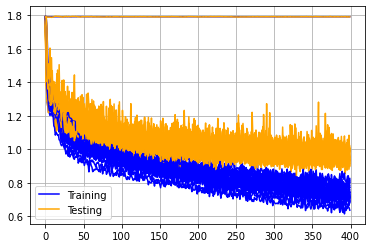

In [31]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [27]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  0.990296633243561
mean accuracy:  0.5913664127886297


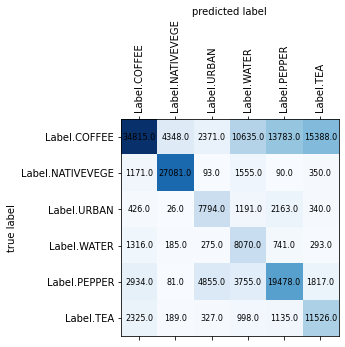

In [28]:
plot_confusion_matrix(conf_matrix, labels)

In [29]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.80989602 0.84866813 0.49595927 0.30796825 0.52094143 0.38789796]
Recalls:  [0.4280182  0.89258405 0.65276382 0.74172794 0.59167679 0.69854545]
F-Score:  [0.56005534 0.87007229 0.56365937 0.43522813 0.55406059 0.49880988]


# NIR, RED, BLUE, SWIR1

In [36]:
BANDS = [
    Band.NIR.value,
    Band.RED.value,
    Band.BLUE.value,
    Band.SWIR1.value,
]

In [37]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_4 (Rescaling)      (None, 11, 11, 4)         0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 11, 11, 8)         296       
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0123 - accuracy: 0.4771 - val_loss: 1.0959 - val_accuracy: 0.5269
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0301 - accuracy: 0.5201 - val_loss: 1.0778 - val_accuracy: 0.5438
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0101 - accuracy: 0.5040 - val_loss: 1.2179 - val_accuracy: 0.4921
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0367 - accuracy: 0.5134 - val_loss: 1.0669 - val_accuracy: 0.5654
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0248 - accuracy: 0.5335 - val_loss: 1.1670 - val_accuracy: 0.4995
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9916 - accuracy: 0.5317 - val_loss: 1.0936 - val_accuracy: 0.5436
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9824 - accuracy: 0.5048 - val_loss: 1.1691 - val_accuracy: 0.4890
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9628 - accuracy: 0.5525 - val_loss: 1.0599 - val_accuracy: 0.5175
Epoch 161/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8499 - accuracy: 0.5651 - val_loss: 0.9853 - val_accuracy: 0.5833
Epoch 162/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8636 - accuracy: 0.5442 - val_loss: 1.0956 - val_accuracy: 0.5446
Epoch 163/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9466 - accuracy: 0.5297 - val_loss: 1.0125 - val_accuracy: 0.5687
Epoch 164/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8028 - accuracy: 0.5707 - val_loss: 0.9609 - val_accuracy: 0.5884
Epoch 165/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8646 - accuracy: 0.5637 - val_loss: 1.0236 - val_accuracy: 0.5435
Epoch 166/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8993 - accuracy: 0.5378 - val_loss: 1.0234 - val_accuracy: 0.5647
Epoch 167/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7745 - accuracy: 0.6026 - val_loss: 1.0275 - val_accuracy: 0.5667
Epoch 275/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7660 - accuracy: 0.5770 - val_loss: 1.0471 - val_accuracy: 0.5801
Epoch 276/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7555 - accuracy: 0.5943 - val_loss: 0.9556 - val_accuracy: 0.5914
Epoch 277/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7676 - accuracy: 0.5944 - val_loss: 0.9366 - val_accuracy: 0.6111
Epoch 278/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7867 - accuracy: 0.5878 - val_loss: 1.0681 - val_accuracy: 0.5616
Epoch 279/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8037 - accuracy: 0.5925 - val_loss: 0.9824 - val_accuracy: 0.5927
Epoch 280/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7359 - accuracy: 0.6046 - val_loss: 1.0092 - val_accuracy: 0.5779
Epoch 281/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7651 - accuracy: 0.6365 - val_loss: 0.9429 - val_accuracy: 0.6112
Epoch 389/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7193 - accuracy: 0.6108 - val_loss: 0.9540 - val_accuracy: 0.6234
Epoch 390/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7085 - accuracy: 0.6325 - val_loss: 0.9415 - val_accuracy: 0.6044
Epoch 391/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7157 - accuracy: 0.6255 - val_loss: 0.9540 - val_accuracy: 0.5950
Epoch 392/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6929 - accuracy: 0.6235 - val_loss: 0.9290 - val_accuracy: 0.6179
Epoch 393/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7236 - accuracy: 0.6110 - val_loss: 0.9528 - val_accuracy: 0.6157
Epoch 394/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7342 - accuracy: 0.6258 - val_loss: 1.0002 - val_accuracy: 0.5962
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9753 - accuracy: 0.5140 - val_loss: 1.0862 - val_accuracy: 0.5453
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9523 - accuracy: 0.5241 - val_loss: 1.0978 - val_accuracy: 0.5179
Epoch 100/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9649 - accuracy: 0.5312 - val_loss: 1.0912 - val_accuracy: 0.5573
Epoch 101/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0266 - accuracy: 0.4995 - val_loss: 1.1011 - val_accuracy: 0.5480
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8882 - accuracy: 0.5292 - val_loss: 1.1217 - val_accuracy: 0.5173
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9868 - accuracy: 0.5033 - val_loss: 1.1161 - val_accuracy: 0.5116
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9691 - accuracy: 0.4914 - val_loss: 1.1648 - val_accuracy: 0.4828

57/57 [==============================] - 1s 9ms/step - loss: 0.9038 - accuracy: 0.5298 - val_loss: 1.1421 - val_accuracy: 0.4874
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8883 - accuracy: 0.5391 - val_loss: 1.0355 - val_accuracy: 0.5743
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8038 - accuracy: 0.5798 - val_loss: 1.1465 - val_accuracy: 0.5111
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9378 - accuracy: 0.5432 - val_loss: 1.1619 - val_accuracy: 0.5010
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9162 - accuracy: 0.5420 - val_loss: 1.0196 - val_accuracy: 0.5898
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8636 - accuracy: 0.5560 - val_loss: 1.0535 - val_accuracy: 0.5793
Epoch 218/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8858 - accuracy: 0.5371 - val_loss: 1.0425 - val_accuracy: 0.5747
Epoch 219/40

57/57 [==============================] - 1s 9ms/step - loss: 0.7461 - accuracy: 0.5985 - val_loss: 0.9935 - val_accuracy: 0.5993
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8207 - accuracy: 0.5869 - val_loss: 1.0381 - val_accuracy: 0.5827
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8209 - accuracy: 0.5669 - val_loss: 0.9850 - val_accuracy: 0.6051
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8243 - accuracy: 0.5626 - val_loss: 1.0099 - val_accuracy: 0.5973
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7705 - accuracy: 0.6053 - val_loss: 1.0485 - val_accuracy: 0.5664
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7833 - accuracy: 0.5867 - val_loss: 0.9887 - val_accuracy: 0.6023
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8472 - accuracy: 0.5475 - val_loss: 1.0443 - val_accuracy: 0.5867
Epoch 333/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1012 - accuracy: 0.4820 - val_loss: 1.1651 - val_accuracy: 0.4793
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9949 - accuracy: 0.5005 - val_loss: 1.1677 - val_accuracy: 0.4318
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0291 - accuracy: 0.4603 - val_loss: 1.2517 - val_accuracy: 0.4783
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0788 - accuracy: 0.4749 - val_loss: 1.1430 - val_accuracy: 0.4916
Epoch 39/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9871 - accuracy: 0.4934 - val_loss: 1.1291 - val_accuracy: 0.4971
Epoch 40/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0277 - accuracy: 0.4951 - val_loss: 1.1812 - val_accuracy: 0.4615
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0519 - accuracy: 0.4566 - val_loss: 1.1365 - val_accuracy: 0.4953
Epoch 42/400
57/5

57/57 [==============================] - 1s 9ms/step - loss: 0.8741 - accuracy: 0.5718 - val_loss: 1.0181 - val_accuracy: 0.5782
Epoch 150/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8523 - accuracy: 0.5916 - val_loss: 1.0043 - val_accuracy: 0.6038
Epoch 151/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8341 - accuracy: 0.6073 - val_loss: 0.9988 - val_accuracy: 0.6007
Epoch 152/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8642 - accuracy: 0.5754 - val_loss: 1.0535 - val_accuracy: 0.5472
Epoch 153/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8132 - accuracy: 0.5945 - val_loss: 0.9317 - val_accuracy: 0.6289
Epoch 154/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8390 - accuracy: 0.6185 - val_loss: 0.9655 - val_accuracy: 0.6151
Epoch 155/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8198 - accuracy: 0.5910 - val_loss: 0.9459 - val_accuracy: 0.6189
Epoch 156/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7362 - accuracy: 0.6002 - val_loss: 0.9558 - val_accuracy: 0.6111
Epoch 264/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7763 - accuracy: 0.5978 - val_loss: 0.9491 - val_accuracy: 0.6108
Epoch 265/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7740 - accuracy: 0.6192 - val_loss: 0.9414 - val_accuracy: 0.6117
Epoch 266/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7434 - accuracy: 0.6205 - val_loss: 0.9630 - val_accuracy: 0.6062
Epoch 267/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7281 - accuracy: 0.6236 - val_loss: 0.9729 - val_accuracy: 0.5986
Epoch 268/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7630 - accuracy: 0.6170 - val_loss: 0.9437 - val_accuracy: 0.6224
Epoch 269/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7638 - accuracy: 0.6156 - val_loss: 0.9064 - val_accuracy: 0.6299
Epoch 270/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6638 - accuracy: 0.6615 - val_loss: 0.9013 - val_accuracy: 0.6435
Epoch 378/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6825 - accuracy: 0.6373 - val_loss: 0.8894 - val_accuracy: 0.6465
Epoch 379/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6404 - accuracy: 0.6970 - val_loss: 0.8574 - val_accuracy: 0.6586
Epoch 380/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6427 - accuracy: 0.6712 - val_loss: 1.0142 - val_accuracy: 0.5858
Epoch 381/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7149 - accuracy: 0.6277 - val_loss: 0.8403 - val_accuracy: 0.6773
Epoch 382/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6480 - accuracy: 0.6823 - val_loss: 0.8969 - val_accuracy: 0.6481
Epoch 383/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6747 - accuracy: 0.6606 - val_loss: 0.9224 - val_accuracy: 0.6239
Epoch 384/400

Epoch 87/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9826 - accuracy: 0.5746 - val_loss: 1.0952 - val_accuracy: 0.5747
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9504 - accuracy: 0.5765 - val_loss: 1.0757 - val_accuracy: 0.5883
Epoch 89/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0003 - accuracy: 0.5680 - val_loss: 1.0573 - val_accuracy: 0.5956
Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9727 - accuracy: 0.5591 - val_loss: 1.0634 - val_accuracy: 0.5747
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9463 - accuracy: 0.5588 - val_loss: 1.0908 - val_accuracy: 0.5697
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0050 - accuracy: 0.5774 - val_loss: 1.2431 - val_accuracy: 0.5264
Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0677 - accuracy: 0.5456 - val_loss: 1.0860 - val_accuracy: 0.5871
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9016 - accuracy: 0.6077 - val_loss: 1.0046 - val_accuracy: 0.6110
Epoch 202/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8935 - accuracy: 0.5916 - val_loss: 0.9580 - val_accuracy: 0.6304
Epoch 203/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8296 - accuracy: 0.6047 - val_loss: 1.0525 - val_accuracy: 0.5873
Epoch 204/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8224 - accuracy: 0.5933 - val_loss: 1.0138 - val_accuracy: 0.6055
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8398 - accuracy: 0.5995 - val_loss: 0.9893 - val_accuracy: 0.5956
Epoch 206/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8237 - accuracy: 0.6029 - val_loss: 1.0092 - val_accuracy: 0.6076
Epoch 207/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8927 - accuracy: 0.6093 - val_loss: 1.0352 - val_accuracy: 0.5871
Epoch 208/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8023 - accuracy: 0.6022 - val_loss: 1.0022 - val_accuracy: 0.6069
Epoch 316/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7684 - accuracy: 0.6338 - val_loss: 0.9294 - val_accuracy: 0.6300
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7932 - accuracy: 0.6257 - val_loss: 0.9727 - val_accuracy: 0.6061
Epoch 318/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7622 - accuracy: 0.6412 - val_loss: 0.9819 - val_accuracy: 0.6200
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8210 - accuracy: 0.6153 - val_loss: 0.9628 - val_accuracy: 0.6000
Epoch 320/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8137 - accuracy: 0.6140 - val_loss: 0.9397 - val_accuracy: 0.6333
Epoch 321/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7577 - accuracy: 0.6483 - val_loss: 0.9228 - val_accuracy: 0.6359
Epoch 322/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1811 - accuracy: 0.3933 - val_loss: 1.2682 - val_accuracy: 0.3497
Epoch 25/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1354 - accuracy: 0.3849 - val_loss: 1.2698 - val_accuracy: 0.3526
Epoch 26/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1954 - accuracy: 0.3622 - val_loss: 1.3308 - val_accuracy: 0.3556
Epoch 27/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1655 - accuracy: 0.3995 - val_loss: 1.2648 - val_accuracy: 0.3419
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1179 - accuracy: 0.3764 - val_loss: 1.1945 - val_accuracy: 0.3969
Epoch 29/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1583 - accuracy: 0.3941 - val_loss: 1.1862 - val_accuracy: 0.4014
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1371 - accuracy: 0.3874 - val_loss: 1.1944 - val_accuracy: 0.3984
Epoch 31/400
57/57 

57/57 [==============================] - 1s 9ms/step - loss: 0.8526 - accuracy: 0.5637 - val_loss: 1.1115 - val_accuracy: 0.5167
Epoch 139/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8830 - accuracy: 0.5106 - val_loss: 1.0543 - val_accuracy: 0.5349
Epoch 140/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9051 - accuracy: 0.5482 - val_loss: 1.0552 - val_accuracy: 0.5502
Epoch 141/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8837 - accuracy: 0.5670 - val_loss: 1.0485 - val_accuracy: 0.5441
Epoch 142/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8781 - accuracy: 0.5624 - val_loss: 1.0303 - val_accuracy: 0.5657
Epoch 143/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8862 - accuracy: 0.5638 - val_loss: 1.0237 - val_accuracy: 0.5622
Epoch 144/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9188 - accuracy: 0.5387 - val_loss: 1.0905 - val_accuracy: 0.5147
Epoch 145/

57/57 [==============================] - 1s 10ms/step - loss: 0.7569 - accuracy: 0.6275 - val_loss: 1.0617 - val_accuracy: 0.5548
Epoch 253/400
57/57 [==============================] - 1s 11ms/step - loss: 0.8512 - accuracy: 0.5615 - val_loss: 1.0219 - val_accuracy: 0.5884
Epoch 254/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7934 - accuracy: 0.5958 - val_loss: 1.0258 - val_accuracy: 0.5744
Epoch 255/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7452 - accuracy: 0.6074 - val_loss: 0.9623 - val_accuracy: 0.5986
Epoch 256/400
57/57 [==============================] - 1s 11ms/step - loss: 0.8240 - accuracy: 0.5975 - val_loss: 1.0139 - val_accuracy: 0.5830
Epoch 257/400
57/57 [==============================] - 1s 11ms/step - loss: 0.8041 - accuracy: 0.5978 - val_loss: 0.9845 - val_accuracy: 0.6114
Epoch 258/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7637 - accuracy: 0.6169 - val_loss: 1.0531 - val_accuracy: 0.5581
Epoch 

Epoch 309/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7864 - accuracy: 0.6015 - val_loss: 0.9626 - val_accuracy: 0.6210
Epoch 310/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7406 - accuracy: 0.6403 - val_loss: 0.9684 - val_accuracy: 0.5968
Epoch 311/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7691 - accuracy: 0.6246 - val_loss: 0.9443 - val_accuracy: 0.6205
Epoch 312/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7337 - accuracy: 0.6227 - val_loss: 0.9978 - val_accuracy: 0.5982
Epoch 313/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7069 - accuracy: 0.6135 - val_loss: 1.0421 - val_accuracy: 0.5782
Epoch 314/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8342 - accuracy: 0.6034 - val_loss: 0.9766 - val_accuracy: 0.6008
Epoch 315/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7507 - accuracy: 0.6292 - val_loss: 0.9695 - val_accuracy:

57/57 [==============================] - 1s 9ms/step - loss: 1.1603 - accuracy: 0.4159 - val_loss: 1.1662 - val_accuracy: 0.4479
Epoch 19/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1294 - accuracy: 0.4569 - val_loss: 1.2804 - val_accuracy: 0.3579
Epoch 20/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1669 - accuracy: 0.3948 - val_loss: 1.1495 - val_accuracy: 0.4952
Epoch 21/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1078 - accuracy: 0.4603 - val_loss: 1.1692 - val_accuracy: 0.4653
Epoch 22/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0677 - accuracy: 0.4697 - val_loss: 1.3830 - val_accuracy: 0.4051
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1502 - accuracy: 0.4403 - val_loss: 1.1536 - val_accuracy: 0.4695
Epoch 24/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0599 - accuracy: 0.4756 - val_loss: 1.2181 - val_accuracy: 0.4468
Epoch 25/400
57/57 

Epoch 76/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0205 - accuracy: 0.5462 - val_loss: 1.0995 - val_accuracy: 0.5508
Epoch 77/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9582 - accuracy: 0.5467 - val_loss: 1.1586 - val_accuracy: 0.5159
Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9598 - accuracy: 0.5339 - val_loss: 1.1011 - val_accuracy: 0.5508
Epoch 79/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9931 - accuracy: 0.5473 - val_loss: 1.0949 - val_accuracy: 0.5552
Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9966 - accuracy: 0.5416 - val_loss: 1.1372 - val_accuracy: 0.5106
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0408 - accuracy: 0.5162 - val_loss: 1.0878 - val_accuracy: 0.5627
Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9851 - accuracy: 0.5526 - val_loss: 1.1056 - val_accuracy: 0.5222
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9209 - accuracy: 0.5766 - val_loss: 1.0602 - val_accuracy: 0.5754
Epoch 191/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8881 - accuracy: 0.5644 - val_loss: 1.2291 - val_accuracy: 0.4782
Epoch 192/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9165 - accuracy: 0.5300 - val_loss: 1.0076 - val_accuracy: 0.5817
Epoch 193/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9015 - accuracy: 0.5792 - val_loss: 1.0607 - val_accuracy: 0.5344
Epoch 194/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8449 - accuracy: 0.5563 - val_loss: 1.0417 - val_accuracy: 0.5459
Epoch 195/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9017 - accuracy: 0.5705 - val_loss: 1.0373 - val_accuracy: 0.5661
Epoch 196/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8350 - accuracy: 0.5735 - val_loss: 1.0491 - val_accuracy: 0.5540
Epoch 197/400

57/57 [==============================] - 1s 10ms/step - loss: 0.7865 - accuracy: 0.6222 - val_loss: 1.0234 - val_accuracy: 0.5746
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7955 - accuracy: 0.5980 - val_loss: 0.9917 - val_accuracy: 0.5969
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8161 - accuracy: 0.5970 - val_loss: 1.0133 - val_accuracy: 0.5798
Epoch 307/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7642 - accuracy: 0.6118 - val_loss: 1.1972 - val_accuracy: 0.5364
Epoch 308/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8303 - accuracy: 0.5688 - val_loss: 1.0086 - val_accuracy: 0.5896
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8211 - accuracy: 0.6071 - val_loss: 1.0322 - val_accuracy: 0.5809
Epoch 310/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7626 - accuracy: 0.6009 - val_loss: 1.0152 - val_accuracy: 0.5727
Epoch 311/40

Epoch 13/400
57/57 [==============================] - 1s 10ms/step - loss: 1.1186 - accuracy: 0.4206 - val_loss: 1.2412 - val_accuracy: 0.4121
Epoch 14/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0819 - accuracy: 0.4010 - val_loss: 1.1999 - val_accuracy: 0.4411
Epoch 15/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0386 - accuracy: 0.4426 - val_loss: 1.1755 - val_accuracy: 0.4597
Epoch 16/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0467 - accuracy: 0.4545 - val_loss: 1.4220 - val_accuracy: 0.3141
Epoch 17/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9964 - accuracy: 0.4197 - val_loss: 1.2930 - val_accuracy: 0.4133
Epoch 18/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0429 - accuracy: 0.4308 - val_loss: 1.1383 - val_accuracy: 0.5118
Epoch 19/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0390 - accuracy: 0.4848 - val_loss: 1.1627 - val_accuracy: 0.4760

57/57 [==============================] - 1s 10ms/step - loss: 0.9712 - accuracy: 0.4907 - val_loss: 1.0527 - val_accuracy: 0.5353
Epoch 128/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8452 - accuracy: 0.5423 - val_loss: 1.1050 - val_accuracy: 0.5200
Epoch 129/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9111 - accuracy: 0.5251 - val_loss: 1.0486 - val_accuracy: 0.5460
Epoch 130/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9105 - accuracy: 0.5223 - val_loss: 1.0954 - val_accuracy: 0.5217
Epoch 131/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9078 - accuracy: 0.5356 - val_loss: 1.0475 - val_accuracy: 0.5475
Epoch 132/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9107 - accuracy: 0.5433 - val_loss: 1.0684 - val_accuracy: 0.5220
Epoch 133/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8677 - accuracy: 0.5261 - val_loss: 1.0822 - val_accuracy: 0.5368
Epoch 134

57/57 [==============================] - 1s 9ms/step - loss: 0.8623 - accuracy: 0.5285 - val_loss: 0.9637 - val_accuracy: 0.6047
Epoch 242/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7757 - accuracy: 0.5957 - val_loss: 1.0260 - val_accuracy: 0.5743
Epoch 243/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8184 - accuracy: 0.5436 - val_loss: 1.1109 - val_accuracy: 0.5381
Epoch 244/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8280 - accuracy: 0.5735 - val_loss: 0.9862 - val_accuracy: 0.5838
Epoch 245/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8157 - accuracy: 0.5778 - val_loss: 1.1133 - val_accuracy: 0.5267
Epoch 246/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8227 - accuracy: 0.5531 - val_loss: 1.0157 - val_accuracy: 0.5684
Epoch 247/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7792 - accuracy: 0.5979 - val_loss: 1.0987 - val_accuracy: 0.5448
Epoch 248/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7706 - accuracy: 0.5881 - val_loss: 0.9798 - val_accuracy: 0.6099
Epoch 356/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6746 - accuracy: 0.6183 - val_loss: 1.0390 - val_accuracy: 0.5954
Epoch 357/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6950 - accuracy: 0.6059 - val_loss: 1.0570 - val_accuracy: 0.5637
Epoch 358/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7441 - accuracy: 0.6004 - val_loss: 1.0693 - val_accuracy: 0.5635
Epoch 359/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7197 - accuracy: 0.6072 - val_loss: 0.9953 - val_accuracy: 0.5979
Epoch 360/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7206 - accuracy: 0.6135 - val_loss: 1.0359 - val_accuracy: 0.5771
Epoch 361/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6998 - accuracy: 0.6184 - val_loss: 1.0232 - val_accuracy: 0.5815
Epoch 362/400

Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0495 - accuracy: 0.5267 - val_loss: 1.0614 - val_accuracy: 0.5574
Epoch 66/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9813 - accuracy: 0.5720 - val_loss: 1.0652 - val_accuracy: 0.5678
Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9499 - accuracy: 0.5611 - val_loss: 1.1362 - val_accuracy: 0.4954
Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9902 - accuracy: 0.5447 - val_loss: 1.0821 - val_accuracy: 0.5656
Epoch 69/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9869 - accuracy: 0.5692 - val_loss: 1.1197 - val_accuracy: 0.5262
Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9657 - accuracy: 0.5539 - val_loss: 1.1419 - val_accuracy: 0.5039
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9499 - accuracy: 0.5609 - val_loss: 1.1471 - val_accuracy: 0.5107
Epoch

57/57 [==============================] - 1s 9ms/step - loss: 0.9309 - accuracy: 0.5777 - val_loss: 1.1683 - val_accuracy: 0.5133
Epoch 180/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8906 - accuracy: 0.5681 - val_loss: 1.0183 - val_accuracy: 0.5799
Epoch 181/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8545 - accuracy: 0.5896 - val_loss: 1.0351 - val_accuracy: 0.5699
Epoch 182/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8590 - accuracy: 0.5425 - val_loss: 1.0165 - val_accuracy: 0.5831
Epoch 183/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8781 - accuracy: 0.5679 - val_loss: 1.0209 - val_accuracy: 0.5744
Epoch 184/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8735 - accuracy: 0.5615 - val_loss: 1.1097 - val_accuracy: 0.5327
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8560 - accuracy: 0.6029 - val_loss: 1.0148 - val_accuracy: 0.5934
Epoch 186/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8312 - accuracy: 0.6144 - val_loss: 1.0328 - val_accuracy: 0.5750
Epoch 294/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7544 - accuracy: 0.5979 - val_loss: 0.9708 - val_accuracy: 0.6013
Epoch 295/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7799 - accuracy: 0.6080 - val_loss: 0.9685 - val_accuracy: 0.6114
Epoch 296/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7971 - accuracy: 0.6317 - val_loss: 0.9726 - val_accuracy: 0.6118
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7225 - accuracy: 0.6502 - val_loss: 0.9638 - val_accuracy: 0.6185
Epoch 298/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7537 - accuracy: 0.6366 - val_loss: 1.0579 - val_accuracy: 0.5626
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7919 - accuracy: 0.6295 - val_loss: 0.9751 - val_accuracy: 0.6011
Epoch 300/400

57/57 [==============================] - 1s 9ms/step - loss: 1.7082 - accuracy: 0.2016 - val_loss: 1.4508 - val_accuracy: 0.2920
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3724 - accuracy: 0.3348 - val_loss: 1.2918 - val_accuracy: 0.4317
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3058 - accuracy: 0.3925 - val_loss: 1.3531 - val_accuracy: 0.3367
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2857 - accuracy: 0.3670 - val_loss: 1.3221 - val_accuracy: 0.3375
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3993 - accuracy: 0.3104 - val_loss: 1.3077 - val_accuracy: 0.3420
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2903 - accuracy: 0.3549 - val_loss: 1.4032 - val_accuracy: 0.2883
Epoch 8/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2891 - accuracy: 0.3574 - val_loss: 1.3313 - val_accuracy: 0.3066
Epoch 9/400
57/57 [======

Epoch 60/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0808 - accuracy: 0.4639 - val_loss: 1.1336 - val_accuracy: 0.4953
Epoch 61/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0097 - accuracy: 0.4919 - val_loss: 1.1061 - val_accuracy: 0.5330
Epoch 62/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9431 - accuracy: 0.5207 - val_loss: 1.1099 - val_accuracy: 0.5003
Epoch 63/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0161 - accuracy: 0.4750 - val_loss: 1.1533 - val_accuracy: 0.5059
Epoch 64/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0414 - accuracy: 0.4873 - val_loss: 1.1376 - val_accuracy: 0.5165
Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9971 - accuracy: 0.5034 - val_loss: 1.1164 - val_accuracy: 0.4734
Epoch 66/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0186 - accuracy: 0.4902 - val_loss: 1.1685 - val_accuracy: 0.4707
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8043 - accuracy: 0.5613 - val_loss: 1.0117 - val_accuracy: 0.5939
Epoch 175/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8752 - accuracy: 0.5762 - val_loss: 0.9720 - val_accuracy: 0.5958
Epoch 176/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7897 - accuracy: 0.5912 - val_loss: 1.0352 - val_accuracy: 0.5620
Epoch 177/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9090 - accuracy: 0.5632 - val_loss: 1.0014 - val_accuracy: 0.5807
Epoch 178/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9025 - accuracy: 0.5775 - val_loss: 1.0095 - val_accuracy: 0.5709
Epoch 179/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8153 - accuracy: 0.5460 - val_loss: 1.0090 - val_accuracy: 0.5846
Epoch 180/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8234 - accuracy: 0.5943 - val_loss: 0.9907 - val_accuracy: 0.5792
Epoch 181/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8053 - accuracy: 0.5947 - val_loss: 0.9727 - val_accuracy: 0.5956
Epoch 289/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7526 - accuracy: 0.5991 - val_loss: 0.9633 - val_accuracy: 0.5818
Epoch 290/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7935 - accuracy: 0.6094 - val_loss: 0.9335 - val_accuracy: 0.6284
Epoch 291/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7653 - accuracy: 0.5972 - val_loss: 0.9665 - val_accuracy: 0.6248
Epoch 292/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7381 - accuracy: 0.6235 - val_loss: 0.9519 - val_accuracy: 0.5939
Epoch 293/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7664 - accuracy: 0.6204 - val_loss: 0.9311 - val_accuracy: 0.6331
Epoch 294/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8118 - accuracy: 0.5957 - val_loss: 0.9339 - val_accuracy: 0.6357
Epoch 295/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.8088 - accuracy: 0.0934 - val_loss: 1.7928 - val_accuracy: 0.1627
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7893 - accuracy: 0.1206 - val_loss: 1.7471 - val_accuracy: 0.2588
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6631 - accuracy: 0.2289 - val_loss: 1.3952 - val_accuracy: 0.3506
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3232 - accuracy: 0.3938 - val_loss: 1.3005 - val_accuracy: 0.3223
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1603 - accuracy: 0.3612 - val_loss: 1.2498 - val_accuracy: 0.4355
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1378 - accuracy: 0.4220 - val_loss: 1.2647 - val_accuracy: 0.3845
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1441 - accuracy: 0.3864 - val_loss: 1.5810 - val_accuracy

57/57 [==============================] - 1s 9ms/step - loss: 0.8890 - accuracy: 0.5629 - val_loss: 1.0170 - val_accuracy: 0.5766
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8793 - accuracy: 0.5571 - val_loss: 1.0479 - val_accuracy: 0.5699
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9608 - accuracy: 0.5283 - val_loss: 1.0304 - val_accuracy: 0.5672
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9270 - accuracy: 0.5843 - val_loss: 1.0013 - val_accuracy: 0.6009
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8487 - accuracy: 0.5876 - val_loss: 1.0303 - val_accuracy: 0.5596
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8825 - accuracy: 0.5683 - val_loss: 1.0338 - val_accuracy: 0.5576
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8694 - accuracy: 0.5371 - val_loss: 1.0625 - val_accuracy: 0.5459
Epoch 122/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7349 - accuracy: 0.5973 - val_loss: 1.0457 - val_accuracy: 0.5959
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8381 - accuracy: 0.5993 - val_loss: 0.9943 - val_accuracy: 0.6085
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7696 - accuracy: 0.6217 - val_loss: 0.9446 - val_accuracy: 0.6284
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7329 - accuracy: 0.6362 - val_loss: 1.0013 - val_accuracy: 0.5920
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8839 - accuracy: 0.5940 - val_loss: 0.9572 - val_accuracy: 0.6012
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7316 - accuracy: 0.6180 - val_loss: 1.0906 - val_accuracy: 0.5601
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7841 - accuracy: 0.6115 - val_loss: 0.9790 - val_accuracy: 0.5979
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7217 - accuracy: 0.6345 - val_loss: 0.9323 - val_accuracy: 0.6429
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7337 - accuracy: 0.6566 - val_loss: 0.8792 - val_accuracy: 0.6610
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7263 - accuracy: 0.6474 - val_loss: 0.9567 - val_accuracy: 0.6262
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7412 - accuracy: 0.6421 - val_loss: 0.9064 - val_accuracy: 0.6402
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6979 - accuracy: 0.6569 - val_loss: 0.9558 - val_accuracy: 0.6197
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6449 - accuracy: 0.6713 - val_loss: 0.9863 - val_accuracy: 0.6142
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7389 - accuracy: 0.6299 - val_loss: 0.9706 - val_accuracy: 0.6206
Epoch 350/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0874 - accuracy: 0.4560 - val_loss: 1.2484 - val_accuracy: 0.4456
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1219 - accuracy: 0.4660 - val_loss: 1.1714 - val_accuracy: 0.4970
Epoch 54/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0219 - accuracy: 0.4954 - val_loss: 1.1655 - val_accuracy: 0.4791
Epoch 55/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1016 - accuracy: 0.4679 - val_loss: 1.1688 - val_accuracy: 0.4928
Epoch 56/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0899 - accuracy: 0.4745 - val_loss: 1.1565 - val_accuracy: 0.5147
Epoch 57/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0462 - accuracy: 0.4939 - val_loss: 1.1947 - val_accuracy: 0.4600
Epoch 58/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0389 - accuracy: 0.4895 - val_loss: 1.1915 - val_accuracy: 0.4903
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9907 - accuracy: 0.5009 - val_loss: 1.1814 - val_accuracy: 0.4490
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9949 - accuracy: 0.4952 - val_loss: 1.1201 - val_accuracy: 0.5247
Epoch 112/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9972 - accuracy: 0.4945 - val_loss: 1.1190 - val_accuracy: 0.5105
Epoch 113/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0149 - accuracy: 0.5112 - val_loss: 1.1119 - val_accuracy: 0.5203
Epoch 114/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9920 - accuracy: 0.5161 - val_loss: 1.1071 - val_accuracy: 0.5116
Epoch 115/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9873 - accuracy: 0.5018 - val_loss: 1.1385 - val_accuracy: 0.5171
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9870 - accuracy: 0.5191 - val_loss: 1.1952 - val_accuracy: 0.4887

57/57 [==============================] - 1s 9ms/step - loss: 0.8889 - accuracy: 0.5473 - val_loss: 1.0565 - val_accuracy: 0.5585
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9378 - accuracy: 0.5125 - val_loss: 1.0924 - val_accuracy: 0.5120
Epoch 226/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8593 - accuracy: 0.5627 - val_loss: 1.0832 - val_accuracy: 0.5459
Epoch 227/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8697 - accuracy: 0.5553 - val_loss: 1.0653 - val_accuracy: 0.5353
Epoch 228/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8265 - accuracy: 0.5609 - val_loss: 1.1094 - val_accuracy: 0.5336
Epoch 229/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8591 - accuracy: 0.5593 - val_loss: 1.0496 - val_accuracy: 0.5419
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8078 - accuracy: 0.5454 - val_loss: 1.1468 - val_accuracy: 0.4981
Epoch 231/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8043 - accuracy: 0.6062 - val_loss: 1.0560 - val_accuracy: 0.5500
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8123 - accuracy: 0.5932 - val_loss: 1.0195 - val_accuracy: 0.5977
Epoch 340/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7810 - accuracy: 0.6080 - val_loss: 1.0810 - val_accuracy: 0.5740
Epoch 341/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8365 - accuracy: 0.5964 - val_loss: 1.0594 - val_accuracy: 0.5559
Epoch 342/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8834 - accuracy: 0.5750 - val_loss: 1.0402 - val_accuracy: 0.5858
Epoch 343/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8332 - accuracy: 0.5684 - val_loss: 1.0739 - val_accuracy: 0.5499
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8030 - accuracy: 0.5671 - val_loss: 1.0356 - val_accuracy: 0.5600
Epoch 345/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0738 - accuracy: 0.5496 - val_loss: 1.1172 - val_accuracy: 0.5551
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0679 - accuracy: 0.5400 - val_loss: 1.1125 - val_accuracy: 0.5699
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0720 - accuracy: 0.5364 - val_loss: 1.1255 - val_accuracy: 0.5252
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0499 - accuracy: 0.5183 - val_loss: 1.0949 - val_accuracy: 0.5400
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0858 - accuracy: 0.5293 - val_loss: 1.0608 - val_accuracy: 0.5947
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0009 - accuracy: 0.5400 - val_loss: 1.1794 - val_accuracy: 0.5191
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0103 - accuracy: 0.5394 - val_loss: 1.1166 - val_accuracy: 0.5430
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9730 - accuracy: 0.5415 - val_loss: 1.0830 - val_accuracy: 0.5565
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9045 - accuracy: 0.5616 - val_loss: 1.0396 - val_accuracy: 0.6051
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9594 - accuracy: 0.5544 - val_loss: 1.0639 - val_accuracy: 0.5850
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9712 - accuracy: 0.5724 - val_loss: 1.0666 - val_accuracy: 0.5849
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9784 - accuracy: 0.5516 - val_loss: 0.9708 - val_accuracy: 0.6308
Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9650 - accuracy: 0.5316 - val_loss: 1.0896 - val_accuracy: 0.5631
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9729 - accuracy: 0.5368 - val_loss: 1.0520 - val_accuracy: 0.5762

57/57 [==============================] - 1s 9ms/step - loss: 0.8955 - accuracy: 0.5739 - val_loss: 0.9314 - val_accuracy: 0.6176
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8554 - accuracy: 0.5482 - val_loss: 0.9867 - val_accuracy: 0.5993
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8712 - accuracy: 0.5650 - val_loss: 1.0664 - val_accuracy: 0.5490
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8988 - accuracy: 0.5729 - val_loss: 1.0256 - val_accuracy: 0.5895
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8163 - accuracy: 0.5937 - val_loss: 0.9712 - val_accuracy: 0.5987
Epoch 224/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8927 - accuracy: 0.5583 - val_loss: 1.0078 - val_accuracy: 0.5873
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8334 - accuracy: 0.5623 - val_loss: 0.9975 - val_accuracy: 0.5797
Epoch 226/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8268 - accuracy: 0.5601 - val_loss: 1.0302 - val_accuracy: 0.5869
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8366 - accuracy: 0.5751 - val_loss: 0.9631 - val_accuracy: 0.6061
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7901 - accuracy: 0.5956 - val_loss: 0.9555 - val_accuracy: 0.6138
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7907 - accuracy: 0.5856 - val_loss: 1.0416 - val_accuracy: 0.5580
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8109 - accuracy: 0.5821 - val_loss: 0.9387 - val_accuracy: 0.6231
Epoch 338/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8054 - accuracy: 0.6001 - val_loss: 0.9601 - val_accuracy: 0.6050
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8270 - accuracy: 0.6045 - val_loss: 0.9348 - val_accuracy: 0.6261
Epoch 340/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0058 - accuracy: 0.4902 - val_loss: 1.2044 - val_accuracy: 0.3953
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0847 - accuracy: 0.4637 - val_loss: 1.0914 - val_accuracy: 0.5482
Epoch 44/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0049 - accuracy: 0.4795 - val_loss: 1.0953 - val_accuracy: 0.5504
Epoch 45/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9703 - accuracy: 0.5300 - val_loss: 1.1281 - val_accuracy: 0.5307
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9861 - accuracy: 0.5023 - val_loss: 1.1241 - val_accuracy: 0.4971
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9421 - accuracy: 0.5110 - val_loss: 1.1554 - val_accuracy: 0.5320
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0130 - accuracy: 0.4995 - val_loss: 1.3211 - val_accuracy: 0.4019
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8962 - accuracy: 0.5486 - val_loss: 1.0975 - val_accuracy: 0.5190
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8793 - accuracy: 0.5514 - val_loss: 1.1152 - val_accuracy: 0.4959
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9332 - accuracy: 0.5357 - val_loss: 1.0507 - val_accuracy: 0.5717
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9258 - accuracy: 0.5688 - val_loss: 1.0933 - val_accuracy: 0.5448
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9583 - accuracy: 0.5263 - val_loss: 1.0839 - val_accuracy: 0.5331
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9163 - accuracy: 0.5204 - val_loss: 1.0597 - val_accuracy: 0.5581
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8741 - accuracy: 0.5476 - val_loss: 1.2167 - val_accuracy: 0.4484

57/57 [==============================] - 1s 9ms/step - loss: 0.7971 - accuracy: 0.6121 - val_loss: 1.0353 - val_accuracy: 0.5505
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7577 - accuracy: 0.6029 - val_loss: 0.9795 - val_accuracy: 0.6050
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7587 - accuracy: 0.6183 - val_loss: 1.0408 - val_accuracy: 0.5774
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7559 - accuracy: 0.6012 - val_loss: 1.0714 - val_accuracy: 0.5479
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7682 - accuracy: 0.6050 - val_loss: 0.9959 - val_accuracy: 0.5918
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7663 - accuracy: 0.6201 - val_loss: 1.1325 - val_accuracy: 0.5476
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8248 - accuracy: 0.5714 - val_loss: 1.0410 - val_accuracy: 0.5665
Epoch 221/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8073 - accuracy: 0.5980 - val_loss: 0.9379 - val_accuracy: 0.6153
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7084 - accuracy: 0.6261 - val_loss: 1.1064 - val_accuracy: 0.5153
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7690 - accuracy: 0.5992 - val_loss: 0.9511 - val_accuracy: 0.6076
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7591 - accuracy: 0.6010 - val_loss: 0.9874 - val_accuracy: 0.6013
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7541 - accuracy: 0.5903 - val_loss: 0.9257 - val_accuracy: 0.6163
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7587 - accuracy: 0.5903 - val_loss: 1.0105 - val_accuracy: 0.5998
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7804 - accuracy: 0.6014 - val_loss: 1.0289 - val_accuracy: 0.5954
Epoch 335/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0485 - accuracy: 0.4824 - val_loss: 1.1276 - val_accuracy: 0.5139
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0221 - accuracy: 0.4841 - val_loss: 1.1057 - val_accuracy: 0.5298
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0630 - accuracy: 0.4943 - val_loss: 1.2203 - val_accuracy: 0.4960
Epoch 40/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1481 - accuracy: 0.4800 - val_loss: 1.1025 - val_accuracy: 0.5351
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9611 - accuracy: 0.5309 - val_loss: 1.1009 - val_accuracy: 0.5103
Epoch 42/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0233 - accuracy: 0.4803 - val_loss: 1.0996 - val_accuracy: 0.5376
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9890 - accuracy: 0.5309 - val_loss: 1.1562 - val_accuracy: 0.4715
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9302 - accuracy: 0.5120 - val_loss: 1.0387 - val_accuracy: 0.5595
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9167 - accuracy: 0.5463 - val_loss: 1.0417 - val_accuracy: 0.5512
Epoch 97/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8803 - accuracy: 0.5631 - val_loss: 1.0155 - val_accuracy: 0.5649
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9013 - accuracy: 0.5345 - val_loss: 1.0982 - val_accuracy: 0.5090
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8666 - accuracy: 0.5400 - val_loss: 1.0553 - val_accuracy: 0.5361
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8905 - accuracy: 0.5524 - val_loss: 0.9945 - val_accuracy: 0.5833
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8977 - accuracy: 0.5501 - val_loss: 1.0559 - val_accuracy: 0.5357
Epoc

57/57 [==============================] - 1s 9ms/step - loss: 0.7732 - accuracy: 0.5762 - val_loss: 0.9639 - val_accuracy: 0.5773
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7679 - accuracy: 0.5966 - val_loss: 0.9600 - val_accuracy: 0.6009
Epoch 211/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7109 - accuracy: 0.6077 - val_loss: 0.9999 - val_accuracy: 0.5675
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7171 - accuracy: 0.5877 - val_loss: 1.0274 - val_accuracy: 0.5706
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7734 - accuracy: 0.6031 - val_loss: 0.9547 - val_accuracy: 0.5971
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8702 - accuracy: 0.5692 - val_loss: 0.9501 - val_accuracy: 0.5962
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7450 - accuracy: 0.5973 - val_loss: 0.9886 - val_accuracy: 0.5793
Epoch 216/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7372 - accuracy: 0.5822 - val_loss: 0.9774 - val_accuracy: 0.5873
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6958 - accuracy: 0.6017 - val_loss: 1.0561 - val_accuracy: 0.5521
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7574 - accuracy: 0.5918 - val_loss: 0.9781 - val_accuracy: 0.5936
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6739 - accuracy: 0.6127 - val_loss: 0.9713 - val_accuracy: 0.5978
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6736 - accuracy: 0.6272 - val_loss: 0.9869 - val_accuracy: 0.5884
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7243 - accuracy: 0.6040 - val_loss: 0.9553 - val_accuracy: 0.5958
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7916 - accuracy: 0.5980 - val_loss: 1.0324 - val_accuracy: 0.5748
Epoch 330/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0466 - accuracy: 0.4893 - val_loss: 1.1899 - val_accuracy: 0.4843
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0222 - accuracy: 0.4961 - val_loss: 1.1440 - val_accuracy: 0.4873
Epoch 34/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0847 - accuracy: 0.4643 - val_loss: 1.1302 - val_accuracy: 0.5104
Epoch 35/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0167 - accuracy: 0.5047 - val_loss: 1.1405 - val_accuracy: 0.5066
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9506 - accuracy: 0.5089 - val_loss: 1.1267 - val_accuracy: 0.4941
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0048 - accuracy: 0.5092 - val_loss: 1.1253 - val_accuracy: 0.5213
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0689 - accuracy: 0.5019 - val_loss: 1.1395 - val_accuracy: 0.5048
Epoch 39/400
57/57 

Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9436 - accuracy: 0.5440 - val_loss: 1.1092 - val_accuracy: 0.5336
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9211 - accuracy: 0.5481 - val_loss: 1.0401 - val_accuracy: 0.5716
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8749 - accuracy: 0.5779 - val_loss: 1.0890 - val_accuracy: 0.5529
Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9088 - accuracy: 0.5872 - val_loss: 1.1428 - val_accuracy: 0.5203
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9614 - accuracy: 0.5436 - val_loss: 1.2004 - val_accuracy: 0.4806
Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9291 - accuracy: 0.5570 - val_loss: 1.0715 - val_accuracy: 0.5686
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9172 - accuracy: 0.5717 - val_loss: 1.1390 - val_accuracy: 0.4903
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8373 - accuracy: 0.6032 - val_loss: 1.0835 - val_accuracy: 0.5167
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8760 - accuracy: 0.5771 - val_loss: 1.0041 - val_accuracy: 0.5943
Epoch 206/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8260 - accuracy: 0.5886 - val_loss: 1.0808 - val_accuracy: 0.5436
Epoch 207/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9339 - accuracy: 0.5650 - val_loss: 1.0611 - val_accuracy: 0.5763
Epoch 208/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8643 - accuracy: 0.5895 - val_loss: 1.0687 - val_accuracy: 0.5482
Epoch 209/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8594 - accuracy: 0.5752 - val_loss: 1.0699 - val_accuracy: 0.5358
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8027 - accuracy: 0.6024 - val_loss: 1.0195 - val_accuracy: 0.5915
Epoch 211/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7714 - accuracy: 0.6389 - val_loss: 1.0023 - val_accuracy: 0.6095
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7460 - accuracy: 0.6216 - val_loss: 0.9698 - val_accuracy: 0.6161
Epoch 320/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8149 - accuracy: 0.6142 - val_loss: 0.9629 - val_accuracy: 0.6119
Epoch 321/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7692 - accuracy: 0.6221 - val_loss: 1.0227 - val_accuracy: 0.5737
Epoch 322/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8156 - accuracy: 0.6194 - val_loss: 0.9984 - val_accuracy: 0.5998
Epoch 323/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7535 - accuracy: 0.6165 - val_loss: 1.0237 - val_accuracy: 0.5944
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7754 - accuracy: 0.6159 - val_loss: 0.9916 - val_accuracy: 0.6000
Epoch 325/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1086 - accuracy: 0.4978 - val_loss: 1.1754 - val_accuracy: 0.4604
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0937 - accuracy: 0.4797 - val_loss: 1.1035 - val_accuracy: 0.5544
Epoch 29/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0636 - accuracy: 0.5038 - val_loss: 1.1723 - val_accuracy: 0.5174
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0766 - accuracy: 0.5126 - val_loss: 1.1480 - val_accuracy: 0.5193
Epoch 31/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9933 - accuracy: 0.4889 - val_loss: 1.1015 - val_accuracy: 0.5178
Epoch 32/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0665 - accuracy: 0.4984 - val_loss: 1.2261 - val_accuracy: 0.5042
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0211 - accuracy: 0.5366 - val_loss: 1.1011 - val_accuracy: 0.5616
Epoch 34/400
57/57 

Epoch 85/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9427 - accuracy: 0.5550 - val_loss: 1.0638 - val_accuracy: 0.5827
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9641 - accuracy: 0.5529 - val_loss: 1.0499 - val_accuracy: 0.5833
Epoch 87/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9442 - accuracy: 0.5550 - val_loss: 1.0656 - val_accuracy: 0.5817
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9466 - accuracy: 0.5682 - val_loss: 1.0635 - val_accuracy: 0.5778
Epoch 89/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9111 - accuracy: 0.5884 - val_loss: 1.0516 - val_accuracy: 0.5794
Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9666 - accuracy: 0.5497 - val_loss: 1.0518 - val_accuracy: 0.5756
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9519 - accuracy: 0.5487 - val_loss: 1.0507 - val_accuracy: 0.5714
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9039 - accuracy: 0.5560 - val_loss: 0.9823 - val_accuracy: 0.6017
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8155 - accuracy: 0.6079 - val_loss: 1.0737 - val_accuracy: 0.5333
Epoch 201/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8269 - accuracy: 0.5611 - val_loss: 0.9859 - val_accuracy: 0.6064
Epoch 202/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8460 - accuracy: 0.5860 - val_loss: 1.0490 - val_accuracy: 0.5594
Epoch 203/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8666 - accuracy: 0.5694 - val_loss: 0.9937 - val_accuracy: 0.5958
Epoch 204/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8564 - accuracy: 0.5948 - val_loss: 0.9720 - val_accuracy: 0.6098
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8527 - accuracy: 0.5869 - val_loss: 0.9852 - val_accuracy: 0.6086
Epoch 206/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7089 - accuracy: 0.6246 - val_loss: 0.9957 - val_accuracy: 0.5825
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7094 - accuracy: 0.6060 - val_loss: 0.9559 - val_accuracy: 0.6202
Epoch 315/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7274 - accuracy: 0.6278 - val_loss: 0.9693 - val_accuracy: 0.5950
Epoch 316/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7708 - accuracy: 0.5854 - val_loss: 1.0326 - val_accuracy: 0.5750
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7787 - accuracy: 0.6197 - val_loss: 1.0825 - val_accuracy: 0.5472
Epoch 318/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8012 - accuracy: 0.6054 - val_loss: 1.0429 - val_accuracy: 0.5806
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8073 - accuracy: 0.6044 - val_loss: 0.9746 - val_accuracy: 0.6041
Epoch 320/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2623 - accuracy: 0.3903 - val_loss: 1.2229 - val_accuracy: 0.3945
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1893 - accuracy: 0.4104 - val_loss: 1.4046 - val_accuracy: 0.3009
Epoch 24/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1547 - accuracy: 0.3654 - val_loss: 1.2252 - val_accuracy: 0.3674
Epoch 25/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1394 - accuracy: 0.3865 - val_loss: 1.1650 - val_accuracy: 0.4180
Epoch 26/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1071 - accuracy: 0.4132 - val_loss: 1.1949 - val_accuracy: 0.4309
Epoch 27/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1393 - accuracy: 0.4201 - val_loss: 1.1396 - val_accuracy: 0.4836
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1031 - accuracy: 0.4222 - val_loss: 1.1985 - val_accuracy: 0.4102
Epoch 29/400
57/57 

Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9598 - accuracy: 0.5435 - val_loss: 1.0901 - val_accuracy: 0.5055
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9445 - accuracy: 0.5071 - val_loss: 1.0774 - val_accuracy: 0.5476
Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9747 - accuracy: 0.5425 - val_loss: 1.0275 - val_accuracy: 0.5751
Epoch 83/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9755 - accuracy: 0.5295 - val_loss: 1.1735 - val_accuracy: 0.5069
Epoch 84/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0512 - accuracy: 0.5060 - val_loss: 1.0201 - val_accuracy: 0.5906
Epoch 85/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9304 - accuracy: 0.5442 - val_loss: 1.0926 - val_accuracy: 0.5317
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9483 - accuracy: 0.5325 - val_loss: 1.1142 - val_accuracy: 0.5502
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8295 - accuracy: 0.5963 - val_loss: 0.9898 - val_accuracy: 0.5986
Epoch 195/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8871 - accuracy: 0.5758 - val_loss: 1.0328 - val_accuracy: 0.5611
Epoch 196/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8281 - accuracy: 0.6038 - val_loss: 0.9961 - val_accuracy: 0.5822
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7636 - accuracy: 0.6462 - val_loss: 0.9933 - val_accuracy: 0.5849
Epoch 198/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8180 - accuracy: 0.5934 - val_loss: 1.0086 - val_accuracy: 0.5713
Epoch 199/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7893 - accuracy: 0.5860 - val_loss: 1.0155 - val_accuracy: 0.5721
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8203 - accuracy: 0.5910 - val_loss: 0.9421 - val_accuracy: 0.6123
Epoch 201/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8230 - accuracy: 0.5676 - val_loss: 1.0104 - val_accuracy: 0.5766
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7807 - accuracy: 0.5757 - val_loss: 0.9508 - val_accuracy: 0.6081
Epoch 310/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7390 - accuracy: 0.6412 - val_loss: 1.0281 - val_accuracy: 0.5788
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7922 - accuracy: 0.6110 - val_loss: 1.0062 - val_accuracy: 0.5765
Epoch 312/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7991 - accuracy: 0.5889 - val_loss: 1.0594 - val_accuracy: 0.5414
Epoch 313/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7736 - accuracy: 0.5809 - val_loss: 0.9539 - val_accuracy: 0.6121
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8161 - accuracy: 0.5806 - val_loss: 0.9371 - val_accuracy: 0.6262
Epoch 315/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1762 - accuracy: 0.4032 - val_loss: 1.2671 - val_accuracy: 0.3972
Epoch 18/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1980 - accuracy: 0.4103 - val_loss: 1.2637 - val_accuracy: 0.3792
Epoch 19/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1976 - accuracy: 0.3943 - val_loss: 1.2971 - val_accuracy: 0.3904
Epoch 20/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1768 - accuracy: 0.4163 - val_loss: 1.2827 - val_accuracy: 0.3737
Epoch 21/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1665 - accuracy: 0.3956 - val_loss: 1.3220 - val_accuracy: 0.4176
Epoch 22/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2457 - accuracy: 0.3941 - val_loss: 1.2552 - val_accuracy: 0.3737
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1897 - accuracy: 0.4106 - val_loss: 1.2934 - val_accuracy: 0.3625
Epoch 24/400
57/57 

Epoch 75/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9743 - accuracy: 0.5330 - val_loss: 1.1202 - val_accuracy: 0.5041
Epoch 76/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9570 - accuracy: 0.5170 - val_loss: 1.1278 - val_accuracy: 0.5286
Epoch 77/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9534 - accuracy: 0.5299 - val_loss: 1.1139 - val_accuracy: 0.5463
Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9761 - accuracy: 0.5333 - val_loss: 1.1005 - val_accuracy: 0.5373
Epoch 79/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9562 - accuracy: 0.5559 - val_loss: 1.1871 - val_accuracy: 0.4861
Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9977 - accuracy: 0.5016 - val_loss: 1.0834 - val_accuracy: 0.5426
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9448 - accuracy: 0.5431 - val_loss: 1.0662 - val_accuracy: 0.5399
Epoch

57/57 [==============================] - 1s 9ms/step - loss: 0.8370 - accuracy: 0.5715 - val_loss: 0.9826 - val_accuracy: 0.6023
Epoch 190/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8537 - accuracy: 0.5746 - val_loss: 1.0363 - val_accuracy: 0.5634
Epoch 191/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8464 - accuracy: 0.5638 - val_loss: 1.1166 - val_accuracy: 0.5055
Epoch 192/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8739 - accuracy: 0.5653 - val_loss: 1.0102 - val_accuracy: 0.5684
Epoch 193/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8416 - accuracy: 0.5951 - val_loss: 1.0059 - val_accuracy: 0.5773
Epoch 194/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8141 - accuracy: 0.5919 - val_loss: 1.1053 - val_accuracy: 0.5686
Epoch 195/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9615 - accuracy: 0.5539 - val_loss: 1.0750 - val_accuracy: 0.5343
Epoch 196/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7687 - accuracy: 0.6360 - val_loss: 0.9453 - val_accuracy: 0.6036
Epoch 304/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7345 - accuracy: 0.6330 - val_loss: 1.0317 - val_accuracy: 0.5585
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8270 - accuracy: 0.5957 - val_loss: 0.9738 - val_accuracy: 0.5945
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7653 - accuracy: 0.6297 - val_loss: 0.9563 - val_accuracy: 0.6042
Epoch 307/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7670 - accuracy: 0.6209 - val_loss: 1.0033 - val_accuracy: 0.5830
Epoch 308/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7179 - accuracy: 0.6073 - val_loss: 0.9832 - val_accuracy: 0.5986
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7691 - accuracy: 0.5983 - val_loss: 0.9584 - val_accuracy: 0.6126
Epoch 310/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1610 - accuracy: 0.4063 - val_loss: 1.2136 - val_accuracy: 0.4015
Epoch 13/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1535 - accuracy: 0.3970 - val_loss: 1.3021 - val_accuracy: 0.4106
Epoch 14/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1325 - accuracy: 0.4158 - val_loss: 1.4025 - val_accuracy: 0.3420
Epoch 15/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1605 - accuracy: 0.3685 - val_loss: 1.3662 - val_accuracy: 0.3828
Epoch 16/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1050 - accuracy: 0.4203 - val_loss: 1.2032 - val_accuracy: 0.4305
Epoch 17/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1258 - accuracy: 0.4231 - val_loss: 1.1705 - val_accuracy: 0.4677
Epoch 18/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0932 - accuracy: 0.4450 - val_loss: 1.1989 - val_accuracy: 0.4492
Epoch 19/400
57/57 

Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9527 - accuracy: 0.5109 - val_loss: 1.0263 - val_accuracy: 0.5712
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9036 - accuracy: 0.5584 - val_loss: 1.0593 - val_accuracy: 0.5595
Epoch 72/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9877 - accuracy: 0.5074 - val_loss: 1.0873 - val_accuracy: 0.5437
Epoch 73/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9866 - accuracy: 0.5233 - val_loss: 1.1020 - val_accuracy: 0.5173
Epoch 74/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9312 - accuracy: 0.5120 - val_loss: 1.0477 - val_accuracy: 0.5683
Epoch 75/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9731 - accuracy: 0.5388 - val_loss: 1.0915 - val_accuracy: 0.5527
Epoch 76/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9390 - accuracy: 0.5330 - val_loss: 1.0289 - val_accuracy: 0.5818
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8347 - accuracy: 0.5687 - val_loss: 0.9649 - val_accuracy: 0.5955
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8048 - accuracy: 0.6070 - val_loss: 0.9561 - val_accuracy: 0.5920
Epoch 186/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8352 - accuracy: 0.5743 - val_loss: 1.0431 - val_accuracy: 0.5497
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8837 - accuracy: 0.5624 - val_loss: 0.9663 - val_accuracy: 0.5871
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8634 - accuracy: 0.5659 - val_loss: 1.0571 - val_accuracy: 0.5206
Epoch 189/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8505 - accuracy: 0.5398 - val_loss: 0.9867 - val_accuracy: 0.5661
Epoch 190/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8232 - accuracy: 0.5727 - val_loss: 1.0378 - val_accuracy: 0.5637
Epoch 191/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7483 - accuracy: 0.6113 - val_loss: 0.9402 - val_accuracy: 0.6138
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7886 - accuracy: 0.5935 - val_loss: 0.9898 - val_accuracy: 0.5713
Epoch 300/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8143 - accuracy: 0.5929 - val_loss: 0.9805 - val_accuracy: 0.5697
Epoch 301/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7948 - accuracy: 0.5814 - val_loss: 1.0129 - val_accuracy: 0.5580
Epoch 302/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7798 - accuracy: 0.6049 - val_loss: 0.9482 - val_accuracy: 0.6129
Epoch 303/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7436 - accuracy: 0.6175 - val_loss: 0.9566 - val_accuracy: 0.6053
Epoch 304/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7754 - accuracy: 0.5963 - val_loss: 1.0448 - val_accuracy: 0.5497
Epoch 305/400

57/57 [==============================] - 1s 9ms/step - loss: 1.3396 - accuracy: 0.3821 - val_loss: 1.2515 - val_accuracy: 0.4123
Epoch 8/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2611 - accuracy: 0.3992 - val_loss: 1.2611 - val_accuracy: 0.3379
Epoch 9/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2174 - accuracy: 0.3570 - val_loss: 1.1614 - val_accuracy: 0.3845
Epoch 10/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1344 - accuracy: 0.4028 - val_loss: 1.2003 - val_accuracy: 0.3413
Epoch 11/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1367 - accuracy: 0.3961 - val_loss: 1.2003 - val_accuracy: 0.3656
Epoch 12/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1304 - accuracy: 0.3976 - val_loss: 1.1746 - val_accuracy: 0.4810
Epoch 13/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1032 - accuracy: 0.4318 - val_loss: 1.1369 - val_accuracy: 0.4564
Epoch 14/400
57/57 [=

Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0322 - accuracy: 0.5390 - val_loss: 1.0389 - val_accuracy: 0.5954
Epoch 66/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9395 - accuracy: 0.5722 - val_loss: 1.1364 - val_accuracy: 0.5135
Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9548 - accuracy: 0.5435 - val_loss: 1.0825 - val_accuracy: 0.5722
Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9659 - accuracy: 0.5439 - val_loss: 1.1437 - val_accuracy: 0.5312
Epoch 69/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9430 - accuracy: 0.5606 - val_loss: 1.1326 - val_accuracy: 0.5020
Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9510 - accuracy: 0.5281 - val_loss: 1.0752 - val_accuracy: 0.5509
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8876 - accuracy: 0.5658 - val_loss: 1.0837 - val_accuracy: 0.5513
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8193 - accuracy: 0.5971 - val_loss: 1.0174 - val_accuracy: 0.5748
Epoch 180/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8193 - accuracy: 0.5906 - val_loss: 0.9880 - val_accuracy: 0.5994
Epoch 181/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8732 - accuracy: 0.5625 - val_loss: 0.9980 - val_accuracy: 0.5827
Epoch 182/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8261 - accuracy: 0.5664 - val_loss: 0.9820 - val_accuracy: 0.6060
Epoch 183/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8183 - accuracy: 0.5875 - val_loss: 1.0403 - val_accuracy: 0.5607
Epoch 184/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7656 - accuracy: 0.5738 - val_loss: 1.0106 - val_accuracy: 0.5812
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9123 - accuracy: 0.5656 - val_loss: 0.9602 - val_accuracy: 0.6156
Epoch 186/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8240 - accuracy: 0.5921 - val_loss: 0.9856 - val_accuracy: 0.6039
Epoch 294/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7778 - accuracy: 0.6082 - val_loss: 1.0110 - val_accuracy: 0.5815
Epoch 295/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7345 - accuracy: 0.6158 - val_loss: 0.9270 - val_accuracy: 0.6270
Epoch 296/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7175 - accuracy: 0.6332 - val_loss: 1.0045 - val_accuracy: 0.5847
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7796 - accuracy: 0.5990 - val_loss: 0.9560 - val_accuracy: 0.6081
Epoch 298/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7349 - accuracy: 0.5994 - val_loss: 0.9455 - val_accuracy: 0.6041
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7860 - accuracy: 0.5917 - val_loss: 0.9209 - val_accuracy: 0.6220
Epoch 300/400

57/57 [==============================] - 1s 9ms/step - loss: 1.7851 - accuracy: 0.2009 - val_loss: 1.7738 - val_accuracy: 0.0962
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7647 - accuracy: 0.1683 - val_loss: 1.7760 - val_accuracy: 0.1346
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6575 - accuracy: 0.1518 - val_loss: 1.8765 - val_accuracy: 0.1011
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5636 - accuracy: 0.2343 - val_loss: 1.5320 - val_accuracy: 0.2312
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4793 - accuracy: 0.2967 - val_loss: 1.5394 - val_accuracy: 0.2418
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4608 - accuracy: 0.2971 - val_loss: 1.4983 - val_accuracy: 0.3362
Epoch 8/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4234 - accuracy: 0.3297 - val_loss: 1.4508 - val_accuracy: 0.3552
Epoch 9/400
57/57 [======

Epoch 60/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9443 - accuracy: 0.5343 - val_loss: 1.0327 - val_accuracy: 0.5788
Epoch 61/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9248 - accuracy: 0.5358 - val_loss: 1.1236 - val_accuracy: 0.4923
Epoch 62/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9785 - accuracy: 0.4920 - val_loss: 1.0962 - val_accuracy: 0.5378
Epoch 63/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9925 - accuracy: 0.5139 - val_loss: 1.0859 - val_accuracy: 0.5420
Epoch 64/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9498 - accuracy: 0.5289 - val_loss: 1.0864 - val_accuracy: 0.5372
Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9739 - accuracy: 0.5170 - val_loss: 1.1330 - val_accuracy: 0.5143
Epoch 66/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9787 - accuracy: 0.5157 - val_loss: 1.0833 - val_accuracy: 0.5436
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8124 - accuracy: 0.6066 - val_loss: 1.0842 - val_accuracy: 0.5239
Epoch 175/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8226 - accuracy: 0.5730 - val_loss: 1.1046 - val_accuracy: 0.5476
Epoch 176/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8787 - accuracy: 0.5704 - val_loss: 1.0622 - val_accuracy: 0.5541
Epoch 177/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8655 - accuracy: 0.5527 - val_loss: 1.0749 - val_accuracy: 0.5517
Epoch 178/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8247 - accuracy: 0.5804 - val_loss: 1.0658 - val_accuracy: 0.5370
Epoch 179/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8035 - accuracy: 0.5804 - val_loss: 1.0955 - val_accuracy: 0.5609
Epoch 180/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8509 - accuracy: 0.5899 - val_loss: 1.0500 - val_accuracy: 0.5632
Epoch 181/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8025 - accuracy: 0.5790 - val_loss: 0.9774 - val_accuracy: 0.6098
Epoch 289/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7691 - accuracy: 0.6081 - val_loss: 0.9482 - val_accuracy: 0.6257
Epoch 290/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7135 - accuracy: 0.6371 - val_loss: 1.0416 - val_accuracy: 0.5608
Epoch 291/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7856 - accuracy: 0.5960 - val_loss: 1.0004 - val_accuracy: 0.5931
Epoch 292/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7919 - accuracy: 0.6026 - val_loss: 1.0254 - val_accuracy: 0.5513
Epoch 293/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7852 - accuracy: 0.5915 - val_loss: 0.9850 - val_accuracy: 0.6165
Epoch 294/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7768 - accuracy: 0.6182 - val_loss: 1.0147 - val_accuracy: 0.5665
Epoch 295/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 12ms/step - loss: 1.7892 - accuracy: 0.1728 - val_loss: 1.7878 - val_accuracy: 0.0564
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7325 - accuracy: 0.1356 - val_loss: 1.6923 - val_accuracy: 0.2649
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4511 - accuracy: 0.3199 - val_loss: 1.4699 - val_accuracy: 0.2742
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3804 - accuracy: 0.3214 - val_loss: 1.3152 - val_accuracy: 0.3363
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2397 - accuracy: 0.4056 - val_loss: 1.2879 - val_accuracy: 0.3616
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2786 - accuracy: 0.3571 - val_loss: 1.2785 - val_accuracy: 0.3409
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2158 - accuracy: 0.4253 - val_loss: 1.3030 - val_accuracy

57/57 [==============================] - 1s 9ms/step - loss: 0.9221 - accuracy: 0.5766 - val_loss: 0.9872 - val_accuracy: 0.6042
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8490 - accuracy: 0.5945 - val_loss: 1.0245 - val_accuracy: 0.5907
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8587 - accuracy: 0.6123 - val_loss: 0.9962 - val_accuracy: 0.6019
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9334 - accuracy: 0.5603 - val_loss: 1.0387 - val_accuracy: 0.5697
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8814 - accuracy: 0.5660 - val_loss: 1.1056 - val_accuracy: 0.5358
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9507 - accuracy: 0.5466 - val_loss: 0.9919 - val_accuracy: 0.6060
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9425 - accuracy: 0.5729 - val_loss: 1.0003 - val_accuracy: 0.5945
Epoch 122/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8311 - accuracy: 0.5718 - val_loss: 0.9864 - val_accuracy: 0.5807
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8249 - accuracy: 0.6055 - val_loss: 1.0023 - val_accuracy: 0.5898
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8365 - accuracy: 0.5874 - val_loss: 0.9738 - val_accuracy: 0.5883
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8048 - accuracy: 0.5897 - val_loss: 1.0504 - val_accuracy: 0.5445
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8740 - accuracy: 0.5588 - val_loss: 1.0122 - val_accuracy: 0.5620
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8732 - accuracy: 0.5858 - val_loss: 0.9957 - val_accuracy: 0.5819
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7768 - accuracy: 0.6013 - val_loss: 1.0072 - val_accuracy: 0.5761
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7624 - accuracy: 0.6197 - val_loss: 0.9967 - val_accuracy: 0.5815
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7513 - accuracy: 0.5969 - val_loss: 0.9356 - val_accuracy: 0.5982
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7550 - accuracy: 0.6143 - val_loss: 0.9892 - val_accuracy: 0.5833
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8481 - accuracy: 0.6046 - val_loss: 0.9798 - val_accuracy: 0.5839
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7405 - accuracy: 0.6108 - val_loss: 0.9598 - val_accuracy: 0.5838
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7502 - accuracy: 0.6031 - val_loss: 0.9733 - val_accuracy: 0.5763
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7373 - accuracy: 0.6072 - val_loss: 0.9648 - val_accuracy: 0.5949
Epoch 350/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0150 - accuracy: 0.5009 - val_loss: 1.2211 - val_accuracy: 0.4676
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0159 - accuracy: 0.4952 - val_loss: 1.1467 - val_accuracy: 0.4819
Epoch 54/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0161 - accuracy: 0.5039 - val_loss: 1.1232 - val_accuracy: 0.5234
Epoch 55/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9950 - accuracy: 0.5245 - val_loss: 1.1206 - val_accuracy: 0.5249
Epoch 56/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0117 - accuracy: 0.5061 - val_loss: 1.1132 - val_accuracy: 0.4993
Epoch 57/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9379 - accuracy: 0.5147 - val_loss: 1.1183 - val_accuracy: 0.5141
Epoch 58/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0778 - accuracy: 0.4897 - val_loss: 1.1963 - val_accuracy: 0.4794
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9599 - accuracy: 0.4970 - val_loss: 1.0985 - val_accuracy: 0.5165
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9671 - accuracy: 0.4996 - val_loss: 1.0779 - val_accuracy: 0.5252
Epoch 112/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9686 - accuracy: 0.5298 - val_loss: 1.0549 - val_accuracy: 0.5580
Epoch 113/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9111 - accuracy: 0.5446 - val_loss: 1.1432 - val_accuracy: 0.4823
Epoch 114/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9629 - accuracy: 0.5035 - val_loss: 1.0363 - val_accuracy: 0.5452
Epoch 115/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0057 - accuracy: 0.5348 - val_loss: 1.1262 - val_accuracy: 0.5194
Epoch 116/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9864 - accuracy: 0.5232 - val_loss: 1.1148 - val_accuracy: 0.487

57/57 [==============================] - 1s 9ms/step - loss: 0.9489 - accuracy: 0.4991 - val_loss: 1.0907 - val_accuracy: 0.5090
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8510 - accuracy: 0.5500 - val_loss: 1.0659 - val_accuracy: 0.5427
Epoch 226/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8954 - accuracy: 0.5487 - val_loss: 1.0521 - val_accuracy: 0.5202
Epoch 227/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9651 - accuracy: 0.5016 - val_loss: 1.0249 - val_accuracy: 0.5654
Epoch 228/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8594 - accuracy: 0.5705 - val_loss: 1.0123 - val_accuracy: 0.5544
Epoch 229/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8604 - accuracy: 0.5649 - val_loss: 1.0125 - val_accuracy: 0.5638
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8389 - accuracy: 0.5520 - val_loss: 1.0181 - val_accuracy: 0.5599
Epoch 231/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8106 - accuracy: 0.5873 - val_loss: 1.0108 - val_accuracy: 0.5758
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8157 - accuracy: 0.5678 - val_loss: 1.0096 - val_accuracy: 0.5744
Epoch 340/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8195 - accuracy: 0.5752 - val_loss: 0.9283 - val_accuracy: 0.6117
Epoch 341/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8169 - accuracy: 0.5708 - val_loss: 0.9915 - val_accuracy: 0.5835
Epoch 342/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8012 - accuracy: 0.5781 - val_loss: 0.9672 - val_accuracy: 0.5839
Epoch 343/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8455 - accuracy: 0.5752 - val_loss: 1.0400 - val_accuracy: 0.5592
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8224 - accuracy: 0.5527 - val_loss: 0.9462 - val_accuracy: 0.6017
Epoch 345/400

57/57 [==============================] - 1s 9ms/step - loss: 0.9732 - accuracy: 0.5276 - val_loss: 1.1519 - val_accuracy: 0.5101
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0268 - accuracy: 0.4860 - val_loss: 1.1109 - val_accuracy: 0.5209
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9546 - accuracy: 0.5148 - val_loss: 1.0947 - val_accuracy: 0.5534
Epoch 50/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9933 - accuracy: 0.5240 - val_loss: 1.0973 - val_accuracy: 0.5167
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9602 - accuracy: 0.5388 - val_loss: 1.1905 - val_accuracy: 0.5138
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9906 - accuracy: 0.5011 - val_loss: 1.1223 - val_accuracy: 0.5169
Epoch 53/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0112 - accuracy: 0.5082 - val_loss: 1.1900 - val_accuracy: 0.4422
Epoch 54/400
57/5

57/57 [==============================] - 1s 9ms/step - loss: 0.8229 - accuracy: 0.5504 - val_loss: 1.0670 - val_accuracy: 0.5173
Epoch 162/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7993 - accuracy: 0.5955 - val_loss: 0.9302 - val_accuracy: 0.6488
Epoch 163/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8860 - accuracy: 0.5967 - val_loss: 1.0417 - val_accuracy: 0.5593
Epoch 164/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8419 - accuracy: 0.5696 - val_loss: 0.9664 - val_accuracy: 0.6251
Epoch 165/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7965 - accuracy: 0.6217 - val_loss: 0.9234 - val_accuracy: 0.6444
Epoch 166/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8990 - accuracy: 0.5844 - val_loss: 1.0021 - val_accuracy: 0.5907
Epoch 167/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7908 - accuracy: 0.5984 - val_loss: 0.9373 - val_accuracy: 0.6212
Epoch 168/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7367 - accuracy: 0.6142 - val_loss: 0.9411 - val_accuracy: 0.6308
Epoch 276/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7666 - accuracy: 0.6305 - val_loss: 0.9306 - val_accuracy: 0.6311
Epoch 277/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7024 - accuracy: 0.6481 - val_loss: 0.9816 - val_accuracy: 0.5766
Epoch 278/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7439 - accuracy: 0.6000 - val_loss: 0.9673 - val_accuracy: 0.6117
Epoch 279/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7310 - accuracy: 0.6225 - val_loss: 1.0260 - val_accuracy: 0.5747
Epoch 280/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7343 - accuracy: 0.6084 - val_loss: 1.0151 - val_accuracy: 0.5983
Epoch 281/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8238 - accuracy: 0.5896 - val_loss: 1.0067 - val_accuracy: 0.5939
Epoch 282/400

57/57 [==============================] - 1s 10ms/step - loss: 0.6371 - accuracy: 0.6784 - val_loss: 0.9812 - val_accuracy: 0.5928
Epoch 390/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6944 - accuracy: 0.6368 - val_loss: 0.9643 - val_accuracy: 0.5901
Epoch 391/400
57/57 [==============================] - 1s 10ms/step - loss: 0.6690 - accuracy: 0.6475 - val_loss: 0.9379 - val_accuracy: 0.6269
Epoch 392/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7045 - accuracy: 0.6507 - val_loss: 0.9620 - val_accuracy: 0.6375
Epoch 393/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7230 - accuracy: 0.6329 - val_loss: 0.9531 - val_accuracy: 0.6417
Epoch 394/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6687 - accuracy: 0.6495 - val_loss: 0.9588 - val_accuracy: 0.6372
Epoch 395/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6658 - accuracy: 0.6603 - val_loss: 0.9491 - val_accuracy: 0.6247
Epoch 396/4

Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8847 - accuracy: 0.5618 - val_loss: 1.0621 - val_accuracy: 0.5389
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8436 - accuracy: 0.5541 - val_loss: 1.0806 - val_accuracy: 0.5289
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9203 - accuracy: 0.5201 - val_loss: 1.0645 - val_accuracy: 0.5505
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9212 - accuracy: 0.5556 - val_loss: 1.0587 - val_accuracy: 0.5539
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8162 - accuracy: 0.5628 - val_loss: 1.0969 - val_accuracy: 0.5286
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8994 - accuracy: 0.5355 - val_loss: 1.1410 - val_accuracy: 0.5131
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8717 - accuracy: 0.5336 - val_loss: 1.0694 - val_accuracy: 0.5432


57/57 [==============================] - 1s 9ms/step - loss: 0.7524 - accuracy: 0.6301 - val_loss: 0.9799 - val_accuracy: 0.6020
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7501 - accuracy: 0.6193 - val_loss: 0.9738 - val_accuracy: 0.6257
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7752 - accuracy: 0.6189 - val_loss: 1.0369 - val_accuracy: 0.5833
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7881 - accuracy: 0.5972 - val_loss: 1.0103 - val_accuracy: 0.5816
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7946 - accuracy: 0.5920 - val_loss: 0.9827 - val_accuracy: 0.5970
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7684 - accuracy: 0.5880 - val_loss: 1.0028 - val_accuracy: 0.5907
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8256 - accuracy: 0.6043 - val_loss: 0.9544 - val_accuracy: 0.6253
Epoch 220/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6939 - accuracy: 0.6422 - val_loss: 0.9057 - val_accuracy: 0.6535
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7135 - accuracy: 0.6454 - val_loss: 0.8717 - val_accuracy: 0.6643
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7196 - accuracy: 0.6510 - val_loss: 0.8696 - val_accuracy: 0.6696
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7704 - accuracy: 0.6442 - val_loss: 0.9535 - val_accuracy: 0.6346
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7981 - accuracy: 0.5976 - val_loss: 0.8627 - val_accuracy: 0.6783
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6282 - accuracy: 0.6599 - val_loss: 0.8771 - val_accuracy: 0.6515
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6390 - accuracy: 0.6928 - val_loss: 0.8783 - val_accuracy: 0.6630
Epoch 334/400

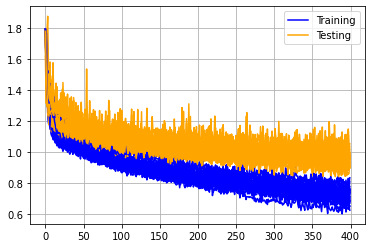

In [38]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [39]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  0.9640072941780091
mean accuracy:  0.6150391125679016


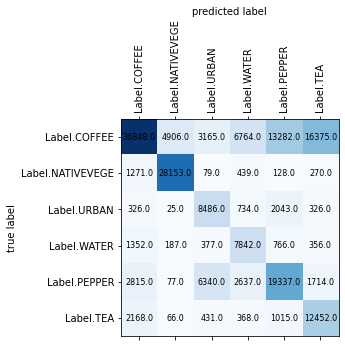

In [40]:
plot_confusion_matrix(conf_matrix, labels)

In [41]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.82286735 0.84255103 0.44951796 0.41748296 0.52875229 0.39538945]
Recalls:  [0.45301205 0.92791694 0.71072027 0.72077206 0.58739368 0.75466667]
F-Score:  [0.58433238 0.88317596 0.55071711 0.52872168 0.5565325  0.51890901]


# NIR, RED, SWIR1, SWIR2

In [43]:
BANDS = [
    Band.NIR.value,
    Band.RED.value,
    Band.SWIR1.value,
    Band.SWIR2.value
]

In [44]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_5 (Rescaling)      (None, 11, 11, 4)         0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 11, 11, 8)         296       
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0850 - accuracy: 0.5326 - val_loss: 1.1049 - val_accuracy: 0.5275
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9588 - accuracy: 0.5451 - val_loss: 1.0914 - val_accuracy: 0.5204
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9758 - accuracy: 0.5314 - val_loss: 1.0762 - val_accuracy: 0.5536
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9915 - accuracy: 0.5231 - val_loss: 1.1180 - val_accuracy: 0.5235
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0101 - accuracy: 0.5167 - val_loss: 1.0558 - val_accuracy: 0.5722
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0964 - accuracy: 0.4929 - val_loss: 1.1376 - val_accuracy: 0.5314
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0280 - accuracy: 0.5179 - val_loss: 1.1133 - val_accuracy: 0.5715
Epoch

57/57 [==============================] - 1s 9ms/step - loss: 0.8770 - accuracy: 0.5976 - val_loss: 0.9742 - val_accuracy: 0.6021
Epoch 161/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7641 - accuracy: 0.6260 - val_loss: 1.0118 - val_accuracy: 0.5759
Epoch 162/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8242 - accuracy: 0.5829 - val_loss: 1.0512 - val_accuracy: 0.5784
Epoch 163/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8715 - accuracy: 0.5717 - val_loss: 0.9704 - val_accuracy: 0.5968
Epoch 164/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8372 - accuracy: 0.5997 - val_loss: 0.9610 - val_accuracy: 0.6214
Epoch 165/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8115 - accuracy: 0.6063 - val_loss: 1.0328 - val_accuracy: 0.5372
Epoch 166/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8360 - accuracy: 0.5810 - val_loss: 0.9873 - val_accuracy: 0.5961
Epoch 167/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7553 - accuracy: 0.6442 - val_loss: 0.9377 - val_accuracy: 0.6206
Epoch 275/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7779 - accuracy: 0.6313 - val_loss: 0.9706 - val_accuracy: 0.6088
Epoch 276/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7862 - accuracy: 0.6415 - val_loss: 0.8933 - val_accuracy: 0.6550
Epoch 277/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7620 - accuracy: 0.6547 - val_loss: 0.9518 - val_accuracy: 0.6145
Epoch 278/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7852 - accuracy: 0.6267 - val_loss: 0.9173 - val_accuracy: 0.6421
Epoch 279/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7285 - accuracy: 0.6374 - val_loss: 0.9264 - val_accuracy: 0.6308
Epoch 280/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7718 - accuracy: 0.6368 - val_loss: 0.9163 - val_accuracy: 0.6494
Epoch 281/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6689 - accuracy: 0.6528 - val_loss: 0.9817 - val_accuracy: 0.6086
Epoch 389/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6692 - accuracy: 0.6567 - val_loss: 0.8959 - val_accuracy: 0.6346
Epoch 390/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7646 - accuracy: 0.6477 - val_loss: 0.9548 - val_accuracy: 0.6156
Epoch 391/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7082 - accuracy: 0.6417 - val_loss: 0.9724 - val_accuracy: 0.6054
Epoch 392/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7175 - accuracy: 0.6456 - val_loss: 0.9249 - val_accuracy: 0.6350
Epoch 393/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7126 - accuracy: 0.6601 - val_loss: 0.8475 - val_accuracy: 0.6760
Epoch 394/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7290 - accuracy: 0.6589 - val_loss: 0.9359 - val_accuracy: 0.6349
Epoch 395/400

Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9280 - accuracy: 0.5681 - val_loss: 1.0621 - val_accuracy: 0.5396
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9331 - accuracy: 0.5263 - val_loss: 1.0932 - val_accuracy: 0.5414
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9636 - accuracy: 0.5594 - val_loss: 1.0409 - val_accuracy: 0.5645
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8674 - accuracy: 0.5479 - val_loss: 1.0472 - val_accuracy: 0.5502
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9765 - accuracy: 0.5352 - val_loss: 1.0438 - val_accuracy: 0.5535
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0328 - accuracy: 0.5280 - val_loss: 1.0020 - val_accuracy: 0.5801
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9491 - accuracy: 0.5546 - val_loss: 1.0853 - val_accuracy: 0.5525
E

57/57 [==============================] - 1s 9ms/step - loss: 0.8210 - accuracy: 0.5779 - val_loss: 0.9938 - val_accuracy: 0.5920
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8025 - accuracy: 0.6280 - val_loss: 0.9465 - val_accuracy: 0.6265
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8723 - accuracy: 0.6160 - val_loss: 0.9476 - val_accuracy: 0.6330
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8362 - accuracy: 0.6051 - val_loss: 0.9492 - val_accuracy: 0.5997
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7793 - accuracy: 0.6163 - val_loss: 0.9429 - val_accuracy: 0.6223
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7888 - accuracy: 0.5913 - val_loss: 1.0425 - val_accuracy: 0.5589
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8223 - accuracy: 0.5780 - val_loss: 1.0403 - val_accuracy: 0.5627
Epoch 219/400

57/57 [==============================] - 1s 10ms/step - loss: 0.8195 - accuracy: 0.6204 - val_loss: 0.9468 - val_accuracy: 0.6212
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7707 - accuracy: 0.6212 - val_loss: 0.9522 - val_accuracy: 0.6115
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7831 - accuracy: 0.6272 - val_loss: 0.9230 - val_accuracy: 0.6291
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7169 - accuracy: 0.6578 - val_loss: 0.9971 - val_accuracy: 0.5637
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7644 - accuracy: 0.6098 - val_loss: 0.9392 - val_accuracy: 0.6074
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7532 - accuracy: 0.6317 - val_loss: 1.0061 - val_accuracy: 0.5888
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7604 - accuracy: 0.6267 - val_loss: 1.1343 - val_accuracy: 0.5100
Epoch 333/40

57/57 [==============================] - 1s 9ms/step - loss: 0.9856 - accuracy: 0.5084 - val_loss: 1.1280 - val_accuracy: 0.4798
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0281 - accuracy: 0.4965 - val_loss: 1.1506 - val_accuracy: 0.4517
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9702 - accuracy: 0.4799 - val_loss: 1.1290 - val_accuracy: 0.4897
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0359 - accuracy: 0.4647 - val_loss: 1.1038 - val_accuracy: 0.5263
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0531 - accuracy: 0.4916 - val_loss: 1.0871 - val_accuracy: 0.5220
Epoch 40/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9804 - accuracy: 0.5291 - val_loss: 1.1830 - val_accuracy: 0.4753
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9978 - accuracy: 0.5202 - val_loss: 1.0699 - val_accuracy: 0.5491
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9302 - accuracy: 0.5730 - val_loss: 0.9769 - val_accuracy: 0.5868
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9028 - accuracy: 0.5819 - val_loss: 1.0456 - val_accuracy: 0.5634
Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9503 - accuracy: 0.5372 - val_loss: 1.0305 - val_accuracy: 0.5445
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9024 - accuracy: 0.5702 - val_loss: 1.0134 - val_accuracy: 0.5756
Epoch 97/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9203 - accuracy: 0.5691 - val_loss: 1.0491 - val_accuracy: 0.5369
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8496 - accuracy: 0.5593 - val_loss: 1.1399 - val_accuracy: 0.5139
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9355 - accuracy: 0.5378 - val_loss: 1.0603 - val_accuracy: 0.5625
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8295 - accuracy: 0.6063 - val_loss: 1.0200 - val_accuracy: 0.5410
Epoch 208/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7174 - accuracy: 0.5873 - val_loss: 1.0070 - val_accuracy: 0.5600
Epoch 209/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7378 - accuracy: 0.6215 - val_loss: 0.9652 - val_accuracy: 0.5703
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7483 - accuracy: 0.6268 - val_loss: 0.9753 - val_accuracy: 0.5759
Epoch 211/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7074 - accuracy: 0.6220 - val_loss: 0.8794 - val_accuracy: 0.6250
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7825 - accuracy: 0.6237 - val_loss: 0.8981 - val_accuracy: 0.6064
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7247 - accuracy: 0.6371 - val_loss: 0.9435 - val_accuracy: 0.5921
Epoch 214/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7293 - accuracy: 0.6504 - val_loss: 0.8827 - val_accuracy: 0.6390
Epoch 322/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6964 - accuracy: 0.6424 - val_loss: 0.9348 - val_accuracy: 0.6051
Epoch 323/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6797 - accuracy: 0.6829 - val_loss: 0.8941 - val_accuracy: 0.6409
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6345 - accuracy: 0.6796 - val_loss: 0.8490 - val_accuracy: 0.6535
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6377 - accuracy: 0.6706 - val_loss: 0.9008 - val_accuracy: 0.6236
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6775 - accuracy: 0.6757 - val_loss: 0.8898 - val_accuracy: 0.6234
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6960 - accuracy: 0.6706 - val_loss: 0.9377 - val_accuracy: 0.5955
Epoch 328/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0452 - accuracy: 0.5186 - val_loss: 1.1689 - val_accuracy: 0.5041
Epoch 31/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9722 - accuracy: 0.4997 - val_loss: 1.1416 - val_accuracy: 0.5007
Epoch 32/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9888 - accuracy: 0.5127 - val_loss: 1.1297 - val_accuracy: 0.5317
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0540 - accuracy: 0.4930 - val_loss: 1.0808 - val_accuracy: 0.5447
Epoch 34/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9645 - accuracy: 0.5306 - val_loss: 1.1409 - val_accuracy: 0.4982
Epoch 35/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9653 - accuracy: 0.5216 - val_loss: 1.1295 - val_accuracy: 0.5092
Epoch 36/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9629 - accuracy: 0.4915 - val_loss: 1.1644 - val_accuracy: 0.4707
Epoch 37/400
57/5

57/57 [==============================] - 1s 9ms/step - loss: 0.8687 - accuracy: 0.5586 - val_loss: 1.0463 - val_accuracy: 0.5630
Epoch 145/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7892 - accuracy: 0.5609 - val_loss: 0.9628 - val_accuracy: 0.5959
Epoch 146/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7900 - accuracy: 0.6081 - val_loss: 1.0969 - val_accuracy: 0.4938
Epoch 147/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8207 - accuracy: 0.5166 - val_loss: 1.1981 - val_accuracy: 0.4846
Epoch 148/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8494 - accuracy: 0.5393 - val_loss: 0.9920 - val_accuracy: 0.5657
Epoch 149/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8754 - accuracy: 0.5722 - val_loss: 0.9985 - val_accuracy: 0.5744
Epoch 150/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7843 - accuracy: 0.5610 - val_loss: 1.0042 - val_accuracy: 0.5509
Epoch 151/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7835 - accuracy: 0.5897 - val_loss: 0.9392 - val_accuracy: 0.5981
Epoch 259/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7363 - accuracy: 0.5786 - val_loss: 0.9216 - val_accuracy: 0.6299
Epoch 260/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7746 - accuracy: 0.5860 - val_loss: 0.9805 - val_accuracy: 0.5811
Epoch 261/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7507 - accuracy: 0.5613 - val_loss: 0.9757 - val_accuracy: 0.5892
Epoch 262/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6656 - accuracy: 0.6249 - val_loss: 0.9406 - val_accuracy: 0.6023
Epoch 263/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6977 - accuracy: 0.5848 - val_loss: 0.9666 - val_accuracy: 0.5858
Epoch 264/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7282 - accuracy: 0.5958 - val_loss: 0.9764 - val_accuracy: 0.5833
Epoch 265/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6807 - accuracy: 0.6539 - val_loss: 0.9026 - val_accuracy: 0.6349
Epoch 373/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6835 - accuracy: 0.6165 - val_loss: 0.8910 - val_accuracy: 0.6535
Epoch 374/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6694 - accuracy: 0.6515 - val_loss: 0.9140 - val_accuracy: 0.6375
Epoch 375/400
57/57 [==============================] - 1s 10ms/step - loss: 0.6397 - accuracy: 0.6553 - val_loss: 0.9034 - val_accuracy: 0.6374
Epoch 376/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6593 - accuracy: 0.6285 - val_loss: 0.9516 - val_accuracy: 0.6227
Epoch 377/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6510 - accuracy: 0.6202 - val_loss: 0.9712 - val_accuracy: 0.6102
Epoch 378/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7153 - accuracy: 0.6049 - val_loss: 0.9981 - val_accuracy: 0.6092
Epoch 379/40

Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9645 - accuracy: 0.5235 - val_loss: 1.0819 - val_accuracy: 0.5427
Epoch 83/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9124 - accuracy: 0.5503 - val_loss: 1.0707 - val_accuracy: 0.5373
Epoch 84/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9740 - accuracy: 0.4915 - val_loss: 1.0647 - val_accuracy: 0.5247
Epoch 85/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9377 - accuracy: 0.5321 - val_loss: 1.0652 - val_accuracy: 0.5701
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9579 - accuracy: 0.5376 - val_loss: 1.0853 - val_accuracy: 0.5418
Epoch 87/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9928 - accuracy: 0.5151 - val_loss: 1.0808 - val_accuracy: 0.5379
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9973 - accuracy: 0.5142 - val_loss: 1.0581 - val_accuracy: 0.5418
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8361 - accuracy: 0.5855 - val_loss: 1.0127 - val_accuracy: 0.5758
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8575 - accuracy: 0.5958 - val_loss: 1.0537 - val_accuracy: 0.5523
Epoch 198/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8427 - accuracy: 0.5737 - val_loss: 0.9877 - val_accuracy: 0.5823
Epoch 199/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8567 - accuracy: 0.5726 - val_loss: 0.9902 - val_accuracy: 0.5869
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8111 - accuracy: 0.5873 - val_loss: 1.0274 - val_accuracy: 0.5803
Epoch 201/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8702 - accuracy: 0.5902 - val_loss: 1.0232 - val_accuracy: 0.5780
Epoch 202/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8766 - accuracy: 0.5756 - val_loss: 0.9911 - val_accuracy: 0.6047
Epoch 203/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8045 - accuracy: 0.6073 - val_loss: 1.0282 - val_accuracy: 0.5880
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7393 - accuracy: 0.6124 - val_loss: 0.9291 - val_accuracy: 0.6300
Epoch 312/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7762 - accuracy: 0.6277 - val_loss: 0.9655 - val_accuracy: 0.6053
Epoch 313/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7537 - accuracy: 0.6328 - val_loss: 0.9350 - val_accuracy: 0.6185
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7319 - accuracy: 0.6254 - val_loss: 0.9741 - val_accuracy: 0.5899
Epoch 315/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7525 - accuracy: 0.6322 - val_loss: 0.9531 - val_accuracy: 0.6172
Epoch 316/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8710 - accuracy: 0.5893 - val_loss: 0.9472 - val_accuracy: 0.6062
Epoch 317/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0709 - accuracy: 0.4832 - val_loss: 1.1231 - val_accuracy: 0.4568
Epoch 20/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0512 - accuracy: 0.4837 - val_loss: 1.1307 - val_accuracy: 0.4685
Epoch 21/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0795 - accuracy: 0.4410 - val_loss: 1.1072 - val_accuracy: 0.4884
Epoch 22/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0996 - accuracy: 0.4645 - val_loss: 1.1491 - val_accuracy: 0.4814
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0549 - accuracy: 0.4379 - val_loss: 1.1519 - val_accuracy: 0.4594
Epoch 24/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0705 - accuracy: 0.4513 - val_loss: 1.1356 - val_accuracy: 0.4836
Epoch 25/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0066 - accuracy: 0.4911 - val_loss: 1.0968 - val_accuracy: 0.5218
Epoch 26/400
57/57 

Epoch 77/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8710 - accuracy: 0.5847 - val_loss: 1.0427 - val_accuracy: 0.5688
Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9555 - accuracy: 0.5111 - val_loss: 1.0889 - val_accuracy: 0.5307
Epoch 79/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9073 - accuracy: 0.5348 - val_loss: 1.0476 - val_accuracy: 0.5489
Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8989 - accuracy: 0.5724 - val_loss: 1.1110 - val_accuracy: 0.5063
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8718 - accuracy: 0.5487 - val_loss: 1.0866 - val_accuracy: 0.5435
Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8847 - accuracy: 0.5503 - val_loss: 1.1259 - val_accuracy: 0.5234
Epoch 83/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9012 - accuracy: 0.5560 - val_loss: 1.1286 - val_accuracy: 0.4970
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.7549 - accuracy: 0.5863 - val_loss: 0.9422 - val_accuracy: 0.6064
Epoch 192/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7411 - accuracy: 0.5885 - val_loss: 1.0072 - val_accuracy: 0.5560
Epoch 193/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7511 - accuracy: 0.5899 - val_loss: 0.9449 - val_accuracy: 0.6096
Epoch 194/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7848 - accuracy: 0.5953 - val_loss: 0.9246 - val_accuracy: 0.6315
Epoch 195/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7536 - accuracy: 0.6331 - val_loss: 0.9365 - val_accuracy: 0.6183
Epoch 196/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7462 - accuracy: 0.6035 - val_loss: 0.9465 - val_accuracy: 0.5953
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7834 - accuracy: 0.5780 - val_loss: 0.9513 - val_accuracy: 0.5958
Epoch 198/400

57/57 [==============================] - 1s 10ms/step - loss: 0.7233 - accuracy: 0.6179 - val_loss: 0.9243 - val_accuracy: 0.6215
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6881 - accuracy: 0.6141 - val_loss: 0.8969 - val_accuracy: 0.6289
Epoch 307/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6577 - accuracy: 0.6271 - val_loss: 0.9784 - val_accuracy: 0.6079
Epoch 308/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7253 - accuracy: 0.5857 - val_loss: 0.9396 - val_accuracy: 0.6127
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6353 - accuracy: 0.6411 - val_loss: 0.9278 - val_accuracy: 0.6219
Epoch 310/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6356 - accuracy: 0.6586 - val_loss: 0.8677 - val_accuracy: 0.6581
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6763 - accuracy: 0.6603 - val_loss: 0.9480 - val_accuracy: 0.6161
Epoch 312/4

57/57 [==============================] - 1s 9ms/step - loss: 1.0978 - accuracy: 0.4269 - val_loss: 1.1805 - val_accuracy: 0.3814
Epoch 15/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1447 - accuracy: 0.4219 - val_loss: 1.2184 - val_accuracy: 0.4563
Epoch 16/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1333 - accuracy: 0.4119 - val_loss: 1.1806 - val_accuracy: 0.4779
Epoch 17/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0534 - accuracy: 0.4425 - val_loss: 1.1538 - val_accuracy: 0.4201
Epoch 18/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0661 - accuracy: 0.4174 - val_loss: 1.1423 - val_accuracy: 0.5090
Epoch 19/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0914 - accuracy: 0.4521 - val_loss: 1.1289 - val_accuracy: 0.4809
Epoch 20/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1351 - accuracy: 0.4640 - val_loss: 1.1343 - val_accuracy: 0.5157
Epoch 21/400
57/57 

Epoch 72/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8862 - accuracy: 0.5721 - val_loss: 1.0712 - val_accuracy: 0.5297
Epoch 73/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9373 - accuracy: 0.5453 - val_loss: 1.2720 - val_accuracy: 0.4457
Epoch 74/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0267 - accuracy: 0.4923 - val_loss: 1.1616 - val_accuracy: 0.4771
Epoch 75/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0002 - accuracy: 0.5076 - val_loss: 1.0833 - val_accuracy: 0.5514
Epoch 76/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9428 - accuracy: 0.5481 - val_loss: 1.0120 - val_accuracy: 0.5971
Epoch 77/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9945 - accuracy: 0.5389 - val_loss: 1.0240 - val_accuracy: 0.5751
Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9506 - accuracy: 0.5423 - val_loss: 0.9691 - val_accuracy: 0.6153
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8013 - accuracy: 0.5930 - val_loss: 1.0190 - val_accuracy: 0.5563
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8155 - accuracy: 0.6158 - val_loss: 0.9406 - val_accuracy: 0.6220
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7781 - accuracy: 0.6277 - val_loss: 1.0536 - val_accuracy: 0.5534
Epoch 189/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7944 - accuracy: 0.6007 - val_loss: 1.2337 - val_accuracy: 0.4681
Epoch 190/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8148 - accuracy: 0.5963 - val_loss: 0.9358 - val_accuracy: 0.6147
Epoch 191/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7821 - accuracy: 0.6328 - val_loss: 1.0611 - val_accuracy: 0.5675
Epoch 192/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9409 - accuracy: 0.5693 - val_loss: 1.0081 - val_accuracy: 0.5747
Epoch 193/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7819 - accuracy: 0.6041 - val_loss: 1.0013 - val_accuracy: 0.6008
Epoch 301/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7069 - accuracy: 0.6483 - val_loss: 0.9060 - val_accuracy: 0.6315
Epoch 302/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8394 - accuracy: 0.6289 - val_loss: 0.9225 - val_accuracy: 0.6239
Epoch 303/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7230 - accuracy: 0.6507 - val_loss: 0.9049 - val_accuracy: 0.6344
Epoch 304/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7001 - accuracy: 0.6357 - val_loss: 0.8979 - val_accuracy: 0.6469
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7018 - accuracy: 0.6327 - val_loss: 0.8940 - val_accuracy: 0.6522
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6900 - accuracy: 0.6396 - val_loss: 0.9603 - val_accuracy: 0.6195
Epoch 307/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2086 - accuracy: 0.4088 - val_loss: 1.3097 - val_accuracy: 0.3090
Epoch 10/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2434 - accuracy: 0.3838 - val_loss: 1.3088 - val_accuracy: 0.3322
Epoch 11/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2670 - accuracy: 0.3781 - val_loss: 1.3140 - val_accuracy: 0.4099
Epoch 12/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3284 - accuracy: 0.3850 - val_loss: 1.2635 - val_accuracy: 0.5240
Epoch 13/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2317 - accuracy: 0.4556 - val_loss: 1.2394 - val_accuracy: 0.3477
Epoch 14/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3153 - accuracy: 0.3922 - val_loss: 1.2373 - val_accuracy: 0.4063
Epoch 15/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2585 - accuracy: 0.4352 - val_loss: 1.2588 - val_accuracy: 0.3538
Epoch 16/400
57/57 

Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0624 - accuracy: 0.5281 - val_loss: 1.1672 - val_accuracy: 0.5101
Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0105 - accuracy: 0.5430 - val_loss: 1.0834 - val_accuracy: 0.5486
Epoch 69/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9977 - accuracy: 0.5523 - val_loss: 1.1210 - val_accuracy: 0.4806
Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0430 - accuracy: 0.5406 - val_loss: 1.1833 - val_accuracy: 0.4487
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1008 - accuracy: 0.5018 - val_loss: 1.1341 - val_accuracy: 0.4915
Epoch 72/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9744 - accuracy: 0.5486 - val_loss: 1.1467 - val_accuracy: 0.4842
Epoch 73/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0421 - accuracy: 0.5190 - val_loss: 1.0683 - val_accuracy: 0.5709
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8311 - accuracy: 0.5949 - val_loss: 1.0072 - val_accuracy: 0.5642
Epoch 182/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9180 - accuracy: 0.5910 - val_loss: 1.0417 - val_accuracy: 0.5501
Epoch 183/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8694 - accuracy: 0.5661 - val_loss: 0.9652 - val_accuracy: 0.5974
Epoch 184/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9122 - accuracy: 0.5549 - val_loss: 0.9883 - val_accuracy: 0.5759
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9006 - accuracy: 0.5808 - val_loss: 0.9861 - val_accuracy: 0.5871
Epoch 186/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9065 - accuracy: 0.5860 - val_loss: 0.9888 - val_accuracy: 0.5939
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8485 - accuracy: 0.6038 - val_loss: 1.0469 - val_accuracy: 0.5606
Epoch 188/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8954 - accuracy: 0.5667 - val_loss: 0.9665 - val_accuracy: 0.5921
Epoch 296/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7711 - accuracy: 0.6042 - val_loss: 1.0414 - val_accuracy: 0.5330
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8457 - accuracy: 0.5854 - val_loss: 1.0145 - val_accuracy: 0.5833
Epoch 298/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7852 - accuracy: 0.6158 - val_loss: 0.9752 - val_accuracy: 0.5638
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8230 - accuracy: 0.5726 - val_loss: 1.0156 - val_accuracy: 0.5509
Epoch 300/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7767 - accuracy: 0.5922 - val_loss: 0.9512 - val_accuracy: 0.5929
Epoch 301/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8013 - accuracy: 0.5985 - val_loss: 1.0345 - val_accuracy: 0.5349
Epoch 302/400

Epoch 4/400
57/57 [==============================] - 1s 21ms/step - loss: 1.4077 - accuracy: 0.3669 - val_loss: 1.3769 - val_accuracy: 0.3125
Epoch 5/400
57/57 [==============================] - 1s 21ms/step - loss: 1.3160 - accuracy: 0.3891 - val_loss: 1.3815 - val_accuracy: 0.3366
Epoch 6/400
57/57 [==============================] - 1s 20ms/step - loss: 1.3157 - accuracy: 0.3384 - val_loss: 1.3329 - val_accuracy: 0.3936
Epoch 7/400
57/57 [==============================] - 1s 22ms/step - loss: 1.3084 - accuracy: 0.3797 - val_loss: 1.3718 - val_accuracy: 0.3569
Epoch 8/400
57/57 [==============================] - 1s 21ms/step - loss: 1.3632 - accuracy: 0.3442 - val_loss: 1.3249 - val_accuracy: 0.3598
Epoch 9/400
57/57 [==============================] - 1s 20ms/step - loss: 1.3216 - accuracy: 0.3667 - val_loss: 1.3241 - val_accuracy: 0.3380
Epoch 10/400
57/57 [==============================] - 1s 20ms/step - loss: 1.3055 - accuracy: 0.3367 - val_loss: 1.3346 - val_accuracy: 0.3646
Epoch

57/57 [==============================] - 1s 9ms/step - loss: 1.0030 - accuracy: 0.5556 - val_loss: 1.0498 - val_accuracy: 0.5656
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9112 - accuracy: 0.5680 - val_loss: 1.1130 - val_accuracy: 0.5346
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9418 - accuracy: 0.5364 - val_loss: 1.1126 - val_accuracy: 0.5414
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9720 - accuracy: 0.5144 - val_loss: 1.1194 - val_accuracy: 0.4940
Epoch 122/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9827 - accuracy: 0.5207 - val_loss: 1.0742 - val_accuracy: 0.5351
Epoch 123/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9584 - accuracy: 0.5223 - val_loss: 1.0755 - val_accuracy: 0.5313
Epoch 124/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9755 - accuracy: 0.5418 - val_loss: 1.1198 - val_accuracy: 0.5017
Epoch 125/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8169 - accuracy: 0.5651 - val_loss: 0.9912 - val_accuracy: 0.5949
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8958 - accuracy: 0.5540 - val_loss: 1.0297 - val_accuracy: 0.5819
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8613 - accuracy: 0.5686 - val_loss: 1.0212 - val_accuracy: 0.5525
Epoch 235/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7957 - accuracy: 0.5536 - val_loss: 1.0287 - val_accuracy: 0.5493
Epoch 236/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8408 - accuracy: 0.5475 - val_loss: 1.0068 - val_accuracy: 0.5649
Epoch 237/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8476 - accuracy: 0.5655 - val_loss: 0.9815 - val_accuracy: 0.5936
Epoch 238/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7969 - accuracy: 0.5852 - val_loss: 1.0844 - val_accuracy: 0.5569
Epoch 239/4

57/57 [==============================] - 1s 9ms/step - loss: 0.8004 - accuracy: 0.6177 - val_loss: 0.9345 - val_accuracy: 0.6130
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7840 - accuracy: 0.6187 - val_loss: 0.9794 - val_accuracy: 0.5896
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8071 - accuracy: 0.5856 - val_loss: 0.9589 - val_accuracy: 0.6208
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7567 - accuracy: 0.6338 - val_loss: 0.9583 - val_accuracy: 0.6183
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8028 - accuracy: 0.5886 - val_loss: 0.9761 - val_accuracy: 0.6036
Epoch 351/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7579 - accuracy: 0.6032 - val_loss: 0.9277 - val_accuracy: 0.6030
Epoch 352/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7823 - accuracy: 0.5998 - val_loss: 0.9571 - val_accuracy: 0.6015
Epoch 353/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.7720 - accuracy: 0.1635 - val_loss: 1.7925 - val_accuracy: 0.1241
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7930 - accuracy: 0.1357 - val_loss: 1.7916 - val_accuracy: 0.0657
Epoch 3/400
57/57 [==============================] - 1s 10ms/step - loss: 1.7952 - accuracy: 0.1698 - val_loss: 1.7835 - val_accuracy: 0.0700
Epoch 4/400
57/57 [==============================] - 1s 10ms/step - loss: 1.8081 - accuracy: 0.1064 - val_loss: 1.7153 - val_accuracy: 0.1062
Epoch 5/400
57/57 [==============================] - 1s 11ms/step - loss: 1.5214 - accuracy: 0.2244 - val_loss: 1.4738 - val_accuracy: 0.3024
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3629 - accuracy: 0.3351 - val_loss: 1.3269 - val_accuracy: 0.4684
Epoch 7/400
57/57 [==============================] - 1s 10ms/step - loss: 1.2463 - accuracy: 0.3981 - val_loss: 1.2991 - val_accu

57/57 [==============================] - 1s 9ms/step - loss: 0.8235 - accuracy: 0.5752 - val_loss: 1.1378 - val_accuracy: 0.5262
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8591 - accuracy: 0.5435 - val_loss: 0.9810 - val_accuracy: 0.5932
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8385 - accuracy: 0.5734 - val_loss: 1.0432 - val_accuracy: 0.5625
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8789 - accuracy: 0.5741 - val_loss: 1.0600 - val_accuracy: 0.5441
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8062 - accuracy: 0.5869 - val_loss: 1.0399 - val_accuracy: 0.5693
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8446 - accuracy: 0.5648 - val_loss: 1.0279 - val_accuracy: 0.5847
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8441 - accuracy: 0.5614 - val_loss: 0.9794 - val_accuracy: 0.6027
Epoch 122/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7673 - accuracy: 0.5864 - val_loss: 0.9610 - val_accuracy: 0.5986
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7339 - accuracy: 0.5873 - val_loss: 0.9346 - val_accuracy: 0.6187
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7290 - accuracy: 0.6240 - val_loss: 1.0476 - val_accuracy: 0.5543
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7155 - accuracy: 0.6032 - val_loss: 1.0052 - val_accuracy: 0.5665
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7634 - accuracy: 0.6090 - val_loss: 1.0188 - val_accuracy: 0.5648
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7522 - accuracy: 0.6081 - val_loss: 0.9516 - val_accuracy: 0.6008
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7204 - accuracy: 0.5843 - val_loss: 0.9711 - val_accuracy: 0.6043
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6559 - accuracy: 0.6570 - val_loss: 0.8853 - val_accuracy: 0.6489
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7246 - accuracy: 0.6348 - val_loss: 0.9178 - val_accuracy: 0.6284
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7233 - accuracy: 0.6582 - val_loss: 0.9229 - val_accuracy: 0.6225
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6488 - accuracy: 0.6597 - val_loss: 0.9353 - val_accuracy: 0.6234
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7382 - accuracy: 0.6249 - val_loss: 0.9234 - val_accuracy: 0.6300
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6917 - accuracy: 0.6213 - val_loss: 0.9184 - val_accuracy: 0.6314
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6808 - accuracy: 0.6416 - val_loss: 0.9549 - val_accuracy: 0.5978
Epoch 350/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2359 - accuracy: 0.4283 - val_loss: 1.2157 - val_accuracy: 0.4490
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1620 - accuracy: 0.4203 - val_loss: 1.2274 - val_accuracy: 0.4504
Epoch 54/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1561 - accuracy: 0.4027 - val_loss: 1.2665 - val_accuracy: 0.4176
Epoch 55/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1090 - accuracy: 0.4195 - val_loss: 1.2335 - val_accuracy: 0.4160
Epoch 56/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1550 - accuracy: 0.4301 - val_loss: 1.2110 - val_accuracy: 0.4198
Epoch 57/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1896 - accuracy: 0.4383 - val_loss: 1.1929 - val_accuracy: 0.4935
Epoch 58/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1915 - accuracy: 0.4559 - val_loss: 1.2471 - val_accuracy: 0.4161
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9625 - accuracy: 0.5498 - val_loss: 1.1013 - val_accuracy: 0.5140
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0123 - accuracy: 0.5124 - val_loss: 1.1183 - val_accuracy: 0.5377
Epoch 112/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0233 - accuracy: 0.5237 - val_loss: 1.1124 - val_accuracy: 0.5296
Epoch 113/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9597 - accuracy: 0.5270 - val_loss: 1.0841 - val_accuracy: 0.5488
Epoch 114/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0640 - accuracy: 0.5036 - val_loss: 1.1001 - val_accuracy: 0.5398
Epoch 115/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9803 - accuracy: 0.5389 - val_loss: 1.1245 - val_accuracy: 0.5213
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0099 - accuracy: 0.5588 - val_loss: 1.1115 - val_accuracy: 0.5515

57/57 [==============================] - 1s 9ms/step - loss: 0.9245 - accuracy: 0.5522 - val_loss: 1.0810 - val_accuracy: 0.5483
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9384 - accuracy: 0.5365 - val_loss: 1.0489 - val_accuracy: 0.5722
Epoch 226/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9155 - accuracy: 0.5469 - val_loss: 1.1384 - val_accuracy: 0.5334
Epoch 227/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9614 - accuracy: 0.5683 - val_loss: 1.1317 - val_accuracy: 0.5443
Epoch 228/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9053 - accuracy: 0.5510 - val_loss: 0.9918 - val_accuracy: 0.5992
Epoch 229/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9033 - accuracy: 0.5763 - val_loss: 1.0934 - val_accuracy: 0.5136
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9114 - accuracy: 0.5435 - val_loss: 1.0480 - val_accuracy: 0.5307
Epoch 231/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8250 - accuracy: 0.5198 - val_loss: 0.9814 - val_accuracy: 0.5814
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8788 - accuracy: 0.5553 - val_loss: 1.0367 - val_accuracy: 0.5386
Epoch 340/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8689 - accuracy: 0.5649 - val_loss: 0.9533 - val_accuracy: 0.6003
Epoch 341/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8399 - accuracy: 0.5960 - val_loss: 1.0223 - val_accuracy: 0.5653
Epoch 342/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8723 - accuracy: 0.5838 - val_loss: 0.9488 - val_accuracy: 0.6066
Epoch 343/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8530 - accuracy: 0.5968 - val_loss: 0.9869 - val_accuracy: 0.5832
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8559 - accuracy: 0.5705 - val_loss: 1.0085 - val_accuracy: 0.5764
Epoch 345/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0360 - accuracy: 0.4920 - val_loss: 1.1821 - val_accuracy: 0.4604
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9781 - accuracy: 0.4906 - val_loss: 1.1319 - val_accuracy: 0.4911
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0183 - accuracy: 0.4976 - val_loss: 1.1262 - val_accuracy: 0.5003
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0623 - accuracy: 0.5162 - val_loss: 1.2226 - val_accuracy: 0.4521
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0483 - accuracy: 0.4948 - val_loss: 1.0770 - val_accuracy: 0.5138
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9509 - accuracy: 0.5213 - val_loss: 1.0907 - val_accuracy: 0.5047
Epoch 53/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0118 - accuracy: 0.5107 - val_loss: 1.0401 - val_accuracy: 0.5453
Epoch 54/400
57/57

57/57 [==============================] - 1s 9ms/step - loss: 0.8629 - accuracy: 0.5399 - val_loss: 1.0508 - val_accuracy: 0.5214
Epoch 162/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8633 - accuracy: 0.5603 - val_loss: 1.0217 - val_accuracy: 0.5413
Epoch 163/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8488 - accuracy: 0.5791 - val_loss: 1.0647 - val_accuracy: 0.5093
Epoch 164/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9438 - accuracy: 0.5486 - val_loss: 1.1239 - val_accuracy: 0.4877
Epoch 165/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8364 - accuracy: 0.5624 - val_loss: 0.9753 - val_accuracy: 0.5767
Epoch 166/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8516 - accuracy: 0.5743 - val_loss: 1.0677 - val_accuracy: 0.5273
Epoch 167/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8516 - accuracy: 0.5601 - val_loss: 0.9666 - val_accuracy: 0.5936
Epoch 168/40

57/57 [==============================] - 1s 9ms/step - loss: 0.7613 - accuracy: 0.6188 - val_loss: 0.9680 - val_accuracy: 0.5861
Epoch 276/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7262 - accuracy: 0.6310 - val_loss: 0.9134 - val_accuracy: 0.6201
Epoch 277/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7608 - accuracy: 0.6131 - val_loss: 0.9897 - val_accuracy: 0.5839
Epoch 278/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8068 - accuracy: 0.5958 - val_loss: 0.9081 - val_accuracy: 0.6391
Epoch 279/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8173 - accuracy: 0.6107 - val_loss: 0.9674 - val_accuracy: 0.6017
Epoch 280/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7708 - accuracy: 0.6316 - val_loss: 0.8933 - val_accuracy: 0.6455
Epoch 281/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7399 - accuracy: 0.6578 - val_loss: 0.9573 - val_accuracy: 0.6000
Epoch 282/40

57/57 [==============================] - 1s 9ms/step - loss: 0.7249 - accuracy: 0.6358 - val_loss: 1.0873 - val_accuracy: 0.5433
Epoch 390/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7020 - accuracy: 0.6199 - val_loss: 0.9652 - val_accuracy: 0.5974
Epoch 391/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6893 - accuracy: 0.6354 - val_loss: 0.9066 - val_accuracy: 0.6393
Epoch 392/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6834 - accuracy: 0.6450 - val_loss: 0.8949 - val_accuracy: 0.6486
Epoch 393/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6849 - accuracy: 0.6371 - val_loss: 0.9094 - val_accuracy: 0.6349
Epoch 394/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6634 - accuracy: 0.6541 - val_loss: 1.0187 - val_accuracy: 0.5674
Epoch 395/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7396 - accuracy: 0.6174 - val_loss: 0.9475 - val_accuracy: 0.6295
Epoch 396/40

Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8308 - accuracy: 0.6046 - val_loss: 1.0205 - val_accuracy: 0.5769
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9234 - accuracy: 0.5686 - val_loss: 1.0323 - val_accuracy: 0.5801
Epoch 101/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8384 - accuracy: 0.5944 - val_loss: 1.0414 - val_accuracy: 0.5645
Epoch 102/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8577 - accuracy: 0.5722 - val_loss: 0.9674 - val_accuracy: 0.6004
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8215 - accuracy: 0.5773 - val_loss: 1.0776 - val_accuracy: 0.5487
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8771 - accuracy: 0.5598 - val_loss: 0.9941 - val_accuracy: 0.5770
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8165 - accuracy: 0.6055 - val_loss: 1.0511 - val_accuracy: 0.536

57/57 [==============================] - 1s 9ms/step - loss: 0.7762 - accuracy: 0.6213 - val_loss: 0.9883 - val_accuracy: 0.5958
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7760 - accuracy: 0.6065 - val_loss: 0.9369 - val_accuracy: 0.6240
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7854 - accuracy: 0.6054 - val_loss: 0.9653 - val_accuracy: 0.5983
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7098 - accuracy: 0.6321 - val_loss: 0.9717 - val_accuracy: 0.6136
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7322 - accuracy: 0.6168 - val_loss: 0.9717 - val_accuracy: 0.5982
Epoch 218/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8241 - accuracy: 0.5746 - val_loss: 0.9332 - val_accuracy: 0.6212
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7447 - accuracy: 0.6211 - val_loss: 0.9782 - val_accuracy: 0.6023
Epoch 220/40

57/57 [==============================] - 1s 9ms/step - loss: 0.6334 - accuracy: 0.6352 - val_loss: 1.0206 - val_accuracy: 0.6009
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6543 - accuracy: 0.6442 - val_loss: 1.0054 - val_accuracy: 0.5975
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6673 - accuracy: 0.6619 - val_loss: 0.9701 - val_accuracy: 0.6031
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6582 - accuracy: 0.6367 - val_loss: 0.9457 - val_accuracy: 0.6244
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6903 - accuracy: 0.6274 - val_loss: 0.9001 - val_accuracy: 0.6475
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6614 - accuracy: 0.6569 - val_loss: 0.8487 - val_accuracy: 0.6731
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6360 - accuracy: 0.6450 - val_loss: 0.8848 - val_accuracy: 0.6474
Epoch 334/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0390 - accuracy: 0.4899 - val_loss: 1.1362 - val_accuracy: 0.4658
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9813 - accuracy: 0.5046 - val_loss: 1.1013 - val_accuracy: 0.5020
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9641 - accuracy: 0.5198 - val_loss: 1.2200 - val_accuracy: 0.4165
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0028 - accuracy: 0.4913 - val_loss: 1.1081 - val_accuracy: 0.5069
Epoch 40/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9437 - accuracy: 0.5212 - val_loss: 1.0886 - val_accuracy: 0.5145
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9592 - accuracy: 0.5428 - val_loss: 1.0349 - val_accuracy: 0.5751
Epoch 42/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9491 - accuracy: 0.5250 - val_loss: 1.0782 - val_accuracy: 0.5461
Epoch 43/400
57/57 

Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8699 - accuracy: 0.5527 - val_loss: 1.0606 - val_accuracy: 0.5339
Epoch 95/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8838 - accuracy: 0.5700 - val_loss: 1.1648 - val_accuracy: 0.5145
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8813 - accuracy: 0.5477 - val_loss: 1.0470 - val_accuracy: 0.5461
Epoch 97/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9102 - accuracy: 0.5460 - val_loss: 1.0433 - val_accuracy: 0.5338
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8813 - accuracy: 0.5758 - val_loss: 1.0804 - val_accuracy: 0.5307
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8652 - accuracy: 0.5500 - val_loss: 1.0006 - val_accuracy: 0.5864
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8847 - accuracy: 0.5577 - val_loss: 1.0122 - val_accuracy: 0.5956
Epo

57/57 [==============================] - 1s 9ms/step - loss: 0.8576 - accuracy: 0.6056 - val_loss: 0.9929 - val_accuracy: 0.5755
Epoch 209/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7841 - accuracy: 0.5950 - val_loss: 1.0873 - val_accuracy: 0.5154
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8706 - accuracy: 0.5742 - val_loss: 0.9286 - val_accuracy: 0.6138
Epoch 211/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7934 - accuracy: 0.5884 - val_loss: 0.9751 - val_accuracy: 0.5896
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7827 - accuracy: 0.5993 - val_loss: 0.9977 - val_accuracy: 0.5873
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7271 - accuracy: 0.5907 - val_loss: 0.9752 - val_accuracy: 0.5933
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7388 - accuracy: 0.6027 - val_loss: 1.0141 - val_accuracy: 0.5759
Epoch 215/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7600 - accuracy: 0.6089 - val_loss: 0.9161 - val_accuracy: 0.6085
Epoch 323/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7372 - accuracy: 0.6235 - val_loss: 0.9833 - val_accuracy: 0.5740
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7045 - accuracy: 0.6212 - val_loss: 0.9572 - val_accuracy: 0.5907
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7265 - accuracy: 0.6110 - val_loss: 0.9107 - val_accuracy: 0.6296
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7187 - accuracy: 0.6272 - val_loss: 0.9921 - val_accuracy: 0.5949
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7222 - accuracy: 0.6108 - val_loss: 0.9724 - val_accuracy: 0.6050
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7233 - accuracy: 0.6341 - val_loss: 0.9163 - val_accuracy: 0.6335
Epoch 329/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0147 - accuracy: 0.4740 - val_loss: 1.2281 - val_accuracy: 0.4505
Epoch 32/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0779 - accuracy: 0.4544 - val_loss: 1.1677 - val_accuracy: 0.5118
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0071 - accuracy: 0.4986 - val_loss: 1.1826 - val_accuracy: 0.4189
Epoch 34/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0595 - accuracy: 0.4695 - val_loss: 1.3768 - val_accuracy: 0.4106
Epoch 35/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0030 - accuracy: 0.4955 - val_loss: 1.1476 - val_accuracy: 0.5096
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0019 - accuracy: 0.4912 - val_loss: 1.1419 - val_accuracy: 0.5052
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0047 - accuracy: 0.5027 - val_loss: 1.1854 - val_accuracy: 0.4679
Epoch 38/400
57/57 

Epoch 89/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8418 - accuracy: 0.5769 - val_loss: 1.0515 - val_accuracy: 0.5653
Epoch 90/400
57/57 [==============================] - 1s 11ms/step - loss: 0.9493 - accuracy: 0.5524 - val_loss: 1.0801 - val_accuracy: 0.5379
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9685 - accuracy: 0.5174 - val_loss: 1.0448 - val_accuracy: 0.5640
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9171 - accuracy: 0.5662 - val_loss: 1.0151 - val_accuracy: 0.5770
Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0542 - accuracy: 0.5572 - val_loss: 1.1153 - val_accuracy: 0.5086
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9000 - accuracy: 0.5513 - val_loss: 1.0590 - val_accuracy: 0.5610
Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8765 - accuracy: 0.5519 - val_loss: 1.1448 - val_accuracy: 0.5024
Epoch

57/57 [==============================] - 1s 9ms/step - loss: 0.8240 - accuracy: 0.5824 - val_loss: 0.9699 - val_accuracy: 0.6114
Epoch 204/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8095 - accuracy: 0.6196 - val_loss: 1.0514 - val_accuracy: 0.5460
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7911 - accuracy: 0.5928 - val_loss: 1.0523 - val_accuracy: 0.5543
Epoch 206/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7941 - accuracy: 0.5962 - val_loss: 0.9625 - val_accuracy: 0.6080
Epoch 207/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7377 - accuracy: 0.6119 - val_loss: 1.0030 - val_accuracy: 0.5809
Epoch 208/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7489 - accuracy: 0.6217 - val_loss: 0.9538 - val_accuracy: 0.6113
Epoch 209/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7872 - accuracy: 0.6172 - val_loss: 1.0927 - val_accuracy: 0.5444
Epoch 210/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7341 - accuracy: 0.6389 - val_loss: 1.0510 - val_accuracy: 0.5710
Epoch 318/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7891 - accuracy: 0.6198 - val_loss: 0.9208 - val_accuracy: 0.6295
Epoch 319/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7488 - accuracy: 0.6323 - val_loss: 0.9712 - val_accuracy: 0.5937
Epoch 320/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7593 - accuracy: 0.6311 - val_loss: 0.9502 - val_accuracy: 0.6208
Epoch 321/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7108 - accuracy: 0.6549 - val_loss: 0.9529 - val_accuracy: 0.6134
Epoch 322/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7157 - accuracy: 0.6440 - val_loss: 1.1276 - val_accuracy: 0.5342
Epoch 323/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7259 - accuracy: 0.6221 - val_loss: 0.9051 - val_accuracy: 0.6467
Epoch 324/40

57/57 [==============================] - 1s 10ms/step - loss: 1.1309 - accuracy: 0.3951 - val_loss: 1.1655 - val_accuracy: 0.4961
Epoch 27/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0242 - accuracy: 0.4800 - val_loss: 1.2374 - val_accuracy: 0.4195
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1081 - accuracy: 0.4293 - val_loss: 1.1569 - val_accuracy: 0.4735
Epoch 29/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0206 - accuracy: 0.4261 - val_loss: 1.1390 - val_accuracy: 0.5050
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0295 - accuracy: 0.4923 - val_loss: 1.1501 - val_accuracy: 0.4831
Epoch 31/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0764 - accuracy: 0.4745 - val_loss: 1.1286 - val_accuracy: 0.5271
Epoch 32/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9892 - accuracy: 0.5120 - val_loss: 1.1301 - val_accuracy: 0.4723
Epoch 33/400
57/57

57/57 [==============================] - 1s 10ms/step - loss: 0.8055 - accuracy: 0.6397 - val_loss: 1.0297 - val_accuracy: 0.5907
Epoch 141/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8268 - accuracy: 0.5934 - val_loss: 1.0332 - val_accuracy: 0.5979
Epoch 142/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8265 - accuracy: 0.6376 - val_loss: 1.0419 - val_accuracy: 0.5779
Epoch 143/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8225 - accuracy: 0.5974 - val_loss: 1.0783 - val_accuracy: 0.5760
Epoch 144/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7993 - accuracy: 0.5974 - val_loss: 1.0280 - val_accuracy: 0.5779
Epoch 145/400
57/57 [==============================] - 1s 11ms/step - loss: 0.8264 - accuracy: 0.5969 - val_loss: 1.0104 - val_accuracy: 0.5943
Epoch 146/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8065 - accuracy: 0.6202 - val_loss: 1.0326 - val_accuracy: 0.5818
Epoch 14

57/57 [==============================] - 1s 9ms/step - loss: 0.7650 - accuracy: 0.6161 - val_loss: 0.8805 - val_accuracy: 0.6639
Epoch 255/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7213 - accuracy: 0.6244 - val_loss: 0.8922 - val_accuracy: 0.6623
Epoch 256/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7577 - accuracy: 0.6203 - val_loss: 0.9297 - val_accuracy: 0.6184
Epoch 257/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7710 - accuracy: 0.6225 - val_loss: 0.9834 - val_accuracy: 0.6103
Epoch 258/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7771 - accuracy: 0.6354 - val_loss: 0.9847 - val_accuracy: 0.6052
Epoch 259/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7357 - accuracy: 0.6010 - val_loss: 0.9457 - val_accuracy: 0.6308
Epoch 260/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7746 - accuracy: 0.6245 - val_loss: 0.9902 - val_accuracy: 0.6251
Epoch 261/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6361 - accuracy: 0.6647 - val_loss: 0.9359 - val_accuracy: 0.6309
Epoch 369/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6914 - accuracy: 0.6670 - val_loss: 0.9372 - val_accuracy: 0.6388
Epoch 370/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6677 - accuracy: 0.6527 - val_loss: 0.8747 - val_accuracy: 0.6663
Epoch 371/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6873 - accuracy: 0.6747 - val_loss: 0.9869 - val_accuracy: 0.5960
Epoch 372/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7217 - accuracy: 0.6298 - val_loss: 0.8979 - val_accuracy: 0.6446
Epoch 373/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6941 - accuracy: 0.6462 - val_loss: 1.0899 - val_accuracy: 0.5589
Epoch 374/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6887 - accuracy: 0.6631 - val_loss: 0.9005 - val_accuracy: 0.6437
Epoch 375/400

Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9605 - accuracy: 0.5506 - val_loss: 1.0560 - val_accuracy: 0.5574
Epoch 79/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9921 - accuracy: 0.5166 - val_loss: 1.0211 - val_accuracy: 0.5828
Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0074 - accuracy: 0.5169 - val_loss: 1.0760 - val_accuracy: 0.5466
Epoch 81/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9353 - accuracy: 0.5408 - val_loss: 1.0309 - val_accuracy: 0.5514
Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9811 - accuracy: 0.5498 - val_loss: 1.0450 - val_accuracy: 0.5731
Epoch 83/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9333 - accuracy: 0.5640 - val_loss: 1.1680 - val_accuracy: 0.4857
Epoch 84/400
57/57 [==============================] - 1s 11ms/step - loss: 1.0036 - accuracy: 0.4859 - val_loss: 1.0914 - val_accuracy: 0.5349
Epo

57/57 [==============================] - 1s 10ms/step - loss: 0.8454 - accuracy: 0.6102 - val_loss: 1.0376 - val_accuracy: 0.5618
Epoch 193/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8351 - accuracy: 0.5680 - val_loss: 0.9768 - val_accuracy: 0.6050
Epoch 194/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8648 - accuracy: 0.5800 - val_loss: 1.0249 - val_accuracy: 0.5743
Epoch 195/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8724 - accuracy: 0.5750 - val_loss: 1.0119 - val_accuracy: 0.5727
Epoch 196/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8151 - accuracy: 0.5881 - val_loss: 1.1208 - val_accuracy: 0.5214
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8063 - accuracy: 0.6166 - val_loss: 0.9433 - val_accuracy: 0.6091
Epoch 198/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8055 - accuracy: 0.5804 - val_loss: 1.0494 - val_accuracy: 0.5540
Epoch 19

57/57 [==============================] - 1s 10ms/step - loss: 0.7014 - accuracy: 0.6111 - val_loss: 0.9724 - val_accuracy: 0.5981
Epoch 307/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7439 - accuracy: 0.6288 - val_loss: 0.9393 - val_accuracy: 0.6118
Epoch 308/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7531 - accuracy: 0.5932 - val_loss: 0.9461 - val_accuracy: 0.6147
Epoch 309/400
57/57 [==============================] - 1s 10ms/step - loss: 0.6993 - accuracy: 0.6443 - val_loss: 0.9407 - val_accuracy: 0.6243
Epoch 310/400
57/57 [==============================] - 1s 11ms/step - loss: 0.7311 - accuracy: 0.6234 - val_loss: 0.9670 - val_accuracy: 0.6083
Epoch 311/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7096 - accuracy: 0.6449 - val_loss: 0.9798 - val_accuracy: 0.6017
Epoch 312/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7740 - accuracy: 0.6063 - val_loss: 0.9764 - val_accuracy: 0.6062
Epoch 3

57/57 [==============================] - 1s 9ms/step - loss: 1.2876 - accuracy: 0.3285 - val_loss: 1.2762 - val_accuracy: 0.3602
Epoch 16/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2194 - accuracy: 0.4028 - val_loss: 1.2255 - val_accuracy: 0.4144
Epoch 17/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2462 - accuracy: 0.3962 - val_loss: 1.2619 - val_accuracy: 0.3934
Epoch 18/400
57/57 [==============================] - 1s 10ms/step - loss: 1.2619 - accuracy: 0.3611 - val_loss: 1.1760 - val_accuracy: 0.4869
Epoch 19/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1670 - accuracy: 0.4291 - val_loss: 1.1897 - val_accuracy: 0.4095
Epoch 20/400
57/57 [==============================] - 1s 10ms/step - loss: 1.1470 - accuracy: 0.3815 - val_loss: 1.2027 - val_accuracy: 0.4335
Epoch 21/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1527 - accuracy: 0.3957 - val_loss: 1.2469 - val_accuracy: 0.4032
Epoch 22/400
57/5

57/57 [==============================] - 1s 9ms/step - loss: 0.9911 - accuracy: 0.5278 - val_loss: 0.9754 - val_accuracy: 0.5910
Epoch 130/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9030 - accuracy: 0.5844 - val_loss: 1.0924 - val_accuracy: 0.5279
Epoch 131/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8817 - accuracy: 0.5407 - val_loss: 1.0960 - val_accuracy: 0.5088
Epoch 132/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8468 - accuracy: 0.5329 - val_loss: 1.0396 - val_accuracy: 0.5486
Epoch 133/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8911 - accuracy: 0.5675 - val_loss: 1.0788 - val_accuracy: 0.5332
Epoch 134/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9043 - accuracy: 0.5123 - val_loss: 1.0118 - val_accuracy: 0.5553
Epoch 135/400
57/57 [==============================] - 1s 10ms/step - loss: 0.9436 - accuracy: 0.5465 - val_loss: 1.0264 - val_accuracy: 0.5618
Epoch 136/

57/57 [==============================] - 1s 9ms/step - loss: 0.8199 - accuracy: 0.5784 - val_loss: 0.9667 - val_accuracy: 0.6002
Epoch 244/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8039 - accuracy: 0.5737 - val_loss: 0.9869 - val_accuracy: 0.5826
Epoch 245/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8219 - accuracy: 0.5743 - val_loss: 1.0663 - val_accuracy: 0.5274
Epoch 246/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8541 - accuracy: 0.5378 - val_loss: 1.0425 - val_accuracy: 0.5608
Epoch 247/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8025 - accuracy: 0.5886 - val_loss: 1.0401 - val_accuracy: 0.5509
Epoch 248/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8163 - accuracy: 0.5722 - val_loss: 1.0176 - val_accuracy: 0.5667
Epoch 249/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8356 - accuracy: 0.5734 - val_loss: 1.0520 - val_accuracy: 0.5442
Epoch 250/40

57/57 [==============================] - 1s 11ms/step - loss: 0.7801 - accuracy: 0.6078 - val_loss: 0.9790 - val_accuracy: 0.5910
Epoch 301/400
57/57 [==============================] - 1s 10ms/step - loss: 0.7669 - accuracy: 0.5920 - val_loss: 0.9990 - val_accuracy: 0.5731
Epoch 302/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8104 - accuracy: 0.5688 - val_loss: 0.9861 - val_accuracy: 0.5880
Epoch 303/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7321 - accuracy: 0.5910 - val_loss: 1.0585 - val_accuracy: 0.5362
Epoch 304/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7763 - accuracy: 0.5572 - val_loss: 1.0124 - val_accuracy: 0.5417
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8360 - accuracy: 0.5780 - val_loss: 1.0075 - val_accuracy: 0.5620
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7882 - accuracy: 0.5698 - val_loss: 0.9489 - val_accuracy: 0.6089
Epoch 307/4

57/57 [==============================] - 1s 9ms/step - loss: 1.2546 - accuracy: 0.3685 - val_loss: 1.2685 - val_accuracy: 0.3964
Epoch 10/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2311 - accuracy: 0.4090 - val_loss: 1.2820 - val_accuracy: 0.3401
Epoch 11/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2350 - accuracy: 0.3729 - val_loss: 1.3174 - val_accuracy: 0.3603
Epoch 12/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2214 - accuracy: 0.3888 - val_loss: 1.3172 - val_accuracy: 0.3277
Epoch 13/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2707 - accuracy: 0.3353 - val_loss: 1.2818 - val_accuracy: 0.3749
Epoch 14/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2781 - accuracy: 0.3699 - val_loss: 1.2554 - val_accuracy: 0.3912
Epoch 15/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1640 - accuracy: 0.3896 - val_loss: 1.3177 - val_accuracy: 0.3446
Epoch 16/400
57/57 

Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9507 - accuracy: 0.5059 - val_loss: 1.1660 - val_accuracy: 0.5046
Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9731 - accuracy: 0.5185 - val_loss: 1.0771 - val_accuracy: 0.5184
Epoch 69/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9661 - accuracy: 0.5073 - val_loss: 1.0259 - val_accuracy: 0.5682
Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9033 - accuracy: 0.5334 - val_loss: 1.0567 - val_accuracy: 0.5584
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9593 - accuracy: 0.5344 - val_loss: 1.0597 - val_accuracy: 0.5606
Epoch 72/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9771 - accuracy: 0.5305 - val_loss: 1.0033 - val_accuracy: 0.5777
Epoch 73/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9670 - accuracy: 0.5775 - val_loss: 1.0186 - val_accuracy: 0.5698
Epoch 

57/57 [==============================] - 1s 10ms/step - loss: 0.8243 - accuracy: 0.5891 - val_loss: 0.9818 - val_accuracy: 0.5835
Epoch 182/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8221 - accuracy: 0.6002 - val_loss: 0.9593 - val_accuracy: 0.6070
Epoch 183/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8333 - accuracy: 0.5885 - val_loss: 1.0614 - val_accuracy: 0.5343
Epoch 184/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8425 - accuracy: 0.5792 - val_loss: 0.9502 - val_accuracy: 0.6174
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7719 - accuracy: 0.6195 - val_loss: 0.9685 - val_accuracy: 0.5968
Epoch 186/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7453 - accuracy: 0.6198 - val_loss: 0.9628 - val_accuracy: 0.6130
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8053 - accuracy: 0.6277 - val_loss: 1.0056 - val_accuracy: 0.5910
Epoch 188/4

57/57 [==============================] - 1s 9ms/step - loss: 0.7744 - accuracy: 0.6250 - val_loss: 0.9122 - val_accuracy: 0.6375
Epoch 296/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7233 - accuracy: 0.6373 - val_loss: 1.0079 - val_accuracy: 0.5777
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7749 - accuracy: 0.5977 - val_loss: 0.9432 - val_accuracy: 0.6147
Epoch 298/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8007 - accuracy: 0.6045 - val_loss: 0.9653 - val_accuracy: 0.6098
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7349 - accuracy: 0.6219 - val_loss: 1.0004 - val_accuracy: 0.6050
Epoch 300/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7671 - accuracy: 0.6428 - val_loss: 0.9355 - val_accuracy: 0.6167
Epoch 301/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7839 - accuracy: 0.6401 - val_loss: 0.9322 - val_accuracy: 0.6214
Epoch 302/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2753 - accuracy: 0.3997 - val_loss: 1.3386 - val_accuracy: 0.3293
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2888 - accuracy: 0.3771 - val_loss: 1.3134 - val_accuracy: 0.4477
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2472 - accuracy: 0.4260 - val_loss: 1.3301 - val_accuracy: 0.3371
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2425 - accuracy: 0.4107 - val_loss: 1.3211 - val_accuracy: 0.3083
Epoch 8/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2891 - accuracy: 0.3875 - val_loss: 1.3188 - val_accuracy: 0.3419
Epoch 9/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2694 - accuracy: 0.3829 - val_loss: 1.2590 - val_accuracy: 0.3962
Epoch 10/400
57/57 [==============================] - 1s 15ms/step - loss: 1.2358 - accuracy: 0.4143 - val_loss: 1.2934 - val_accuracy: 0.4422
Epoch 11/400
57/57 [===

Epoch 62/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0461 - accuracy: 0.4971 - val_loss: 1.1170 - val_accuracy: 0.5383
Epoch 63/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0506 - accuracy: 0.5212 - val_loss: 1.0881 - val_accuracy: 0.5642
Epoch 64/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0614 - accuracy: 0.5138 - val_loss: 1.0713 - val_accuracy: 0.5570
Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0165 - accuracy: 0.5335 - val_loss: 1.1774 - val_accuracy: 0.5225
Epoch 66/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0356 - accuracy: 0.4973 - val_loss: 1.1041 - val_accuracy: 0.5438
Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0196 - accuracy: 0.5202 - val_loss: 1.1859 - val_accuracy: 0.4827
Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0031 - accuracy: 0.5399 - val_loss: 1.0898 - val_accuracy: 0.5534
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8430 - accuracy: 0.5846 - val_loss: 1.0307 - val_accuracy: 0.5811
Epoch 177/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8586 - accuracy: 0.5990 - val_loss: 1.0484 - val_accuracy: 0.5796
Epoch 178/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8378 - accuracy: 0.6205 - val_loss: 0.9859 - val_accuracy: 0.5952
Epoch 179/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8629 - accuracy: 0.5665 - val_loss: 0.9449 - val_accuracy: 0.6310
Epoch 180/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8696 - accuracy: 0.6060 - val_loss: 0.9918 - val_accuracy: 0.5956
Epoch 181/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8522 - accuracy: 0.6003 - val_loss: 1.0038 - val_accuracy: 0.6178
Epoch 182/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8626 - accuracy: 0.5991 - val_loss: 0.9625 - val_accuracy: 0.6179
Epoch 183/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7939 - accuracy: 0.6078 - val_loss: 0.9511 - val_accuracy: 0.6148
Epoch 291/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7575 - accuracy: 0.6097 - val_loss: 0.9514 - val_accuracy: 0.6164
Epoch 292/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8061 - accuracy: 0.6079 - val_loss: 1.0214 - val_accuracy: 0.5886
Epoch 293/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7624 - accuracy: 0.6251 - val_loss: 0.9676 - val_accuracy: 0.6225
Epoch 294/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7850 - accuracy: 0.6235 - val_loss: 1.0124 - val_accuracy: 0.5762
Epoch 295/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7667 - accuracy: 0.6344 - val_loss: 0.9386 - val_accuracy: 0.6314
Epoch 296/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7542 - accuracy: 0.6386 - val_loss: 1.0652 - val_accuracy: 0.5744
Epoch 297/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.7640 - accuracy: 0.2333 - val_loss: 1.7945 - val_accuracy: 0.0911
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7793 - accuracy: 0.1216 - val_loss: 1.7628 - val_accuracy: 0.2284
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6270 - accuracy: 0.2446 - val_loss: 1.5280 - val_accuracy: 0.3737
Epoch 4/400
57/57 [==============================] - 1s 10ms/step - loss: 1.3571 - accuracy: 0.4075 - val_loss: 1.3640 - val_accuracy: 0.3203
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3435 - accuracy: 0.3698 - val_loss: 1.3297 - val_accuracy: 0.4073
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3007 - accuracy: 0.3798 - val_loss: 1.3043 - val_accuracy: 0.3774
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2748 - accuracy: 0.3971 - val_loss: 1.2865 - val_accurac

57/57 [==============================] - 1s 9ms/step - loss: 0.8597 - accuracy: 0.5933 - val_loss: 1.0381 - val_accuracy: 0.5828
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9539 - accuracy: 0.5606 - val_loss: 1.0347 - val_accuracy: 0.5504
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9544 - accuracy: 0.5525 - val_loss: 1.0861 - val_accuracy: 0.5207
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9356 - accuracy: 0.5279 - val_loss: 1.0099 - val_accuracy: 0.5814
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8971 - accuracy: 0.5722 - val_loss: 1.0679 - val_accuracy: 0.5850
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9508 - accuracy: 0.5322 - val_loss: 1.0210 - val_accuracy: 0.5884
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8996 - accuracy: 0.5610 - val_loss: 1.0177 - val_accuracy: 0.5846
Epoch 122/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8078 - accuracy: 0.6117 - val_loss: 0.9474 - val_accuracy: 0.6132
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7594 - accuracy: 0.6374 - val_loss: 0.9882 - val_accuracy: 0.5808
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8438 - accuracy: 0.5487 - val_loss: 1.0066 - val_accuracy: 0.5619
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7549 - accuracy: 0.5965 - val_loss: 0.9776 - val_accuracy: 0.5927
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7685 - accuracy: 0.5986 - val_loss: 1.0019 - val_accuracy: 0.5814
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7710 - accuracy: 0.5957 - val_loss: 1.0418 - val_accuracy: 0.5795
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8150 - accuracy: 0.6057 - val_loss: 0.9885 - val_accuracy: 0.5714
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7655 - accuracy: 0.5820 - val_loss: 0.9598 - val_accuracy: 0.5956
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7293 - accuracy: 0.6310 - val_loss: 0.9250 - val_accuracy: 0.6136
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6977 - accuracy: 0.6283 - val_loss: 0.9836 - val_accuracy: 0.5875
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7388 - accuracy: 0.6048 - val_loss: 0.9359 - val_accuracy: 0.6237
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6936 - accuracy: 0.6207 - val_loss: 0.9656 - val_accuracy: 0.6109
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7432 - accuracy: 0.6132 - val_loss: 1.0102 - val_accuracy: 0.5704
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7155 - accuracy: 0.6224 - val_loss: 0.9699 - val_accuracy: 0.6009
Epoch 350/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0419 - accuracy: 0.5287 - val_loss: 1.1600 - val_accuracy: 0.5171
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9853 - accuracy: 0.5498 - val_loss: 1.0947 - val_accuracy: 0.5494
Epoch 54/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0791 - accuracy: 0.5052 - val_loss: 1.0915 - val_accuracy: 0.5629
Epoch 55/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0108 - accuracy: 0.5305 - val_loss: 1.0761 - val_accuracy: 0.5589
Epoch 56/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9465 - accuracy: 0.5711 - val_loss: 1.0970 - val_accuracy: 0.5710
Epoch 57/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0185 - accuracy: 0.5580 - val_loss: 1.0932 - val_accuracy: 0.5553
Epoch 58/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0040 - accuracy: 0.5415 - val_loss: 1.0609 - val_accuracy: 0.5724
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9173 - accuracy: 0.5320 - val_loss: 1.0738 - val_accuracy: 0.5407
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8785 - accuracy: 0.5547 - val_loss: 1.0678 - val_accuracy: 0.5483
Epoch 112/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8539 - accuracy: 0.5634 - val_loss: 1.0479 - val_accuracy: 0.5631
Epoch 113/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9102 - accuracy: 0.5387 - val_loss: 1.1076 - val_accuracy: 0.4980
Epoch 114/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9534 - accuracy: 0.5351 - val_loss: 1.0860 - val_accuracy: 0.5287
Epoch 115/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9188 - accuracy: 0.5107 - val_loss: 1.0551 - val_accuracy: 0.5330
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8980 - accuracy: 0.5374 - val_loss: 1.0035 - val_accuracy: 0.5762

57/57 [==============================] - 1s 10ms/step - loss: 0.8045 - accuracy: 0.6099 - val_loss: 1.0145 - val_accuracy: 0.5601
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8282 - accuracy: 0.5925 - val_loss: 1.0104 - val_accuracy: 0.5679
Epoch 226/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8430 - accuracy: 0.5854 - val_loss: 1.0223 - val_accuracy: 0.5720
Epoch 227/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8661 - accuracy: 0.5790 - val_loss: 0.9849 - val_accuracy: 0.5871
Epoch 228/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7912 - accuracy: 0.5612 - val_loss: 1.0214 - val_accuracy: 0.5766
Epoch 229/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8054 - accuracy: 0.5875 - val_loss: 1.0207 - val_accuracy: 0.5453
Epoch 230/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8197 - accuracy: 0.5505 - val_loss: 0.9641 - val_accuracy: 0.5816
Epoch 231/

57/57 [==============================] - 1s 9ms/step - loss: 0.8131 - accuracy: 0.6207 - val_loss: 0.9626 - val_accuracy: 0.6103
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7560 - accuracy: 0.6005 - val_loss: 0.9700 - val_accuracy: 0.5917
Epoch 340/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7554 - accuracy: 0.6111 - val_loss: 0.9958 - val_accuracy: 0.5850
Epoch 341/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7894 - accuracy: 0.6085 - val_loss: 1.0061 - val_accuracy: 0.5733
Epoch 342/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7439 - accuracy: 0.6242 - val_loss: 1.0253 - val_accuracy: 0.5725
Epoch 343/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7274 - accuracy: 0.6091 - val_loss: 1.0419 - val_accuracy: 0.5490
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7281 - accuracy: 0.5951 - val_loss: 1.0041 - val_accuracy: 0.5805
Epoch 345/400

57/57 [==============================] - 1s 9ms/step - loss: 0.9645 - accuracy: 0.5133 - val_loss: 1.1335 - val_accuracy: 0.5184
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0380 - accuracy: 0.5085 - val_loss: 1.0669 - val_accuracy: 0.5516
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9424 - accuracy: 0.5582 - val_loss: 1.0237 - val_accuracy: 0.5588
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0099 - accuracy: 0.5033 - val_loss: 1.0929 - val_accuracy: 0.5452
Epoch 51/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0435 - accuracy: 0.4996 - val_loss: 1.0928 - val_accuracy: 0.5403
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9696 - accuracy: 0.5098 - val_loss: 1.0406 - val_accuracy: 0.5873
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0425 - accuracy: 0.5462 - val_loss: 1.0765 - val_accuracy: 0.5509
Epoch 54/400
57/57

Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8668 - accuracy: 0.5722 - val_loss: 1.0183 - val_accuracy: 0.5364
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8339 - accuracy: 0.5732 - val_loss: 1.0124 - val_accuracy: 0.5687
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9048 - accuracy: 0.5721 - val_loss: 1.0462 - val_accuracy: 0.5471
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9372 - accuracy: 0.5431 - val_loss: 1.0545 - val_accuracy: 0.5205
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8814 - accuracy: 0.5766 - val_loss: 1.0213 - val_accuracy: 0.5372
Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8842 - accuracy: 0.5427 - val_loss: 0.9808 - val_accuracy: 0.6034
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9957 - accuracy: 0.5428 - val_loss: 0.9513 - val_accuracy: 0.5838

57/57 [==============================] - 1s 9ms/step - loss: 0.7553 - accuracy: 0.5934 - val_loss: 0.8753 - val_accuracy: 0.6365
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7946 - accuracy: 0.6231 - val_loss: 0.9319 - val_accuracy: 0.6013
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7443 - accuracy: 0.5916 - val_loss: 0.8977 - val_accuracy: 0.6204
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7568 - accuracy: 0.6171 - val_loss: 0.9153 - val_accuracy: 0.6038
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7160 - accuracy: 0.6228 - val_loss: 0.9689 - val_accuracy: 0.5729
Epoch 224/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7255 - accuracy: 0.6070 - val_loss: 0.9079 - val_accuracy: 0.6354
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7844 - accuracy: 0.5825 - val_loss: 0.9912 - val_accuracy: 0.5559
Epoch 226/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7092 - accuracy: 0.6035 - val_loss: 1.0055 - val_accuracy: 0.5411
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7205 - accuracy: 0.6037 - val_loss: 0.9613 - val_accuracy: 0.5754
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6907 - accuracy: 0.6185 - val_loss: 0.9760 - val_accuracy: 0.5884
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6909 - accuracy: 0.6401 - val_loss: 1.0316 - val_accuracy: 0.5578
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7095 - accuracy: 0.6099 - val_loss: 0.9382 - val_accuracy: 0.6084
Epoch 338/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7382 - accuracy: 0.6096 - val_loss: 0.9833 - val_accuracy: 0.6151
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6505 - accuracy: 0.6551 - val_loss: 0.9397 - val_accuracy: 0.5974
Epoch 340/400

57/57 [==============================] - 1s 9ms/step - loss: 0.9945 - accuracy: 0.4916 - val_loss: 1.0938 - val_accuracy: 0.5240
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9925 - accuracy: 0.4750 - val_loss: 1.1213 - val_accuracy: 0.5062
Epoch 44/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0029 - accuracy: 0.4513 - val_loss: 1.2082 - val_accuracy: 0.4239
Epoch 45/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0361 - accuracy: 0.4723 - val_loss: 1.1086 - val_accuracy: 0.5248
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9856 - accuracy: 0.5001 - val_loss: 1.1535 - val_accuracy: 0.5007
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9432 - accuracy: 0.5290 - val_loss: 1.1657 - val_accuracy: 0.4396
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9867 - accuracy: 0.4966 - val_loss: 1.1358 - val_accuracy: 0.5090
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9225 - accuracy: 0.5399 - val_loss: 1.0019 - val_accuracy: 0.5930
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9601 - accuracy: 0.5464 - val_loss: 1.0581 - val_accuracy: 0.5519
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9184 - accuracy: 0.5270 - val_loss: 1.0350 - val_accuracy: 0.5774
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9201 - accuracy: 0.5573 - val_loss: 1.1063 - val_accuracy: 0.5258
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9120 - accuracy: 0.5275 - val_loss: 1.0613 - val_accuracy: 0.5714
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9351 - accuracy: 0.5403 - val_loss: 1.0442 - val_accuracy: 0.5674
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9852 - accuracy: 0.5416 - val_loss: 1.0502 - val_accuracy: 0.5591

57/57 [==============================] - 1s 9ms/step - loss: 0.7951 - accuracy: 0.5896 - val_loss: 1.0939 - val_accuracy: 0.5211
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7982 - accuracy: 0.5780 - val_loss: 1.0254 - val_accuracy: 0.5497
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7837 - accuracy: 0.6020 - val_loss: 0.9744 - val_accuracy: 0.5997
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8638 - accuracy: 0.5570 - val_loss: 1.0449 - val_accuracy: 0.5622
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8192 - accuracy: 0.6101 - val_loss: 1.0561 - val_accuracy: 0.5330
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7906 - accuracy: 0.5671 - val_loss: 0.9937 - val_accuracy: 0.5724
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8054 - accuracy: 0.5900 - val_loss: 0.9879 - val_accuracy: 0.5771
Epoch 221/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7558 - accuracy: 0.6294 - val_loss: 1.0334 - val_accuracy: 0.5550
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7275 - accuracy: 0.6135 - val_loss: 1.0771 - val_accuracy: 0.5161
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7694 - accuracy: 0.5411 - val_loss: 0.9619 - val_accuracy: 0.5876
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7012 - accuracy: 0.6013 - val_loss: 0.9643 - val_accuracy: 0.5819
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7570 - accuracy: 0.6243 - val_loss: 0.9654 - val_accuracy: 0.6204
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6490 - accuracy: 0.6495 - val_loss: 1.0150 - val_accuracy: 0.5457
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7179 - accuracy: 0.6060 - val_loss: 0.9528 - val_accuracy: 0.5994
Epoch 335/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0436 - accuracy: 0.4724 - val_loss: 1.1732 - val_accuracy: 0.4715
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0482 - accuracy: 0.4799 - val_loss: 1.1418 - val_accuracy: 0.4878
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0742 - accuracy: 0.4621 - val_loss: 1.1724 - val_accuracy: 0.4733
Epoch 40/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0318 - accuracy: 0.4586 - val_loss: 1.0806 - val_accuracy: 0.5525
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0139 - accuracy: 0.5124 - val_loss: 1.3042 - val_accuracy: 0.4317
Epoch 42/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0265 - accuracy: 0.4942 - val_loss: 1.1443 - val_accuracy: 0.4827
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0384 - accuracy: 0.4819 - val_loss: 1.1057 - val_accuracy: 0.5054
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8640 - accuracy: 0.5543 - val_loss: 1.0437 - val_accuracy: 0.5573
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8868 - accuracy: 0.5516 - val_loss: 1.0375 - val_accuracy: 0.5672
Epoch 97/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9564 - accuracy: 0.5625 - val_loss: 1.0901 - val_accuracy: 0.5296
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8733 - accuracy: 0.5582 - val_loss: 1.0123 - val_accuracy: 0.5702
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9616 - accuracy: 0.5392 - val_loss: 1.1145 - val_accuracy: 0.5283
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9813 - accuracy: 0.5409 - val_loss: 1.1165 - val_accuracy: 0.5297
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9478 - accuracy: 0.5469 - val_loss: 1.0051 - val_accuracy: 0.5930
Epoc

57/57 [==============================] - 1s 9ms/step - loss: 0.7724 - accuracy: 0.6043 - val_loss: 1.0074 - val_accuracy: 0.5724
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8420 - accuracy: 0.5940 - val_loss: 0.9192 - val_accuracy: 0.6352
Epoch 211/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8129 - accuracy: 0.6246 - val_loss: 0.9765 - val_accuracy: 0.6140
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7707 - accuracy: 0.6264 - val_loss: 0.9802 - val_accuracy: 0.5929
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8100 - accuracy: 0.6169 - val_loss: 0.9669 - val_accuracy: 0.6020
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7867 - accuracy: 0.6021 - val_loss: 0.9581 - val_accuracy: 0.6176
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8047 - accuracy: 0.6016 - val_loss: 0.9231 - val_accuracy: 0.6200
Epoch 216/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7069 - accuracy: 0.6374 - val_loss: 0.9297 - val_accuracy: 0.6253
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7213 - accuracy: 0.6472 - val_loss: 1.0013 - val_accuracy: 0.5894
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7164 - accuracy: 0.6070 - val_loss: 0.9098 - val_accuracy: 0.6387
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8031 - accuracy: 0.6125 - val_loss: 0.9403 - val_accuracy: 0.6106
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7149 - accuracy: 0.6237 - val_loss: 0.8984 - val_accuracy: 0.6350
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6888 - accuracy: 0.6538 - val_loss: 0.9237 - val_accuracy: 0.6276
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6950 - accuracy: 0.6425 - val_loss: 0.9162 - val_accuracy: 0.6378
Epoch 330/400

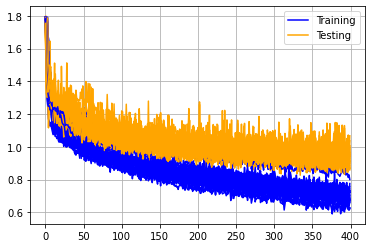

In [45]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [46]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  0.9425905227661133
mean accuracy:  0.618692843914032


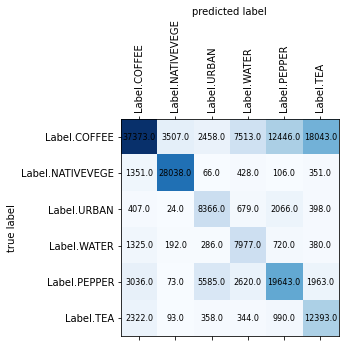

In [47]:
plot_confusion_matrix(conf_matrix, labels)

In [48]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.81575501 0.87819087 0.48869677 0.40780124 0.54607879 0.36963135]
Recalls:  [0.45946644 0.92412657 0.70067002 0.73318015 0.59668894 0.75109091]
F-Score:  [0.58783837 0.90057334 0.57579407 0.52409579 0.57026317 0.49544255]


# NIR, RED, GREEN, SWIR1

In [10]:
BANDS = [
    Band.NIR.value,
    Band.RED.value,
    Band.GREEN.value,
    Band.SWIR1.value
]

In [11]:
# images have all the same shapes, take the shape of the first image
image_width = len(dataset[0][1][0][0])
image_height = len(dataset[0][1][0])
image_depth = len(BANDS)
nb_outputs = len(labels)

# Create model
model = Sequential([
    Rescaling(1./2**16, input_shape=(image_width, image_height, image_depth)),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    Conv2D(filters=8, kernel_size=(3, 3), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    Conv2D(filters=16, kernel_size=(2, 2), padding="same", activation="relu"),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(name='flat'),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(nb_outputs, activation='softmax'),
])
    
mean_loss, mean_accuracy, histories, conf_matrix = cross_validation(model, dataset, BANDS, labels, labels_names, EPOCHS, NB_TESTS)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_2 (Rescaling)      (None, 11, 11, 4)         0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 11, 11, 8)         296       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 11, 11, 8)         584       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 5, 5, 8)           0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 5, 5, 16)          528       
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 5, 5, 16)          1040      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 2, 2, 16)         

Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0073 - accuracy: 0.5478 - val_loss: 1.0881 - val_accuracy: 0.5386
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0029 - accuracy: 0.5383 - val_loss: 1.1283 - val_accuracy: 0.4874
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0491 - accuracy: 0.5131 - val_loss: 1.1019 - val_accuracy: 0.5101
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9943 - accuracy: 0.5338 - val_loss: 1.1649 - val_accuracy: 0.5145
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0706 - accuracy: 0.5254 - val_loss: 1.0932 - val_accuracy: 0.5432
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0406 - accuracy: 0.5084 - val_loss: 1.1192 - val_accuracy: 0.5011
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0171 - accuracy: 0.5244 - val_loss: 1.0950 - val_accuracy: 0.5343
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8251 - accuracy: 0.5877 - val_loss: 1.0043 - val_accuracy: 0.5835
Epoch 161/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8299 - accuracy: 0.6042 - val_loss: 1.0162 - val_accuracy: 0.6039
Epoch 162/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8699 - accuracy: 0.5717 - val_loss: 0.9826 - val_accuracy: 0.6067
Epoch 163/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8443 - accuracy: 0.5702 - val_loss: 0.9959 - val_accuracy: 0.5904
Epoch 164/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8527 - accuracy: 0.5883 - val_loss: 1.0185 - val_accuracy: 0.5768
Epoch 165/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8456 - accuracy: 0.5803 - val_loss: 0.9741 - val_accuracy: 0.6058
Epoch 166/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8160 - accuracy: 0.5980 - val_loss: 0.9925 - val_accuracy: 0.5699
Epoch 167/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7773 - accuracy: 0.6248 - val_loss: 0.9463 - val_accuracy: 0.6070
Epoch 275/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7851 - accuracy: 0.6087 - val_loss: 1.0006 - val_accuracy: 0.6122
Epoch 276/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8191 - accuracy: 0.6110 - val_loss: 0.9570 - val_accuracy: 0.5920
Epoch 277/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7882 - accuracy: 0.5961 - val_loss: 1.0135 - val_accuracy: 0.5715
Epoch 278/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7698 - accuracy: 0.6074 - val_loss: 0.9424 - val_accuracy: 0.6377
Epoch 279/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8503 - accuracy: 0.5931 - val_loss: 0.9447 - val_accuracy: 0.6334
Epoch 280/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7675 - accuracy: 0.6044 - val_loss: 0.9395 - val_accuracy: 0.6059
Epoch 281/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7294 - accuracy: 0.6376 - val_loss: 0.9360 - val_accuracy: 0.6141
Epoch 389/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6998 - accuracy: 0.6353 - val_loss: 0.8952 - val_accuracy: 0.6476
Epoch 390/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7982 - accuracy: 0.6155 - val_loss: 0.9631 - val_accuracy: 0.6141
Epoch 391/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7355 - accuracy: 0.6401 - val_loss: 0.9405 - val_accuracy: 0.6279
Epoch 392/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7715 - accuracy: 0.6092 - val_loss: 0.9717 - val_accuracy: 0.6024
Epoch 393/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7382 - accuracy: 0.6236 - val_loss: 0.8841 - val_accuracy: 0.6510
Epoch 394/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7716 - accuracy: 0.6324 - val_loss: 0.9117 - val_accuracy: 0.6392
Epoch 395/400

Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8375 - accuracy: 0.5486 - val_loss: 1.0621 - val_accuracy: 0.5438
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8356 - accuracy: 0.5445 - val_loss: 1.1710 - val_accuracy: 0.4872
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8804 - accuracy: 0.5610 - val_loss: 0.9992 - val_accuracy: 0.5835
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7911 - accuracy: 0.5673 - val_loss: 0.9987 - val_accuracy: 0.5746
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8463 - accuracy: 0.5445 - val_loss: 0.9891 - val_accuracy: 0.6125
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8394 - accuracy: 0.5859 - val_loss: 0.9728 - val_accuracy: 0.5994
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8560 - accuracy: 0.5709 - val_loss: 1.0098 - val_accuracy: 0.5834

57/57 [==============================] - 1s 9ms/step - loss: 0.7438 - accuracy: 0.5858 - val_loss: 0.9446 - val_accuracy: 0.6161
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6908 - accuracy: 0.6426 - val_loss: 1.0272 - val_accuracy: 0.5875
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7823 - accuracy: 0.5860 - val_loss: 0.9234 - val_accuracy: 0.6282
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7011 - accuracy: 0.6388 - val_loss: 0.9795 - val_accuracy: 0.6186
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7259 - accuracy: 0.6177 - val_loss: 0.9036 - val_accuracy: 0.6482
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7829 - accuracy: 0.6109 - val_loss: 0.9749 - val_accuracy: 0.6019
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7373 - accuracy: 0.6050 - val_loss: 0.9342 - val_accuracy: 0.6330
Epoch 224/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6923 - accuracy: 0.6133 - val_loss: 0.9627 - val_accuracy: 0.6163
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7164 - accuracy: 0.6138 - val_loss: 0.9511 - val_accuracy: 0.6299
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6565 - accuracy: 0.6335 - val_loss: 0.9192 - val_accuracy: 0.6424
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6325 - accuracy: 0.6622 - val_loss: 0.9668 - val_accuracy: 0.6149
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6985 - accuracy: 0.6316 - val_loss: 0.9283 - val_accuracy: 0.6289
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6966 - accuracy: 0.6672 - val_loss: 0.8793 - val_accuracy: 0.6538
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6871 - accuracy: 0.6550 - val_loss: 0.9337 - val_accuracy: 0.6431
Epoch 338/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1358 - accuracy: 0.4399 - val_loss: 1.2097 - val_accuracy: 0.4693
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1336 - accuracy: 0.4522 - val_loss: 1.3579 - val_accuracy: 0.3966
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1377 - accuracy: 0.4785 - val_loss: 1.2083 - val_accuracy: 0.4655
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1296 - accuracy: 0.4438 - val_loss: 1.1367 - val_accuracy: 0.5199
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0536 - accuracy: 0.5021 - val_loss: 1.1582 - val_accuracy: 0.4987
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0874 - accuracy: 0.4696 - val_loss: 1.1206 - val_accuracy: 0.5256
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0735 - accuracy: 0.5000 - val_loss: 1.1288 - val_accuracy: 0.4859
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9733 - accuracy: 0.5668 - val_loss: 1.1286 - val_accuracy: 0.5307
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0156 - accuracy: 0.5811 - val_loss: 1.0765 - val_accuracy: 0.5834
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0399 - accuracy: 0.5902 - val_loss: 1.0682 - val_accuracy: 0.5709
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0071 - accuracy: 0.5700 - val_loss: 1.0801 - val_accuracy: 0.5633
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9642 - accuracy: 0.5711 - val_loss: 1.1217 - val_accuracy: 0.5377
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0044 - accuracy: 0.5858 - val_loss: 1.0530 - val_accuracy: 0.5846
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9463 - accuracy: 0.5826 - val_loss: 1.1302 - val_accuracy: 0.5535

57/57 [==============================] - 1s 9ms/step - loss: 0.9039 - accuracy: 0.5875 - val_loss: 0.9968 - val_accuracy: 0.6113
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8489 - accuracy: 0.5977 - val_loss: 1.0243 - val_accuracy: 0.5831
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8828 - accuracy: 0.6382 - val_loss: 1.0473 - val_accuracy: 0.5820
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8987 - accuracy: 0.5841 - val_loss: 1.0318 - val_accuracy: 0.5883
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8695 - accuracy: 0.6029 - val_loss: 1.0585 - val_accuracy: 0.5849
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9222 - accuracy: 0.5898 - val_loss: 1.0136 - val_accuracy: 0.6130
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8986 - accuracy: 0.5821 - val_loss: 1.0171 - val_accuracy: 0.5934
Epoch 224/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8998 - accuracy: 0.6130 - val_loss: 0.9690 - val_accuracy: 0.6170
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8326 - accuracy: 0.6206 - val_loss: 0.9750 - val_accuracy: 0.6243
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8514 - accuracy: 0.6100 - val_loss: 0.9790 - val_accuracy: 0.6081
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8541 - accuracy: 0.6049 - val_loss: 1.0006 - val_accuracy: 0.6055
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8602 - accuracy: 0.5797 - val_loss: 0.9866 - val_accuracy: 0.6081
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8319 - accuracy: 0.6132 - val_loss: 0.9855 - val_accuracy: 0.6136
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8231 - accuracy: 0.6098 - val_loss: 1.0548 - val_accuracy: 0.5943
Epoch 338/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0433 - accuracy: 0.5062 - val_loss: 1.1862 - val_accuracy: 0.5029
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9690 - accuracy: 0.5489 - val_loss: 1.1174 - val_accuracy: 0.5097
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9457 - accuracy: 0.5533 - val_loss: 1.1166 - val_accuracy: 0.5277
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0095 - accuracy: 0.5376 - val_loss: 1.0726 - val_accuracy: 0.5467
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9931 - accuracy: 0.5170 - val_loss: 1.0731 - val_accuracy: 0.5332
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0385 - accuracy: 0.5303 - val_loss: 1.0617 - val_accuracy: 0.5566
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9625 - accuracy: 0.5570 - val_loss: 1.0929 - val_accuracy: 0.5317
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9576 - accuracy: 0.5734 - val_loss: 1.0814 - val_accuracy: 0.5304
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9024 - accuracy: 0.5959 - val_loss: 1.0010 - val_accuracy: 0.5987
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9525 - accuracy: 0.6027 - val_loss: 1.0178 - val_accuracy: 0.5576
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9949 - accuracy: 0.5501 - val_loss: 0.9929 - val_accuracy: 0.5755
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9165 - accuracy: 0.5888 - val_loss: 0.9899 - val_accuracy: 0.5854
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9713 - accuracy: 0.5912 - val_loss: 1.0142 - val_accuracy: 0.5913
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9102 - accuracy: 0.5849 - val_loss: 1.0017 - val_accuracy: 0.5794

57/57 [==============================] - 1s 9ms/step - loss: 0.7393 - accuracy: 0.6469 - val_loss: 1.0245 - val_accuracy: 0.5660
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7747 - accuracy: 0.5931 - val_loss: 1.0588 - val_accuracy: 0.5429
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8189 - accuracy: 0.5829 - val_loss: 1.0114 - val_accuracy: 0.5606
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7945 - accuracy: 0.6253 - val_loss: 0.9890 - val_accuracy: 0.5805
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7833 - accuracy: 0.6189 - val_loss: 0.9698 - val_accuracy: 0.5909
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8456 - accuracy: 0.5906 - val_loss: 0.9772 - val_accuracy: 0.5864
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8025 - accuracy: 0.6169 - val_loss: 0.9106 - val_accuracy: 0.6287
Epoch 224/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7821 - accuracy: 0.6211 - val_loss: 0.9335 - val_accuracy: 0.6161
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7724 - accuracy: 0.6307 - val_loss: 1.0229 - val_accuracy: 0.5657
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8250 - accuracy: 0.5958 - val_loss: 0.9761 - val_accuracy: 0.5872
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7873 - accuracy: 0.5990 - val_loss: 0.9021 - val_accuracy: 0.6350
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7762 - accuracy: 0.6181 - val_loss: 0.9209 - val_accuracy: 0.6213
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6914 - accuracy: 0.6297 - val_loss: 0.9652 - val_accuracy: 0.5930
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7744 - accuracy: 0.5765 - val_loss: 0.9556 - val_accuracy: 0.6081
Epoch 338/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0286 - accuracy: 0.4587 - val_loss: 1.1688 - val_accuracy: 0.4787
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0365 - accuracy: 0.4625 - val_loss: 1.1275 - val_accuracy: 0.4922
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0630 - accuracy: 0.4649 - val_loss: 1.1240 - val_accuracy: 0.4702
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0381 - accuracy: 0.4558 - val_loss: 1.1604 - val_accuracy: 0.4872
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0240 - accuracy: 0.4778 - val_loss: 1.1116 - val_accuracy: 0.4908
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0493 - accuracy: 0.5125 - val_loss: 1.1154 - val_accuracy: 0.4979
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0086 - accuracy: 0.4835 - val_loss: 1.1484 - val_accuracy: 0.4906
Epoch 52/400
57/57 

Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9565 - accuracy: 0.5768 - val_loss: 1.1028 - val_accuracy: 0.5430
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9349 - accuracy: 0.5649 - val_loss: 1.0559 - val_accuracy: 0.5554
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9824 - accuracy: 0.5413 - val_loss: 1.0642 - val_accuracy: 0.5415
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9798 - accuracy: 0.5387 - val_loss: 1.0150 - val_accuracy: 0.5839
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0004 - accuracy: 0.5430 - val_loss: 1.0415 - val_accuracy: 0.5633
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9733 - accuracy: 0.5271 - val_loss: 1.0415 - val_accuracy: 0.5697
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9818 - accuracy: 0.5389 - val_loss: 1.1337 - val_accuracy: 0.4854

57/57 [==============================] - 1s 9ms/step - loss: 0.8376 - accuracy: 0.5574 - val_loss: 0.9876 - val_accuracy: 0.6099
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8288 - accuracy: 0.5774 - val_loss: 0.9811 - val_accuracy: 0.6058
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8537 - accuracy: 0.5721 - val_loss: 0.9712 - val_accuracy: 0.5932
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8477 - accuracy: 0.5695 - val_loss: 0.9843 - val_accuracy: 0.5906
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8453 - accuracy: 0.5726 - val_loss: 0.9830 - val_accuracy: 0.5997
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8935 - accuracy: 0.5444 - val_loss: 1.0360 - val_accuracy: 0.5243
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8218 - accuracy: 0.5670 - val_loss: 0.9724 - val_accuracy: 0.6094
Epoch 224/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7665 - accuracy: 0.5726 - val_loss: 1.0130 - val_accuracy: 0.5808
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7650 - accuracy: 0.5928 - val_loss: 0.9657 - val_accuracy: 0.5968
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7425 - accuracy: 0.6018 - val_loss: 0.9778 - val_accuracy: 0.5871
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7693 - accuracy: 0.5957 - val_loss: 1.0099 - val_accuracy: 0.5671
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7387 - accuracy: 0.5946 - val_loss: 0.9679 - val_accuracy: 0.6005
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7100 - accuracy: 0.5997 - val_loss: 1.0013 - val_accuracy: 0.5936
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7369 - accuracy: 0.6082 - val_loss: 1.0192 - val_accuracy: 0.5831
Epoch 338/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1019 - accuracy: 0.5352 - val_loss: 1.1480 - val_accuracy: 0.5438
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0923 - accuracy: 0.5035 - val_loss: 1.0916 - val_accuracy: 0.5783
Epoch 42/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0443 - accuracy: 0.5511 - val_loss: 1.1261 - val_accuracy: 0.5239
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0906 - accuracy: 0.5129 - val_loss: 1.1703 - val_accuracy: 0.4739
Epoch 44/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1111 - accuracy: 0.5089 - val_loss: 1.1485 - val_accuracy: 0.5419
Epoch 45/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0258 - accuracy: 0.5384 - val_loss: 1.1247 - val_accuracy: 0.5536
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0379 - accuracy: 0.5044 - val_loss: 1.1057 - val_accuracy: 0.5687
Epoch 47/400
57/57 

Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9775 - accuracy: 0.5248 - val_loss: 1.0992 - val_accuracy: 0.5687
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0635 - accuracy: 0.5184 - val_loss: 1.0082 - val_accuracy: 0.5816
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9654 - accuracy: 0.5706 - val_loss: 1.0911 - val_accuracy: 0.5537
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0092 - accuracy: 0.5369 - val_loss: 1.0102 - val_accuracy: 0.5926
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9475 - accuracy: 0.5529 - val_loss: 1.0252 - val_accuracy: 0.5727
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9234 - accuracy: 0.5438 - val_loss: 1.0680 - val_accuracy: 0.5613
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9239 - accuracy: 0.5797 - val_loss: 1.0356 - val_accuracy: 0.5716
E

57/57 [==============================] - 1s 9ms/step - loss: 0.8289 - accuracy: 0.5658 - val_loss: 0.9823 - val_accuracy: 0.5933
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8481 - accuracy: 0.5999 - val_loss: 0.9644 - val_accuracy: 0.6070
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7777 - accuracy: 0.6082 - val_loss: 0.9497 - val_accuracy: 0.6177
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8463 - accuracy: 0.6023 - val_loss: 0.9873 - val_accuracy: 0.5922
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7763 - accuracy: 0.6159 - val_loss: 0.9599 - val_accuracy: 0.5984
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7784 - accuracy: 0.6166 - val_loss: 0.9588 - val_accuracy: 0.6202
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8160 - accuracy: 0.5954 - val_loss: 0.9681 - val_accuracy: 0.6111
Epoch 219/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7198 - accuracy: 0.6495 - val_loss: 0.9112 - val_accuracy: 0.6359
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7836 - accuracy: 0.6111 - val_loss: 0.9658 - val_accuracy: 0.5996
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7598 - accuracy: 0.6228 - val_loss: 0.9665 - val_accuracy: 0.5908
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7958 - accuracy: 0.6194 - val_loss: 0.9311 - val_accuracy: 0.6304
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8076 - accuracy: 0.6247 - val_loss: 0.9224 - val_accuracy: 0.6327
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7227 - accuracy: 0.6463 - val_loss: 0.9034 - val_accuracy: 0.6391
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7386 - accuracy: 0.6464 - val_loss: 0.9473 - val_accuracy: 0.6283
Epoch 333/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1373 - accuracy: 0.4516 - val_loss: 1.1659 - val_accuracy: 0.5021
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0900 - accuracy: 0.4757 - val_loss: 1.1099 - val_accuracy: 0.5731
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1544 - accuracy: 0.4787 - val_loss: 1.1440 - val_accuracy: 0.4794
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0783 - accuracy: 0.4604 - val_loss: 1.1723 - val_accuracy: 0.4767
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0818 - accuracy: 0.4711 - val_loss: 1.1636 - val_accuracy: 0.4801
Epoch 40/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0883 - accuracy: 0.4575 - val_loss: 1.1045 - val_accuracy: 0.5273
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0665 - accuracy: 0.4757 - val_loss: 1.1189 - val_accuracy: 0.4959
Epoch 42/400
57/57 

Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9798 - accuracy: 0.5550 - val_loss: 1.0017 - val_accuracy: 0.5954
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9824 - accuracy: 0.5517 - val_loss: 1.0096 - val_accuracy: 0.6045
Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9333 - accuracy: 0.5937 - val_loss: 1.0438 - val_accuracy: 0.5653
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8981 - accuracy: 0.5630 - val_loss: 1.0931 - val_accuracy: 0.5400
Epoch 97/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9679 - accuracy: 0.5613 - val_loss: 1.0268 - val_accuracy: 0.5896
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9405 - accuracy: 0.5757 - val_loss: 1.0086 - val_accuracy: 0.5992
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9464 - accuracy: 0.5678 - val_loss: 1.0299 - val_accuracy: 0.5814
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8212 - accuracy: 0.5826 - val_loss: 0.9863 - val_accuracy: 0.5956
Epoch 208/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8854 - accuracy: 0.5798 - val_loss: 0.9746 - val_accuracy: 0.5926
Epoch 209/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8279 - accuracy: 0.5822 - val_loss: 1.0105 - val_accuracy: 0.5713
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8470 - accuracy: 0.5791 - val_loss: 1.0080 - val_accuracy: 0.5755
Epoch 211/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8501 - accuracy: 0.6098 - val_loss: 0.9528 - val_accuracy: 0.6028
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9145 - accuracy: 0.5786 - val_loss: 0.9446 - val_accuracy: 0.6235
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8341 - accuracy: 0.6138 - val_loss: 1.0775 - val_accuracy: 0.5404
Epoch 214/40

57/57 [==============================] - 1s 9ms/step - loss: 0.8029 - accuracy: 0.6096 - val_loss: 0.9908 - val_accuracy: 0.6043
Epoch 322/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7666 - accuracy: 0.6094 - val_loss: 0.9119 - val_accuracy: 0.6462
Epoch 323/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7700 - accuracy: 0.6460 - val_loss: 1.0171 - val_accuracy: 0.5741
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7616 - accuracy: 0.5889 - val_loss: 0.9761 - val_accuracy: 0.6117
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7683 - accuracy: 0.6138 - val_loss: 0.9340 - val_accuracy: 0.6289
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8552 - accuracy: 0.6264 - val_loss: 0.9520 - val_accuracy: 0.6089
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7677 - accuracy: 0.6183 - val_loss: 0.9231 - val_accuracy: 0.6349
Epoch 328/400

57/57 [==============================] - 1s 9ms/step - loss: 0.9908 - accuracy: 0.4855 - val_loss: 1.1136 - val_accuracy: 0.5150
Epoch 31/400
57/57 [==============================] - 1s 10ms/step - loss: 1.1493 - accuracy: 0.4635 - val_loss: 1.1140 - val_accuracy: 0.4887
Epoch 32/400
57/57 [==============================] - 1s 10ms/step - loss: 1.0320 - accuracy: 0.5016 - val_loss: 1.1111 - val_accuracy: 0.5099
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0115 - accuracy: 0.4910 - val_loss: 1.1144 - val_accuracy: 0.5187
Epoch 34/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9826 - accuracy: 0.5001 - val_loss: 1.1677 - val_accuracy: 0.5060
Epoch 35/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0425 - accuracy: 0.5007 - val_loss: 1.1799 - val_accuracy: 0.4814
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9966 - accuracy: 0.5035 - val_loss: 1.1704 - val_accuracy: 0.4896
Epoch 37/400
57/5

Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9534 - accuracy: 0.5102 - val_loss: 1.0923 - val_accuracy: 0.5324
Epoch 89/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9581 - accuracy: 0.5181 - val_loss: 1.0643 - val_accuracy: 0.5407
Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8406 - accuracy: 0.5712 - val_loss: 1.0697 - val_accuracy: 0.5584
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9137 - accuracy: 0.5260 - val_loss: 1.0673 - val_accuracy: 0.5574
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9447 - accuracy: 0.5474 - val_loss: 1.1611 - val_accuracy: 0.4730
Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9179 - accuracy: 0.5454 - val_loss: 1.0804 - val_accuracy: 0.5504
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8734 - accuracy: 0.5681 - val_loss: 1.0592 - val_accuracy: 0.5732
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.7694 - accuracy: 0.6113 - val_loss: 0.9442 - val_accuracy: 0.6077
Epoch 203/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7701 - accuracy: 0.6019 - val_loss: 0.9353 - val_accuracy: 0.6254
Epoch 204/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7981 - accuracy: 0.6009 - val_loss: 0.9921 - val_accuracy: 0.5860
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7465 - accuracy: 0.6271 - val_loss: 1.0217 - val_accuracy: 0.5578
Epoch 206/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7735 - accuracy: 0.6076 - val_loss: 0.9244 - val_accuracy: 0.6261
Epoch 207/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7681 - accuracy: 0.6139 - val_loss: 1.0401 - val_accuracy: 0.5415
Epoch 208/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7938 - accuracy: 0.5882 - val_loss: 0.9608 - val_accuracy: 0.6023
Epoch 209/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7110 - accuracy: 0.6373 - val_loss: 0.9872 - val_accuracy: 0.5868
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7295 - accuracy: 0.6097 - val_loss: 0.9124 - val_accuracy: 0.6262
Epoch 318/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7333 - accuracy: 0.6097 - val_loss: 0.9089 - val_accuracy: 0.6255
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6729 - accuracy: 0.6306 - val_loss: 1.0058 - val_accuracy: 0.5748
Epoch 320/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7089 - accuracy: 0.6066 - val_loss: 0.8921 - val_accuracy: 0.6388
Epoch 321/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6874 - accuracy: 0.6475 - val_loss: 0.9291 - val_accuracy: 0.6123
Epoch 322/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6808 - accuracy: 0.6467 - val_loss: 0.8762 - val_accuracy: 0.6425
Epoch 323/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1556 - accuracy: 0.3872 - val_loss: 1.2769 - val_accuracy: 0.3753
Epoch 26/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1923 - accuracy: 0.3518 - val_loss: 1.2902 - val_accuracy: 0.3607
Epoch 27/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1486 - accuracy: 0.3534 - val_loss: 1.2694 - val_accuracy: 0.3669
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1739 - accuracy: 0.3725 - val_loss: 1.2339 - val_accuracy: 0.4212
Epoch 29/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1966 - accuracy: 0.3870 - val_loss: 1.2341 - val_accuracy: 0.4176
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1309 - accuracy: 0.4240 - val_loss: 1.2668 - val_accuracy: 0.3855
Epoch 31/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1808 - accuracy: 0.4123 - val_loss: 1.1737 - val_accuracy: 0.4378
Epoch 32/400
57/57 

Epoch 83/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0054 - accuracy: 0.5058 - val_loss: 1.1383 - val_accuracy: 0.4942
Epoch 84/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9934 - accuracy: 0.4988 - val_loss: 1.1667 - val_accuracy: 0.5031
Epoch 85/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0080 - accuracy: 0.5241 - val_loss: 1.1300 - val_accuracy: 0.5270
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9396 - accuracy: 0.5254 - val_loss: 1.1307 - val_accuracy: 0.5267
Epoch 87/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9532 - accuracy: 0.5298 - val_loss: 1.1394 - val_accuracy: 0.5025
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9746 - accuracy: 0.5318 - val_loss: 1.0899 - val_accuracy: 0.5245
Epoch 89/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9737 - accuracy: 0.5149 - val_loss: 1.0997 - val_accuracy: 0.5432
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8789 - accuracy: 0.5679 - val_loss: 1.0823 - val_accuracy: 0.5126
Epoch 198/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8449 - accuracy: 0.5506 - val_loss: 1.0285 - val_accuracy: 0.5553
Epoch 199/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8993 - accuracy: 0.5526 - val_loss: 1.0645 - val_accuracy: 0.5432
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8880 - accuracy: 0.5543 - val_loss: 1.0191 - val_accuracy: 0.5623
Epoch 201/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8526 - accuracy: 0.5475 - val_loss: 1.0426 - val_accuracy: 0.5630
Epoch 202/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8722 - accuracy: 0.5525 - val_loss: 1.0413 - val_accuracy: 0.5340
Epoch 203/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8850 - accuracy: 0.5377 - val_loss: 1.0014 - val_accuracy: 0.5752
Epoch 204/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8603 - accuracy: 0.5296 - val_loss: 1.0750 - val_accuracy: 0.5362
Epoch 312/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7826 - accuracy: 0.5853 - val_loss: 1.0073 - val_accuracy: 0.5554
Epoch 313/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8059 - accuracy: 0.5784 - val_loss: 1.0595 - val_accuracy: 0.5752
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8388 - accuracy: 0.5844 - val_loss: 0.9576 - val_accuracy: 0.6168
Epoch 315/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7347 - accuracy: 0.6067 - val_loss: 1.0042 - val_accuracy: 0.5646
Epoch 316/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8103 - accuracy: 0.5950 - val_loss: 0.9937 - val_accuracy: 0.5873
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7474 - accuracy: 0.6007 - val_loss: 1.0536 - val_accuracy: 0.5683
Epoch 318/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0959 - accuracy: 0.4304 - val_loss: 1.2045 - val_accuracy: 0.4087
Epoch 21/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1096 - accuracy: 0.4234 - val_loss: 1.1709 - val_accuracy: 0.4423
Epoch 22/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0914 - accuracy: 0.4498 - val_loss: 1.2342 - val_accuracy: 0.4399
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0770 - accuracy: 0.4638 - val_loss: 1.2353 - val_accuracy: 0.4536
Epoch 24/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1106 - accuracy: 0.4573 - val_loss: 1.1444 - val_accuracy: 0.4997
Epoch 25/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9895 - accuracy: 0.5183 - val_loss: 1.1448 - val_accuracy: 0.4973
Epoch 26/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0741 - accuracy: 0.4857 - val_loss: 1.1756 - val_accuracy: 0.4711
Epoch 27/400
57/57 

Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9918 - accuracy: 0.5720 - val_loss: 1.0529 - val_accuracy: 0.5512
Epoch 79/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9523 - accuracy: 0.5779 - val_loss: 1.0540 - val_accuracy: 0.5606
Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8758 - accuracy: 0.5984 - val_loss: 1.0385 - val_accuracy: 0.5653
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9059 - accuracy: 0.5708 - val_loss: 1.1621 - val_accuracy: 0.5013
Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9000 - accuracy: 0.5541 - val_loss: 1.0721 - val_accuracy: 0.5497
Epoch 83/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8523 - accuracy: 0.5874 - val_loss: 1.0395 - val_accuracy: 0.5713
Epoch 84/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9567 - accuracy: 0.5776 - val_loss: 1.0547 - val_accuracy: 0.5607
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.7255 - accuracy: 0.6196 - val_loss: 0.9714 - val_accuracy: 0.6123
Epoch 193/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7759 - accuracy: 0.6069 - val_loss: 0.9639 - val_accuracy: 0.6160
Epoch 194/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7670 - accuracy: 0.6303 - val_loss: 1.0382 - val_accuracy: 0.5814
Epoch 195/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7607 - accuracy: 0.6265 - val_loss: 0.9855 - val_accuracy: 0.5982
Epoch 196/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7887 - accuracy: 0.6149 - val_loss: 0.9640 - val_accuracy: 0.6049
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7655 - accuracy: 0.6075 - val_loss: 0.9610 - val_accuracy: 0.6027
Epoch 198/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7622 - accuracy: 0.5998 - val_loss: 0.9905 - val_accuracy: 0.6031
Epoch 199/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6734 - accuracy: 0.6483 - val_loss: 0.9790 - val_accuracy: 0.6031
Epoch 307/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6865 - accuracy: 0.6293 - val_loss: 1.1153 - val_accuracy: 0.5646
Epoch 308/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7722 - accuracy: 0.6014 - val_loss: 0.9329 - val_accuracy: 0.6205
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6887 - accuracy: 0.6563 - val_loss: 1.0049 - val_accuracy: 0.5922
Epoch 310/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6964 - accuracy: 0.6386 - val_loss: 1.0040 - val_accuracy: 0.5881
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6957 - accuracy: 0.6356 - val_loss: 0.9994 - val_accuracy: 0.6041
Epoch 312/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7323 - accuracy: 0.6145 - val_loss: 0.9367 - val_accuracy: 0.6125
Epoch 313/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2717 - accuracy: 0.3894 - val_loss: 1.2988 - val_accuracy: 0.3483
Epoch 16/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2648 - accuracy: 0.3765 - val_loss: 1.3642 - val_accuracy: 0.3139
Epoch 17/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2517 - accuracy: 0.3765 - val_loss: 1.2816 - val_accuracy: 0.3588
Epoch 18/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2137 - accuracy: 0.4067 - val_loss: 1.2424 - val_accuracy: 0.3699
Epoch 19/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2222 - accuracy: 0.3865 - val_loss: 1.2596 - val_accuracy: 0.3558
Epoch 20/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2609 - accuracy: 0.3623 - val_loss: 1.2940 - val_accuracy: 0.3518
Epoch 21/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2321 - accuracy: 0.3944 - val_loss: 1.2342 - val_accuracy: 0.3597
Epoch 22/400
57/57 

Epoch 73/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9427 - accuracy: 0.5303 - val_loss: 1.1035 - val_accuracy: 0.5367
Epoch 74/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9564 - accuracy: 0.5411 - val_loss: 1.1326 - val_accuracy: 0.5197
Epoch 75/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0580 - accuracy: 0.4942 - val_loss: 1.1337 - val_accuracy: 0.5291
Epoch 76/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0259 - accuracy: 0.5388 - val_loss: 1.1076 - val_accuracy: 0.5370
Epoch 77/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9975 - accuracy: 0.5474 - val_loss: 1.0679 - val_accuracy: 0.5536
Epoch 78/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9583 - accuracy: 0.5445 - val_loss: 1.1639 - val_accuracy: 0.5379
Epoch 79/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9798 - accuracy: 0.5367 - val_loss: 1.1409 - val_accuracy: 0.5042
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8846 - accuracy: 0.5866 - val_loss: 1.1183 - val_accuracy: 0.5091
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9107 - accuracy: 0.5670 - val_loss: 1.0266 - val_accuracy: 0.5544
Epoch 189/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8485 - accuracy: 0.5761 - val_loss: 1.1267 - val_accuracy: 0.5491
Epoch 190/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9340 - accuracy: 0.5597 - val_loss: 1.0261 - val_accuracy: 0.5673
Epoch 191/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8550 - accuracy: 0.5883 - val_loss: 1.0555 - val_accuracy: 0.5650
Epoch 192/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8365 - accuracy: 0.5861 - val_loss: 1.0178 - val_accuracy: 0.5986
Epoch 193/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8475 - accuracy: 0.5789 - val_loss: 1.1655 - val_accuracy: 0.4978
Epoch 194/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7847 - accuracy: 0.6113 - val_loss: 0.9848 - val_accuracy: 0.6017
Epoch 302/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8077 - accuracy: 0.6006 - val_loss: 1.1156 - val_accuracy: 0.5727
Epoch 303/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7849 - accuracy: 0.6057 - val_loss: 1.0334 - val_accuracy: 0.5687
Epoch 304/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8253 - accuracy: 0.6071 - val_loss: 1.0417 - val_accuracy: 0.5534
Epoch 305/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8091 - accuracy: 0.5898 - val_loss: 1.0214 - val_accuracy: 0.5624
Epoch 306/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7419 - accuracy: 0.6042 - val_loss: 1.0719 - val_accuracy: 0.5794
Epoch 307/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7813 - accuracy: 0.6126 - val_loss: 1.0807 - val_accuracy: 0.5364
Epoch 308/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0595 - accuracy: 0.4973 - val_loss: 1.2064 - val_accuracy: 0.4409
Epoch 11/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1123 - accuracy: 0.4240 - val_loss: 1.1816 - val_accuracy: 0.4685
Epoch 12/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0710 - accuracy: 0.4498 - val_loss: 1.1960 - val_accuracy: 0.4200
Epoch 13/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1033 - accuracy: 0.4502 - val_loss: 1.1392 - val_accuracy: 0.4672
Epoch 14/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0179 - accuracy: 0.4880 - val_loss: 1.1867 - val_accuracy: 0.4832
Epoch 15/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0546 - accuracy: 0.4799 - val_loss: 1.1546 - val_accuracy: 0.4895
Epoch 16/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0020 - accuracy: 0.4843 - val_loss: 1.1915 - val_accuracy: 0.5006
Epoch 17/400
57/57 

Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9138 - accuracy: 0.5741 - val_loss: 1.0541 - val_accuracy: 0.5765
Epoch 69/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8802 - accuracy: 0.5959 - val_loss: 1.0516 - val_accuracy: 0.5881
Epoch 70/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8877 - accuracy: 0.5728 - val_loss: 1.0487 - val_accuracy: 0.5727
Epoch 71/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9862 - accuracy: 0.5893 - val_loss: 1.0283 - val_accuracy: 0.5917
Epoch 72/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9340 - accuracy: 0.5775 - val_loss: 1.0287 - val_accuracy: 0.5873
Epoch 73/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9263 - accuracy: 0.5731 - val_loss: 1.1174 - val_accuracy: 0.5230
Epoch 74/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9948 - accuracy: 0.5345 - val_loss: 1.0726 - val_accuracy: 0.5429
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.7922 - accuracy: 0.6513 - val_loss: 1.0073 - val_accuracy: 0.5819
Epoch 183/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7447 - accuracy: 0.6317 - val_loss: 0.9870 - val_accuracy: 0.5960
Epoch 184/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7931 - accuracy: 0.6185 - val_loss: 1.0351 - val_accuracy: 0.5588
Epoch 185/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8180 - accuracy: 0.6109 - val_loss: 0.9362 - val_accuracy: 0.6301
Epoch 186/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7301 - accuracy: 0.6280 - val_loss: 0.9682 - val_accuracy: 0.6069
Epoch 187/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7558 - accuracy: 0.6466 - val_loss: 0.9617 - val_accuracy: 0.6187
Epoch 188/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7591 - accuracy: 0.6440 - val_loss: 0.9580 - val_accuracy: 0.6130
Epoch 189/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7161 - accuracy: 0.6263 - val_loss: 0.9121 - val_accuracy: 0.6364
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6995 - accuracy: 0.6596 - val_loss: 1.0025 - val_accuracy: 0.6247
Epoch 298/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7768 - accuracy: 0.6535 - val_loss: 0.9647 - val_accuracy: 0.6310
Epoch 299/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7264 - accuracy: 0.6532 - val_loss: 0.9465 - val_accuracy: 0.6214
Epoch 300/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7104 - accuracy: 0.6415 - val_loss: 0.9650 - val_accuracy: 0.6168
Epoch 301/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7150 - accuracy: 0.6350 - val_loss: 0.9542 - val_accuracy: 0.6210
Epoch 302/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6867 - accuracy: 0.6508 - val_loss: 1.0164 - val_accuracy: 0.6013
Epoch 303/400

57/57 [==============================] - 1s 9ms/step - loss: 1.3679 - accuracy: 0.3867 - val_loss: 1.3803 - val_accuracy: 0.4256
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3853 - accuracy: 0.3797 - val_loss: 1.2510 - val_accuracy: 0.5248
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2784 - accuracy: 0.4368 - val_loss: 1.2998 - val_accuracy: 0.3980
Epoch 8/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2647 - accuracy: 0.4014 - val_loss: 1.3747 - val_accuracy: 0.3612
Epoch 9/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3059 - accuracy: 0.3603 - val_loss: 1.3541 - val_accuracy: 0.3476
Epoch 10/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3394 - accuracy: 0.3685 - val_loss: 1.2451 - val_accuracy: 0.3858
Epoch 11/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2664 - accuracy: 0.3899 - val_loss: 1.2960 - val_accuracy: 0.3603
Epoch 12/400
57/57 [===

Epoch 63/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0284 - accuracy: 0.5232 - val_loss: 1.1317 - val_accuracy: 0.5279
Epoch 64/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0687 - accuracy: 0.5147 - val_loss: 1.1121 - val_accuracy: 0.5118
Epoch 65/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9676 - accuracy: 0.5442 - val_loss: 1.0978 - val_accuracy: 0.5377
Epoch 66/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9076 - accuracy: 0.5260 - val_loss: 1.1101 - val_accuracy: 0.5383
Epoch 67/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9938 - accuracy: 0.5054 - val_loss: 1.1879 - val_accuracy: 0.5131
Epoch 68/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0365 - accuracy: 0.5020 - val_loss: 1.0656 - val_accuracy: 0.5524
Epoch 69/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0465 - accuracy: 0.5421 - val_loss: 1.1728 - val_accuracy: 0.5145
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8784 - accuracy: 0.5995 - val_loss: 0.9584 - val_accuracy: 0.6130
Epoch 178/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9401 - accuracy: 0.5977 - val_loss: 1.0045 - val_accuracy: 0.6081
Epoch 179/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8998 - accuracy: 0.5876 - val_loss: 0.9893 - val_accuracy: 0.5800
Epoch 180/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9192 - accuracy: 0.5753 - val_loss: 0.9979 - val_accuracy: 0.5755
Epoch 181/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8713 - accuracy: 0.5785 - val_loss: 0.9351 - val_accuracy: 0.6287
Epoch 182/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8638 - accuracy: 0.5914 - val_loss: 1.1963 - val_accuracy: 0.4782
Epoch 183/400
57/57 [==============================] - 1s 10ms/step - loss: 0.8497 - accuracy: 0.5867 - val_loss: 0.9877 - val_accuracy: 0.6012
Epoch 184/4

57/57 [==============================] - 1s 9ms/step - loss: 0.7789 - accuracy: 0.5903 - val_loss: 0.9334 - val_accuracy: 0.5996
Epoch 292/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7379 - accuracy: 0.6240 - val_loss: 0.9927 - val_accuracy: 0.5721
Epoch 293/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7972 - accuracy: 0.5684 - val_loss: 0.9531 - val_accuracy: 0.6306
Epoch 294/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7924 - accuracy: 0.5710 - val_loss: 1.0559 - val_accuracy: 0.5600
Epoch 295/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7547 - accuracy: 0.5904 - val_loss: 0.9731 - val_accuracy: 0.5820
Epoch 296/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7756 - accuracy: 0.5673 - val_loss: 0.9244 - val_accuracy: 0.6276
Epoch 297/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8267 - accuracy: 0.5774 - val_loss: 0.9877 - val_accuracy: 0.5644
Epoch 298/400


Fold  4 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.7780 - accuracy: 0.1254 - val_loss: 1.7878 - val_accuracy: 0.0911
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7698 - accuracy: 0.1413 - val_loss: 1.7703 - val_accuracy: 0.1043
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7681 - accuracy: 0.1416 - val_loss: 1.6918 - val_accuracy: 0.1370
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7027 - accuracy: 0.2008 - val_loss: 1.6543 - val_accuracy: 0.1758
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6783 - accuracy: 0.1848 - val_loss: 1.6218 - val_accuracy: 0.3181
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6018 - accuracy: 0.2278 - val_loss: 1.5631 - val_accuracy: 0.2417
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5089 - accuracy: 0.2580 - val_loss: 1.5090 - val_accuracy

Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9379 - accuracy: 0.5677 - val_loss: 1.0283 - val_accuracy: 0.5755
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9291 - accuracy: 0.5530 - val_loss: 1.0640 - val_accuracy: 0.5323
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0113 - accuracy: 0.5570 - val_loss: 1.0101 - val_accuracy: 0.5886
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9046 - accuracy: 0.5831 - val_loss: 1.0435 - val_accuracy: 0.5766
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9608 - accuracy: 0.5414 - val_loss: 1.0716 - val_accuracy: 0.5612
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8927 - accuracy: 0.5598 - val_loss: 1.0487 - val_accuracy: 0.5660
Epoch 122/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9664 - accuracy: 0.5378 - val_loss: 1.1005 - val_accuracy: 0.5392

57/57 [==============================] - 1s 9ms/step - loss: 0.8693 - accuracy: 0.5835 - val_loss: 0.9923 - val_accuracy: 0.5918
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8426 - accuracy: 0.5801 - val_loss: 0.9962 - val_accuracy: 0.6030
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8262 - accuracy: 0.6018 - val_loss: 0.9228 - val_accuracy: 0.6365
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7791 - accuracy: 0.6235 - val_loss: 0.9586 - val_accuracy: 0.6136
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7879 - accuracy: 0.5965 - val_loss: 0.9102 - val_accuracy: 0.6338
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8601 - accuracy: 0.6238 - val_loss: 0.9304 - val_accuracy: 0.6224
Epoch 236/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7798 - accuracy: 0.6226 - val_loss: 0.9655 - val_accuracy: 0.6118
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7808 - accuracy: 0.6322 - val_loss: 0.9709 - val_accuracy: 0.5906
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8045 - accuracy: 0.5952 - val_loss: 0.8790 - val_accuracy: 0.6422
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7670 - accuracy: 0.6184 - val_loss: 0.9355 - val_accuracy: 0.6087
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7631 - accuracy: 0.6105 - val_loss: 0.9214 - val_accuracy: 0.6258
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7479 - accuracy: 0.6359 - val_loss: 0.9013 - val_accuracy: 0.6376
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7379 - accuracy: 0.6352 - val_loss: 0.9142 - val_accuracy: 0.6292
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7407 - accuracy: 0.6253 - val_loss: 1.0234 - val_accuracy: 0.5759
Epoch 351/400


Fold  5 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.7691 - accuracy: 0.1447 - val_loss: 1.7900 - val_accuracy: 0.0893
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7810 - accuracy: 0.1478 - val_loss: 1.7797 - val_accuracy: 0.2543
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7387 - accuracy: 0.1780 - val_loss: 1.6920 - val_accuracy: 0.1256
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6301 - accuracy: 0.2343 - val_loss: 1.5987 - val_accuracy: 0.2093
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5338 - accuracy: 0.2273 - val_loss: 1.4631 - val_accuracy: 0.2750
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4904 - accuracy: 0.2846 - val_loss: 1.5561 - val_accuracy: 0.2989
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4192 - accuracy: 0.3300 - val_loss: 1.3532 - val_accuracy

Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8588 - accuracy: 0.5720 - val_loss: 0.9706 - val_accuracy: 0.5902
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8454 - accuracy: 0.5873 - val_loss: 0.9308 - val_accuracy: 0.6254
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8094 - accuracy: 0.6045 - val_loss: 0.9396 - val_accuracy: 0.6098
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8403 - accuracy: 0.5961 - val_loss: 1.0222 - val_accuracy: 0.5582
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9071 - accuracy: 0.5608 - val_loss: 1.0134 - val_accuracy: 0.5858
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8316 - accuracy: 0.5802 - val_loss: 0.9737 - val_accuracy: 0.5987
Epoch 122/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8389 - accuracy: 0.5754 - val_loss: 0.9535 - val_accuracy: 0.6032

57/57 [==============================] - 1s 9ms/step - loss: 0.7151 - accuracy: 0.6242 - val_loss: 1.0145 - val_accuracy: 0.5818
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8191 - accuracy: 0.5768 - val_loss: 0.9147 - val_accuracy: 0.6410
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7074 - accuracy: 0.6409 - val_loss: 1.0159 - val_accuracy: 0.5862
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7354 - accuracy: 0.6292 - val_loss: 0.9146 - val_accuracy: 0.6303
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7407 - accuracy: 0.6259 - val_loss: 0.9689 - val_accuracy: 0.6016
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7568 - accuracy: 0.6278 - val_loss: 0.9289 - val_accuracy: 0.6114
Epoch 236/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7043 - accuracy: 0.6408 - val_loss: 0.9300 - val_accuracy: 0.6300
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6912 - accuracy: 0.6146 - val_loss: 0.8507 - val_accuracy: 0.6651
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6990 - accuracy: 0.6472 - val_loss: 0.8766 - val_accuracy: 0.6494
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6448 - accuracy: 0.6429 - val_loss: 0.9940 - val_accuracy: 0.5939
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6698 - accuracy: 0.6344 - val_loss: 0.9206 - val_accuracy: 0.6299
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7162 - accuracy: 0.6166 - val_loss: 0.8878 - val_accuracy: 0.6560
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6740 - accuracy: 0.6322 - val_loss: 0.9282 - val_accuracy: 0.6273
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6779 - accuracy: 0.6500 - val_loss: 0.9228 - val_accuracy: 0.6272
Epoch 351/400


Fold  1 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.8043 - accuracy: 0.1261 - val_loss: 1.7528 - val_accuracy: 0.2962
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.6754 - accuracy: 0.2707 - val_loss: 1.3839 - val_accuracy: 0.4640
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4402 - accuracy: 0.3327 - val_loss: 1.3586 - val_accuracy: 0.4330
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3567 - accuracy: 0.3834 - val_loss: 1.3791 - val_accuracy: 0.3154
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3705 - accuracy: 0.3373 - val_loss: 1.4163 - val_accuracy: 0.3515
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2713 - accuracy: 0.4032 - val_loss: 1.4032 - val_accuracy: 0.2985
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2618 - accuracy: 0.3382 - val_loss: 1.3457 - val_accuracy

Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0267 - accuracy: 0.5255 - val_loss: 1.0708 - val_accuracy: 0.5488
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0672 - accuracy: 0.5254 - val_loss: 1.0632 - val_accuracy: 0.5852
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0553 - accuracy: 0.5315 - val_loss: 1.1229 - val_accuracy: 0.5393
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9860 - accuracy: 0.5270 - val_loss: 1.0166 - val_accuracy: 0.6105
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0061 - accuracy: 0.5381 - val_loss: 1.0422 - val_accuracy: 0.6001
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9666 - accuracy: 0.5505 - val_loss: 1.0697 - val_accuracy: 0.5450
Epoch 122/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9936 - accuracy: 0.5016 - val_loss: 1.0236 - val_accuracy: 0.5897

57/57 [==============================] - 1s 9ms/step - loss: 0.9139 - accuracy: 0.5544 - val_loss: 1.0650 - val_accuracy: 0.5273
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8956 - accuracy: 0.5645 - val_loss: 1.0271 - val_accuracy: 0.5666
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8827 - accuracy: 0.5786 - val_loss: 0.9658 - val_accuracy: 0.6032
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9262 - accuracy: 0.5774 - val_loss: 0.9804 - val_accuracy: 0.5983
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8579 - accuracy: 0.5658 - val_loss: 1.0398 - val_accuracy: 0.5576
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9294 - accuracy: 0.5608 - val_loss: 0.9618 - val_accuracy: 0.6030
Epoch 236/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8782 - accuracy: 0.5806 - val_loss: 0.9482 - val_accuracy: 0.6123
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8511 - accuracy: 0.5998 - val_loss: 0.9797 - val_accuracy: 0.6047
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8615 - accuracy: 0.5492 - val_loss: 0.9578 - val_accuracy: 0.6035
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8163 - accuracy: 0.6168 - val_loss: 1.0357 - val_accuracy: 0.5673
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8088 - accuracy: 0.5812 - val_loss: 0.9032 - val_accuracy: 0.6440
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7834 - accuracy: 0.5863 - val_loss: 0.9685 - val_accuracy: 0.6111
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8078 - accuracy: 0.5918 - val_loss: 0.9413 - val_accuracy: 0.6172
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7344 - accuracy: 0.6390 - val_loss: 0.9875 - val_accuracy: 0.5960
Epoch 351/400


Fold  2 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.8038 - accuracy: 0.1019 - val_loss: 1.7920 - val_accuracy: 0.1147
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7862 - accuracy: 0.1251 - val_loss: 1.7051 - val_accuracy: 0.1265
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5844 - accuracy: 0.1757 - val_loss: 1.4755 - val_accuracy: 0.3474
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.5182 - accuracy: 0.2881 - val_loss: 1.4351 - val_accuracy: 0.3636
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.4238 - accuracy: 0.3662 - val_loss: 1.4300 - val_accuracy: 0.3911
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3548 - accuracy: 0.4000 - val_loss: 1.4164 - val_accuracy: 0.3599
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3038 - accuracy: 0.4129 - val_loss: 1.4057 - val_accuracy

Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8999 - accuracy: 0.6153 - val_loss: 1.0455 - val_accuracy: 0.5669
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8749 - accuracy: 0.5906 - val_loss: 0.9950 - val_accuracy: 0.5959
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9091 - accuracy: 0.5934 - val_loss: 1.0458 - val_accuracy: 0.5596
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8705 - accuracy: 0.5805 - val_loss: 1.0219 - val_accuracy: 0.5949
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9141 - accuracy: 0.5729 - val_loss: 0.9700 - val_accuracy: 0.6089
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8720 - accuracy: 0.5949 - val_loss: 1.0528 - val_accuracy: 0.5493
Epoch 122/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8640 - accuracy: 0.5805 - val_loss: 1.0498 - val_accuracy: 0.5917

57/57 [==============================] - 1s 9ms/step - loss: 0.7941 - accuracy: 0.6313 - val_loss: 0.9444 - val_accuracy: 0.6204
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7901 - accuracy: 0.6340 - val_loss: 0.9663 - val_accuracy: 0.6049
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7758 - accuracy: 0.5935 - val_loss: 0.9553 - val_accuracy: 0.6114
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7536 - accuracy: 0.6425 - val_loss: 0.9283 - val_accuracy: 0.6141
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7907 - accuracy: 0.6238 - val_loss: 0.9336 - val_accuracy: 0.6096
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7821 - accuracy: 0.6330 - val_loss: 0.9201 - val_accuracy: 0.6118
Epoch 236/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8350 - accuracy: 0.6142 - val_loss: 0.9130 - val_accuracy: 0.6348
Epoch 237/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7695 - accuracy: 0.6132 - val_loss: 0.9339 - val_accuracy: 0.6096
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7978 - accuracy: 0.6214 - val_loss: 0.8745 - val_accuracy: 0.6488
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7524 - accuracy: 0.6234 - val_loss: 0.9179 - val_accuracy: 0.6291
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7312 - accuracy: 0.6625 - val_loss: 0.9169 - val_accuracy: 0.6274
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7793 - accuracy: 0.6425 - val_loss: 0.8950 - val_accuracy: 0.6497
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7577 - accuracy: 0.6439 - val_loss: 0.9341 - val_accuracy: 0.6227
Epoch 350/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7807 - accuracy: 0.6094 - val_loss: 0.8914 - val_accuracy: 0.6383
Epoch 351/400


Fold  3 :
--------

Epoch 1/400
57/57 [==============================] - 1s 11ms/step - loss: 1.7565 - accuracy: 0.1666 - val_loss: 1.7869 - val_accuracy: 0.0877
Epoch 2/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7583 - accuracy: 0.1791 - val_loss: 1.7416 - val_accuracy: 0.1651
Epoch 3/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7118 - accuracy: 0.2143 - val_loss: 1.4375 - val_accuracy: 0.4536
Epoch 4/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3912 - accuracy: 0.3496 - val_loss: 1.4311 - val_accuracy: 0.3474
Epoch 5/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3986 - accuracy: 0.3639 - val_loss: 1.3310 - val_accuracy: 0.4241
Epoch 6/400
57/57 [==============================] - 1s 9ms/step - loss: 1.3650 - accuracy: 0.4090 - val_loss: 1.3230 - val_accuracy: 0.3703
Epoch 7/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2941 - accuracy: 0.3657 - val_loss: 1.3536 - val_accuracy

57/57 [==============================] - 1s 9ms/step - loss: 0.9238 - accuracy: 0.5780 - val_loss: 1.0466 - val_accuracy: 0.5657
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9044 - accuracy: 0.5656 - val_loss: 1.0297 - val_accuracy: 0.5623
Epoch 117/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8744 - accuracy: 0.5534 - val_loss: 1.1458 - val_accuracy: 0.5241
Epoch 118/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9254 - accuracy: 0.5568 - val_loss: 1.0698 - val_accuracy: 0.5300
Epoch 119/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8959 - accuracy: 0.5660 - val_loss: 1.0840 - val_accuracy: 0.5376
Epoch 120/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9230 - accuracy: 0.5611 - val_loss: 1.0728 - val_accuracy: 0.5347
Epoch 121/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8416 - accuracy: 0.5856 - val_loss: 1.0509 - val_accuracy: 0.5646
Epoch 122/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8903 - accuracy: 0.5805 - val_loss: 0.9673 - val_accuracy: 0.6144
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7682 - accuracy: 0.6160 - val_loss: 0.9759 - val_accuracy: 0.6027
Epoch 231/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8684 - accuracy: 0.5676 - val_loss: 0.9500 - val_accuracy: 0.6231
Epoch 232/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7958 - accuracy: 0.6177 - val_loss: 0.9824 - val_accuracy: 0.5911
Epoch 233/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7843 - accuracy: 0.6136 - val_loss: 1.0217 - val_accuracy: 0.5875
Epoch 234/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7796 - accuracy: 0.5956 - val_loss: 0.9939 - val_accuracy: 0.5898
Epoch 235/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7833 - accuracy: 0.6022 - val_loss: 0.9833 - val_accuracy: 0.5886
Epoch 236/400

57/57 [==============================] - 1s 9ms/step - loss: 0.6655 - accuracy: 0.6274 - val_loss: 0.9769 - val_accuracy: 0.6001
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6705 - accuracy: 0.6443 - val_loss: 0.9561 - val_accuracy: 0.6133
Epoch 345/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7162 - accuracy: 0.6246 - val_loss: 0.9949 - val_accuracy: 0.6117
Epoch 346/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7340 - accuracy: 0.6197 - val_loss: 0.9968 - val_accuracy: 0.5930
Epoch 347/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7791 - accuracy: 0.6119 - val_loss: 1.0008 - val_accuracy: 0.5933
Epoch 348/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6746 - accuracy: 0.6376 - val_loss: 0.9645 - val_accuracy: 0.6099
Epoch 349/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7070 - accuracy: 0.6407 - val_loss: 0.9781 - val_accuracy: 0.6036
Epoch 350/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1037 - accuracy: 0.4351 - val_loss: 1.1432 - val_accuracy: 0.4710
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0110 - accuracy: 0.4678 - val_loss: 1.1635 - val_accuracy: 0.4827
Epoch 54/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0349 - accuracy: 0.4765 - val_loss: 1.1195 - val_accuracy: 0.5024
Epoch 55/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0084 - accuracy: 0.5051 - val_loss: 1.1305 - val_accuracy: 0.4942
Epoch 56/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9894 - accuracy: 0.5072 - val_loss: 1.0600 - val_accuracy: 0.5487
Epoch 57/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0247 - accuracy: 0.5138 - val_loss: 1.0696 - val_accuracy: 0.5365
Epoch 58/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0068 - accuracy: 0.5009 - val_loss: 1.0901 - val_accuracy: 0.5256
Epoch 59/400
57/57 

Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8585 - accuracy: 0.6060 - val_loss: 1.0920 - val_accuracy: 0.5184
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8913 - accuracy: 0.5268 - val_loss: 1.0477 - val_accuracy: 0.5414
Epoch 112/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8303 - accuracy: 0.5514 - val_loss: 1.0792 - val_accuracy: 0.5398
Epoch 113/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8671 - accuracy: 0.5579 - val_loss: 1.0482 - val_accuracy: 0.5612
Epoch 114/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9395 - accuracy: 0.5190 - val_loss: 1.0755 - val_accuracy: 0.5243
Epoch 115/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9035 - accuracy: 0.5444 - val_loss: 0.9746 - val_accuracy: 0.5944
Epoch 116/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9014 - accuracy: 0.5651 - val_loss: 1.0695 - val_accuracy: 0.5373

57/57 [==============================] - 1s 9ms/step - loss: 0.7678 - accuracy: 0.5928 - val_loss: 0.9751 - val_accuracy: 0.5932
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7793 - accuracy: 0.5909 - val_loss: 1.0685 - val_accuracy: 0.5714
Epoch 226/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8392 - accuracy: 0.6085 - val_loss: 0.9690 - val_accuracy: 0.6065
Epoch 227/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7938 - accuracy: 0.5964 - val_loss: 1.0926 - val_accuracy: 0.5270
Epoch 228/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7653 - accuracy: 0.5793 - val_loss: 0.9523 - val_accuracy: 0.5921
Epoch 229/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7876 - accuracy: 0.5912 - val_loss: 0.9687 - val_accuracy: 0.5862
Epoch 230/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7476 - accuracy: 0.6175 - val_loss: 0.9903 - val_accuracy: 0.5918
Epoch 231/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7161 - accuracy: 0.6154 - val_loss: 0.9007 - val_accuracy: 0.6345
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7114 - accuracy: 0.6460 - val_loss: 0.9353 - val_accuracy: 0.6118
Epoch 340/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6799 - accuracy: 0.6312 - val_loss: 0.9537 - val_accuracy: 0.6031
Epoch 341/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7641 - accuracy: 0.6051 - val_loss: 0.9288 - val_accuracy: 0.6209
Epoch 342/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7172 - accuracy: 0.6309 - val_loss: 0.9603 - val_accuracy: 0.6019
Epoch 343/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7109 - accuracy: 0.6184 - val_loss: 0.9497 - val_accuracy: 0.6074
Epoch 344/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7934 - accuracy: 0.5729 - val_loss: 0.9524 - val_accuracy: 0.6038
Epoch 345/400

57/57 [==============================] - 1s 9ms/step - loss: 0.9535 - accuracy: 0.4976 - val_loss: 1.1992 - val_accuracy: 0.4696
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0108 - accuracy: 0.4819 - val_loss: 1.1840 - val_accuracy: 0.5065
Epoch 49/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9690 - accuracy: 0.4989 - val_loss: 1.2010 - val_accuracy: 0.5050
Epoch 50/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0446 - accuracy: 0.4804 - val_loss: 1.1266 - val_accuracy: 0.4915
Epoch 51/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0078 - accuracy: 0.4998 - val_loss: 1.1396 - val_accuracy: 0.5229
Epoch 52/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9720 - accuracy: 0.5204 - val_loss: 1.1166 - val_accuracy: 0.5282
Epoch 53/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9967 - accuracy: 0.5082 - val_loss: 1.1126 - val_accuracy: 0.5309
Epoch 54/400
57/57 

Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9127 - accuracy: 0.5409 - val_loss: 1.1350 - val_accuracy: 0.5035
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9932 - accuracy: 0.5206 - val_loss: 1.0703 - val_accuracy: 0.5781
Epoch 107/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9329 - accuracy: 0.5602 - val_loss: 1.0810 - val_accuracy: 0.5298
Epoch 108/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9363 - accuracy: 0.5514 - val_loss: 1.0496 - val_accuracy: 0.5793
Epoch 109/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9260 - accuracy: 0.5489 - val_loss: 1.1183 - val_accuracy: 0.5251
Epoch 110/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8640 - accuracy: 0.5519 - val_loss: 1.0418 - val_accuracy: 0.5622
Epoch 111/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8815 - accuracy: 0.5449 - val_loss: 1.1516 - val_accuracy: 0.4948

57/57 [==============================] - 1s 9ms/step - loss: 0.7745 - accuracy: 0.6280 - val_loss: 1.0792 - val_accuracy: 0.5317
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8057 - accuracy: 0.5969 - val_loss: 1.2072 - val_accuracy: 0.4570
Epoch 221/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8611 - accuracy: 0.5366 - val_loss: 1.0426 - val_accuracy: 0.5543
Epoch 222/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8173 - accuracy: 0.5713 - val_loss: 1.0383 - val_accuracy: 0.5932
Epoch 223/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8190 - accuracy: 0.5890 - val_loss: 1.0480 - val_accuracy: 0.5633
Epoch 224/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7888 - accuracy: 0.6064 - val_loss: 1.0313 - val_accuracy: 0.5872
Epoch 225/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8114 - accuracy: 0.5903 - val_loss: 1.0735 - val_accuracy: 0.5948
Epoch 226/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7504 - accuracy: 0.5910 - val_loss: 0.9968 - val_accuracy: 0.6102
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7407 - accuracy: 0.6003 - val_loss: 0.9691 - val_accuracy: 0.6187
Epoch 335/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7050 - accuracy: 0.6375 - val_loss: 0.9679 - val_accuracy: 0.6133
Epoch 336/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7144 - accuracy: 0.6189 - val_loss: 1.0813 - val_accuracy: 0.5561
Epoch 337/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7115 - accuracy: 0.6167 - val_loss: 1.0041 - val_accuracy: 0.6004
Epoch 338/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7467 - accuracy: 0.6177 - val_loss: 1.0469 - val_accuracy: 0.5626
Epoch 339/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7502 - accuracy: 0.5927 - val_loss: 0.9983 - val_accuracy: 0.5960
Epoch 340/400

57/57 [==============================] - 1s 9ms/step - loss: 1.0600 - accuracy: 0.4887 - val_loss: 1.0896 - val_accuracy: 0.5272
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9501 - accuracy: 0.5067 - val_loss: 1.1000 - val_accuracy: 0.5362
Epoch 44/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9467 - accuracy: 0.5206 - val_loss: 1.0628 - val_accuracy: 0.5590
Epoch 45/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9640 - accuracy: 0.5171 - val_loss: 1.0630 - val_accuracy: 0.5426
Epoch 46/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9507 - accuracy: 0.5245 - val_loss: 1.1162 - val_accuracy: 0.5152
Epoch 47/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9896 - accuracy: 0.5126 - val_loss: 1.0735 - val_accuracy: 0.5447
Epoch 48/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9272 - accuracy: 0.5374 - val_loss: 1.0279 - val_accuracy: 0.5764
Epoch 49/400
57/57 

Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9560 - accuracy: 0.5489 - val_loss: 0.9997 - val_accuracy: 0.5905
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8874 - accuracy: 0.5600 - val_loss: 1.0808 - val_accuracy: 0.5198
Epoch 102/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8693 - accuracy: 0.5704 - val_loss: 0.9866 - val_accuracy: 0.6007
Epoch 103/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9095 - accuracy: 0.5655 - val_loss: 1.0284 - val_accuracy: 0.5642
Epoch 104/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8871 - accuracy: 0.5467 - val_loss: 1.0411 - val_accuracy: 0.5575
Epoch 105/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8709 - accuracy: 0.5821 - val_loss: 1.0456 - val_accuracy: 0.5440
Epoch 106/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8555 - accuracy: 0.5612 - val_loss: 1.0642 - val_accuracy: 0.5518

57/57 [==============================] - 1s 9ms/step - loss: 0.7811 - accuracy: 0.6054 - val_loss: 0.9637 - val_accuracy: 0.6257
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7777 - accuracy: 0.6058 - val_loss: 1.0540 - val_accuracy: 0.5580
Epoch 216/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7769 - accuracy: 0.5871 - val_loss: 1.0102 - val_accuracy: 0.5958
Epoch 217/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8076 - accuracy: 0.5927 - val_loss: 0.9529 - val_accuracy: 0.6217
Epoch 218/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7692 - accuracy: 0.6184 - val_loss: 1.0440 - val_accuracy: 0.5750
Epoch 219/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7674 - accuracy: 0.6121 - val_loss: 0.9767 - val_accuracy: 0.6141
Epoch 220/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7886 - accuracy: 0.6086 - val_loss: 1.0334 - val_accuracy: 0.5741
Epoch 221/400

57/57 [==============================] - 1s 9ms/step - loss: 0.7436 - accuracy: 0.6185 - val_loss: 0.9031 - val_accuracy: 0.6437
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6757 - accuracy: 0.6617 - val_loss: 0.9382 - val_accuracy: 0.6279
Epoch 330/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7179 - accuracy: 0.6499 - val_loss: 0.9371 - val_accuracy: 0.6344
Epoch 331/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7134 - accuracy: 0.6529 - val_loss: 0.9377 - val_accuracy: 0.6381
Epoch 332/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7090 - accuracy: 0.6316 - val_loss: 0.9219 - val_accuracy: 0.6479
Epoch 333/400
57/57 [==============================] - 1s 9ms/step - loss: 0.6841 - accuracy: 0.6394 - val_loss: 0.9631 - val_accuracy: 0.6236
Epoch 334/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7073 - accuracy: 0.6308 - val_loss: 0.9430 - val_accuracy: 0.6219
Epoch 335/400

57/57 [==============================] - 1s 9ms/step - loss: 1.7730 - accuracy: 0.1930 - val_loss: 1.7911 - val_accuracy: 0.1665
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8093 - accuracy: 0.1582 - val_loss: 1.7911 - val_accuracy: 0.1665
Epoch 39/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7979 - accuracy: 0.1405 - val_loss: 1.7926 - val_accuracy: 0.1665
Epoch 40/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7745 - accuracy: 0.1426 - val_loss: 1.7918 - val_accuracy: 0.1665
Epoch 41/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8075 - accuracy: 0.1544 - val_loss: 1.7927 - val_accuracy: 0.1665
Epoch 42/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8592 - accuracy: 0.1141 - val_loss: 1.7922 - val_accuracy: 0.0897
Epoch 43/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7686 - accuracy: 0.1465 - val_loss: 1.7909 - val_accuracy: 0.1665
Epoch 44/400
57/57 

Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7971 - accuracy: 0.0767 - val_loss: 1.7916 - val_accuracy: 0.0570
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8124 - accuracy: 0.0691 - val_loss: 1.7923 - val_accuracy: 0.0570
Epoch 97/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8182 - accuracy: 0.0657 - val_loss: 1.7922 - val_accuracy: 0.0570
Epoch 98/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7531 - accuracy: 0.1820 - val_loss: 1.7920 - val_accuracy: 0.0570
Epoch 99/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7628 - accuracy: 0.1016 - val_loss: 1.7910 - val_accuracy: 0.4427
Epoch 100/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8076 - accuracy: 0.2938 - val_loss: 1.7911 - val_accuracy: 0.4427
Epoch 101/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8054 - accuracy: 0.2073 - val_loss: 1.7925 - val_accuracy: 0.0570
Epoc

57/57 [==============================] - 1s 9ms/step - loss: 1.7743 - accuracy: 0.1243 - val_loss: 1.7916 - val_accuracy: 0.0897
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8183 - accuracy: 0.1275 - val_loss: 1.7918 - val_accuracy: 0.1665
Epoch 211/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7658 - accuracy: 0.2431 - val_loss: 1.7907 - val_accuracy: 0.1777
Epoch 212/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8081 - accuracy: 0.1255 - val_loss: 1.7910 - val_accuracy: 0.1777
Epoch 213/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8132 - accuracy: 0.1340 - val_loss: 1.7916 - val_accuracy: 0.0897
Epoch 214/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8119 - accuracy: 0.1099 - val_loss: 1.7925 - val_accuracy: 0.1665
Epoch 215/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7606 - accuracy: 0.1654 - val_loss: 1.7919 - val_accuracy: 0.0897
Epoch 216/400

57/57 [==============================] - 1s 9ms/step - loss: 1.8431 - accuracy: 0.1105 - val_loss: 1.7921 - val_accuracy: 0.1665
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8514 - accuracy: 0.0750 - val_loss: 1.7921 - val_accuracy: 0.0570
Epoch 325/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7849 - accuracy: 0.1404 - val_loss: 1.7921 - val_accuracy: 0.1665
Epoch 326/400
57/57 [==============================] - 1s 9ms/step - loss: 1.7686 - accuracy: 0.1372 - val_loss: 1.7924 - val_accuracy: 0.1665
Epoch 327/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8202 - accuracy: 0.1393 - val_loss: 1.7930 - val_accuracy: 0.0897
Epoch 328/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8154 - accuracy: 0.1068 - val_loss: 1.7927 - val_accuracy: 0.1665
Epoch 329/400
57/57 [==============================] - 1s 9ms/step - loss: 1.8010 - accuracy: 0.1307 - val_loss: 1.7924 - val_accuracy: 0.0897
Epoch 330/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1049 - accuracy: 0.4767 - val_loss: 1.1497 - val_accuracy: 0.4873
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0175 - accuracy: 0.5025 - val_loss: 1.1206 - val_accuracy: 0.5123
Epoch 34/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0508 - accuracy: 0.4736 - val_loss: 1.0984 - val_accuracy: 0.5292
Epoch 35/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0742 - accuracy: 0.5090 - val_loss: 1.2187 - val_accuracy: 0.4558
Epoch 36/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0970 - accuracy: 0.5004 - val_loss: 1.2044 - val_accuracy: 0.4681
Epoch 37/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0105 - accuracy: 0.4806 - val_loss: 1.1472 - val_accuracy: 0.4948
Epoch 38/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0553 - accuracy: 0.4667 - val_loss: 1.2622 - val_accuracy: 0.4534
Epoch 39/400
57/57 

Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0018 - accuracy: 0.5444 - val_loss: 1.2025 - val_accuracy: 0.4957
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9363 - accuracy: 0.5432 - val_loss: 1.1083 - val_accuracy: 0.5343
Epoch 92/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9189 - accuracy: 0.5641 - val_loss: 1.0837 - val_accuracy: 0.5467
Epoch 93/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9649 - accuracy: 0.5370 - val_loss: 1.1609 - val_accuracy: 0.4620
Epoch 94/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0119 - accuracy: 0.5387 - val_loss: 1.2153 - val_accuracy: 0.4668
Epoch 95/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9167 - accuracy: 0.5175 - val_loss: 1.0676 - val_accuracy: 0.5547
Epoch 96/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9186 - accuracy: 0.5542 - val_loss: 1.0965 - val_accuracy: 0.5395
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8822 - accuracy: 0.5800 - val_loss: 1.0487 - val_accuracy: 0.5584
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9049 - accuracy: 0.5672 - val_loss: 1.0875 - val_accuracy: 0.5387
Epoch 206/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8726 - accuracy: 0.5731 - val_loss: 1.0150 - val_accuracy: 0.5959
Epoch 207/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8776 - accuracy: 0.5916 - val_loss: 1.0629 - val_accuracy: 0.5812
Epoch 208/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8378 - accuracy: 0.5870 - val_loss: 1.0424 - val_accuracy: 0.5722
Epoch 209/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8402 - accuracy: 0.5972 - val_loss: 1.1306 - val_accuracy: 0.5014
Epoch 210/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9632 - accuracy: 0.5465 - val_loss: 1.0563 - val_accuracy: 0.5831
Epoch 211/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8093 - accuracy: 0.6016 - val_loss: 1.0268 - val_accuracy: 0.6061
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7615 - accuracy: 0.6315 - val_loss: 1.0264 - val_accuracy: 0.5785
Epoch 320/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8090 - accuracy: 0.5959 - val_loss: 1.2009 - val_accuracy: 0.5135
Epoch 321/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7908 - accuracy: 0.6040 - val_loss: 1.0703 - val_accuracy: 0.5797
Epoch 322/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7731 - accuracy: 0.6100 - val_loss: 1.0237 - val_accuracy: 0.5828
Epoch 323/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7923 - accuracy: 0.5944 - val_loss: 0.9992 - val_accuracy: 0.5925
Epoch 324/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7921 - accuracy: 0.6322 - val_loss: 1.0458 - val_accuracy: 0.5841
Epoch 325/400

57/57 [==============================] - 1s 9ms/step - loss: 1.1789 - accuracy: 0.3902 - val_loss: 1.3753 - val_accuracy: 0.2959
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2885 - accuracy: 0.3537 - val_loss: 1.2414 - val_accuracy: 0.3575
Epoch 29/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1967 - accuracy: 0.3863 - val_loss: 1.2623 - val_accuracy: 0.3439
Epoch 30/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2251 - accuracy: 0.3538 - val_loss: 1.2430 - val_accuracy: 0.3598
Epoch 31/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1954 - accuracy: 0.3743 - val_loss: 1.3815 - val_accuracy: 0.2905
Epoch 32/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1615 - accuracy: 0.3729 - val_loss: 1.3675 - val_accuracy: 0.3272
Epoch 33/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2152 - accuracy: 0.3789 - val_loss: 1.3470 - val_accuracy: 0.3293
Epoch 34/400
57/57 

Epoch 85/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1092 - accuracy: 0.4397 - val_loss: 1.1882 - val_accuracy: 0.4411
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0637 - accuracy: 0.4512 - val_loss: 1.1767 - val_accuracy: 0.4302
Epoch 87/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0280 - accuracy: 0.4475 - val_loss: 1.1736 - val_accuracy: 0.4465
Epoch 88/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0867 - accuracy: 0.4471 - val_loss: 1.1389 - val_accuracy: 0.4609
Epoch 89/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0288 - accuracy: 0.4702 - val_loss: 1.1259 - val_accuracy: 0.4753
Epoch 90/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0999 - accuracy: 0.4584 - val_loss: 1.2019 - val_accuracy: 0.4434
Epoch 91/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1165 - accuracy: 0.4700 - val_loss: 1.1277 - val_accuracy: 0.4718
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.9669 - accuracy: 0.5349 - val_loss: 1.0557 - val_accuracy: 0.5402
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9503 - accuracy: 0.5457 - val_loss: 1.0201 - val_accuracy: 0.5559
Epoch 201/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8987 - accuracy: 0.5711 - val_loss: 1.0552 - val_accuracy: 0.5381
Epoch 202/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8914 - accuracy: 0.5424 - val_loss: 1.0298 - val_accuracy: 0.5374
Epoch 203/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8703 - accuracy: 0.5560 - val_loss: 1.0798 - val_accuracy: 0.4994
Epoch 204/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8872 - accuracy: 0.5507 - val_loss: 1.1068 - val_accuracy: 0.5032
Epoch 205/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9146 - accuracy: 0.5495 - val_loss: 1.0291 - val_accuracy: 0.5600
Epoch 206/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8355 - accuracy: 0.6090 - val_loss: 0.9850 - val_accuracy: 0.5906
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7732 - accuracy: 0.6094 - val_loss: 1.0130 - val_accuracy: 0.5746
Epoch 315/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7798 - accuracy: 0.5985 - val_loss: 1.0877 - val_accuracy: 0.5309
Epoch 316/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8567 - accuracy: 0.5870 - val_loss: 0.9818 - val_accuracy: 0.5939
Epoch 317/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8340 - accuracy: 0.5971 - val_loss: 0.9994 - val_accuracy: 0.5732
Epoch 318/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8128 - accuracy: 0.5955 - val_loss: 1.0212 - val_accuracy: 0.5665
Epoch 319/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8284 - accuracy: 0.6210 - val_loss: 0.9541 - val_accuracy: 0.6021
Epoch 320/400

57/57 [==============================] - 1s 9ms/step - loss: 1.2399 - accuracy: 0.3821 - val_loss: 1.2562 - val_accuracy: 0.3730
Epoch 23/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2377 - accuracy: 0.4067 - val_loss: 1.2363 - val_accuracy: 0.3825
Epoch 24/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2764 - accuracy: 0.3767 - val_loss: 1.3030 - val_accuracy: 0.3995
Epoch 25/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2608 - accuracy: 0.4244 - val_loss: 1.2555 - val_accuracy: 0.3917
Epoch 26/400
57/57 [==============================] - 1s 9ms/step - loss: 1.1437 - accuracy: 0.4158 - val_loss: 1.2830 - val_accuracy: 0.3666
Epoch 27/400
57/57 [==============================] - 1s 9ms/step - loss: 1.2683 - accuracy: 0.3949 - val_loss: 1.2946 - val_accuracy: 0.3848
Epoch 28/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0935 - accuracy: 0.4171 - val_loss: 1.2581 - val_accuracy: 0.3821
Epoch 29/400
57/57 

Epoch 80/400
57/57 [==============================] - 1s 9ms/step - loss: 1.0640 - accuracy: 0.5458 - val_loss: 1.0913 - val_accuracy: 0.5377
Epoch 81/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9759 - accuracy: 0.5654 - val_loss: 1.1496 - val_accuracy: 0.5563
Epoch 82/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9519 - accuracy: 0.5645 - val_loss: 1.0742 - val_accuracy: 0.5649
Epoch 83/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9441 - accuracy: 0.5724 - val_loss: 1.0993 - val_accuracy: 0.5596
Epoch 84/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9561 - accuracy: 0.5274 - val_loss: 1.0879 - val_accuracy: 0.5962
Epoch 85/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9989 - accuracy: 0.5651 - val_loss: 1.1094 - val_accuracy: 0.5421
Epoch 86/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9802 - accuracy: 0.5443 - val_loss: 1.0826 - val_accuracy: 0.5728
Epoch 

57/57 [==============================] - 1s 9ms/step - loss: 0.8974 - accuracy: 0.5761 - val_loss: 1.0457 - val_accuracy: 0.5756
Epoch 195/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8400 - accuracy: 0.5923 - val_loss: 1.1462 - val_accuracy: 0.5324
Epoch 196/400
57/57 [==============================] - 1s 9ms/step - loss: 0.9166 - accuracy: 0.5640 - val_loss: 1.0008 - val_accuracy: 0.5909
Epoch 197/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8717 - accuracy: 0.5796 - val_loss: 1.0239 - val_accuracy: 0.5854
Epoch 198/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8810 - accuracy: 0.5923 - val_loss: 0.9889 - val_accuracy: 0.5985
Epoch 199/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8452 - accuracy: 0.5741 - val_loss: 0.9924 - val_accuracy: 0.6031
Epoch 200/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8365 - accuracy: 0.6008 - val_loss: 1.0036 - val_accuracy: 0.5962
Epoch 201/400

57/57 [==============================] - 1s 9ms/step - loss: 0.8407 - accuracy: 0.5955 - val_loss: 0.9884 - val_accuracy: 0.5891
Epoch 309/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7679 - accuracy: 0.5918 - val_loss: 0.9855 - val_accuracy: 0.5996
Epoch 310/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7232 - accuracy: 0.6057 - val_loss: 0.9838 - val_accuracy: 0.6148
Epoch 311/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7909 - accuracy: 0.6072 - val_loss: 0.9864 - val_accuracy: 0.6030
Epoch 312/400
57/57 [==============================] - 1s 9ms/step - loss: 0.8072 - accuracy: 0.6244 - val_loss: 0.9657 - val_accuracy: 0.6002
Epoch 313/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7937 - accuracy: 0.5902 - val_loss: 0.9779 - val_accuracy: 0.6110
Epoch 314/400
57/57 [==============================] - 1s 9ms/step - loss: 0.7319 - accuracy: 0.6249 - val_loss: 1.0144 - val_accuracy: 0.5703
Epoch 315/400

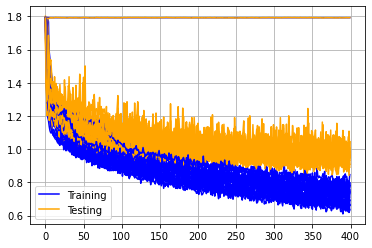

In [12]:
for i, history in enumerate(histories):
    pl.plot(history.history['loss'], label='Training', color="blue")
    pl.plot(history.history['val_loss'], label='Testing', color="orange")
    
    if i == 0:
        pl.legend()
        
    pl.grid()

In [13]:
print("mean loss: ", mean_loss)
print("mean accuracy: ", mean_accuracy)

mean loss:  1.004949314594269
mean accuracy:  0.58398260936141


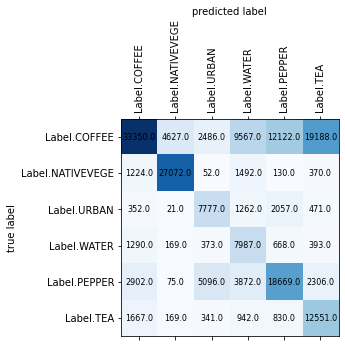

In [14]:
plot_confusion_matrix(conf_matrix, labels)

In [15]:
recall, precision, fscore = recall_precision_fscore_from_confusion_matrix(conf_matrix)

print("Precisions: ", precision)
print("Recalls: ", recall)
print("F-Score: ", fscore)

Precisions:  [0.81770259 0.84249837 0.48229457 0.31792851 0.54150714 0.35576405]
Recalls:  [0.41000738 0.89228741 0.65134003 0.73409926 0.56710207 0.76066667]
F-Score:  [0.54616172 0.86667841 0.55421343 0.44369757 0.55400914 0.48479113]
